In [ ]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import preprocessing
from tqdm import tqdm
from sklearn.model_selection import KFold

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install gpytorch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 277.7/277.7 kB 13.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.3/176.3 kB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.4/55.4 kB 5.0 MB/s eta 0:00:00


In [ ]:
import torch
import gpytorch

In [ ]:
import os
folder_path = f"/content/drive/MyDrive/Deep_GP_2/Saved_Outputs/"
os.makedirs(folder_path, exist_ok=True)
os.makedirs(f"{folder_path}/Final_Figures", exist_ok=True)
os.makedirs(f"{folder_path}/CSV_data", exist_ok=True)
os.makedirs(f"{folder_path}/MSE_data", exist_ok=True)

In [ ]:
#UPDATED CODE
def run_model(grb_name):
  print(f"\n-----TRAINING FOR {grb_name}-----\n")
  from scipy import stats as st
  from gpytorch.constraints import Interval
  GRB_Name = grb_name
  trimmed_data = pd.read_csv("/content/drive/MyDrive/GRB_Project/GRBs_trimmed/"+ str(GRB_Name) +"_trimmed.csv")
  if len(trimmed_data.columns)==6:
      trimmed_data.columns = ["t", "pos_t_err", "neg_t_err", "flux", "pos_flux_err", "neg_flux_err"]
  else:
      trimmed_data.columns = ["0", "t", "pos_t_err", "neg_t_err", "flux", "pos_flux_err","neg_flux_err"]

  density_factor = 1
  max_fluxes = np.max(trimmed_data["flux"])
  min_fluxes = np.min(trimmed_data["flux"])

  trim_t_val=trimmed_data["t"] if "t" in trimmed_data else trimmed_data["time_sec"]

  max_ts = np.max(trim_t_val)
  min_ts = np.min(trim_t_val)


  #ABOVE VALUES IN LOG SCALE
  log_max_fluxes = np.log10(max_fluxes)
  log_min_fluxes = np.log10(min_fluxes)

  log_max_ts = np.log10(max_ts)
  log_min_ts = np.log10(min_ts)

  #DEFINING THE ERROR VALUES FROM DATA FILE IN LINEAR SCALE

  #for time
  positive_ts_err = trimmed_data["pos_t_err"] if "pos_t_err" in trimmed_data else trimmed_data["timePos_sec"]
  negative_ts_err = trimmed_data["neg_t_err"] if "neg_t_err" in trimmed_data else trimmed_data["timeNeg_sec"]

  #for flux
  positive_fluxes_err = trimmed_data["pos_flux_err"] if "pos_flux_err" in trimmed_data else trimmed_data["flux_errPos"]
  negative_fluxes_err = trimmed_data["neg_flux_err"] if "neg_flux_err" in trimmed_data else trimmed_data["flux_errNeg"]


  #READING TIME AND FLUXES FROM THE TRIMMED DATA
  #THESE VALUES ARE IN LINEAR SCALE
  ts, fluxes = trim_t_val.to_numpy(), trimmed_data["flux"].to_numpy()

  #ABOVE VALUES IN LOG SCALE
  log_ts, log_fluxes = np.log10(ts), np.log10(fluxes)


  # ERROR ON THE FLUXES
  pos_fluxes= fluxes + positive_fluxes_err
  neg_fluxes= fluxes + negative_fluxes_err

  #SYMMETRIC ERROR VALUE
  fluxes_err_sym= (pos_fluxes - neg_fluxes )/2


  # GENERATES TIME VALUES AT EQUAL INTERVALS IN RANGE OF TS IN LINEAR SCALE
  # THIS IS TO BE USED FOR GENERATING THE TIMES AT WHICH WE RECONSTRUCT THE LC
  # IT IS EQUAL TO THE NUMBER OF DATA POINTS AS THE ORIGINAL LIGHT CURVE
  recon_t = np.geomspace(np.min(ts), np.max(ts), density_factor*len(ts))

  #ABOVE VALUE IN LOG SCALE
  log_recon_t = np.log10(recon_t)
  log_recon_t = log_recon_t.reshape(-1,1)

  #CALCULATING ERRORBAR IN LINEAR SCALE
  ts_error = (positive_ts_err - negative_ts_err )/2
  fluxes_error = (positive_fluxes_err - negative_fluxes_err)/2

  #CALCULATING ERRORBAR IN LOG SCALE

  pos_log_fluxes = np.log10(pos_fluxes)
  neg_log_fluxes = np.log10(neg_fluxes)

  #PLOTS ERRORBARS IN LOG SCALE
  plt.xlabel("Time")
  plt.ylabel("Flux")
  plt.errorbar(log_ts, log_fluxes, linestyle='none', yerr=[log_fluxes-neg_log_fluxes,pos_log_fluxes-log_fluxes], marker='o', capsize=5, label="Trimmed Data")
  plt.title(GRB_Name)
  print("\n-----ORIGINAL GRB-----\n")
  plt.show()

  log_ts_mean = np.mean(log_ts, keepdims=True)
  log_ts_std = np.std(log_ts, keepdims=True)
  log_ts_norm = (log_ts - log_ts_mean) / log_ts_std

  log_fluxes_mean = np.mean(log_fluxes, keepdims=True)
  log_fluxes_std = np.std(log_fluxes, keepdims=True)
  log_fluxes_norm = (log_fluxes - log_fluxes_mean) / log_fluxes_std

  # Convert to tensor
  train_x = torch.tensor(log_ts_norm, dtype=torch.float32)
  train_y = torch.tensor(log_fluxes_norm, dtype=torch.float32)



  log_fluxes_error = torch.tensor(fluxes_error / fluxes, dtype=torch.float32)

  # class SingleLayerGP(gpytorch.models.ApproximateGP):
  #     def __init__(self, input_dim, inducing_points):
  #         inducing_points = train_x[:inducing_points]
  #         variational_distribution = gpytorch.variational.CholeskyVariationalDistribution(inducing_points.size(0))
  #         variational_strategy = gpytorch.variational.VariationalStrategy(
  #             self, inducing_points, variational_distribution, learn_inducing_locations=True
  #         )
  #         super().__init__(variational_strategy)

  #         # Use RBF kernel instead of Matérn
  #         self.mean_module = gpytorch.means.ConstantMean()
  #       #   # self.covar_module = gpytorch.kernels.ScaleKernel(
  #       #     gpytorch.kernels.MaternKernel(nu=2.5)
  #       # )
  #         self.covar_module = gpytorch.kernels.ScaleKernel(gpytorch.kernels.RBFKernel(lengthscale=0.6, lengthscale_bounds=(1e-2, 1e2)) + gpytorch.kernels.LinearKernel())

  #     def forward(self, x):
  #         mean_x = self.mean_module(x)
  #         covar_x = self.covar_module(x)
  #         return gpytorch.distributions.MultivariateNormal(mean_x, covar_x)


  # class DeepGP(torch.nn.Module):
  #     def __init__(self, num_inducing):
  #         super().__init__()
  #         self.hidden_layer = SingleLayerGP(train_x.shape[-1], inducing_points=50)
  #         # self.deep_layer = SingleLayerGP(train_x.shape[-1], inducing_points=15)
  #         self.final_layer = SingleLayerGP(train_x.shape[-1], inducing_points=50)

  #         self.likelihood = gpytorch.likelihoods.GaussianLikelihood()
  #         # self.likelihood.noise_covar.initialize(noise=log_fluxes_error.mean() + 0.05)  # Add noise for stability

  #         self.likelihood.noise_covar.register_constraint("raw_noise", Interval(1e-4, 0.08))
  #         self.likelihood.noise_covar.initialize(noise=0.05)


  #     def forward(self, x):
  #         # hidden_rep = self.hidden_layer(x)
  #         # x = self.deep_layer(hidden_rep.mean)
  #         x=self.hidden_layer(x)
  #         x = self.final_layer(x.mean)
  #         return x

  class SingleLayerGP(gpytorch.models.ApproximateGP):
    def __init__(self, input_dim, inducing_points):
        inducing_points = train_x[:inducing_points]
        # inducing_points = torch.linspace(train_x.min(), train_x.max(), 50).unsqueeze(-1)

        variational_distribution = gpytorch.variational.CholeskyVariationalDistribution(
            inducing_points.size(0)
        )
        variational_strategy = gpytorch.variational.VariationalStrategy(
            self, inducing_points, variational_distribution, learn_inducing_locations=True
        )

        super().__init__(variational_strategy)

        self.mean_module = gpytorch.means.ConstantMean()
        self.covar_module = gpytorch.kernels.ScaleKernel(
            gpytorch.kernels.RBFKernel(lengthscale=2.0, lengthscale_bounds=(0.05, 10.0))
        )
        #ls=0.8 bounds=0.5-5.0
        #ls=1.0
        # 2.0, last 10

    def forward(self, x):
        mean_x = self.mean_module(x)
        covar_x = self.covar_module(x)
        return gpytorch.distributions.MultivariateNormal(mean_x, covar_x)


  class DeepGP(torch.nn.Module):
      def __init__(self, num_inducing):
          super().__init__()
          self.hidden_layer = SingleLayerGP(train_x.shape[-1], inducing_points=35)
          self.final_layer = SingleLayerGP(train_x.shape[-1], inducing_points=25)

          self.likelihood = gpytorch.likelihoods.GaussianLikelihood()

          self.likelihood.noise_covar.register_constraint("raw_noise", Interval(1e-4, 0.05))
          self.likelihood.noise_covar.initialize(noise=0.01)
          #noise=0.01, interval=0.05

      def forward(self, x):
          x = self.hidden_layer(x)
          x = self.final_layer(x.mean)
          return x


  from torch.optim.lr_scheduler import StepLR

  def train_dgp():
      print("\n-----TRAINING DEEP GP-----\n")
      model = DeepGP(num_inducing=50)
      likelihood = model.likelihood
      model.train()
      likelihood.train()

      optimizer = torch.optim.Adam(model.parameters(), lr=0.005)  # Reduced LR for better convergence
      scheduler = StepLR(optimizer, step_size=200, gamma=0.5)
      mll = gpytorch.mlls.VariationalELBO(likelihood, model.final_layer, num_data=train_y.size(0))

      num_iterations = 500
      for i in range(num_iterations):
          optimizer.zero_grad()
          output = model(train_x)
          loss = -mll(output, train_y)
          loss.backward()
          optimizer.step()
          scheduler.step()

          if (i + 1) % 20 == 0:
              print(f"Iteration {i + 1}/{num_iterations} - Loss: {loss.item():.4f}")

      model.eval()
      likelihood.eval()

      # torch.save({
      #     'model_state_dict': model.state_dict(),
      #     'likelihood_state_dict': likelihood.state_dict()
      # }, "deepgp_model.pth")
      with torch.no_grad():
          #GAP-AWARE reconstruction
          gaps = np.diff(log_ts)

          #new code for min gap 0.05, assign points based on the no. of original points
          min_gap = 0.05
          recon_log_t = [log_ts[0]]
          total_span = log_ts[-1] - log_ts[0]
          if len(ts) > 500:   # densest LC
              fraction = 0.05
          elif len(ts) > 250:
              fraction = 0.1
          elif len(ts) > 100:
              fraction = 0.3
          else:
              fraction = 0.4
          n_points = max(20, int(fraction * len(ts)))
          for i in range(len(ts) - 1):
              gap_size = log_ts[i+1] - log_ts[i]

              if gap_size > min_gap:
                  # allocate points proportional to gap size
                  interval_points = max(2, int(n_points * gap_size / total_span))
                  interval = np.linspace(log_ts[i], log_ts[i+1], interval_points, endpoint=True)
                  recon_log_t.extend(interval[1:])


          recon_log_t = np.array(recon_log_t)
          recon_t = 10**np.array(recon_log_t)
          recon_t = np.unique(recon_t)

          log_recon_t = np.log10(recon_t).reshape(-1, 1)
          log_recon_t = np.sort(log_recon_t, axis=0)
          test_x = torch.tensor(log_recon_t, dtype=torch.float32)
          # test_x = torch.tensor(log_recon_t, dtype=torch.float32).reshape(-1, 1)
          test_x = (test_x - log_ts.mean()) / log_ts.std()
          observed_pred = likelihood(model(test_x))
          # mean = observed_pred.mean.numpy()
          std_prediction = observed_pred.stddev.numpy()
          mean_prediction = observed_pred.mean.numpy()
          # std = observed_pred.stddev
          lower, upper = observed_pred.confidence_region()

      # Denormalize
      mean_prediction_denorm = (mean_prediction * log_fluxes_std) + log_fluxes_mean
      lower_denorm = (lower.numpy() * log_fluxes_std) + log_fluxes_mean
      upper_denorm = (upper.numpy() * log_fluxes_std) + log_fluxes_mean


      points = []
      for j in range(len(mean_prediction)):
          fitted_dist = st.norm(loc=mean_prediction[j], scale=std_prediction[j])
          point = np.random.choice(fitted_dist.rvs(size=50), size=1) - mean_prediction[j] #CHANGED
          points.append(point)

      points = np.array(points).ravel()
      new_points = mean_prediction + points

      log_reconstructed_flux = (new_points * log_fluxes_std) + log_fluxes_mean
      # reconstructed_flux = 10**log_reconstructed_flux

      test_x_denorm = test_x * log_ts.std() + log_ts.mean()

      train_x_denorm = (train_x.numpy() * log_ts_std) + log_ts_mean

      train_y_denorm = (train_y.numpy() * log_fluxes_std) + log_fluxes_mean

      fluxes_error = (positive_fluxes_err - negative_fluxes_err)/2
      logfluxerrs = fluxes_error/(fluxes*np.log(10))

      errparameters = st.norm.fit(logfluxerrs)
      err_dist = st.norm(loc=errparameters[0], scale=errparameters[1])

      recon_errorbar=err_dist.rvs(size=len(log_recon_t))

      plt.figure(figsize=(8, 6))
      plt.errorbar(train_x_denorm, train_y_denorm, zorder=4, yerr=[log_fluxes-neg_log_fluxes,pos_log_fluxes-log_fluxes], linestyle="") #origianl data
      plt.errorbar(test_x_denorm, log_reconstructed_flux, linestyle='none', yerr=np.abs(recon_errorbar), marker='o', capsize=5, color='yellow', zorder=3, label="Reconstructed Points") #reconstructed data
      plt.scatter(train_x_denorm, train_y_denorm, zorder=5, label='Observed Points')
      plt.plot(test_x_denorm, mean_prediction_denorm, label='Mean Prediction', zorder=2)
      plt.fill_between(test_x_denorm.flatten(), lower_denorm, upper_denorm, alpha=0.5, color='orange', label='95% Confidence Region', zorder=1)
      plt.legend(loc='lower left')
      plt.xlabel('log$_{10}$(Time) (s)',fontsize="15")
      plt.ylabel("log$_{10}$(Flux) ($erg$ ${cm^{-2}}$$s^{-1}$)",fontsize="15")
      plt.title(f'Deep GP on '+str(GRB_Name), fontsize="18")
      plt.savefig(f"{folder_path}/Final_Figures/{GRB_Name}.png", dpi=300)
      print("\n-----RECONSTRUCTED GRB-----\n")
      plt.show()

      # CALCULATING TIME ERROR IN LOG SCALE
      log_ts_error = ts_error/(ts*np.log(10))

      errparameters = st.norm.fit(log_ts_error) #GAUSSIAN FITTING ON TIME ERROR DISTRIBUTION
      err_dist_time = st.norm(loc=errparameters[0], scale=errparameters[1])

      recon_logtimeerr=err_dist_time.rvs(size=len(log_recon_t)) # len(log_ts_error)
      df = trimmed_data.copy(deep=True)

      for k in range(0, len(log_recon_t)):
          new_row = {
              "t": 10**log_recon_t[k],
              "pos_t_err": 10**recon_logtimeerr[k],
              "neg_t_err": 10**recon_logtimeerr[k],
              "flux": 10**log_reconstructed_flux[k],
              "pos_flux_err": 10**log_reconstructed_flux[k] * np.log(10) * recon_errorbar[k],
              "neg_flux_err": 10**log_reconstructed_flux[k] * np.log(10) * recon_errorbar[k]
          }

          new_row_df = pd.DataFrame(new_row)
          df = pd.concat([df, new_row_df], ignore_index=True)


      df.to_csv(f"{folder_path}/CSV_data/{GRB_Name}.csv", index=False)


  train_dgp()

  # print("\n-----5K FOLD VALIDATION BEGIN-----\n")
  # from sklearn.model_selection import KFold
  # import torch.nn.functional as F
  # kf = KFold(n_splits=5, shuffle=True, random_state=42)
  # device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
  # file_path=f"{folder_path}/MSE_data.csv"
  # write_header = not os.path.exists(file_path)


  # test_mse_scores = []
  # train_mse_scores = []


  # for fold, (train_idx, test_idx) in enumerate(kf.split(train_x, train_y)):
  #     print(f"Training on fold {fold+1}/5...")

  #     train_x_fold, test_x_fold = train_x[train_idx].to(device), train_x[test_idx].to(device)
  #     train_y_fold, test_y_fold = train_y[train_idx].to(device), train_y[test_idx].to(device)

  #     model = DeepGP(num_inducing=50).to(device)
  #     likelihood = model.likelihood.to(device)

  #     model.train()
  #     likelihood.train()

  #     optimizer = torch.optim.Adam(model.parameters(), lr=0.005)
  #     mll = gpytorch.mlls.VariationalELBO(likelihood, model.final_layer, num_data=train_y_fold.size(0))

  #     num_iterations = 200
  #     for i in range(num_iterations):
  #         optimizer.zero_grad()
  #         output = model(train_x_fold)
  #         train_pred = output.mean
  #         train_pred_denorm = (train_pred.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
  #         train_y_denorm = (train_y_fold.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
  #         train_pred_tensor = torch.tensor(train_pred_denorm, dtype=torch.float32)
  #         train_y_tensor = torch.tensor(train_y_denorm, dtype=torch.float32)
  #         loss = -mll(output, train_y_fold)
  #         loss.backward()
  #         optimizer.step()
  #         # print(mse_loss)
  #         train_mse_value = F.mse_loss(train_pred_tensor, train_y_tensor).item()
  #         train_mse_scores.append(train_mse_value)

  #         if (i + 1) % 50 == 0:
  #             print(f"Fold {fold+1} - Iteration {i+1}/{num_iterations} - Loss: {loss.item():.4f}")

  #     model.eval()
  #     likelihood.eval()

  #     with torch.no_grad():
  #         observed_pred = likelihood(model(test_x_fold))
  #         mean_prediction = observed_pred.mean
  #         test_pred_denorm=(mean_prediction.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
  #         test_y_fold_denorm=(test_y_fold.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
  #         test_pred_tensor = torch.tensor(test_pred_denorm, dtype=torch.float32)
  #         test_y_tensor = torch.tensor(test_y_fold_denorm, dtype=torch.float32)
  #         test_mse_value = F.mse_loss(test_pred_tensor, test_y_tensor).item()
  #         test_mse_scores.append(test_mse_value)

  #     print(f"Fold {fold+1} - Test MSE: {test_mse_value:.4f}")

  # mean_train_mse = np.mean(train_mse_scores)
  # mean_test_mse = np.mean(test_mse_scores)

  # data = {
  #         "GRB_Name": [GRB_Name],
  #         "Final_Train_MSE": [mean_train_mse],
  #         "Final_Validation_MSE":[mean_test_mse]}

  # df = pd.DataFrame(data)
  # df.to_csv(file_path, mode='a', header=write_header, index=False)

  # print("\n-----SAVING TRAIN AND TEST MSE-----\n")
  # print(f"Mean Train MSE: {mean_train_mse:4f}")
  # print(f"Mean Test MSE: {mean_test_mse:.4f}")


-----TRAINING FOR GRB070306-----


-----ORIGINAL GRB-----



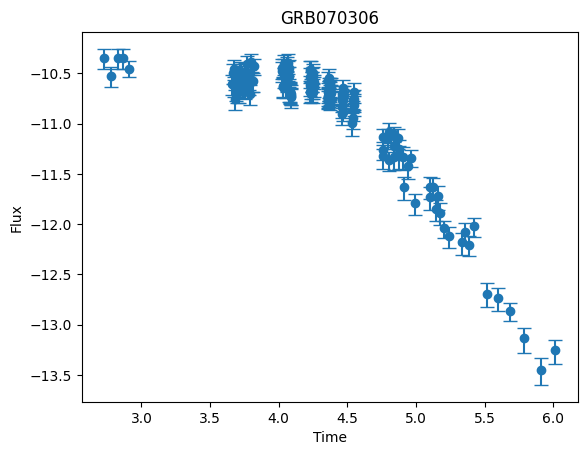


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.3581
Iteration 40/500 - Loss: 39.2493
Iteration 60/500 - Loss: 28.6602
Iteration 80/500 - Loss: 16.3610
Iteration 100/500 - Loss: 8.1296
Iteration 120/500 - Loss: 4.4696
Iteration 140/500 - Loss: 2.7365
Iteration 160/500 - Loss: 1.8042
Iteration 180/500 - Loss: 1.2401
Iteration 200/500 - Loss: 0.8559
Iteration 220/500 - Loss: 0.6941
Iteration 240/500 - Loss: 0.5599
Iteration 260/500 - Loss: 0.4479
Iteration 280/500 - Loss: 0.3590
Iteration 300/500 - Loss: 0.2903
Iteration 320/500 - Loss: 0.2361
Iteration 340/500 - Loss: 0.1921
Iteration 360/500 - Loss: 0.1557
Iteration 380/500 - Loss: 0.1250
Iteration 400/500 - Loss: 0.0991
Iteration 420/500 - Loss: 0.0872
Iteration 440/500 - Loss: 0.0767
Iteration 460/500 - Loss: 0.0669
Iteration 480/500 - Loss: 0.0577
Iteration 500/500 - Loss: 0.0492

-----RECONSTRUCTED GRB-----



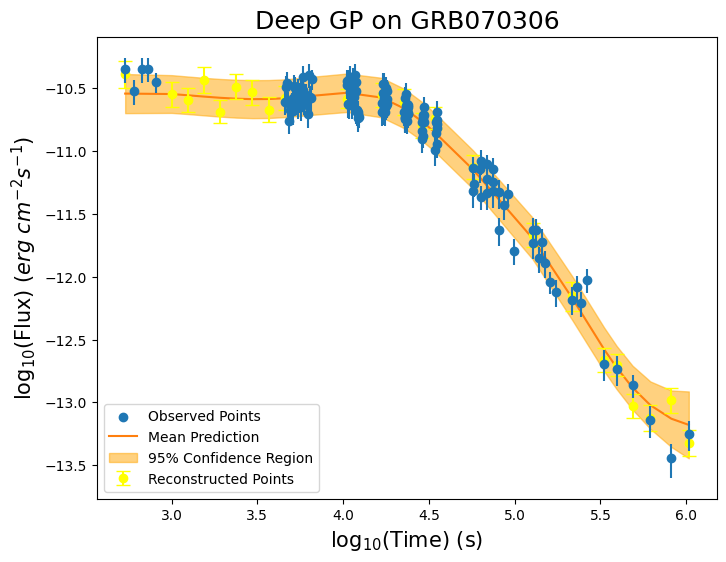


-----TRAINING FOR GRB070521-----


-----ORIGINAL GRB-----



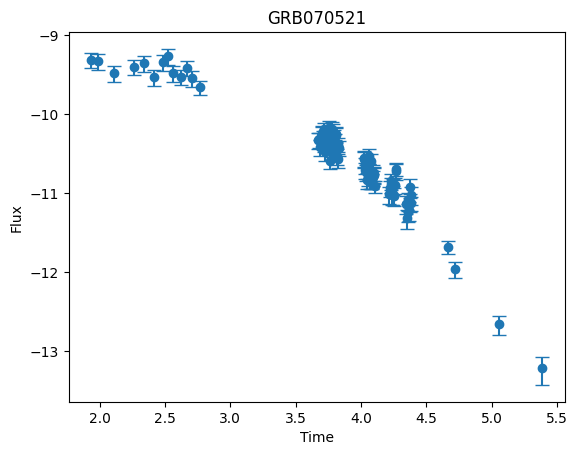


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.3006
Iteration 40/500 - Loss: 33.9355
Iteration 60/500 - Loss: 20.3682
Iteration 80/500 - Loss: 12.7112
Iteration 100/500 - Loss: 8.8376
Iteration 120/500 - Loss: 6.4505
Iteration 140/500 - Loss: 4.7982
Iteration 160/500 - Loss: 3.6170
Iteration 180/500 - Loss: 2.7555
Iteration 200/500 - Loss: 2.1194
Iteration 220/500 - Loss: 1.8558
Iteration 240/500 - Loss: 1.6389
Iteration 260/500 - Loss: 1.4476
Iteration 280/500 - Loss: 1.2788
Iteration 300/500 - Loss: 1.1296
Iteration 320/500 - Loss: 0.9975
Iteration 340/500 - Loss: 0.8803
Iteration 360/500 - Loss: 0.7757
Iteration 380/500 - Loss: 0.6829
Iteration 400/500 - Loss: 0.6069
Iteration 420/500 - Loss: 0.5594
Iteration 440/500 - Loss: 0.5233
Iteration 460/500 - Loss: 0.4888
Iteration 480/500 - Loss: 0.4558
Iteration 500/500 - Loss: 0.4244

-----RECONSTRUCTED GRB-----



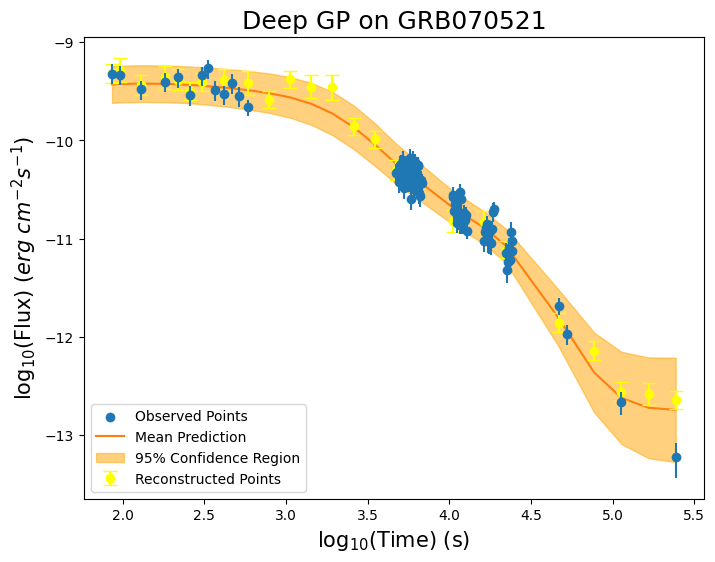


-----TRAINING FOR GRB070529-----


-----ORIGINAL GRB-----



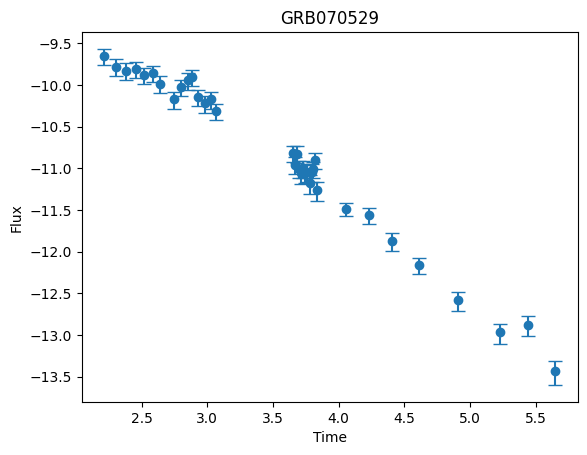


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.4929
Iteration 40/500 - Loss: 35.4720
Iteration 60/500 - Loss: 19.3007
Iteration 80/500 - Loss: 9.2115
Iteration 100/500 - Loss: 4.5554
Iteration 120/500 - Loss: 2.3303
Iteration 140/500 - Loss: 1.2975
Iteration 160/500 - Loss: 0.7805
Iteration 180/500 - Loss: 0.4973
Iteration 200/500 - Loss: 0.3199
Iteration 220/500 - Loss: 0.2479
Iteration 240/500 - Loss: 0.1878
Iteration 260/500 - Loss: 0.1333
Iteration 280/500 - Loss: 0.0836
Iteration 300/500 - Loss: 0.0383
Iteration 320/500 - Loss: -0.0023
Iteration 340/500 - Loss: -0.0405
Iteration 360/500 - Loss: -0.0751
Iteration 380/500 - Loss: -0.1073
Iteration 400/500 - Loss: -0.1401
Iteration 420/500 - Loss: -0.1579
Iteration 440/500 - Loss: -0.1748
Iteration 460/500 - Loss: -0.1916
Iteration 480/500 - Loss: -0.2071
Iteration 500/500 - Loss: -0.2234

-----RECONSTRUCTED GRB-----



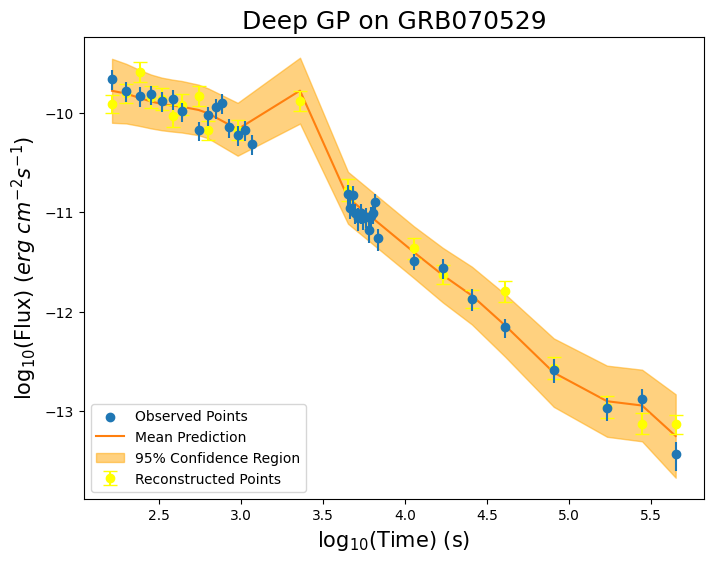


-----TRAINING FOR GRB070714B-----


-----ORIGINAL GRB-----



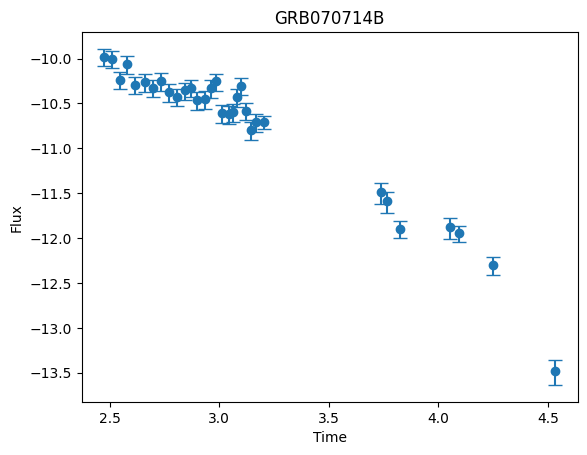


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 45.1873
Iteration 40/500 - Loss: 31.0953
Iteration 60/500 - Loss: 16.0263
Iteration 80/500 - Loss: 9.0908
Iteration 100/500 - Loss: 6.3870
Iteration 120/500 - Loss: 4.7675
Iteration 140/500 - Loss: 3.5583
Iteration 160/500 - Loss: 2.6091
Iteration 180/500 - Loss: 1.8734
Iteration 200/500 - Loss: 1.2939
Iteration 220/500 - Loss: 1.0336
Iteration 240/500 - Loss: 0.8073
Iteration 260/500 - Loss: 0.6114
Iteration 280/500 - Loss: 0.4483
Iteration 300/500 - Loss: 0.3151
Iteration 320/500 - Loss: 0.2082
Iteration 340/500 - Loss: 0.1232
Iteration 360/500 - Loss: 0.0554
Iteration 380/500 - Loss: 0.0008
Iteration 400/500 - Loss: -0.0431
Iteration 420/500 - Loss: -0.0623
Iteration 440/500 - Loss: -0.0787
Iteration 460/500 - Loss: -0.0935
Iteration 480/500 - Loss: -0.1068
Iteration 500/500 - Loss: -0.1189

-----RECONSTRUCTED GRB-----



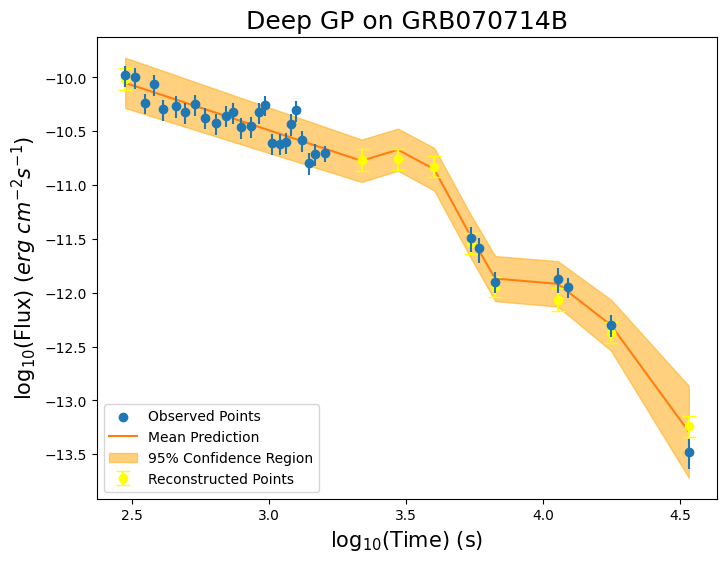


-----TRAINING FOR GRB070802-----


-----ORIGINAL GRB-----



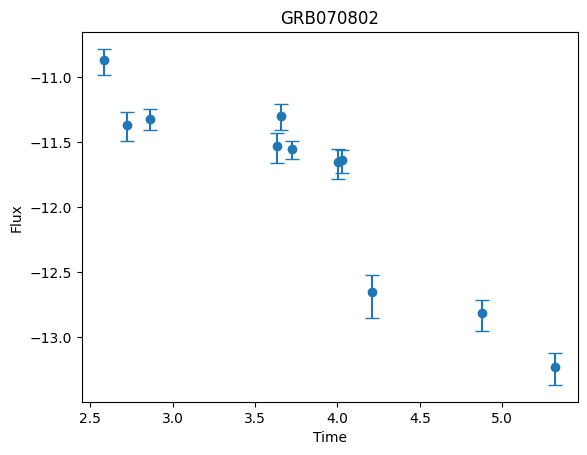


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 60.1946
Iteration 40/500 - Loss: 40.1505
Iteration 60/500 - Loss: 25.2428
Iteration 80/500 - Loss: 14.4055
Iteration 100/500 - Loss: 8.2412
Iteration 120/500 - Loss: 5.0206
Iteration 140/500 - Loss: 3.2555
Iteration 160/500 - Loss: 2.4151
Iteration 180/500 - Loss: 2.0376
Iteration 200/500 - Loss: 1.8388
Iteration 220/500 - Loss: 1.7734
Iteration 240/500 - Loss: 1.7247
Iteration 260/500 - Loss: 1.6841
Iteration 280/500 - Loss: 1.6502
Iteration 300/500 - Loss: 1.6218
Iteration 320/500 - Loss: 1.5973
Iteration 340/500 - Loss: 1.5755
Iteration 360/500 - Loss: 1.5559
Iteration 380/500 - Loss: 1.5378
Iteration 400/500 - Loss: 1.5210
Iteration 420/500 - Loss: 1.5127
Iteration 440/500 - Loss: 1.5051
Iteration 460/500 - Loss: 1.4976
Iteration 480/500 - Loss: 1.4902
Iteration 500/500 - Loss: 1.4828

-----RECONSTRUCTED GRB-----



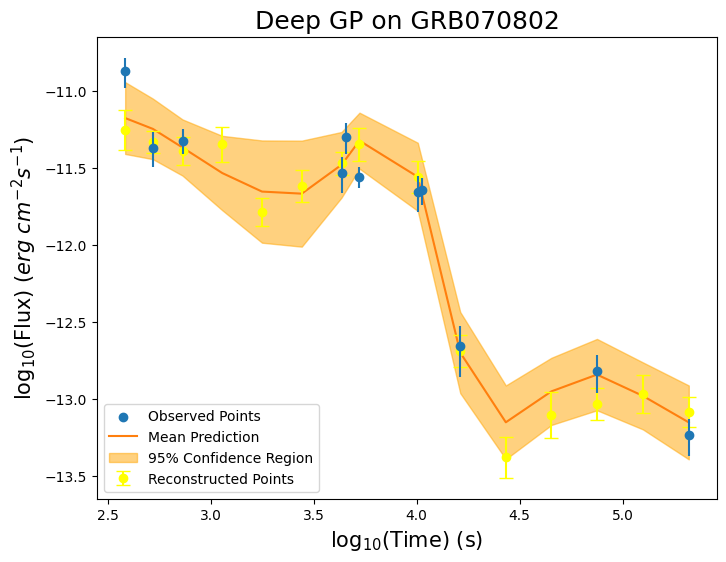


-----TRAINING FOR GRB070809-----


-----ORIGINAL GRB-----



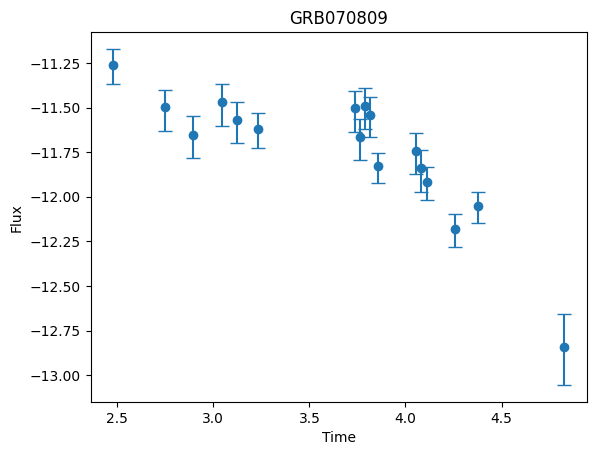


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.8400
Iteration 40/500 - Loss: 36.7268
Iteration 60/500 - Loss: 24.1268
Iteration 80/500 - Loss: 15.5592
Iteration 100/500 - Loss: 10.9261
Iteration 120/500 - Loss: 8.1119
Iteration 140/500 - Loss: 6.0068
Iteration 160/500 - Loss: 4.5882
Iteration 180/500 - Loss: 3.6575
Iteration 200/500 - Loss: 3.0346
Iteration 220/500 - Loss: 2.7959
Iteration 240/500 - Loss: 2.6115
Iteration 260/500 - Loss: 2.4596
Iteration 280/500 - Loss: 2.3340
Iteration 300/500 - Loss: 2.2302
Iteration 320/500 - Loss: 2.1441
Iteration 340/500 - Loss: 2.0715
Iteration 360/500 - Loss: 2.0080
Iteration 380/500 - Loss: 1.9489
Iteration 400/500 - Loss: 1.8885
Iteration 420/500 - Loss: 1.8539
Iteration 440/500 - Loss: 1.8173
Iteration 460/500 - Loss: 1.7793
Iteration 480/500 - Loss: 1.7483
Iteration 500/500 - Loss: 1.7202

-----RECONSTRUCTED GRB-----



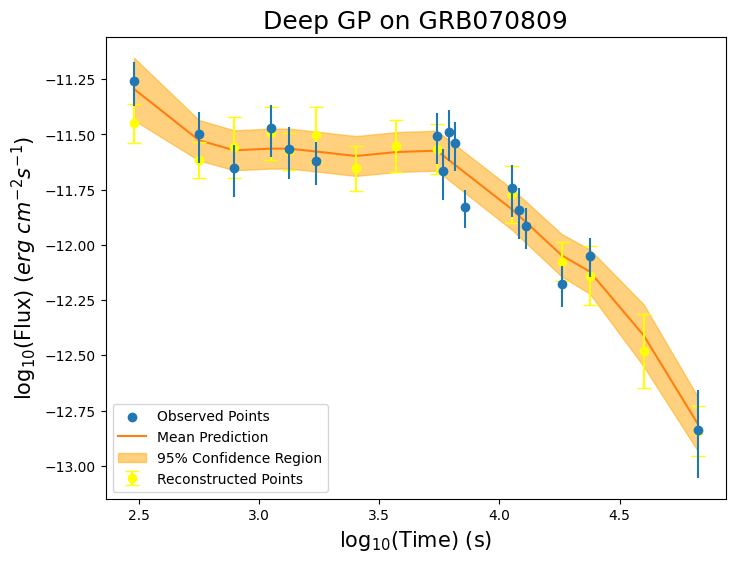


-----TRAINING FOR GRB070810A-----


-----ORIGINAL GRB-----



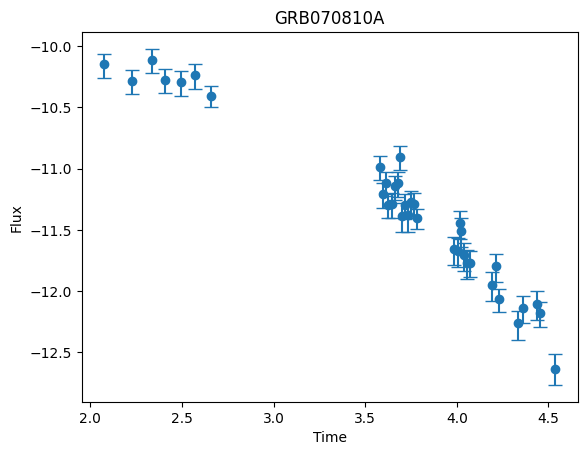


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 58.3879
Iteration 40/500 - Loss: 27.4017
Iteration 60/500 - Loss: 12.1670
Iteration 80/500 - Loss: 6.5164
Iteration 100/500 - Loss: 3.4673
Iteration 120/500 - Loss: 1.8497
Iteration 140/500 - Loss: 1.2546
Iteration 160/500 - Loss: 1.0204
Iteration 180/500 - Loss: 0.8826
Iteration 200/500 - Loss: 0.7824
Iteration 220/500 - Loss: 0.7404
Iteration 240/500 - Loss: 0.7049
Iteration 260/500 - Loss: 0.6724
Iteration 280/500 - Loss: 0.6427
Iteration 300/500 - Loss: 0.6155
Iteration 320/500 - Loss: 0.5906
Iteration 340/500 - Loss: 0.5678
Iteration 360/500 - Loss: 0.5468
Iteration 380/500 - Loss: 0.5273
Iteration 400/500 - Loss: 0.5088
Iteration 420/500 - Loss: 0.4997
Iteration 440/500 - Loss: 0.4911
Iteration 460/500 - Loss: 0.4826
Iteration 480/500 - Loss: 0.4743
Iteration 500/500 - Loss: 0.4662

-----RECONSTRUCTED GRB-----



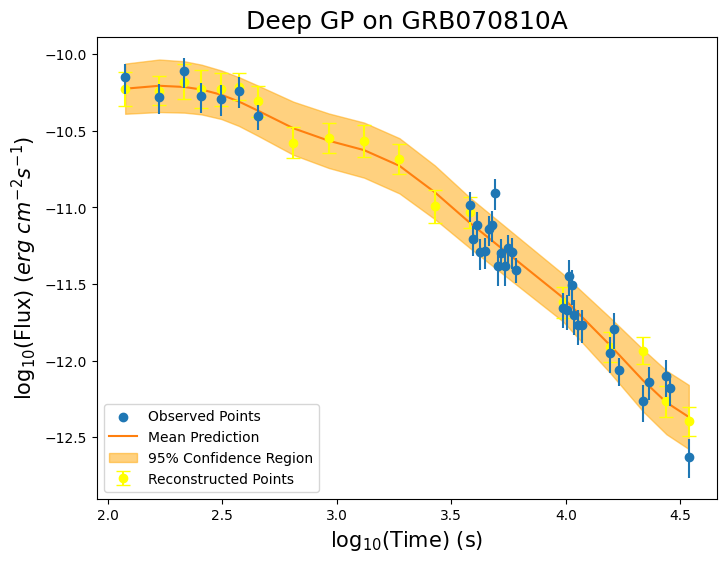


-----TRAINING FOR GRB080310-----


-----ORIGINAL GRB-----



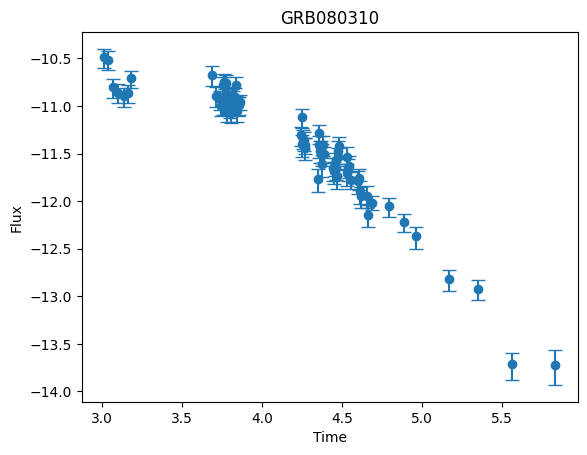


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.8435
Iteration 40/500 - Loss: 36.9478
Iteration 60/500 - Loss: 22.4726
Iteration 80/500 - Loss: 10.8363
Iteration 100/500 - Loss: 6.4888
Iteration 120/500 - Loss: 4.3828
Iteration 140/500 - Loss: 3.1383
Iteration 160/500 - Loss: 2.3599
Iteration 180/500 - Loss: 1.8548
Iteration 200/500 - Loss: 1.5251
Iteration 220/500 - Loss: 1.3891
Iteration 240/500 - Loss: 1.2839
Iteration 260/500 - Loss: 1.1931
Iteration 280/500 - Loss: 1.1139
Iteration 300/500 - Loss: 1.0446
Iteration 320/500 - Loss: 1.0092
Iteration 340/500 - Loss: 0.9325
Iteration 360/500 - Loss: 0.8840
Iteration 380/500 - Loss: 0.8442
Iteration 400/500 - Loss: 0.8060
Iteration 420/500 - Loss: 0.7864
Iteration 440/500 - Loss: 0.7684
Iteration 460/500 - Loss: 0.7506
Iteration 480/500 - Loss: 0.7327
Iteration 500/500 - Loss: 0.7152

-----RECONSTRUCTED GRB-----



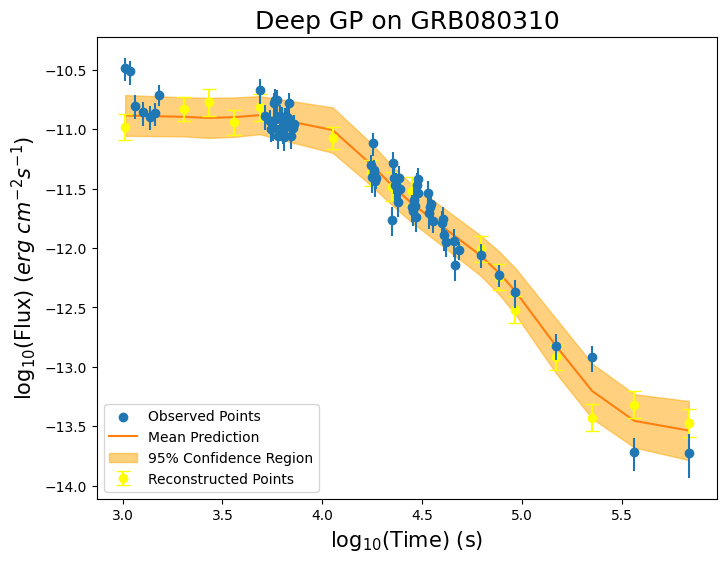


-----TRAINING FOR GRB080319B-----


-----ORIGINAL GRB-----



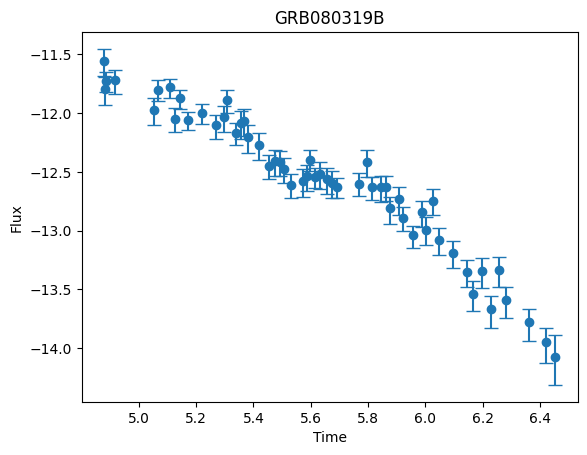


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 45.3862
Iteration 40/500 - Loss: 29.7775
Iteration 60/500 - Loss: 13.3274
Iteration 80/500 - Loss: 6.4068
Iteration 100/500 - Loss: 3.4978
Iteration 120/500 - Loss: 2.1948
Iteration 140/500 - Loss: 1.5304
Iteration 160/500 - Loss: 1.1523
Iteration 180/500 - Loss: 0.9116
Iteration 200/500 - Loss: 0.7525
Iteration 220/500 - Loss: 0.6905
Iteration 240/500 - Loss: 0.6407
Iteration 260/500 - Loss: 0.5975
Iteration 280/500 - Loss: 0.5600
Iteration 300/500 - Loss: 0.5273
Iteration 320/500 - Loss: 0.4987
Iteration 340/500 - Loss: 0.4738
Iteration 360/500 - Loss: 0.4519
Iteration 380/500 - Loss: 0.4326
Iteration 400/500 - Loss: 0.4155
Iteration 420/500 - Loss: 0.4073
Iteration 440/500 - Loss: 0.3999
Iteration 460/500 - Loss: 0.3928
Iteration 480/500 - Loss: 0.3859
Iteration 500/500 - Loss: 0.3793

-----RECONSTRUCTED GRB-----



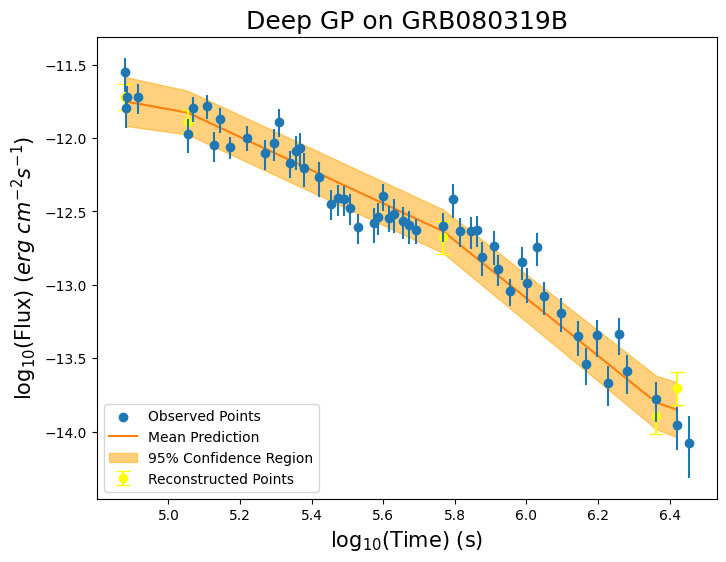


-----TRAINING FOR GRB080319C-----


-----ORIGINAL GRB-----



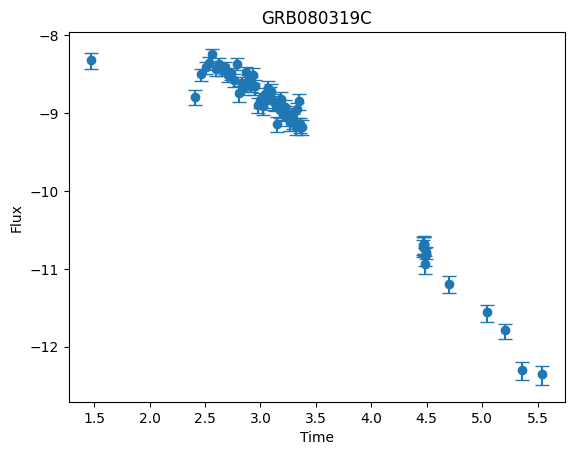


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.9905
Iteration 40/500 - Loss: 38.6564
Iteration 60/500 - Loss: 24.3081
Iteration 80/500 - Loss: 11.6031
Iteration 100/500 - Loss: 4.9971
Iteration 120/500 - Loss: 2.8070
Iteration 140/500 - Loss: 1.7786
Iteration 160/500 - Loss: 1.0144
Iteration 180/500 - Loss: 0.5027
Iteration 200/500 - Loss: 0.2243
Iteration 220/500 - Loss: 0.1232
Iteration 240/500 - Loss: 0.0333
Iteration 260/500 - Loss: -0.0268
Iteration 280/500 - Loss: -0.0783
Iteration 300/500 - Loss: -0.1237
Iteration 320/500 - Loss: -0.1626
Iteration 340/500 - Loss: -0.1958
Iteration 360/500 - Loss: -0.2254
Iteration 380/500 - Loss: -0.2520
Iteration 400/500 - Loss: -0.2763
Iteration 420/500 - Loss: -0.2882
Iteration 440/500 - Loss: -0.2992
Iteration 460/500 - Loss: -0.3099
Iteration 480/500 - Loss: -0.3203
Iteration 500/500 - Loss: -0.3304

-----RECONSTRUCTED GRB-----



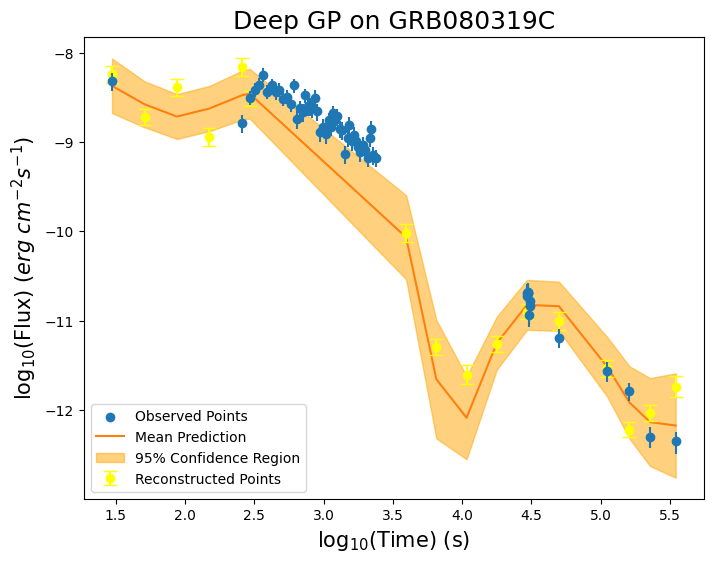


-----TRAINING FOR GRB080411-----


-----ORIGINAL GRB-----



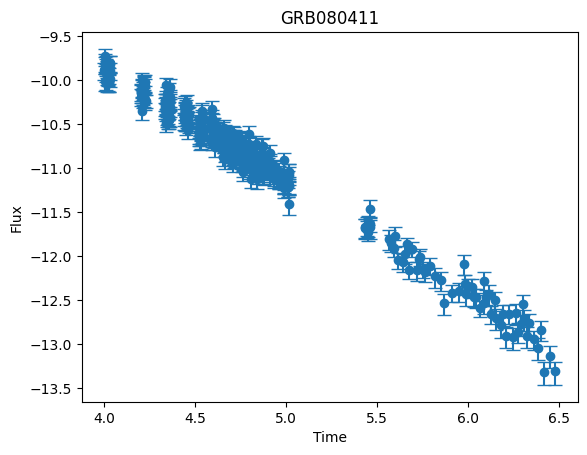


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.8347
Iteration 40/500 - Loss: 40.6790
Iteration 60/500 - Loss: 30.2636
Iteration 80/500 - Loss: 19.6284
Iteration 100/500 - Loss: 10.4610
Iteration 120/500 - Loss: 4.7843
Iteration 140/500 - Loss: 2.6347
Iteration 160/500 - Loss: 1.7626
Iteration 180/500 - Loss: 1.0910
Iteration 200/500 - Loss: 0.6026
Iteration 220/500 - Loss: 0.4342
Iteration 240/500 - Loss: 0.3217
Iteration 260/500 - Loss: 0.2325
Iteration 280/500 - Loss: 0.1569
Iteration 300/500 - Loss: 0.0908
Iteration 320/500 - Loss: 0.0391
Iteration 340/500 - Loss: -0.0121
Iteration 360/500 - Loss: -0.0524
Iteration 380/500 - Loss: -0.0862
Iteration 400/500 - Loss: -0.1174
Iteration 420/500 - Loss: -0.1315
Iteration 440/500 - Loss: -0.1447
Iteration 460/500 - Loss: -0.1571
Iteration 480/500 - Loss: -0.1689
Iteration 500/500 - Loss: -0.1801

-----RECONSTRUCTED GRB-----



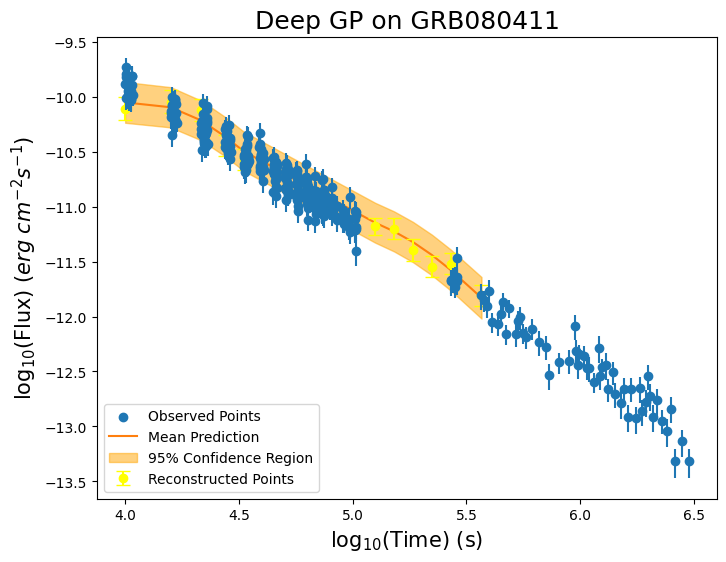


-----TRAINING FOR GRB080430-----


-----ORIGINAL GRB-----



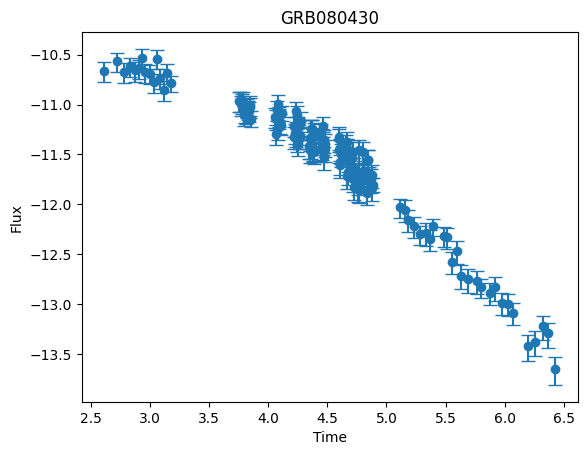


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.4681
Iteration 40/500 - Loss: 35.0499
Iteration 60/500 - Loss: 19.1647
Iteration 80/500 - Loss: 9.0996
Iteration 100/500 - Loss: 4.5157
Iteration 120/500 - Loss: 2.4033
Iteration 140/500 - Loss: 1.2650
Iteration 160/500 - Loss: 0.6406
Iteration 180/500 - Loss: 0.3249
Iteration 200/500 - Loss: 0.1353
Iteration 220/500 - Loss: 0.0707
Iteration 240/500 - Loss: 0.0217
Iteration 260/500 - Loss: -0.0192
Iteration 280/500 - Loss: -0.0536
Iteration 300/500 - Loss: -0.0826
Iteration 320/500 - Loss: -0.1071
Iteration 340/500 - Loss: -0.1279
Iteration 360/500 - Loss: -0.1453
Iteration 380/500 - Loss: -0.1604
Iteration 400/500 - Loss: -0.1733
Iteration 420/500 - Loss: -0.1794
Iteration 440/500 - Loss: -0.1847
Iteration 460/500 - Loss: -0.1896
Iteration 480/500 - Loss: -0.1943
Iteration 500/500 - Loss: -0.1988

-----RECONSTRUCTED GRB-----



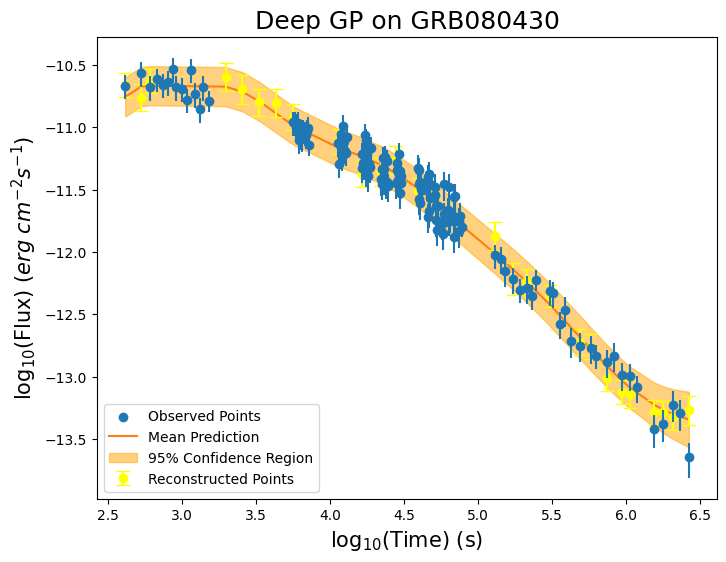


-----TRAINING FOR GRB080516-----


-----ORIGINAL GRB-----



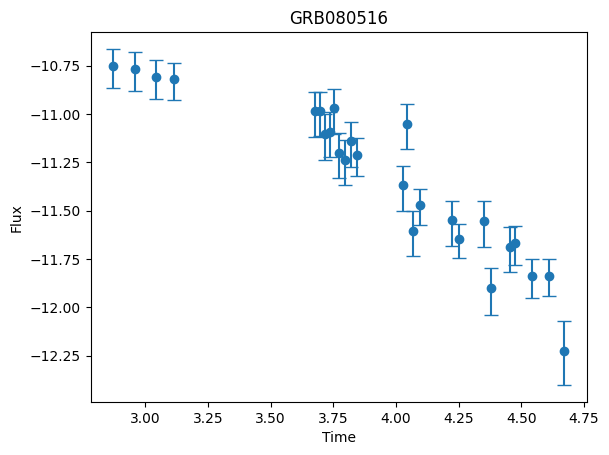


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.4838
Iteration 40/500 - Loss: 29.6983
Iteration 60/500 - Loss: 15.7135
Iteration 80/500 - Loss: 10.0241
Iteration 100/500 - Loss: 7.8685
Iteration 120/500 - Loss: 6.5215
Iteration 140/500 - Loss: 5.5813
Iteration 160/500 - Loss: 4.9652
Iteration 180/500 - Loss: 4.4660
Iteration 200/500 - Loss: 3.8206
Iteration 220/500 - Loss: 3.4200
Iteration 240/500 - Loss: 3.0975
Iteration 260/500 - Loss: 2.8912
Iteration 280/500 - Loss: 2.7463
Iteration 300/500 - Loss: 2.6370
Iteration 320/500 - Loss: 2.5517
Iteration 340/500 - Loss: 2.4817
Iteration 360/500 - Loss: 2.4232
Iteration 380/500 - Loss: 2.3719
Iteration 400/500 - Loss: 2.3262
Iteration 420/500 - Loss: 2.3038
Iteration 440/500 - Loss: 2.2833
Iteration 460/500 - Loss: 2.2633
Iteration 480/500 - Loss: 2.2439
Iteration 500/500 - Loss: 2.2247

-----RECONSTRUCTED GRB-----



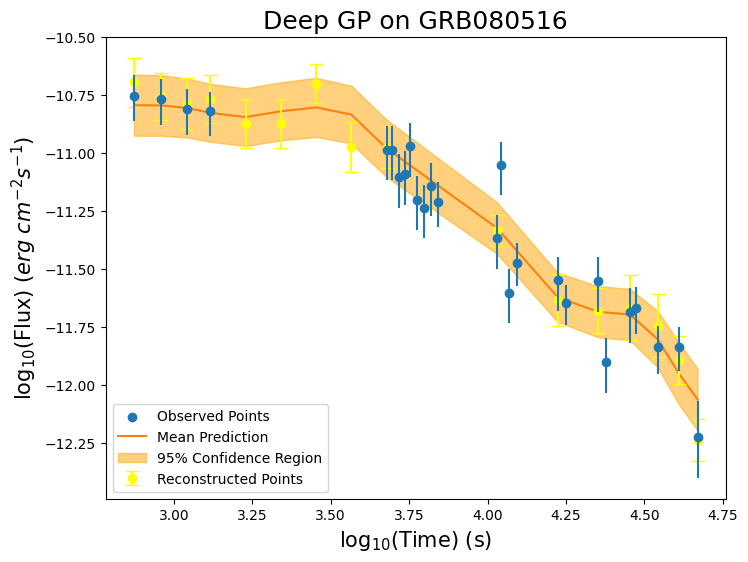


-----TRAINING FOR GRB080607-----


-----ORIGINAL GRB-----



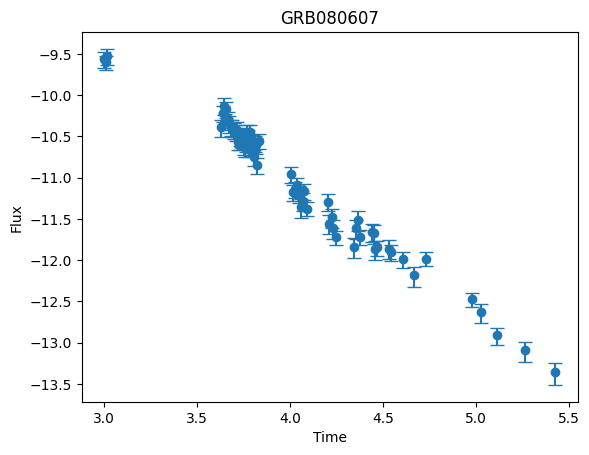


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.6623
Iteration 40/500 - Loss: 39.2795
Iteration 60/500 - Loss: 26.5357
Iteration 80/500 - Loss: 13.4074
Iteration 100/500 - Loss: 6.7259
Iteration 120/500 - Loss: 3.6407
Iteration 140/500 - Loss: 1.9273
Iteration 160/500 - Loss: 1.1106
Iteration 180/500 - Loss: 0.6323
Iteration 200/500 - Loss: 0.3194
Iteration 220/500 - Loss: 0.1974
Iteration 240/500 - Loss: 0.0987
Iteration 260/500 - Loss: 0.0120
Iteration 280/500 - Loss: -0.0641
Iteration 300/500 - Loss: -0.1310
Iteration 320/500 - Loss: -0.1888
Iteration 340/500 - Loss: -0.2380
Iteration 360/500 - Loss: -0.2787
Iteration 380/500 - Loss: -0.3117
Iteration 400/500 - Loss: -0.3382
Iteration 420/500 - Loss: -0.3498
Iteration 440/500 - Loss: -0.3598
Iteration 460/500 - Loss: -0.3689
Iteration 480/500 - Loss: -0.3772
Iteration 500/500 - Loss: -0.3849

-----RECONSTRUCTED GRB-----



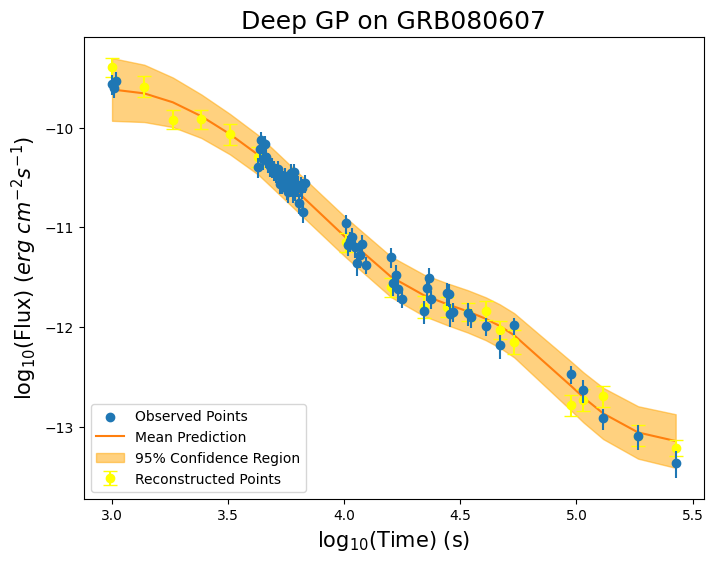


-----TRAINING FOR GRB080710-----


-----ORIGINAL GRB-----



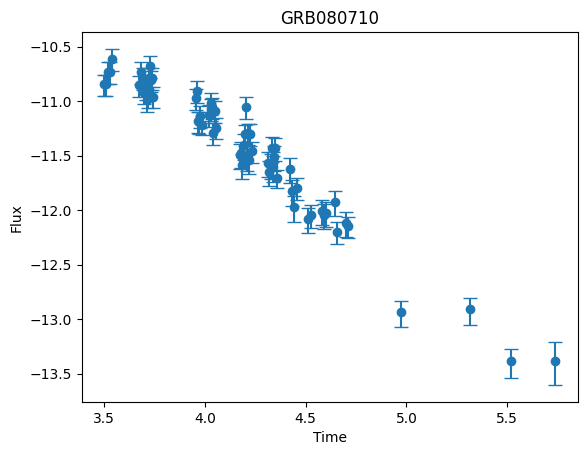


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.2049
Iteration 40/500 - Loss: 34.8291
Iteration 60/500 - Loss: 19.8684
Iteration 80/500 - Loss: 10.5274
Iteration 100/500 - Loss: 5.7437
Iteration 120/500 - Loss: 3.5664
Iteration 140/500 - Loss: 2.0732
Iteration 160/500 - Loss: 1.2467
Iteration 180/500 - Loss: 0.8371
Iteration 200/500 - Loss: 0.6643
Iteration 220/500 - Loss: 0.6185
Iteration 240/500 - Loss: 0.5880
Iteration 260/500 - Loss: 0.5638
Iteration 280/500 - Loss: 0.5442
Iteration 300/500 - Loss: 0.5280
Iteration 320/500 - Loss: 0.5143
Iteration 340/500 - Loss: 0.5025
Iteration 360/500 - Loss: 0.4922
Iteration 380/500 - Loss: 0.4830
Iteration 400/500 - Loss: 0.4746
Iteration 420/500 - Loss: 0.4706
Iteration 440/500 - Loss: 0.4668
Iteration 460/500 - Loss: 0.4631
Iteration 480/500 - Loss: 0.4595
Iteration 500/500 - Loss: 0.4560

-----RECONSTRUCTED GRB-----



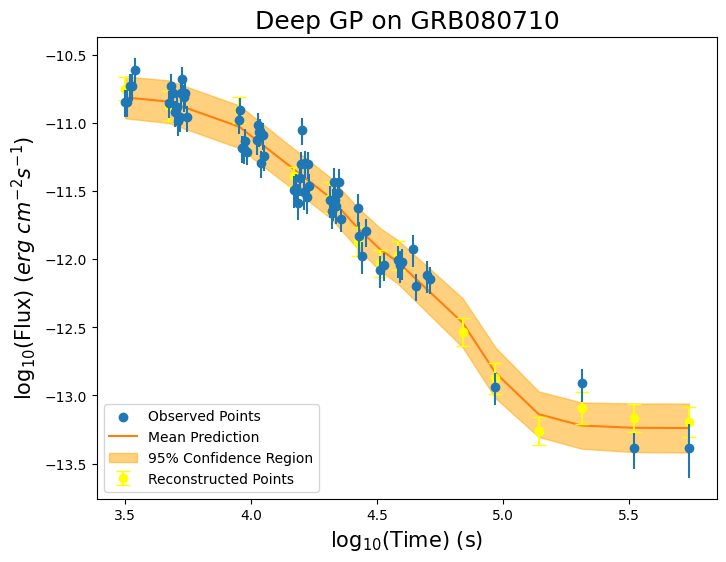


-----TRAINING FOR GRB080721-----


-----ORIGINAL GRB-----



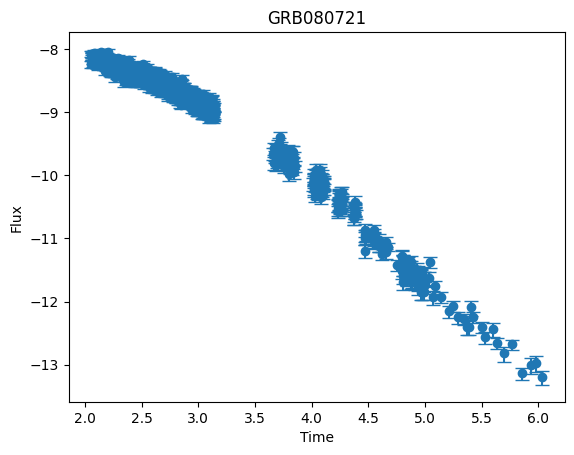


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.8501
Iteration 40/500 - Loss: 40.6672
Iteration 60/500 - Loss: 32.7711
Iteration 80/500 - Loss: 24.1205
Iteration 100/500 - Loss: 15.1407
Iteration 120/500 - Loss: 9.3273
Iteration 140/500 - Loss: 5.6143
Iteration 160/500 - Loss: 4.1191
Iteration 180/500 - Loss: 2.8054
Iteration 200/500 - Loss: 1.5935
Iteration 220/500 - Loss: 1.0779
Iteration 240/500 - Loss: 0.6976
Iteration 260/500 - Loss: 0.4142
Iteration 280/500 - Loss: 0.2054
Iteration 300/500 - Loss: 0.0483
Iteration 320/500 - Loss: -0.0742
Iteration 340/500 - Loss: -0.1733
Iteration 360/500 - Loss: -0.2557
Iteration 380/500 - Loss: -0.3252
Iteration 400/500 - Loss: -0.3847
Iteration 420/500 - Loss: -0.4124
Iteration 440/500 - Loss: -0.4370
Iteration 460/500 - Loss: -0.4603
Iteration 480/500 - Loss: -0.4823
Iteration 500/500 - Loss: -0.5030

-----RECONSTRUCTED GRB-----



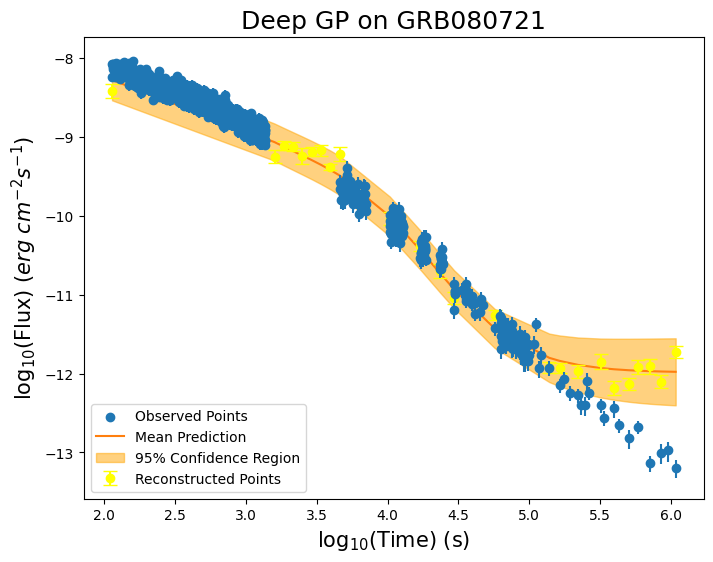


-----TRAINING FOR GRB080810-----


-----ORIGINAL GRB-----



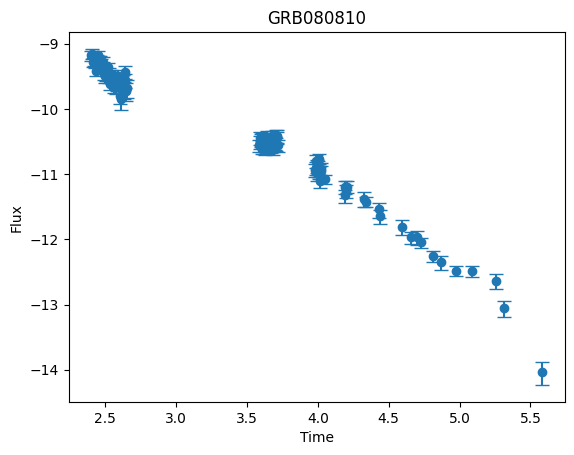


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.0916
Iteration 40/500 - Loss: 40.7549
Iteration 60/500 - Loss: 29.2209
Iteration 80/500 - Loss: 16.6799
Iteration 100/500 - Loss: 8.0209
Iteration 120/500 - Loss: 3.7657
Iteration 140/500 - Loss: 1.9563
Iteration 160/500 - Loss: 1.2151
Iteration 180/500 - Loss: 0.7233
Iteration 200/500 - Loss: 0.3744
Iteration 220/500 - Loss: 0.2493
Iteration 240/500 - Loss: 0.1554
Iteration 260/500 - Loss: 0.0804
Iteration 280/500 - Loss: 0.0206
Iteration 300/500 - Loss: -0.0272
Iteration 320/500 - Loss: -0.0659
Iteration 340/500 - Loss: -0.0977
Iteration 360/500 - Loss: -0.1244
Iteration 380/500 - Loss: -0.1458
Iteration 400/500 - Loss: 0.5532
Iteration 420/500 - Loss: -0.0329
Iteration 440/500 - Loss: -0.0959
Iteration 460/500 - Loss: -0.1336
Iteration 480/500 - Loss: -0.1547
Iteration 500/500 - Loss: -0.1683

-----RECONSTRUCTED GRB-----



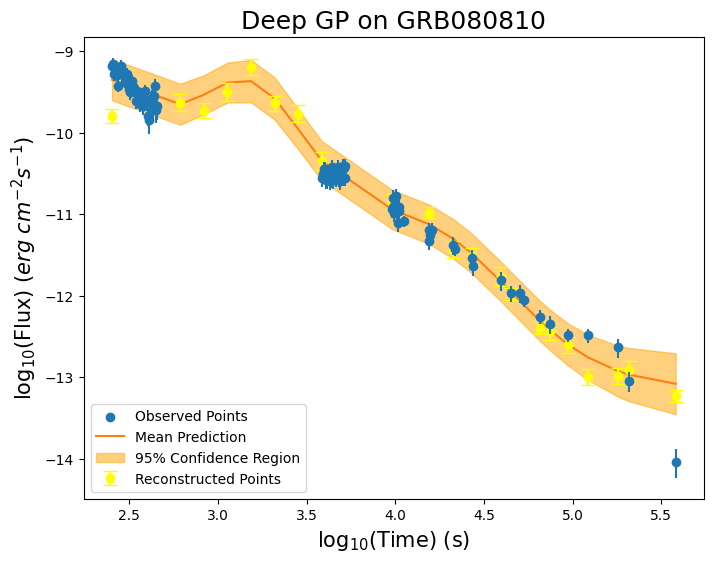


-----TRAINING FOR GRB080905B-----


-----ORIGINAL GRB-----



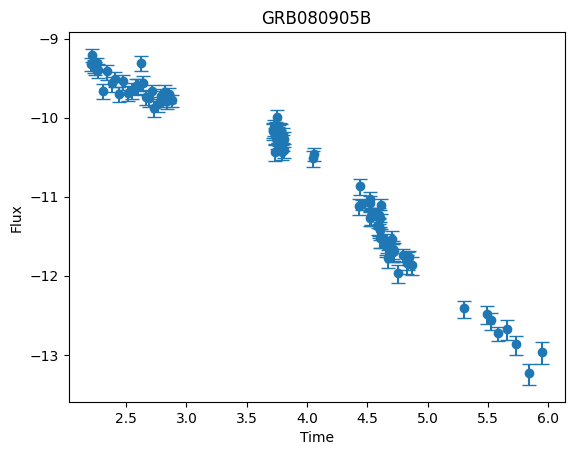


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.9022
Iteration 40/500 - Loss: 39.2409
Iteration 60/500 - Loss: 22.8250
Iteration 80/500 - Loss: 10.4765
Iteration 100/500 - Loss: 4.7672
Iteration 120/500 - Loss: 1.7879
Iteration 140/500 - Loss: 0.6825
Iteration 160/500 - Loss: 0.2610
Iteration 180/500 - Loss: 0.0035
Iteration 200/500 - Loss: -0.1507
Iteration 220/500 - Loss: -0.2014
Iteration 240/500 - Loss: -0.2378
Iteration 260/500 - Loss: -0.2669
Iteration 280/500 - Loss: -0.2908
Iteration 300/500 - Loss: -0.3109
Iteration 320/500 - Loss: -0.3280
Iteration 340/500 - Loss: -0.3430
Iteration 360/500 - Loss: -0.3562
Iteration 380/500 - Loss: -0.3680
Iteration 400/500 - Loss: -0.3786
Iteration 420/500 - Loss: -0.3837
Iteration 440/500 - Loss: -0.3884
Iteration 460/500 - Loss: -0.3929
Iteration 480/500 - Loss: -0.3973
Iteration 500/500 - Loss: -0.4015

-----RECONSTRUCTED GRB-----



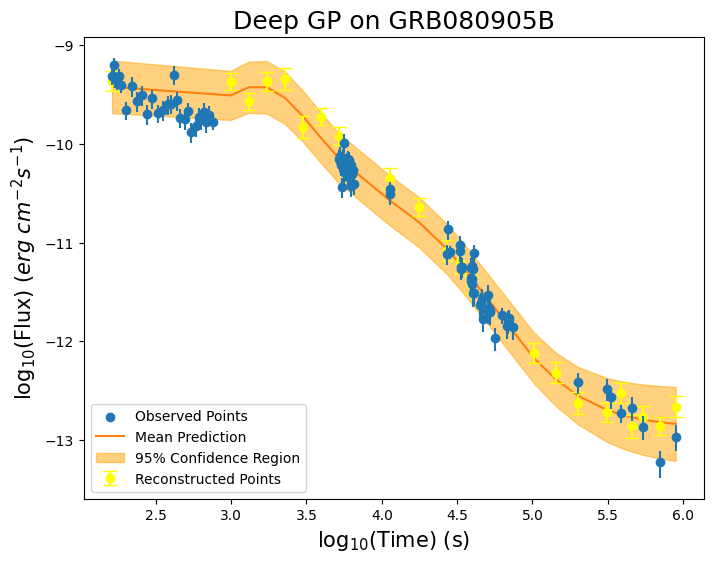


-----TRAINING FOR GRB080928-----


-----ORIGINAL GRB-----



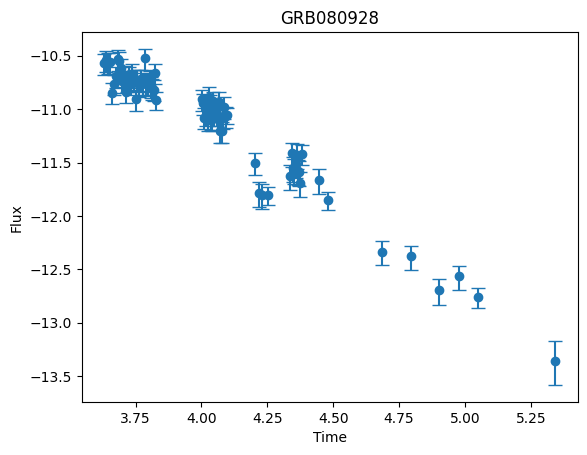


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.1413
Iteration 40/500 - Loss: 37.2982
Iteration 60/500 - Loss: 25.0436
Iteration 80/500 - Loss: 13.6150
Iteration 100/500 - Loss: 7.1223
Iteration 120/500 - Loss: 3.7769
Iteration 140/500 - Loss: 2.1824
Iteration 160/500 - Loss: 1.5017
Iteration 180/500 - Loss: 1.2112
Iteration 200/500 - Loss: 1.0904
Iteration 220/500 - Loss: 1.0043
Iteration 240/500 - Loss: 0.9615
Iteration 260/500 - Loss: 0.9265
Iteration 280/500 - Loss: 0.8968
Iteration 300/500 - Loss: 0.8710
Iteration 320/500 - Loss: 0.8484
Iteration 340/500 - Loss: 0.8285
Iteration 360/500 - Loss: 0.8107
Iteration 380/500 - Loss: 0.7947
Iteration 400/500 - Loss: 0.7803
Iteration 420/500 - Loss: 0.7732
Iteration 440/500 - Loss: 0.7666
Iteration 460/500 - Loss: 0.7603
Iteration 480/500 - Loss: 0.7542
Iteration 500/500 - Loss: 0.7481

-----RECONSTRUCTED GRB-----



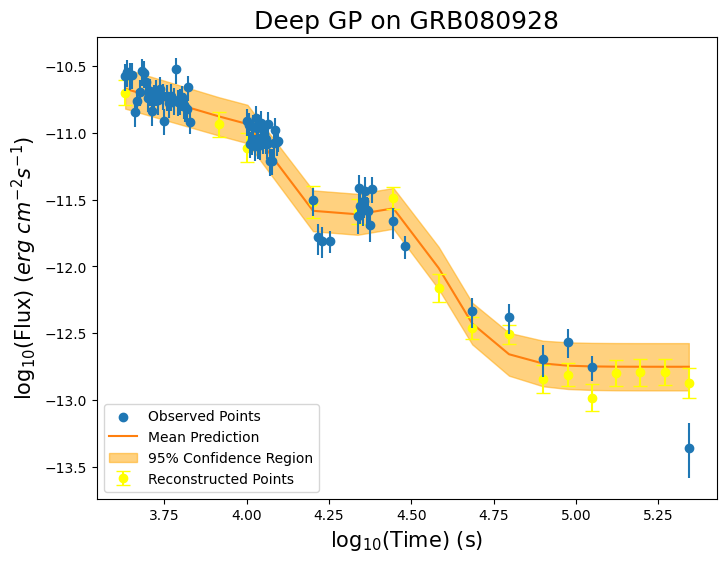


-----TRAINING FOR GRB081007-----


-----ORIGINAL GRB-----



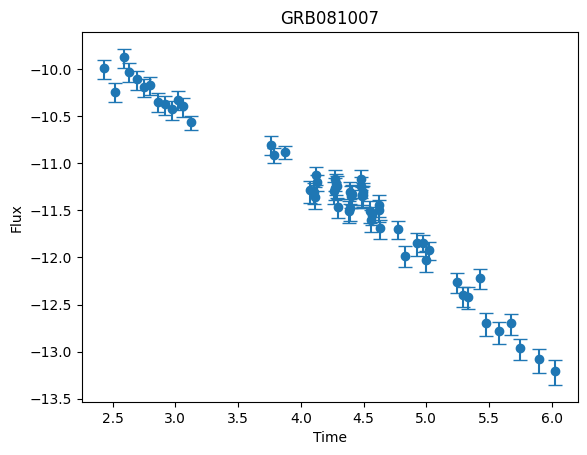


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.4112
Iteration 40/500 - Loss: 31.0243
Iteration 60/500 - Loss: 13.2075
Iteration 80/500 - Loss: 5.0006
Iteration 100/500 - Loss: 1.9411
Iteration 120/500 - Loss: 1.0244
Iteration 140/500 - Loss: 0.7101
Iteration 160/500 - Loss: 0.5522
Iteration 180/500 - Loss: 0.4409
Iteration 200/500 - Loss: 0.3351
Iteration 220/500 - Loss: 0.2735
Iteration 240/500 - Loss: 0.2139
Iteration 260/500 - Loss: 0.1585
Iteration 280/500 - Loss: 0.1116
Iteration 300/500 - Loss: 0.0679
Iteration 320/500 - Loss: 0.0309
Iteration 340/500 - Loss: 0.0054
Iteration 360/500 - Loss: -0.0370
Iteration 380/500 - Loss: -0.0632
Iteration 400/500 - Loss: -0.0872
Iteration 420/500 - Loss: -0.0982
Iteration 440/500 - Loss: -0.1078
Iteration 460/500 - Loss: -0.1169
Iteration 480/500 - Loss: -0.1254
Iteration 500/500 - Loss: -0.1334

-----RECONSTRUCTED GRB-----



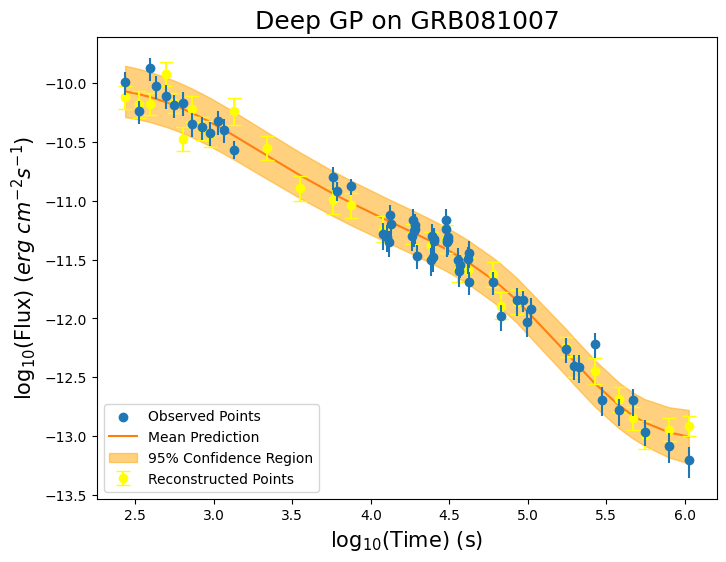


-----TRAINING FOR GRB081008-----


-----ORIGINAL GRB-----



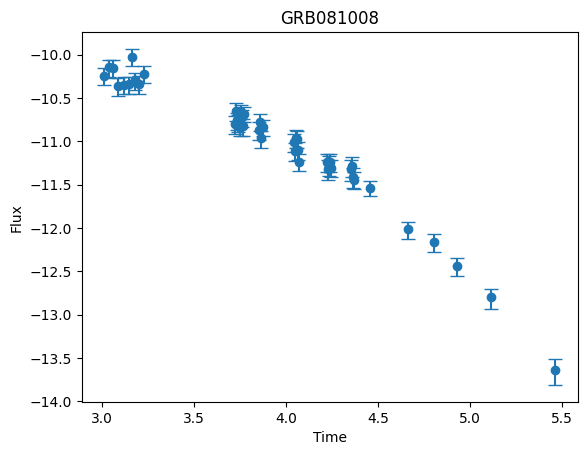


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.1023
Iteration 40/500 - Loss: 33.5241
Iteration 60/500 - Loss: 17.6662
Iteration 80/500 - Loss: 9.0281
Iteration 100/500 - Loss: 4.9280
Iteration 120/500 - Loss: 2.9805
Iteration 140/500 - Loss: 1.8979
Iteration 160/500 - Loss: 1.2266
Iteration 180/500 - Loss: 0.7882
Iteration 200/500 - Loss: 0.4864
Iteration 220/500 - Loss: 0.3740
Iteration 240/500 - Loss: 0.2848
Iteration 260/500 - Loss: 0.2090
Iteration 280/500 - Loss: 0.1468
Iteration 300/500 - Loss: 0.0886
Iteration 320/500 - Loss: 0.0393
Iteration 340/500 - Loss: -0.0033
Iteration 360/500 - Loss: -0.0406
Iteration 380/500 - Loss: -0.0719
Iteration 400/500 - Loss: -0.1005
Iteration 420/500 - Loss: -0.1151
Iteration 440/500 - Loss: -0.1273
Iteration 460/500 - Loss: -0.1389
Iteration 480/500 - Loss: -0.1498
Iteration 500/500 - Loss: -0.1600

-----RECONSTRUCTED GRB-----



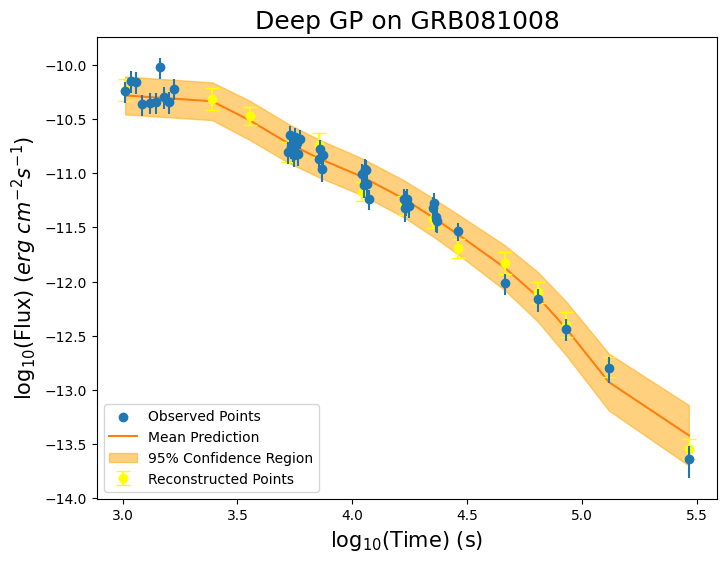


-----TRAINING FOR GRB081028A-----


-----ORIGINAL GRB-----



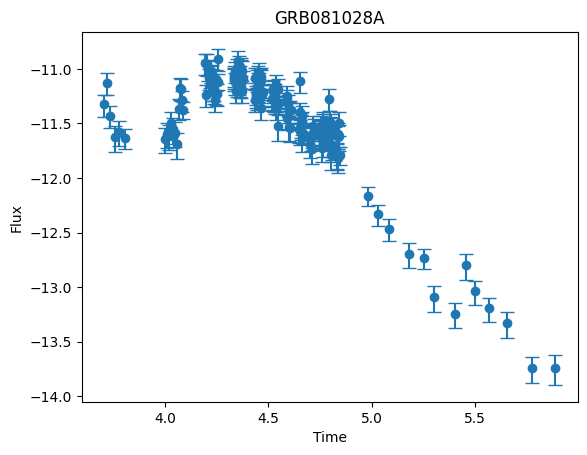


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.1635
Iteration 40/500 - Loss: 35.3896
Iteration 60/500 - Loss: 22.4557
Iteration 80/500 - Loss: 14.2946
Iteration 100/500 - Loss: 9.0830
Iteration 120/500 - Loss: 5.6591
Iteration 140/500 - Loss: 3.4284
Iteration 160/500 - Loss: 2.0792
Iteration 180/500 - Loss: 1.5546
Iteration 200/500 - Loss: 1.3166
Iteration 220/500 - Loss: 1.2391
Iteration 240/500 - Loss: 1.1807
Iteration 260/500 - Loss: 1.1314
Iteration 280/500 - Loss: 1.0890
Iteration 300/500 - Loss: 1.0536
Iteration 320/500 - Loss: 1.0216
Iteration 340/500 - Loss: 0.9948
Iteration 360/500 - Loss: 0.9717
Iteration 380/500 - Loss: 0.9492
Iteration 400/500 - Loss: 0.9442
Iteration 420/500 - Loss: 0.9236
Iteration 440/500 - Loss: 0.9145
Iteration 460/500 - Loss: 0.9065
Iteration 480/500 - Loss: 0.8988
Iteration 500/500 - Loss: 0.8912

-----RECONSTRUCTED GRB-----



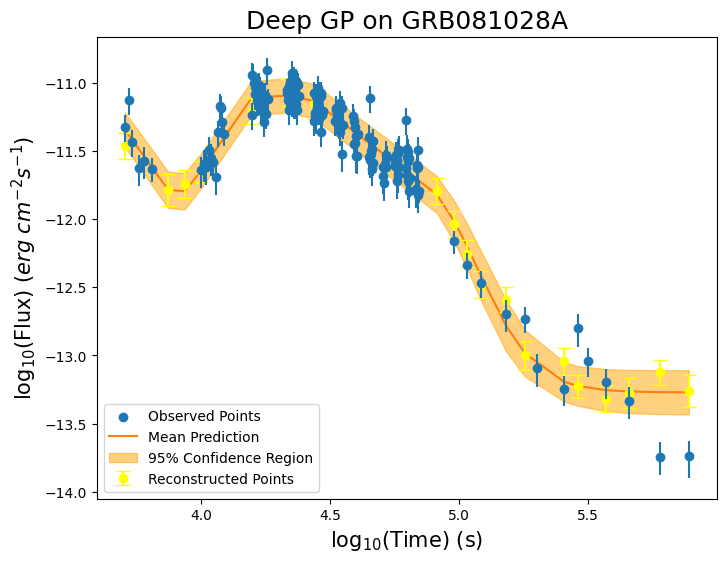


-----TRAINING FOR GRB081029-----


-----ORIGINAL GRB-----



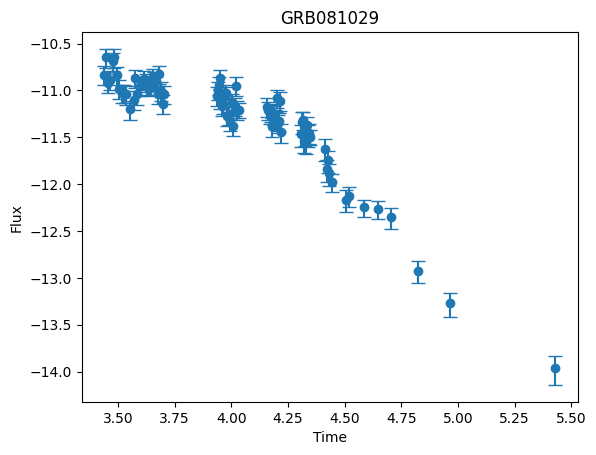


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.2507
Iteration 40/500 - Loss: 39.1095
Iteration 60/500 - Loss: 28.7179
Iteration 80/500 - Loss: 17.4694
Iteration 100/500 - Loss: 9.8997
Iteration 120/500 - Loss: 6.2709
Iteration 140/500 - Loss: 4.2709
Iteration 160/500 - Loss: 3.2605
Iteration 180/500 - Loss: 2.5908
Iteration 200/500 - Loss: 2.0389
Iteration 220/500 - Loss: 1.8042
Iteration 240/500 - Loss: 1.6122
Iteration 260/500 - Loss: 1.4415
Iteration 280/500 - Loss: 1.2919
Iteration 300/500 - Loss: 1.1545
Iteration 320/500 - Loss: 1.0302
Iteration 340/500 - Loss: 0.9253
Iteration 360/500 - Loss: 0.8304
Iteration 380/500 - Loss: 0.7497
Iteration 400/500 - Loss: 0.6822
Iteration 420/500 - Loss: 0.6506
Iteration 440/500 - Loss: 0.6236
Iteration 460/500 - Loss: 0.5993
Iteration 480/500 - Loss: 0.5770
Iteration 500/500 - Loss: 0.5568

-----RECONSTRUCTED GRB-----



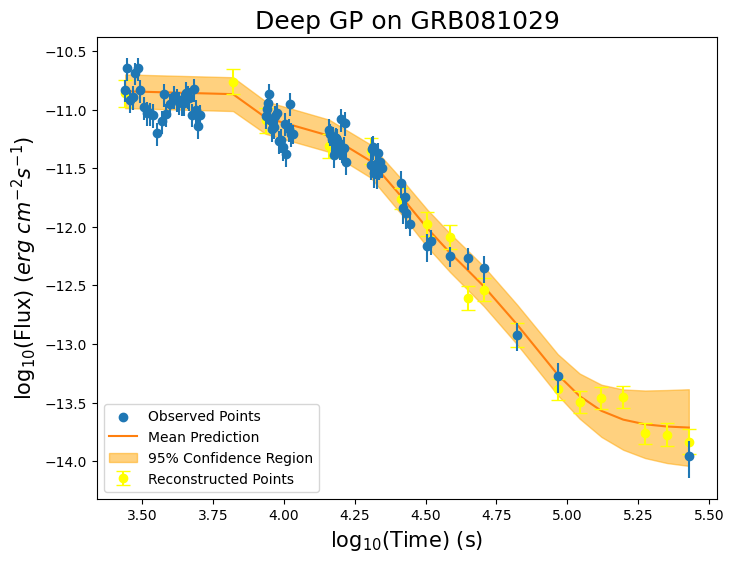


-----TRAINING FOR GRB081221-----


-----ORIGINAL GRB-----



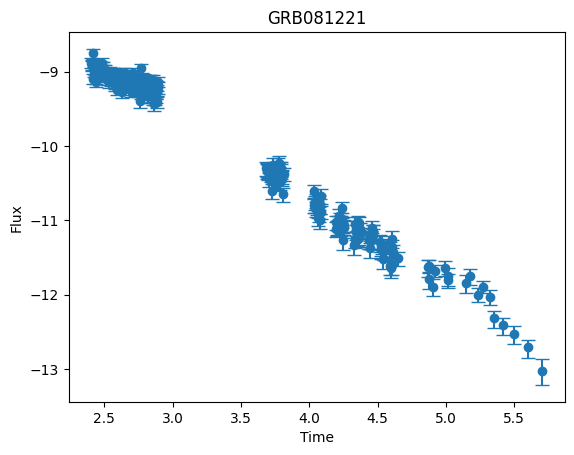


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.2375
Iteration 40/500 - Loss: 40.0534
Iteration 60/500 - Loss: 29.0318
Iteration 80/500 - Loss: 15.4114
Iteration 100/500 - Loss: 6.2162
Iteration 120/500 - Loss: 2.1169
Iteration 140/500 - Loss: 0.7831
Iteration 160/500 - Loss: 0.4879
Iteration 180/500 - Loss: -0.0093
Iteration 200/500 - Loss: -0.1907
Iteration 220/500 - Loss: -0.2434
Iteration 240/500 - Loss: -0.2818
Iteration 260/500 - Loss: -0.3155
Iteration 280/500 - Loss: -0.3462
Iteration 300/500 - Loss: -0.3745
Iteration 320/500 - Loss: -0.4008
Iteration 340/500 - Loss: -0.4253
Iteration 360/500 - Loss: -0.4481
Iteration 380/500 - Loss: -0.4693
Iteration 400/500 - Loss: -0.4892
Iteration 420/500 - Loss: -0.4991
Iteration 440/500 - Loss: -0.5082
Iteration 460/500 - Loss: -0.5172
Iteration 480/500 - Loss: -0.5260
Iteration 500/500 - Loss: -0.5345

-----RECONSTRUCTED GRB-----



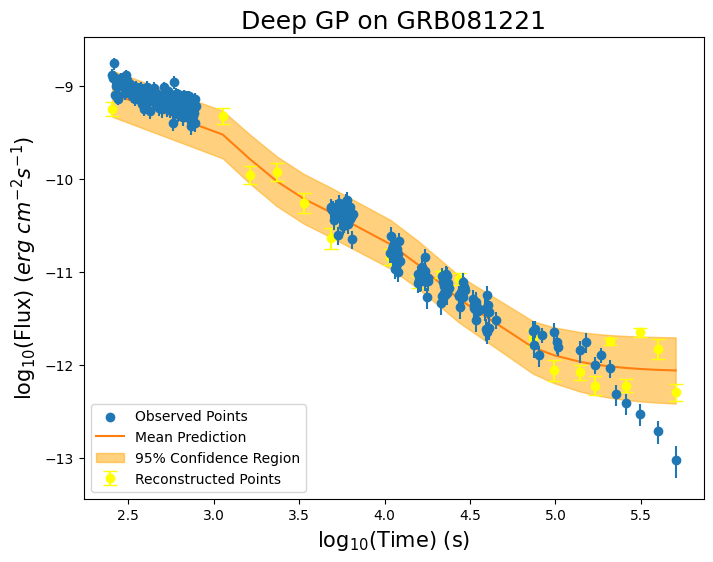


-----TRAINING FOR GRB081230-----


-----ORIGINAL GRB-----



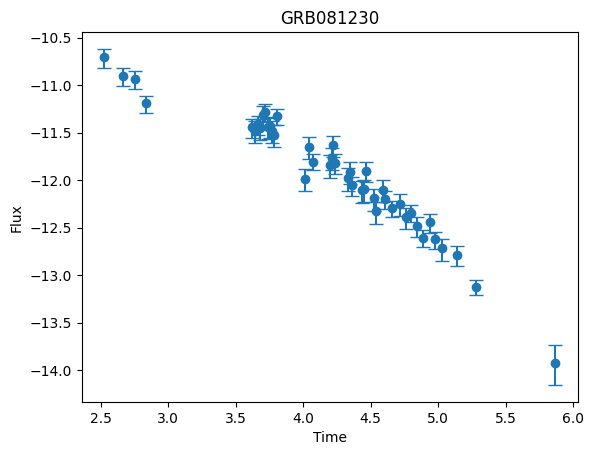


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.3660
Iteration 40/500 - Loss: 29.4471
Iteration 60/500 - Loss: 15.7271
Iteration 80/500 - Loss: 9.4269
Iteration 100/500 - Loss: 6.1003
Iteration 120/500 - Loss: 3.9732
Iteration 140/500 - Loss: 2.6583
Iteration 160/500 - Loss: 1.8797
Iteration 180/500 - Loss: 1.3715
Iteration 200/500 - Loss: 1.0321
Iteration 220/500 - Loss: 0.9014
Iteration 240/500 - Loss: 0.7983
Iteration 260/500 - Loss: 0.7108
Iteration 280/500 - Loss: 0.6368
Iteration 300/500 - Loss: 0.5743
Iteration 320/500 - Loss: 0.5210
Iteration 340/500 - Loss: 0.4756
Iteration 360/500 - Loss: 0.4350
Iteration 380/500 - Loss: 0.3985
Iteration 400/500 - Loss: 0.3638
Iteration 420/500 - Loss: 0.3457
Iteration 440/500 - Loss: 0.3281
Iteration 460/500 - Loss: 0.3102
Iteration 480/500 - Loss: 0.2918
Iteration 500/500 - Loss: 0.2731

-----RECONSTRUCTED GRB-----



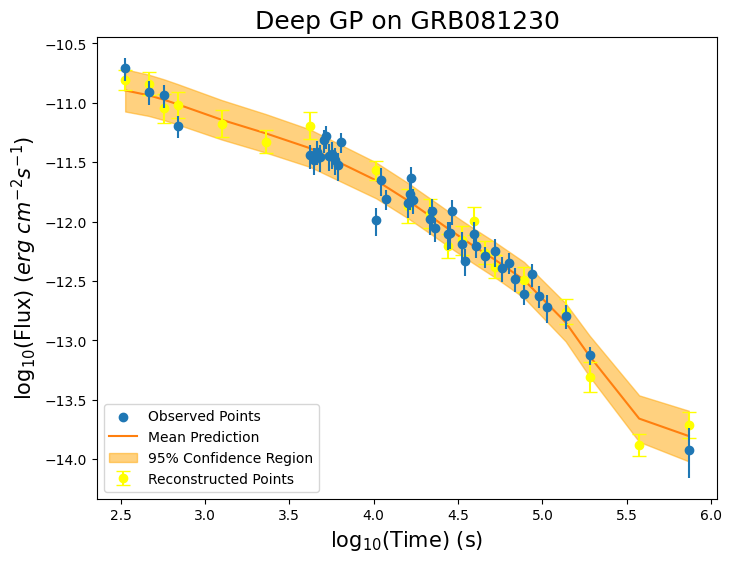


-----TRAINING FOR GRB090102-----


-----ORIGINAL GRB-----



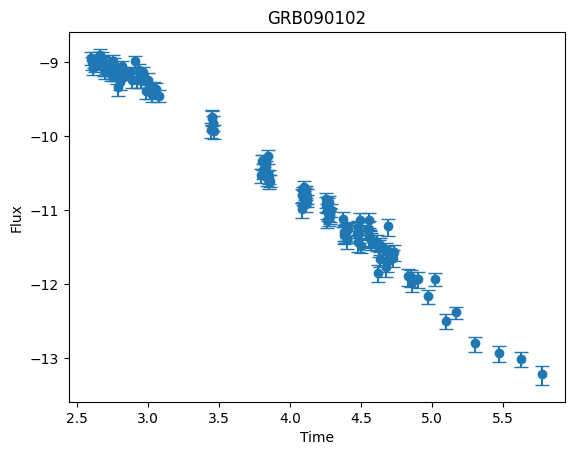


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 57.4871
Iteration 40/500 - Loss: 42.3825
Iteration 60/500 - Loss: 27.8720
Iteration 80/500 - Loss: 13.3546
Iteration 100/500 - Loss: 5.2567
Iteration 120/500 - Loss: 2.2338
Iteration 140/500 - Loss: 1.0372
Iteration 160/500 - Loss: 0.4428
Iteration 180/500 - Loss: 0.1194
Iteration 200/500 - Loss: -0.0681
Iteration 220/500 - Loss: -0.1466
Iteration 240/500 - Loss: -0.2040
Iteration 260/500 - Loss: -0.2520
Iteration 280/500 - Loss: -0.2931
Iteration 300/500 - Loss: -0.3284
Iteration 320/500 - Loss: -0.3589
Iteration 340/500 - Loss: -0.3855
Iteration 360/500 - Loss: -0.4087
Iteration 380/500 - Loss: -0.4294
Iteration 400/500 - Loss: -0.4480
Iteration 420/500 - Loss: -0.4574
Iteration 440/500 - Loss: -0.4659
Iteration 460/500 - Loss: -0.4743
Iteration 480/500 - Loss: -0.4827
Iteration 500/500 - Loss: -0.4912

-----RECONSTRUCTED GRB-----



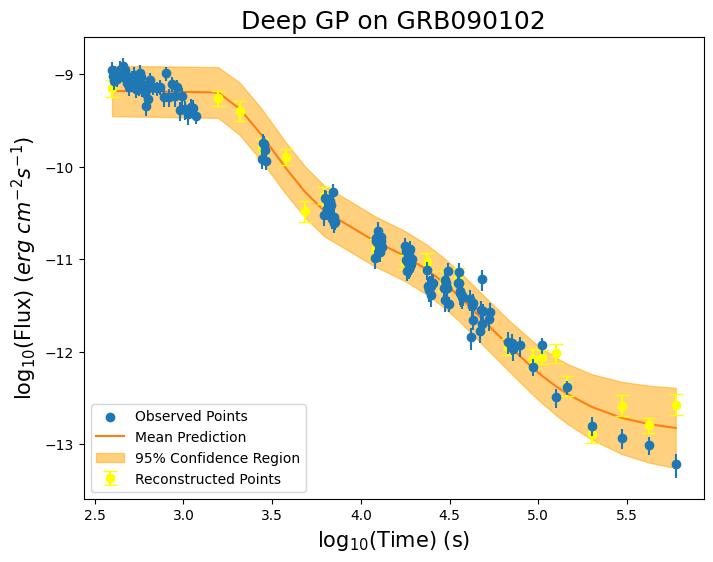


-----TRAINING FOR GRB090205-----


-----ORIGINAL GRB-----



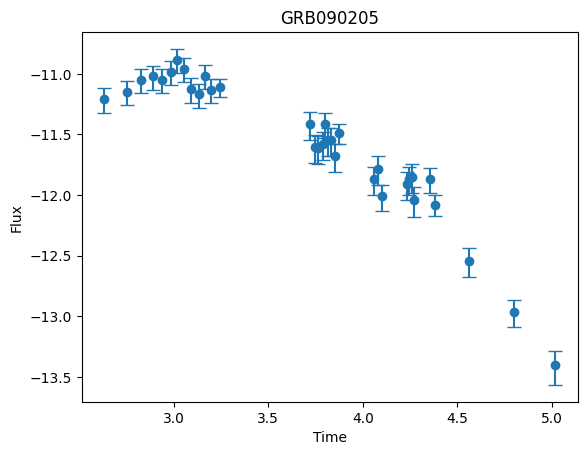


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.7238
Iteration 40/500 - Loss: 32.1850
Iteration 60/500 - Loss: 17.8743
Iteration 80/500 - Loss: 9.3821
Iteration 100/500 - Loss: 5.1762
Iteration 120/500 - Loss: 2.9121
Iteration 140/500 - Loss: 1.7091
Iteration 160/500 - Loss: 1.0386
Iteration 180/500 - Loss: 0.6604
Iteration 200/500 - Loss: 0.4434
Iteration 220/500 - Loss: 0.3706
Iteration 240/500 - Loss: 0.3210
Iteration 260/500 - Loss: 0.2821
Iteration 280/500 - Loss: 0.2481
Iteration 300/500 - Loss: 0.2165
Iteration 320/500 - Loss: 0.1845
Iteration 340/500 - Loss: 0.1520
Iteration 360/500 - Loss: 0.1212
Iteration 380/500 - Loss: 0.0910
Iteration 400/500 - Loss: 0.0576
Iteration 420/500 - Loss: 0.0381
Iteration 440/500 - Loss: 0.0195
Iteration 460/500 - Loss: 0.0025
Iteration 480/500 - Loss: -0.0126
Iteration 500/500 - Loss: -0.0259

-----RECONSTRUCTED GRB-----



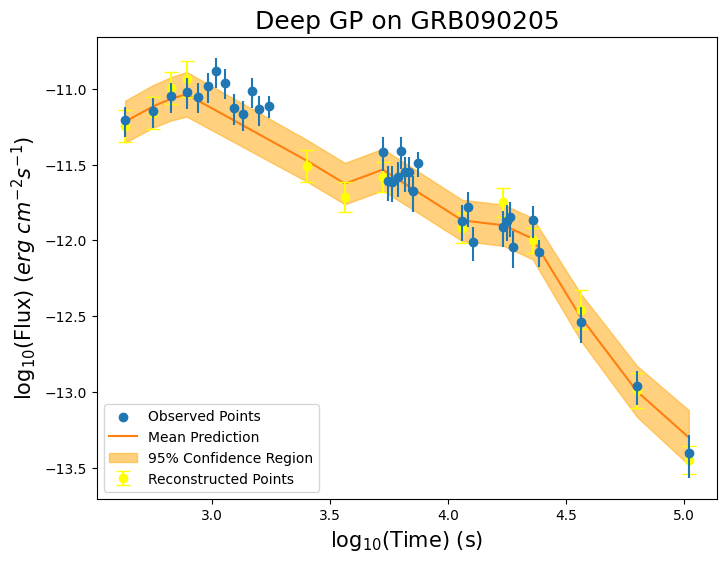


-----TRAINING FOR GRB090418A-----


-----ORIGINAL GRB-----



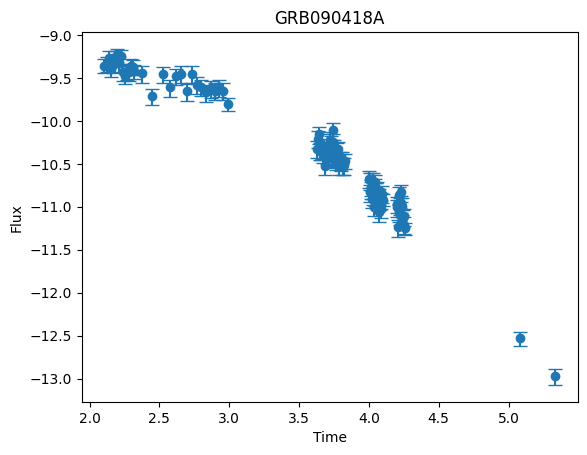


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.1225
Iteration 40/500 - Loss: 38.3808
Iteration 60/500 - Loss: 21.2658
Iteration 80/500 - Loss: 9.7692
Iteration 100/500 - Loss: 5.6162
Iteration 120/500 - Loss: 3.6514
Iteration 140/500 - Loss: 2.5841
Iteration 160/500 - Loss: 1.8896
Iteration 180/500 - Loss: 1.3297
Iteration 200/500 - Loss: 0.8975
Iteration 220/500 - Loss: 0.6778
Iteration 240/500 - Loss: 0.5107
Iteration 260/500 - Loss: 0.3671
Iteration 280/500 - Loss: 0.2433
Iteration 300/500 - Loss: 0.1385
Iteration 320/500 - Loss: 0.0526
Iteration 340/500 - Loss: -0.0153
Iteration 360/500 - Loss: -0.0679
Iteration 380/500 - Loss: -0.1061
Iteration 400/500 - Loss: -0.1368
Iteration 420/500 - Loss: -0.1492
Iteration 440/500 - Loss: -0.1594
Iteration 460/500 - Loss: -0.1684
Iteration 480/500 - Loss: -0.1765
Iteration 500/500 - Loss: -0.1837

-----RECONSTRUCTED GRB-----



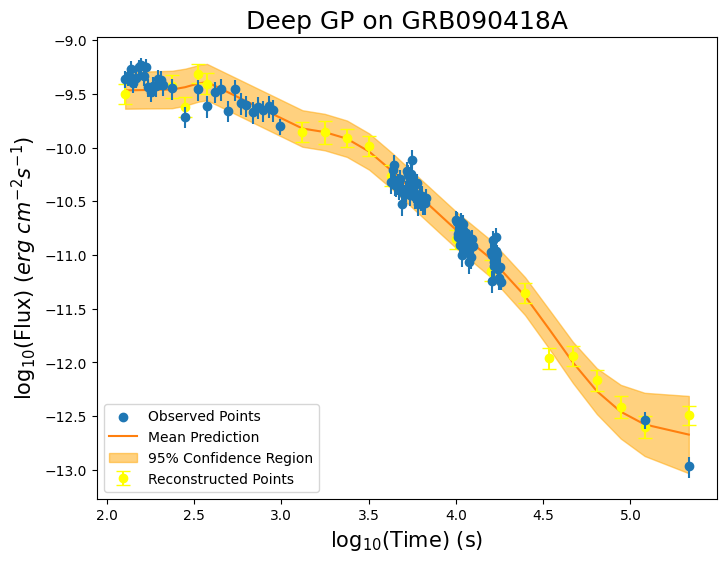


-----TRAINING FOR GRB090424-----


-----ORIGINAL GRB-----



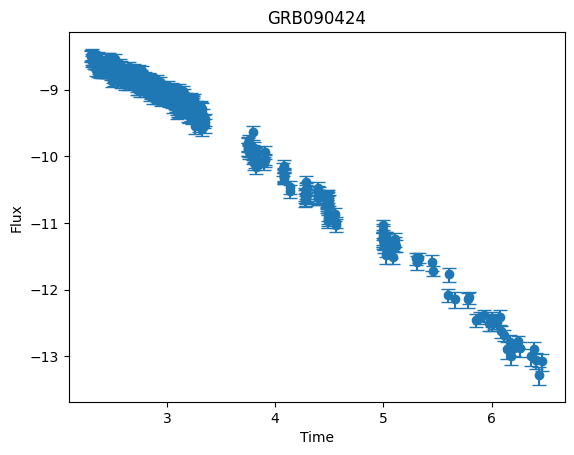


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.8363
Iteration 40/500 - Loss: 40.7492
Iteration 60/500 - Loss: 32.3229
Iteration 80/500 - Loss: 21.5945
Iteration 100/500 - Loss: 12.6358
Iteration 120/500 - Loss: 6.4208
Iteration 140/500 - Loss: 3.0768
Iteration 160/500 - Loss: 1.6333
Iteration 180/500 - Loss: 0.8562
Iteration 200/500 - Loss: 0.3732
Iteration 220/500 - Loss: 0.1768
Iteration 240/500 - Loss: 0.0281
Iteration 260/500 - Loss: -0.0991
Iteration 280/500 - Loss: -0.2079
Iteration 300/500 - Loss: -0.3007
Iteration 320/500 - Loss: -0.3796
Iteration 340/500 - Loss: -0.4466
Iteration 360/500 - Loss: -0.5036
Iteration 380/500 - Loss: -0.5521
Iteration 400/500 - Loss: -0.5936
Iteration 420/500 - Loss: -0.6129
Iteration 440/500 - Loss: -0.6299
Iteration 460/500 - Loss: -0.6459
Iteration 480/500 - Loss: -0.6611
Iteration 500/500 - Loss: -0.6752

-----RECONSTRUCTED GRB-----



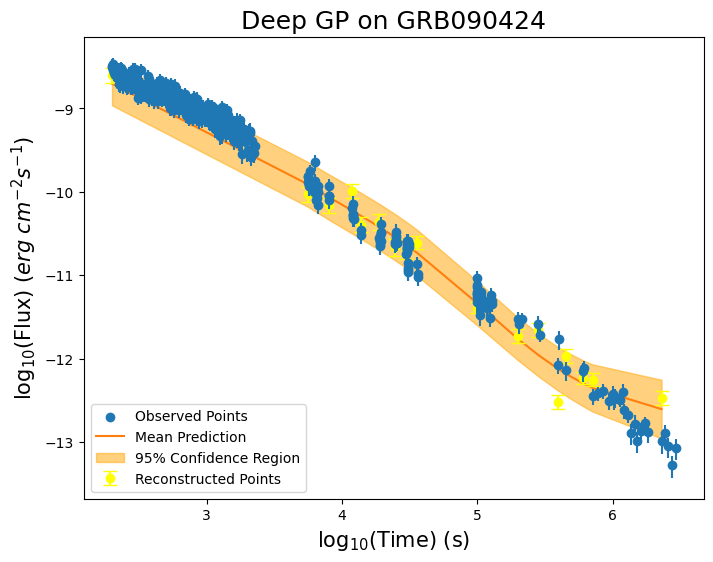


-----TRAINING FOR GRB090510-----


-----ORIGINAL GRB-----



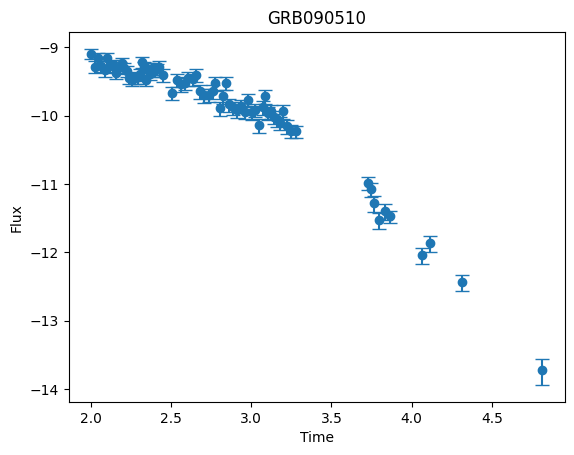


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.1841
Iteration 40/500 - Loss: 36.4702
Iteration 60/500 - Loss: 23.6854
Iteration 80/500 - Loss: 12.2402
Iteration 100/500 - Loss: 6.6132
Iteration 120/500 - Loss: 4.3723
Iteration 140/500 - Loss: 2.8497
Iteration 160/500 - Loss: 2.0108
Iteration 180/500 - Loss: 1.4745
Iteration 200/500 - Loss: 1.0996
Iteration 220/500 - Loss: 0.9524
Iteration 240/500 - Loss: 0.8307
Iteration 260/500 - Loss: 0.7175
Iteration 280/500 - Loss: 0.6102
Iteration 300/500 - Loss: 0.5075
Iteration 320/500 - Loss: 0.4089
Iteration 340/500 - Loss: 0.3151
Iteration 360/500 - Loss: 0.2272
Iteration 380/500 - Loss: 0.1466
Iteration 400/500 - Loss: 0.0741
Iteration 420/500 - Loss: 0.0395
Iteration 440/500 - Loss: 0.0087
Iteration 460/500 - Loss: -0.0204
Iteration 480/500 - Loss: -0.0477
Iteration 500/500 - Loss: -0.0732

-----RECONSTRUCTED GRB-----



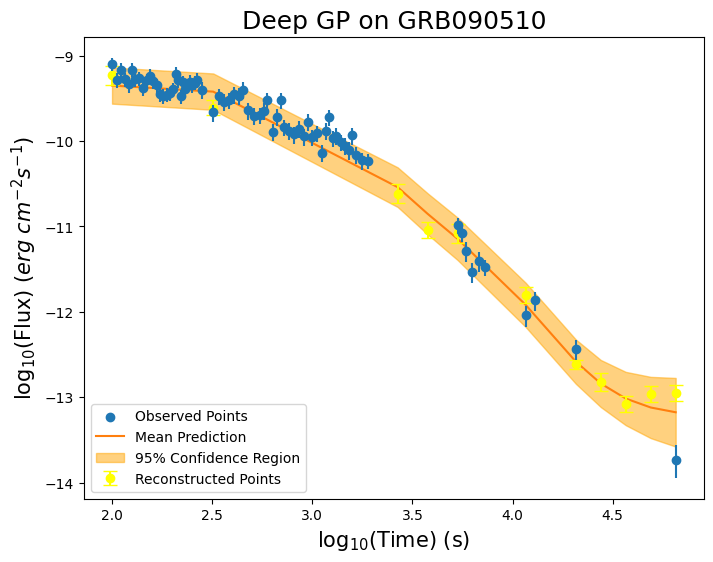


-----TRAINING FOR GRB090516-----


-----ORIGINAL GRB-----



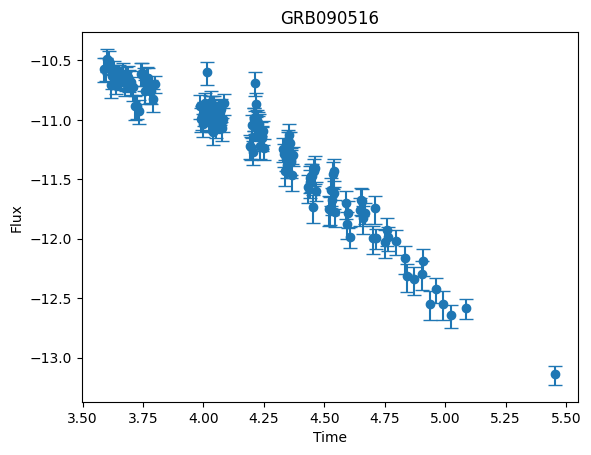


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.5310
Iteration 40/500 - Loss: 39.1694
Iteration 60/500 - Loss: 25.4471
Iteration 80/500 - Loss: 13.2844
Iteration 100/500 - Loss: 6.9912
Iteration 120/500 - Loss: 4.4194
Iteration 140/500 - Loss: 2.9412
Iteration 160/500 - Loss: 2.2595
Iteration 180/500 - Loss: 1.8412
Iteration 200/500 - Loss: 1.5494
Iteration 220/500 - Loss: 1.4183
Iteration 240/500 - Loss: 1.3054
Iteration 260/500 - Loss: 1.1963
Iteration 280/500 - Loss: 1.0873
Iteration 300/500 - Loss: 0.9763
Iteration 320/500 - Loss: 0.8643
Iteration 340/500 - Loss: 0.7549
Iteration 360/500 - Loss: 0.6550
Iteration 380/500 - Loss: 0.5658
Iteration 400/500 - Loss: 0.5014
Iteration 420/500 - Loss: 0.4670
Iteration 440/500 - Loss: 0.4439
Iteration 460/500 - Loss: 0.4242
Iteration 480/500 - Loss: 0.4075
Iteration 500/500 - Loss: 0.3933

-----RECONSTRUCTED GRB-----



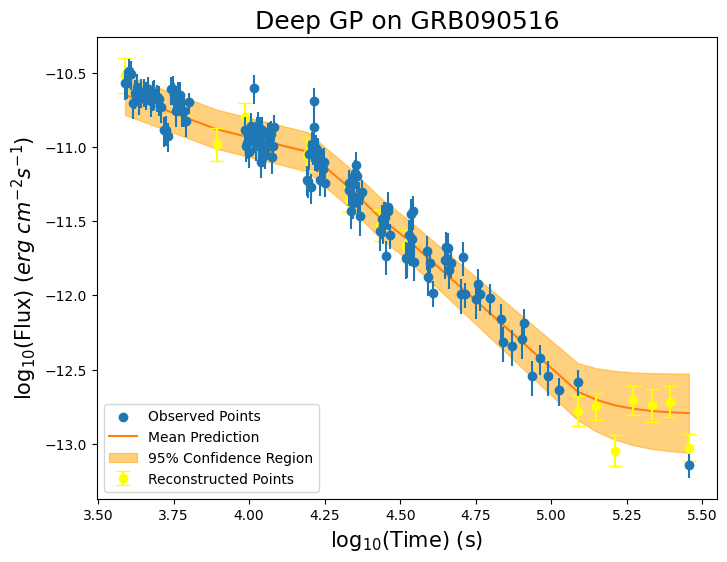


-----TRAINING FOR GRB090529-----


-----ORIGINAL GRB-----



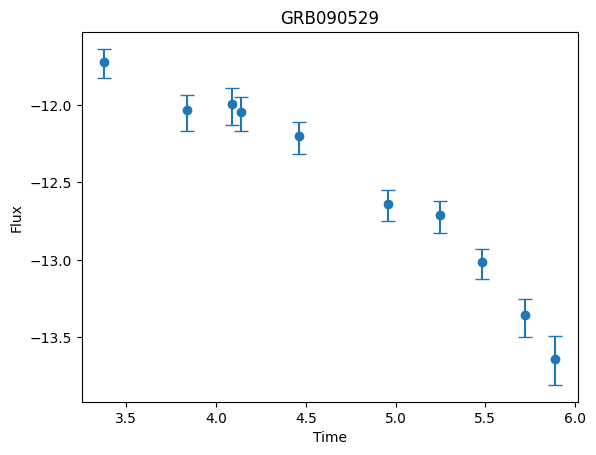


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 59.2145
Iteration 40/500 - Loss: 38.7942
Iteration 60/500 - Loss: 22.3201
Iteration 80/500 - Loss: 13.0740
Iteration 100/500 - Loss: 8.8179
Iteration 120/500 - Loss: 6.5476
Iteration 140/500 - Loss: 4.9925
Iteration 160/500 - Loss: 3.8115
Iteration 180/500 - Loss: 2.9350
Iteration 200/500 - Loss: 2.3114
Iteration 220/500 - Loss: 2.0776
Iteration 240/500 - Loss: 1.8906
Iteration 260/500 - Loss: 1.7217
Iteration 280/500 - Loss: 1.5659
Iteration 300/500 - Loss: 1.4223
Iteration 320/500 - Loss: 1.2904
Iteration 340/500 - Loss: 1.1701
Iteration 360/500 - Loss: 1.0606
Iteration 380/500 - Loss: 0.9616
Iteration 400/500 - Loss: 0.8721
Iteration 420/500 - Loss: 0.8288
Iteration 440/500 - Loss: 0.7894
Iteration 460/500 - Loss: 0.7518
Iteration 480/500 - Loss: 0.7156
Iteration 500/500 - Loss: 0.6809

-----RECONSTRUCTED GRB-----



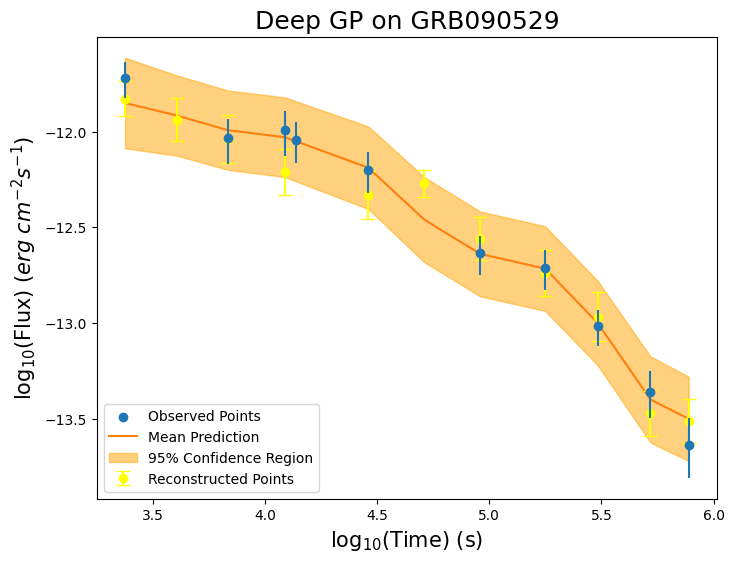


-----TRAINING FOR GRB090530-----


-----ORIGINAL GRB-----



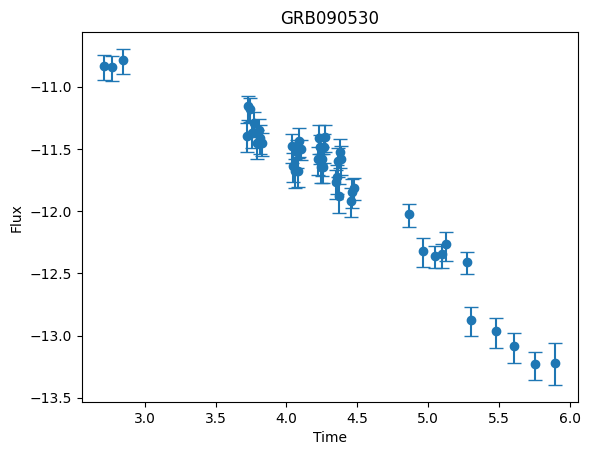


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.2437
Iteration 40/500 - Loss: 35.7536
Iteration 60/500 - Loss: 20.4430
Iteration 80/500 - Loss: 10.4095
Iteration 100/500 - Loss: 5.8510
Iteration 120/500 - Loss: 3.5796
Iteration 140/500 - Loss: 2.2702
Iteration 160/500 - Loss: 1.4671
Iteration 180/500 - Loss: 0.9930
Iteration 200/500 - Loss: 0.7326
Iteration 220/500 - Loss: 0.6492
Iteration 240/500 - Loss: 0.5898
Iteration 260/500 - Loss: 0.5432
Iteration 280/500 - Loss: 0.5062
Iteration 300/500 - Loss: 0.4765
Iteration 320/500 - Loss: 0.4523
Iteration 340/500 - Loss: 0.4322
Iteration 360/500 - Loss: 0.4151
Iteration 380/500 - Loss: 0.4001
Iteration 400/500 - Loss: 0.3866
Iteration 420/500 - Loss: 0.3800
Iteration 440/500 - Loss: 0.3738
Iteration 460/500 - Loss: 0.3678
Iteration 480/500 - Loss: 0.3619
Iteration 500/500 - Loss: 0.3559

-----RECONSTRUCTED GRB-----



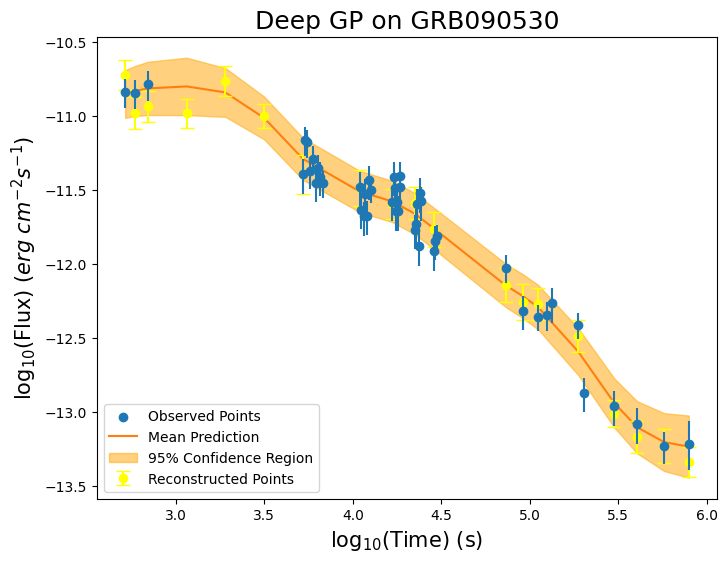


-----TRAINING FOR GRB090618-----


-----ORIGINAL GRB-----



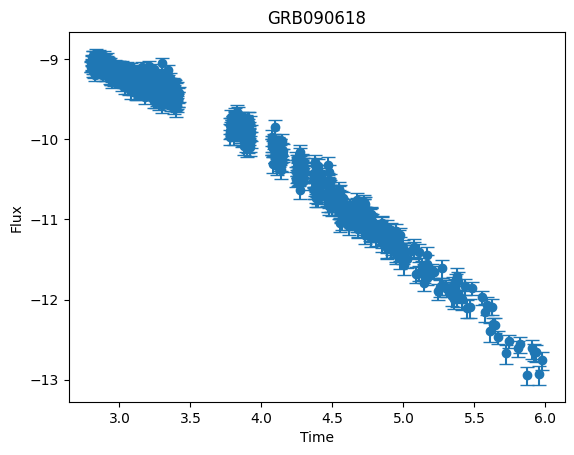


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.6605
Iteration 40/500 - Loss: 41.8232
Iteration 60/500 - Loss: 32.5054
Iteration 80/500 - Loss: 21.6557
Iteration 100/500 - Loss: 11.1551
Iteration 120/500 - Loss: 5.1767
Iteration 140/500 - Loss: 2.5580
Iteration 160/500 - Loss: 1.3769
Iteration 180/500 - Loss: 0.6505
Iteration 200/500 - Loss: 0.3167
Iteration 220/500 - Loss: 0.1920
Iteration 240/500 - Loss: 0.0930
Iteration 260/500 - Loss: 0.0059
Iteration 280/500 - Loss: -0.0714
Iteration 300/500 - Loss: -0.1400
Iteration 320/500 - Loss: -0.2011
Iteration 340/500 - Loss: -0.2555
Iteration 360/500 - Loss: -0.3039
Iteration 380/500 - Loss: -0.3471
Iteration 400/500 - Loss: -0.3857
Iteration 420/500 - Loss: -0.4043
Iteration 440/500 - Loss: -0.4211
Iteration 460/500 - Loss: -0.4372
Iteration 480/500 - Loss: -0.4526
Iteration 500/500 - Loss: -0.4674

-----RECONSTRUCTED GRB-----



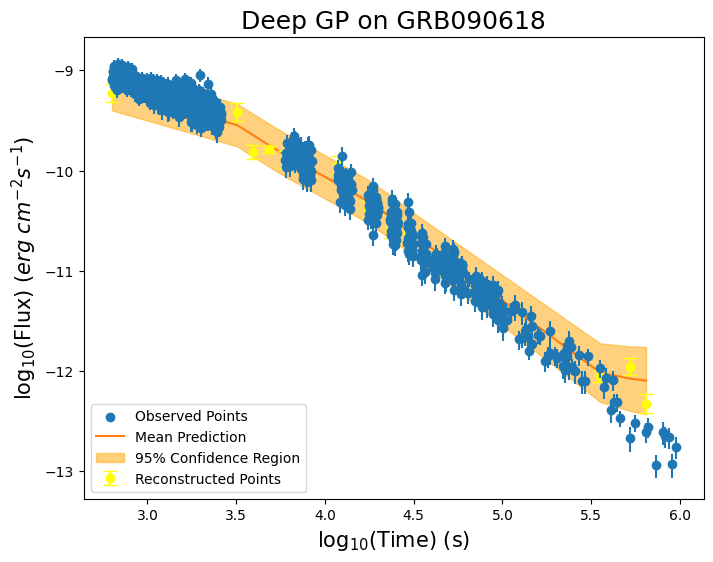


-----TRAINING FOR GRB090809-----


-----ORIGINAL GRB-----



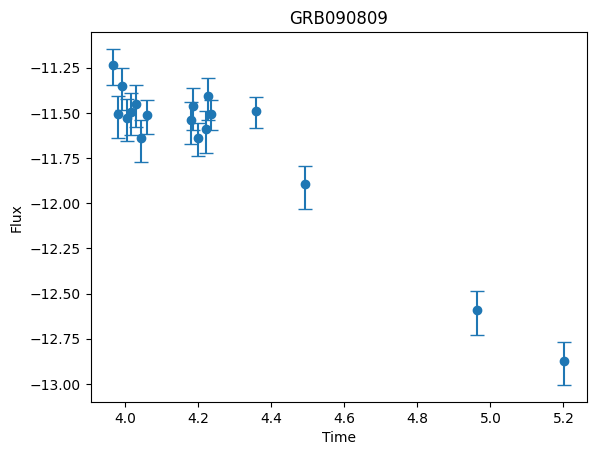


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.4504
Iteration 40/500 - Loss: 37.3781
Iteration 60/500 - Loss: 25.8092
Iteration 80/500 - Loss: 16.2200
Iteration 100/500 - Loss: 9.9476
Iteration 120/500 - Loss: 6.1098
Iteration 140/500 - Loss: 3.9927
Iteration 160/500 - Loss: 2.8262
Iteration 180/500 - Loss: 2.1432
Iteration 200/500 - Loss: 1.6973
Iteration 220/500 - Loss: 1.5166
Iteration 240/500 - Loss: 1.3747
Iteration 260/500 - Loss: 1.2541
Iteration 280/500 - Loss: 1.1529
Iteration 300/500 - Loss: 1.0680
Iteration 320/500 - Loss: 0.9972
Iteration 340/500 - Loss: 0.9385
Iteration 360/500 - Loss: 0.8882
Iteration 380/500 - Loss: 0.8479
Iteration 400/500 - Loss: 0.8098
Iteration 420/500 - Loss: 0.7926
Iteration 440/500 - Loss: 0.7775
Iteration 460/500 - Loss: 0.7632
Iteration 480/500 - Loss: 0.7496
Iteration 500/500 - Loss: 0.7369

-----RECONSTRUCTED GRB-----



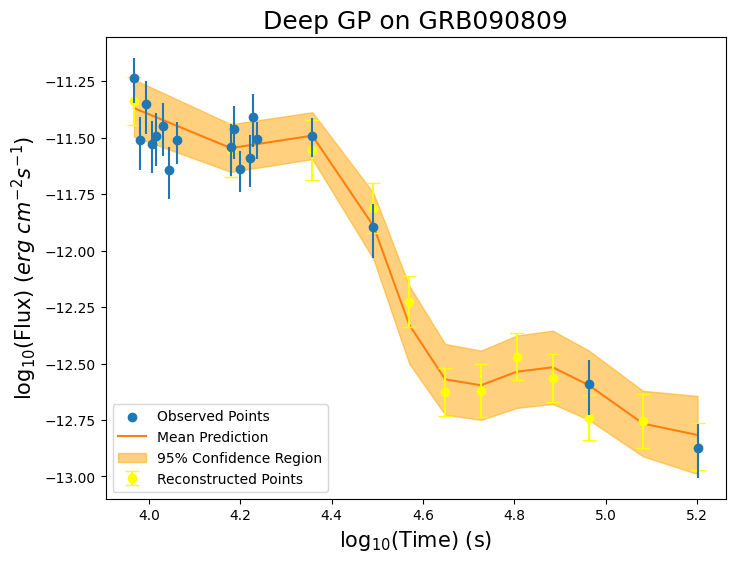


-----TRAINING FOR GRB090927-----


-----ORIGINAL GRB-----



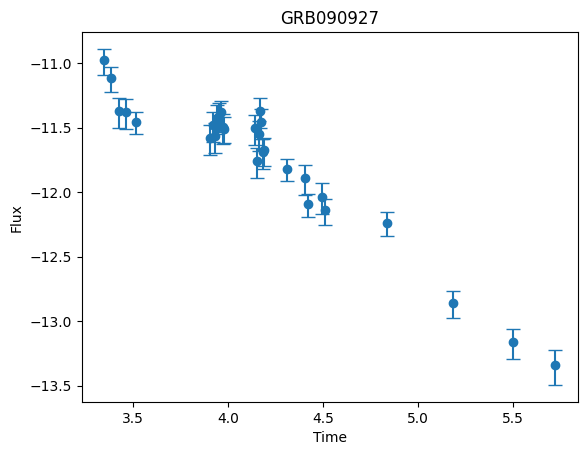


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.3064
Iteration 40/500 - Loss: 32.2358
Iteration 60/500 - Loss: 16.8945
Iteration 80/500 - Loss: 9.2314
Iteration 100/500 - Loss: 5.6166
Iteration 120/500 - Loss: 3.4537
Iteration 140/500 - Loss: 2.2160
Iteration 160/500 - Loss: 1.6554
Iteration 180/500 - Loss: 1.2255
Iteration 200/500 - Loss: 0.8900
Iteration 220/500 - Loss: 0.7493
Iteration 240/500 - Loss: 0.6465
Iteration 260/500 - Loss: 0.5710
Iteration 280/500 - Loss: 0.5143
Iteration 300/500 - Loss: 0.4702
Iteration 320/500 - Loss: 0.4348
Iteration 340/500 - Loss: 0.4059
Iteration 360/500 - Loss: 0.3820
Iteration 380/500 - Loss: 0.3618
Iteration 400/500 - Loss: 0.3443
Iteration 420/500 - Loss: 0.3360
Iteration 440/500 - Loss: 0.3286
Iteration 460/500 - Loss: 0.3216
Iteration 480/500 - Loss: 0.3148
Iteration 500/500 - Loss: 0.3084

-----RECONSTRUCTED GRB-----



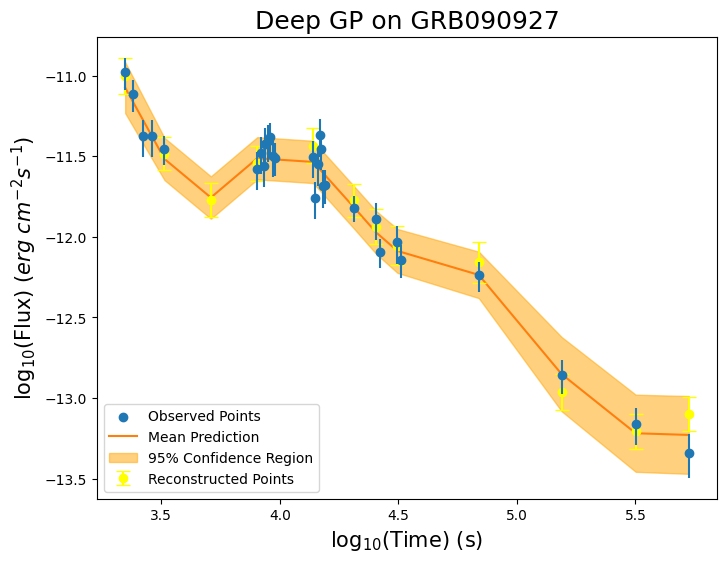


-----TRAINING FOR GRB091018-----


-----ORIGINAL GRB-----



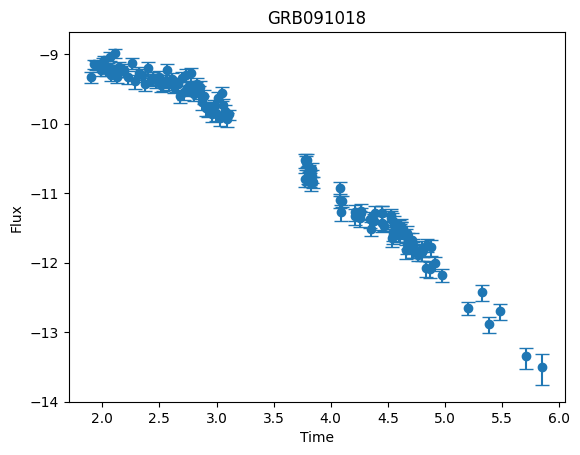


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.6258
Iteration 40/500 - Loss: 37.2564
Iteration 60/500 - Loss: 20.8887
Iteration 80/500 - Loss: 8.8864
Iteration 100/500 - Loss: 3.5746
Iteration 120/500 - Loss: 1.9464
Iteration 140/500 - Loss: 1.2833
Iteration 160/500 - Loss: 0.6235
Iteration 180/500 - Loss: 0.2507
Iteration 200/500 - Loss: 0.0233
Iteration 220/500 - Loss: -0.0679
Iteration 240/500 - Loss: -0.1445
Iteration 260/500 - Loss: -0.2150
Iteration 280/500 - Loss: -0.2796
Iteration 300/500 - Loss: -0.3380
Iteration 320/500 - Loss: -0.3886
Iteration 340/500 - Loss: -0.4328
Iteration 360/500 - Loss: -0.4728
Iteration 380/500 - Loss: -0.5094
Iteration 400/500 - Loss: -0.5429
Iteration 420/500 - Loss: -0.5594
Iteration 440/500 - Loss: -0.5745
Iteration 460/500 - Loss: -0.5889
Iteration 480/500 - Loss: -0.6029
Iteration 500/500 - Loss: -0.6163

-----RECONSTRUCTED GRB-----



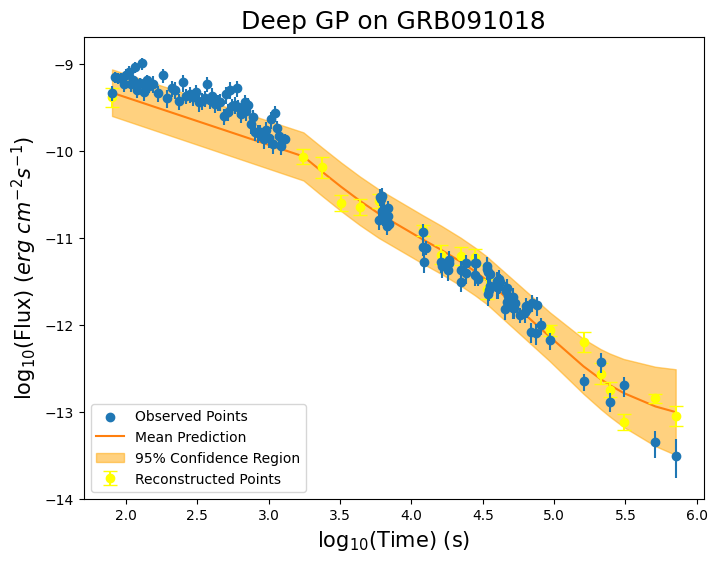


-----TRAINING FOR GRB091020-----


-----ORIGINAL GRB-----



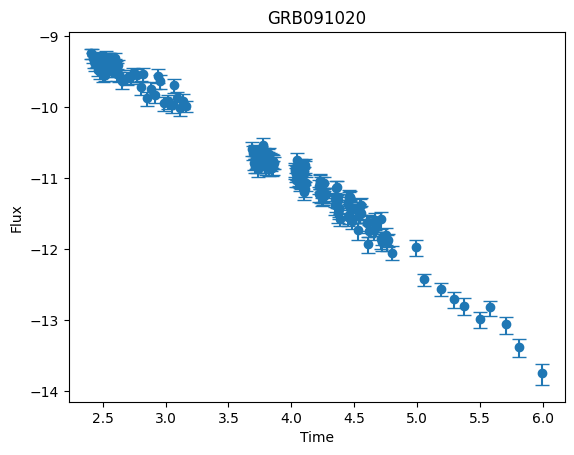


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 63.5365
Iteration 40/500 - Loss: 44.5437
Iteration 60/500 - Loss: 29.9960
Iteration 80/500 - Loss: 15.7341
Iteration 100/500 - Loss: 7.5440
Iteration 120/500 - Loss: 3.9689
Iteration 140/500 - Loss: 1.9163
Iteration 160/500 - Loss: 1.1620
Iteration 180/500 - Loss: 0.7557
Iteration 200/500 - Loss: 0.4412
Iteration 220/500 - Loss: 0.3148
Iteration 240/500 - Loss: 0.2076
Iteration 260/500 - Loss: 0.1102
Iteration 280/500 - Loss: 0.0213
Iteration 300/500 - Loss: -0.0593
Iteration 320/500 - Loss: -0.1309
Iteration 340/500 - Loss: -0.1937
Iteration 360/500 - Loss: -0.2489
Iteration 380/500 - Loss: -0.2966
Iteration 400/500 - Loss: -0.3375
Iteration 420/500 - Loss: -0.3572
Iteration 440/500 - Loss: -0.3745
Iteration 460/500 - Loss: -0.3910
Iteration 480/500 - Loss: -0.4065
Iteration 500/500 - Loss: -0.4213

-----RECONSTRUCTED GRB-----



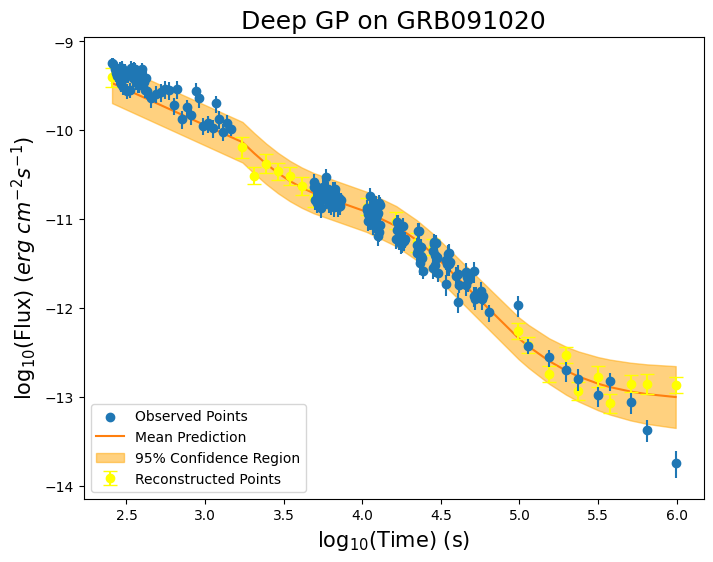


-----TRAINING FOR GRB091029-----


-----ORIGINAL GRB-----



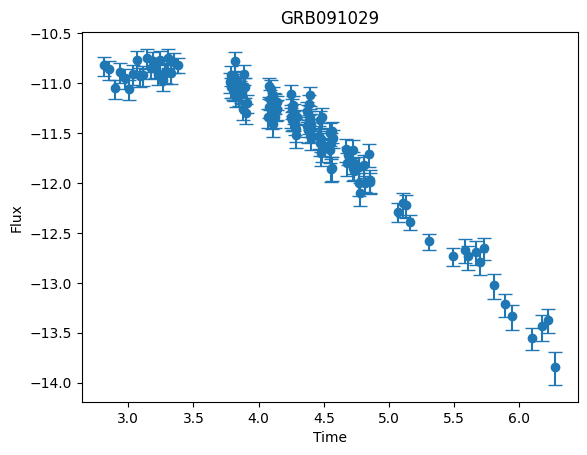


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.6202
Iteration 40/500 - Loss: 36.6675
Iteration 60/500 - Loss: 22.0337
Iteration 80/500 - Loss: 11.0411
Iteration 100/500 - Loss: 5.4013
Iteration 120/500 - Loss: 2.8914
Iteration 140/500 - Loss: 1.7416
Iteration 160/500 - Loss: 1.1874
Iteration 180/500 - Loss: 0.8508
Iteration 200/500 - Loss: 0.6283
Iteration 220/500 - Loss: 0.5301
Iteration 240/500 - Loss: 0.4549
Iteration 260/500 - Loss: 0.3898
Iteration 280/500 - Loss: 0.3336
Iteration 300/500 - Loss: 0.2852
Iteration 320/500 - Loss: 0.2437
Iteration 340/500 - Loss: 0.2082
Iteration 360/500 - Loss: 0.1783
Iteration 380/500 - Loss: 0.1565
Iteration 400/500 - Loss: 0.1313
Iteration 420/500 - Loss: 0.1206
Iteration 440/500 - Loss: 0.1117
Iteration 460/500 - Loss: 0.1034
Iteration 480/500 - Loss: 0.0957
Iteration 500/500 - Loss: 0.0884

-----RECONSTRUCTED GRB-----



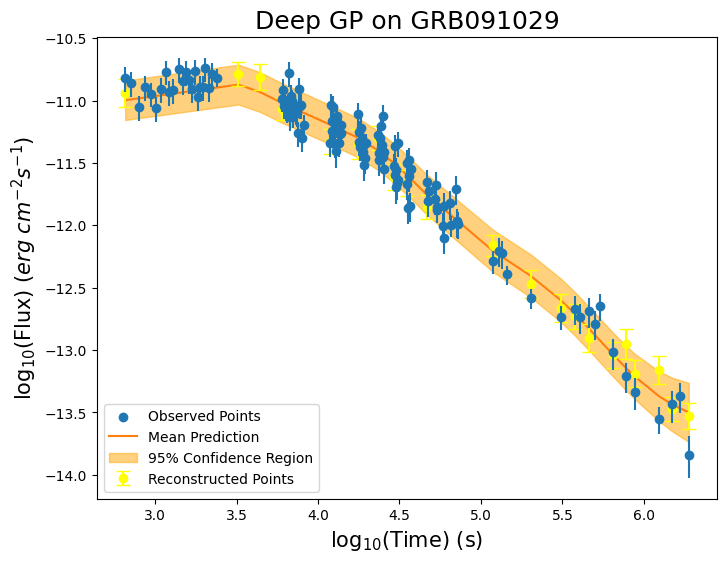


-----TRAINING FOR GRB091109A-----


-----ORIGINAL GRB-----



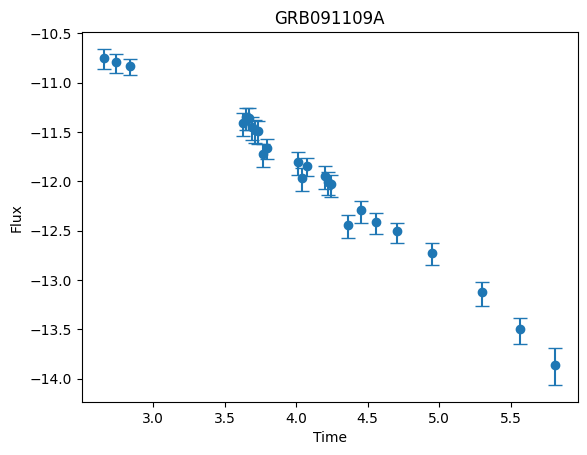


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.0655
Iteration 40/500 - Loss: 35.5048
Iteration 60/500 - Loss: 18.8006
Iteration 80/500 - Loss: 10.2654
Iteration 100/500 - Loss: 5.4021
Iteration 120/500 - Loss: 2.4312
Iteration 140/500 - Loss: 0.9623
Iteration 160/500 - Loss: 0.3421
Iteration 180/500 - Loss: 0.0755
Iteration 200/500 - Loss: -0.0416
Iteration 220/500 - Loss: -0.0747
Iteration 240/500 - Loss: -0.0979
Iteration 260/500 - Loss: -0.1166
Iteration 280/500 - Loss: -0.1322
Iteration 300/500 - Loss: -0.1453
Iteration 320/500 - Loss: -0.1566
Iteration 340/500 - Loss: -0.1664
Iteration 360/500 - Loss: -0.1750
Iteration 380/500 - Loss: -0.1827
Iteration 400/500 - Loss: -0.1897
Iteration 420/500 - Loss: -0.1930
Iteration 440/500 - Loss: -0.1961
Iteration 460/500 - Loss: -0.1991
Iteration 480/500 - Loss: -0.2020
Iteration 500/500 - Loss: -0.2049

-----RECONSTRUCTED GRB-----



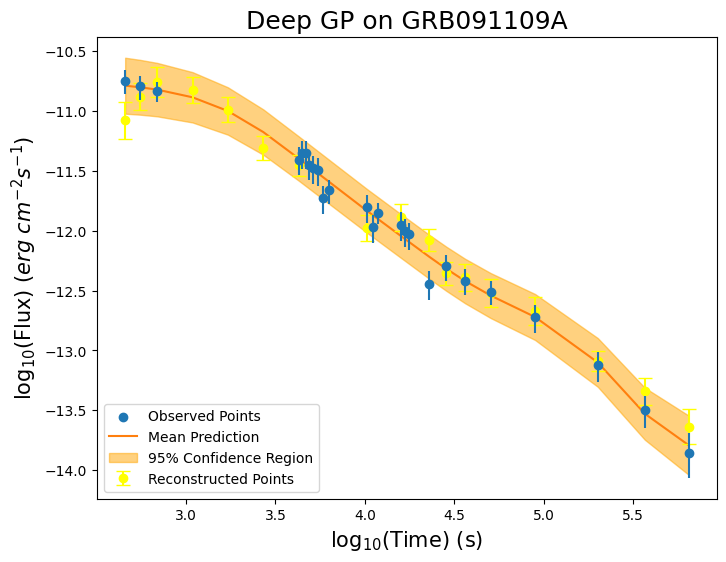


-----TRAINING FOR GRB091127-----


-----ORIGINAL GRB-----



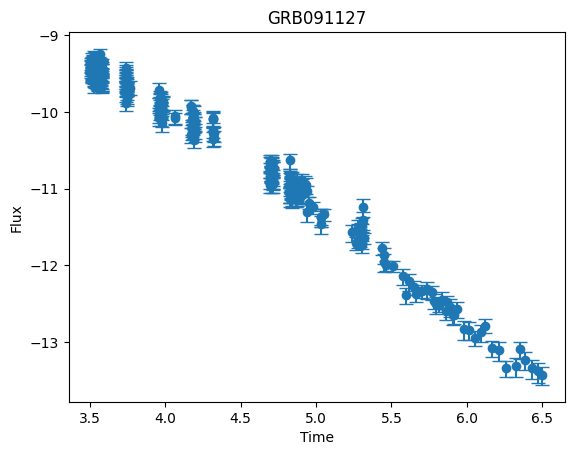


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.0253
Iteration 40/500 - Loss: 42.2489
Iteration 60/500 - Loss: 31.8575
Iteration 80/500 - Loss: 19.4678
Iteration 100/500 - Loss: 11.0253
Iteration 120/500 - Loss: 5.9443
Iteration 140/500 - Loss: 2.7450
Iteration 160/500 - Loss: 1.1713
Iteration 180/500 - Loss: 0.4357
Iteration 200/500 - Loss: -0.0040
Iteration 220/500 - Loss: -0.1586
Iteration 240/500 - Loss: -0.2734
Iteration 260/500 - Loss: -0.3669
Iteration 280/500 - Loss: -0.4432
Iteration 300/500 - Loss: -0.5054
Iteration 320/500 - Loss: -0.5551
Iteration 340/500 - Loss: -0.5964
Iteration 360/500 - Loss: -0.6307
Iteration 380/500 - Loss: -0.6580
Iteration 400/500 - Loss: -0.6768
Iteration 420/500 - Loss: -0.6899
Iteration 440/500 - Loss: -0.6989
Iteration 460/500 - Loss: -0.7069
Iteration 480/500 - Loss: -0.7142
Iteration 500/500 - Loss: -0.7209

-----RECONSTRUCTED GRB-----



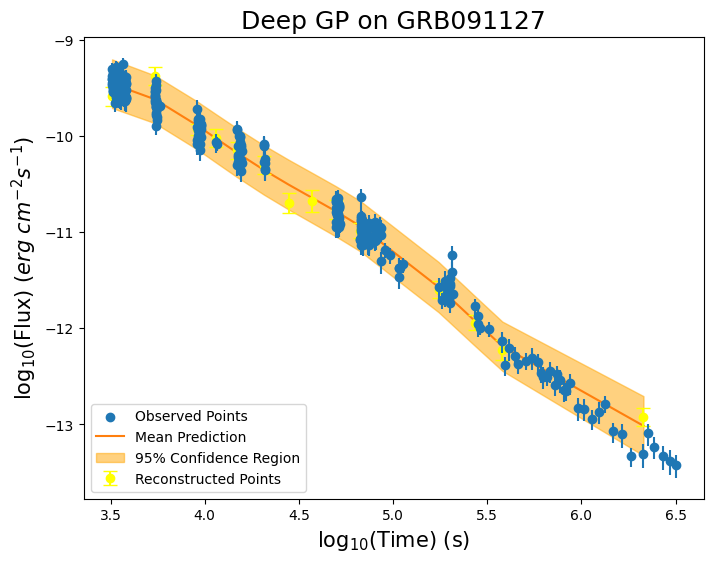


-----TRAINING FOR GRB091208B-----


-----ORIGINAL GRB-----



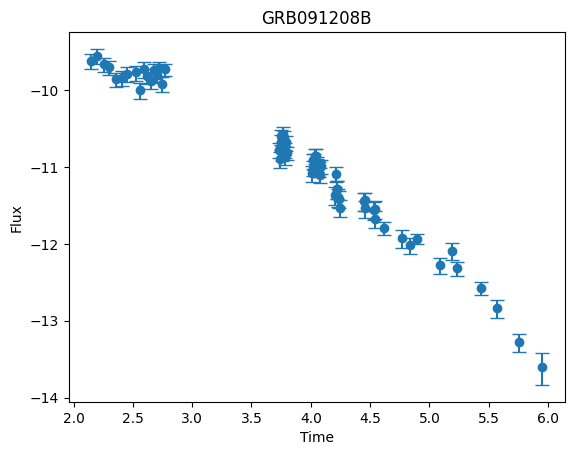


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.9564
Iteration 40/500 - Loss: 35.4858
Iteration 60/500 - Loss: 17.4152
Iteration 80/500 - Loss: 6.8249
Iteration 100/500 - Loss: 3.1600
Iteration 120/500 - Loss: 1.8269
Iteration 140/500 - Loss: 1.1721
Iteration 160/500 - Loss: 0.7535
Iteration 180/500 - Loss: 0.4627
Iteration 200/500 - Loss: 0.2502
Iteration 220/500 - Loss: 0.1618
Iteration 240/500 - Loss: 0.0885
Iteration 260/500 - Loss: 0.0239
Iteration 280/500 - Loss: -0.0330
Iteration 300/500 - Loss: -0.0830
Iteration 320/500 - Loss: -0.1272
Iteration 340/500 - Loss: -0.1664
Iteration 360/500 - Loss: -0.2013
Iteration 380/500 - Loss: -0.2324
Iteration 400/500 - Loss: -0.2602
Iteration 420/500 - Loss: -0.2734
Iteration 440/500 - Loss: -0.2854
Iteration 460/500 - Loss: -0.2969
Iteration 480/500 - Loss: -0.3078
Iteration 500/500 - Loss: -0.3182

-----RECONSTRUCTED GRB-----



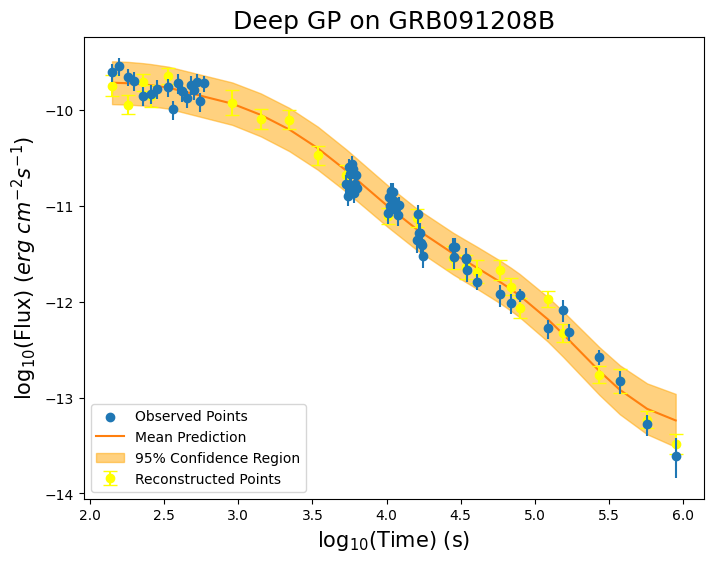


-----TRAINING FOR GRB100219A-----


-----ORIGINAL GRB-----



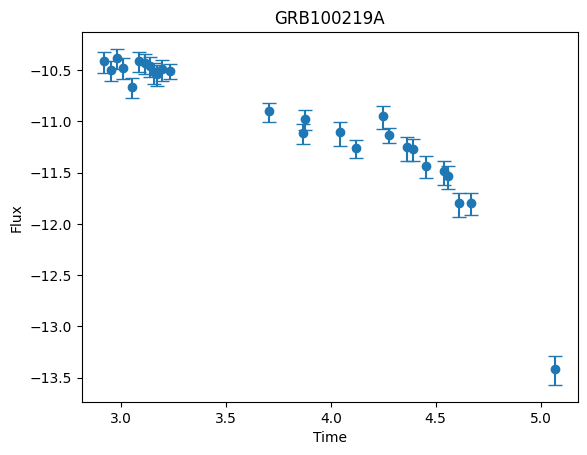


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.0737
Iteration 40/500 - Loss: 36.1967
Iteration 60/500 - Loss: 23.1500
Iteration 80/500 - Loss: 14.2672
Iteration 100/500 - Loss: 9.8338
Iteration 120/500 - Loss: 7.0610
Iteration 140/500 - Loss: 5.1674
Iteration 160/500 - Loss: 3.7744
Iteration 180/500 - Loss: 2.7572
Iteration 200/500 - Loss: 2.0126
Iteration 220/500 - Loss: 1.7000
Iteration 240/500 - Loss: 1.4533
Iteration 260/500 - Loss: 1.2407
Iteration 280/500 - Loss: 1.0579
Iteration 300/500 - Loss: 0.9017
Iteration 320/500 - Loss: 0.7685
Iteration 340/500 - Loss: 0.6553
Iteration 360/500 - Loss: 0.5593
Iteration 380/500 - Loss: 0.4779
Iteration 400/500 - Loss: 0.4092
Iteration 420/500 - Loss: 0.3769
Iteration 440/500 - Loss: 0.3486
Iteration 460/500 - Loss: 0.3222
Iteration 480/500 - Loss: 0.2974
Iteration 500/500 - Loss: 0.2743

-----RECONSTRUCTED GRB-----



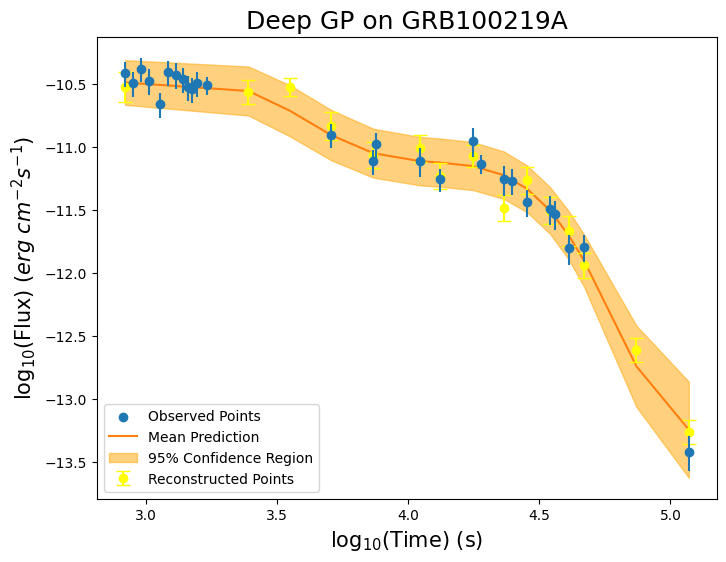


-----TRAINING FOR GRB100316B-----


-----ORIGINAL GRB-----



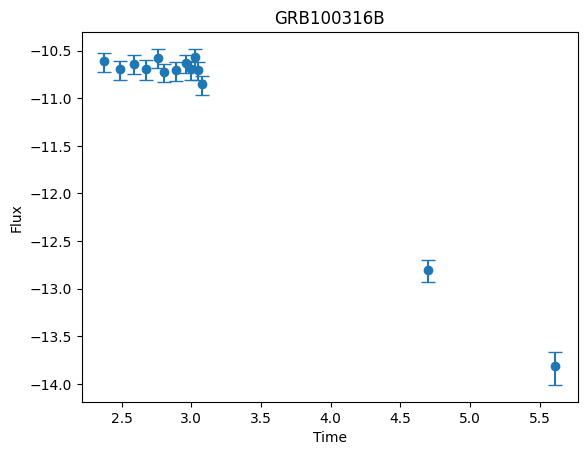


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.4754
Iteration 40/500 - Loss: 40.6906
Iteration 60/500 - Loss: 29.8929
Iteration 80/500 - Loss: 17.4420
Iteration 100/500 - Loss: 9.7288
Iteration 120/500 - Loss: 5.5053
Iteration 140/500 - Loss: 3.3994
Iteration 160/500 - Loss: 2.3868
Iteration 180/500 - Loss: 1.7099
Iteration 200/500 - Loss: 1.1625
Iteration 220/500 - Loss: 0.9346
Iteration 240/500 - Loss: 0.7514
Iteration 260/500 - Loss: 0.5957
Iteration 280/500 - Loss: 0.4644
Iteration 300/500 - Loss: 0.3546
Iteration 320/500 - Loss: 0.2632
Iteration 340/500 - Loss: 0.1873
Iteration 360/500 - Loss: 0.1242
Iteration 380/500 - Loss: 0.0716
Iteration 400/500 - Loss: 0.0276
Iteration 420/500 - Loss: 0.0074
Iteration 440/500 - Loss: -0.0103
Iteration 460/500 - Loss: -0.0269
Iteration 480/500 - Loss: -0.0424
Iteration 500/500 - Loss: -0.0569

-----RECONSTRUCTED GRB-----



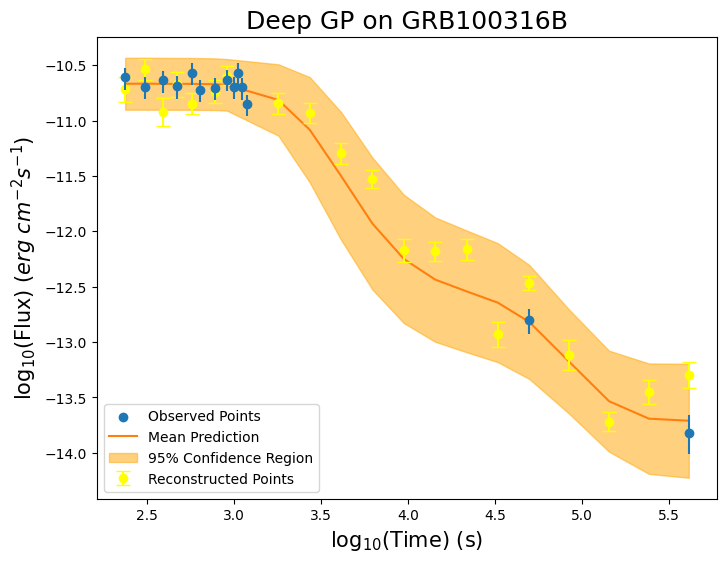


-----TRAINING FOR GRB100418A-----


-----ORIGINAL GRB-----



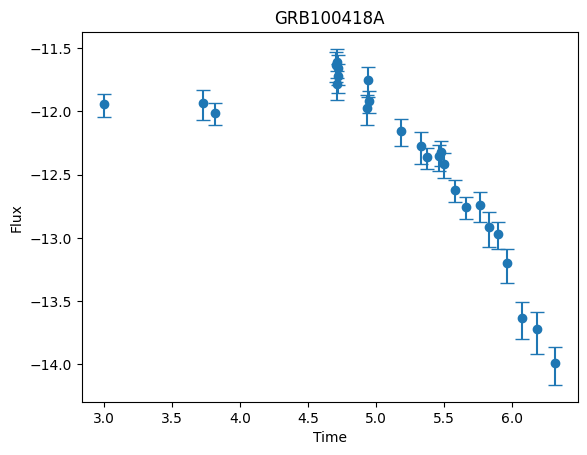


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 54.9739
Iteration 40/500 - Loss: 39.0271
Iteration 60/500 - Loss: 20.6266
Iteration 80/500 - Loss: 8.6649
Iteration 100/500 - Loss: 3.3368
Iteration 120/500 - Loss: 1.1213
Iteration 140/500 - Loss: 0.3126
Iteration 160/500 - Loss: 0.0448
Iteration 180/500 - Loss: -0.0716
Iteration 200/500 - Loss: -0.1341
Iteration 220/500 - Loss: -0.1564
Iteration 240/500 - Loss: -0.1741
Iteration 260/500 - Loss: -0.1899
Iteration 280/500 - Loss: -0.2043
Iteration 300/500 - Loss: -0.2174
Iteration 320/500 - Loss: -0.2293
Iteration 340/500 - Loss: -0.2403
Iteration 360/500 - Loss: -0.2503
Iteration 380/500 - Loss: -0.2591
Iteration 400/500 - Loss: -0.2664
Iteration 420/500 - Loss: -0.2697
Iteration 440/500 - Loss: -0.2726
Iteration 460/500 - Loss: -0.2753
Iteration 480/500 - Loss: -0.2779
Iteration 500/500 - Loss: -0.2803

-----RECONSTRUCTED GRB-----



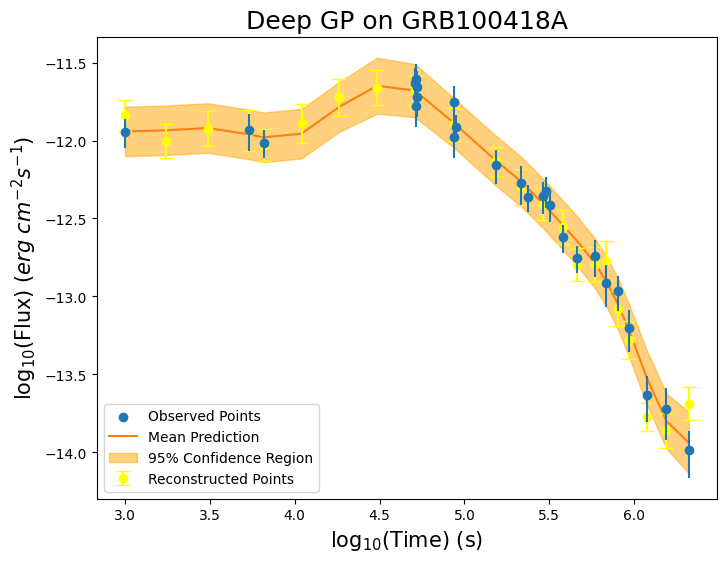


-----TRAINING FOR GRB100425A-----


-----ORIGINAL GRB-----



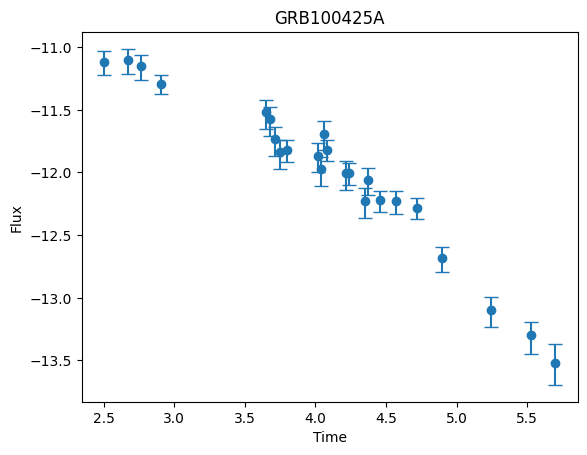


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.9689
Iteration 40/500 - Loss: 36.8132
Iteration 60/500 - Loss: 20.5609
Iteration 80/500 - Loss: 10.5943
Iteration 100/500 - Loss: 5.0122
Iteration 120/500 - Loss: 2.1062
Iteration 140/500 - Loss: 0.9372
Iteration 160/500 - Loss: 0.5378
Iteration 180/500 - Loss: 0.3738
Iteration 200/500 - Loss: 0.2917
Iteration 220/500 - Loss: 0.2646
Iteration 240/500 - Loss: 0.2441
Iteration 260/500 - Loss: 0.2266
Iteration 280/500 - Loss: 0.2116
Iteration 300/500 - Loss: 0.1985
Iteration 320/500 - Loss: 0.1869
Iteration 340/500 - Loss: 0.1765
Iteration 360/500 - Loss: 0.1672
Iteration 380/500 - Loss: 0.1587
Iteration 400/500 - Loss: 0.1510
Iteration 420/500 - Loss: 0.1473
Iteration 440/500 - Loss: 0.1438
Iteration 460/500 - Loss: 0.1405
Iteration 480/500 - Loss: 0.1373
Iteration 500/500 - Loss: 0.1342

-----RECONSTRUCTED GRB-----



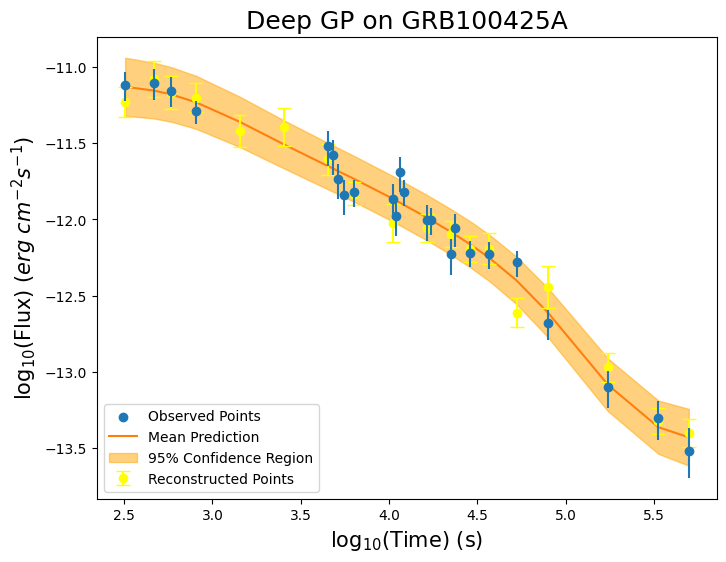


-----TRAINING FOR GRB100513A-----


-----ORIGINAL GRB-----



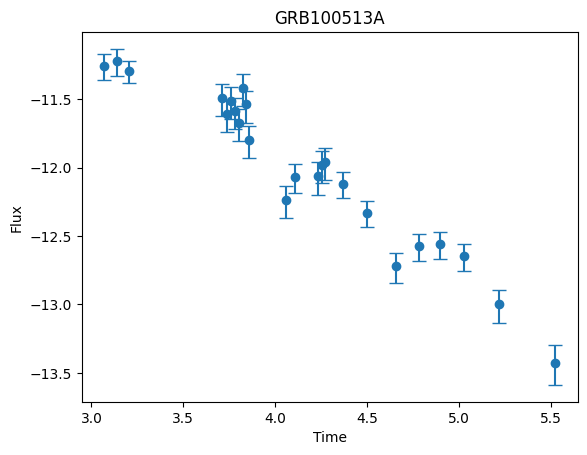


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.5579
Iteration 40/500 - Loss: 30.7447
Iteration 60/500 - Loss: 15.9223
Iteration 80/500 - Loss: 9.1386
Iteration 100/500 - Loss: 5.8434
Iteration 120/500 - Loss: 3.9821
Iteration 140/500 - Loss: 2.7782
Iteration 160/500 - Loss: 1.7385
Iteration 180/500 - Loss: 0.9966
Iteration 200/500 - Loss: 0.6644
Iteration 220/500 - Loss: 0.5867
Iteration 240/500 - Loss: 0.5326
Iteration 260/500 - Loss: 0.4873
Iteration 280/500 - Loss: 0.4502
Iteration 300/500 - Loss: 0.4197
Iteration 320/500 - Loss: 0.3942
Iteration 340/500 - Loss: 0.3661
Iteration 360/500 - Loss: 0.3358
Iteration 380/500 - Loss: 0.2995
Iteration 400/500 - Loss: 0.2552
Iteration 420/500 - Loss: 0.2286
Iteration 440/500 - Loss: 0.2012
Iteration 460/500 - Loss: 0.1722
Iteration 480/500 - Loss: 0.1443
Iteration 500/500 - Loss: 0.1200

-----RECONSTRUCTED GRB-----



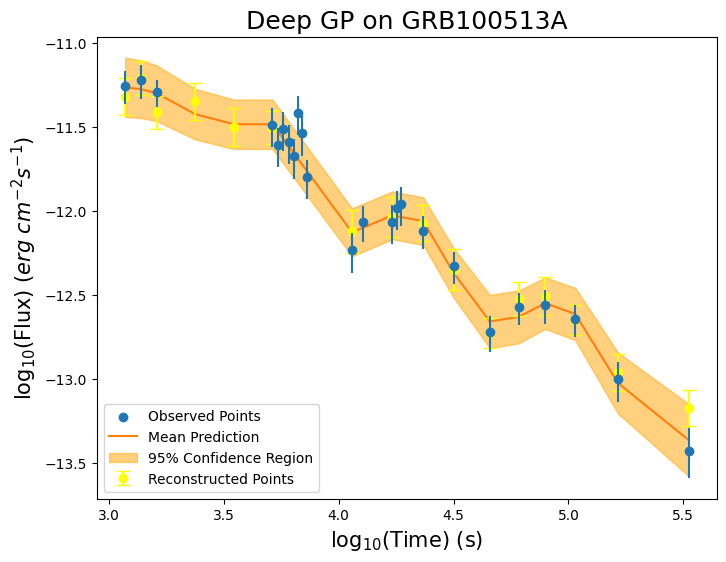


-----TRAINING FOR GRB100621A-----


-----ORIGINAL GRB-----



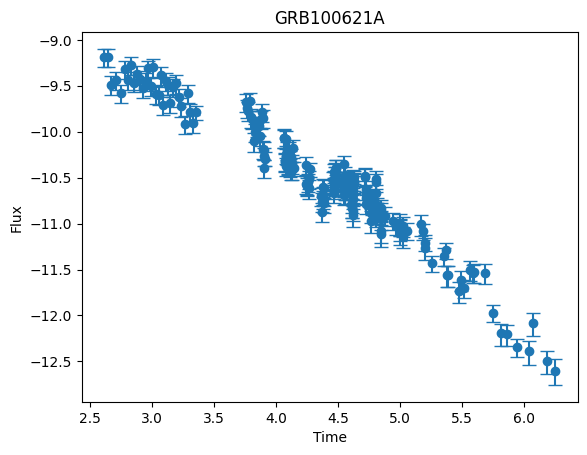


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 60.3875
Iteration 40/500 - Loss: 41.4401
Iteration 60/500 - Loss: 27.4181
Iteration 80/500 - Loss: 15.1282
Iteration 100/500 - Loss: 7.9354
Iteration 120/500 - Loss: 4.1974
Iteration 140/500 - Loss: 2.4704
Iteration 160/500 - Loss: 1.7668
Iteration 180/500 - Loss: 1.4427
Iteration 200/500 - Loss: 1.2454
Iteration 220/500 - Loss: 1.1603
Iteration 240/500 - Loss: 1.0995
Iteration 260/500 - Loss: 1.0469
Iteration 280/500 - Loss: 1.0044
Iteration 300/500 - Loss: 0.9609
Iteration 320/500 - Loss: 0.9252
Iteration 340/500 - Loss: 0.8949
Iteration 360/500 - Loss: 0.8866
Iteration 380/500 - Loss: 0.8430
Iteration 400/500 - Loss: 0.8172
Iteration 420/500 - Loss: 0.8053
Iteration 440/500 - Loss: 0.7945
Iteration 460/500 - Loss: 0.7839
Iteration 480/500 - Loss: 0.7735
Iteration 500/500 - Loss: 0.7633

-----RECONSTRUCTED GRB-----



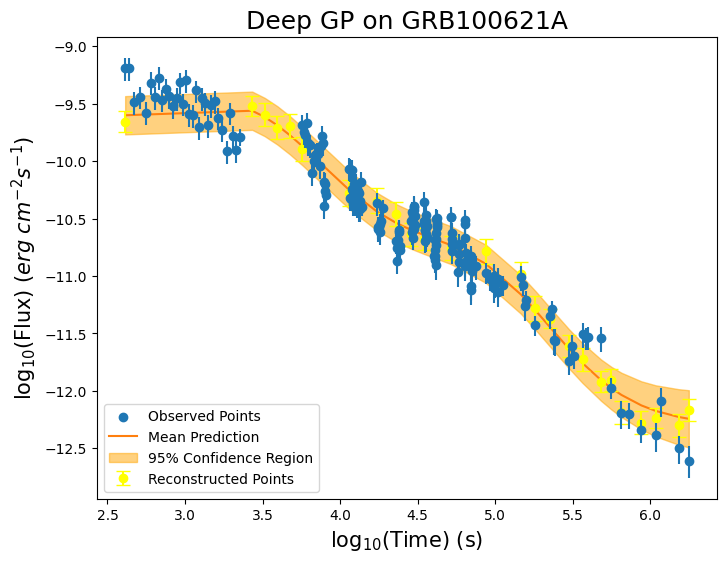


-----TRAINING FOR GRB100625A-----


-----ORIGINAL GRB-----



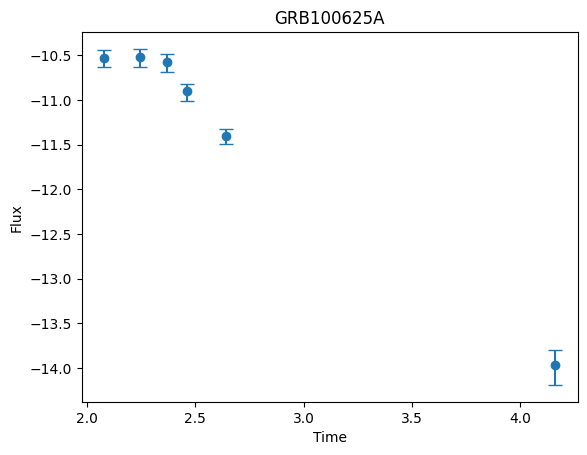


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 61.2883
Iteration 40/500 - Loss: 46.7235
Iteration 60/500 - Loss: 35.0918
Iteration 80/500 - Loss: 23.5358
Iteration 100/500 - Loss: 13.4557
Iteration 120/500 - Loss: 7.1795
Iteration 140/500 - Loss: 4.0076
Iteration 160/500 - Loss: 2.5246
Iteration 180/500 - Loss: 1.7924
Iteration 200/500 - Loss: 1.3823
Iteration 220/500 - Loss: 1.2404
Iteration 240/500 - Loss: 1.1301
Iteration 260/500 - Loss: 1.0361
Iteration 280/500 - Loss: 0.9553
Iteration 300/500 - Loss: 0.8858
Iteration 320/500 - Loss: 0.8260
Iteration 340/500 - Loss: 0.7746
Iteration 360/500 - Loss: 0.7306
Iteration 380/500 - Loss: 0.6931
Iteration 400/500 - Loss: 0.6612
Iteration 420/500 - Loss: 0.6465
Iteration 440/500 - Loss: 0.6336
Iteration 460/500 - Loss: 0.6216
Iteration 480/500 - Loss: 0.6104
Iteration 500/500 - Loss: 0.6000

-----RECONSTRUCTED GRB-----



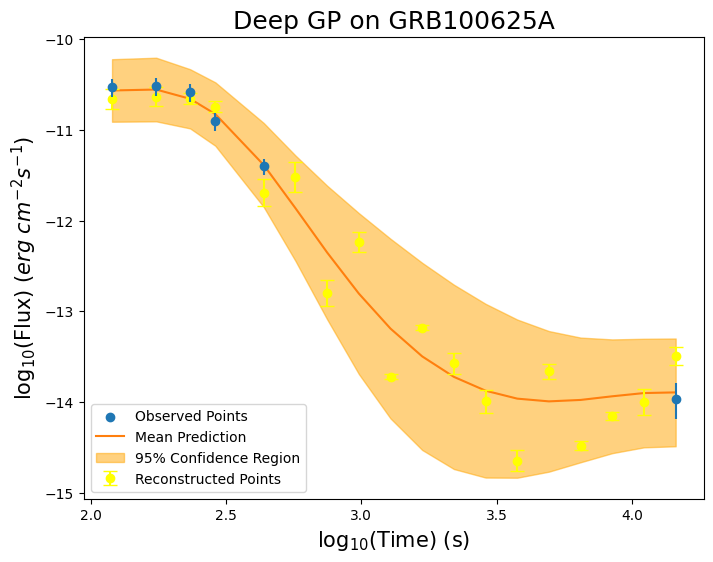


-----TRAINING FOR GRB100704A-----


-----ORIGINAL GRB-----



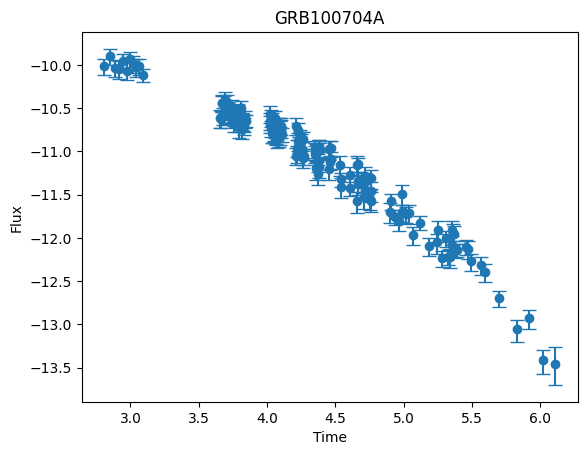


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.8505
Iteration 40/500 - Loss: 35.7354
Iteration 60/500 - Loss: 18.4678
Iteration 80/500 - Loss: 9.2460
Iteration 100/500 - Loss: 5.8365
Iteration 120/500 - Loss: 4.2758
Iteration 140/500 - Loss: 3.1541
Iteration 160/500 - Loss: 2.2541
Iteration 180/500 - Loss: 1.5604
Iteration 200/500 - Loss: 1.0574
Iteration 220/500 - Loss: 0.8566
Iteration 240/500 - Loss: 0.6964
Iteration 260/500 - Loss: 0.5580
Iteration 280/500 - Loss: 0.4386
Iteration 300/500 - Loss: 0.3360
Iteration 320/500 - Loss: 0.2483
Iteration 340/500 - Loss: 0.1734
Iteration 360/500 - Loss: 0.1095
Iteration 380/500 - Loss: 0.0548
Iteration 400/500 - Loss: 0.0084
Iteration 420/500 - Loss: -0.0135
Iteration 440/500 - Loss: -0.0326
Iteration 460/500 - Loss: -0.0506
Iteration 480/500 - Loss: -0.0675
Iteration 500/500 - Loss: -0.0834

-----RECONSTRUCTED GRB-----



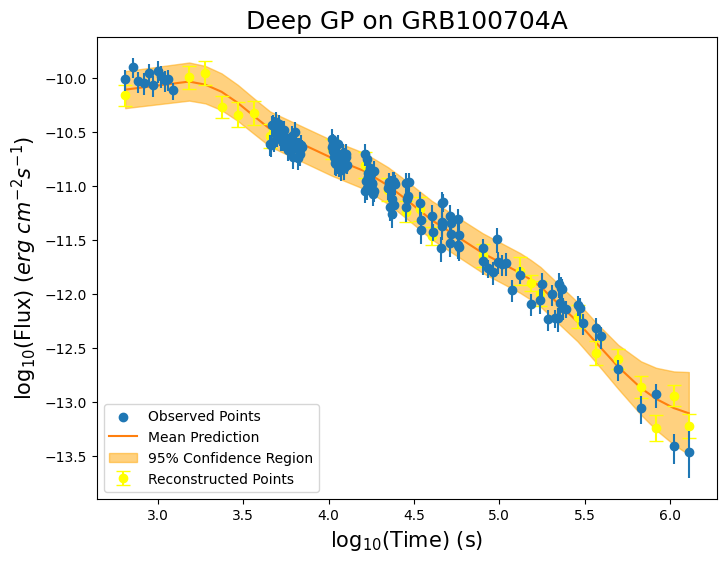


-----TRAINING FOR GRB100724A-----


-----ORIGINAL GRB-----



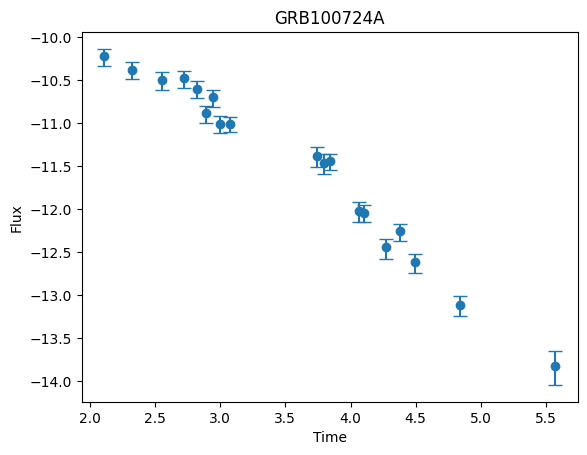


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.8380
Iteration 40/500 - Loss: 35.5098
Iteration 60/500 - Loss: 21.9737
Iteration 80/500 - Loss: 11.7118
Iteration 100/500 - Loss: 6.3982
Iteration 120/500 - Loss: 3.8506
Iteration 140/500 - Loss: 2.1637
Iteration 160/500 - Loss: 0.9977
Iteration 180/500 - Loss: 0.4463
Iteration 200/500 - Loss: 0.1871
Iteration 220/500 - Loss: 0.1117
Iteration 240/500 - Loss: 0.0620
Iteration 260/500 - Loss: 0.0260
Iteration 280/500 - Loss: -0.0020
Iteration 300/500 - Loss: -0.0260
Iteration 320/500 - Loss: -0.0482
Iteration 340/500 - Loss: -0.0695
Iteration 360/500 - Loss: -0.0891
Iteration 380/500 - Loss: -0.1078
Iteration 400/500 - Loss: -0.1254
Iteration 420/500 - Loss: -0.1344
Iteration 440/500 - Loss: -0.1428
Iteration 460/500 - Loss: -0.1511
Iteration 480/500 - Loss: -0.1593
Iteration 500/500 - Loss: -0.1674

-----RECONSTRUCTED GRB-----



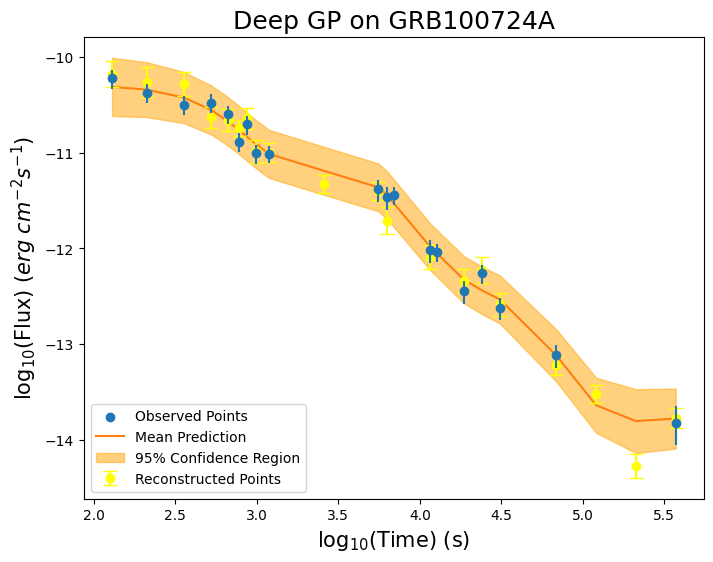


-----TRAINING FOR GRB100728A-----


-----ORIGINAL GRB-----



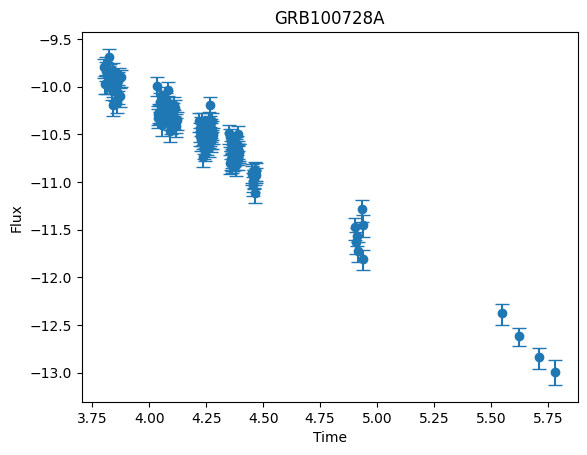


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.3381
Iteration 40/500 - Loss: 40.3531
Iteration 60/500 - Loss: 30.8425
Iteration 80/500 - Loss: 20.4421
Iteration 100/500 - Loss: 11.2419
Iteration 120/500 - Loss: 7.9601
Iteration 140/500 - Loss: 5.0656
Iteration 160/500 - Loss: 4.1761
Iteration 180/500 - Loss: 3.7719
Iteration 200/500 - Loss: 3.5757
Iteration 220/500 - Loss: 3.5079
Iteration 240/500 - Loss: 3.4537
Iteration 260/500 - Loss: 3.4046
Iteration 280/500 - Loss: 3.3585
Iteration 300/500 - Loss: 3.3137
Iteration 320/500 - Loss: 3.2684
Iteration 340/500 - Loss: 3.2209
Iteration 360/500 - Loss: 3.1682
Iteration 380/500 - Loss: 3.1045
Iteration 400/500 - Loss: 3.0151
Iteration 420/500 - Loss: 2.9428
Iteration 440/500 - Loss: 2.8375
Iteration 460/500 - Loss: 2.6681
Iteration 480/500 - Loss: 2.3897
Iteration 500/500 - Loss: 1.9949

-----RECONSTRUCTED GRB-----



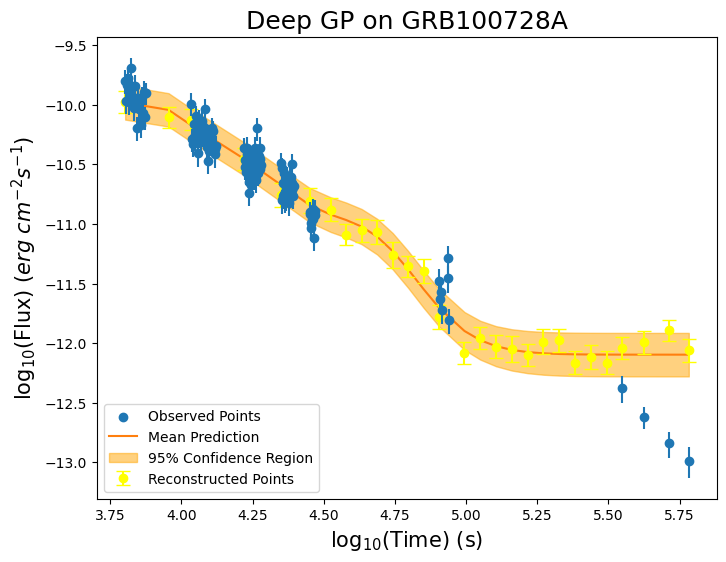


-----TRAINING FOR GRB100814A-----


-----ORIGINAL GRB-----



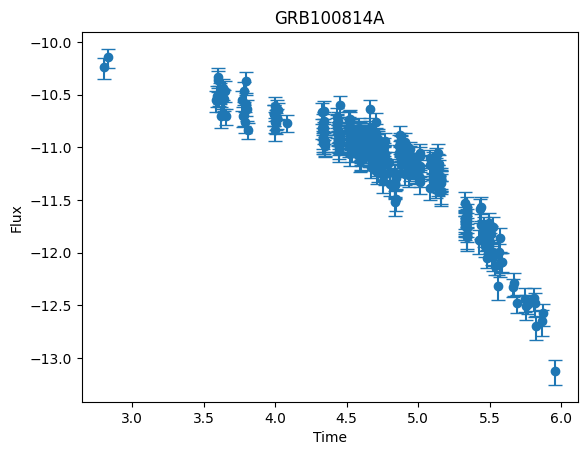


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 69.9637
Iteration 40/500 - Loss: 46.0953
Iteration 60/500 - Loss: 33.3553
Iteration 80/500 - Loss: 23.9035
Iteration 100/500 - Loss: 15.7016
Iteration 120/500 - Loss: 9.9131
Iteration 140/500 - Loss: 6.2524
Iteration 160/500 - Loss: 4.2564
Iteration 180/500 - Loss: 3.2360
Iteration 200/500 - Loss: 2.6746
Iteration 220/500 - Loss: 2.4781
Iteration 240/500 - Loss: 2.3426
Iteration 260/500 - Loss: 2.2171
Iteration 280/500 - Loss: 2.0993
Iteration 300/500 - Loss: 2.0005
Iteration 320/500 - Loss: 1.9753
Iteration 340/500 - Loss: 1.8492
Iteration 360/500 - Loss: 1.7798
Iteration 380/500 - Loss: 1.7143
Iteration 400/500 - Loss: 1.6605
Iteration 420/500 - Loss: 1.6226
Iteration 440/500 - Loss: 1.5945
Iteration 460/500 - Loss: 1.5667
Iteration 480/500 - Loss: 1.5396
Iteration 500/500 - Loss: 1.5130

-----RECONSTRUCTED GRB-----



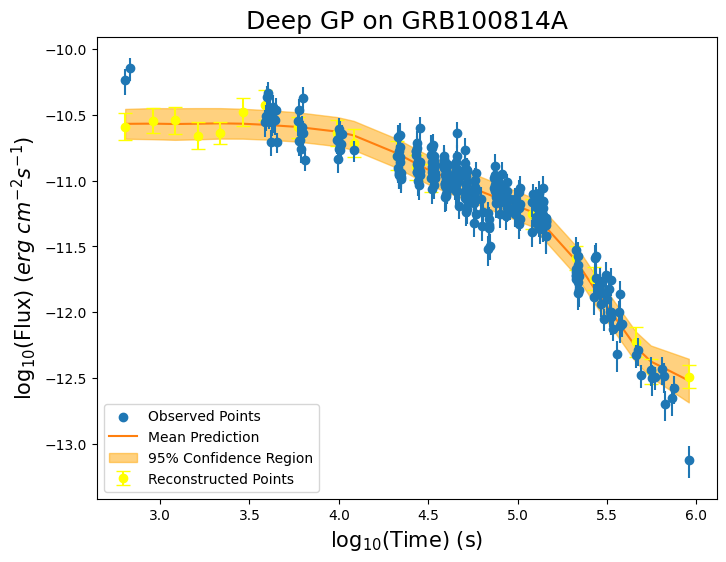


-----TRAINING FOR GRB100816A-----


-----ORIGINAL GRB-----



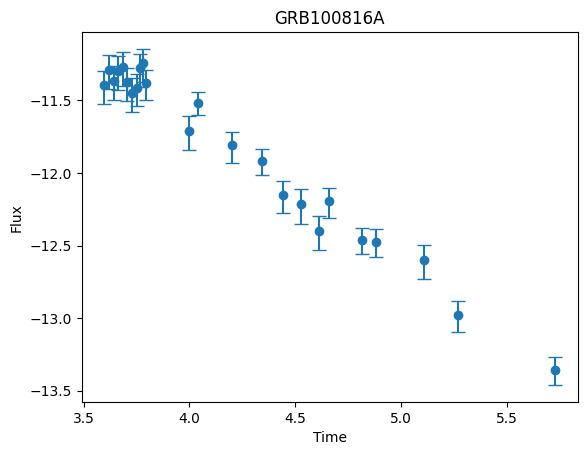


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.8234
Iteration 40/500 - Loss: 35.2223
Iteration 60/500 - Loss: 19.1070
Iteration 80/500 - Loss: 8.7355
Iteration 100/500 - Loss: 4.9485
Iteration 120/500 - Loss: 3.1038
Iteration 140/500 - Loss: 2.0332
Iteration 160/500 - Loss: 1.4192
Iteration 180/500 - Loss: 1.1705
Iteration 200/500 - Loss: 0.7680
Iteration 220/500 - Loss: 0.6515
Iteration 240/500 - Loss: 0.5614
Iteration 260/500 - Loss: 0.4839
Iteration 280/500 - Loss: 0.4180
Iteration 300/500 - Loss: 0.3622
Iteration 320/500 - Loss: 0.3149
Iteration 340/500 - Loss: 0.2743
Iteration 360/500 - Loss: 0.2392
Iteration 380/500 - Loss: 0.2087
Iteration 400/500 - Loss: 0.1817
Iteration 420/500 - Loss: 0.1689
Iteration 440/500 - Loss: 0.1572
Iteration 460/500 - Loss: 0.1461
Iteration 480/500 - Loss: 0.1355
Iteration 500/500 - Loss: 0.1253

-----RECONSTRUCTED GRB-----



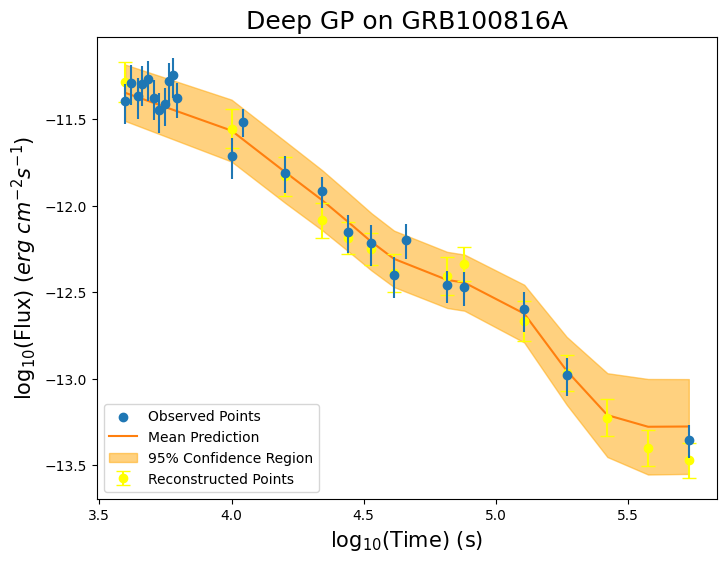


-----TRAINING FOR GRB100901A-----


-----ORIGINAL GRB-----



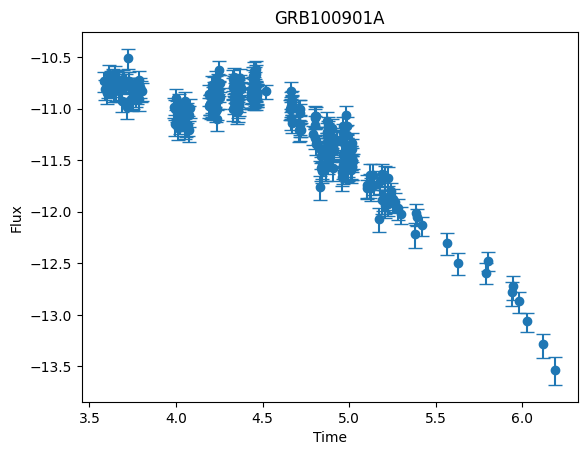


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 63.8417
Iteration 40/500 - Loss: 43.5015
Iteration 60/500 - Loss: 30.0149
Iteration 80/500 - Loss: 19.7657
Iteration 100/500 - Loss: 12.4511
Iteration 120/500 - Loss: 8.2445
Iteration 140/500 - Loss: 5.9338
Iteration 160/500 - Loss: 4.4593
Iteration 180/500 - Loss: 3.4466
Iteration 200/500 - Loss: 2.6956
Iteration 220/500 - Loss: 2.3883
Iteration 240/500 - Loss: 2.1443
Iteration 260/500 - Loss: 1.9467
Iteration 280/500 - Loss: 1.7902
Iteration 300/500 - Loss: 1.6677
Iteration 320/500 - Loss: 1.5694
Iteration 340/500 - Loss: 1.4903
Iteration 360/500 - Loss: 1.4271
Iteration 380/500 - Loss: 1.3746
Iteration 400/500 - Loss: 1.3312
Iteration 420/500 - Loss: 1.3112
Iteration 440/500 - Loss: 1.2938
Iteration 460/500 - Loss: 1.2776
Iteration 480/500 - Loss: 1.2624
Iteration 500/500 - Loss: 1.2484

-----RECONSTRUCTED GRB-----



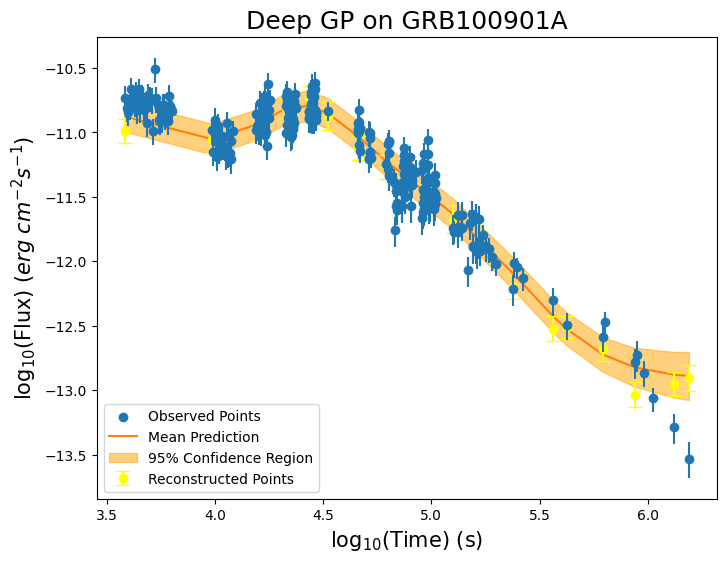


-----TRAINING FOR GRB100906A-----


-----ORIGINAL GRB-----



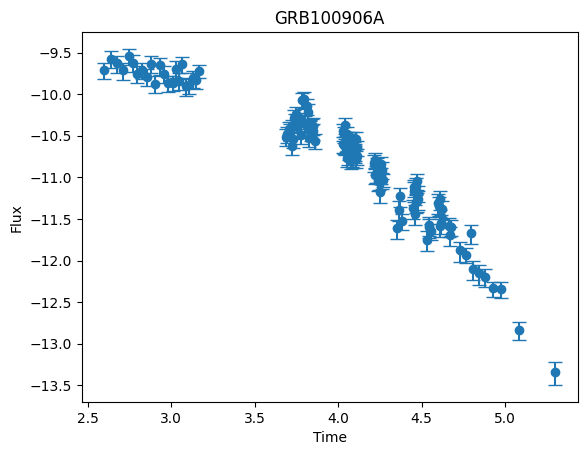


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.9196
Iteration 40/500 - Loss: 37.2923
Iteration 60/500 - Loss: 21.3600
Iteration 80/500 - Loss: 11.7783
Iteration 100/500 - Loss: 6.1136
Iteration 120/500 - Loss: 3.6197
Iteration 140/500 - Loss: 2.5062
Iteration 160/500 - Loss: 1.8686
Iteration 180/500 - Loss: 1.4538
Iteration 200/500 - Loss: 1.1578
Iteration 220/500 - Loss: 1.0244
Iteration 240/500 - Loss: 0.9163
Iteration 260/500 - Loss: 0.8176
Iteration 280/500 - Loss: 0.7278
Iteration 300/500 - Loss: 0.6461
Iteration 320/500 - Loss: 0.5732
Iteration 340/500 - Loss: 0.5093
Iteration 360/500 - Loss: 0.4540
Iteration 380/500 - Loss: 0.4077
Iteration 400/500 - Loss: 0.3683
Iteration 420/500 - Loss: 0.3502
Iteration 440/500 - Loss: 0.3345
Iteration 460/500 - Loss: 0.3200
Iteration 480/500 - Loss: 0.3064
Iteration 500/500 - Loss: 0.2938

-----RECONSTRUCTED GRB-----



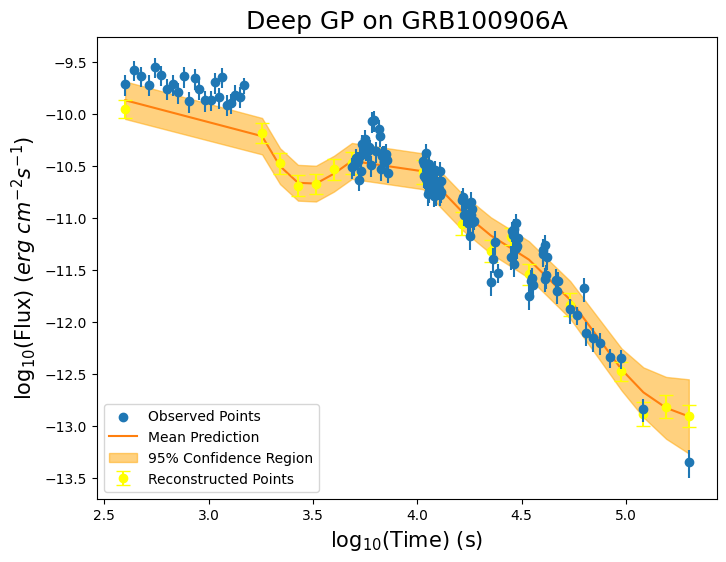


-----TRAINING FOR GRB101219B-----


-----ORIGINAL GRB-----



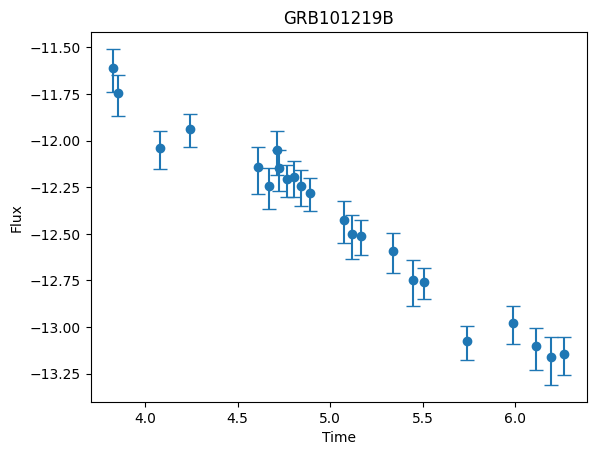


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.0024
Iteration 40/500 - Loss: 29.5793
Iteration 60/500 - Loss: 14.6519
Iteration 80/500 - Loss: 7.2469
Iteration 100/500 - Loss: 3.9888
Iteration 120/500 - Loss: 2.2542
Iteration 140/500 - Loss: 1.4407
Iteration 160/500 - Loss: 1.0460
Iteration 180/500 - Loss: 0.7760
Iteration 200/500 - Loss: 0.5280
Iteration 220/500 - Loss: 0.4196
Iteration 240/500 - Loss: 0.3350
Iteration 260/500 - Loss: 0.2696
Iteration 280/500 - Loss: 0.2238
Iteration 300/500 - Loss: 0.1925
Iteration 320/500 - Loss: 0.1689
Iteration 340/500 - Loss: 0.1489
Iteration 360/500 - Loss: 0.1303
Iteration 380/500 - Loss: 0.1117
Iteration 400/500 - Loss: 0.0919
Iteration 420/500 - Loss: 0.0806
Iteration 440/500 - Loss: 0.0688
Iteration 460/500 - Loss: 0.0560
Iteration 480/500 - Loss: 0.0422
Iteration 500/500 - Loss: 0.0268

-----RECONSTRUCTED GRB-----



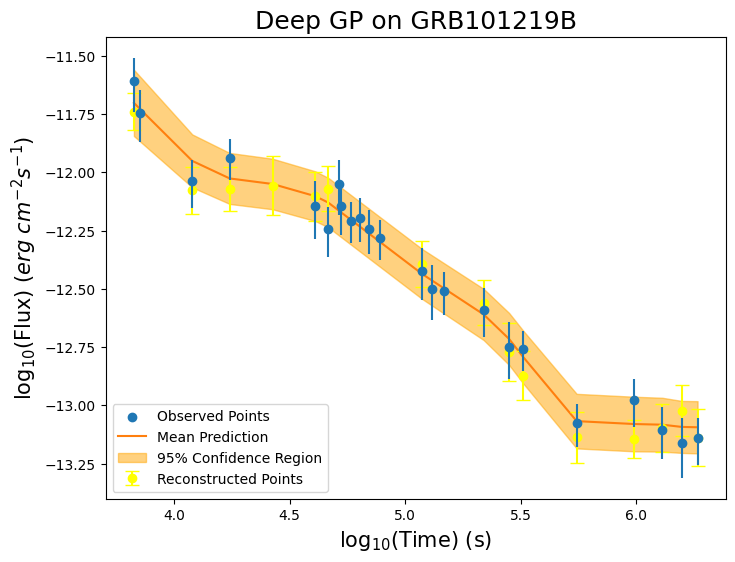


-----TRAINING FOR GRB110106B-----


-----ORIGINAL GRB-----



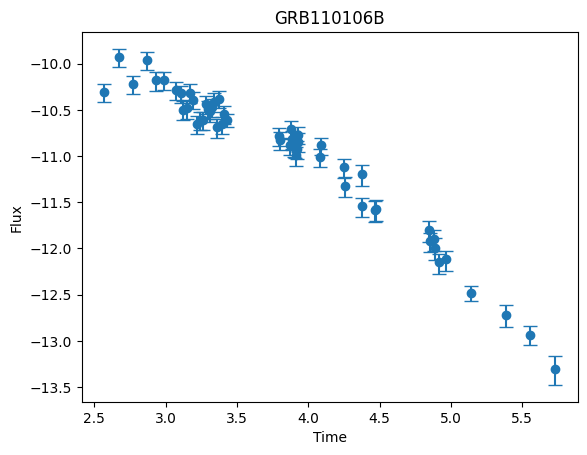


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.5705
Iteration 40/500 - Loss: 35.1914
Iteration 60/500 - Loss: 18.5819
Iteration 80/500 - Loss: 8.8562
Iteration 100/500 - Loss: 5.2700
Iteration 120/500 - Loss: 3.8300
Iteration 140/500 - Loss: 2.8419
Iteration 160/500 - Loss: 2.0306
Iteration 180/500 - Loss: 1.4023
Iteration 200/500 - Loss: 0.9738
Iteration 220/500 - Loss: 0.7734
Iteration 240/500 - Loss: 0.6275
Iteration 260/500 - Loss: 0.5037
Iteration 280/500 - Loss: 0.3978
Iteration 300/500 - Loss: 0.3107
Iteration 320/500 - Loss: 0.2323
Iteration 340/500 - Loss: 0.1678
Iteration 360/500 - Loss: 0.1166
Iteration 380/500 - Loss: 0.0700
Iteration 400/500 - Loss: 0.0318
Iteration 420/500 - Loss: 0.0139
Iteration 440/500 - Loss: -0.0019
Iteration 460/500 - Loss: -0.0167
Iteration 480/500 - Loss: -0.0304
Iteration 500/500 - Loss: -0.0434

-----RECONSTRUCTED GRB-----



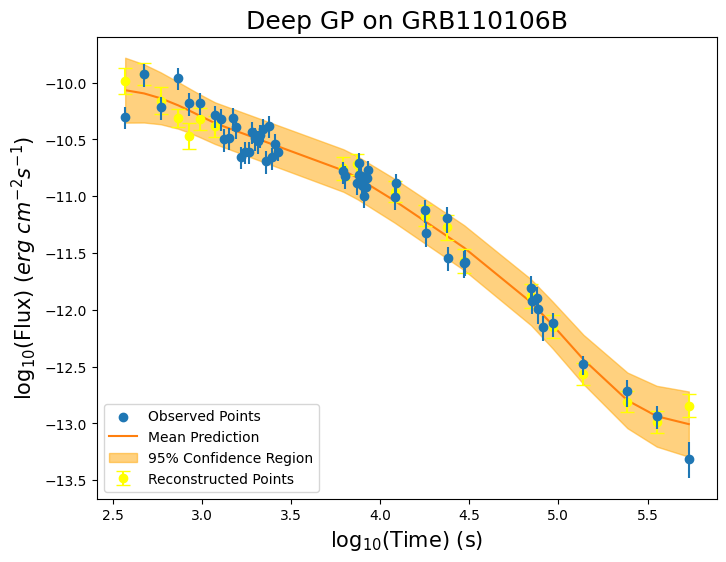


-----TRAINING FOR GRB110213A-----


-----ORIGINAL GRB-----



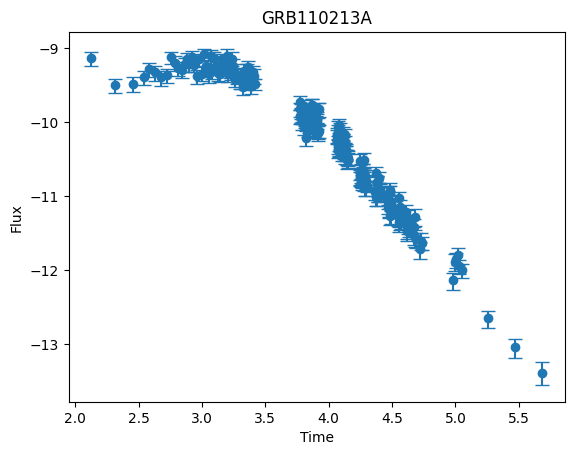


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 59.4542
Iteration 40/500 - Loss: 38.2396
Iteration 60/500 - Loss: 21.6963
Iteration 80/500 - Loss: 10.5814
Iteration 100/500 - Loss: 5.2706
Iteration 120/500 - Loss: 2.8514
Iteration 140/500 - Loss: 1.8091
Iteration 160/500 - Loss: 1.2868
Iteration 180/500 - Loss: 0.9380
Iteration 200/500 - Loss: 0.6904
Iteration 220/500 - Loss: 0.5853
Iteration 240/500 - Loss: 0.4982
Iteration 260/500 - Loss: 0.4208
Iteration 280/500 - Loss: 0.3514
Iteration 300/500 - Loss: 0.2892
Iteration 320/500 - Loss: 0.2335
Iteration 340/500 - Loss: 0.1839
Iteration 360/500 - Loss: 0.1392
Iteration 380/500 - Loss: 0.0988
Iteration 400/500 - Loss: 0.0624
Iteration 420/500 - Loss: 0.0444
Iteration 440/500 - Loss: 0.0282
Iteration 460/500 - Loss: 0.0126
Iteration 480/500 - Loss: -0.0025
Iteration 500/500 - Loss: -0.0171

-----RECONSTRUCTED GRB-----



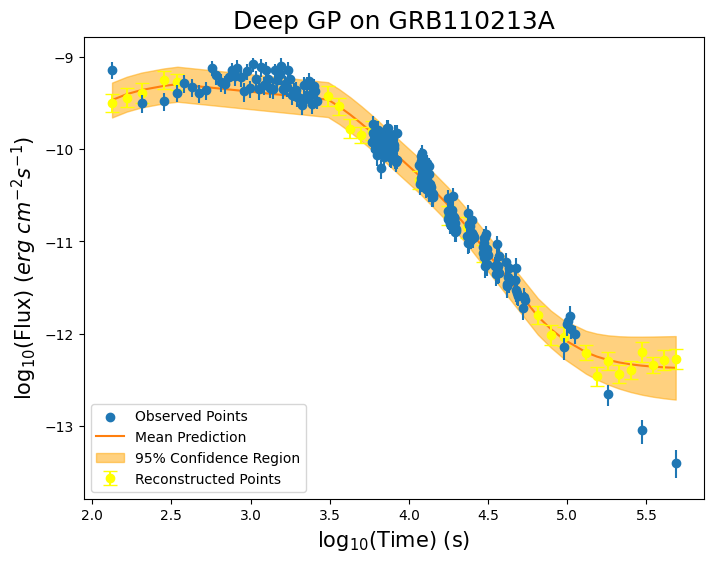


-----TRAINING FOR GRB110422A-----


-----ORIGINAL GRB-----



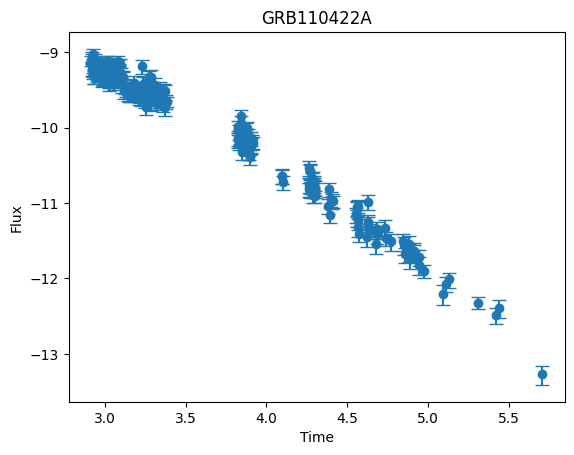


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.8401
Iteration 40/500 - Loss: 41.1526
Iteration 60/500 - Loss: 31.5303
Iteration 80/500 - Loss: 18.4825
Iteration 100/500 - Loss: 9.0563
Iteration 120/500 - Loss: 4.0789
Iteration 140/500 - Loss: 2.0134
Iteration 160/500 - Loss: 1.0661
Iteration 180/500 - Loss: 0.5863
Iteration 200/500 - Loss: 0.3078
Iteration 220/500 - Loss: 0.2065
Iteration 240/500 - Loss: 0.1266
Iteration 260/500 - Loss: 0.0572
Iteration 280/500 - Loss: -0.0037
Iteration 300/500 - Loss: -0.0579
Iteration 320/500 - Loss: -0.1066
Iteration 340/500 - Loss: -0.1507
Iteration 360/500 - Loss: -0.1908
Iteration 380/500 - Loss: -0.2276
Iteration 400/500 - Loss: -0.2618
Iteration 420/500 - Loss: -0.2785
Iteration 440/500 - Loss: -0.2942
Iteration 460/500 - Loss: -0.3093
Iteration 480/500 - Loss: -0.3239
Iteration 500/500 - Loss: -0.3381

-----RECONSTRUCTED GRB-----



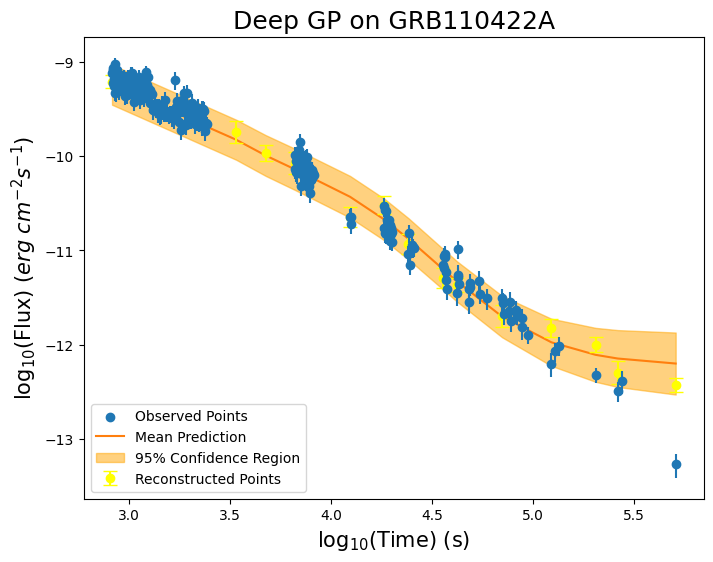


-----TRAINING FOR GRB110503A-----


-----ORIGINAL GRB-----



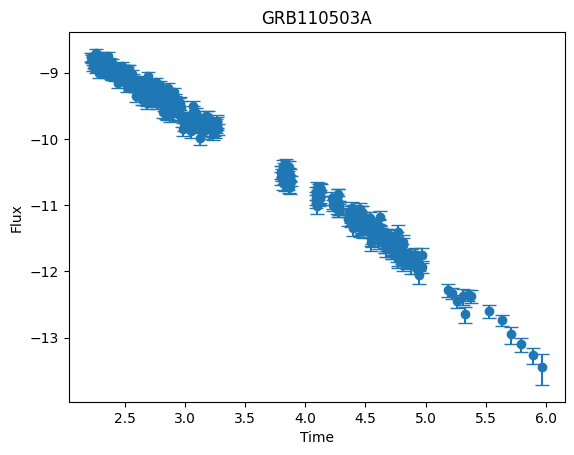


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.3769
Iteration 40/500 - Loss: 40.4837
Iteration 60/500 - Loss: 30.3341
Iteration 80/500 - Loss: 17.5998
Iteration 100/500 - Loss: 7.8224
Iteration 120/500 - Loss: 3.4822
Iteration 140/500 - Loss: 1.8437
Iteration 160/500 - Loss: 1.1390
Iteration 180/500 - Loss: 0.6897
Iteration 200/500 - Loss: 0.3356
Iteration 220/500 - Loss: 0.1893
Iteration 240/500 - Loss: 0.0970
Iteration 260/500 - Loss: -0.0185
Iteration 280/500 - Loss: -0.1177
Iteration 300/500 - Loss: -0.1943
Iteration 320/500 - Loss: -0.2616
Iteration 340/500 - Loss: -0.3214
Iteration 360/500 - Loss: -0.3747
Iteration 380/500 - Loss: -0.4225
Iteration 400/500 - Loss: -0.4655
Iteration 420/500 - Loss: -0.4862
Iteration 440/500 - Loss: -0.5052
Iteration 460/500 - Loss: -0.5234
Iteration 480/500 - Loss: -0.5409
Iteration 500/500 - Loss: -0.5577

-----RECONSTRUCTED GRB-----



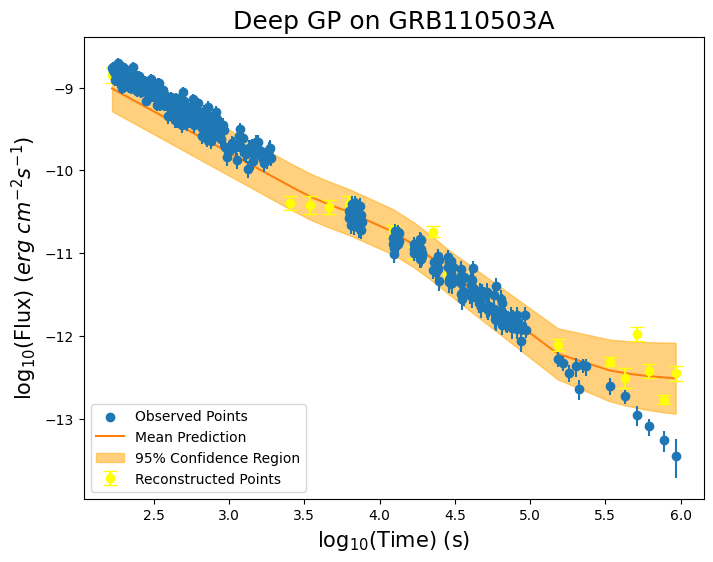


-----TRAINING FOR GRB110715A-----


-----ORIGINAL GRB-----



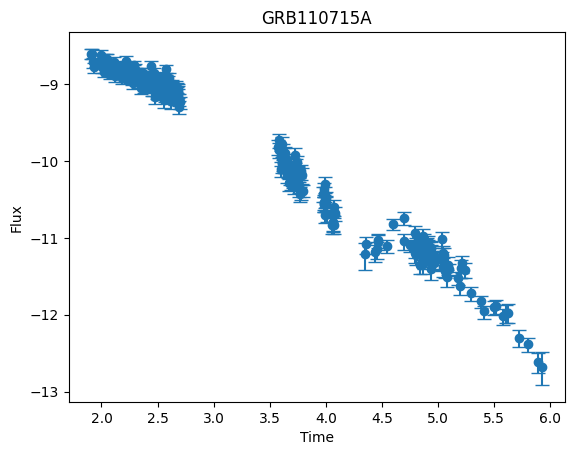


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.1512
Iteration 40/500 - Loss: 39.5262
Iteration 60/500 - Loss: 25.8666
Iteration 80/500 - Loss: 12.0503
Iteration 100/500 - Loss: 4.0618
Iteration 120/500 - Loss: 1.9350
Iteration 140/500 - Loss: 1.1014
Iteration 160/500 - Loss: 0.7645
Iteration 180/500 - Loss: 0.5886
Iteration 200/500 - Loss: 0.4622
Iteration 220/500 - Loss: 0.4046
Iteration 240/500 - Loss: 0.3525
Iteration 260/500 - Loss: 0.3002
Iteration 280/500 - Loss: 0.2769
Iteration 300/500 - Loss: 0.2094
Iteration 320/500 - Loss: 0.1554
Iteration 340/500 - Loss: 0.1043
Iteration 360/500 - Loss: 0.0533
Iteration 380/500 - Loss: 0.0021
Iteration 400/500 - Loss: -0.0488
Iteration 420/500 - Loss: -0.0754
Iteration 440/500 - Loss: -0.1007
Iteration 460/500 - Loss: -0.1259
Iteration 480/500 - Loss: -0.1510
Iteration 500/500 - Loss: -0.1758

-----RECONSTRUCTED GRB-----



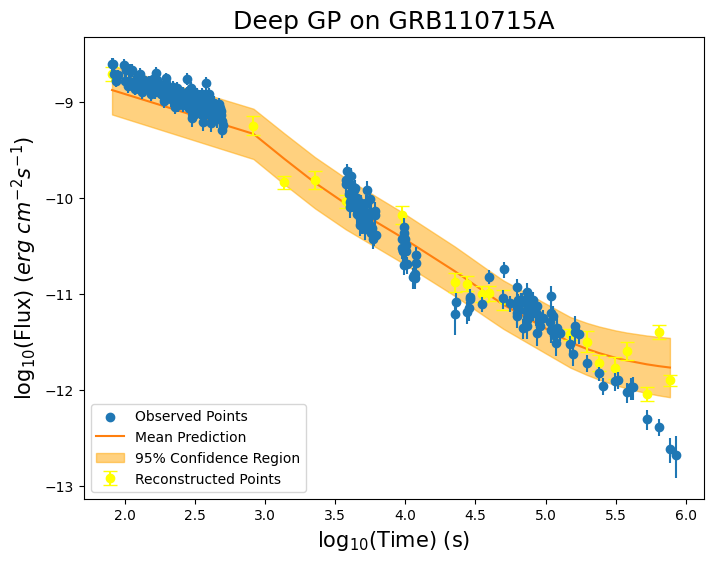


-----TRAINING FOR GRB110731A-----


-----ORIGINAL GRB-----



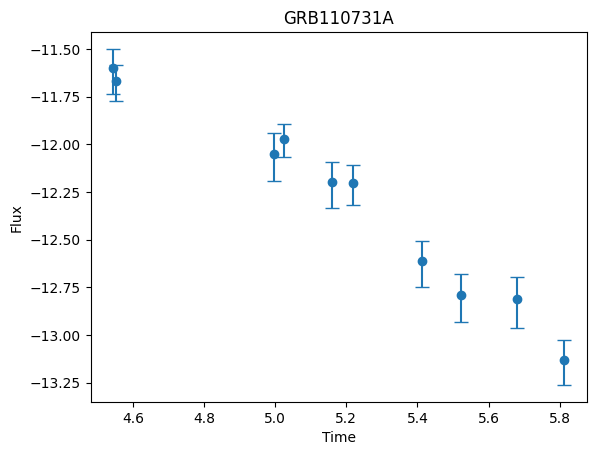


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 63.1203
Iteration 40/500 - Loss: 46.3604
Iteration 60/500 - Loss: 31.8209
Iteration 80/500 - Loss: 17.9656
Iteration 100/500 - Loss: 8.5810
Iteration 120/500 - Loss: 4.5342
Iteration 140/500 - Loss: 2.7360
Iteration 160/500 - Loss: 1.9036
Iteration 180/500 - Loss: 1.5011
Iteration 200/500 - Loss: 1.2773
Iteration 220/500 - Loss: 1.1951
Iteration 240/500 - Loss: 1.1281
Iteration 260/500 - Loss: 1.0668
Iteration 280/500 - Loss: 1.0090
Iteration 300/500 - Loss: 0.9513
Iteration 320/500 - Loss: 0.8904
Iteration 340/500 - Loss: 0.8228
Iteration 360/500 - Loss: 0.7490
Iteration 380/500 - Loss: 0.6753
Iteration 400/500 - Loss: 0.6121
Iteration 420/500 - Loss: 0.5844
Iteration 440/500 - Loss: 0.5594
Iteration 460/500 - Loss: 0.5348
Iteration 480/500 - Loss: 0.5099
Iteration 500/500 - Loss: 0.4819

-----RECONSTRUCTED GRB-----



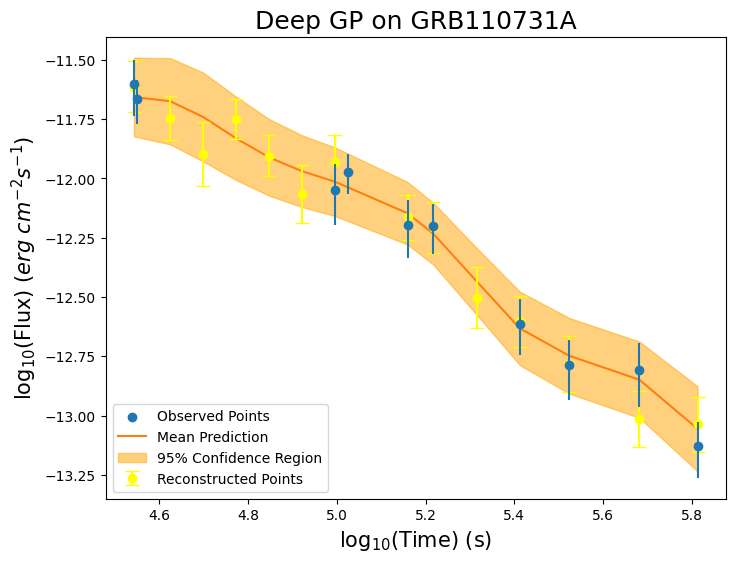


-----TRAINING FOR GRB110818A-----


-----ORIGINAL GRB-----



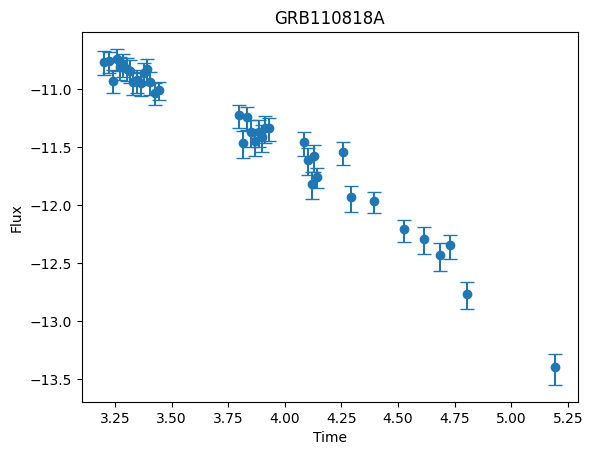


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.4995
Iteration 40/500 - Loss: 34.4108
Iteration 60/500 - Loss: 16.9474
Iteration 80/500 - Loss: 9.5489
Iteration 100/500 - Loss: 5.8611
Iteration 120/500 - Loss: 3.7985
Iteration 140/500 - Loss: 2.6307
Iteration 160/500 - Loss: 1.8907
Iteration 180/500 - Loss: 1.3664
Iteration 200/500 - Loss: 0.9881
Iteration 220/500 - Loss: 0.8205
Iteration 240/500 - Loss: 0.6883
Iteration 260/500 - Loss: 0.5721
Iteration 280/500 - Loss: 0.4696
Iteration 300/500 - Loss: 0.3811
Iteration 320/500 - Loss: 0.3007
Iteration 340/500 - Loss: 0.2321
Iteration 360/500 - Loss: 0.1730
Iteration 380/500 - Loss: 0.1237
Iteration 400/500 - Loss: 0.0805
Iteration 420/500 - Loss: 0.0611
Iteration 440/500 - Loss: 0.0441
Iteration 460/500 - Loss: 0.0284
Iteration 480/500 - Loss: 0.0140
Iteration 500/500 - Loss: 0.0008

-----RECONSTRUCTED GRB-----



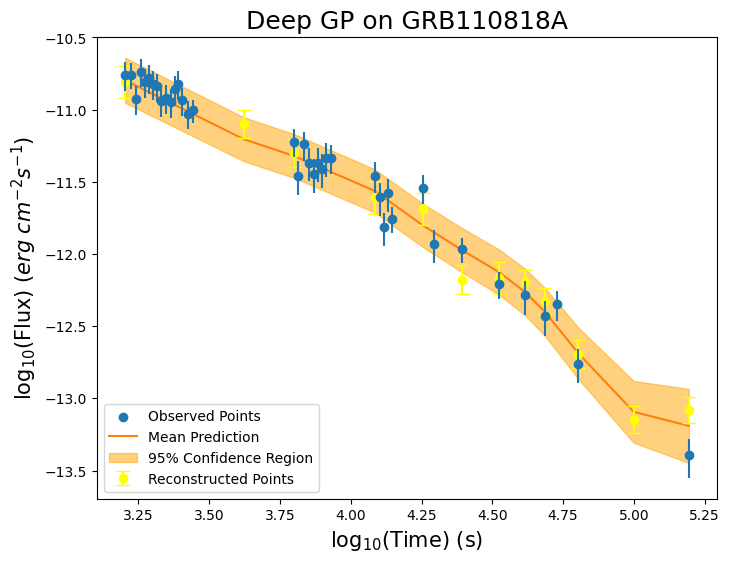


-----TRAINING FOR GRB111008A-----


-----ORIGINAL GRB-----



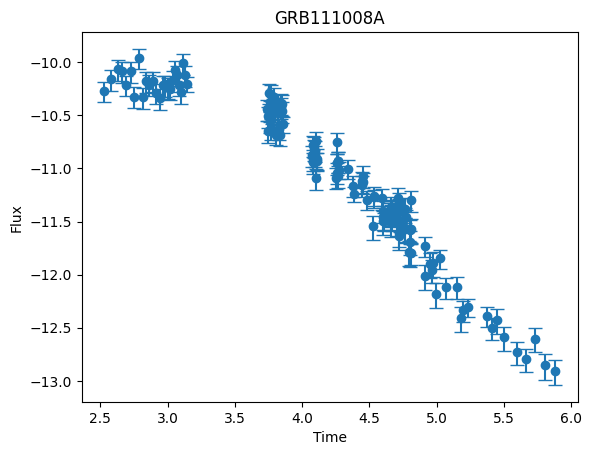


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.2104
Iteration 40/500 - Loss: 38.1731
Iteration 60/500 - Loss: 20.5463
Iteration 80/500 - Loss: 9.4917
Iteration 100/500 - Loss: 4.1794
Iteration 120/500 - Loss: 1.7394
Iteration 140/500 - Loss: 0.6704
Iteration 160/500 - Loss: 0.2499
Iteration 180/500 - Loss: 0.0454
Iteration 200/500 - Loss: -0.0649
Iteration 220/500 - Loss: -0.1002
Iteration 240/500 - Loss: -0.1251
Iteration 260/500 - Loss: -0.1446
Iteration 280/500 - Loss: -0.1603
Iteration 300/500 - Loss: -0.1732
Iteration 320/500 - Loss: -0.1839
Iteration 340/500 - Loss: -0.1930
Iteration 360/500 - Loss: -0.2008
Iteration 380/500 - Loss: -0.2077
Iteration 400/500 - Loss: -0.2137
Iteration 420/500 - Loss: -0.2167
Iteration 440/500 - Loss: -0.2193
Iteration 460/500 - Loss: -0.2218
Iteration 480/500 - Loss: -0.2242
Iteration 500/500 - Loss: -0.2265

-----RECONSTRUCTED GRB-----



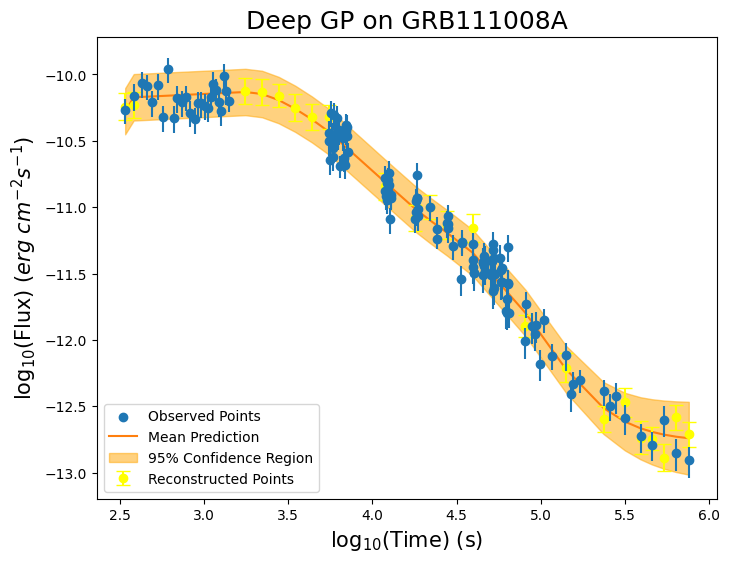


-----TRAINING FOR GRB111123A-----


-----ORIGINAL GRB-----



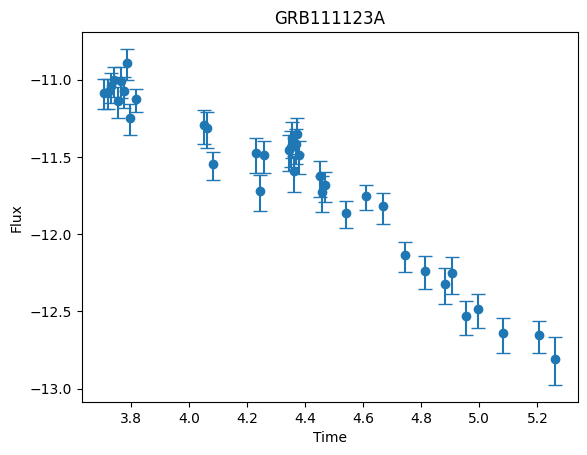


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.5241
Iteration 40/500 - Loss: 39.1785
Iteration 60/500 - Loss: 24.6038
Iteration 80/500 - Loss: 11.6218
Iteration 100/500 - Loss: 5.3507
Iteration 120/500 - Loss: 2.6001
Iteration 140/500 - Loss: 1.4231
Iteration 160/500 - Loss: 0.8772
Iteration 180/500 - Loss: 0.6262
Iteration 200/500 - Loss: 0.5082
Iteration 220/500 - Loss: 0.4722
Iteration 240/500 - Loss: 0.4477
Iteration 260/500 - Loss: 0.4288
Iteration 280/500 - Loss: 0.4171
Iteration 300/500 - Loss: 0.4004
Iteration 320/500 - Loss: 0.3865
Iteration 340/500 - Loss: 0.3646
Iteration 360/500 - Loss: 0.3367
Iteration 380/500 - Loss: 0.3056
Iteration 400/500 - Loss: 0.2636
Iteration 420/500 - Loss: 0.2371
Iteration 440/500 - Loss: 0.2104
Iteration 460/500 - Loss: 0.1826
Iteration 480/500 - Loss: 0.1537
Iteration 500/500 - Loss: 0.1240

-----RECONSTRUCTED GRB-----



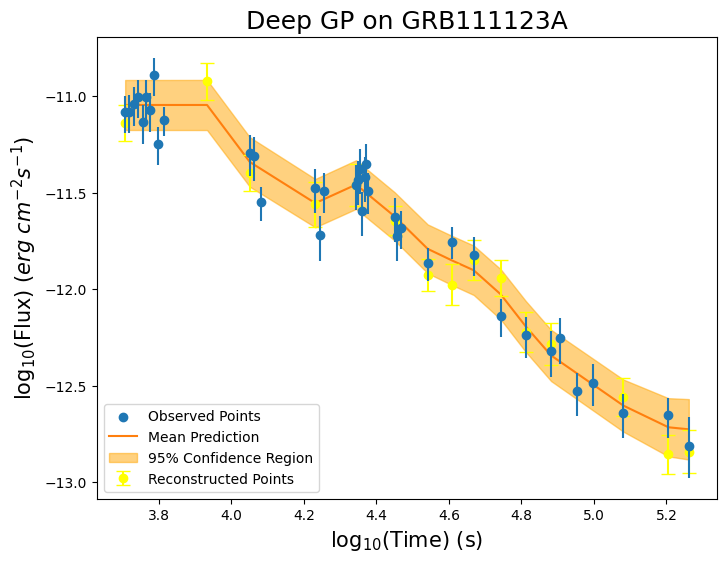


-----TRAINING FOR GRB111228A-----


-----ORIGINAL GRB-----



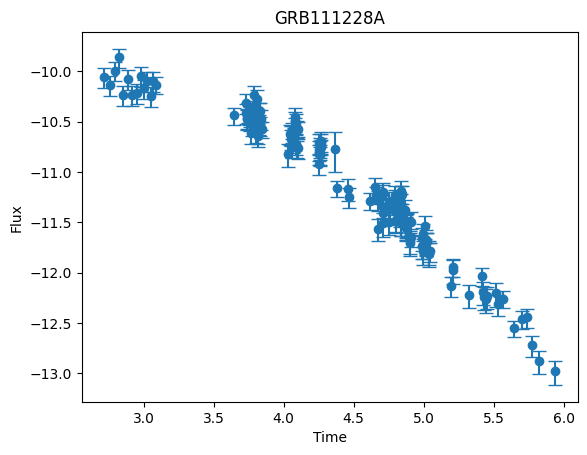


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.6378
Iteration 40/500 - Loss: 31.5715
Iteration 60/500 - Loss: 14.6988
Iteration 80/500 - Loss: 7.5554
Iteration 100/500 - Loss: 4.4525
Iteration 120/500 - Loss: 2.8519
Iteration 140/500 - Loss: 1.9022
Iteration 160/500 - Loss: 1.2577
Iteration 180/500 - Loss: 0.8113
Iteration 200/500 - Loss: 0.5103
Iteration 220/500 - Loss: 0.3975
Iteration 240/500 - Loss: 0.3110
Iteration 260/500 - Loss: 0.2398
Iteration 280/500 - Loss: 0.1811
Iteration 300/500 - Loss: 0.1325
Iteration 320/500 - Loss: 0.0919
Iteration 340/500 - Loss: 0.0578
Iteration 360/500 - Loss: 0.0290
Iteration 380/500 - Loss: 0.0046
Iteration 400/500 - Loss: -0.0162
Iteration 420/500 - Loss: -0.0259
Iteration 440/500 - Loss: -0.0345
Iteration 460/500 - Loss: -0.0426
Iteration 480/500 - Loss: -0.0502
Iteration 500/500 - Loss: -0.0573

-----RECONSTRUCTED GRB-----



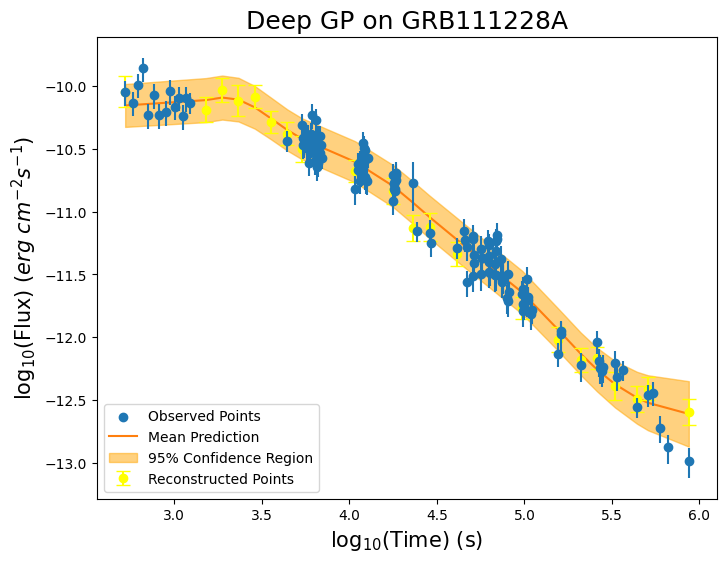


-----TRAINING FOR GRB120118B-----


-----ORIGINAL GRB-----



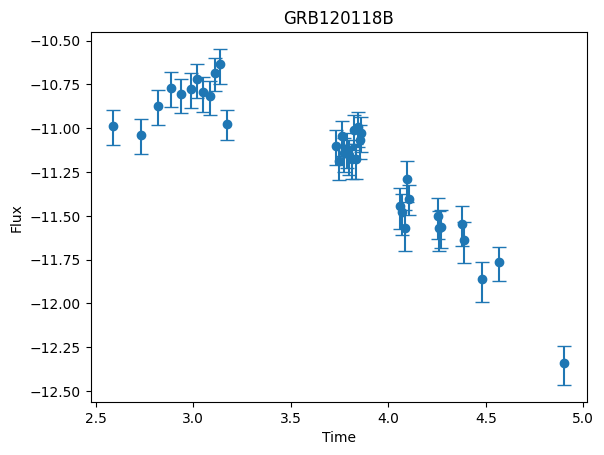


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.2529
Iteration 40/500 - Loss: 39.3340
Iteration 60/500 - Loss: 25.6112
Iteration 80/500 - Loss: 13.7749
Iteration 100/500 - Loss: 7.5155
Iteration 120/500 - Loss: 4.8583
Iteration 140/500 - Loss: 3.4045
Iteration 160/500 - Loss: 2.4727
Iteration 180/500 - Loss: 1.8707
Iteration 200/500 - Loss: 1.4895
Iteration 220/500 - Loss: 1.3472
Iteration 240/500 - Loss: 1.2427
Iteration 260/500 - Loss: 1.1205
Iteration 280/500 - Loss: 1.0147
Iteration 300/500 - Loss: 0.9260
Iteration 320/500 - Loss: 0.8485
Iteration 340/500 - Loss: 0.7866
Iteration 360/500 - Loss: 0.7399
Iteration 380/500 - Loss: 0.6971
Iteration 400/500 - Loss: 0.6706
Iteration 420/500 - Loss: 0.6587
Iteration 440/500 - Loss: 0.6480
Iteration 460/500 - Loss: 0.6375
Iteration 480/500 - Loss: 0.6272
Iteration 500/500 - Loss: 0.6169

-----RECONSTRUCTED GRB-----



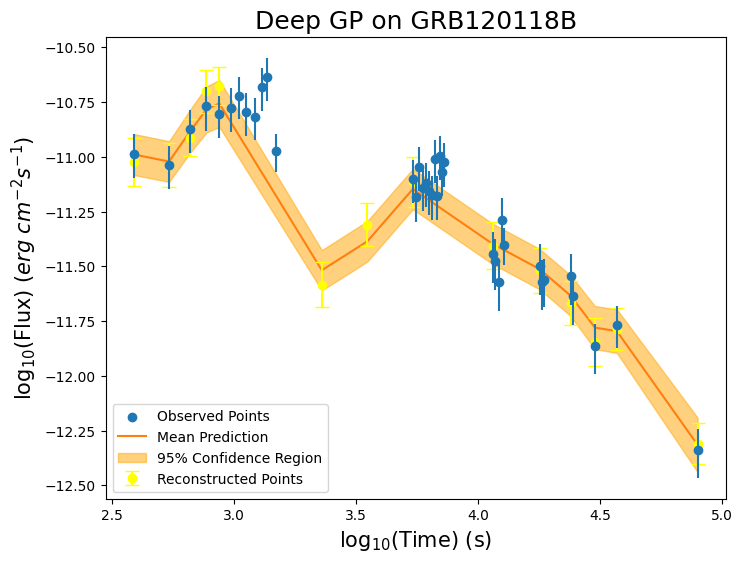


-----TRAINING FOR GRB120327A-----


-----ORIGINAL GRB-----



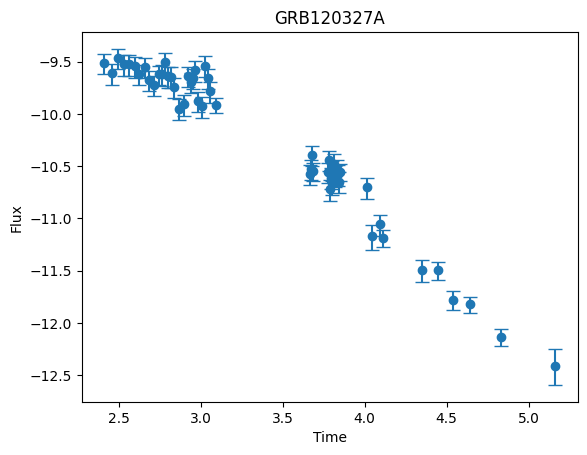


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.0133
Iteration 40/500 - Loss: 39.7241
Iteration 60/500 - Loss: 23.2631
Iteration 80/500 - Loss: 9.4154
Iteration 100/500 - Loss: 4.6332
Iteration 120/500 - Loss: 2.4345
Iteration 140/500 - Loss: 1.3778
Iteration 160/500 - Loss: 0.8768
Iteration 180/500 - Loss: 0.5834
Iteration 200/500 - Loss: 0.3997
Iteration 220/500 - Loss: 0.3265
Iteration 240/500 - Loss: 0.2689
Iteration 260/500 - Loss: 0.2194
Iteration 280/500 - Loss: 0.1740
Iteration 300/500 - Loss: 0.1354
Iteration 320/500 - Loss: 0.1002
Iteration 340/500 - Loss: 0.0696
Iteration 360/500 - Loss: 0.0425
Iteration 380/500 - Loss: 0.0191
Iteration 400/500 - Loss: -0.0019
Iteration 420/500 - Loss: -0.0133
Iteration 440/500 - Loss: -0.0226
Iteration 460/500 - Loss: -0.0315
Iteration 480/500 - Loss: -0.0401
Iteration 500/500 - Loss: -0.0482

-----RECONSTRUCTED GRB-----



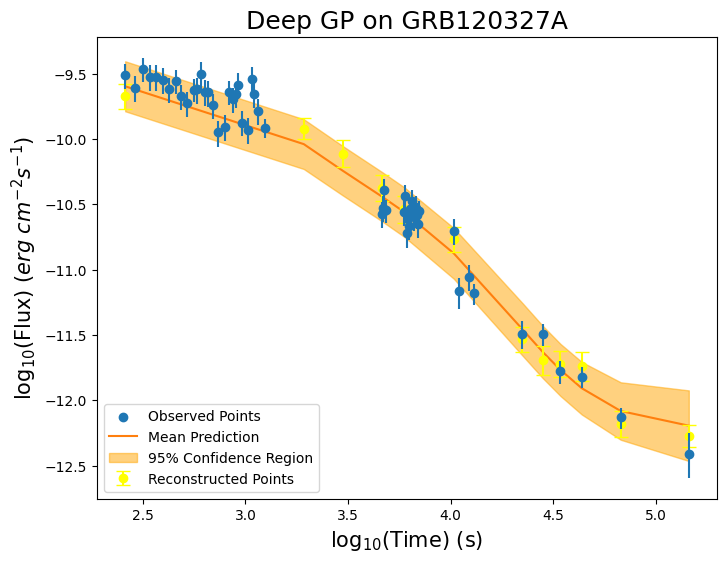


-----TRAINING FOR GRB120404A-----


-----ORIGINAL GRB-----



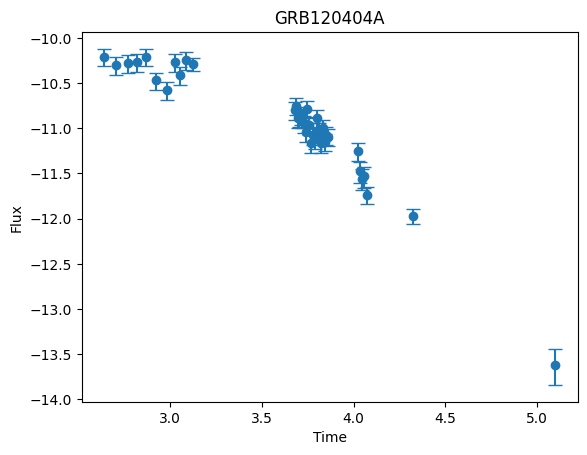


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.6220
Iteration 40/500 - Loss: 41.9655
Iteration 60/500 - Loss: 32.6193
Iteration 80/500 - Loss: 17.5283
Iteration 100/500 - Loss: 11.1922
Iteration 120/500 - Loss: 7.9513
Iteration 140/500 - Loss: 6.1047
Iteration 160/500 - Loss: 4.8934
Iteration 180/500 - Loss: 3.8952
Iteration 200/500 - Loss: 3.0412
Iteration 220/500 - Loss: 2.6643
Iteration 240/500 - Loss: 2.3449
Iteration 260/500 - Loss: 2.0587
Iteration 280/500 - Loss: 1.8043
Iteration 300/500 - Loss: 1.5804
Iteration 320/500 - Loss: 1.3854
Iteration 340/500 - Loss: 1.2172
Iteration 360/500 - Loss: 1.0737
Iteration 380/500 - Loss: 0.9523
Iteration 400/500 - Loss: 0.8497
Iteration 420/500 - Loss: 0.8032
Iteration 440/500 - Loss: 0.7626
Iteration 460/500 - Loss: 0.7249
Iteration 480/500 - Loss: 0.6902
Iteration 500/500 - Loss: 0.6582

-----RECONSTRUCTED GRB-----



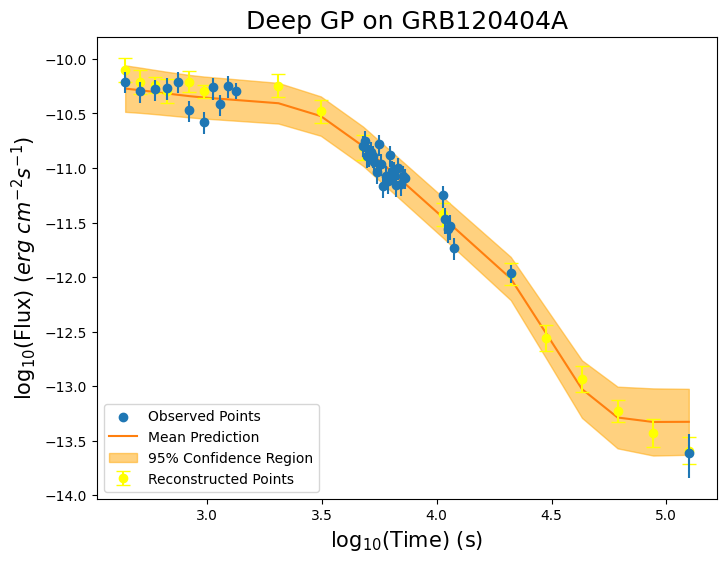


-----TRAINING FOR GRB120422A-----


-----ORIGINAL GRB-----



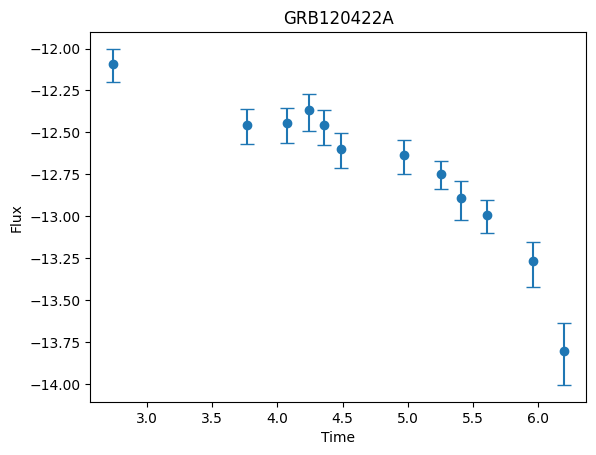


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 57.9829
Iteration 40/500 - Loss: 39.0222
Iteration 60/500 - Loss: 25.4704
Iteration 80/500 - Loss: 16.0530
Iteration 100/500 - Loss: 10.6108
Iteration 120/500 - Loss: 7.8773
Iteration 140/500 - Loss: 6.1994
Iteration 160/500 - Loss: 4.9901
Iteration 180/500 - Loss: 4.0695
Iteration 200/500 - Loss: 3.3404
Iteration 220/500 - Loss: 3.0206
Iteration 240/500 - Loss: 2.7461
Iteration 260/500 - Loss: 2.4932
Iteration 280/500 - Loss: 2.2536
Iteration 300/500 - Loss: 2.0070
Iteration 320/500 - Loss: 1.7060
Iteration 340/500 - Loss: 1.3957
Iteration 360/500 - Loss: 1.1764
Iteration 380/500 - Loss: 1.0122
Iteration 400/500 - Loss: 0.8641
Iteration 420/500 - Loss: 0.8005
Iteration 440/500 - Loss: 0.7473
Iteration 460/500 - Loss: 0.6989
Iteration 480/500 - Loss: 0.6545
Iteration 500/500 - Loss: 0.6135

-----RECONSTRUCTED GRB-----



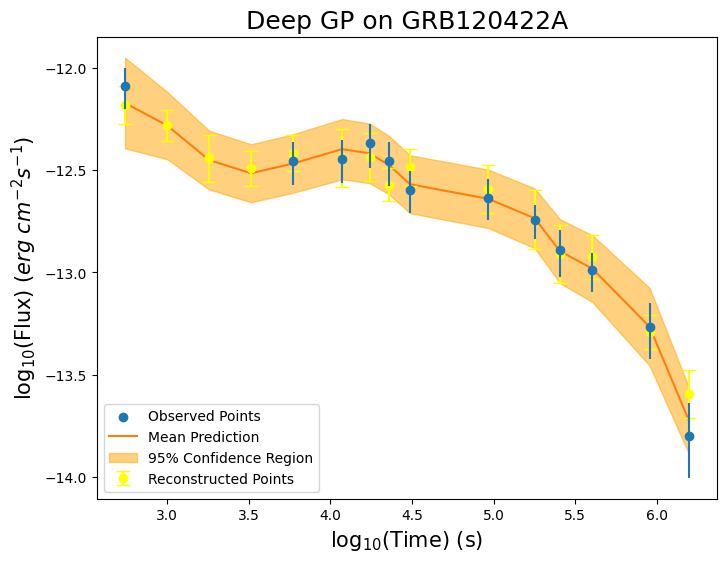


-----TRAINING FOR GRB120729A-----


-----ORIGINAL GRB-----



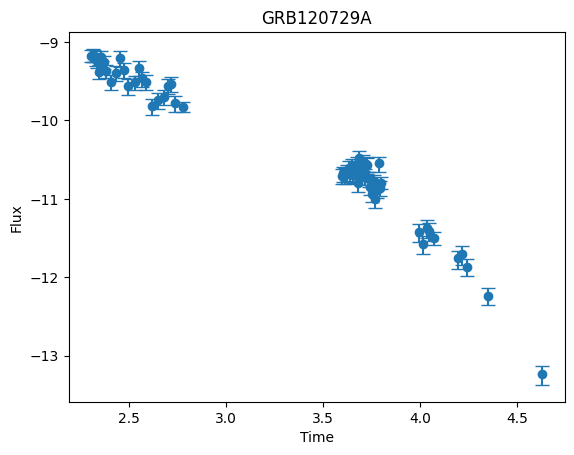


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.8386
Iteration 40/500 - Loss: 39.5316
Iteration 60/500 - Loss: 23.1123
Iteration 80/500 - Loss: 10.4830
Iteration 100/500 - Loss: 5.9641
Iteration 120/500 - Loss: 3.4046
Iteration 140/500 - Loss: 2.1174
Iteration 160/500 - Loss: 1.4244
Iteration 180/500 - Loss: 1.0143
Iteration 200/500 - Loss: 0.7313
Iteration 220/500 - Loss: 0.6170
Iteration 240/500 - Loss: 0.5212
Iteration 260/500 - Loss: 0.4346
Iteration 280/500 - Loss: 0.3559
Iteration 300/500 - Loss: 0.2844
Iteration 320/500 - Loss: 0.2195
Iteration 340/500 - Loss: 0.1609
Iteration 360/500 - Loss: 0.1083
Iteration 380/500 - Loss: 0.0612
Iteration 400/500 - Loss: 0.0192
Iteration 420/500 - Loss: -0.0009
Iteration 440/500 - Loss: -0.0191
Iteration 460/500 - Loss: -0.0365
Iteration 480/500 - Loss: -0.0530
Iteration 500/500 - Loss: -0.0688

-----RECONSTRUCTED GRB-----



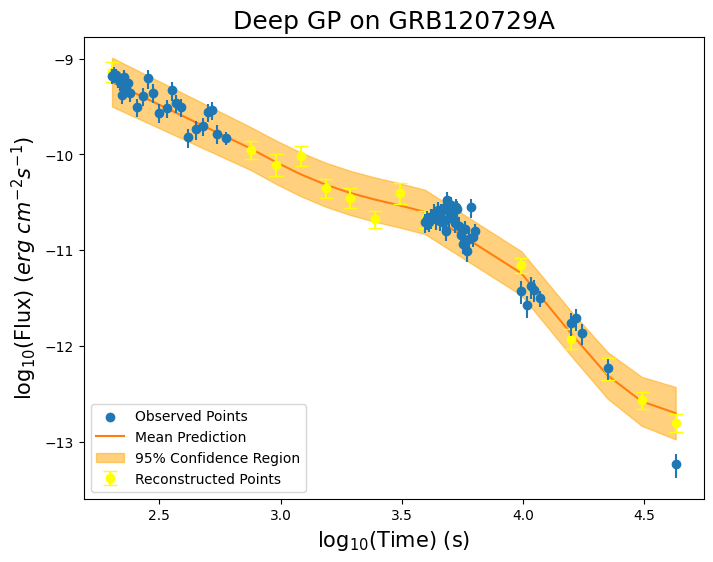


-----TRAINING FOR GRB120802A-----


-----ORIGINAL GRB-----



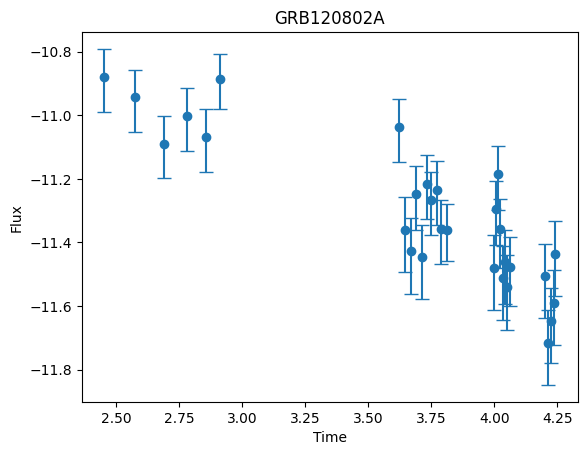


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 60.2524
Iteration 40/500 - Loss: 33.0896
Iteration 60/500 - Loss: 17.2280
Iteration 80/500 - Loss: 12.2381
Iteration 100/500 - Loss: 9.4233
Iteration 120/500 - Loss: 7.8663
Iteration 140/500 - Loss: 7.1300
Iteration 160/500 - Loss: 6.6587
Iteration 180/500 - Loss: 6.1693
Iteration 200/500 - Loss: 5.8726
Iteration 220/500 - Loss: 5.7592
Iteration 240/500 - Loss: 5.6615
Iteration 260/500 - Loss: 5.5630
Iteration 280/500 - Loss: 5.4907
Iteration 300/500 - Loss: 5.4248
Iteration 320/500 - Loss: 5.3621
Iteration 340/500 - Loss: 5.3014
Iteration 360/500 - Loss: 5.2421
Iteration 380/500 - Loss: 5.1870
Iteration 400/500 - Loss: 5.1278
Iteration 420/500 - Loss: 5.0976
Iteration 440/500 - Loss: 5.0693
Iteration 460/500 - Loss: 5.0408
Iteration 480/500 - Loss: 5.0122
Iteration 500/500 - Loss: 4.9835

-----RECONSTRUCTED GRB-----



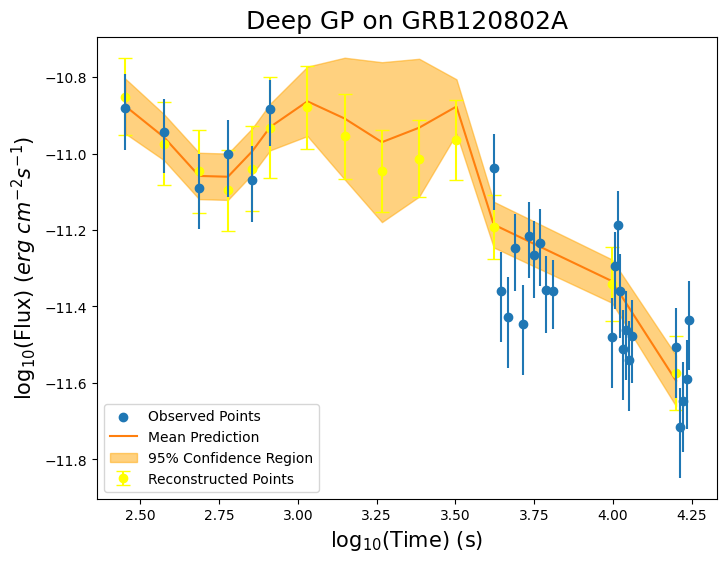


-----TRAINING FOR GRB120811C-----


-----ORIGINAL GRB-----



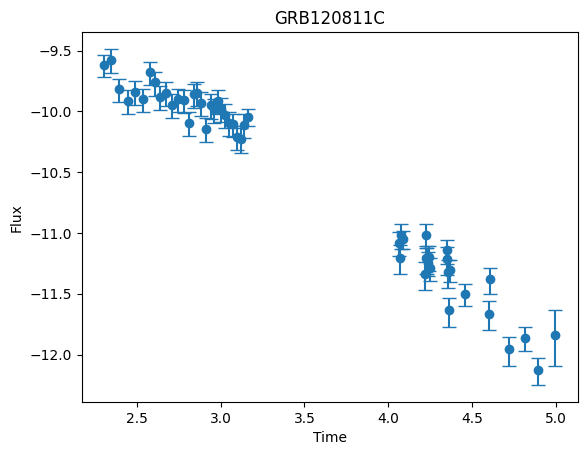


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 45.8891
Iteration 40/500 - Loss: 31.2426
Iteration 60/500 - Loss: 10.6129
Iteration 80/500 - Loss: 3.6276
Iteration 100/500 - Loss: 2.1514
Iteration 120/500 - Loss: 1.4786
Iteration 140/500 - Loss: 1.0729
Iteration 160/500 - Loss: 0.7710
Iteration 180/500 - Loss: 0.5431
Iteration 200/500 - Loss: 0.3710
Iteration 220/500 - Loss: 0.2984
Iteration 240/500 - Loss: 0.2378
Iteration 260/500 - Loss: 0.1840
Iteration 280/500 - Loss: 0.1363
Iteration 300/500 - Loss: 0.0942
Iteration 320/500 - Loss: 0.0571
Iteration 340/500 - Loss: 0.0246
Iteration 360/500 - Loss: -0.0037
Iteration 380/500 - Loss: -0.0285
Iteration 400/500 - Loss: -0.0499
Iteration 420/500 - Loss: -0.0600
Iteration 440/500 - Loss: -0.0690
Iteration 460/500 - Loss: -0.0775
Iteration 480/500 - Loss: -0.0855
Iteration 500/500 - Loss: -0.0929

-----RECONSTRUCTED GRB-----



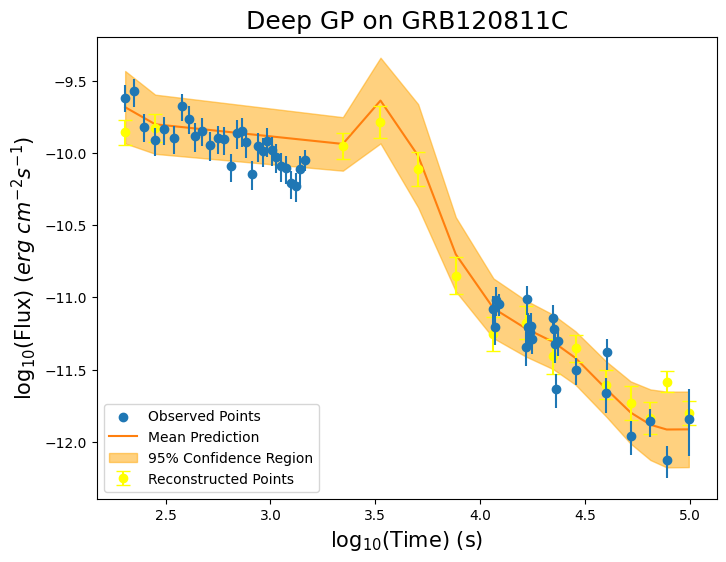


-----TRAINING FOR GRB120907A-----


-----ORIGINAL GRB-----



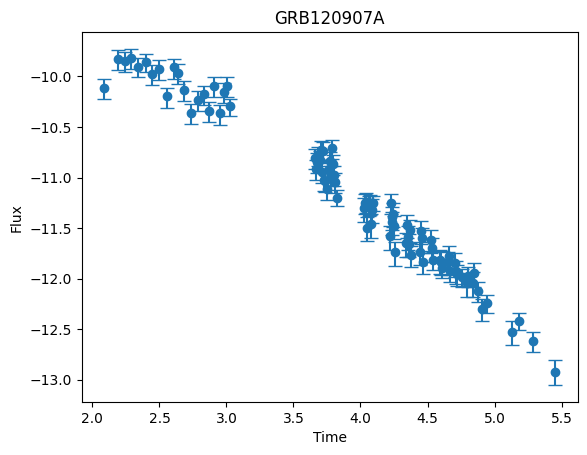


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.2163
Iteration 40/500 - Loss: 33.3536
Iteration 60/500 - Loss: 13.7228
Iteration 80/500 - Loss: 5.6734
Iteration 100/500 - Loss: 2.6956
Iteration 120/500 - Loss: 1.5556
Iteration 140/500 - Loss: 1.0524
Iteration 160/500 - Loss: 0.7430
Iteration 180/500 - Loss: 0.5286
Iteration 200/500 - Loss: 0.3685
Iteration 220/500 - Loss: 0.2999
Iteration 240/500 - Loss: 0.2409
Iteration 260/500 - Loss: 0.1864
Iteration 280/500 - Loss: 0.1354
Iteration 300/500 - Loss: 0.0874
Iteration 320/500 - Loss: 0.0416
Iteration 340/500 - Loss: -0.0025
Iteration 360/500 - Loss: -0.0448
Iteration 380/500 - Loss: -0.0845
Iteration 400/500 - Loss: -0.1210
Iteration 420/500 - Loss: -0.1384
Iteration 440/500 - Loss: -0.1538
Iteration 460/500 - Loss: -0.1682
Iteration 480/500 - Loss: -0.1814
Iteration 500/500 - Loss: -0.1934

-----RECONSTRUCTED GRB-----



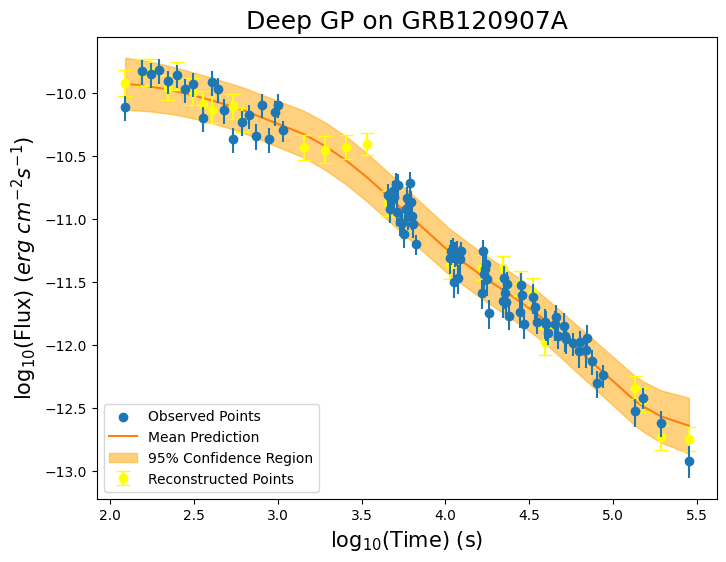


-----TRAINING FOR GRB120922A-----


-----ORIGINAL GRB-----



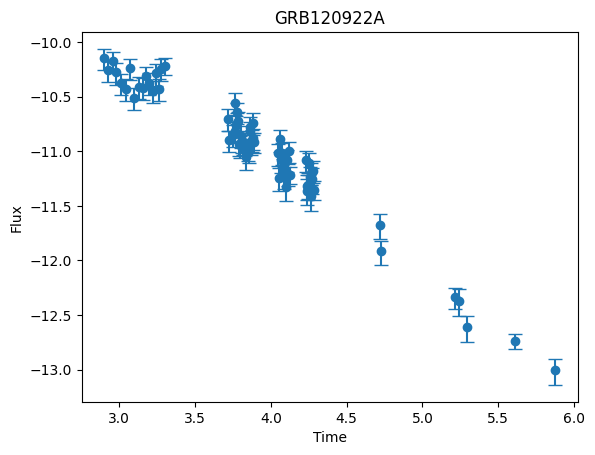


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.3035
Iteration 40/500 - Loss: 37.9849
Iteration 60/500 - Loss: 25.6930
Iteration 80/500 - Loss: 13.3642
Iteration 100/500 - Loss: 5.9310
Iteration 120/500 - Loss: 2.5193
Iteration 140/500 - Loss: 1.2549
Iteration 160/500 - Loss: 0.8401
Iteration 180/500 - Loss: 0.6887
Iteration 200/500 - Loss: 0.6138
Iteration 220/500 - Loss: 0.5858
Iteration 240/500 - Loss: 0.5618
Iteration 260/500 - Loss: 0.5382
Iteration 280/500 - Loss: 0.5134
Iteration 300/500 - Loss: 0.4852
Iteration 320/500 - Loss: 0.4492
Iteration 340/500 - Loss: 0.4004
Iteration 360/500 - Loss: 0.3430
Iteration 380/500 - Loss: 0.2930
Iteration 400/500 - Loss: 0.2537
Iteration 420/500 - Loss: 0.2374
Iteration 440/500 - Loss: 0.2242
Iteration 460/500 - Loss: 0.2127
Iteration 480/500 - Loss: 0.2029
Iteration 500/500 - Loss: 0.1944

-----RECONSTRUCTED GRB-----



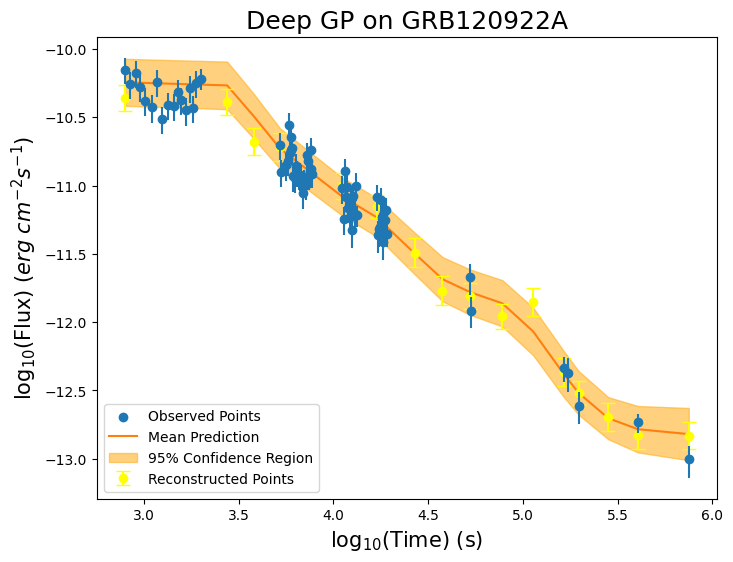


-----TRAINING FOR GRB121024A-----


-----ORIGINAL GRB-----



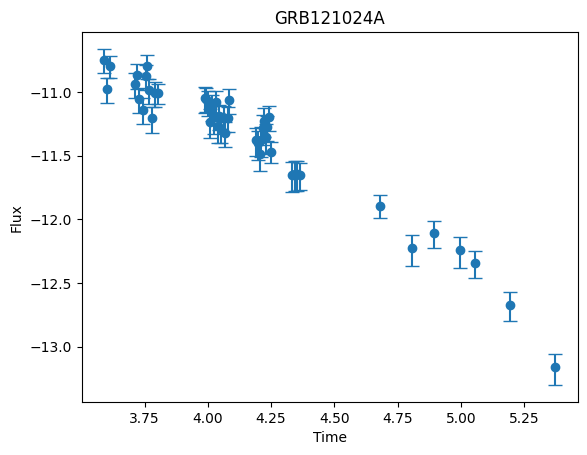


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.1847
Iteration 40/500 - Loss: 38.0126
Iteration 60/500 - Loss: 23.8124
Iteration 80/500 - Loss: 11.9209
Iteration 100/500 - Loss: 6.7035
Iteration 120/500 - Loss: 4.6437
Iteration 140/500 - Loss: 3.5384
Iteration 160/500 - Loss: 2.8128
Iteration 180/500 - Loss: 2.2747
Iteration 200/500 - Loss: 1.8586
Iteration 220/500 - Loss: 1.6746
Iteration 240/500 - Loss: 1.5125
Iteration 260/500 - Loss: 1.3604
Iteration 280/500 - Loss: 1.2190
Iteration 300/500 - Loss: 1.0915
Iteration 320/500 - Loss: 0.9833
Iteration 340/500 - Loss: 0.8956
Iteration 360/500 - Loss: 0.8299
Iteration 380/500 - Loss: 0.7795
Iteration 400/500 - Loss: 0.7408
Iteration 420/500 - Loss: 0.7233
Iteration 440/500 - Loss: 0.7082
Iteration 460/500 - Loss: 0.6940
Iteration 480/500 - Loss: 0.6807
Iteration 500/500 - Loss: 0.6682

-----RECONSTRUCTED GRB-----



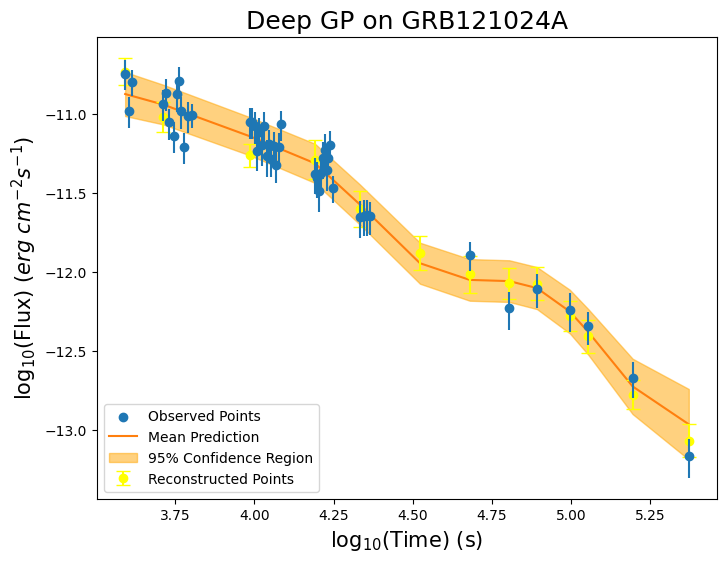


-----TRAINING FOR GRB121027A-----


-----ORIGINAL GRB-----



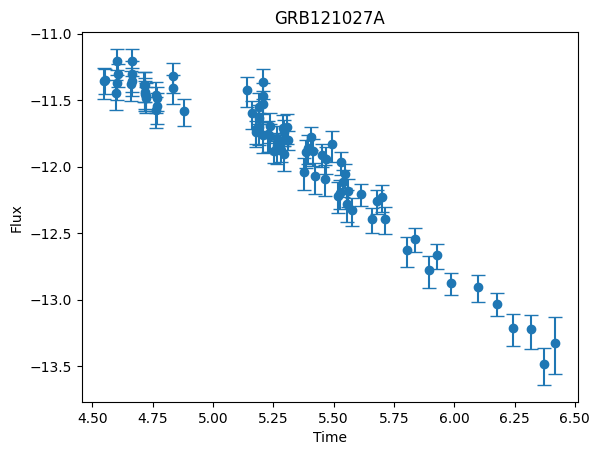


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.7517
Iteration 40/500 - Loss: 37.8733
Iteration 60/500 - Loss: 23.6432
Iteration 80/500 - Loss: 11.4469
Iteration 100/500 - Loss: 5.5125
Iteration 120/500 - Loss: 2.7041
Iteration 140/500 - Loss: 1.4522
Iteration 160/500 - Loss: 0.9155
Iteration 180/500 - Loss: 0.6867
Iteration 200/500 - Loss: 0.5749
Iteration 220/500 - Loss: 0.5353
Iteration 240/500 - Loss: 0.5033
Iteration 260/500 - Loss: 0.4749
Iteration 280/500 - Loss: 0.4493
Iteration 300/500 - Loss: 0.4261
Iteration 320/500 - Loss: 0.4048
Iteration 340/500 - Loss: 0.3852
Iteration 360/500 - Loss: 0.3671
Iteration 380/500 - Loss: 0.3506
Iteration 400/500 - Loss: 0.3355
Iteration 420/500 - Loss: 0.3281
Iteration 440/500 - Loss: 0.3214
Iteration 460/500 - Loss: 0.3149
Iteration 480/500 - Loss: 0.3087
Iteration 500/500 - Loss: 0.3028

-----RECONSTRUCTED GRB-----



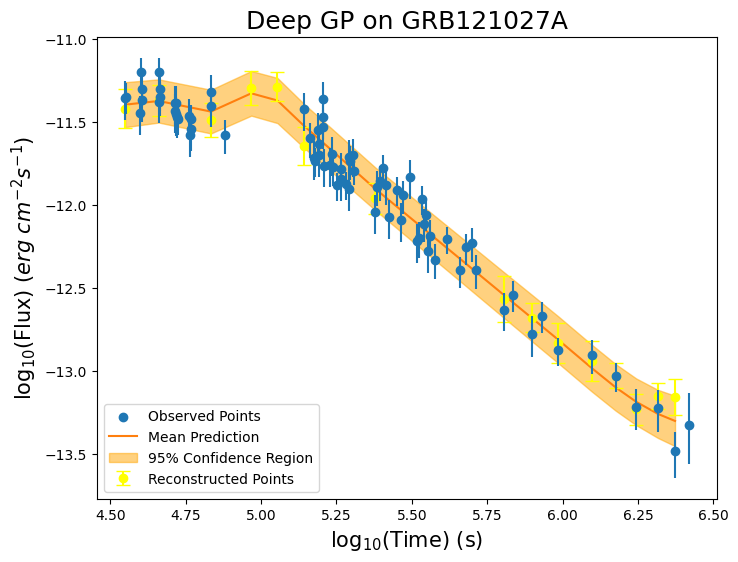


-----TRAINING FOR GRB121128A-----


-----ORIGINAL GRB-----



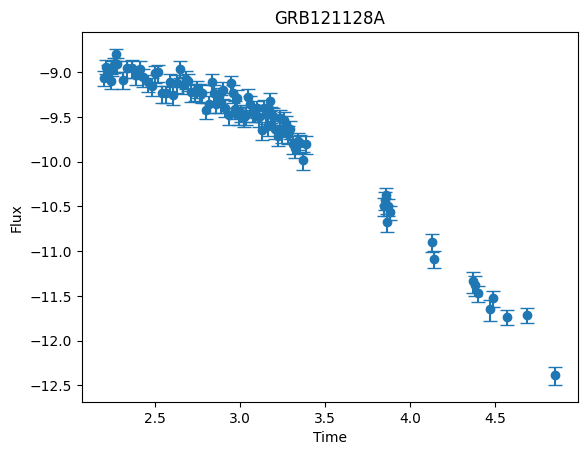


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.9698
Iteration 40/500 - Loss: 36.8230
Iteration 60/500 - Loss: 23.0315
Iteration 80/500 - Loss: 10.3117
Iteration 100/500 - Loss: 5.3630
Iteration 120/500 - Loss: 3.0587
Iteration 140/500 - Loss: 1.3366
Iteration 160/500 - Loss: 0.6475
Iteration 180/500 - Loss: 0.3317
Iteration 200/500 - Loss: 0.1460
Iteration 220/500 - Loss: 0.0570
Iteration 240/500 - Loss: -0.0030
Iteration 260/500 - Loss: -0.0540
Iteration 280/500 - Loss: -0.0965
Iteration 300/500 - Loss: -0.1320
Iteration 320/500 - Loss: -0.1620
Iteration 340/500 - Loss: -0.1871
Iteration 360/500 - Loss: -0.2083
Iteration 380/500 - Loss: -0.2278
Iteration 400/500 - Loss: -0.2452
Iteration 420/500 - Loss: -0.2540
Iteration 440/500 - Loss: -0.2618
Iteration 460/500 - Loss: -0.2692
Iteration 480/500 - Loss: -0.2764
Iteration 500/500 - Loss: -0.2824

-----RECONSTRUCTED GRB-----



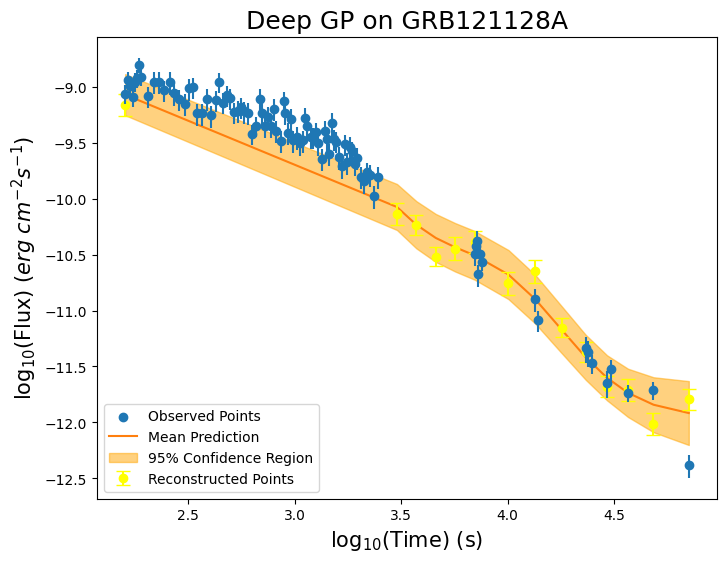


-----TRAINING FOR GRB121211A-----


-----ORIGINAL GRB-----



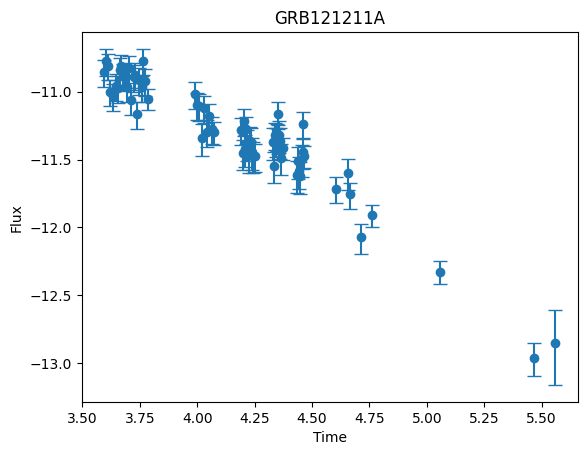


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.1520
Iteration 40/500 - Loss: 40.8643
Iteration 60/500 - Loss: 31.3551
Iteration 80/500 - Loss: 21.4210
Iteration 100/500 - Loss: 12.1077
Iteration 120/500 - Loss: 7.0956
Iteration 140/500 - Loss: 4.6131
Iteration 160/500 - Loss: 3.2471
Iteration 180/500 - Loss: 2.5380
Iteration 200/500 - Loss: 2.1685
Iteration 220/500 - Loss: 2.0491
Iteration 240/500 - Loss: 1.9602
Iteration 260/500 - Loss: 1.8843
Iteration 280/500 - Loss: 1.8162
Iteration 300/500 - Loss: 1.7529
Iteration 320/500 - Loss: 1.6926
Iteration 340/500 - Loss: 1.6350
Iteration 360/500 - Loss: 1.5811
Iteration 380/500 - Loss: 1.5321
Iteration 400/500 - Loss: 1.4881
Iteration 420/500 - Loss: 1.4670
Iteration 440/500 - Loss: 1.4478
Iteration 460/500 - Loss: 1.4293
Iteration 480/500 - Loss: 1.4116
Iteration 500/500 - Loss: 1.3944

-----RECONSTRUCTED GRB-----



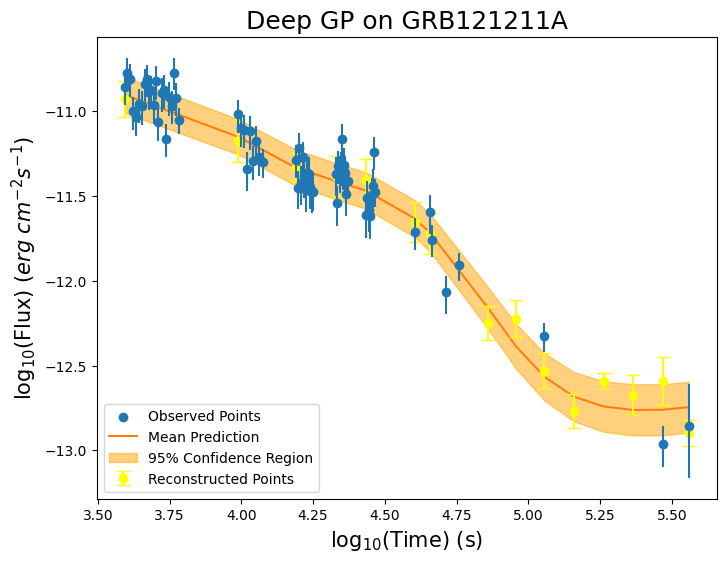


-----TRAINING FOR GRB130408A-----


-----ORIGINAL GRB-----



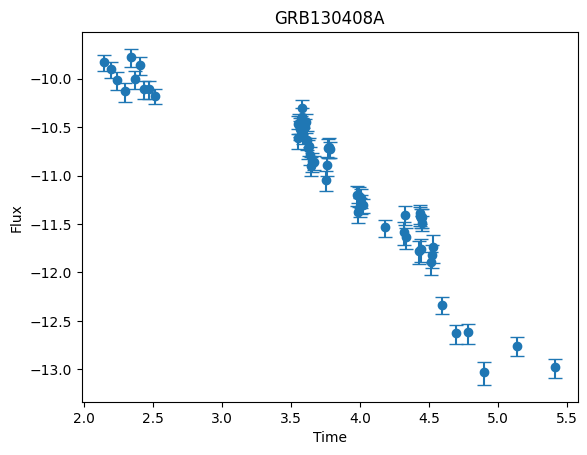


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 54.1299
Iteration 40/500 - Loss: 34.4600
Iteration 60/500 - Loss: 17.8467
Iteration 80/500 - Loss: 9.5372
Iteration 100/500 - Loss: 5.9522
Iteration 120/500 - Loss: 4.0949
Iteration 140/500 - Loss: 2.9336
Iteration 160/500 - Loss: 2.1462
Iteration 180/500 - Loss: 1.6036
Iteration 200/500 - Loss: 1.2337
Iteration 220/500 - Loss: 1.0925
Iteration 240/500 - Loss: 0.9815
Iteration 260/500 - Loss: 0.8875
Iteration 280/500 - Loss: 0.8078
Iteration 300/500 - Loss: 0.7403
Iteration 320/500 - Loss: 0.6830
Iteration 340/500 - Loss: 0.6338
Iteration 360/500 - Loss: 0.5911
Iteration 380/500 - Loss: 0.5538
Iteration 400/500 - Loss: 0.5210
Iteration 420/500 - Loss: 0.5051
Iteration 440/500 - Loss: 0.4908
Iteration 460/500 - Loss: 0.4771
Iteration 480/500 - Loss: 0.4640
Iteration 500/500 - Loss: 0.4514

-----RECONSTRUCTED GRB-----



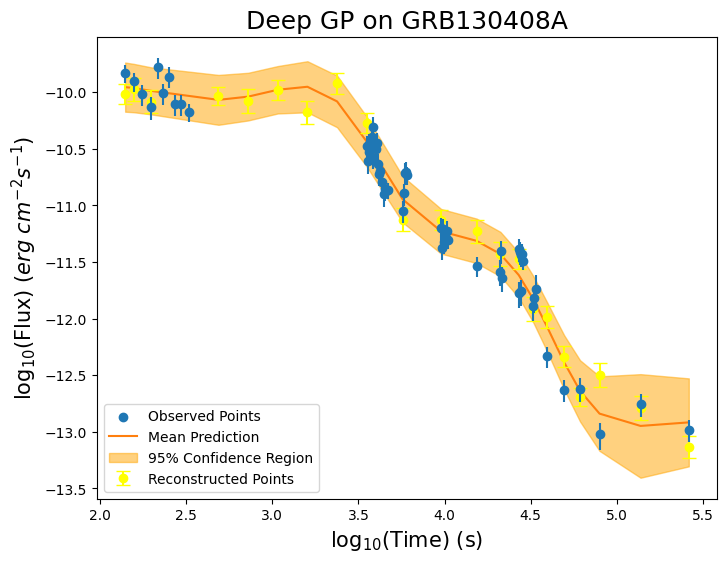


-----TRAINING FOR GRB130418A-----


-----ORIGINAL GRB-----



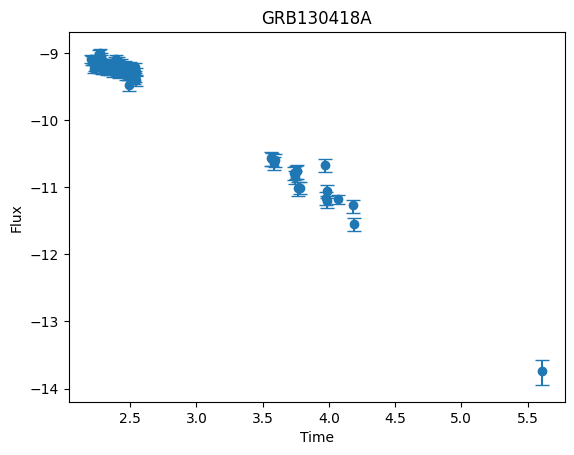


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.8188
Iteration 40/500 - Loss: 41.6174
Iteration 60/500 - Loss: 31.3873
Iteration 80/500 - Loss: 20.4425
Iteration 100/500 - Loss: 13.0072
Iteration 120/500 - Loss: 8.3689
Iteration 140/500 - Loss: 5.8667
Iteration 160/500 - Loss: 4.5173
Iteration 180/500 - Loss: 3.5926
Iteration 200/500 - Loss: 2.7967
Iteration 220/500 - Loss: 2.4278
Iteration 240/500 - Loss: 2.1012
Iteration 260/500 - Loss: 1.7956
Iteration 280/500 - Loss: 1.5069
Iteration 300/500 - Loss: 1.2401
Iteration 320/500 - Loss: 0.9951
Iteration 340/500 - Loss: 0.7750
Iteration 360/500 - Loss: 0.5771
Iteration 380/500 - Loss: 0.4022
Iteration 400/500 - Loss: 0.2531
Iteration 420/500 - Loss: 0.1776
Iteration 440/500 - Loss: 0.1139
Iteration 460/500 - Loss: 0.0544
Iteration 480/500 - Loss: -0.0007
Iteration 500/500 - Loss: -0.0528

-----RECONSTRUCTED GRB-----



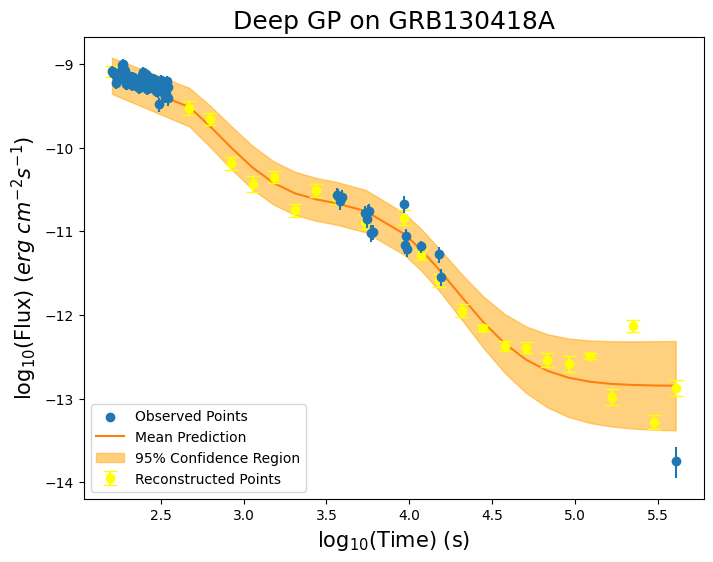


-----TRAINING FOR GRB130420A-----


-----ORIGINAL GRB-----



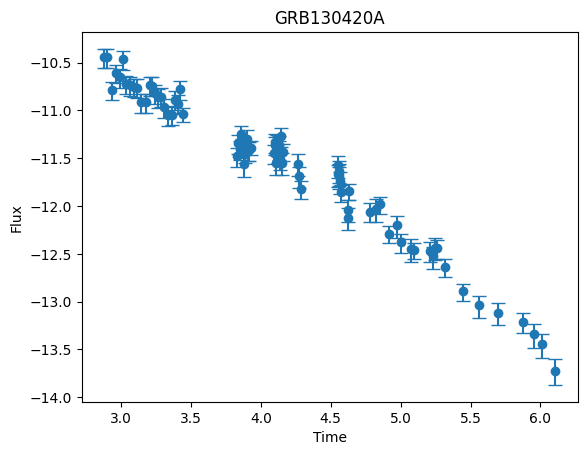


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.0348
Iteration 40/500 - Loss: 38.2541
Iteration 60/500 - Loss: 24.6509
Iteration 80/500 - Loss: 11.3867
Iteration 100/500 - Loss: 4.8625
Iteration 120/500 - Loss: 2.4342
Iteration 140/500 - Loss: 1.3045
Iteration 160/500 - Loss: 0.7062
Iteration 180/500 - Loss: 0.4047
Iteration 200/500 - Loss: 0.2705
Iteration 220/500 - Loss: 0.1991
Iteration 240/500 - Loss: 0.1543
Iteration 260/500 - Loss: 0.1169
Iteration 280/500 - Loss: 0.0848
Iteration 300/500 - Loss: 0.0553
Iteration 320/500 - Loss: 0.0288
Iteration 340/500 - Loss: 0.0051
Iteration 360/500 - Loss: -0.0162
Iteration 380/500 - Loss: -0.0355
Iteration 400/500 - Loss: -0.0529
Iteration 420/500 - Loss: -0.0616
Iteration 440/500 - Loss: -0.0695
Iteration 460/500 - Loss: -0.0770
Iteration 480/500 - Loss: -0.0843
Iteration 500/500 - Loss: -0.0913

-----RECONSTRUCTED GRB-----



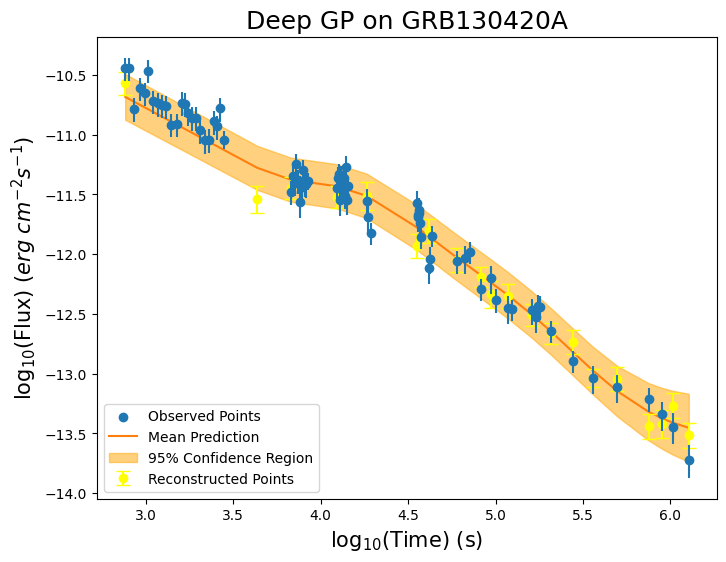


-----TRAINING FOR GRB130511A-----


-----ORIGINAL GRB-----



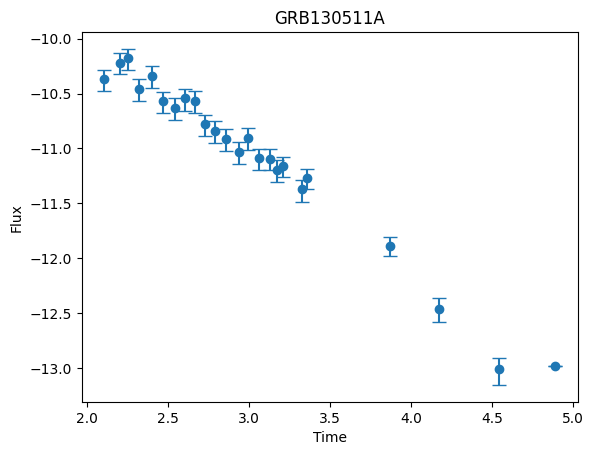


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.9912
Iteration 40/500 - Loss: 32.2076
Iteration 60/500 - Loss: 16.0527
Iteration 80/500 - Loss: 8.1510
Iteration 100/500 - Loss: 4.2747
Iteration 120/500 - Loss: 2.1969
Iteration 140/500 - Loss: 1.0974
Iteration 160/500 - Loss: 0.5090
Iteration 180/500 - Loss: 0.1843
Iteration 200/500 - Loss: 0.0010
Iteration 220/500 - Loss: -0.0601
Iteration 240/500 - Loss: -0.1046
Iteration 260/500 - Loss: -0.1399
Iteration 280/500 - Loss: -0.1682
Iteration 300/500 - Loss: -0.1909
Iteration 320/500 - Loss: -0.2093
Iteration 340/500 - Loss: -0.2242
Iteration 360/500 - Loss: -0.2365
Iteration 380/500 - Loss: -0.2468
Iteration 400/500 - Loss: -0.2556
Iteration 420/500 - Loss: -0.2597
Iteration 440/500 - Loss: -0.2633
Iteration 460/500 - Loss: -0.2667
Iteration 480/500 - Loss: -0.2700
Iteration 500/500 - Loss: -0.2730

-----RECONSTRUCTED GRB-----



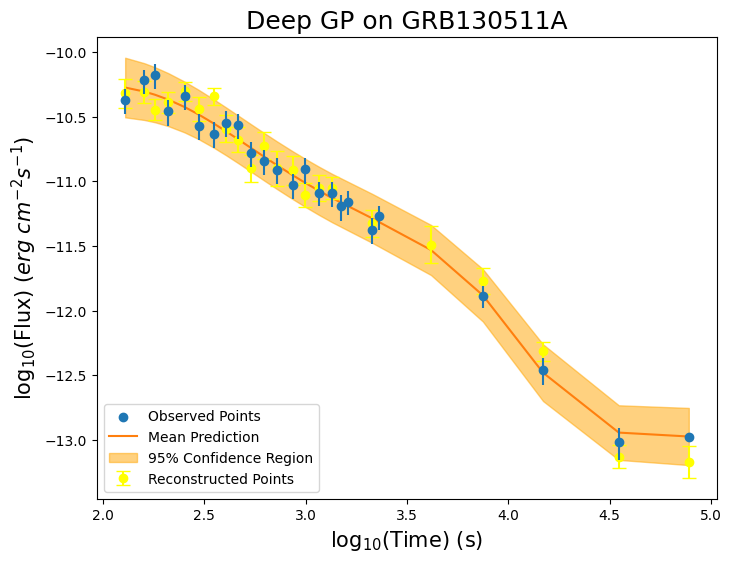


-----TRAINING FOR GRB130514A-----


-----ORIGINAL GRB-----



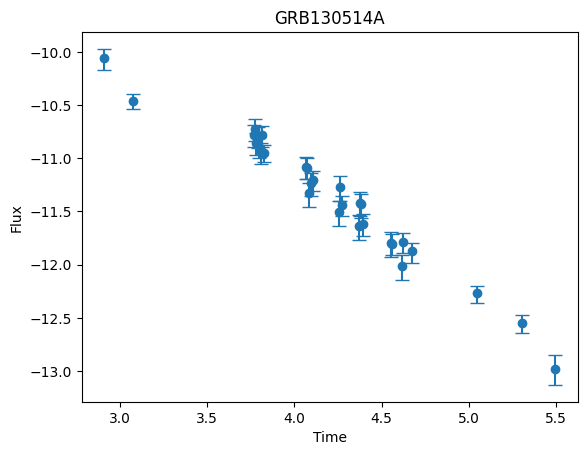


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.7922
Iteration 40/500 - Loss: 29.4166
Iteration 60/500 - Loss: 15.4591
Iteration 80/500 - Loss: 9.2254
Iteration 100/500 - Loss: 5.4469
Iteration 120/500 - Loss: 3.3078
Iteration 140/500 - Loss: 2.1366
Iteration 160/500 - Loss: 1.3915
Iteration 180/500 - Loss: 0.8667
Iteration 200/500 - Loss: 0.5789
Iteration 220/500 - Loss: 0.4770
Iteration 240/500 - Loss: 0.3955
Iteration 260/500 - Loss: 0.3231
Iteration 280/500 - Loss: 0.2592
Iteration 300/500 - Loss: 0.2048
Iteration 320/500 - Loss: 0.1594
Iteration 340/500 - Loss: 0.1222
Iteration 360/500 - Loss: 0.0917
Iteration 380/500 - Loss: 0.0671
Iteration 400/500 - Loss: 0.0472
Iteration 420/500 - Loss: 0.0384
Iteration 440/500 - Loss: 0.0308
Iteration 460/500 - Loss: 0.0238
Iteration 480/500 - Loss: 0.0174
Iteration 500/500 - Loss: 0.0114

-----RECONSTRUCTED GRB-----



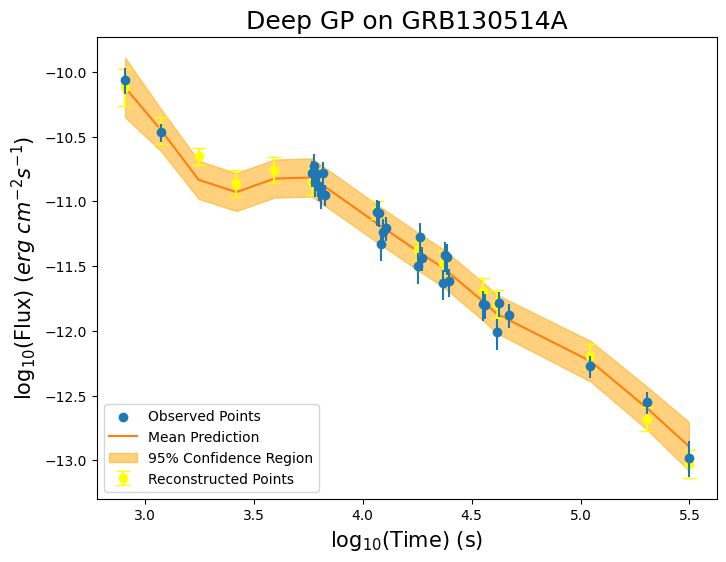


-----TRAINING FOR GRB130603B-----


-----ORIGINAL GRB-----



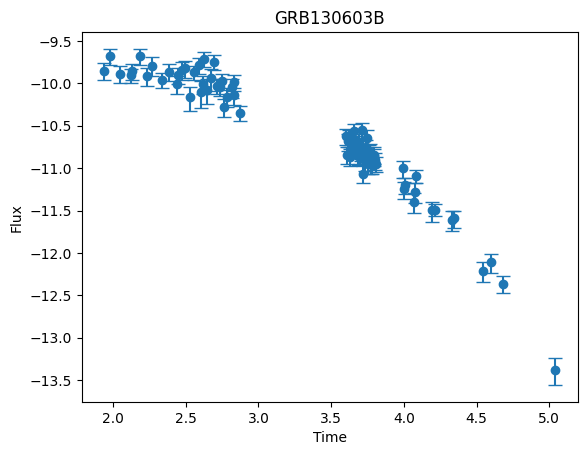


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.4552
Iteration 40/500 - Loss: 37.5350
Iteration 60/500 - Loss: 20.8638
Iteration 80/500 - Loss: 10.7712
Iteration 100/500 - Loss: 6.4859
Iteration 120/500 - Loss: 4.3610
Iteration 140/500 - Loss: 3.0679
Iteration 160/500 - Loss: 2.2586
Iteration 180/500 - Loss: 1.7329
Iteration 200/500 - Loss: 1.3690
Iteration 220/500 - Loss: 1.2200
Iteration 240/500 - Loss: 1.0952
Iteration 260/500 - Loss: 0.9820
Iteration 280/500 - Loss: 0.8784
Iteration 300/500 - Loss: 0.7827
Iteration 320/500 - Loss: 0.6990
Iteration 340/500 - Loss: 0.6261
Iteration 360/500 - Loss: 0.5567
Iteration 380/500 - Loss: 0.5021
Iteration 400/500 - Loss: 0.4429
Iteration 420/500 - Loss: 0.4167
Iteration 440/500 - Loss: 0.3932
Iteration 460/500 - Loss: 0.3705
Iteration 480/500 - Loss: 0.3489
Iteration 500/500 - Loss: 0.3282

-----RECONSTRUCTED GRB-----



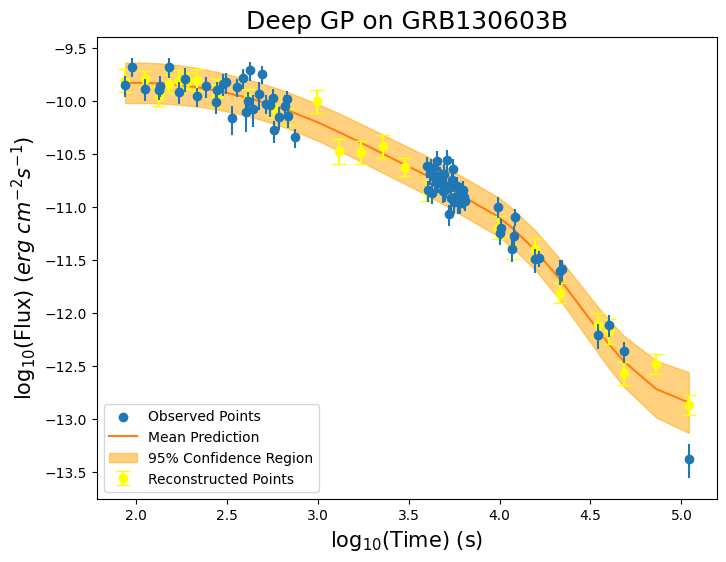


-----TRAINING FOR GRB130606A-----


-----ORIGINAL GRB-----



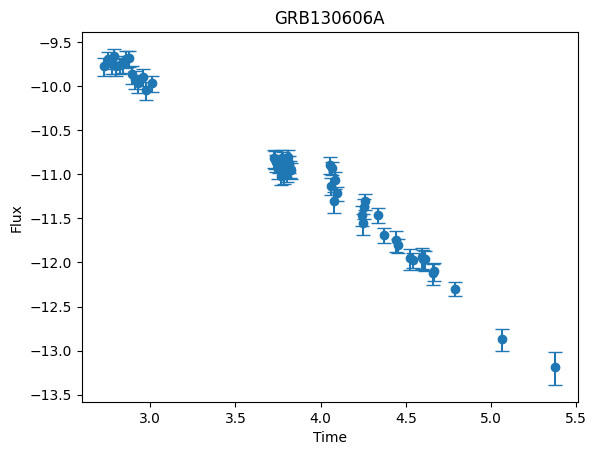


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.9097
Iteration 40/500 - Loss: 40.3110
Iteration 60/500 - Loss: 25.6195
Iteration 80/500 - Loss: 12.2513
Iteration 100/500 - Loss: 6.0107
Iteration 120/500 - Loss: 3.0983
Iteration 140/500 - Loss: 1.6216
Iteration 160/500 - Loss: 0.7800
Iteration 180/500 - Loss: 0.3336
Iteration 200/500 - Loss: 0.0995
Iteration 220/500 - Loss: 0.0106
Iteration 240/500 - Loss: -0.0597
Iteration 260/500 - Loss: -0.1202
Iteration 280/500 - Loss: -0.1728
Iteration 300/500 - Loss: -0.2187
Iteration 320/500 - Loss: -0.2588
Iteration 340/500 - Loss: -0.2945
Iteration 360/500 - Loss: -0.3262
Iteration 380/500 - Loss: -0.3546
Iteration 400/500 - Loss: -0.3805
Iteration 420/500 - Loss: -0.3933
Iteration 440/500 - Loss: -0.4051
Iteration 460/500 - Loss: -0.4167
Iteration 480/500 - Loss: -0.4282
Iteration 500/500 - Loss: -0.4395

-----RECONSTRUCTED GRB-----



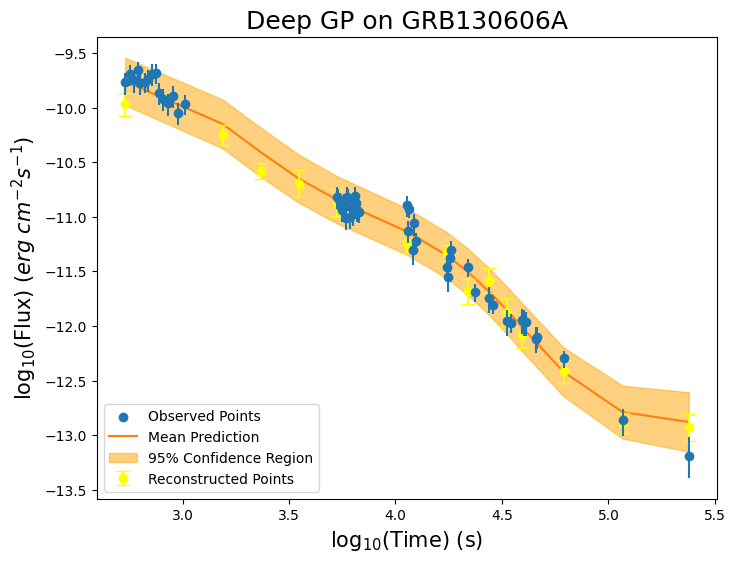


-----TRAINING FOR GRB130831A-----


-----ORIGINAL GRB-----



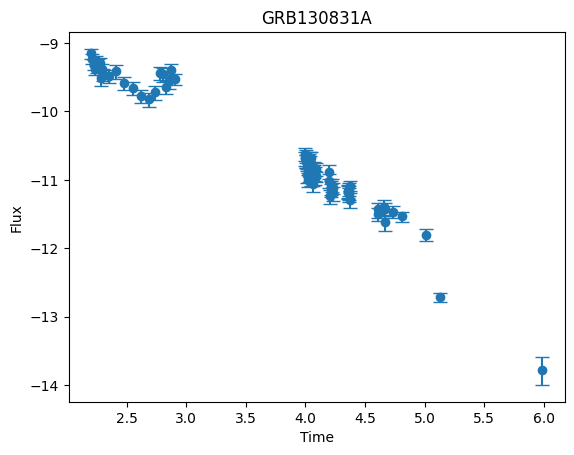


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.6809
Iteration 40/500 - Loss: 36.2670
Iteration 60/500 - Loss: 17.8992
Iteration 80/500 - Loss: 9.0628
Iteration 100/500 - Loss: 4.8734
Iteration 120/500 - Loss: 2.9656
Iteration 140/500 - Loss: 1.9991
Iteration 160/500 - Loss: 1.3715
Iteration 180/500 - Loss: 0.9232
Iteration 200/500 - Loss: 0.6009
Iteration 220/500 - Loss: 0.4525
Iteration 240/500 - Loss: 0.3364
Iteration 260/500 - Loss: 0.2329
Iteration 280/500 - Loss: 0.1411
Iteration 300/500 - Loss: 0.0600
Iteration 320/500 - Loss: -0.0109
Iteration 340/500 - Loss: -0.0728
Iteration 360/500 - Loss: -0.1262
Iteration 380/500 - Loss: -0.1720
Iteration 400/500 - Loss: -0.2115
Iteration 420/500 - Loss: -0.2299
Iteration 440/500 - Loss: -0.2458
Iteration 460/500 - Loss: -0.2608
Iteration 480/500 - Loss: -0.2747
Iteration 500/500 - Loss: -0.2876

-----RECONSTRUCTED GRB-----



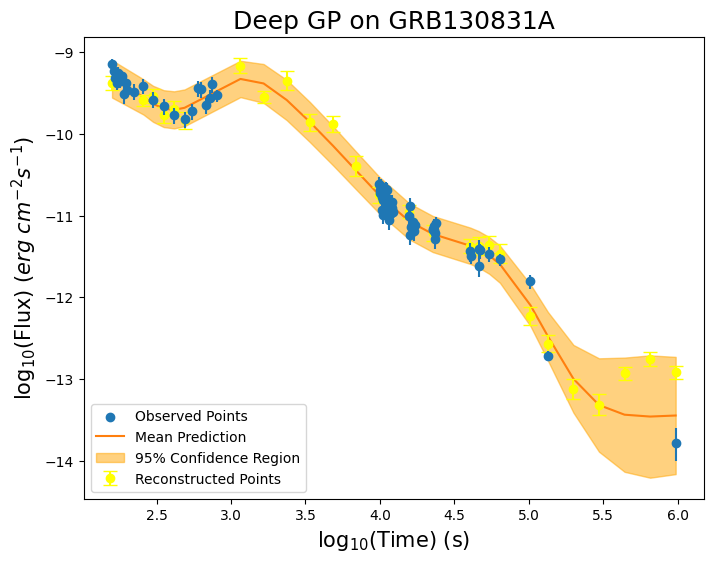


-----TRAINING FOR GRB130925A-----


-----ORIGINAL GRB-----



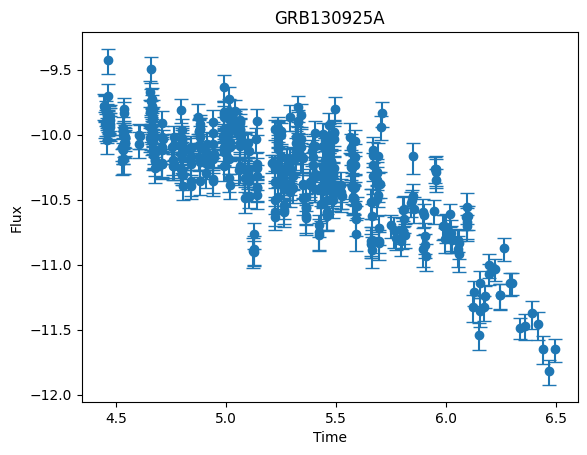


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 64.2935
Iteration 40/500 - Loss: 44.8314
Iteration 60/500 - Loss: 34.7443
Iteration 80/500 - Loss: 27.1200
Iteration 100/500 - Loss: 21.3971
Iteration 120/500 - Loss: 17.6634
Iteration 140/500 - Loss: 15.0661
Iteration 160/500 - Loss: 13.0216
Iteration 180/500 - Loss: 11.8032
Iteration 200/500 - Loss: 11.0399
Iteration 220/500 - Loss: 10.7347
Iteration 240/500 - Loss: 10.4807
Iteration 260/500 - Loss: 10.2502
Iteration 280/500 - Loss: 10.0383
Iteration 300/500 - Loss: 9.8417
Iteration 320/500 - Loss: 9.6581
Iteration 340/500 - Loss: 9.4855
Iteration 360/500 - Loss: 9.3226
Iteration 380/500 - Loss: 9.1679
Iteration 400/500 - Loss: 9.0203
Iteration 420/500 - Loss: 8.9452
Iteration 440/500 - Loss: 8.8745
Iteration 460/500 - Loss: 8.8044
Iteration 480/500 - Loss: 8.7348
Iteration 500/500 - Loss: 8.6658

-----RECONSTRUCTED GRB-----



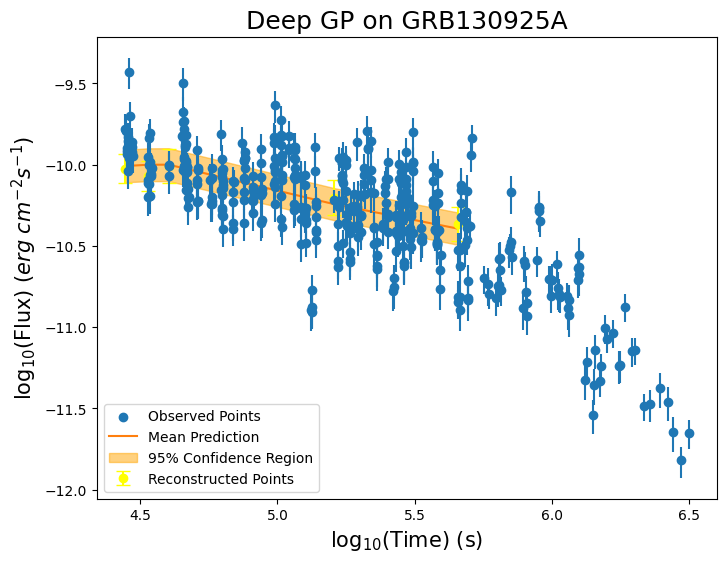


-----TRAINING FOR GRB131004A-----


-----ORIGINAL GRB-----



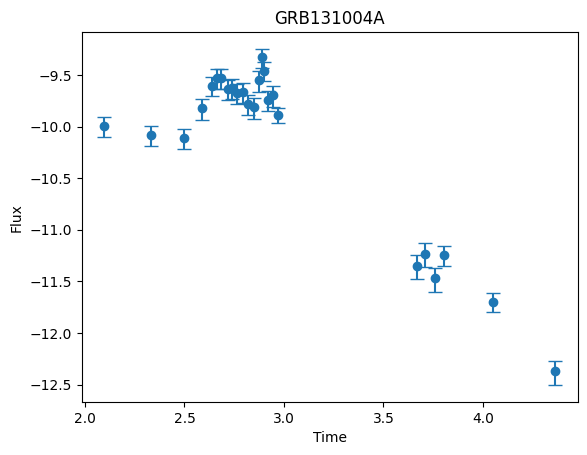


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.0621
Iteration 40/500 - Loss: 32.9793
Iteration 60/500 - Loss: 14.2105
Iteration 80/500 - Loss: 4.6680
Iteration 100/500 - Loss: 2.8967
Iteration 120/500 - Loss: 2.3347
Iteration 140/500 - Loss: 1.7692
Iteration 160/500 - Loss: 1.3409
Iteration 180/500 - Loss: 1.0046
Iteration 200/500 - Loss: 0.7576
Iteration 220/500 - Loss: 0.6626
Iteration 240/500 - Loss: 0.5902
Iteration 260/500 - Loss: 0.5319
Iteration 280/500 - Loss: 0.4855
Iteration 300/500 - Loss: 0.4486
Iteration 320/500 - Loss: 0.4188
Iteration 340/500 - Loss: 0.3943
Iteration 360/500 - Loss: 0.3738
Iteration 380/500 - Loss: 0.3563
Iteration 400/500 - Loss: 0.3411
Iteration 420/500 - Loss: 0.3340
Iteration 440/500 - Loss: 0.3275
Iteration 460/500 - Loss: 0.3213
Iteration 480/500 - Loss: 0.3154
Iteration 500/500 - Loss: 0.3097

-----RECONSTRUCTED GRB-----



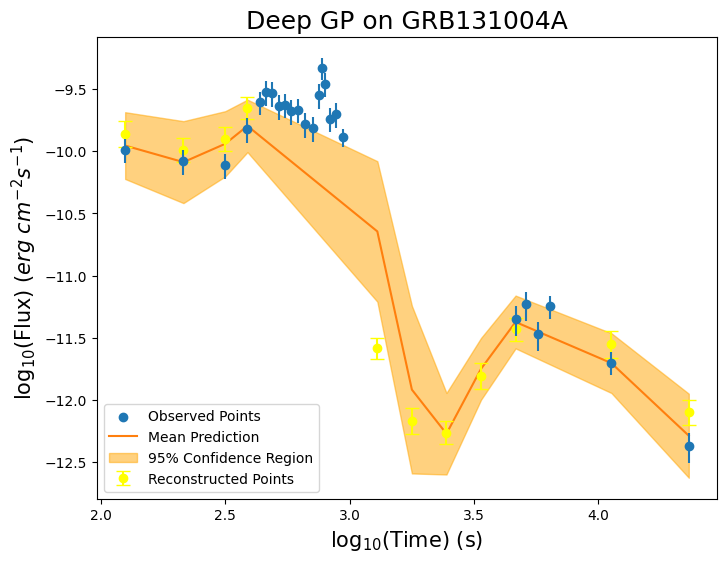


-----TRAINING FOR GRB131105A-----


-----ORIGINAL GRB-----



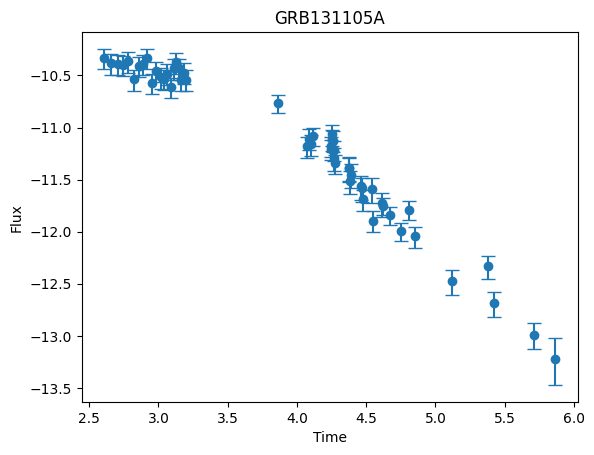


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.0894
Iteration 40/500 - Loss: 39.0660
Iteration 60/500 - Loss: 22.6781
Iteration 80/500 - Loss: 8.8456
Iteration 100/500 - Loss: 3.5402
Iteration 120/500 - Loss: 1.5383
Iteration 140/500 - Loss: 0.7582
Iteration 160/500 - Loss: 0.4021
Iteration 180/500 - Loss: 0.1973
Iteration 200/500 - Loss: 0.0592
Iteration 220/500 - Loss: 0.0048
Iteration 240/500 - Loss: -0.0387
Iteration 260/500 - Loss: -0.0760
Iteration 280/500 - Loss: -0.1079
Iteration 300/500 - Loss: -0.1349
Iteration 320/500 - Loss: -0.1576
Iteration 340/500 - Loss: -0.1766
Iteration 360/500 - Loss: -0.1925
Iteration 380/500 - Loss: -0.2061
Iteration 400/500 - Loss: -0.2177
Iteration 420/500 - Loss: -0.2233
Iteration 440/500 - Loss: -0.2283
Iteration 460/500 - Loss: -0.2331
Iteration 480/500 - Loss: -0.2377
Iteration 500/500 - Loss: -0.2421

-----RECONSTRUCTED GRB-----



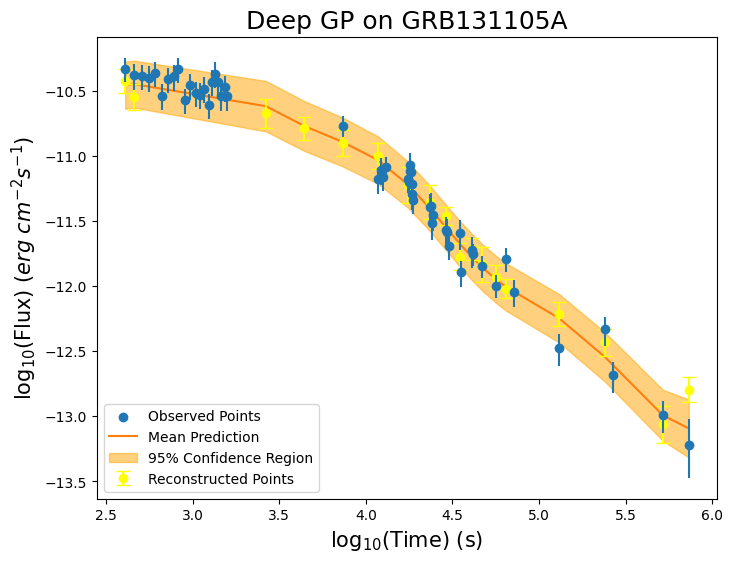


-----TRAINING FOR GRB131117A-----


-----ORIGINAL GRB-----



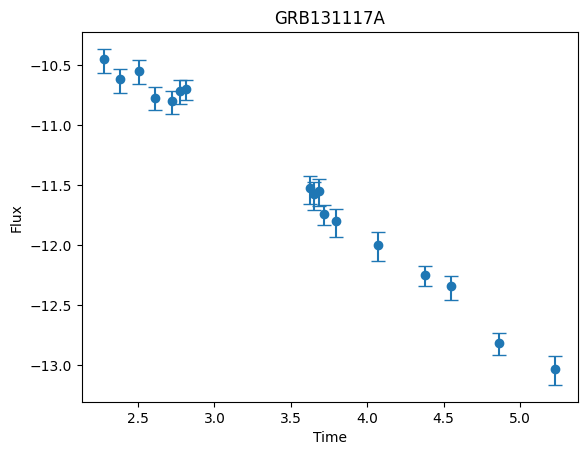


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 54.0821
Iteration 40/500 - Loss: 38.6841
Iteration 60/500 - Loss: 26.5674
Iteration 80/500 - Loss: 14.9454
Iteration 100/500 - Loss: 6.5345
Iteration 120/500 - Loss: 3.2221
Iteration 140/500 - Loss: 1.6632
Iteration 160/500 - Loss: 0.8319
Iteration 180/500 - Loss: 0.4007
Iteration 200/500 - Loss: 0.1699
Iteration 220/500 - Loss: 0.0932
Iteration 240/500 - Loss: 0.0365
Iteration 260/500 - Loss: -0.0103
Iteration 280/500 - Loss: -0.0488
Iteration 300/500 - Loss: -0.0821
Iteration 320/500 - Loss: -0.1114
Iteration 340/500 - Loss: -0.1363
Iteration 360/500 - Loss: -0.1580
Iteration 380/500 - Loss: -0.1764
Iteration 400/500 - Loss: -0.1939
Iteration 420/500 - Loss: -0.2020
Iteration 440/500 - Loss: -0.2093
Iteration 460/500 - Loss: -0.2163
Iteration 480/500 - Loss: -0.2230
Iteration 500/500 - Loss: -0.2294

-----RECONSTRUCTED GRB-----



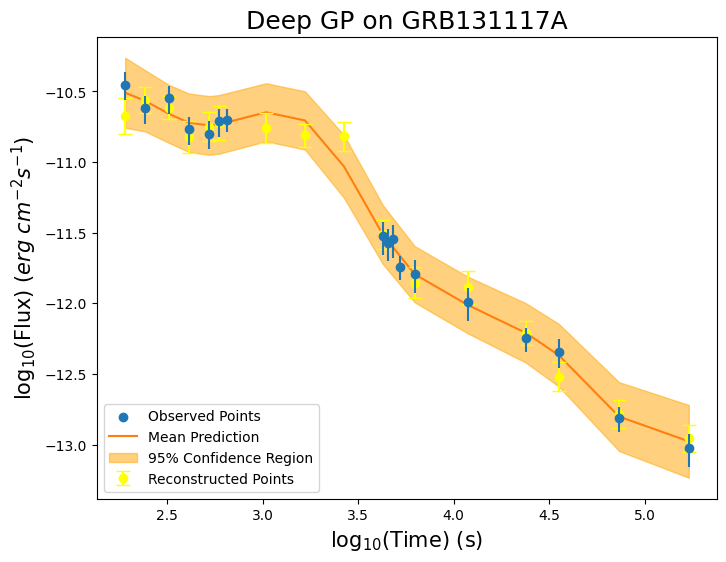


-----TRAINING FOR GRB140206A-----


-----ORIGINAL GRB-----



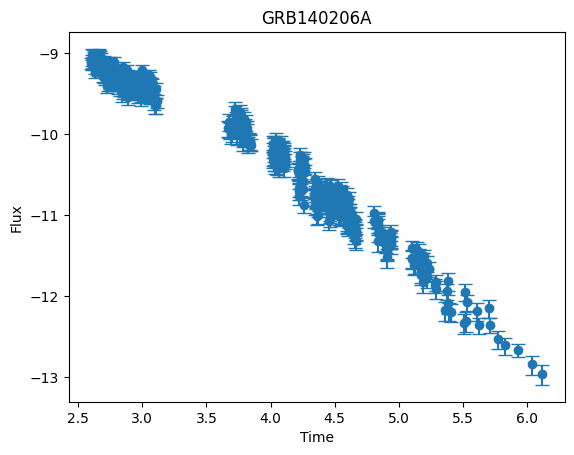


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 58.8701
Iteration 40/500 - Loss: 41.6812
Iteration 60/500 - Loss: 31.3391
Iteration 80/500 - Loss: 19.6549
Iteration 100/500 - Loss: 9.6140
Iteration 120/500 - Loss: 4.2929
Iteration 140/500 - Loss: 1.8867
Iteration 160/500 - Loss: 0.9349
Iteration 180/500 - Loss: 0.6153
Iteration 200/500 - Loss: 0.3217
Iteration 220/500 - Loss: 0.2111
Iteration 240/500 - Loss: 0.1271
Iteration 260/500 - Loss: 0.0538
Iteration 280/500 - Loss: -0.0095
Iteration 300/500 - Loss: -0.0636
Iteration 320/500 - Loss: -0.1095
Iteration 340/500 - Loss: -0.1479
Iteration 360/500 - Loss: -0.1800
Iteration 380/500 - Loss: -0.2068
Iteration 400/500 - Loss: -0.2292
Iteration 420/500 - Loss: -0.2393
Iteration 440/500 - Loss: -0.2482
Iteration 460/500 - Loss: -0.2565
Iteration 480/500 - Loss: -0.2643
Iteration 500/500 - Loss: -0.2715

-----RECONSTRUCTED GRB-----



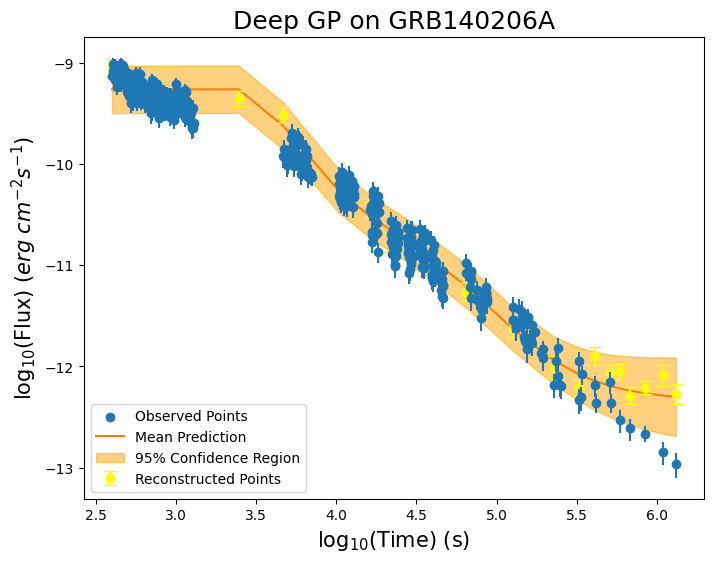


-----TRAINING FOR GRB140419A-----


-----ORIGINAL GRB-----



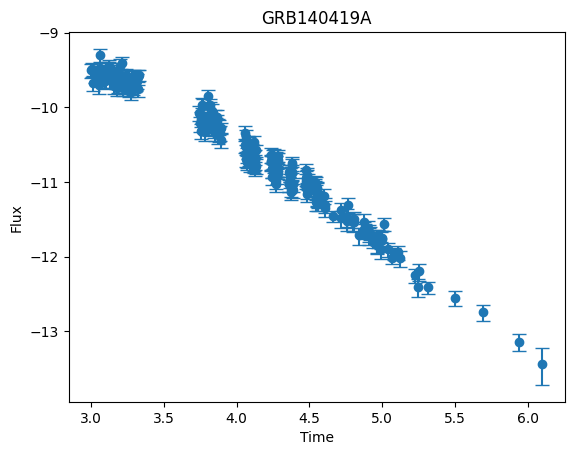


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 61.6342
Iteration 40/500 - Loss: 42.8682
Iteration 60/500 - Loss: 27.9563
Iteration 80/500 - Loss: 15.4739
Iteration 100/500 - Loss: 8.1796
Iteration 120/500 - Loss: 4.1426
Iteration 140/500 - Loss: 2.0876
Iteration 160/500 - Loss: 1.1504
Iteration 180/500 - Loss: 0.7405
Iteration 200/500 - Loss: 0.5224
Iteration 220/500 - Loss: 0.4281
Iteration 240/500 - Loss: 0.3511
Iteration 260/500 - Loss: 0.2807
Iteration 280/500 - Loss: 0.2171
Iteration 300/500 - Loss: 0.1618
Iteration 320/500 - Loss: 0.1030
Iteration 340/500 - Loss: 0.0523
Iteration 360/500 - Loss: 0.0048
Iteration 380/500 - Loss: -0.0394
Iteration 400/500 - Loss: -0.0800
Iteration 420/500 - Loss: -0.1011
Iteration 440/500 - Loss: -0.1200
Iteration 460/500 - Loss: -0.1390
Iteration 480/500 - Loss: -0.1574
Iteration 500/500 - Loss: -0.1754

-----RECONSTRUCTED GRB-----



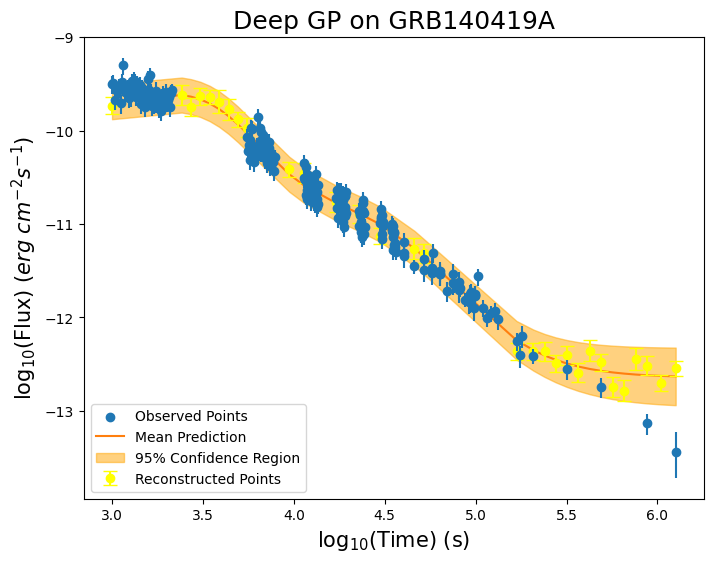


-----TRAINING FOR GRB140423A-----


-----ORIGINAL GRB-----



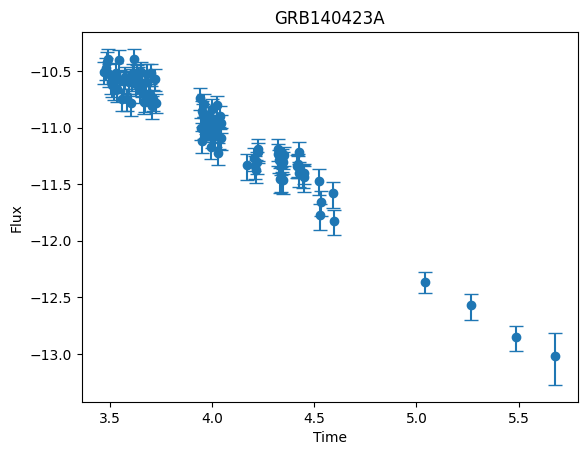


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.4234
Iteration 40/500 - Loss: 38.5035
Iteration 60/500 - Loss: 27.5784
Iteration 80/500 - Loss: 16.9214
Iteration 100/500 - Loss: 10.4281
Iteration 120/500 - Loss: 6.7900
Iteration 140/500 - Loss: 6.9862
Iteration 160/500 - Loss: 3.2051
Iteration 180/500 - Loss: 2.1308
Iteration 200/500 - Loss: 1.5951
Iteration 220/500 - Loss: 1.4307
Iteration 240/500 - Loss: 1.3184
Iteration 260/500 - Loss: 1.2322
Iteration 280/500 - Loss: 1.1652
Iteration 300/500 - Loss: 1.1123
Iteration 320/500 - Loss: 1.0697
Iteration 340/500 - Loss: 1.0347
Iteration 360/500 - Loss: 1.0053
Iteration 380/500 - Loss: 0.9800
Iteration 400/500 - Loss: 0.9577
Iteration 420/500 - Loss: 0.9469
Iteration 440/500 - Loss: 0.9371
Iteration 460/500 - Loss: 0.9276
Iteration 480/500 - Loss: 0.9183
Iteration 500/500 - Loss: 0.9093

-----RECONSTRUCTED GRB-----



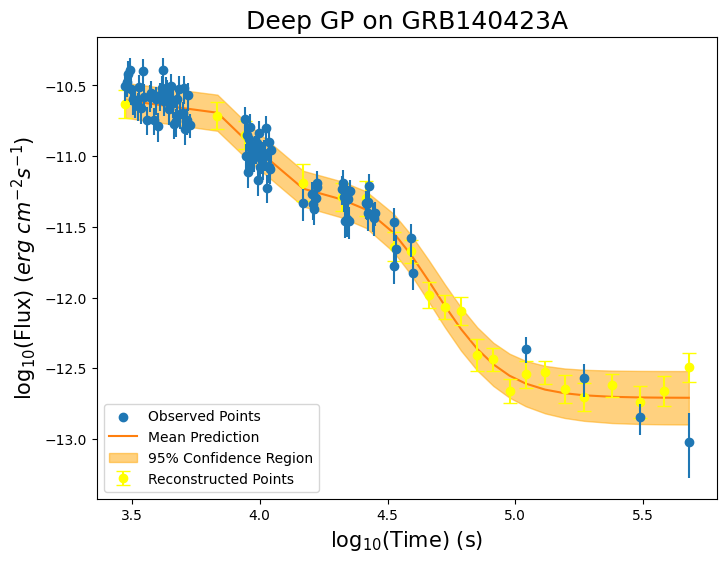


-----TRAINING FOR GRB140430A-----


-----ORIGINAL GRB-----



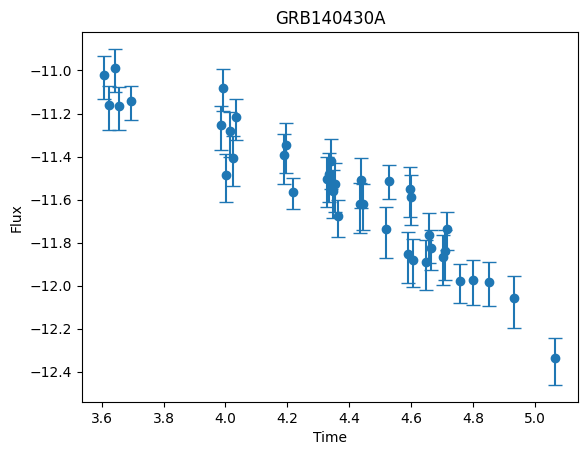


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.6550
Iteration 40/500 - Loss: 29.6459
Iteration 60/500 - Loss: 13.5984
Iteration 80/500 - Loss: 7.7933
Iteration 100/500 - Loss: 5.5161
Iteration 120/500 - Loss: 4.4159
Iteration 140/500 - Loss: 3.8158
Iteration 160/500 - Loss: 3.4393
Iteration 180/500 - Loss: 3.1740
Iteration 200/500 - Loss: 2.9728
Iteration 220/500 - Loss: 2.8869
Iteration 240/500 - Loss: 2.8161
Iteration 260/500 - Loss: 2.7541
Iteration 280/500 - Loss: 2.7000
Iteration 300/500 - Loss: 2.6533
Iteration 320/500 - Loss: 2.6122
Iteration 340/500 - Loss: 2.5759
Iteration 360/500 - Loss: 2.5437
Iteration 380/500 - Loss: 2.5146
Iteration 400/500 - Loss: 2.4882
Iteration 420/500 - Loss: 2.4752
Iteration 440/500 - Loss: 2.4631
Iteration 460/500 - Loss: 2.4511
Iteration 480/500 - Loss: 2.4394
Iteration 500/500 - Loss: 2.4278

-----RECONSTRUCTED GRB-----



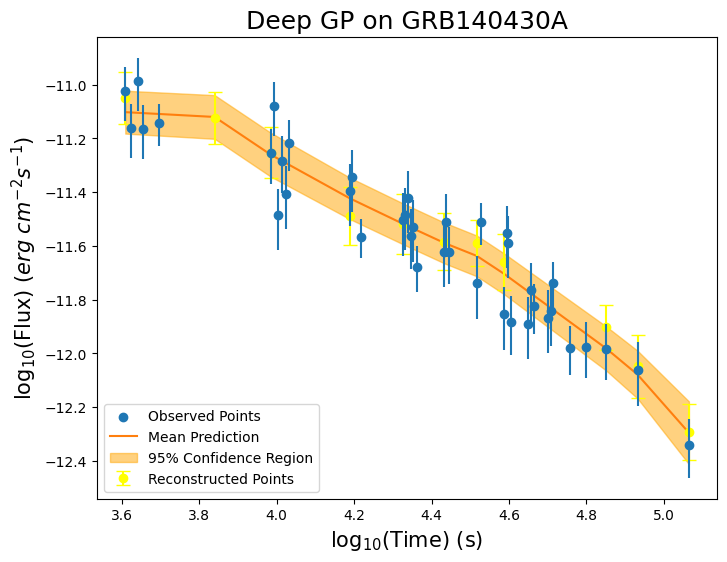


-----TRAINING FOR GRB140506A-----


-----ORIGINAL GRB-----



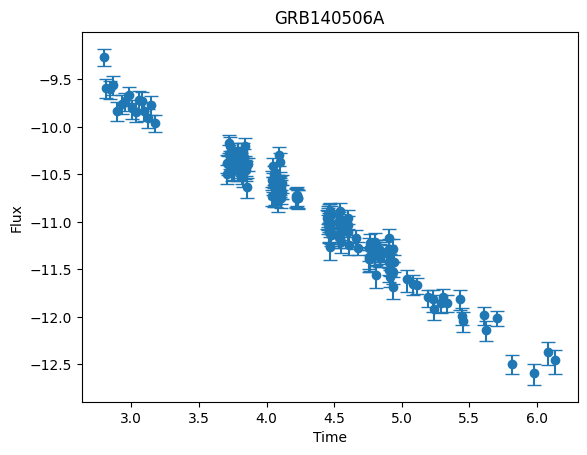


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 54.9658
Iteration 40/500 - Loss: 35.7239
Iteration 60/500 - Loss: 19.6267
Iteration 80/500 - Loss: 10.3734
Iteration 100/500 - Loss: 5.5308
Iteration 120/500 - Loss: 3.0948
Iteration 140/500 - Loss: 1.9447
Iteration 160/500 - Loss: 1.2864
Iteration 180/500 - Loss: 0.8178
Iteration 200/500 - Loss: 0.4754
Iteration 220/500 - Loss: 0.3764
Iteration 240/500 - Loss: 0.3116
Iteration 260/500 - Loss: 0.2599
Iteration 280/500 - Loss: 0.2166
Iteration 300/500 - Loss: 0.1796
Iteration 320/500 - Loss: 0.1478
Iteration 340/500 - Loss: 0.1204
Iteration 360/500 - Loss: 0.0970
Iteration 380/500 - Loss: 0.0770
Iteration 400/500 - Loss: 0.0600
Iteration 420/500 - Loss: 0.0520
Iteration 440/500 - Loss: 0.0450
Iteration 460/500 - Loss: 0.0385
Iteration 480/500 - Loss: 0.0324
Iteration 500/500 - Loss: 0.0268

-----RECONSTRUCTED GRB-----



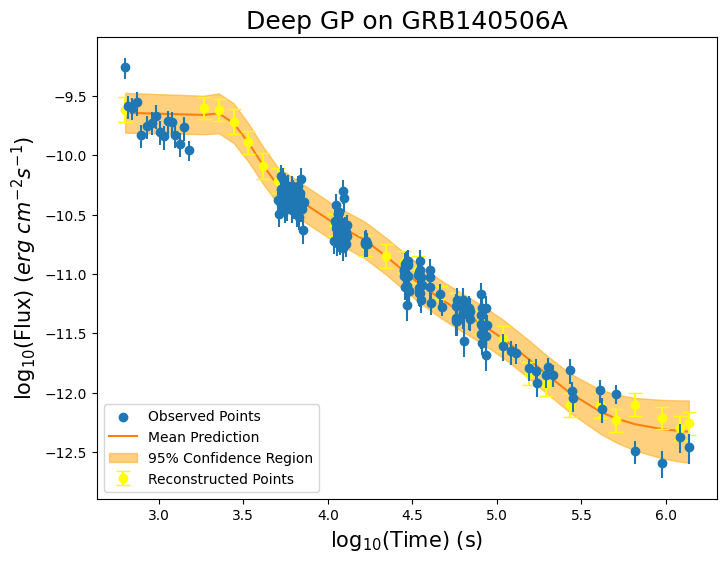


-----TRAINING FOR GRB140512A-----


-----ORIGINAL GRB-----



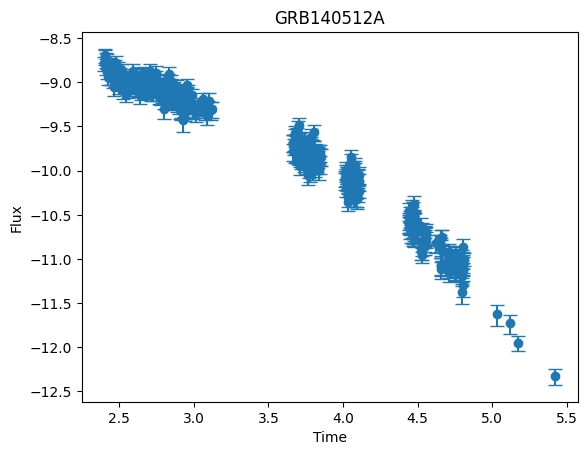


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 59.0923
Iteration 40/500 - Loss: 41.5235
Iteration 60/500 - Loss: 29.7980
Iteration 80/500 - Loss: 17.0244
Iteration 100/500 - Loss: 7.7323
Iteration 120/500 - Loss: 3.2527
Iteration 140/500 - Loss: 1.3693
Iteration 160/500 - Loss: 0.7604
Iteration 180/500 - Loss: 0.5096
Iteration 200/500 - Loss: 0.3405
Iteration 220/500 - Loss: 0.2686
Iteration 240/500 - Loss: 0.2072
Iteration 260/500 - Loss: 0.1508
Iteration 280/500 - Loss: 0.0994
Iteration 300/500 - Loss: 0.0528
Iteration 320/500 - Loss: 0.0106
Iteration 340/500 - Loss: -0.0276
Iteration 360/500 - Loss: -0.0623
Iteration 380/500 - Loss: -0.0942
Iteration 400/500 - Loss: -0.1237
Iteration 420/500 - Loss: -0.1384
Iteration 440/500 - Loss: -0.1520
Iteration 460/500 - Loss: -0.1654
Iteration 480/500 - Loss: -0.1786
Iteration 500/500 - Loss: -0.1916

-----RECONSTRUCTED GRB-----



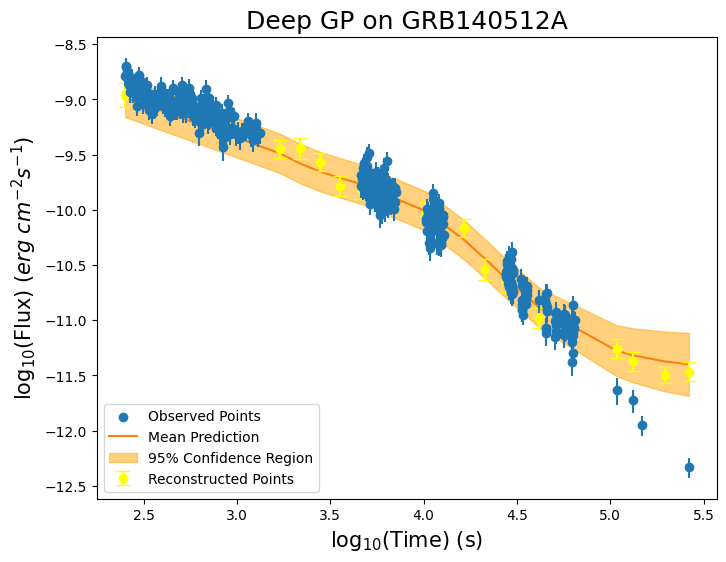


-----TRAINING FOR GRB140518A-----


-----ORIGINAL GRB-----



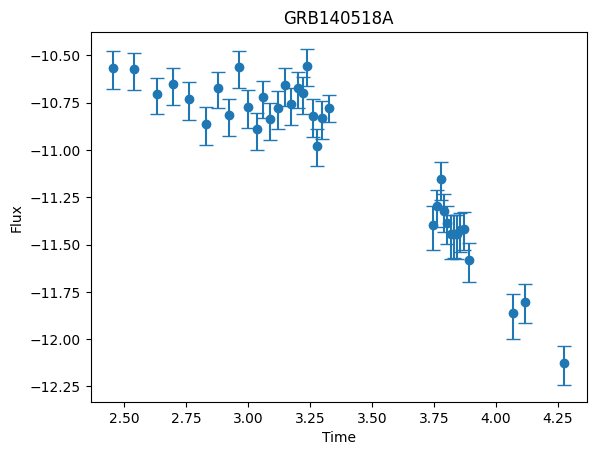


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 42.5822
Iteration 40/500 - Loss: 24.0990
Iteration 60/500 - Loss: 10.0263
Iteration 80/500 - Loss: 7.1493
Iteration 100/500 - Loss: 5.8710
Iteration 120/500 - Loss: 4.5562
Iteration 140/500 - Loss: 3.4324
Iteration 160/500 - Loss: 2.6312
Iteration 180/500 - Loss: 2.0601
Iteration 200/500 - Loss: 1.6843
Iteration 220/500 - Loss: 1.5466
Iteration 240/500 - Loss: 1.4416
Iteration 260/500 - Loss: 1.3548
Iteration 280/500 - Loss: 1.2824
Iteration 300/500 - Loss: 1.2212
Iteration 320/500 - Loss: 1.1684
Iteration 340/500 - Loss: 1.1215
Iteration 360/500 - Loss: 1.0795
Iteration 380/500 - Loss: 1.0414
Iteration 400/500 - Loss: 1.0066
Iteration 420/500 - Loss: 0.9895
Iteration 440/500 - Loss: 0.9737
Iteration 460/500 - Loss: 0.9584
Iteration 480/500 - Loss: 0.9434
Iteration 500/500 - Loss: 0.9288

-----RECONSTRUCTED GRB-----



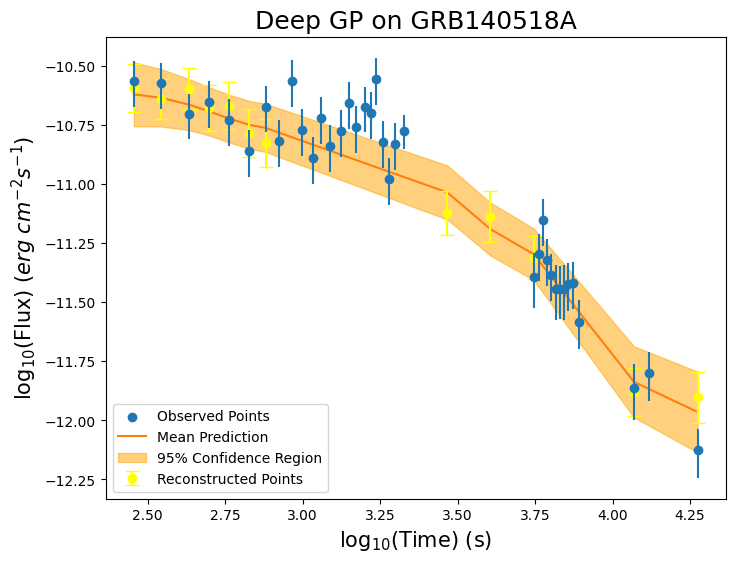


-----TRAINING FOR GRB140614A-----


-----ORIGINAL GRB-----



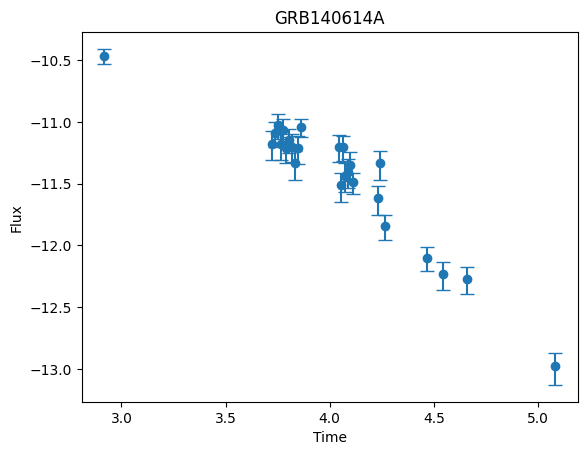


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.4275
Iteration 40/500 - Loss: 32.7278
Iteration 60/500 - Loss: 18.1682
Iteration 80/500 - Loss: 11.0922
Iteration 100/500 - Loss: 7.4538
Iteration 120/500 - Loss: 5.3747
Iteration 140/500 - Loss: 4.0937
Iteration 160/500 - Loss: 3.1287
Iteration 180/500 - Loss: 2.4250
Iteration 200/500 - Loss: 1.9416
Iteration 220/500 - Loss: 1.7603
Iteration 240/500 - Loss: 1.6244
Iteration 260/500 - Loss: 1.5160
Iteration 280/500 - Loss: 1.4301
Iteration 300/500 - Loss: 1.3622
Iteration 320/500 - Loss: 1.3087
Iteration 340/500 - Loss: 1.2662
Iteration 360/500 - Loss: 1.2318
Iteration 380/500 - Loss: 1.2033
Iteration 400/500 - Loss: 1.1794
Iteration 420/500 - Loss: 1.1682
Iteration 440/500 - Loss: 1.1583
Iteration 460/500 - Loss: 1.1489
Iteration 480/500 - Loss: 1.1401
Iteration 500/500 - Loss: 1.1317

-----RECONSTRUCTED GRB-----



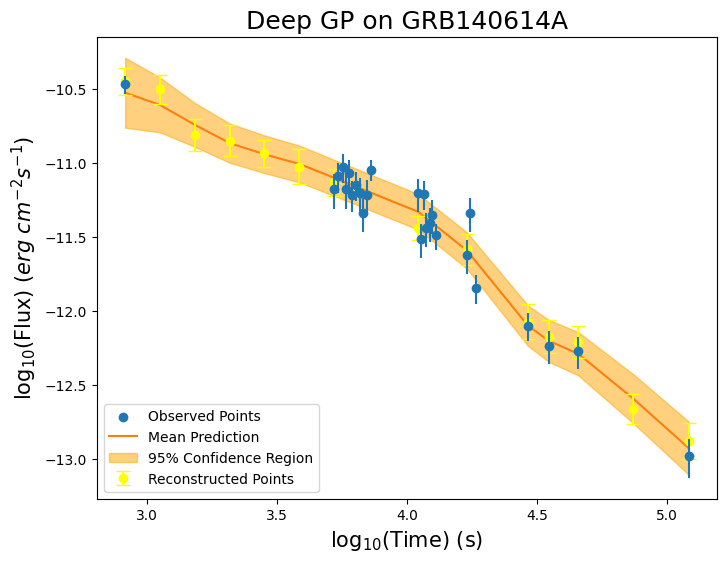


-----TRAINING FOR GRB140629A-----


-----ORIGINAL GRB-----



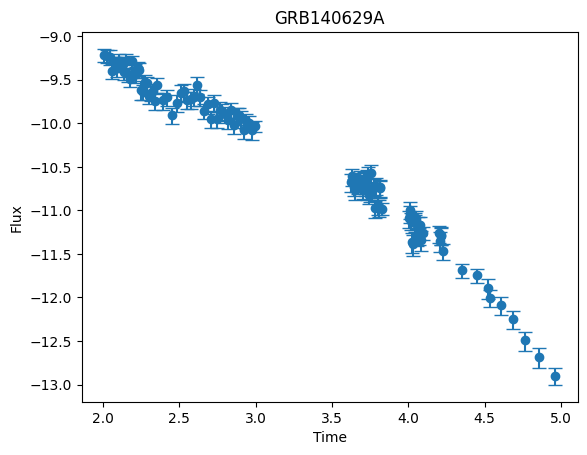


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.5211
Iteration 40/500 - Loss: 40.2672
Iteration 60/500 - Loss: 25.7393
Iteration 80/500 - Loss: 12.4977
Iteration 100/500 - Loss: 5.4138
Iteration 120/500 - Loss: 2.9707
Iteration 140/500 - Loss: 1.9520
Iteration 160/500 - Loss: 1.3994
Iteration 180/500 - Loss: 0.8029
Iteration 200/500 - Loss: 0.4920
Iteration 220/500 - Loss: 0.3185
Iteration 240/500 - Loss: 0.1985
Iteration 260/500 - Loss: 0.0870
Iteration 280/500 - Loss: -0.0165
Iteration 300/500 - Loss: -0.1090
Iteration 320/500 - Loss: -0.1864
Iteration 340/500 - Loss: -0.2472
Iteration 360/500 - Loss: -0.2928
Iteration 380/500 - Loss: -0.3225
Iteration 400/500 - Loss: -0.3535
Iteration 420/500 - Loss: -0.3656
Iteration 440/500 - Loss: -0.3764
Iteration 460/500 - Loss: -0.3865
Iteration 480/500 - Loss: -0.3961
Iteration 500/500 - Loss: -0.4054

-----RECONSTRUCTED GRB-----



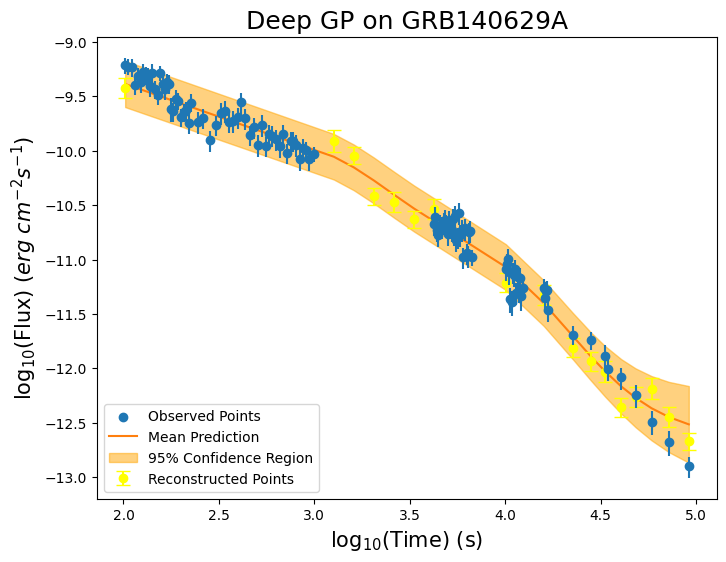


-----TRAINING FOR GRB140903A-----


-----ORIGINAL GRB-----



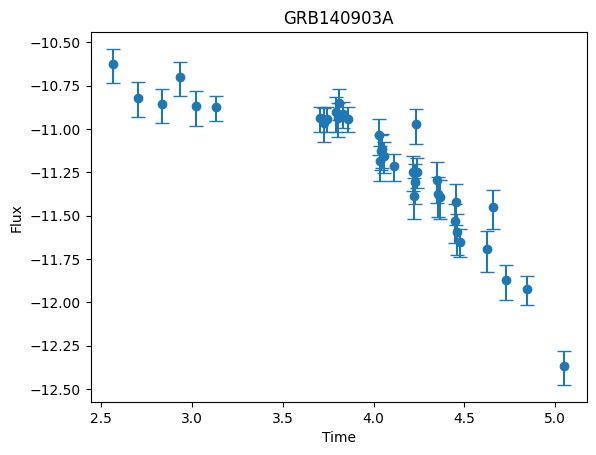


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.6815
Iteration 40/500 - Loss: 27.7351
Iteration 60/500 - Loss: 14.3462
Iteration 80/500 - Loss: 8.5889
Iteration 100/500 - Loss: 5.8391
Iteration 120/500 - Loss: 4.4078
Iteration 140/500 - Loss: 3.6036
Iteration 160/500 - Loss: 3.0667
Iteration 180/500 - Loss: 2.6781
Iteration 200/500 - Loss: 2.3855
Iteration 220/500 - Loss: 2.2622
Iteration 240/500 - Loss: 2.1589
Iteration 260/500 - Loss: 2.0666
Iteration 280/500 - Loss: 1.9839
Iteration 300/500 - Loss: 1.9101
Iteration 320/500 - Loss: 1.8456
Iteration 340/500 - Loss: 1.7888
Iteration 360/500 - Loss: 1.7399
Iteration 380/500 - Loss: 1.6965
Iteration 400/500 - Loss: 1.6558
Iteration 420/500 - Loss: 1.6337
Iteration 440/500 - Loss: 1.6115
Iteration 460/500 - Loss: 1.5874
Iteration 480/500 - Loss: 1.5615
Iteration 500/500 - Loss: 1.5344

-----RECONSTRUCTED GRB-----



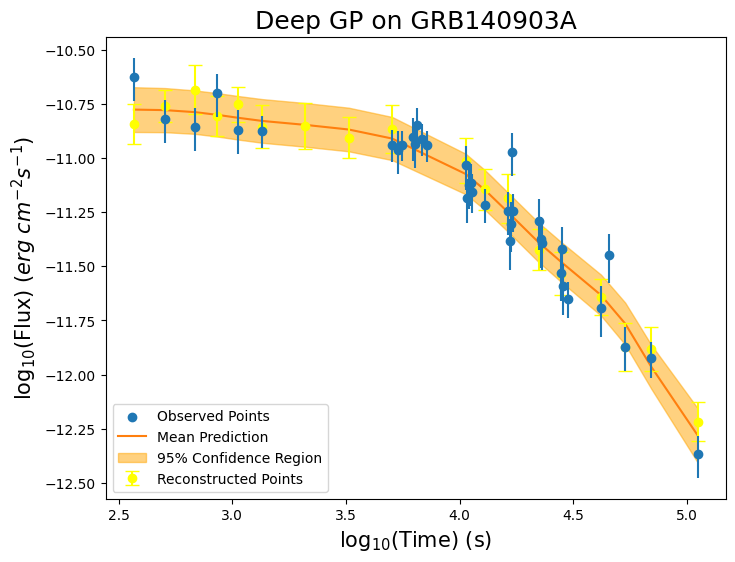


-----TRAINING FOR GRB141004A-----


-----ORIGINAL GRB-----



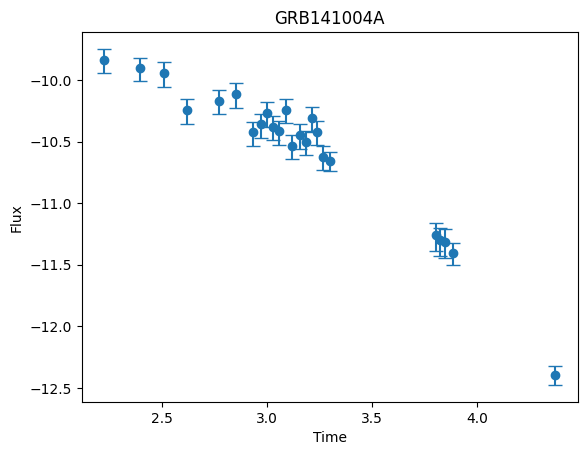


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.6464
Iteration 40/500 - Loss: 30.9160
Iteration 60/500 - Loss: 16.3536
Iteration 80/500 - Loss: 9.1584
Iteration 100/500 - Loss: 6.1287
Iteration 120/500 - Loss: 4.6730
Iteration 140/500 - Loss: 3.7124
Iteration 160/500 - Loss: 2.9184
Iteration 180/500 - Loss: 2.3238
Iteration 200/500 - Loss: 1.8537
Iteration 220/500 - Loss: 1.6564
Iteration 240/500 - Loss: 1.4939
Iteration 260/500 - Loss: 1.3525
Iteration 280/500 - Loss: 1.2320
Iteration 300/500 - Loss: 1.1255
Iteration 320/500 - Loss: 1.0327
Iteration 340/500 - Loss: 0.9501
Iteration 360/500 - Loss: 0.8774
Iteration 380/500 - Loss: 0.8087
Iteration 400/500 - Loss: 0.7473
Iteration 420/500 - Loss: 0.7172
Iteration 440/500 - Loss: 0.6897
Iteration 460/500 - Loss: 0.6632
Iteration 480/500 - Loss: 0.6382
Iteration 500/500 - Loss: 0.6138

-----RECONSTRUCTED GRB-----



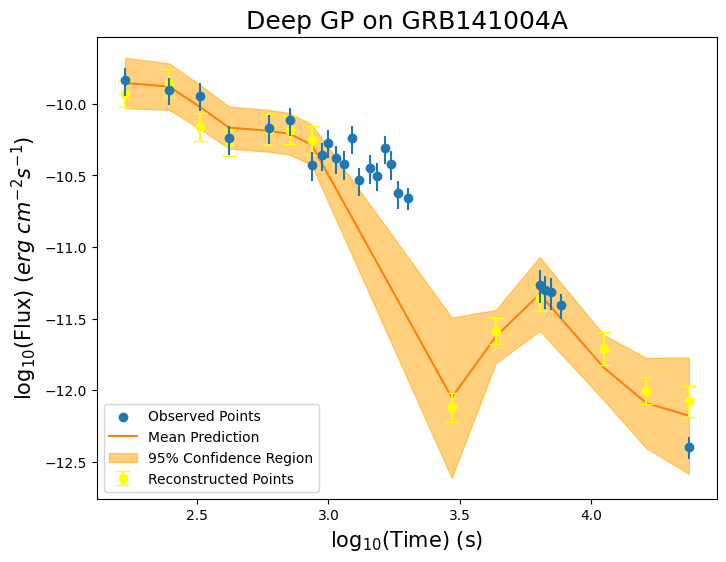


-----TRAINING FOR GRB141121A-----


-----ORIGINAL GRB-----



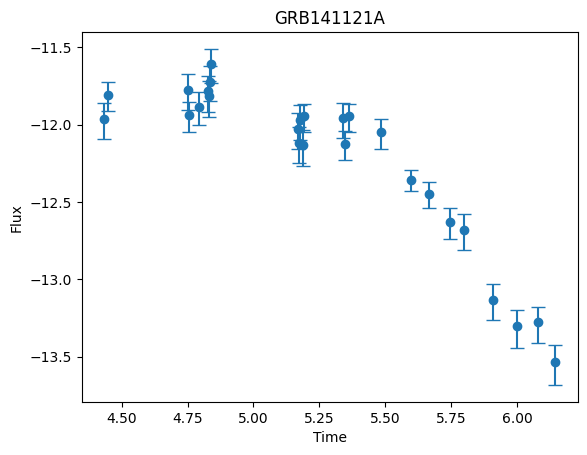


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.9134
Iteration 40/500 - Loss: 28.4955
Iteration 60/500 - Loss: 13.2794
Iteration 80/500 - Loss: 6.7268
Iteration 100/500 - Loss: 3.5734
Iteration 120/500 - Loss: 1.7649
Iteration 140/500 - Loss: 0.9249
Iteration 160/500 - Loss: 0.6068
Iteration 180/500 - Loss: 0.4743
Iteration 200/500 - Loss: 0.4112
Iteration 220/500 - Loss: 0.3885
Iteration 240/500 - Loss: 0.3713
Iteration 260/500 - Loss: 0.3557
Iteration 280/500 - Loss: 0.3415
Iteration 300/500 - Loss: 0.3283
Iteration 320/500 - Loss: 0.3162
Iteration 340/500 - Loss: 0.3047
Iteration 360/500 - Loss: 0.2933
Iteration 380/500 - Loss: 0.2824
Iteration 400/500 - Loss: 0.2736
Iteration 420/500 - Loss: 0.2697
Iteration 440/500 - Loss: 0.2661
Iteration 460/500 - Loss: 0.2626
Iteration 480/500 - Loss: 0.2592
Iteration 500/500 - Loss: 0.2559

-----RECONSTRUCTED GRB-----



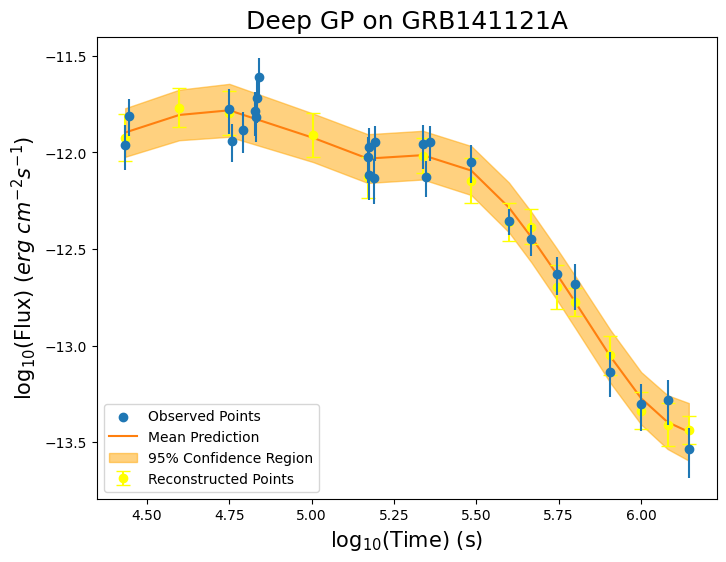


-----TRAINING FOR GRB150120B-----


-----ORIGINAL GRB-----



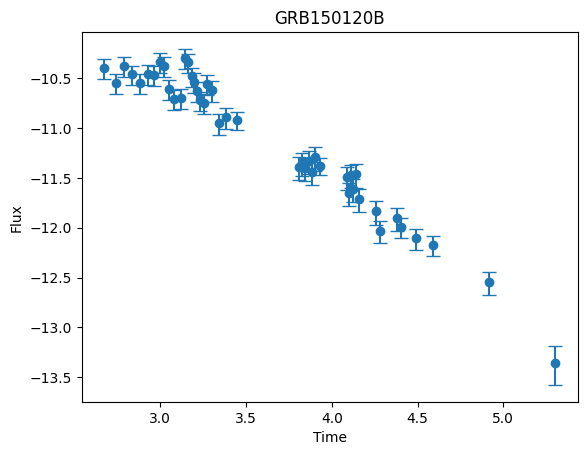


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 44.5624
Iteration 40/500 - Loss: 29.8132
Iteration 60/500 - Loss: 13.1349
Iteration 80/500 - Loss: 6.7714
Iteration 100/500 - Loss: 4.3642
Iteration 120/500 - Loss: 2.9939
Iteration 140/500 - Loss: 2.1435
Iteration 160/500 - Loss: 1.6032
Iteration 180/500 - Loss: 1.2477
Iteration 200/500 - Loss: 0.9957
Iteration 220/500 - Loss: 0.8924
Iteration 240/500 - Loss: 0.8055
Iteration 260/500 - Loss: 0.7280
Iteration 280/500 - Loss: 0.6575
Iteration 300/500 - Loss: 0.5918
Iteration 320/500 - Loss: 0.5312
Iteration 340/500 - Loss: 0.4758
Iteration 360/500 - Loss: 0.4254
Iteration 380/500 - Loss: 0.3822
Iteration 400/500 - Loss: 0.3419
Iteration 420/500 - Loss: 0.3222
Iteration 440/500 - Loss: 0.3043
Iteration 460/500 - Loss: 0.2867
Iteration 480/500 - Loss: 0.2695
Iteration 500/500 - Loss: 0.2524

-----RECONSTRUCTED GRB-----



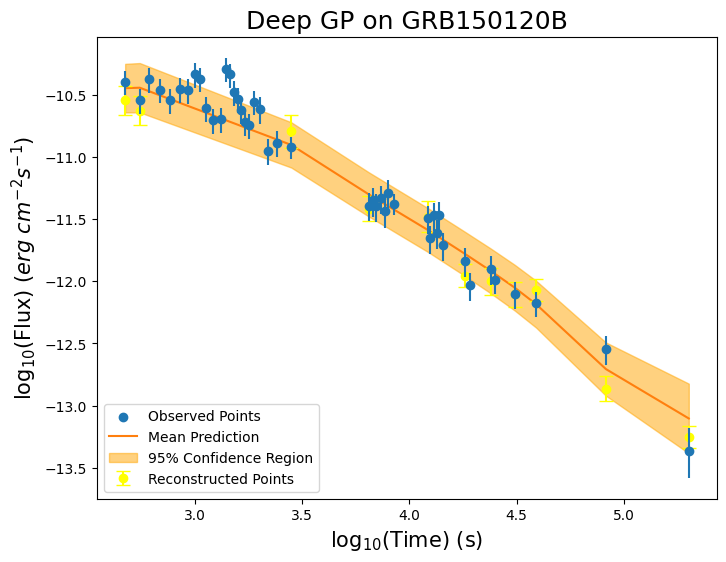


-----TRAINING FOR GRB150910A-----


-----ORIGINAL GRB-----



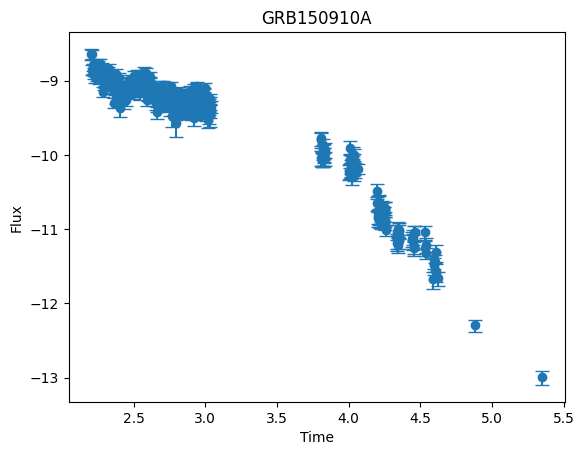


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.3981
Iteration 40/500 - Loss: 40.1849
Iteration 60/500 - Loss: 30.7006
Iteration 80/500 - Loss: 19.6542
Iteration 100/500 - Loss: 10.4503
Iteration 120/500 - Loss: 6.4226
Iteration 140/500 - Loss: 3.6386
Iteration 160/500 - Loss: 2.1344
Iteration 180/500 - Loss: 1.4130
Iteration 200/500 - Loss: 1.0121
Iteration 220/500 - Loss: 0.8653
Iteration 240/500 - Loss: 0.7490
Iteration 260/500 - Loss: 0.6485
Iteration 280/500 - Loss: 0.5616
Iteration 300/500 - Loss: 0.4866
Iteration 320/500 - Loss: 0.4218
Iteration 340/500 - Loss: 0.3657
Iteration 360/500 - Loss: 0.3168
Iteration 380/500 - Loss: 0.2737
Iteration 400/500 - Loss: 0.2355
Iteration 420/500 - Loss: 0.2170
Iteration 440/500 - Loss: 0.2001
Iteration 460/500 - Loss: 0.1839
Iteration 480/500 - Loss: 0.1681
Iteration 500/500 - Loss: 0.1528

-----RECONSTRUCTED GRB-----



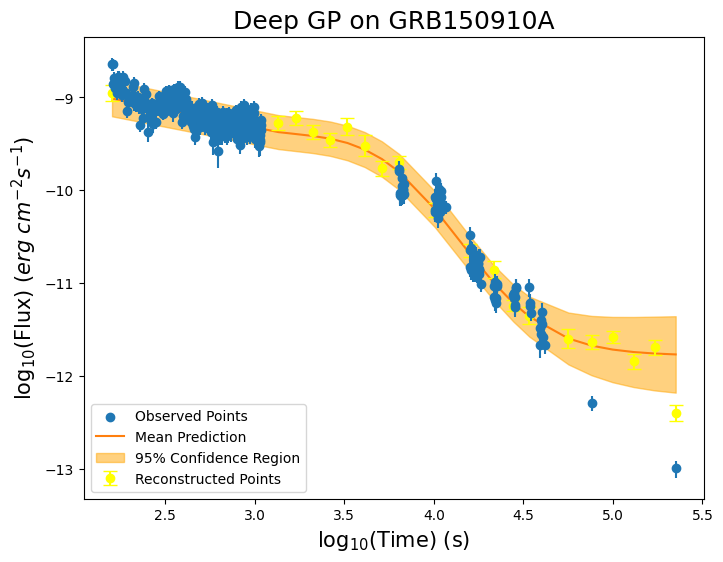


-----TRAINING FOR GRB151031A-----


-----ORIGINAL GRB-----



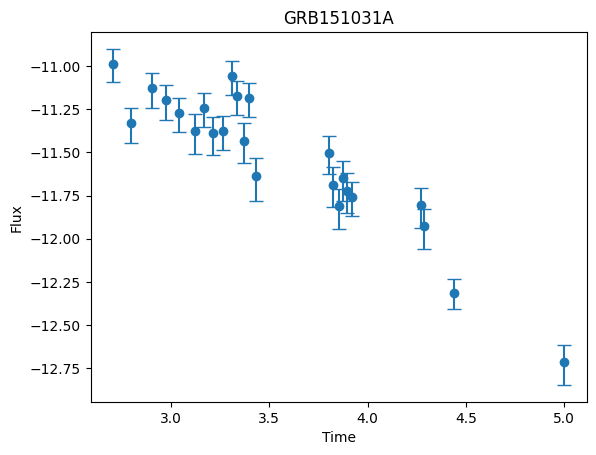


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.5451
Iteration 40/500 - Loss: 34.4563
Iteration 60/500 - Loss: 20.5964
Iteration 80/500 - Loss: 13.1177
Iteration 100/500 - Loss: 9.6010
Iteration 120/500 - Loss: 7.3133
Iteration 140/500 - Loss: 5.8490
Iteration 160/500 - Loss: 4.8840
Iteration 180/500 - Loss: 4.2352
Iteration 200/500 - Loss: 3.8061
Iteration 220/500 - Loss: 3.5982
Iteration 240/500 - Loss: 3.4436
Iteration 260/500 - Loss: 3.3095
Iteration 280/500 - Loss: 3.1907
Iteration 300/500 - Loss: 3.0850
Iteration 320/500 - Loss: 2.9891
Iteration 340/500 - Loss: 2.9006
Iteration 360/500 - Loss: 2.8169
Iteration 380/500 - Loss: 2.7366
Iteration 400/500 - Loss: 2.6585
Iteration 420/500 - Loss: 2.6164
Iteration 440/500 - Loss: 2.5739
Iteration 460/500 - Loss: 2.5276
Iteration 480/500 - Loss: 2.4755
Iteration 500/500 - Loss: 2.4148

-----RECONSTRUCTED GRB-----



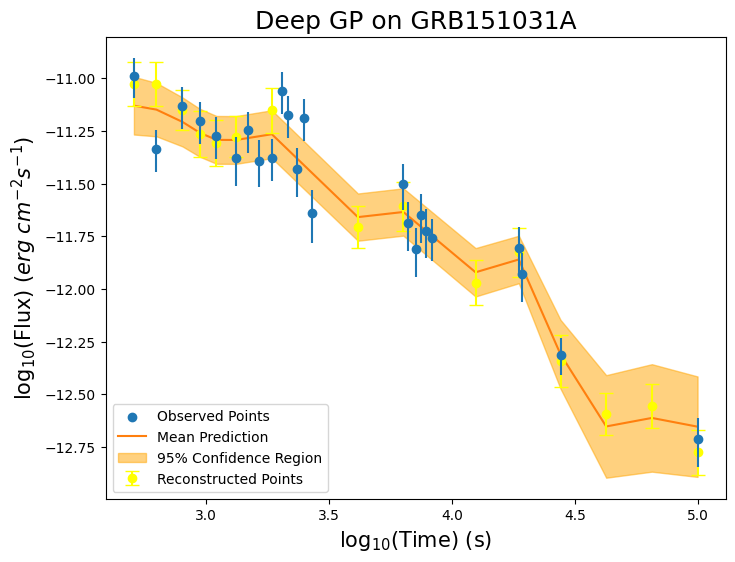


-----TRAINING FOR GRB151112A-----


-----ORIGINAL GRB-----



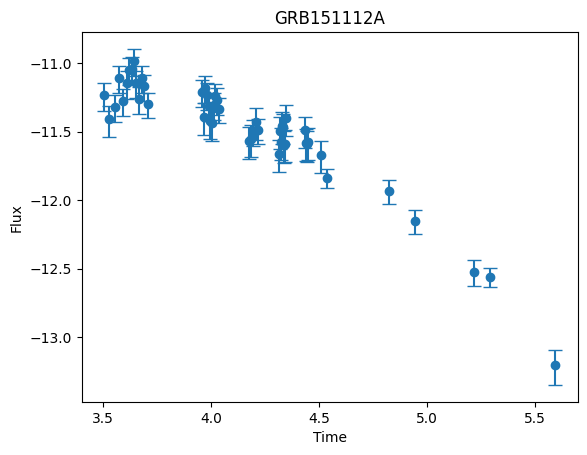


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.0132
Iteration 40/500 - Loss: 37.7454
Iteration 60/500 - Loss: 24.4294
Iteration 80/500 - Loss: 14.2595
Iteration 100/500 - Loss: 8.8379
Iteration 120/500 - Loss: 5.8578
Iteration 140/500 - Loss: 4.2154
Iteration 160/500 - Loss: 3.2494
Iteration 180/500 - Loss: 2.6808
Iteration 200/500 - Loss: 2.3080
Iteration 220/500 - Loss: 2.1553
Iteration 240/500 - Loss: 2.0274
Iteration 260/500 - Loss: 1.9107
Iteration 280/500 - Loss: 1.8031
Iteration 300/500 - Loss: 1.7029
Iteration 320/500 - Loss: 1.6093
Iteration 340/500 - Loss: 1.5206
Iteration 360/500 - Loss: 1.4363
Iteration 380/500 - Loss: 1.3551
Iteration 400/500 - Loss: 1.2769
Iteration 420/500 - Loss: 1.2359
Iteration 440/500 - Loss: 1.1976
Iteration 460/500 - Loss: 1.1594
Iteration 480/500 - Loss: 1.1218
Iteration 500/500 - Loss: 1.0853

-----RECONSTRUCTED GRB-----



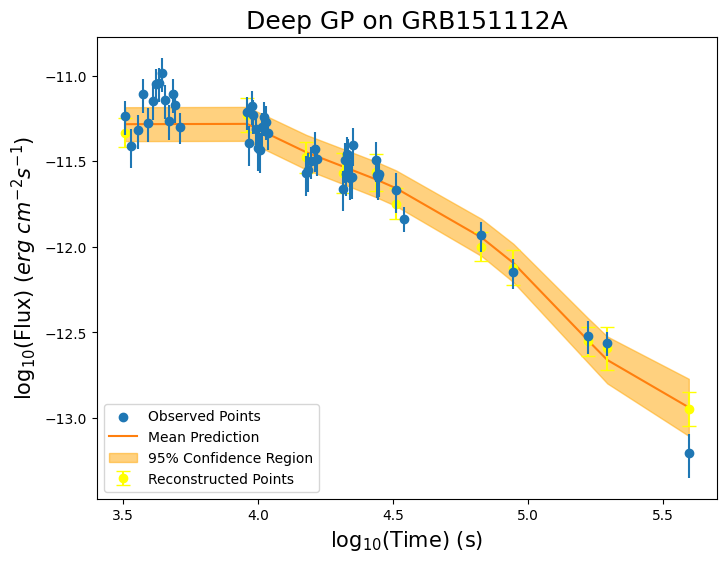


-----TRAINING FOR GRB151215A-----


-----ORIGINAL GRB-----



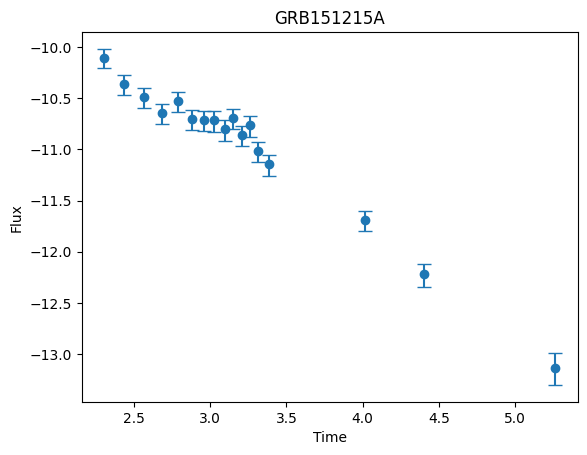


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.2676
Iteration 40/500 - Loss: 39.3322
Iteration 60/500 - Loss: 23.3774
Iteration 80/500 - Loss: 12.1091
Iteration 100/500 - Loss: 7.2573
Iteration 120/500 - Loss: 4.8444
Iteration 140/500 - Loss: 3.2388
Iteration 160/500 - Loss: 2.1915
Iteration 180/500 - Loss: 1.4913
Iteration 200/500 - Loss: 1.0316
Iteration 220/500 - Loss: 0.8608
Iteration 240/500 - Loss: 0.7287
Iteration 260/500 - Loss: 0.6170
Iteration 280/500 - Loss: 0.5208
Iteration 300/500 - Loss: 0.4366
Iteration 320/500 - Loss: 0.3629
Iteration 340/500 - Loss: 0.2988
Iteration 360/500 - Loss: 0.2418
Iteration 380/500 - Loss: 0.1918
Iteration 400/500 - Loss: 0.1486
Iteration 420/500 - Loss: 0.1287
Iteration 440/500 - Loss: 0.1116
Iteration 460/500 - Loss: 0.0961
Iteration 480/500 - Loss: 0.0823
Iteration 500/500 - Loss: 0.0699

-----RECONSTRUCTED GRB-----



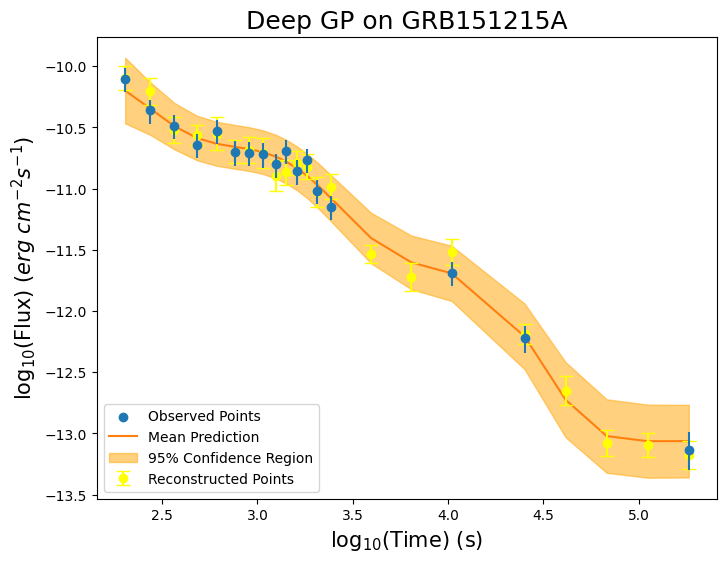


-----TRAINING FOR GRB160117B-----


-----ORIGINAL GRB-----



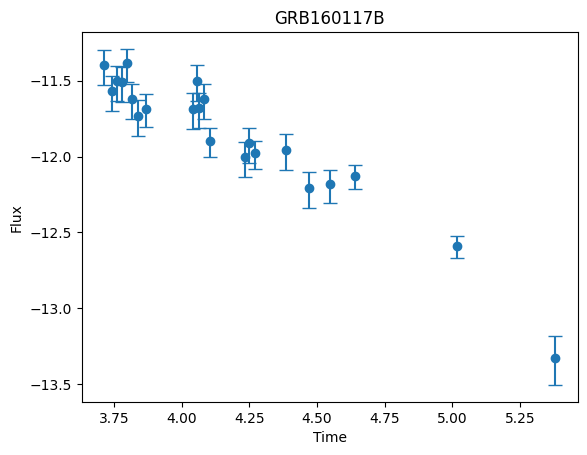


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.7939
Iteration 40/500 - Loss: 36.4824
Iteration 60/500 - Loss: 21.0587
Iteration 80/500 - Loss: 13.0680
Iteration 100/500 - Loss: 8.6814
Iteration 120/500 - Loss: 5.8391
Iteration 140/500 - Loss: 3.9354
Iteration 160/500 - Loss: 2.6538
Iteration 180/500 - Loss: 1.9458
Iteration 200/500 - Loss: 1.6292
Iteration 220/500 - Loss: 1.5487
Iteration 240/500 - Loss: 1.4974
Iteration 260/500 - Loss: 1.4583
Iteration 280/500 - Loss: 1.4267
Iteration 300/500 - Loss: 1.3999
Iteration 320/500 - Loss: 1.3763
Iteration 340/500 - Loss: 1.3547
Iteration 360/500 - Loss: 1.3346
Iteration 380/500 - Loss: 1.3156
Iteration 400/500 - Loss: 1.2974
Iteration 420/500 - Loss: 1.2881
Iteration 440/500 - Loss: 1.2793
Iteration 460/500 - Loss: 1.2706
Iteration 480/500 - Loss: 1.2619
Iteration 500/500 - Loss: 1.2534

-----RECONSTRUCTED GRB-----



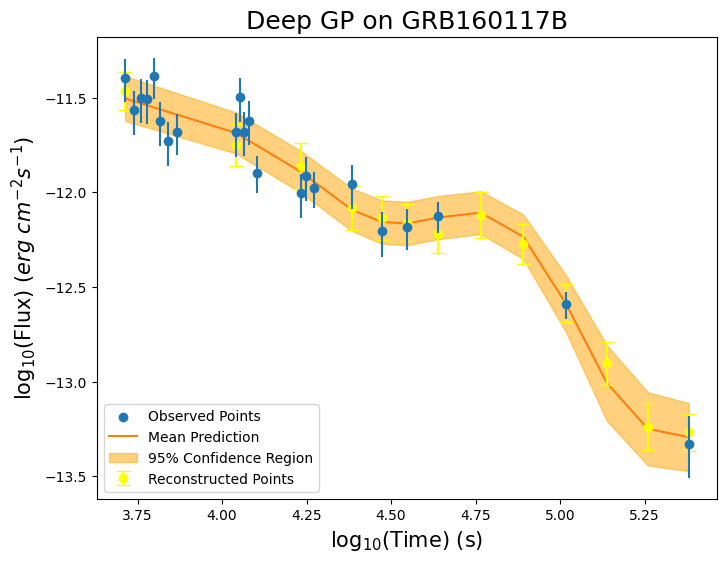


-----TRAINING FOR GRB160121A-----


-----ORIGINAL GRB-----



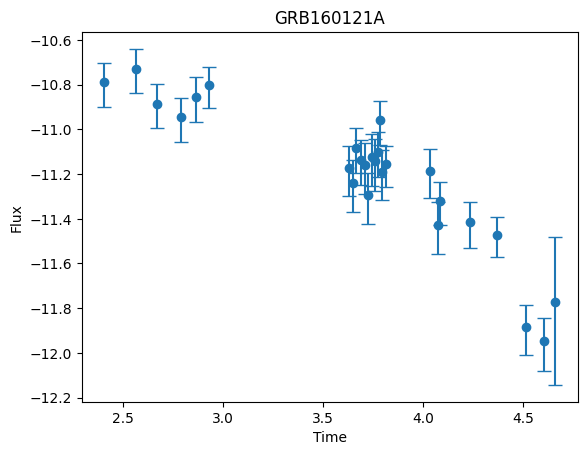


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 58.3072
Iteration 40/500 - Loss: 32.7103
Iteration 60/500 - Loss: 16.9469
Iteration 80/500 - Loss: 9.2354
Iteration 100/500 - Loss: 5.3417
Iteration 120/500 - Loss: 3.7550
Iteration 140/500 - Loss: 3.0322
Iteration 160/500 - Loss: 2.4853
Iteration 180/500 - Loss: 2.0831
Iteration 200/500 - Loss: 1.8584
Iteration 220/500 - Loss: 1.7785
Iteration 240/500 - Loss: 1.7134
Iteration 260/500 - Loss: 1.6535
Iteration 280/500 - Loss: 1.5964
Iteration 300/500 - Loss: 1.5409
Iteration 320/500 - Loss: 1.4868
Iteration 340/500 - Loss: 1.4344
Iteration 360/500 - Loss: 1.3808
Iteration 380/500 - Loss: 1.3135
Iteration 400/500 - Loss: 1.2161
Iteration 420/500 - Loss: 1.1576
Iteration 440/500 - Loss: 1.1042
Iteration 460/500 - Loss: 1.0574
Iteration 480/500 - Loss: 1.0206
Iteration 500/500 - Loss: 0.9920

-----RECONSTRUCTED GRB-----



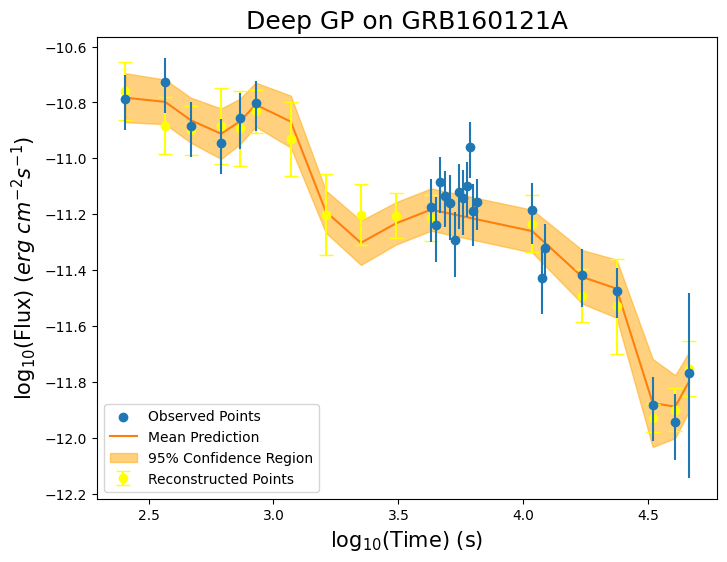


-----TRAINING FOR GRB160227A-----


-----ORIGINAL GRB-----



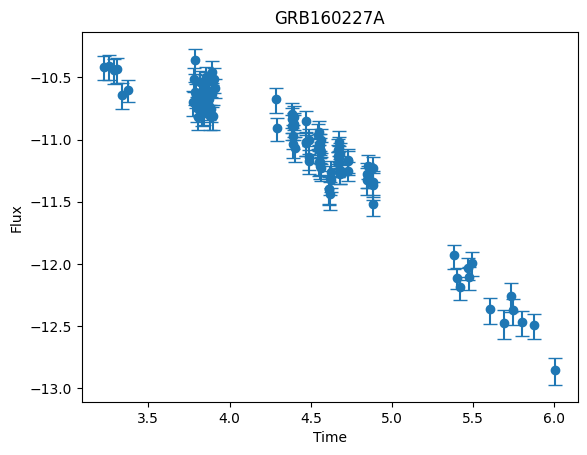


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.4960
Iteration 40/500 - Loss: 35.7766
Iteration 60/500 - Loss: 21.0379
Iteration 80/500 - Loss: 11.2090
Iteration 100/500 - Loss: 5.6319
Iteration 120/500 - Loss: 3.2105
Iteration 140/500 - Loss: 2.1145
Iteration 160/500 - Loss: 1.5331
Iteration 180/500 - Loss: 1.2005
Iteration 200/500 - Loss: 1.0008
Iteration 220/500 - Loss: 0.9317
Iteration 240/500 - Loss: 0.8800
Iteration 260/500 - Loss: 0.8379
Iteration 280/500 - Loss: 0.8032
Iteration 300/500 - Loss: 0.7745
Iteration 320/500 - Loss: 0.7506
Iteration 340/500 - Loss: 0.7305
Iteration 360/500 - Loss: 0.7133
Iteration 380/500 - Loss: 0.6986
Iteration 400/500 - Loss: 0.6858
Iteration 420/500 - Loss: 0.6796
Iteration 440/500 - Loss: 0.6741
Iteration 460/500 - Loss: 0.6688
Iteration 480/500 - Loss: 0.6637
Iteration 500/500 - Loss: 0.6588

-----RECONSTRUCTED GRB-----



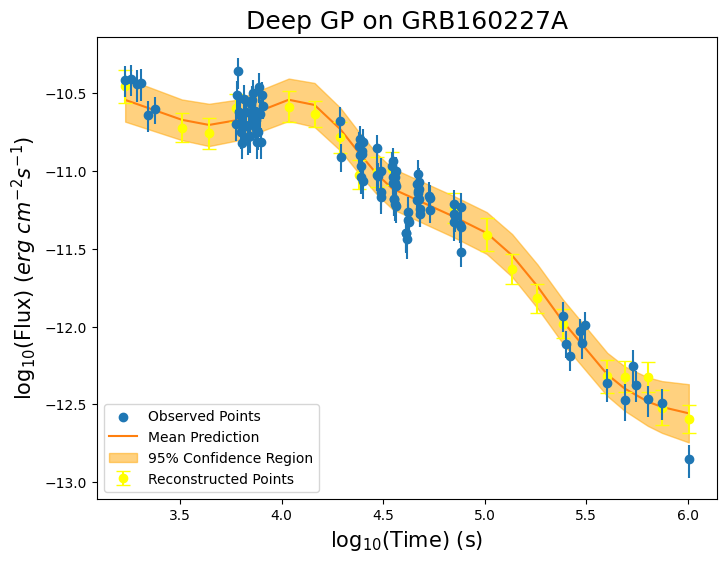


-----TRAINING FOR GRB160327A-----


-----ORIGINAL GRB-----



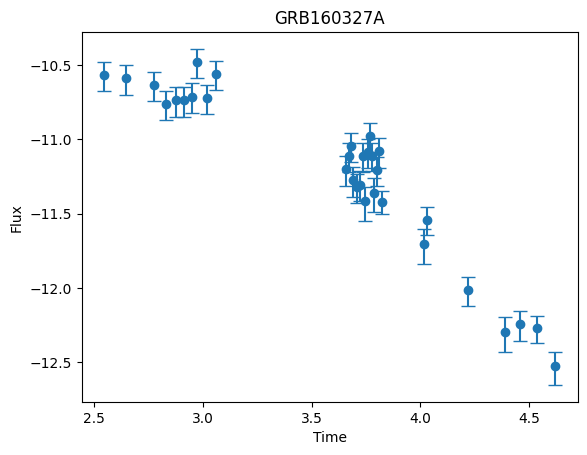


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.9493
Iteration 40/500 - Loss: 35.6990
Iteration 60/500 - Loss: 21.5969
Iteration 80/500 - Loss: 12.4244
Iteration 100/500 - Loss: 7.1629
Iteration 120/500 - Loss: 4.2564
Iteration 140/500 - Loss: 2.8351
Iteration 160/500 - Loss: 2.1626
Iteration 180/500 - Loss: 1.8019
Iteration 200/500 - Loss: 1.5753
Iteration 220/500 - Loss: 1.4851
Iteration 240/500 - Loss: 1.4092
Iteration 260/500 - Loss: 1.3393
Iteration 280/500 - Loss: 1.2743
Iteration 300/500 - Loss: 1.2147
Iteration 320/500 - Loss: 1.1616
Iteration 340/500 - Loss: 1.1151
Iteration 360/500 - Loss: 1.0743
Iteration 380/500 - Loss: 1.0379
Iteration 400/500 - Loss: 1.0053
Iteration 420/500 - Loss: 0.9895
Iteration 440/500 - Loss: 0.9751
Iteration 460/500 - Loss: 0.9613
Iteration 480/500 - Loss: 0.9479
Iteration 500/500 - Loss: 0.9350

-----RECONSTRUCTED GRB-----



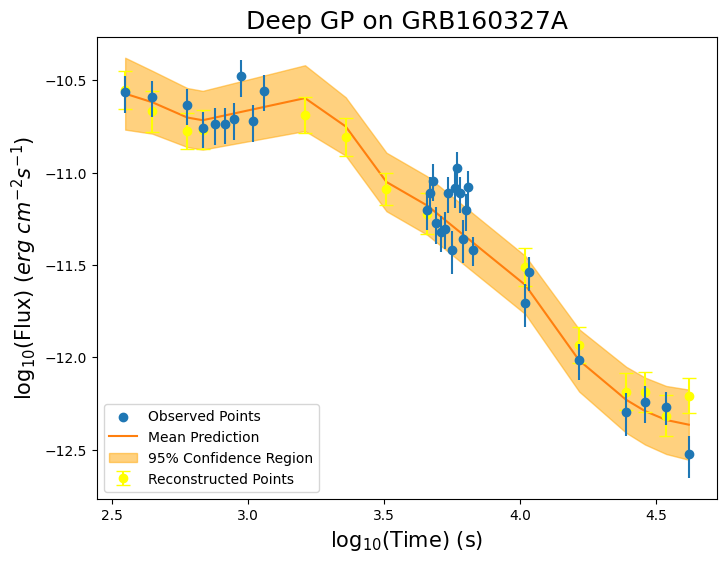


-----TRAINING FOR GRB160804A-----


-----ORIGINAL GRB-----



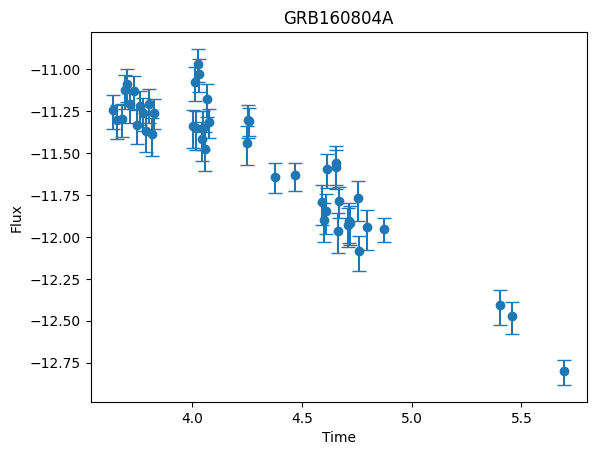


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.0160
Iteration 40/500 - Loss: 33.3594
Iteration 60/500 - Loss: 17.2481
Iteration 80/500 - Loss: 10.7770
Iteration 100/500 - Loss: 7.3319
Iteration 120/500 - Loss: 5.2528
Iteration 140/500 - Loss: 4.0927
Iteration 160/500 - Loss: 3.5099
Iteration 180/500 - Loss: 3.2257
Iteration 200/500 - Loss: 3.0650
Iteration 220/500 - Loss: 2.9986
Iteration 240/500 - Loss: 2.9375
Iteration 260/500 - Loss: 2.8764
Iteration 280/500 - Loss: 2.8152
Iteration 300/500 - Loss: 2.7553
Iteration 320/500 - Loss: 2.6983
Iteration 340/500 - Loss: 2.6448
Iteration 360/500 - Loss: 2.5952
Iteration 380/500 - Loss: 2.5492
Iteration 400/500 - Loss: 2.5068
Iteration 420/500 - Loss: 2.4859
Iteration 440/500 - Loss: 2.4667
Iteration 460/500 - Loss: 2.4480
Iteration 480/500 - Loss: 2.4299
Iteration 500/500 - Loss: 2.4122

-----RECONSTRUCTED GRB-----



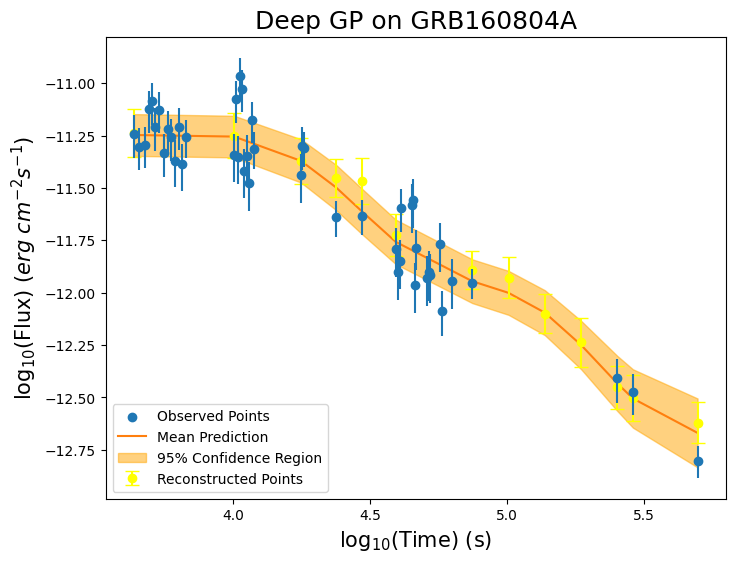


-----TRAINING FOR GRB161108A-----


-----ORIGINAL GRB-----



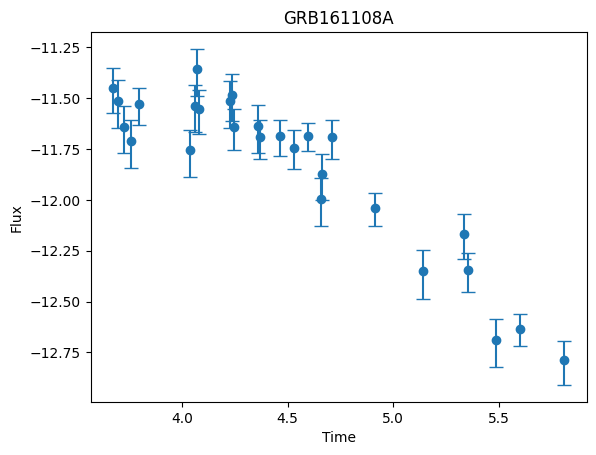


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.4498
Iteration 40/500 - Loss: 29.7654
Iteration 60/500 - Loss: 13.6780
Iteration 80/500 - Loss: 7.6166
Iteration 100/500 - Loss: 5.3885
Iteration 120/500 - Loss: 4.2165
Iteration 140/500 - Loss: 3.4585
Iteration 160/500 - Loss: 2.9753
Iteration 180/500 - Loss: 2.6594
Iteration 200/500 - Loss: 2.4480
Iteration 220/500 - Loss: 2.3663
Iteration 240/500 - Loss: 2.3014
Iteration 260/500 - Loss: 2.2461
Iteration 280/500 - Loss: 2.1985
Iteration 300/500 - Loss: 2.1575
Iteration 320/500 - Loss: 2.1218
Iteration 340/500 - Loss: 2.0905
Iteration 360/500 - Loss: 2.0624
Iteration 380/500 - Loss: 2.0368
Iteration 400/500 - Loss: 2.0129
Iteration 420/500 - Loss: 2.0006
Iteration 440/500 - Loss: 1.9888
Iteration 460/500 - Loss: 1.9766
Iteration 480/500 - Loss: 1.9639
Iteration 500/500 - Loss: 1.9503

-----RECONSTRUCTED GRB-----



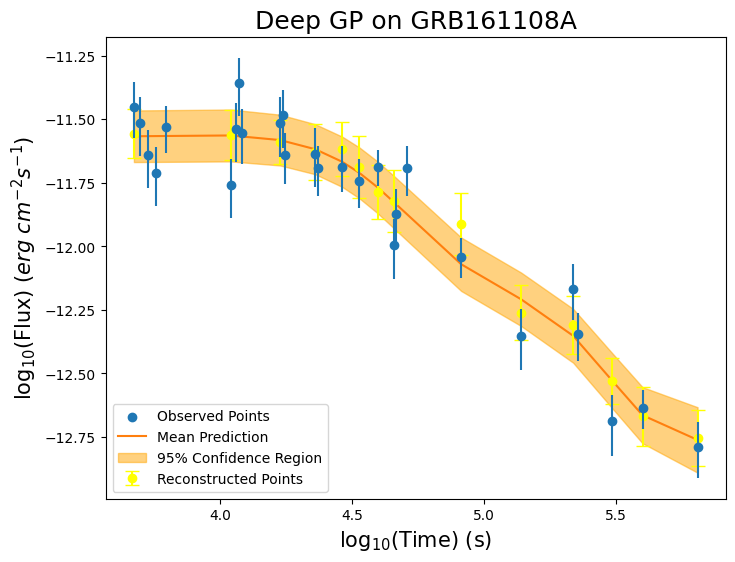


-----TRAINING FOR GRB161117A-----


-----ORIGINAL GRB-----



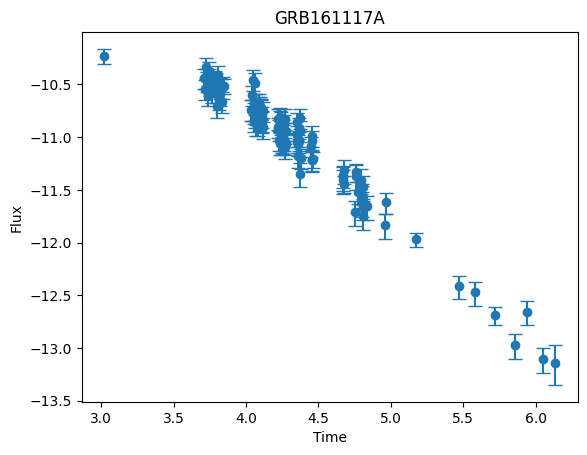


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.2914
Iteration 40/500 - Loss: 39.4369
Iteration 60/500 - Loss: 29.8198
Iteration 80/500 - Loss: 18.6140
Iteration 100/500 - Loss: 9.9060
Iteration 120/500 - Loss: 4.8087
Iteration 140/500 - Loss: 2.6292
Iteration 160/500 - Loss: 1.6837
Iteration 180/500 - Loss: 1.2681
Iteration 200/500 - Loss: 1.0237
Iteration 220/500 - Loss: 0.9275
Iteration 240/500 - Loss: 0.8462
Iteration 260/500 - Loss: 0.7702
Iteration 280/500 - Loss: 0.6975
Iteration 300/500 - Loss: 0.6270
Iteration 320/500 - Loss: 0.5603
Iteration 340/500 - Loss: 0.4944
Iteration 360/500 - Loss: 0.4333
Iteration 380/500 - Loss: 0.3791
Iteration 400/500 - Loss: 0.3273
Iteration 420/500 - Loss: 0.3031
Iteration 440/500 - Loss: 0.2815
Iteration 460/500 - Loss: 0.2613
Iteration 480/500 - Loss: 0.2428
Iteration 500/500 - Loss: 0.2260

-----RECONSTRUCTED GRB-----



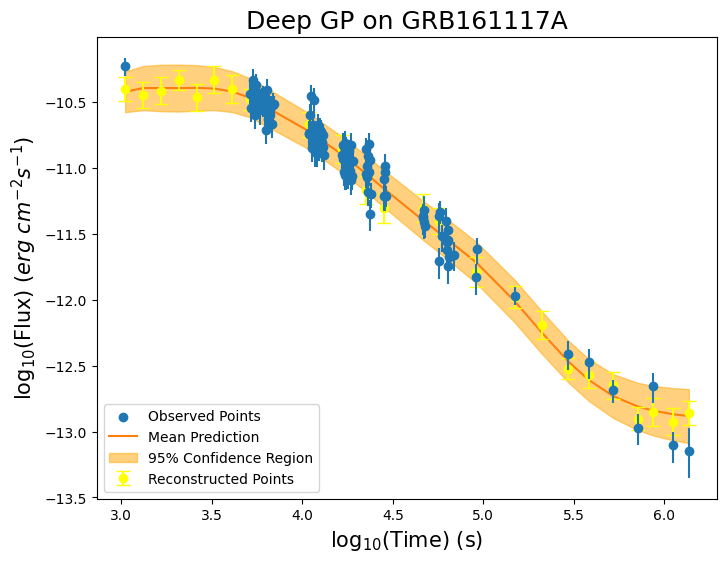


-----TRAINING FOR GRB161129A-----


-----ORIGINAL GRB-----



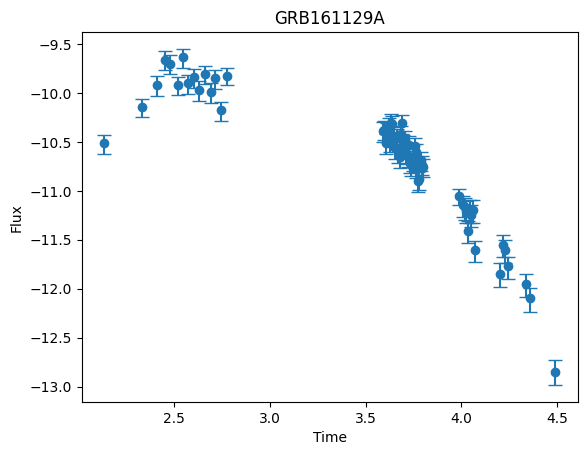


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.7292
Iteration 40/500 - Loss: 36.8252
Iteration 60/500 - Loss: 20.1173
Iteration 80/500 - Loss: 10.4839
Iteration 100/500 - Loss: 6.2206
Iteration 120/500 - Loss: 4.1079
Iteration 140/500 - Loss: 2.9574
Iteration 160/500 - Loss: 2.2668
Iteration 180/500 - Loss: 1.8203
Iteration 200/500 - Loss: 1.5162
Iteration 220/500 - Loss: 1.3915
Iteration 240/500 - Loss: 1.2852
Iteration 260/500 - Loss: 1.1849
Iteration 280/500 - Loss: 1.0856
Iteration 300/500 - Loss: 0.9839
Iteration 320/500 - Loss: 0.8814
Iteration 340/500 - Loss: 0.7825
Iteration 360/500 - Loss: 0.6956
Iteration 380/500 - Loss: 0.6280
Iteration 400/500 - Loss: 0.5781
Iteration 420/500 - Loss: 0.5553
Iteration 440/500 - Loss: 0.5358
Iteration 460/500 - Loss: 0.5173
Iteration 480/500 - Loss: 0.4999
Iteration 500/500 - Loss: 0.4834

-----RECONSTRUCTED GRB-----



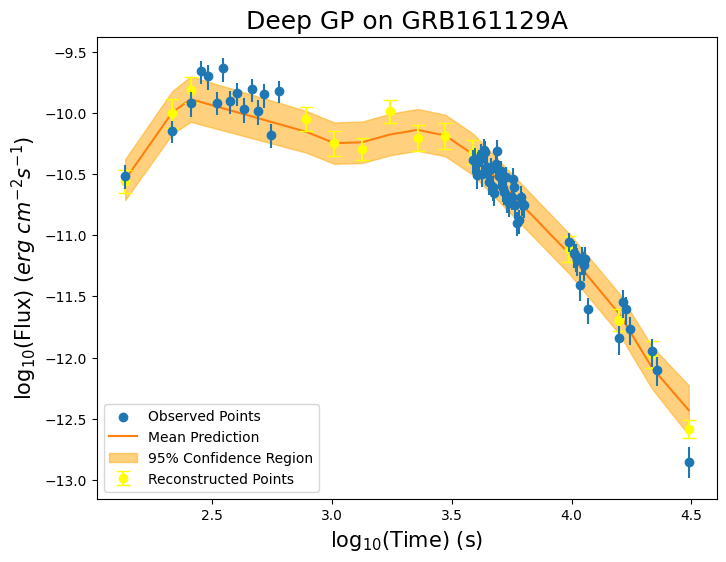


-----TRAINING FOR GRB161219B-----


-----ORIGINAL GRB-----



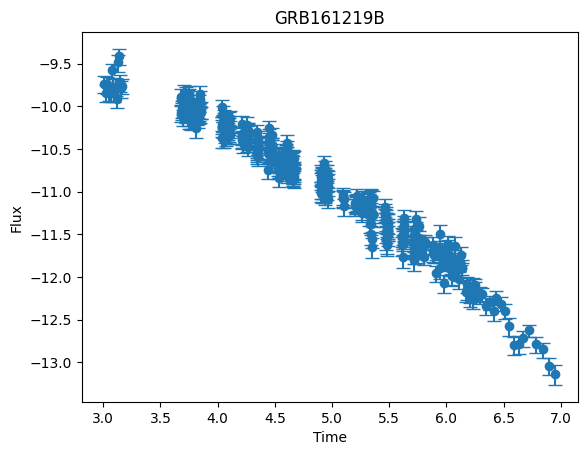


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 58.3971
Iteration 40/500 - Loss: 35.6822
Iteration 60/500 - Loss: 20.5034
Iteration 80/500 - Loss: 11.2409
Iteration 100/500 - Loss: 6.0144
Iteration 120/500 - Loss: 3.3116
Iteration 140/500 - Loss: 2.1740
Iteration 160/500 - Loss: 1.6173
Iteration 180/500 - Loss: 1.3742
Iteration 200/500 - Loss: 1.0325
Iteration 220/500 - Loss: 0.9115
Iteration 240/500 - Loss: 0.8147
Iteration 260/500 - Loss: 0.7254
Iteration 280/500 - Loss: 0.6420
Iteration 300/500 - Loss: 0.5637
Iteration 320/500 - Loss: 0.4905
Iteration 340/500 - Loss: 0.4219
Iteration 360/500 - Loss: 0.3574
Iteration 380/500 - Loss: 0.2971
Iteration 400/500 - Loss: 0.2406
Iteration 420/500 - Loss: 0.2124
Iteration 440/500 - Loss: 0.1862
Iteration 460/500 - Loss: 0.1605
Iteration 480/500 - Loss: 0.1354
Iteration 500/500 - Loss: 0.1109

-----RECONSTRUCTED GRB-----



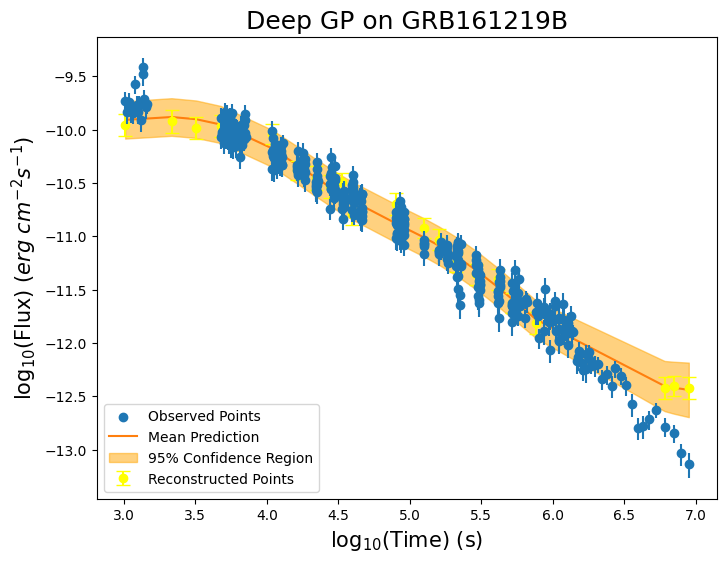


-----TRAINING FOR GRB170202A-----


-----ORIGINAL GRB-----



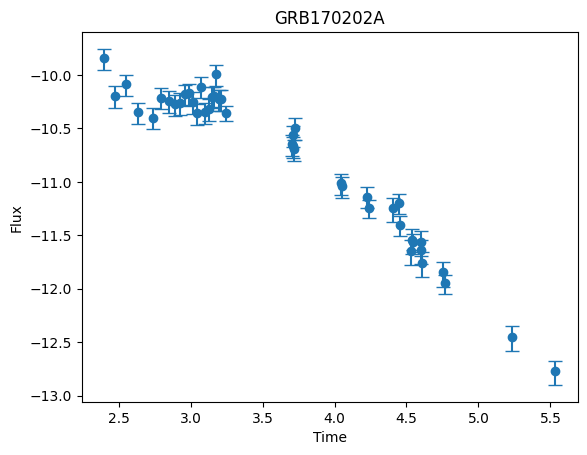


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 45.6134
Iteration 40/500 - Loss: 30.2730
Iteration 60/500 - Loss: 12.9210
Iteration 80/500 - Loss: 5.9383
Iteration 100/500 - Loss: 3.4907
Iteration 120/500 - Loss: 2.2134
Iteration 140/500 - Loss: 1.4431
Iteration 160/500 - Loss: 0.9649
Iteration 180/500 - Loss: 0.6670
Iteration 200/500 - Loss: 0.4775
Iteration 220/500 - Loss: 0.4072
Iteration 240/500 - Loss: 0.3521
Iteration 260/500 - Loss: 0.3051
Iteration 280/500 - Loss: 0.2647
Iteration 300/500 - Loss: 0.2298
Iteration 320/500 - Loss: 0.1995
Iteration 340/500 - Loss: 0.1729
Iteration 360/500 - Loss: 0.1496
Iteration 380/500 - Loss: 0.1288
Iteration 400/500 - Loss: 0.1103
Iteration 420/500 - Loss: 0.1013
Iteration 440/500 - Loss: 0.0932
Iteration 460/500 - Loss: 0.0853
Iteration 480/500 - Loss: 0.0778
Iteration 500/500 - Loss: 0.0705

-----RECONSTRUCTED GRB-----



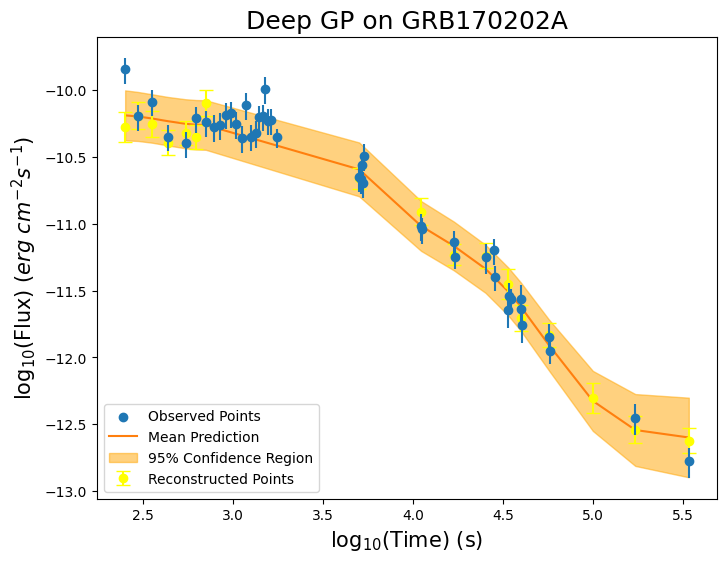


-----TRAINING FOR GRB170519A-----


-----ORIGINAL GRB-----



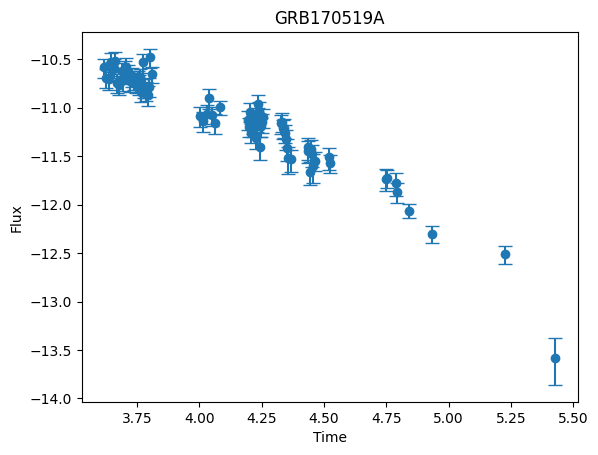


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.3253
Iteration 40/500 - Loss: 38.1342
Iteration 60/500 - Loss: 26.8265
Iteration 80/500 - Loss: 15.5307
Iteration 100/500 - Loss: 9.3635
Iteration 120/500 - Loss: 6.9356
Iteration 140/500 - Loss: 5.9990
Iteration 160/500 - Loss: 4.7017
Iteration 180/500 - Loss: 3.2788
Iteration 200/500 - Loss: 2.4160
Iteration 220/500 - Loss: 2.1329
Iteration 240/500 - Loss: 1.9357
Iteration 260/500 - Loss: 1.7826
Iteration 280/500 - Loss: 1.6617
Iteration 300/500 - Loss: 1.5661
Iteration 320/500 - Loss: 1.4903
Iteration 340/500 - Loss: 1.4298
Iteration 360/500 - Loss: 1.3810
Iteration 380/500 - Loss: 1.3409
Iteration 400/500 - Loss: 1.3074
Iteration 420/500 - Loss: 1.2919
Iteration 440/500 - Loss: 1.2782
Iteration 460/500 - Loss: 1.2651
Iteration 480/500 - Loss: 1.2526
Iteration 500/500 - Loss: 1.2408

-----RECONSTRUCTED GRB-----



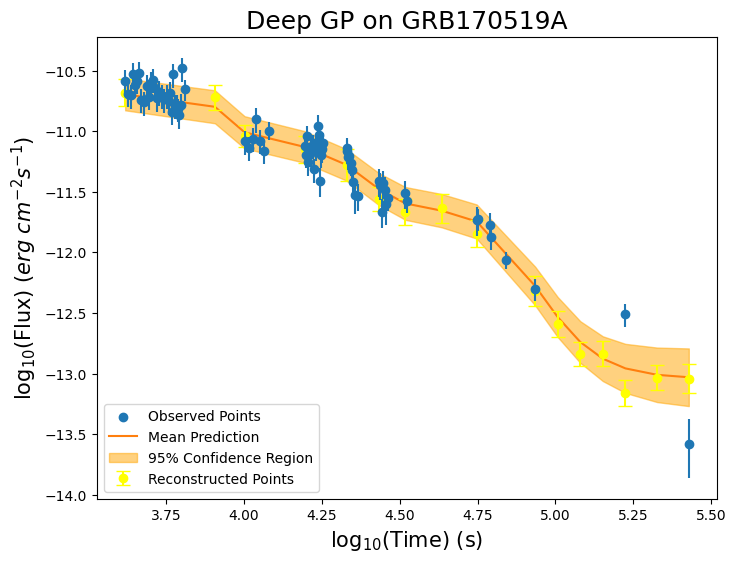


-----TRAINING FOR GRB170531B-----


-----ORIGINAL GRB-----



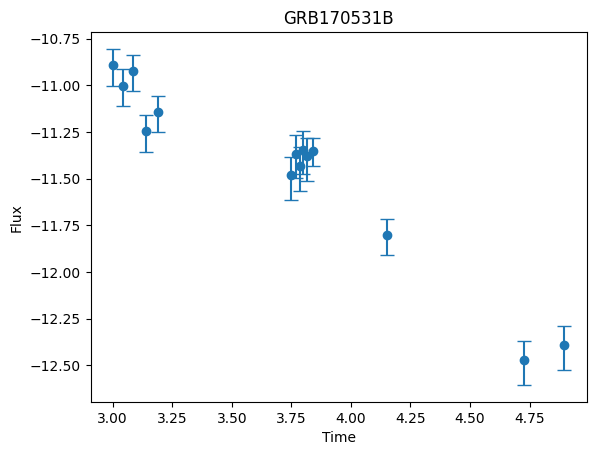


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.0937
Iteration 40/500 - Loss: 41.1817
Iteration 60/500 - Loss: 30.8356
Iteration 80/500 - Loss: 20.4797
Iteration 100/500 - Loss: 12.6768
Iteration 120/500 - Loss: 8.0444
Iteration 140/500 - Loss: 5.2679
Iteration 160/500 - Loss: 3.5951
Iteration 180/500 - Loss: 2.5673
Iteration 200/500 - Loss: 1.9454
Iteration 220/500 - Loss: 1.7054
Iteration 240/500 - Loss: 1.5341
Iteration 260/500 - Loss: 1.3917
Iteration 280/500 - Loss: 1.2715
Iteration 300/500 - Loss: 1.1692
Iteration 320/500 - Loss: 1.0814
Iteration 340/500 - Loss: 1.0057
Iteration 360/500 - Loss: 0.9397
Iteration 380/500 - Loss: 0.8821
Iteration 400/500 - Loss: 0.8314
Iteration 420/500 - Loss: 0.8071
Iteration 440/500 - Loss: 0.7854
Iteration 460/500 - Loss: 0.7645
Iteration 480/500 - Loss: 0.7446
Iteration 500/500 - Loss: 0.7255

-----RECONSTRUCTED GRB-----



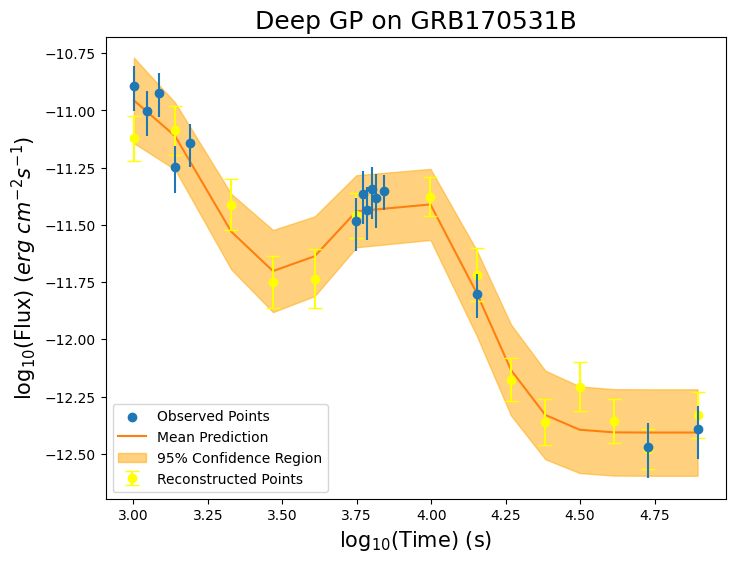


-----TRAINING FOR GRB170705A-----


-----ORIGINAL GRB-----



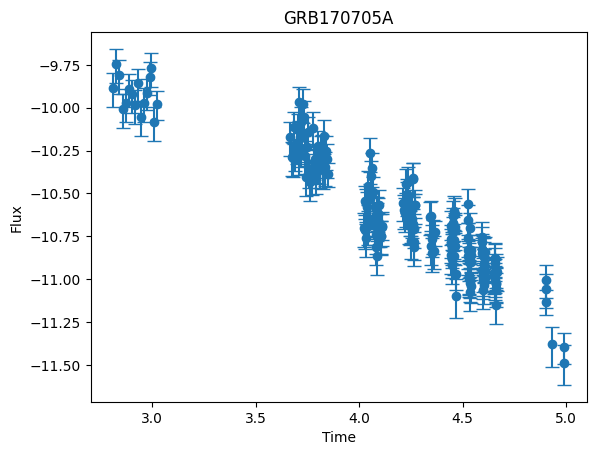


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 58.9172
Iteration 40/500 - Loss: 39.8736
Iteration 60/500 - Loss: 20.0762
Iteration 80/500 - Loss: 11.7619
Iteration 100/500 - Loss: 8.1049
Iteration 120/500 - Loss: 6.1785
Iteration 140/500 - Loss: 5.0962
Iteration 160/500 - Loss: 4.4382
Iteration 180/500 - Loss: 4.0134
Iteration 200/500 - Loss: 3.7199
Iteration 220/500 - Loss: 3.6006
Iteration 240/500 - Loss: 3.5004
Iteration 260/500 - Loss: 3.4096
Iteration 280/500 - Loss: 3.3276
Iteration 300/500 - Loss: 3.2537
Iteration 320/500 - Loss: 3.1868
Iteration 340/500 - Loss: 3.1262
Iteration 360/500 - Loss: 3.0703
Iteration 380/500 - Loss: 3.0195
Iteration 400/500 - Loss: 2.9737
Iteration 420/500 - Loss: 2.9493
Iteration 440/500 - Loss: 2.9276
Iteration 460/500 - Loss: 2.9065
Iteration 480/500 - Loss: 2.8859
Iteration 500/500 - Loss: 2.8656

-----RECONSTRUCTED GRB-----



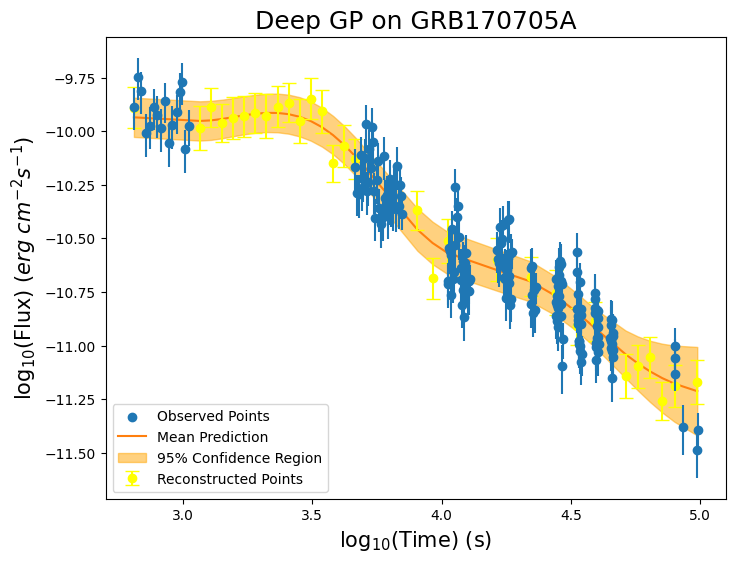


-----TRAINING FOR GRB170903A-----


-----ORIGINAL GRB-----



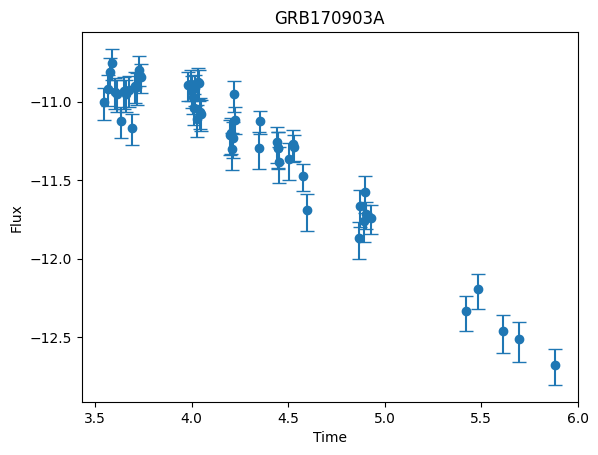


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.3998
Iteration 40/500 - Loss: 37.3896
Iteration 60/500 - Loss: 22.0156
Iteration 80/500 - Loss: 11.6879
Iteration 100/500 - Loss: 6.7847
Iteration 120/500 - Loss: 4.0716
Iteration 140/500 - Loss: 2.5601
Iteration 160/500 - Loss: 1.8246
Iteration 180/500 - Loss: 1.4785
Iteration 200/500 - Loss: 1.2998
Iteration 220/500 - Loss: 1.2312
Iteration 240/500 - Loss: 1.1798
Iteration 260/500 - Loss: 1.1344
Iteration 280/500 - Loss: 1.0940
Iteration 300/500 - Loss: 1.0576
Iteration 320/500 - Loss: 1.0247
Iteration 340/500 - Loss: 0.9948
Iteration 360/500 - Loss: 0.9677
Iteration 380/500 - Loss: 0.9430
Iteration 400/500 - Loss: 0.9204
Iteration 420/500 - Loss: 0.9093
Iteration 440/500 - Loss: 0.8992
Iteration 460/500 - Loss: 0.8894
Iteration 480/500 - Loss: 0.8798
Iteration 500/500 - Loss: 0.8707

-----RECONSTRUCTED GRB-----



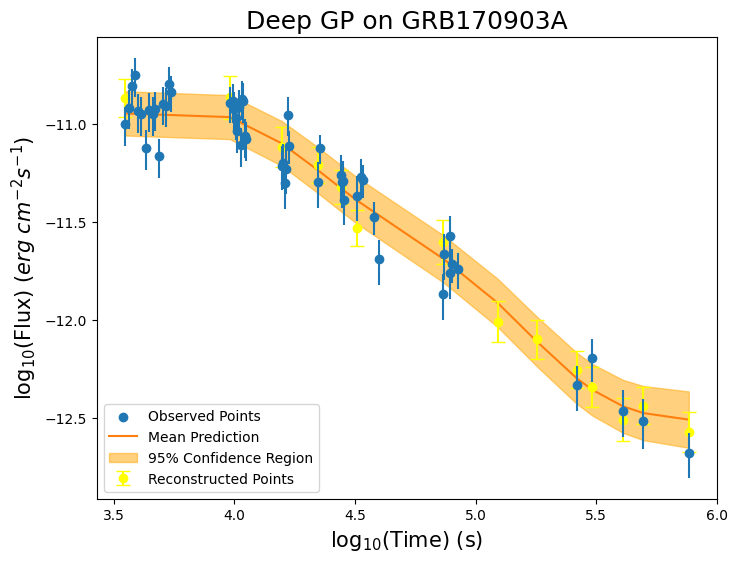


-----TRAINING FOR GRB171205A-----


-----ORIGINAL GRB-----



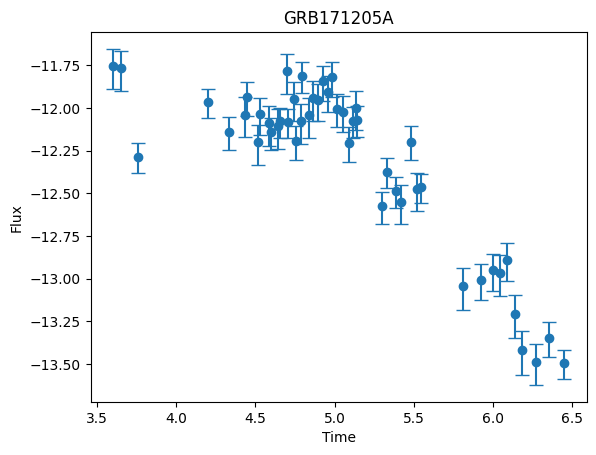


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.2311
Iteration 40/500 - Loss: 33.1154
Iteration 60/500 - Loss: 15.9057
Iteration 80/500 - Loss: 7.0880
Iteration 100/500 - Loss: 4.7690
Iteration 120/500 - Loss: 3.9832
Iteration 140/500 - Loss: 3.4410
Iteration 160/500 - Loss: 3.0156
Iteration 180/500 - Loss: 2.6794
Iteration 200/500 - Loss: 2.4268
Iteration 220/500 - Loss: 2.3205
Iteration 240/500 - Loss: 2.2369
Iteration 260/500 - Loss: 2.1660
Iteration 280/500 - Loss: 2.1064
Iteration 300/500 - Loss: 2.0559
Iteration 320/500 - Loss: 2.0123
Iteration 340/500 - Loss: 1.9739
Iteration 360/500 - Loss: 1.9396
Iteration 380/500 - Loss: 1.9085
Iteration 400/500 - Loss: 1.8798
Iteration 420/500 - Loss: 1.8656
Iteration 440/500 - Loss: 1.8525
Iteration 460/500 - Loss: 1.8395
Iteration 480/500 - Loss: 1.8266
Iteration 500/500 - Loss: 1.8139

-----RECONSTRUCTED GRB-----



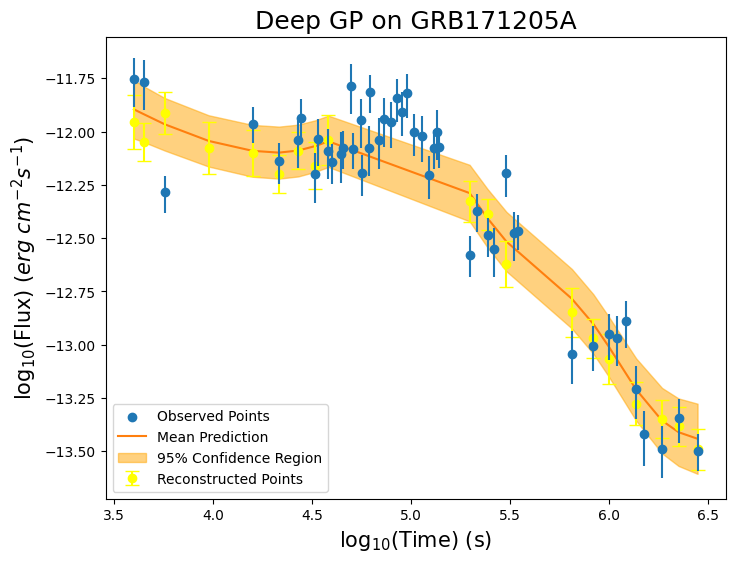


-----TRAINING FOR GRB171222A-----


-----ORIGINAL GRB-----



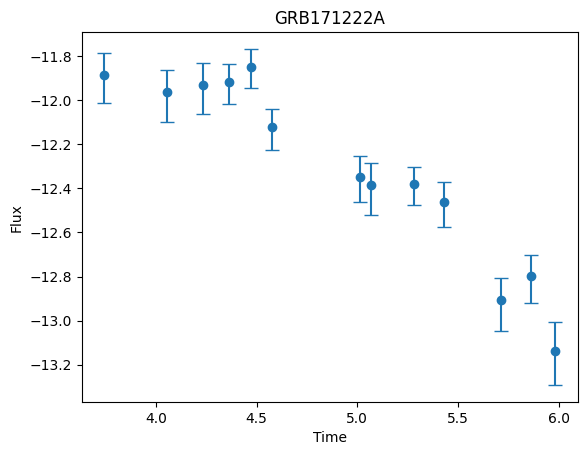


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 57.6756
Iteration 40/500 - Loss: 38.8190
Iteration 60/500 - Loss: 24.6885
Iteration 80/500 - Loss: 14.6796
Iteration 100/500 - Loss: 8.8056
Iteration 120/500 - Loss: 5.4728
Iteration 140/500 - Loss: 3.3598
Iteration 160/500 - Loss: 2.2741
Iteration 180/500 - Loss: 1.8367
Iteration 200/500 - Loss: 1.6000
Iteration 220/500 - Loss: 1.5139
Iteration 240/500 - Loss: 1.4375
Iteration 260/500 - Loss: 1.3608
Iteration 280/500 - Loss: 1.2910
Iteration 300/500 - Loss: 1.2268
Iteration 320/500 - Loss: 1.1733
Iteration 340/500 - Loss: 1.1265
Iteration 360/500 - Loss: 1.0714
Iteration 380/500 - Loss: 0.9921
Iteration 400/500 - Loss: 0.8384
Iteration 420/500 - Loss: 0.7218
Iteration 440/500 - Loss: 0.6210
Iteration 460/500 - Loss: 0.5425
Iteration 480/500 - Loss: 0.4782
Iteration 500/500 - Loss: 0.4224

-----RECONSTRUCTED GRB-----



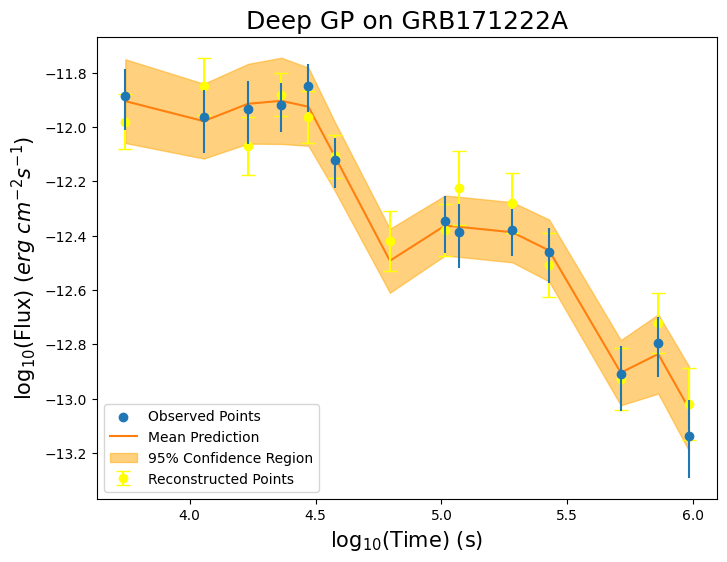


-----TRAINING FOR GRB180205A-----


-----ORIGINAL GRB-----



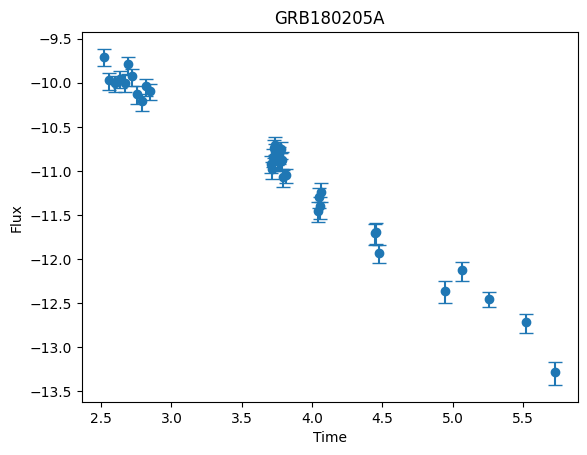


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.5721
Iteration 40/500 - Loss: 29.0795
Iteration 60/500 - Loss: 13.3700
Iteration 80/500 - Loss: 6.7794
Iteration 100/500 - Loss: 3.5780
Iteration 120/500 - Loss: 2.0770
Iteration 140/500 - Loss: 1.2543
Iteration 160/500 - Loss: 0.7450
Iteration 180/500 - Loss: 0.4215
Iteration 200/500 - Loss: 0.2259
Iteration 220/500 - Loss: 0.1591
Iteration 240/500 - Loss: 0.1097
Iteration 260/500 - Loss: 0.0692
Iteration 280/500 - Loss: 0.0355
Iteration 300/500 - Loss: 0.0068
Iteration 320/500 - Loss: -0.0180
Iteration 340/500 - Loss: -0.0398
Iteration 360/500 - Loss: -0.0592
Iteration 380/500 - Loss: -0.0770
Iteration 400/500 - Loss: -0.0934
Iteration 420/500 - Loss: -0.1017
Iteration 440/500 - Loss: -0.1095
Iteration 460/500 - Loss: -0.1173
Iteration 480/500 - Loss: -0.1252
Iteration 500/500 - Loss: -0.1332

-----RECONSTRUCTED GRB-----



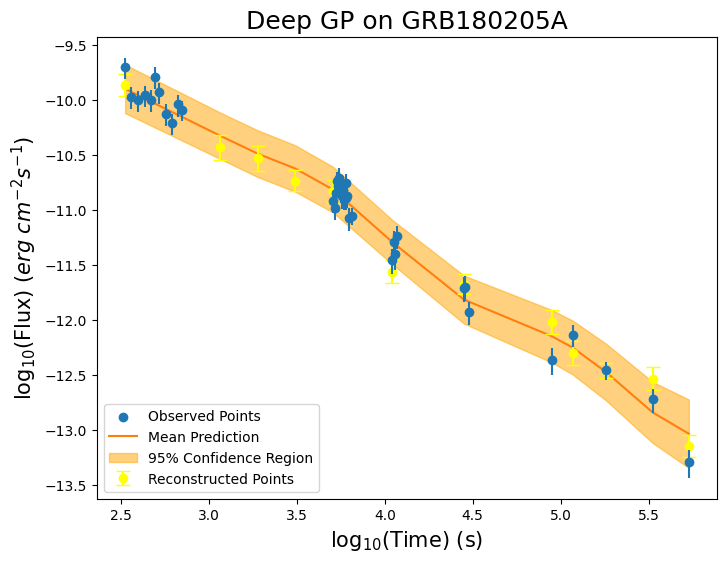


-----TRAINING FOR GRB180329B-----


-----ORIGINAL GRB-----



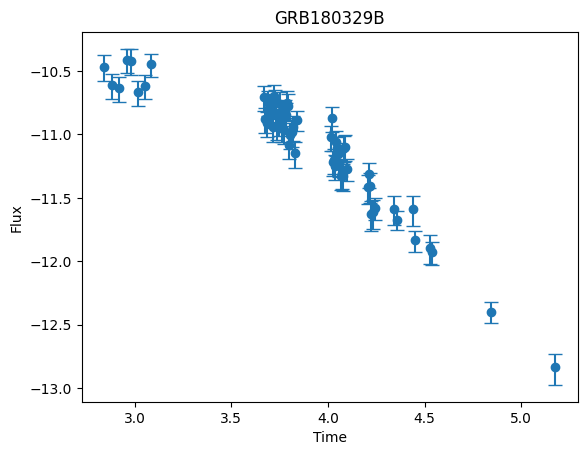


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.6102
Iteration 40/500 - Loss: 37.9518
Iteration 60/500 - Loss: 24.5835
Iteration 80/500 - Loss: 12.8401
Iteration 100/500 - Loss: 7.4671
Iteration 120/500 - Loss: 5.3264
Iteration 140/500 - Loss: 3.9679
Iteration 160/500 - Loss: 3.0560
Iteration 180/500 - Loss: 2.4626
Iteration 200/500 - Loss: 2.0753
Iteration 220/500 - Loss: 1.9262
Iteration 240/500 - Loss: 1.8055
Iteration 260/500 - Loss: 1.6995
Iteration 280/500 - Loss: 1.6058
Iteration 300/500 - Loss: 1.5224
Iteration 320/500 - Loss: 1.4495
Iteration 340/500 - Loss: 1.3863
Iteration 360/500 - Loss: 1.3315
Iteration 380/500 - Loss: 1.2832
Iteration 400/500 - Loss: 1.2389
Iteration 420/500 - Loss: 1.2168
Iteration 440/500 - Loss: 1.1975
Iteration 460/500 - Loss: 1.1790
Iteration 480/500 - Loss: 1.1611
Iteration 500/500 - Loss: 1.1441

-----RECONSTRUCTED GRB-----



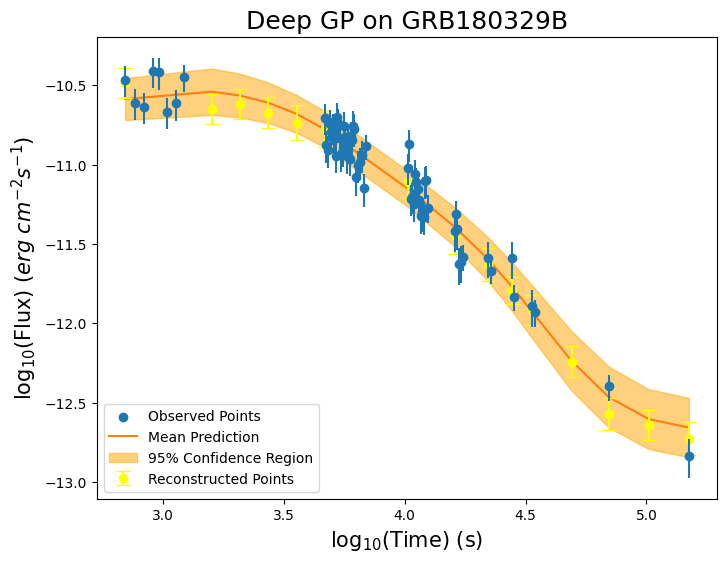


-----TRAINING FOR GRB180404A-----


-----ORIGINAL GRB-----



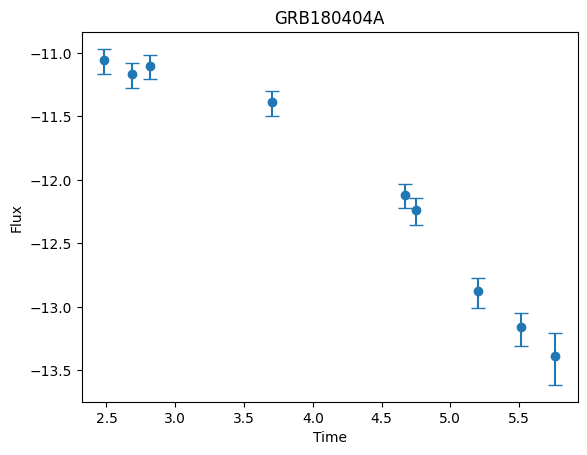


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 60.9976
Iteration 40/500 - Loss: 42.6411
Iteration 60/500 - Loss: 25.4322
Iteration 80/500 - Loss: 13.7651
Iteration 100/500 - Loss: 8.1287
Iteration 120/500 - Loss: 5.2374
Iteration 140/500 - Loss: 3.7682
Iteration 160/500 - Loss: 2.9749
Iteration 180/500 - Loss: 2.4178
Iteration 200/500 - Loss: 2.0056
Iteration 220/500 - Loss: 1.8281
Iteration 240/500 - Loss: 1.6780
Iteration 260/500 - Loss: 1.5480
Iteration 280/500 - Loss: 1.4263
Iteration 300/500 - Loss: 1.3198
Iteration 320/500 - Loss: 1.2274
Iteration 340/500 - Loss: 1.1504
Iteration 360/500 - Loss: 1.0747
Iteration 380/500 - Loss: 1.0111
Iteration 400/500 - Loss: 0.9530
Iteration 420/500 - Loss: 0.9234
Iteration 440/500 - Loss: 0.8949
Iteration 460/500 - Loss: 0.8657
Iteration 480/500 - Loss: 0.8357
Iteration 500/500 - Loss: 0.8057

-----RECONSTRUCTED GRB-----



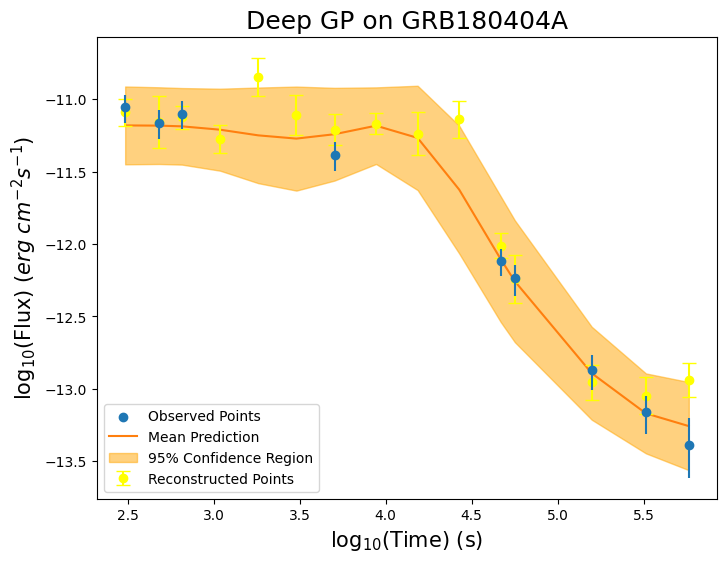


-----TRAINING FOR GRB180620B-----


-----ORIGINAL GRB-----



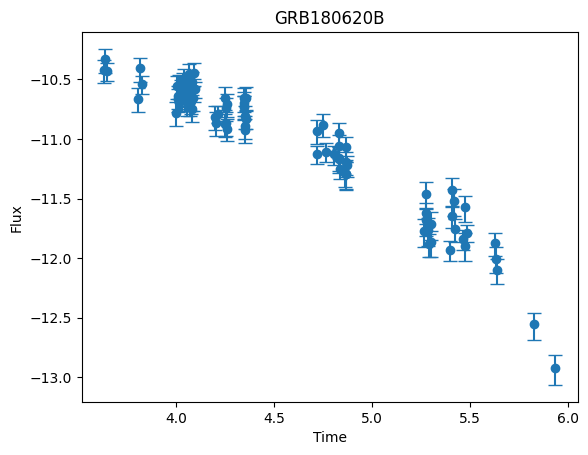


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.1784
Iteration 40/500 - Loss: 34.1555
Iteration 60/500 - Loss: 18.1520
Iteration 80/500 - Loss: 8.3030
Iteration 100/500 - Loss: 5.6664
Iteration 120/500 - Loss: 4.5028
Iteration 140/500 - Loss: 3.6817
Iteration 160/500 - Loss: 3.0439
Iteration 180/500 - Loss: 2.5407
Iteration 200/500 - Loss: 2.0946
Iteration 220/500 - Loss: 1.8689
Iteration 240/500 - Loss: 1.6585
Iteration 260/500 - Loss: 1.4679
Iteration 280/500 - Loss: 1.3092
Iteration 300/500 - Loss: 1.1795
Iteration 320/500 - Loss: 1.0712
Iteration 340/500 - Loss: 0.9777
Iteration 360/500 - Loss: 0.8952
Iteration 380/500 - Loss: 0.8230
Iteration 400/500 - Loss: 0.7619
Iteration 420/500 - Loss: 0.7313
Iteration 440/500 - Loss: 0.7049
Iteration 460/500 - Loss: 0.6802
Iteration 480/500 - Loss: 0.6569
Iteration 500/500 - Loss: 0.6347

-----RECONSTRUCTED GRB-----



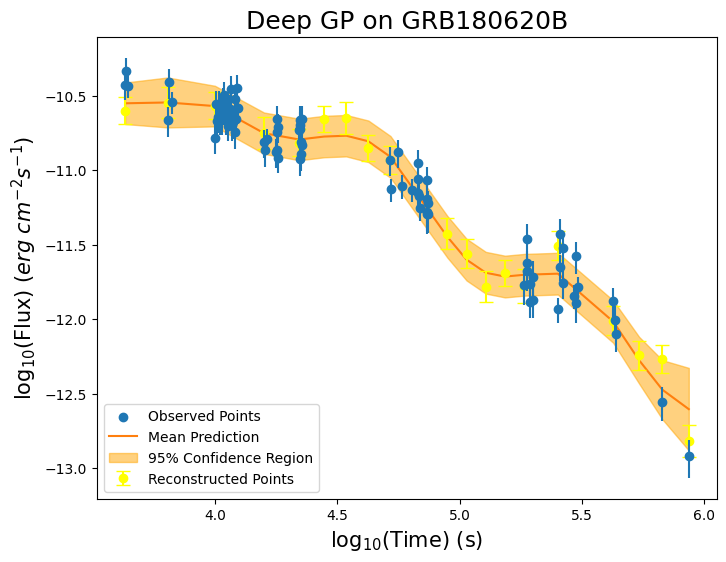


-----TRAINING FOR GRB180728A-----


-----ORIGINAL GRB-----



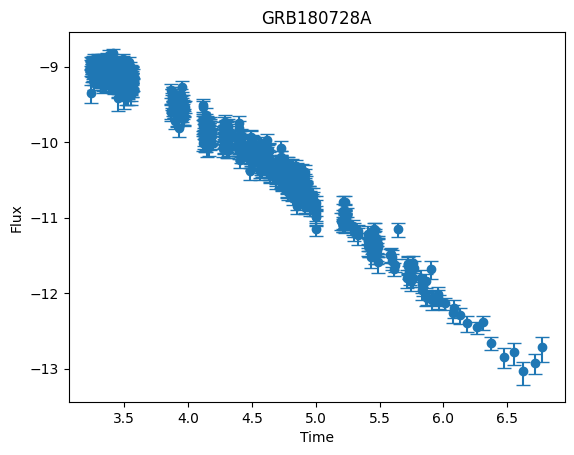


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.9517
Iteration 40/500 - Loss: 42.1011
Iteration 60/500 - Loss: 32.4066
Iteration 80/500 - Loss: 19.6144
Iteration 100/500 - Loss: 10.9592
Iteration 120/500 - Loss: 6.0425
Iteration 140/500 - Loss: 2.8545
Iteration 160/500 - Loss: 1.2644
Iteration 180/500 - Loss: 0.5542
Iteration 200/500 - Loss: 0.1803
Iteration 220/500 - Loss: 0.0527
Iteration 240/500 - Loss: -0.0427
Iteration 260/500 - Loss: -0.1205
Iteration 280/500 - Loss: -0.1728
Iteration 300/500 - Loss: -0.2342
Iteration 320/500 - Loss: -0.2809
Iteration 340/500 - Loss: -0.3206
Iteration 360/500 - Loss: -0.3548
Iteration 380/500 - Loss: -0.3833
Iteration 400/500 - Loss: -0.4074
Iteration 420/500 - Loss: -0.4211
Iteration 440/500 - Loss: -0.4328
Iteration 460/500 - Loss: -0.4437
Iteration 480/500 - Loss: -0.4540
Iteration 500/500 - Loss: -0.4638

-----RECONSTRUCTED GRB-----



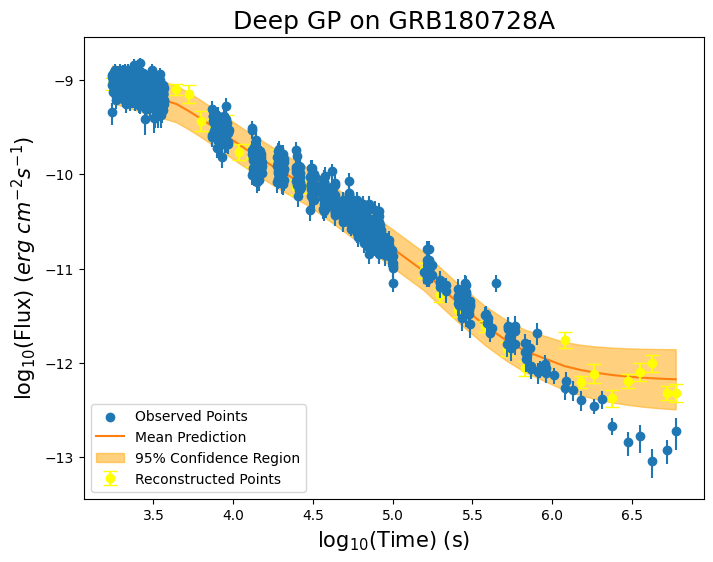


-----TRAINING FOR GRB181010A-----


-----ORIGINAL GRB-----



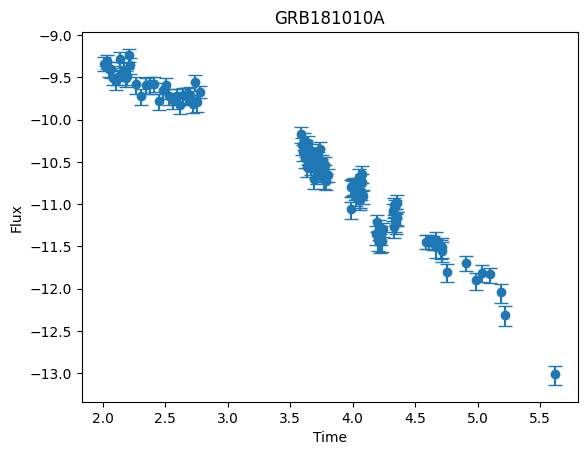


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 54.1693
Iteration 40/500 - Loss: 39.1190
Iteration 60/500 - Loss: 23.7652
Iteration 80/500 - Loss: 10.2877
Iteration 100/500 - Loss: 4.4210
Iteration 120/500 - Loss: 2.4431
Iteration 140/500 - Loss: 1.6601
Iteration 160/500 - Loss: 1.2063
Iteration 180/500 - Loss: 0.9196
Iteration 200/500 - Loss: 0.7153
Iteration 220/500 - Loss: 0.6318
Iteration 240/500 - Loss: 0.5643
Iteration 260/500 - Loss: 0.5050
Iteration 280/500 - Loss: 0.4531
Iteration 300/500 - Loss: 0.4077
Iteration 320/500 - Loss: 0.3685
Iteration 340/500 - Loss: 0.3334
Iteration 360/500 - Loss: 0.3037
Iteration 380/500 - Loss: 0.2768
Iteration 400/500 - Loss: 0.2534
Iteration 420/500 - Loss: 0.2423
Iteration 440/500 - Loss: 0.2321
Iteration 460/500 - Loss: 0.2227
Iteration 480/500 - Loss: 0.2133
Iteration 500/500 - Loss: 0.2045

-----RECONSTRUCTED GRB-----



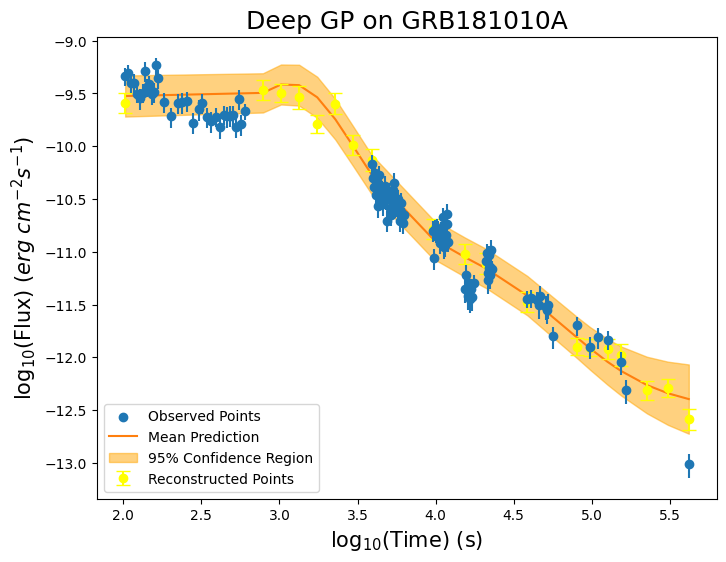


-----TRAINING FOR GRB181020A-----


-----ORIGINAL GRB-----



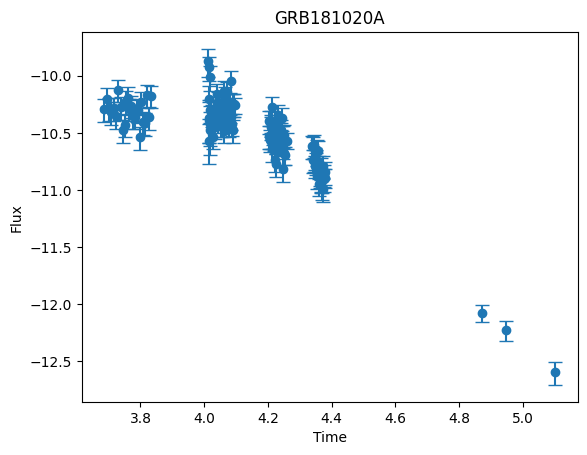


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.8223
Iteration 40/500 - Loss: 43.4002
Iteration 60/500 - Loss: 36.1783
Iteration 80/500 - Loss: 28.9169
Iteration 100/500 - Loss: 23.1832
Iteration 120/500 - Loss: 18.7793
Iteration 140/500 - Loss: 15.4827
Iteration 160/500 - Loss: 13.0156
Iteration 180/500 - Loss: 11.0769
Iteration 200/500 - Loss: 9.4875
Iteration 220/500 - Loss: 8.7537
Iteration 240/500 - Loss: 8.1125
Iteration 260/500 - Loss: 7.5139
Iteration 280/500 - Loss: 6.9581
Iteration 300/500 - Loss: 6.4440
Iteration 320/500 - Loss: 5.9691
Iteration 340/500 - Loss: 5.5313
Iteration 360/500 - Loss: 5.1283
Iteration 380/500 - Loss: 4.7560
Iteration 400/500 - Loss: 4.4120
Iteration 420/500 - Loss: 4.2471
Iteration 440/500 - Loss: 4.1007
Iteration 460/500 - Loss: 3.9631
Iteration 480/500 - Loss: 3.8342
Iteration 500/500 - Loss: 3.7134

-----RECONSTRUCTED GRB-----



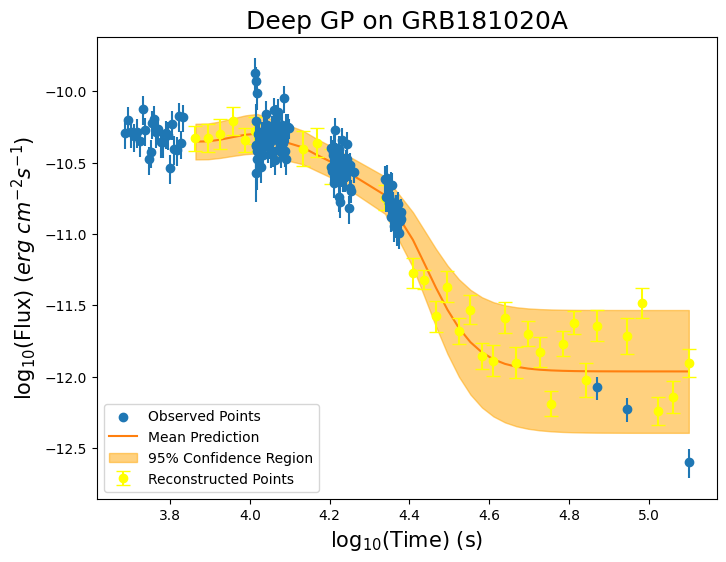


-----TRAINING FOR GRB181110A-----


-----ORIGINAL GRB-----



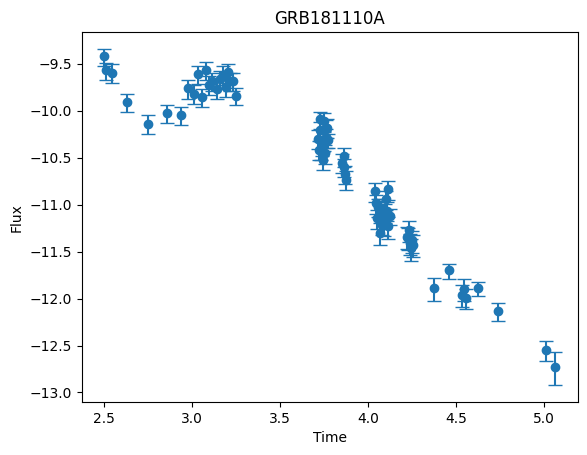


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.3855
Iteration 40/500 - Loss: 31.3818
Iteration 60/500 - Loss: 13.4716
Iteration 80/500 - Loss: 5.8720
Iteration 100/500 - Loss: 2.8785
Iteration 120/500 - Loss: 1.7375
Iteration 140/500 - Loss: 1.2670
Iteration 160/500 - Loss: 1.0006
Iteration 180/500 - Loss: 0.8174
Iteration 200/500 - Loss: 0.6783
Iteration 220/500 - Loss: 0.6161
Iteration 240/500 - Loss: 0.5615
Iteration 260/500 - Loss: 0.5103
Iteration 280/500 - Loss: 0.4618
Iteration 300/500 - Loss: 0.4157
Iteration 320/500 - Loss: 0.3713
Iteration 340/500 - Loss: 0.3283
Iteration 360/500 - Loss: 0.2861
Iteration 380/500 - Loss: 0.2442
Iteration 400/500 - Loss: 0.2026
Iteration 420/500 - Loss: 0.1807
Iteration 440/500 - Loss: 0.1600
Iteration 460/500 - Loss: 0.1393
Iteration 480/500 - Loss: 0.1190
Iteration 500/500 - Loss: 0.0991

-----RECONSTRUCTED GRB-----



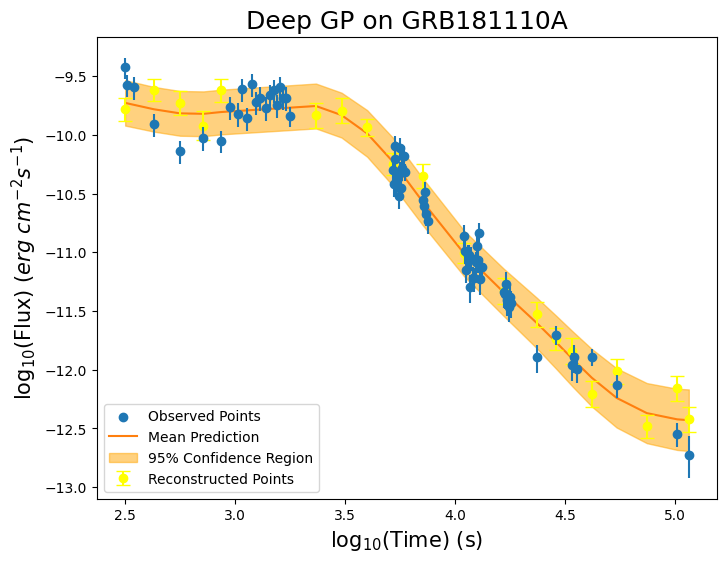


-----TRAINING FOR GRB190106A-----


-----ORIGINAL GRB-----



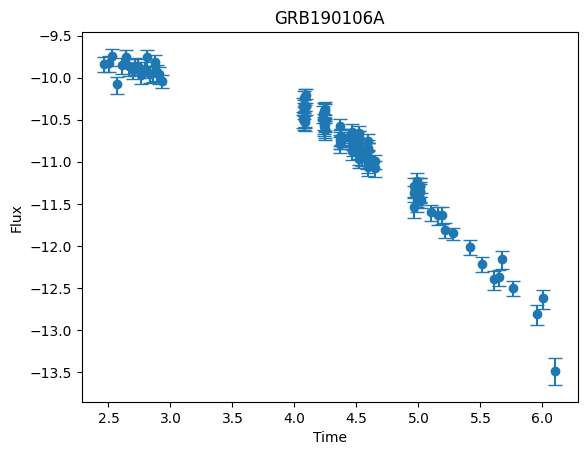


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 59.1267
Iteration 40/500 - Loss: 36.7949
Iteration 60/500 - Loss: 19.2875
Iteration 80/500 - Loss: 10.4668
Iteration 100/500 - Loss: 6.1333
Iteration 120/500 - Loss: 3.7231
Iteration 140/500 - Loss: 2.2928
Iteration 160/500 - Loss: 1.3760
Iteration 180/500 - Loss: 0.8120
Iteration 200/500 - Loss: 0.4838
Iteration 220/500 - Loss: 0.3620
Iteration 240/500 - Loss: 0.2816
Iteration 260/500 - Loss: 0.2185
Iteration 280/500 - Loss: 0.1680
Iteration 300/500 - Loss: 0.1263
Iteration 320/500 - Loss: 0.0915
Iteration 340/500 - Loss: 0.0619
Iteration 360/500 - Loss: 0.0361
Iteration 380/500 - Loss: 0.0140
Iteration 400/500 - Loss: -0.0056
Iteration 420/500 - Loss: -0.0154
Iteration 440/500 - Loss: -0.0240
Iteration 460/500 - Loss: -0.0322
Iteration 480/500 - Loss: -0.0400
Iteration 500/500 - Loss: -0.0476

-----RECONSTRUCTED GRB-----



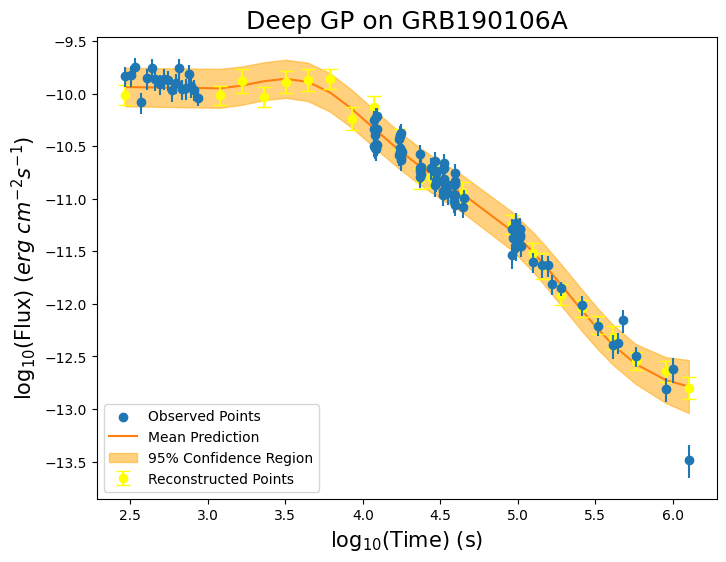


-----TRAINING FOR GRB190114A-----


-----ORIGINAL GRB-----



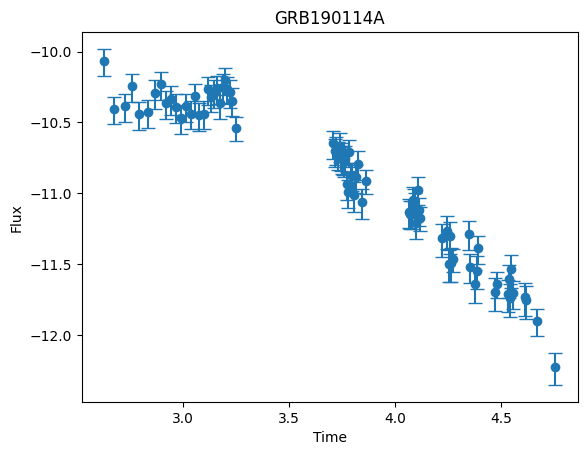


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.6524
Iteration 40/500 - Loss: 42.3001
Iteration 60/500 - Loss: 27.8793
Iteration 80/500 - Loss: 10.5606
Iteration 100/500 - Loss: 3.8713
Iteration 120/500 - Loss: 1.8374
Iteration 140/500 - Loss: 1.1973
Iteration 160/500 - Loss: 0.8977
Iteration 180/500 - Loss: 0.7228
Iteration 200/500 - Loss: 0.6084
Iteration 220/500 - Loss: 0.5635
Iteration 240/500 - Loss: 0.5271
Iteration 260/500 - Loss: 0.4951
Iteration 280/500 - Loss: 0.4669
Iteration 300/500 - Loss: 0.4420
Iteration 320/500 - Loss: 0.4198
Iteration 340/500 - Loss: 0.4002
Iteration 360/500 - Loss: 0.3827
Iteration 380/500 - Loss: 0.3670
Iteration 400/500 - Loss: 0.3536
Iteration 420/500 - Loss: 0.3459
Iteration 440/500 - Loss: 0.3397
Iteration 460/500 - Loss: 0.3337
Iteration 480/500 - Loss: 0.3279
Iteration 500/500 - Loss: 0.3223

-----RECONSTRUCTED GRB-----



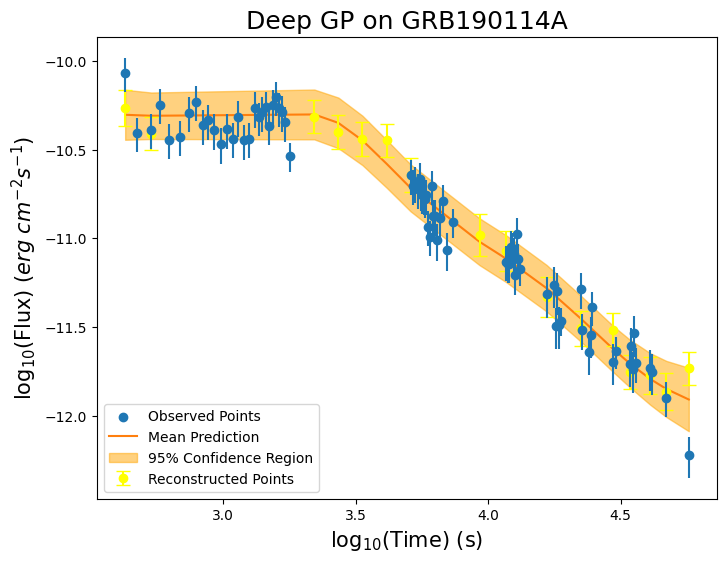


-----TRAINING FOR GRB190627A-----


-----ORIGINAL GRB-----



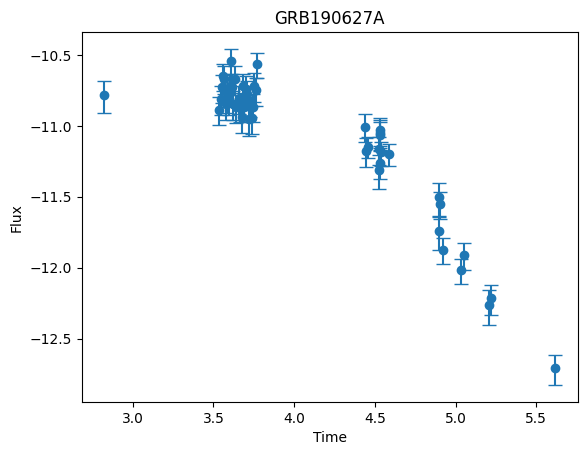


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.9736
Iteration 40/500 - Loss: 37.8394
Iteration 60/500 - Loss: 24.1134
Iteration 80/500 - Loss: 12.2895
Iteration 100/500 - Loss: 5.8490
Iteration 120/500 - Loss: 3.2807
Iteration 140/500 - Loss: 2.2168
Iteration 160/500 - Loss: 1.6845
Iteration 180/500 - Loss: 1.3841
Iteration 200/500 - Loss: 1.1884
Iteration 220/500 - Loss: 1.1107
Iteration 240/500 - Loss: 1.0472
Iteration 260/500 - Loss: 0.9915
Iteration 280/500 - Loss: 0.9425
Iteration 300/500 - Loss: 0.8999
Iteration 320/500 - Loss: 0.8631
Iteration 340/500 - Loss: 0.8315
Iteration 360/500 - Loss: 0.8037
Iteration 380/500 - Loss: 0.7810
Iteration 400/500 - Loss: 0.7599
Iteration 420/500 - Loss: 0.7499
Iteration 440/500 - Loss: 0.7412
Iteration 460/500 - Loss: 0.7331
Iteration 480/500 - Loss: 0.7254
Iteration 500/500 - Loss: 0.7181

-----RECONSTRUCTED GRB-----



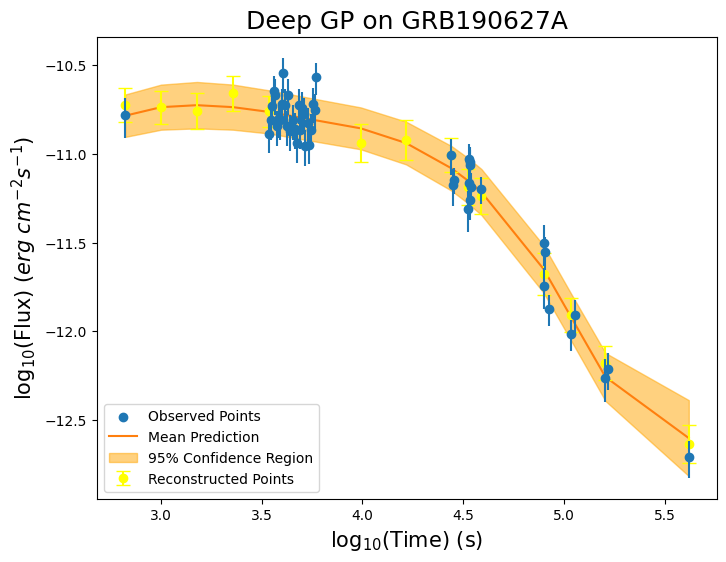


-----TRAINING FOR GRB050922C-----


-----ORIGINAL GRB-----



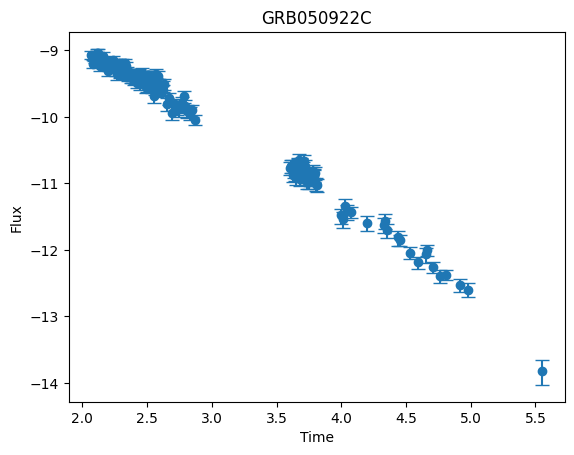


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.6831
Iteration 40/500 - Loss: 38.3253
Iteration 60/500 - Loss: 26.2456
Iteration 80/500 - Loss: 13.3243
Iteration 100/500 - Loss: 6.3334
Iteration 120/500 - Loss: 2.7969
Iteration 140/500 - Loss: 1.6573
Iteration 160/500 - Loss: 1.0409
Iteration 180/500 - Loss: 0.6604
Iteration 200/500 - Loss: 0.3749
Iteration 220/500 - Loss: 0.2547
Iteration 240/500 - Loss: 0.1600
Iteration 260/500 - Loss: 0.1048
Iteration 280/500 - Loss: 0.0157
Iteration 300/500 - Loss: -0.0501
Iteration 320/500 - Loss: -0.1070
Iteration 340/500 - Loss: -0.1579
Iteration 360/500 - Loss: -0.2037
Iteration 380/500 - Loss: -0.2449
Iteration 400/500 - Loss: -0.2823
Iteration 420/500 - Loss: -0.3005
Iteration 440/500 - Loss: -0.3172
Iteration 460/500 - Loss: -0.3333
Iteration 480/500 - Loss: -0.3489
Iteration 500/500 - Loss: -0.3639

-----RECONSTRUCTED GRB-----



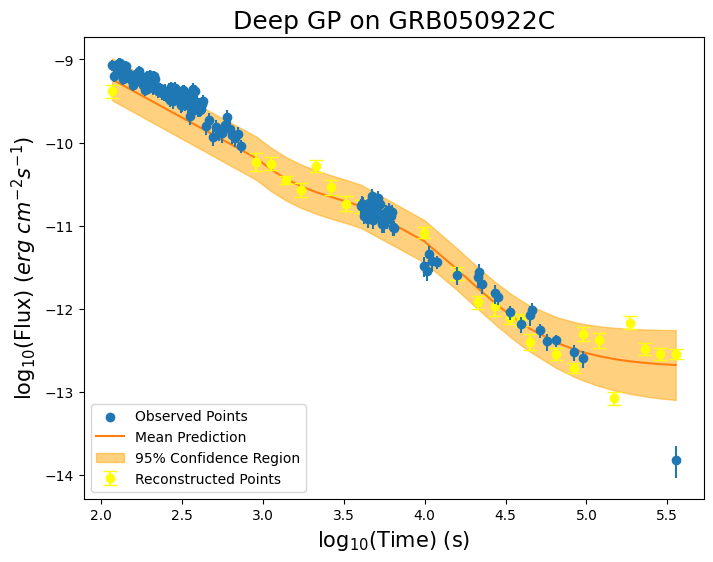


-----TRAINING FOR GRB060926-----


-----ORIGINAL GRB-----



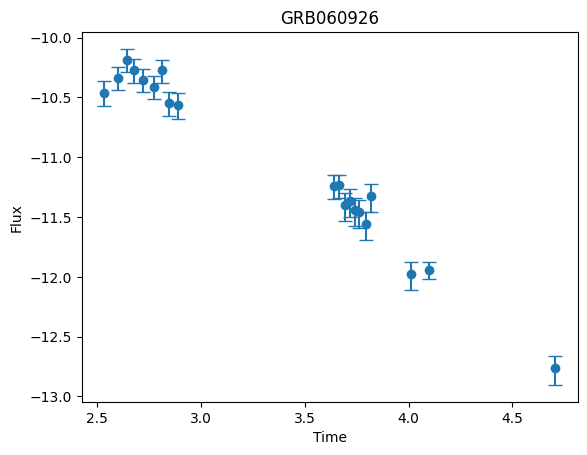


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.0464
Iteration 40/500 - Loss: 34.5959
Iteration 60/500 - Loss: 19.0829
Iteration 80/500 - Loss: 9.8257
Iteration 100/500 - Loss: 6.5299
Iteration 120/500 - Loss: 4.6815
Iteration 140/500 - Loss: 3.4218
Iteration 160/500 - Loss: 2.4956
Iteration 180/500 - Loss: 1.8045
Iteration 200/500 - Loss: 1.3003
Iteration 220/500 - Loss: 1.0938
Iteration 240/500 - Loss: 0.9293
Iteration 260/500 - Loss: 0.7896
Iteration 280/500 - Loss: 0.6710
Iteration 300/500 - Loss: 0.5696
Iteration 320/500 - Loss: 0.4799
Iteration 340/500 - Loss: 0.4016
Iteration 360/500 - Loss: 0.3356
Iteration 380/500 - Loss: 0.2791
Iteration 400/500 - Loss: 0.2339
Iteration 420/500 - Loss: 0.2137
Iteration 440/500 - Loss: 0.1959
Iteration 460/500 - Loss: 0.1793
Iteration 480/500 - Loss: 0.1637
Iteration 500/500 - Loss: 0.1490

-----RECONSTRUCTED GRB-----



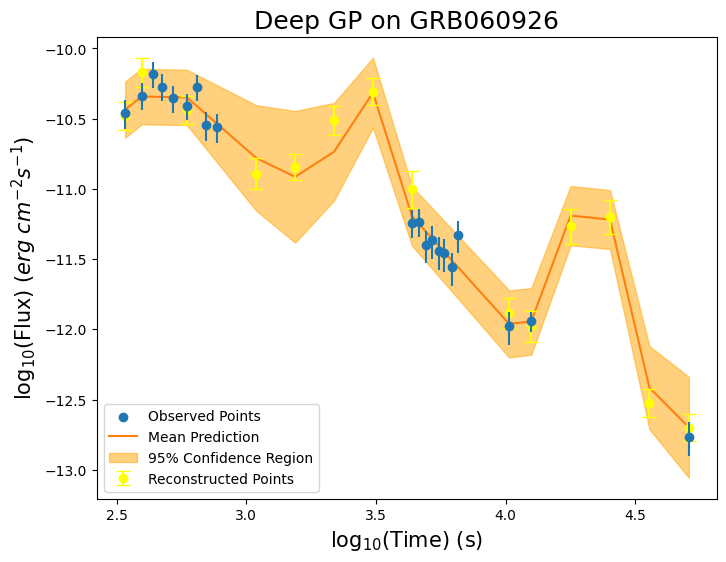


-----TRAINING FOR GRB061110A-----


-----ORIGINAL GRB-----



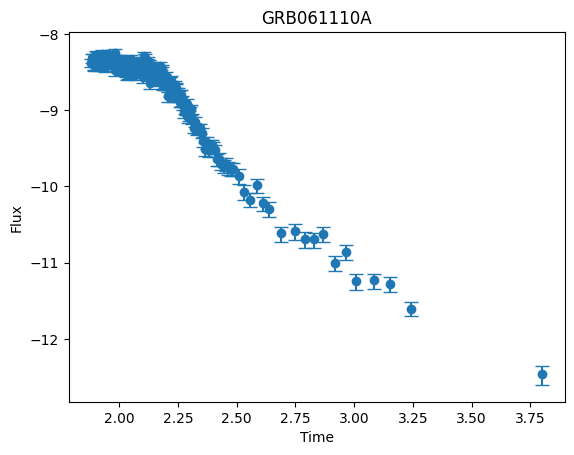


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.4717
Iteration 40/500 - Loss: 38.7816
Iteration 60/500 - Loss: 28.9352
Iteration 80/500 - Loss: 17.6486
Iteration 100/500 - Loss: 8.9023
Iteration 120/500 - Loss: 4.6961
Iteration 140/500 - Loss: 3.0137
Iteration 160/500 - Loss: 1.8723
Iteration 180/500 - Loss: 1.2202
Iteration 200/500 - Loss: 0.7999
Iteration 220/500 - Loss: 0.6243
Iteration 240/500 - Loss: 0.4879
Iteration 260/500 - Loss: 0.3709
Iteration 280/500 - Loss: 0.2692
Iteration 300/500 - Loss: 0.1801
Iteration 320/500 - Loss: 0.1016
Iteration 340/500 - Loss: 0.0321
Iteration 360/500 - Loss: -0.0298
Iteration 380/500 - Loss: -0.0854
Iteration 400/500 - Loss: -0.1357
Iteration 420/500 - Loss: -0.1601
Iteration 440/500 - Loss: -0.1825
Iteration 460/500 - Loss: -0.2042
Iteration 480/500 - Loss: -0.2251
Iteration 500/500 - Loss: -0.2454

-----RECONSTRUCTED GRB-----



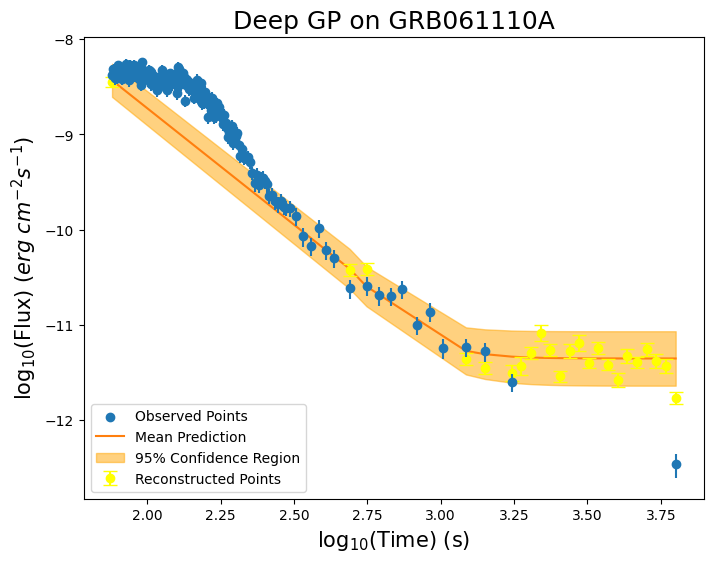


-----TRAINING FOR GRB061222A-----


-----ORIGINAL GRB-----



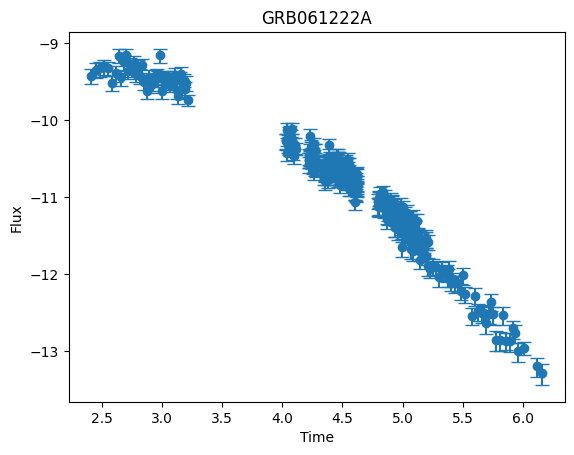


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 72.7100
Iteration 40/500 - Loss: 51.1846
Iteration 60/500 - Loss: 34.1735
Iteration 80/500 - Loss: 20.6393
Iteration 100/500 - Loss: 10.6074
Iteration 120/500 - Loss: 4.8997
Iteration 140/500 - Loss: 2.3793
Iteration 160/500 - Loss: 1.1442
Iteration 180/500 - Loss: 0.4548
Iteration 200/500 - Loss: 0.0690
Iteration 220/500 - Loss: -0.0576
Iteration 240/500 - Loss: -0.1442
Iteration 260/500 - Loss: -0.2110
Iteration 280/500 - Loss: -0.2628
Iteration 300/500 - Loss: -0.3030
Iteration 320/500 - Loss: -0.3350
Iteration 340/500 - Loss: -0.3602
Iteration 360/500 - Loss: -0.3806
Iteration 380/500 - Loss: -0.3975
Iteration 400/500 - Loss: -0.4112
Iteration 420/500 - Loss: -0.4178
Iteration 440/500 - Loss: -0.4234
Iteration 460/500 - Loss: -0.4286
Iteration 480/500 - Loss: -0.4333
Iteration 500/500 - Loss: -0.4378

-----RECONSTRUCTED GRB-----



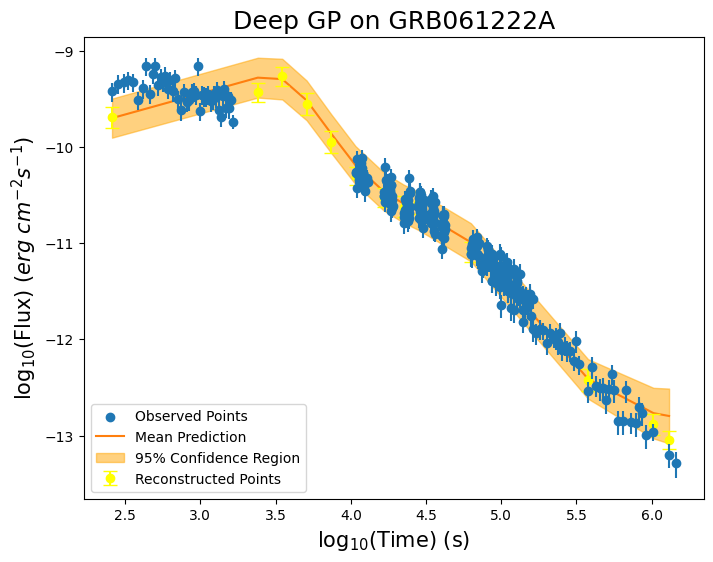


-----TRAINING FOR GRB070508-----


-----ORIGINAL GRB-----



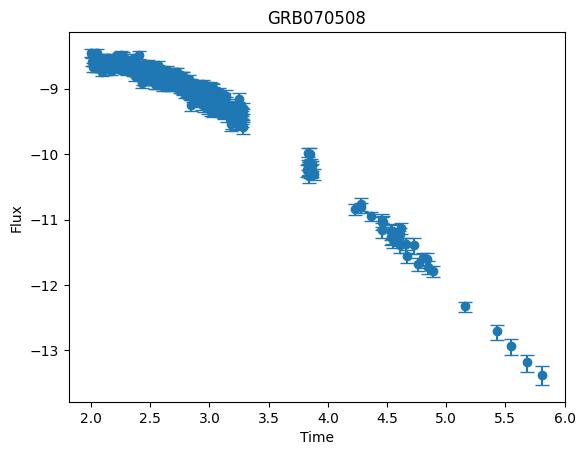


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.3502
Iteration 40/500 - Loss: 40.4601
Iteration 60/500 - Loss: 31.3125
Iteration 80/500 - Loss: 21.5667
Iteration 100/500 - Loss: 13.3443
Iteration 120/500 - Loss: 8.0700
Iteration 140/500 - Loss: 5.3938
Iteration 160/500 - Loss: 3.4819
Iteration 180/500 - Loss: 2.3401
Iteration 200/500 - Loss: 1.6391
Iteration 220/500 - Loss: 1.2475
Iteration 240/500 - Loss: 1.0709
Iteration 260/500 - Loss: 0.9391
Iteration 280/500 - Loss: 0.8319
Iteration 300/500 - Loss: 0.7384
Iteration 320/500 - Loss: 0.6530
Iteration 340/500 - Loss: 0.5730
Iteration 360/500 - Loss: 0.4968
Iteration 380/500 - Loss: 0.4236
Iteration 400/500 - Loss: 0.3532
Iteration 420/500 - Loss: 0.3172
Iteration 440/500 - Loss: 0.2833
Iteration 460/500 - Loss: 0.2497
Iteration 480/500 - Loss: 0.2165
Iteration 500/500 - Loss: 0.1836

-----RECONSTRUCTED GRB-----



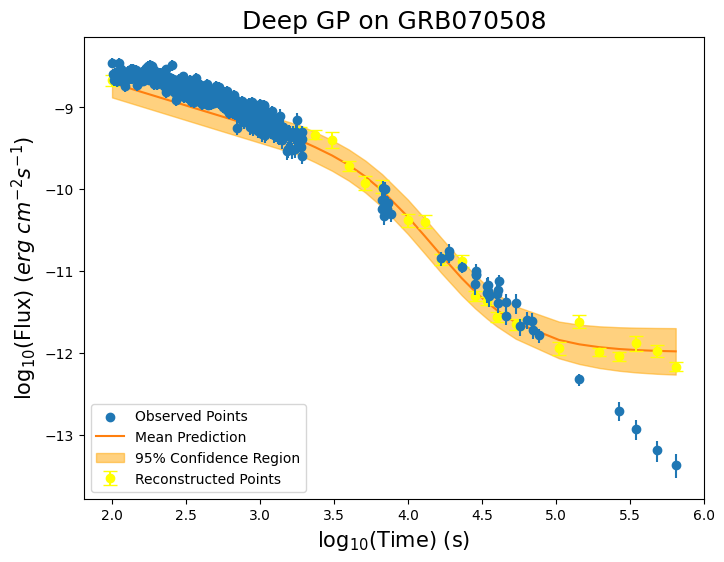


-----TRAINING FOR GRB130505A-----


-----ORIGINAL GRB-----



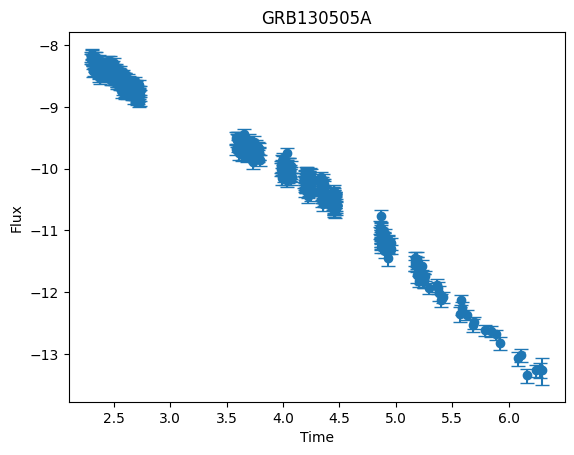


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.1365
Iteration 40/500 - Loss: 41.9534
Iteration 60/500 - Loss: 32.7192
Iteration 80/500 - Loss: 20.2454
Iteration 100/500 - Loss: 10.7144
Iteration 120/500 - Loss: 6.0804
Iteration 140/500 - Loss: 2.9292
Iteration 160/500 - Loss: 0.8164
Iteration 180/500 - Loss: 0.0641
Iteration 200/500 - Loss: -0.2030
Iteration 220/500 - Loss: -0.3031
Iteration 240/500 - Loss: -0.3804
Iteration 260/500 - Loss: -0.4474
Iteration 280/500 - Loss: -0.5059
Iteration 300/500 - Loss: -0.5573
Iteration 320/500 - Loss: -0.6023
Iteration 340/500 - Loss: -0.6422
Iteration 360/500 - Loss: -0.6773
Iteration 380/500 - Loss: -0.7083
Iteration 400/500 - Loss: -0.7360
Iteration 420/500 - Loss: -0.7491
Iteration 440/500 - Loss: -0.7606
Iteration 460/500 - Loss: -0.7723
Iteration 480/500 - Loss: -0.7827
Iteration 500/500 - Loss: -0.7928

-----RECONSTRUCTED GRB-----



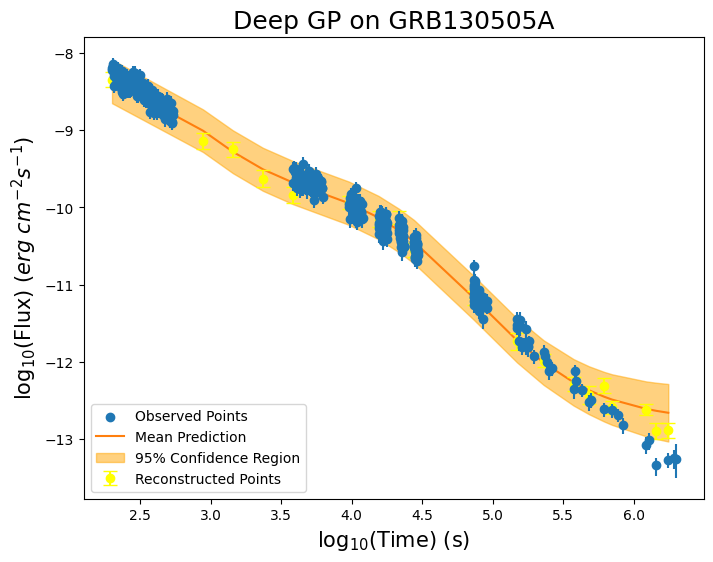


-----TRAINING FOR GRB131030A-----


-----ORIGINAL GRB-----



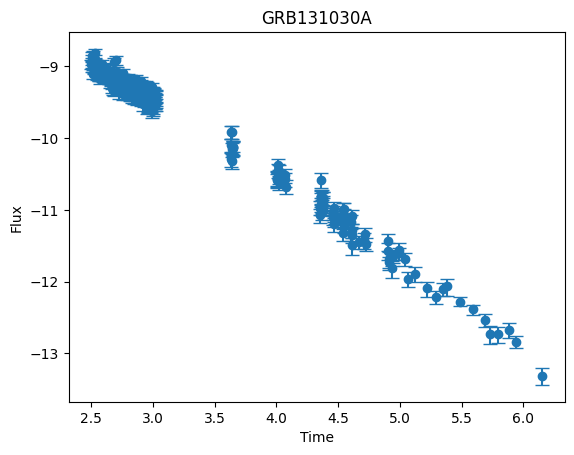


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.2868
Iteration 40/500 - Loss: 39.6549
Iteration 60/500 - Loss: 28.4269
Iteration 80/500 - Loss: 16.2297
Iteration 100/500 - Loss: 8.3244
Iteration 120/500 - Loss: 4.3903
Iteration 140/500 - Loss: 2.3264
Iteration 160/500 - Loss: 1.1739
Iteration 180/500 - Loss: 0.5017
Iteration 200/500 - Loss: 0.0935
Iteration 220/500 - Loss: -0.0538
Iteration 240/500 - Loss: -0.1665
Iteration 260/500 - Loss: -0.2607
Iteration 280/500 - Loss: -0.3397
Iteration 300/500 - Loss: -0.4058
Iteration 320/500 - Loss: -0.4616
Iteration 340/500 - Loss: -0.5084
Iteration 360/500 - Loss: -0.5471
Iteration 380/500 - Loss: -0.5812
Iteration 400/500 - Loss: -0.6094
Iteration 420/500 - Loss: -0.6229
Iteration 440/500 - Loss: -0.6346
Iteration 460/500 - Loss: -0.6455
Iteration 480/500 - Loss: -0.6559
Iteration 500/500 - Loss: -0.6656

-----RECONSTRUCTED GRB-----



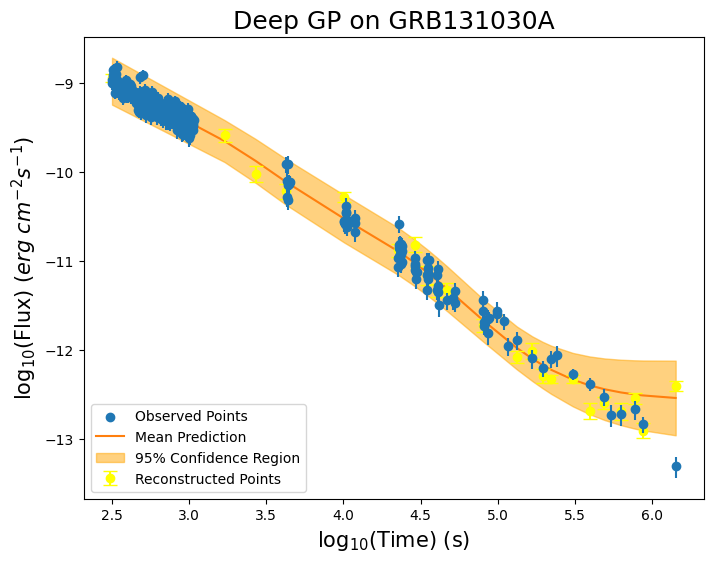


-----TRAINING FOR GRB150314A-----


-----ORIGINAL GRB-----



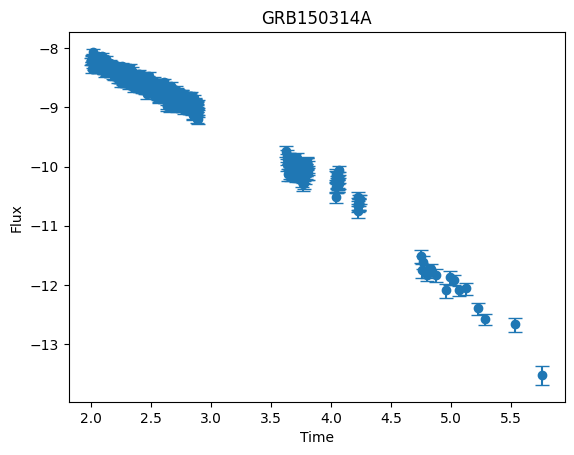


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.5520
Iteration 40/500 - Loss: 40.9538
Iteration 60/500 - Loss: 33.4020
Iteration 80/500 - Loss: 24.3622
Iteration 100/500 - Loss: 14.8030
Iteration 120/500 - Loss: 8.6551
Iteration 140/500 - Loss: 5.6559
Iteration 160/500 - Loss: 4.5377
Iteration 180/500 - Loss: 3.3862
Iteration 200/500 - Loss: 2.3760
Iteration 220/500 - Loss: 2.0287
Iteration 240/500 - Loss: 1.7623
Iteration 260/500 - Loss: 1.5261
Iteration 280/500 - Loss: 1.3100
Iteration 300/500 - Loss: 1.1098
Iteration 320/500 - Loss: 0.9236
Iteration 340/500 - Loss: 0.7510
Iteration 360/500 - Loss: 0.5921
Iteration 380/500 - Loss: 0.4476
Iteration 400/500 - Loss: 0.3173
Iteration 420/500 - Loss: 0.2549
Iteration 440/500 - Loss: 0.1988
Iteration 460/500 - Loss: 0.1456
Iteration 480/500 - Loss: 0.0954
Iteration 500/500 - Loss: 0.0480

-----RECONSTRUCTED GRB-----



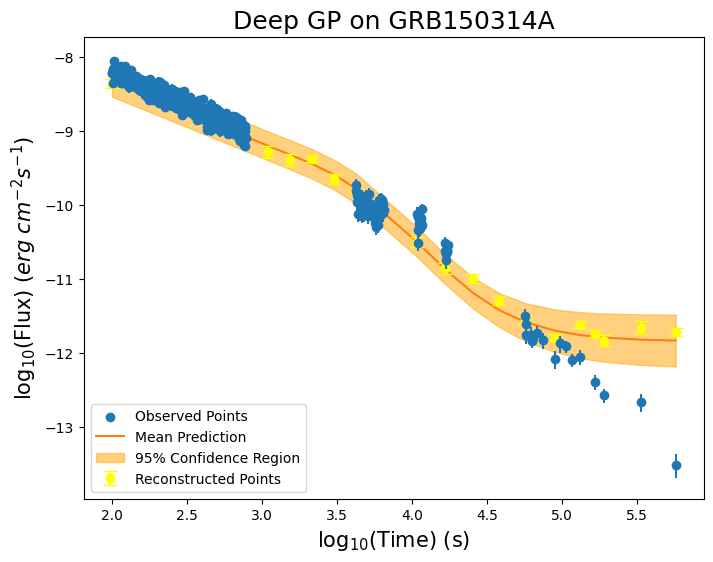


-----TRAINING FOR GRB150403A-----


-----ORIGINAL GRB-----



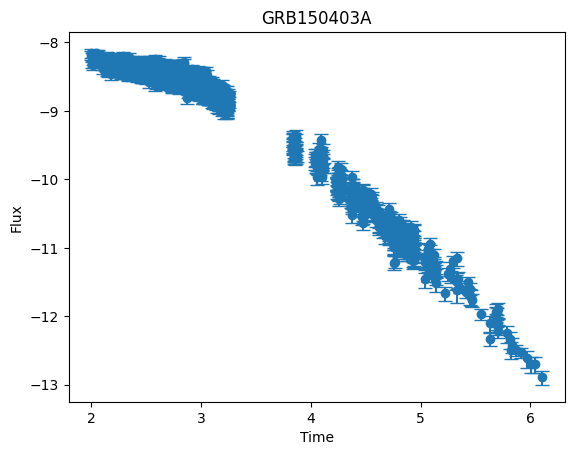


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.1689
Iteration 40/500 - Loss: 40.1091
Iteration 60/500 - Loss: 29.3810
Iteration 80/500 - Loss: 17.4698
Iteration 100/500 - Loss: 8.9714
Iteration 120/500 - Loss: 5.3392
Iteration 140/500 - Loss: 3.3068
Iteration 160/500 - Loss: 2.0220
Iteration 180/500 - Loss: 1.1395
Iteration 200/500 - Loss: 0.5061
Iteration 220/500 - Loss: 0.2295
Iteration 240/500 - Loss: 0.0460
Iteration 260/500 - Loss: -0.0929
Iteration 280/500 - Loss: -0.1973
Iteration 300/500 - Loss: -0.2763
Iteration 320/500 - Loss: -0.3409
Iteration 340/500 - Loss: -0.3939
Iteration 360/500 - Loss: -0.4372
Iteration 380/500 - Loss: -0.4771
Iteration 400/500 - Loss: -0.5136
Iteration 420/500 - Loss: -0.5304
Iteration 440/500 - Loss: -0.5455
Iteration 460/500 - Loss: -0.5599
Iteration 480/500 - Loss: -0.5738
Iteration 500/500 - Loss: -0.5870

-----RECONSTRUCTED GRB-----



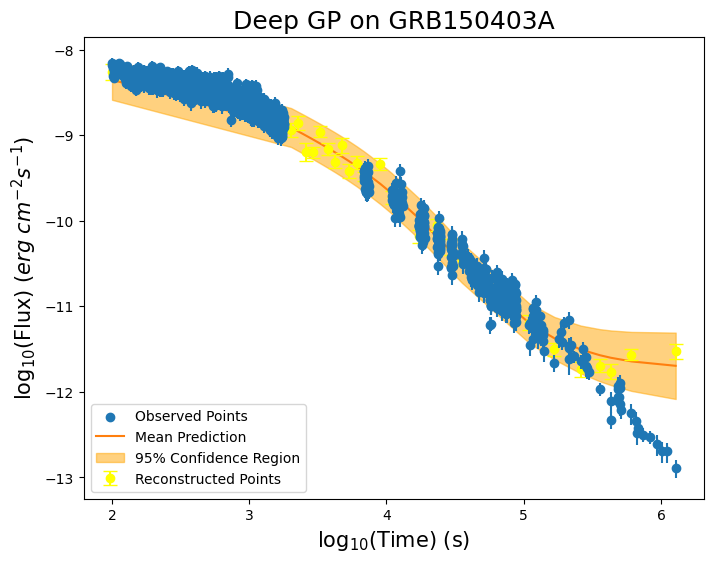


-----TRAINING FOR GRB150821A-----


-----ORIGINAL GRB-----



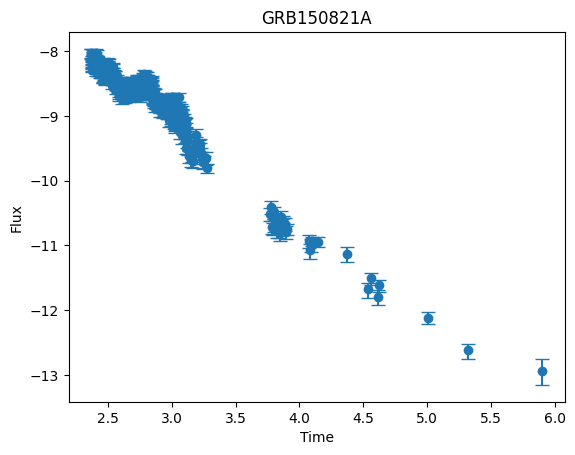


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.4715
Iteration 40/500 - Loss: 41.1248
Iteration 60/500 - Loss: 34.1561
Iteration 80/500 - Loss: 25.9874
Iteration 100/500 - Loss: 17.4960
Iteration 120/500 - Loss: 9.9496
Iteration 140/500 - Loss: 5.0646
Iteration 160/500 - Loss: 2.9690
Iteration 180/500 - Loss: 2.1822
Iteration 200/500 - Loss: 1.8416
Iteration 220/500 - Loss: 1.7315
Iteration 240/500 - Loss: 1.6592
Iteration 260/500 - Loss: 1.5995
Iteration 280/500 - Loss: 1.5483
Iteration 300/500 - Loss: 1.5033
Iteration 320/500 - Loss: 1.4633
Iteration 340/500 - Loss: 1.4272
Iteration 360/500 - Loss: 1.3944
Iteration 380/500 - Loss: 1.3645
Iteration 400/500 - Loss: 1.3362
Iteration 420/500 - Loss: 1.3221
Iteration 440/500 - Loss: 1.3087
Iteration 460/500 - Loss: 1.2957
Iteration 480/500 - Loss: 1.2830
Iteration 500/500 - Loss: 1.2703

-----RECONSTRUCTED GRB-----



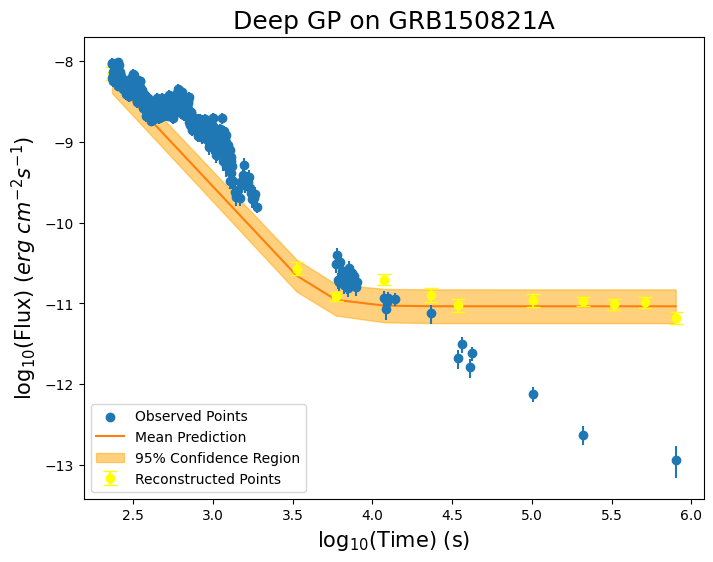


-----TRAINING FOR GRB151021A-----


-----ORIGINAL GRB-----



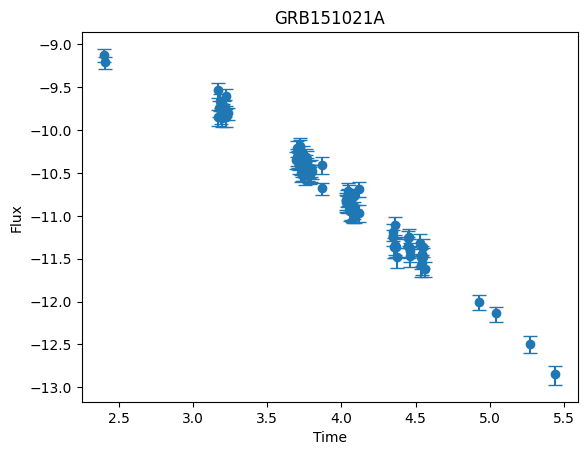


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.5175
Iteration 40/500 - Loss: 33.0353
Iteration 60/500 - Loss: 18.9630
Iteration 80/500 - Loss: 10.9942
Iteration 100/500 - Loss: 7.0066
Iteration 120/500 - Loss: 5.1897
Iteration 140/500 - Loss: 3.8365
Iteration 160/500 - Loss: 2.7313
Iteration 180/500 - Loss: 1.9205
Iteration 200/500 - Loss: 1.3389
Iteration 220/500 - Loss: 1.1205
Iteration 240/500 - Loss: 0.9488
Iteration 260/500 - Loss: 0.8026
Iteration 280/500 - Loss: 0.6752
Iteration 300/500 - Loss: 0.5650
Iteration 320/500 - Loss: 0.4658
Iteration 340/500 - Loss: 0.3814
Iteration 360/500 - Loss: 0.3023
Iteration 380/500 - Loss: 0.2328
Iteration 400/500 - Loss: 0.1716
Iteration 420/500 - Loss: 0.1418
Iteration 440/500 - Loss: 0.1151
Iteration 460/500 - Loss: 0.0894
Iteration 480/500 - Loss: 0.0649
Iteration 500/500 - Loss: 0.0414

-----RECONSTRUCTED GRB-----



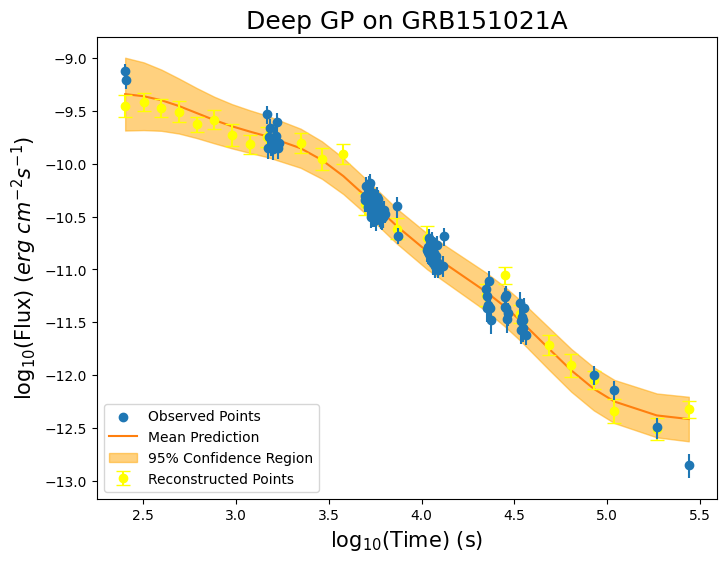


-----TRAINING FOR GRB151027A-----


-----ORIGINAL GRB-----



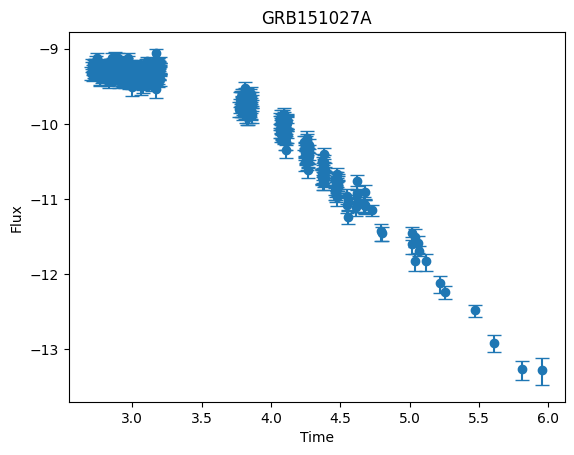


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.6286
Iteration 40/500 - Loss: 40.5221
Iteration 60/500 - Loss: 31.9172
Iteration 80/500 - Loss: 21.7086
Iteration 100/500 - Loss: 12.3426
Iteration 120/500 - Loss: 7.1556
Iteration 140/500 - Loss: 4.0227
Iteration 160/500 - Loss: 2.5106
Iteration 180/500 - Loss: 1.7012
Iteration 200/500 - Loss: 1.2031
Iteration 220/500 - Loss: 1.0118
Iteration 240/500 - Loss: 0.8579
Iteration 260/500 - Loss: 0.7237
Iteration 280/500 - Loss: 0.6066
Iteration 300/500 - Loss: 0.5044
Iteration 320/500 - Loss: 0.4148
Iteration 340/500 - Loss: 0.3365
Iteration 360/500 - Loss: 0.2674
Iteration 380/500 - Loss: 0.2106
Iteration 400/500 - Loss: 0.1518
Iteration 420/500 - Loss: 0.1248
Iteration 440/500 - Loss: 0.1008
Iteration 460/500 - Loss: 0.0776
Iteration 480/500 - Loss: 0.0554
Iteration 500/500 - Loss: 0.0339

-----RECONSTRUCTED GRB-----



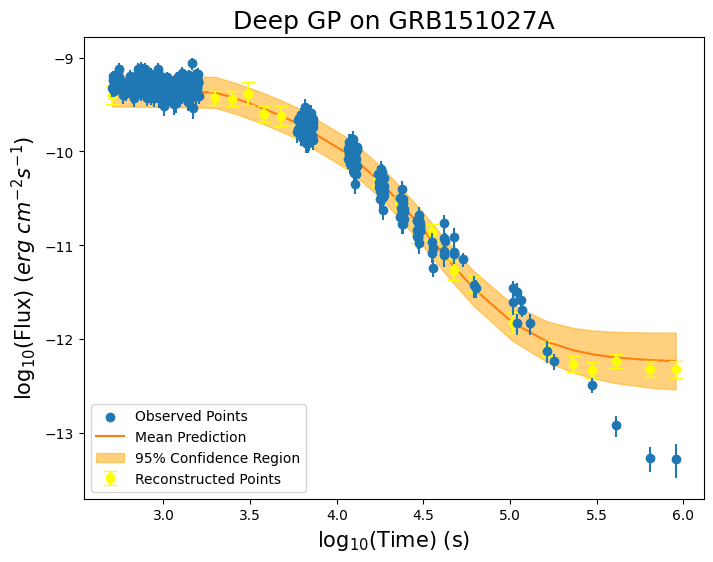


-----TRAINING FOR GRB180720B-----


-----ORIGINAL GRB-----



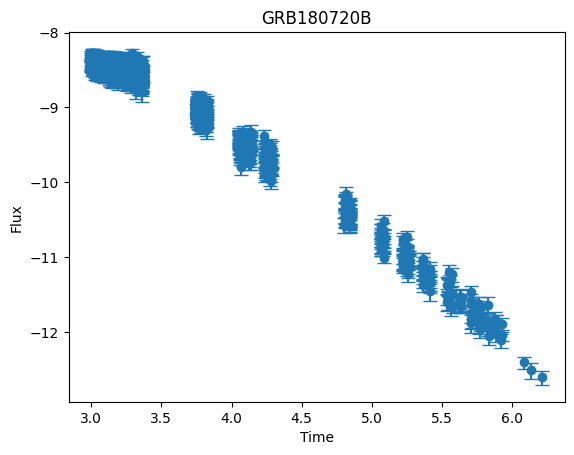


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 54.0828
Iteration 40/500 - Loss: 41.8043
Iteration 60/500 - Loss: 31.6449
Iteration 80/500 - Loss: 21.1665
Iteration 100/500 - Loss: 12.7790
Iteration 120/500 - Loss: 7.2442
Iteration 140/500 - Loss: 4.0050
Iteration 160/500 - Loss: 2.2832
Iteration 180/500 - Loss: 1.3471
Iteration 200/500 - Loss: 0.7952
Iteration 220/500 - Loss: 0.5833
Iteration 240/500 - Loss: 0.4143
Iteration 260/500 - Loss: 0.2657
Iteration 280/500 - Loss: 0.1344
Iteration 300/500 - Loss: 0.0188
Iteration 320/500 - Loss: -0.0825
Iteration 340/500 - Loss: -0.1716
Iteration 360/500 - Loss: -0.2489
Iteration 380/500 - Loss: -0.3161
Iteration 400/500 - Loss: -0.3742
Iteration 420/500 - Loss: -0.4015
Iteration 440/500 - Loss: -0.4257
Iteration 460/500 - Loss: -0.4485
Iteration 480/500 - Loss: -0.4699
Iteration 500/500 - Loss: -0.4901

-----RECONSTRUCTED GRB-----



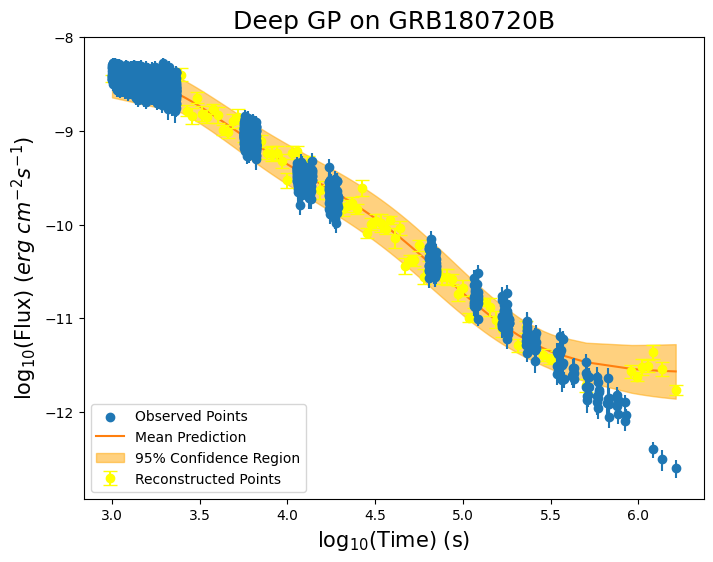


-----TRAINING FOR GRB050904-----


-----ORIGINAL GRB-----



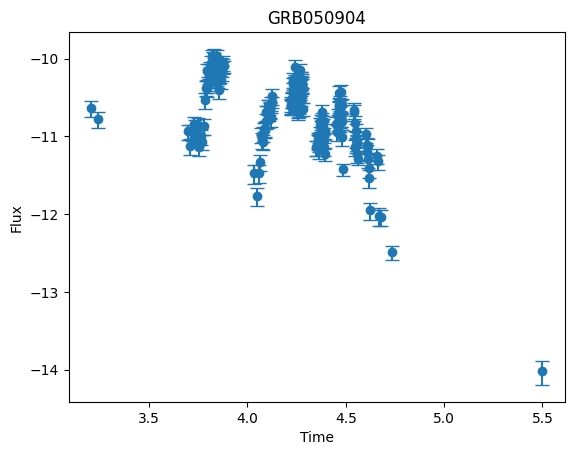


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.9619
Iteration 40/500 - Loss: 41.8318
Iteration 60/500 - Loss: 33.4482
Iteration 80/500 - Loss: 26.4747
Iteration 100/500 - Loss: 21.8979
Iteration 120/500 - Loss: 18.9129
Iteration 140/500 - Loss: 17.1243
Iteration 160/500 - Loss: 15.9823
Iteration 180/500 - Loss: 15.0133
Iteration 200/500 - Loss: 13.7451
Iteration 220/500 - Loss: 12.8807
Iteration 240/500 - Loss: 11.8087
Iteration 260/500 - Loss: 10.3435
Iteration 280/500 - Loss: 8.6951
Iteration 300/500 - Loss: 7.4918
Iteration 320/500 - Loss: 6.7332
Iteration 340/500 - Loss: 6.2481
Iteration 360/500 - Loss: 5.8704
Iteration 380/500 - Loss: 5.5448
Iteration 400/500 - Loss: 5.2675
Iteration 420/500 - Loss: 5.1310
Iteration 440/500 - Loss: 5.0118
Iteration 460/500 - Loss: 4.8988
Iteration 480/500 - Loss: 4.7911
Iteration 500/500 - Loss: 4.6883

-----RECONSTRUCTED GRB-----



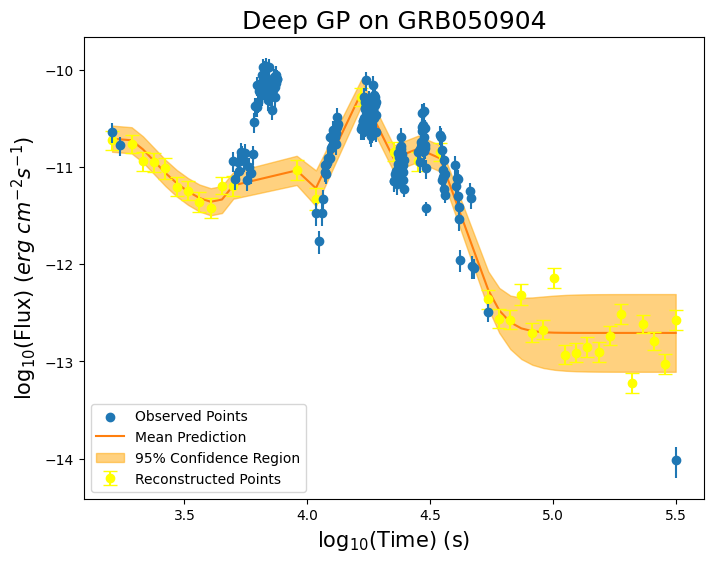


-----TRAINING FOR GRB090423-----


-----ORIGINAL GRB-----



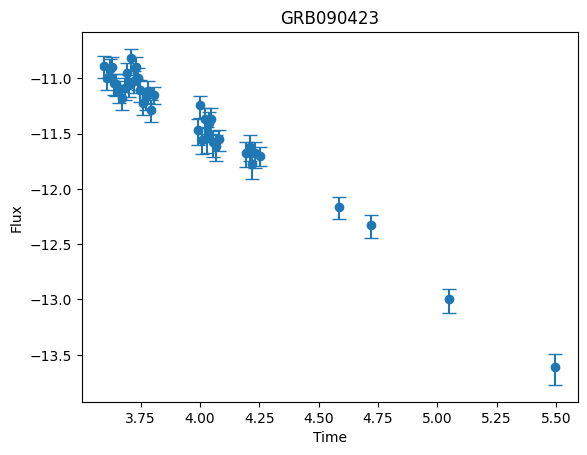


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.2160
Iteration 40/500 - Loss: 39.0501
Iteration 60/500 - Loss: 26.6473
Iteration 80/500 - Loss: 15.0964
Iteration 100/500 - Loss: 7.9435
Iteration 120/500 - Loss: 4.9666
Iteration 140/500 - Loss: 2.9303
Iteration 160/500 - Loss: 1.9638
Iteration 180/500 - Loss: 1.4679
Iteration 200/500 - Loss: 1.3348
Iteration 220/500 - Loss: 1.1276
Iteration 240/500 - Loss: 0.9782
Iteration 260/500 - Loss: 0.8672
Iteration 280/500 - Loss: 0.7653
Iteration 300/500 - Loss: 0.6698
Iteration 320/500 - Loss: 0.5820
Iteration 340/500 - Loss: 0.5033
Iteration 360/500 - Loss: 0.4349
Iteration 380/500 - Loss: 0.3773
Iteration 400/500 - Loss: 0.3304
Iteration 420/500 - Loss: 0.3101
Iteration 440/500 - Loss: 0.2929
Iteration 460/500 - Loss: 0.2777
Iteration 480/500 - Loss: 0.2641
Iteration 500/500 - Loss: 0.2522

-----RECONSTRUCTED GRB-----



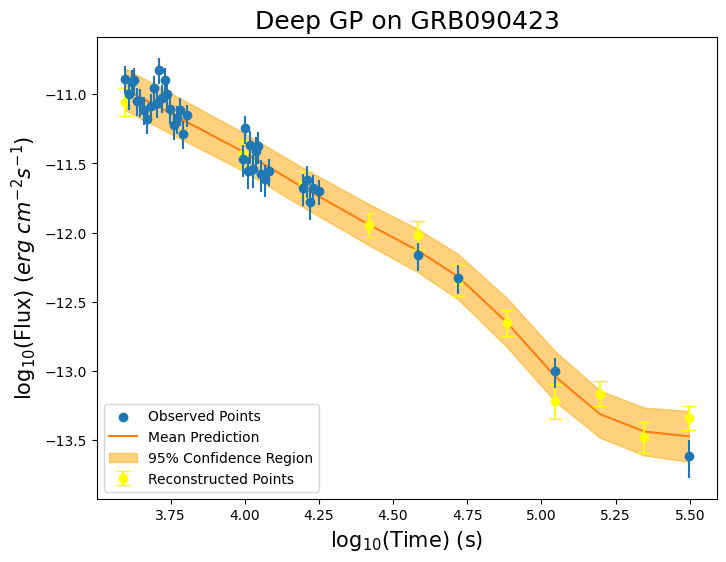


-----TRAINING FOR GRB090429B-----


-----ORIGINAL GRB-----



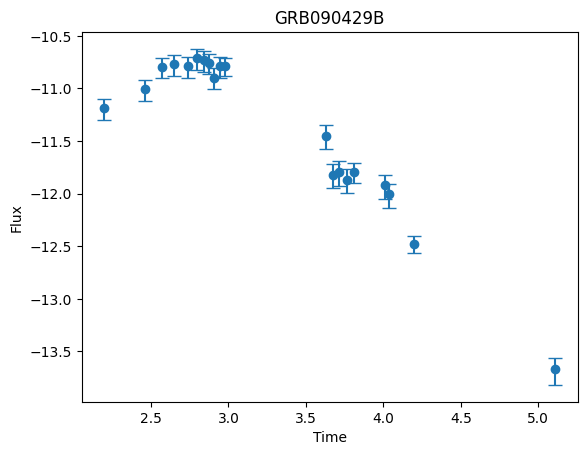


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.0834
Iteration 40/500 - Loss: 35.2831
Iteration 60/500 - Loss: 21.7603
Iteration 80/500 - Loss: 12.0778
Iteration 100/500 - Loss: 7.3410
Iteration 120/500 - Loss: 4.6043
Iteration 140/500 - Loss: 2.7549
Iteration 160/500 - Loss: 1.5430
Iteration 180/500 - Loss: 0.8499
Iteration 200/500 - Loss: 0.4985
Iteration 220/500 - Loss: 0.3931
Iteration 240/500 - Loss: 0.3186
Iteration 260/500 - Loss: 0.2587
Iteration 280/500 - Loss: 0.2094
Iteration 300/500 - Loss: 0.1677
Iteration 320/500 - Loss: 0.1320
Iteration 340/500 - Loss: 0.1008
Iteration 360/500 - Loss: 0.0734
Iteration 380/500 - Loss: 0.0491
Iteration 400/500 - Loss: 0.0274
Iteration 420/500 - Loss: 0.0169
Iteration 440/500 - Loss: 0.0074
Iteration 460/500 - Loss: -0.0018
Iteration 480/500 - Loss: -0.0105
Iteration 500/500 - Loss: -0.0190

-----RECONSTRUCTED GRB-----



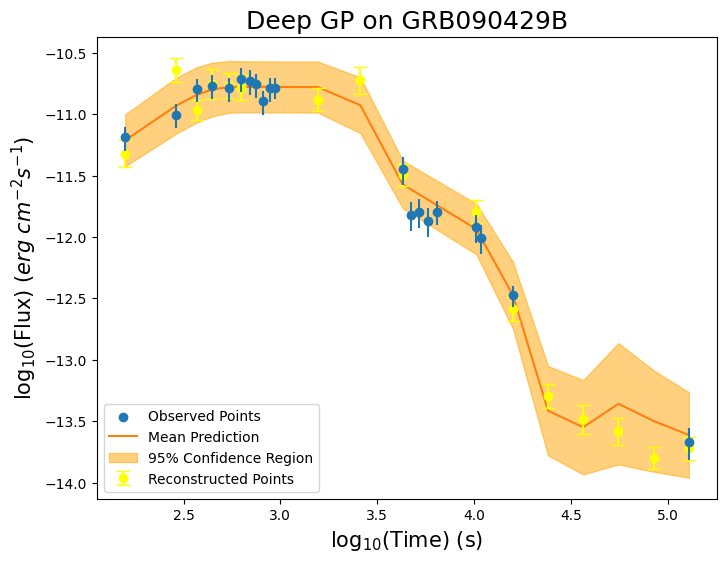


-----TRAINING FOR GRB170405A-----


-----ORIGINAL GRB-----



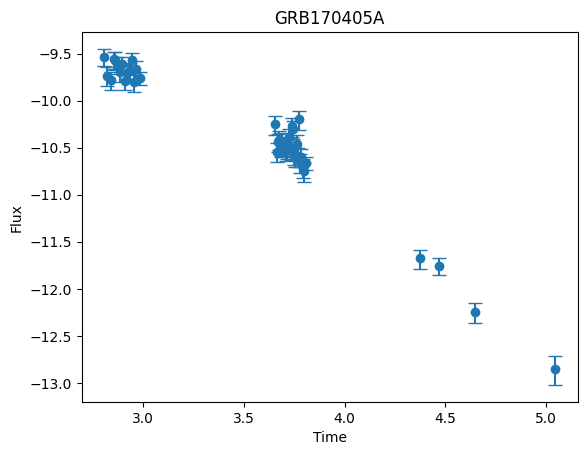


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.9006
Iteration 40/500 - Loss: 42.6717
Iteration 60/500 - Loss: 34.1062
Iteration 80/500 - Loss: 21.6329
Iteration 100/500 - Loss: 12.6419
Iteration 120/500 - Loss: 8.0504
Iteration 140/500 - Loss: 5.1658
Iteration 160/500 - Loss: 3.3640
Iteration 180/500 - Loss: 2.2887
Iteration 200/500 - Loss: 1.6371
Iteration 220/500 - Loss: 1.4010
Iteration 240/500 - Loss: 1.2180
Iteration 260/500 - Loss: 1.0627
Iteration 280/500 - Loss: 0.9295
Iteration 300/500 - Loss: 0.8143
Iteration 320/500 - Loss: 0.7142
Iteration 340/500 - Loss: 0.6270
Iteration 360/500 - Loss: 0.5508
Iteration 380/500 - Loss: 0.4842
Iteration 400/500 - Loss: 0.4261
Iteration 420/500 - Loss: 0.3989
Iteration 440/500 - Loss: 0.3745
Iteration 460/500 - Loss: 0.3517
Iteration 480/500 - Loss: 0.3300
Iteration 500/500 - Loss: 0.3098

-----RECONSTRUCTED GRB-----



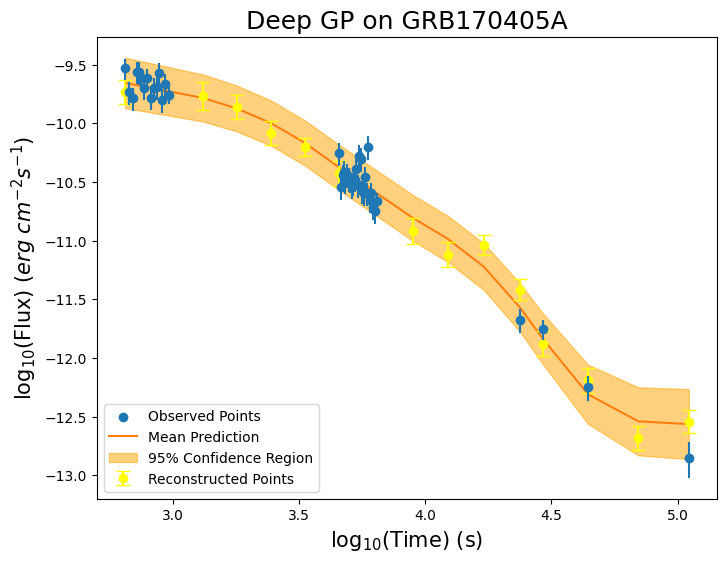


-----TRAINING FOR GRB170714A-----


-----ORIGINAL GRB-----



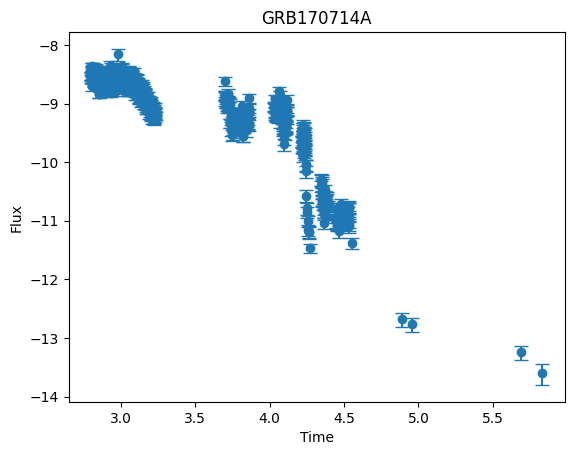


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.9083
Iteration 40/500 - Loss: 41.9640
Iteration 60/500 - Loss: 33.6610
Iteration 80/500 - Loss: 24.9252
Iteration 100/500 - Loss: 19.3158
Iteration 120/500 - Loss: 16.3081
Iteration 140/500 - Loss: 14.7191
Iteration 160/500 - Loss: 13.7360
Iteration 180/500 - Loss: 13.0482
Iteration 200/500 - Loss: 12.5094
Iteration 220/500 - Loss: 12.2562
Iteration 240/500 - Loss: 12.0170
Iteration 260/500 - Loss: 11.7675
Iteration 280/500 - Loss: 11.4893
Iteration 300/500 - Loss: 11.1373
Iteration 320/500 - Loss: 10.5852
Iteration 340/500 - Loss: 9.5680
Iteration 360/500 - Loss: 8.0029
Iteration 380/500 - Loss: 6.3228
Iteration 400/500 - Loss: 4.9720
Iteration 420/500 - Loss: 4.4046
Iteration 440/500 - Loss: 3.9338
Iteration 460/500 - Loss: 3.5202
Iteration 480/500 - Loss: 3.1587
Iteration 500/500 - Loss: 2.8449

-----RECONSTRUCTED GRB-----



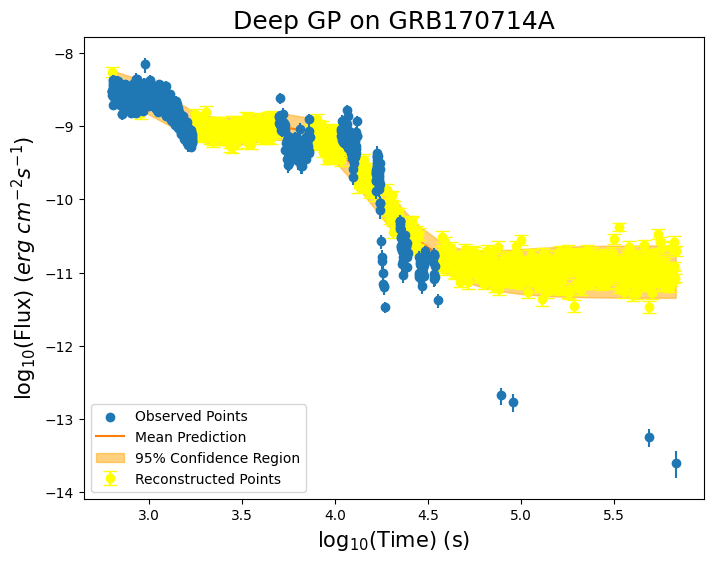


-----TRAINING FOR GRB180624A-----


-----ORIGINAL GRB-----



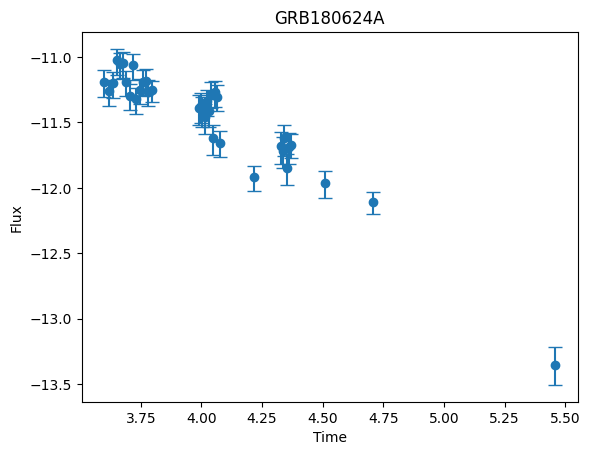


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.4427
Iteration 40/500 - Loss: 37.9647
Iteration 60/500 - Loss: 25.4652
Iteration 80/500 - Loss: 14.4658
Iteration 100/500 - Loss: 10.2313
Iteration 120/500 - Loss: 7.4283
Iteration 140/500 - Loss: 5.4271
Iteration 160/500 - Loss: 4.0182
Iteration 180/500 - Loss: 3.0775
Iteration 200/500 - Loss: 2.4803
Iteration 220/500 - Loss: 2.2718
Iteration 240/500 - Loss: 2.1202
Iteration 260/500 - Loss: 2.0013
Iteration 280/500 - Loss: 1.9084
Iteration 300/500 - Loss: 1.8364
Iteration 320/500 - Loss: 1.7803
Iteration 340/500 - Loss: 1.7364
Iteration 360/500 - Loss: 1.7016
Iteration 380/500 - Loss: 1.6735
Iteration 400/500 - Loss: 1.6503
Iteration 420/500 - Loss: 1.6395
Iteration 440/500 - Loss: 1.6300
Iteration 460/500 - Loss: 1.6209
Iteration 480/500 - Loss: 1.6122
Iteration 500/500 - Loss: 1.6040

-----RECONSTRUCTED GRB-----



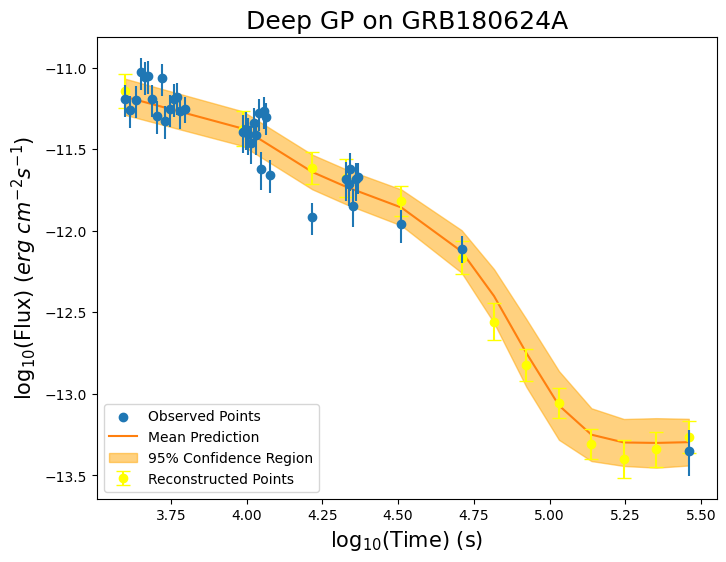


-----TRAINING FOR GRB070223-----


-----ORIGINAL GRB-----



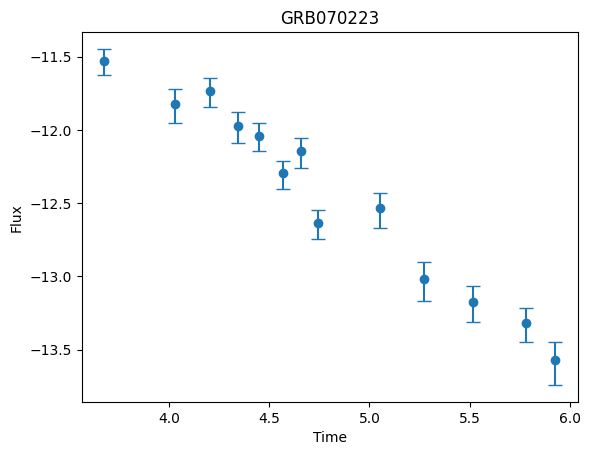


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 57.3510
Iteration 40/500 - Loss: 40.3767
Iteration 60/500 - Loss: 25.6844
Iteration 80/500 - Loss: 13.1826
Iteration 100/500 - Loss: 7.3359
Iteration 120/500 - Loss: 4.8657
Iteration 140/500 - Loss: 3.4856
Iteration 160/500 - Loss: 2.6950
Iteration 180/500 - Loss: 2.1922
Iteration 200/500 - Loss: 1.8339
Iteration 220/500 - Loss: 1.6716
Iteration 240/500 - Loss: 1.5167
Iteration 260/500 - Loss: 1.3569
Iteration 280/500 - Loss: 1.2023
Iteration 300/500 - Loss: 1.0650
Iteration 320/500 - Loss: 0.9479
Iteration 340/500 - Loss: 0.8409
Iteration 360/500 - Loss: 0.7343
Iteration 380/500 - Loss: 0.6322
Iteration 400/500 - Loss: 0.5480
Iteration 420/500 - Loss: 0.5126
Iteration 440/500 - Loss: 0.4836
Iteration 460/500 - Loss: 0.4584
Iteration 480/500 - Loss: 0.4363
Iteration 500/500 - Loss: 0.4166

-----RECONSTRUCTED GRB-----



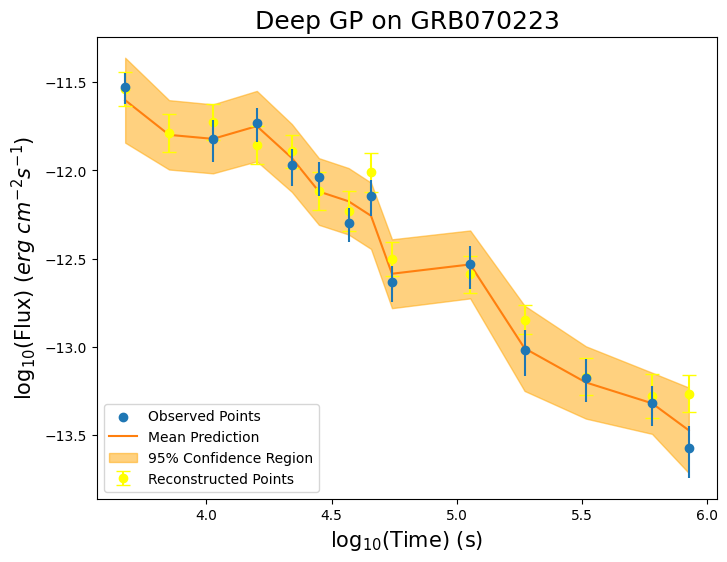


-----TRAINING FOR GRB111209A-----


-----ORIGINAL GRB-----



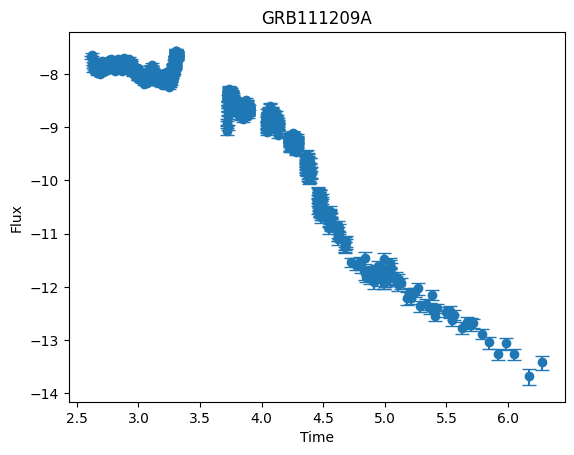


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 67.6741
Iteration 40/500 - Loss: 47.8437
Iteration 60/500 - Loss: 34.2808
Iteration 80/500 - Loss: 23.7585
Iteration 100/500 - Loss: 15.4707
Iteration 120/500 - Loss: 9.6201
Iteration 140/500 - Loss: 6.3227
Iteration 160/500 - Loss: 3.4461
Iteration 180/500 - Loss: 1.6292
Iteration 200/500 - Loss: 1.4055
Iteration 220/500 - Loss: 0.5107
Iteration 240/500 - Loss: 0.2393
Iteration 260/500 - Loss: 0.0469
Iteration 280/500 - Loss: -0.0793
Iteration 300/500 - Loss: -0.1617
Iteration 320/500 - Loss: -0.2161
Iteration 340/500 - Loss: -0.2531
Iteration 360/500 - Loss: -0.2792
Iteration 380/500 - Loss: -0.2982
Iteration 400/500 - Loss: -0.3127
Iteration 420/500 - Loss: -0.3189
Iteration 440/500 - Loss: -0.3243
Iteration 460/500 - Loss: -0.3292
Iteration 480/500 - Loss: -0.3336
Iteration 500/500 - Loss: -0.3378

-----RECONSTRUCTED GRB-----



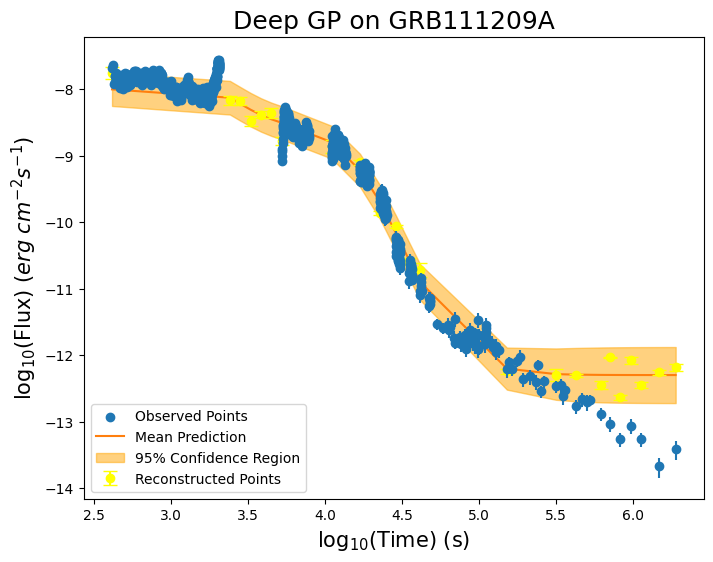


-----TRAINING FOR GRB121229A-----


-----ORIGINAL GRB-----



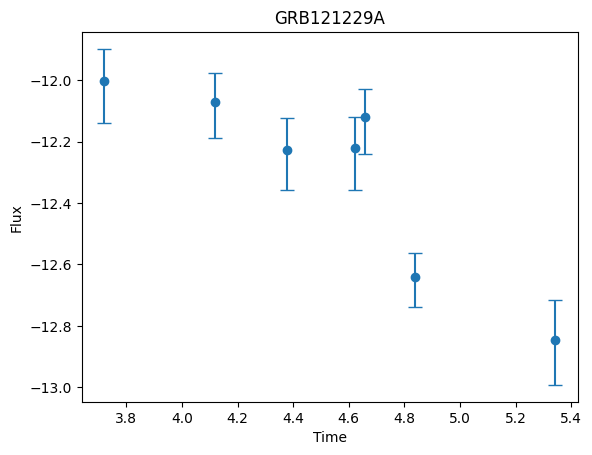


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 63.7508
Iteration 40/500 - Loss: 46.0476
Iteration 60/500 - Loss: 30.2134
Iteration 80/500 - Loss: 19.4450
Iteration 100/500 - Loss: 11.4383
Iteration 120/500 - Loss: 6.5436
Iteration 140/500 - Loss: 4.3586
Iteration 160/500 - Loss: 2.9566
Iteration 180/500 - Loss: 1.7812
Iteration 200/500 - Loss: 1.3545
Iteration 220/500 - Loss: 1.2305
Iteration 240/500 - Loss: 1.1393
Iteration 260/500 - Loss: 1.0619
Iteration 280/500 - Loss: 0.9951
Iteration 300/500 - Loss: 0.9372
Iteration 320/500 - Loss: 0.8869
Iteration 340/500 - Loss: 0.8430
Iteration 360/500 - Loss: 0.8046
Iteration 380/500 - Loss: 0.7708
Iteration 400/500 - Loss: 0.7409
Iteration 420/500 - Loss: 0.7266
Iteration 440/500 - Loss: 0.7137
Iteration 460/500 - Loss: 0.7013
Iteration 480/500 - Loss: 0.6895
Iteration 500/500 - Loss: 0.6782

-----RECONSTRUCTED GRB-----



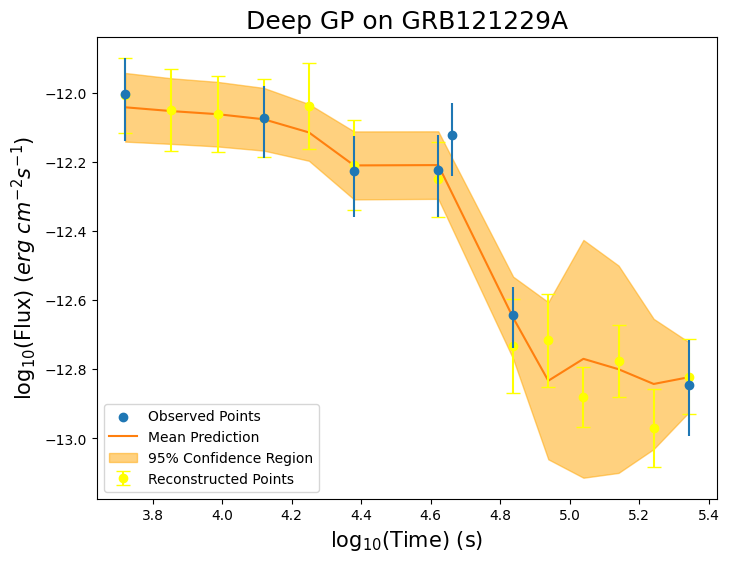


-----TRAINING FOR GRB050318-----


-----ORIGINAL GRB-----



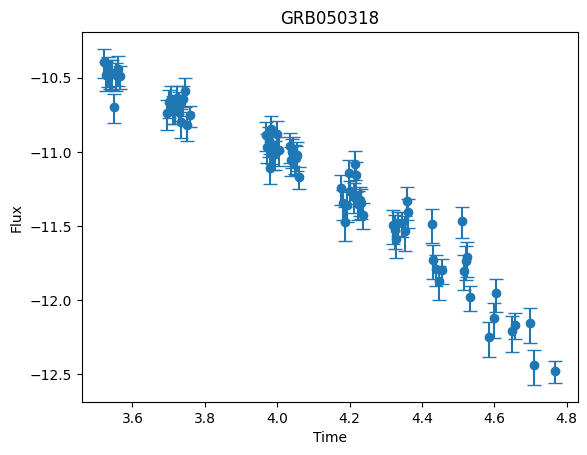


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.6390
Iteration 40/500 - Loss: 33.9160
Iteration 60/500 - Loss: 17.4451
Iteration 80/500 - Loss: 7.8200
Iteration 100/500 - Loss: 3.6712
Iteration 120/500 - Loss: 2.2217
Iteration 140/500 - Loss: 1.6465
Iteration 160/500 - Loss: 1.3731
Iteration 180/500 - Loss: 1.2191
Iteration 200/500 - Loss: 1.1214
Iteration 220/500 - Loss: 1.0835
Iteration 240/500 - Loss: 1.0526
Iteration 260/500 - Loss: 1.0251
Iteration 280/500 - Loss: 1.0004
Iteration 300/500 - Loss: 0.9778
Iteration 320/500 - Loss: 0.9571
Iteration 340/500 - Loss: 0.9381
Iteration 360/500 - Loss: 0.9204
Iteration 380/500 - Loss: 0.9039
Iteration 400/500 - Loss: 0.8882
Iteration 420/500 - Loss: 0.8803
Iteration 440/500 - Loss: 0.8729
Iteration 460/500 - Loss: 0.8654
Iteration 480/500 - Loss: 0.8580
Iteration 500/500 - Loss: 0.8506

-----RECONSTRUCTED GRB-----



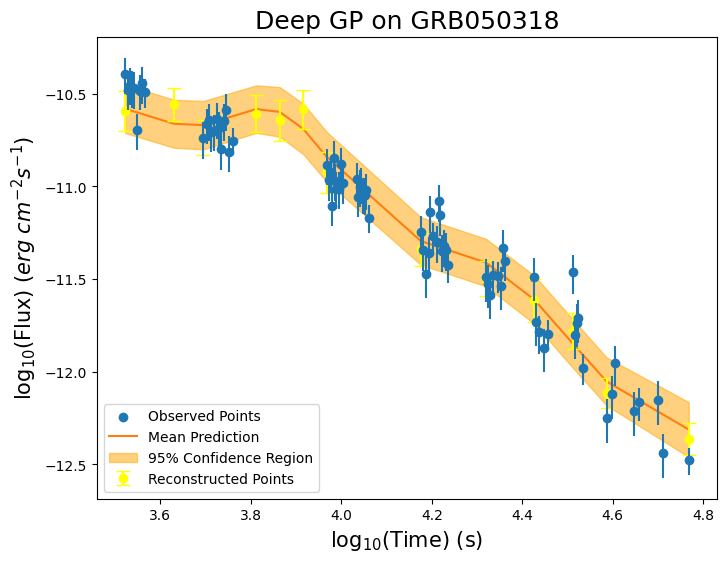


-----TRAINING FOR GRB050505-----


-----ORIGINAL GRB-----



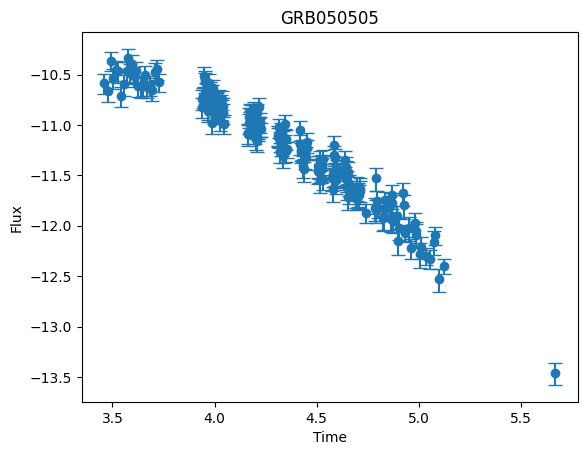


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.8829
Iteration 40/500 - Loss: 38.7544
Iteration 60/500 - Loss: 23.1844
Iteration 80/500 - Loss: 11.5577
Iteration 100/500 - Loss: 6.2020
Iteration 120/500 - Loss: 3.8826
Iteration 140/500 - Loss: 2.8083
Iteration 160/500 - Loss: 2.2571
Iteration 180/500 - Loss: 1.8587
Iteration 200/500 - Loss: 1.5732
Iteration 220/500 - Loss: 1.4396
Iteration 240/500 - Loss: 1.3383
Iteration 260/500 - Loss: 1.2529
Iteration 280/500 - Loss: 1.1761
Iteration 300/500 - Loss: 1.1060
Iteration 320/500 - Loss: 1.0414
Iteration 340/500 - Loss: 0.9823
Iteration 360/500 - Loss: 0.9278
Iteration 380/500 - Loss: 0.8763
Iteration 400/500 - Loss: 0.8300
Iteration 420/500 - Loss: 0.8046
Iteration 440/500 - Loss: 0.7827
Iteration 460/500 - Loss: 0.7614
Iteration 480/500 - Loss: 0.7406
Iteration 500/500 - Loss: 0.7203

-----RECONSTRUCTED GRB-----



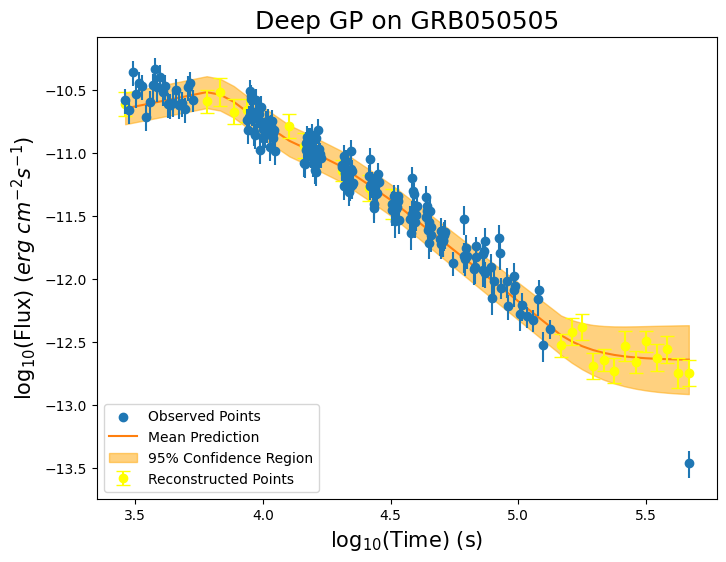


-----TRAINING FOR GRB071020-----


-----ORIGINAL GRB-----



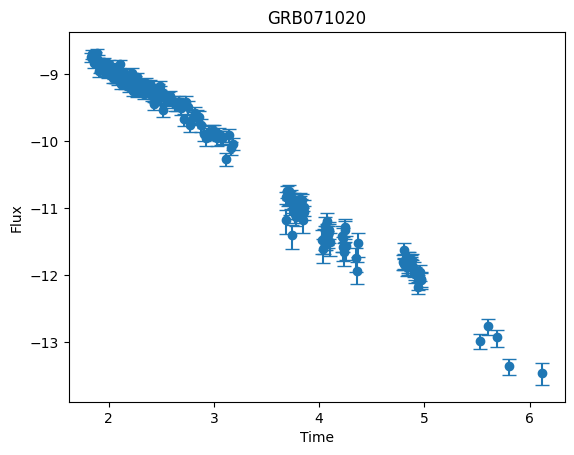


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.1607
Iteration 40/500 - Loss: 39.3254
Iteration 60/500 - Loss: 26.5866
Iteration 80/500 - Loss: 12.8979
Iteration 100/500 - Loss: 4.8899
Iteration 120/500 - Loss: 2.8964
Iteration 140/500 - Loss: 1.1422
Iteration 160/500 - Loss: 0.6619
Iteration 180/500 - Loss: 0.5050
Iteration 200/500 - Loss: 0.3964
Iteration 220/500 - Loss: 0.3490
Iteration 240/500 - Loss: 0.3078
Iteration 260/500 - Loss: 0.2693
Iteration 280/500 - Loss: 0.2332
Iteration 300/500 - Loss: 0.1991
Iteration 320/500 - Loss: 0.1668
Iteration 340/500 - Loss: 0.1360
Iteration 360/500 - Loss: 0.1065
Iteration 380/500 - Loss: 0.0780
Iteration 400/500 - Loss: 0.0504
Iteration 420/500 - Loss: 0.0361
Iteration 440/500 - Loss: 0.0225
Iteration 460/500 - Loss: 0.0089
Iteration 480/500 - Loss: -0.0049
Iteration 500/500 - Loss: -0.0187

-----RECONSTRUCTED GRB-----



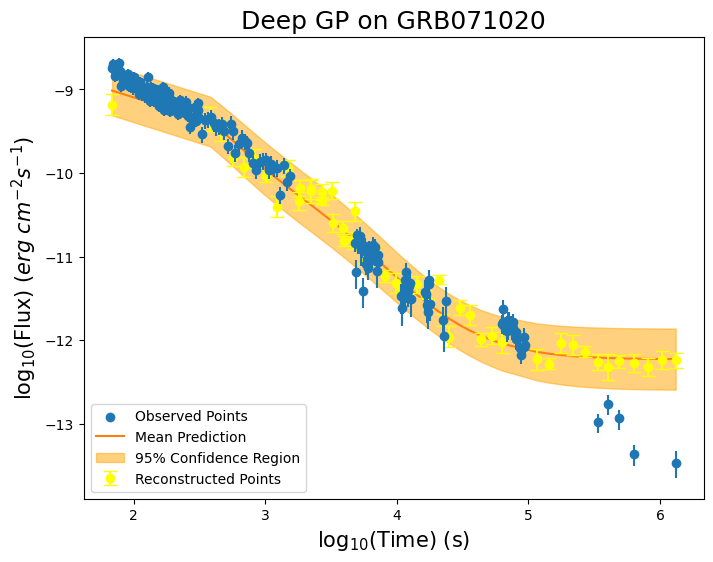


-----TRAINING FOR GRB071117-----


-----ORIGINAL GRB-----



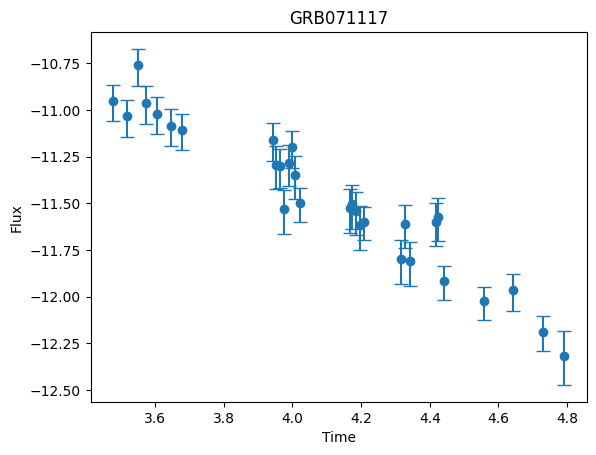


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.7620
Iteration 40/500 - Loss: 27.4406
Iteration 60/500 - Loss: 13.4063
Iteration 80/500 - Loss: 7.9157
Iteration 100/500 - Loss: 5.0392
Iteration 120/500 - Loss: 3.5963
Iteration 140/500 - Loss: 2.9010
Iteration 160/500 - Loss: 2.5408
Iteration 180/500 - Loss: 2.2930
Iteration 200/500 - Loss: 2.1105
Iteration 220/500 - Loss: 2.0512
Iteration 240/500 - Loss: 2.0099
Iteration 260/500 - Loss: 1.9772
Iteration 280/500 - Loss: 1.9495
Iteration 300/500 - Loss: 1.9249
Iteration 320/500 - Loss: 1.9025
Iteration 340/500 - Loss: 1.8817
Iteration 360/500 - Loss: 1.8619
Iteration 380/500 - Loss: 1.8430
Iteration 400/500 - Loss: 1.8244
Iteration 420/500 - Loss: 1.8146
Iteration 440/500 - Loss: 1.8051
Iteration 460/500 - Loss: 1.7952
Iteration 480/500 - Loss: 1.7847
Iteration 500/500 - Loss: 1.7735

-----RECONSTRUCTED GRB-----



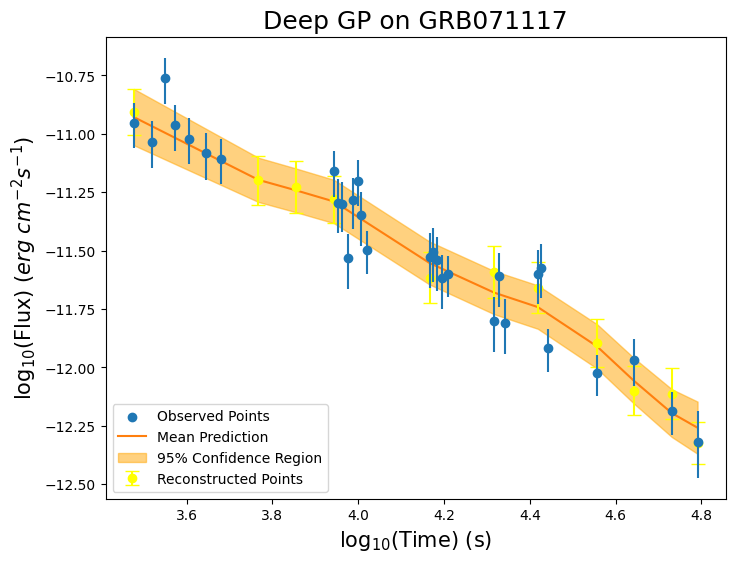


-----TRAINING FOR GRB050820A-----


-----ORIGINAL GRB-----



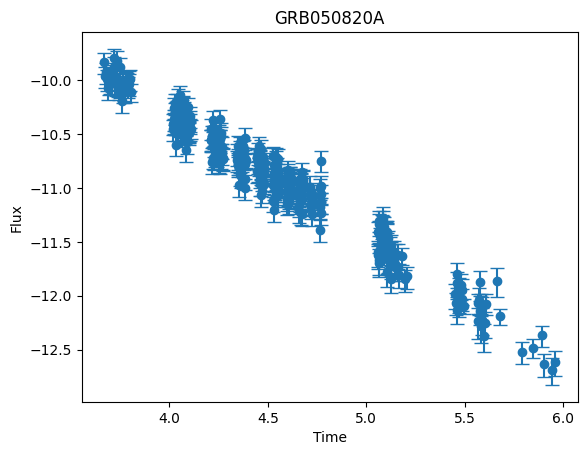


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 62.7423
Iteration 40/500 - Loss: 43.7285
Iteration 60/500 - Loss: 31.9548
Iteration 80/500 - Loss: 20.3447
Iteration 100/500 - Loss: 10.9300
Iteration 120/500 - Loss: 5.9226
Iteration 140/500 - Loss: 3.5341
Iteration 160/500 - Loss: 2.4503
Iteration 180/500 - Loss: 1.8745
Iteration 200/500 - Loss: 1.4226
Iteration 220/500 - Loss: 1.2450
Iteration 240/500 - Loss: 1.1056
Iteration 260/500 - Loss: 0.9836
Iteration 280/500 - Loss: 0.8795
Iteration 300/500 - Loss: 0.7911
Iteration 320/500 - Loss: 0.7165
Iteration 340/500 - Loss: 0.6534
Iteration 360/500 - Loss: 0.5994
Iteration 380/500 - Loss: 0.5529
Iteration 400/500 - Loss: 0.5125
Iteration 420/500 - Loss: 0.4929
Iteration 440/500 - Loss: 0.4756
Iteration 460/500 - Loss: 0.4589
Iteration 480/500 - Loss: 0.4429
Iteration 500/500 - Loss: 0.4275

-----RECONSTRUCTED GRB-----



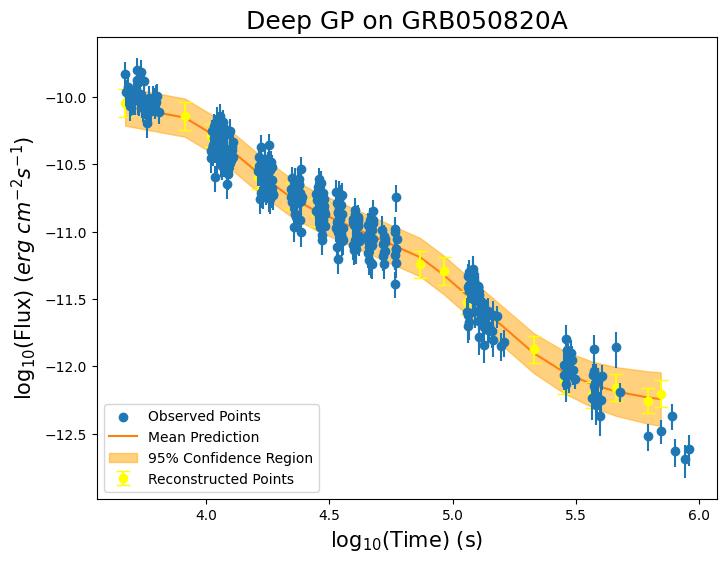


-----TRAINING FOR GRB060912A-----


-----ORIGINAL GRB-----



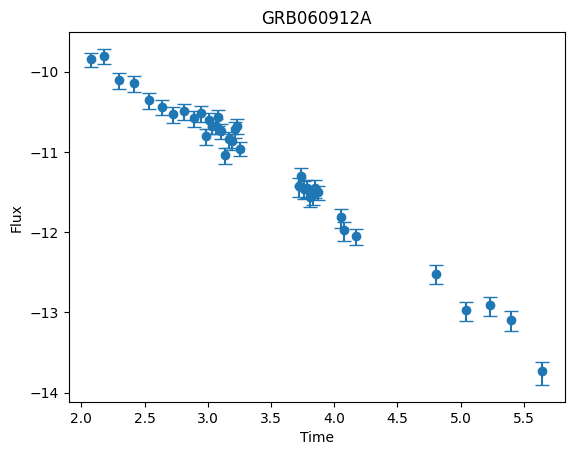


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 45.7011
Iteration 40/500 - Loss: 30.7907
Iteration 60/500 - Loss: 13.7512
Iteration 80/500 - Loss: 6.3031
Iteration 100/500 - Loss: 3.2062
Iteration 120/500 - Loss: 1.8085
Iteration 140/500 - Loss: 1.1386
Iteration 160/500 - Loss: 0.7279
Iteration 180/500 - Loss: 0.4326
Iteration 200/500 - Loss: 0.2300
Iteration 220/500 - Loss: 0.1552
Iteration 240/500 - Loss: 0.0979
Iteration 260/500 - Loss: 0.0492
Iteration 280/500 - Loss: 0.0071
Iteration 300/500 - Loss: -0.0300
Iteration 320/500 - Loss: -0.0628
Iteration 340/500 - Loss: -0.0921
Iteration 360/500 - Loss: -0.1188
Iteration 380/500 - Loss: -0.1415
Iteration 400/500 - Loss: -0.1644
Iteration 420/500 - Loss: -0.1751
Iteration 440/500 - Loss: -0.1848
Iteration 460/500 - Loss: -0.1942
Iteration 480/500 - Loss: -0.2032
Iteration 500/500 - Loss: -0.2120

-----RECONSTRUCTED GRB-----



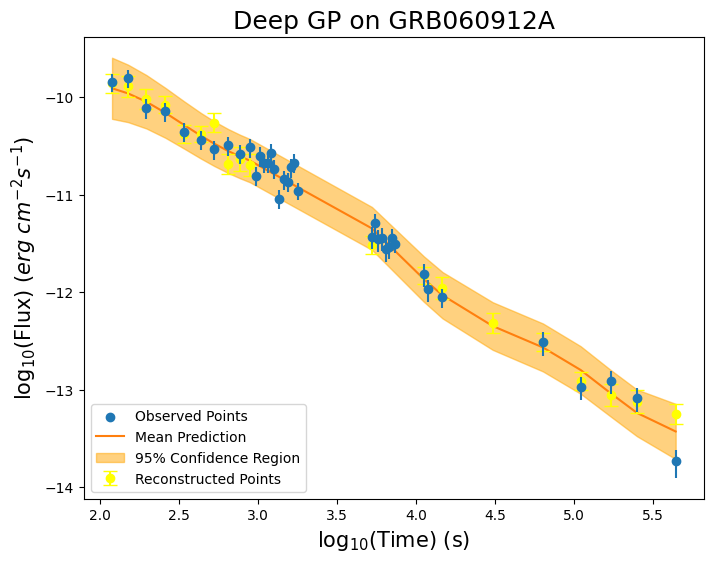


-----TRAINING FOR GRB111117A-----


-----ORIGINAL GRB-----



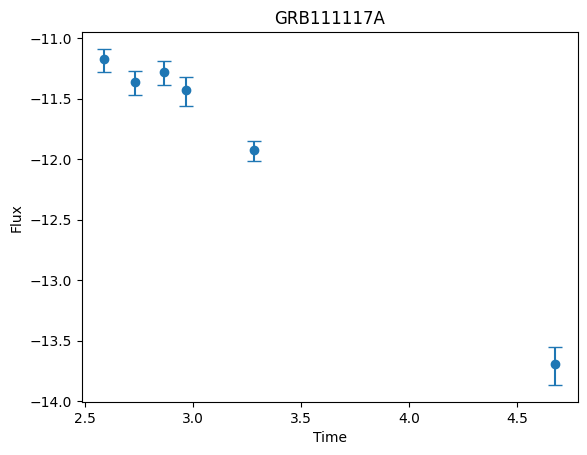


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 60.8186
Iteration 40/500 - Loss: 45.2120
Iteration 60/500 - Loss: 32.2070
Iteration 80/500 - Loss: 21.1022
Iteration 100/500 - Loss: 12.4426
Iteration 120/500 - Loss: 6.6817
Iteration 140/500 - Loss: 3.6290
Iteration 160/500 - Loss: 2.2857
Iteration 180/500 - Loss: 1.6463
Iteration 200/500 - Loss: 1.3167
Iteration 220/500 - Loss: 1.2042
Iteration 240/500 - Loss: 1.1165
Iteration 260/500 - Loss: 1.0410
Iteration 280/500 - Loss: 0.9753
Iteration 300/500 - Loss: 0.9183
Iteration 320/500 - Loss: 0.8691
Iteration 340/500 - Loss: 0.8266
Iteration 360/500 - Loss: 0.7899
Iteration 380/500 - Loss: 0.7584
Iteration 400/500 - Loss: 0.7340
Iteration 420/500 - Loss: 0.7202
Iteration 440/500 - Loss: 0.7089
Iteration 460/500 - Loss: 0.6985
Iteration 480/500 - Loss: 0.6888
Iteration 500/500 - Loss: 0.6797

-----RECONSTRUCTED GRB-----



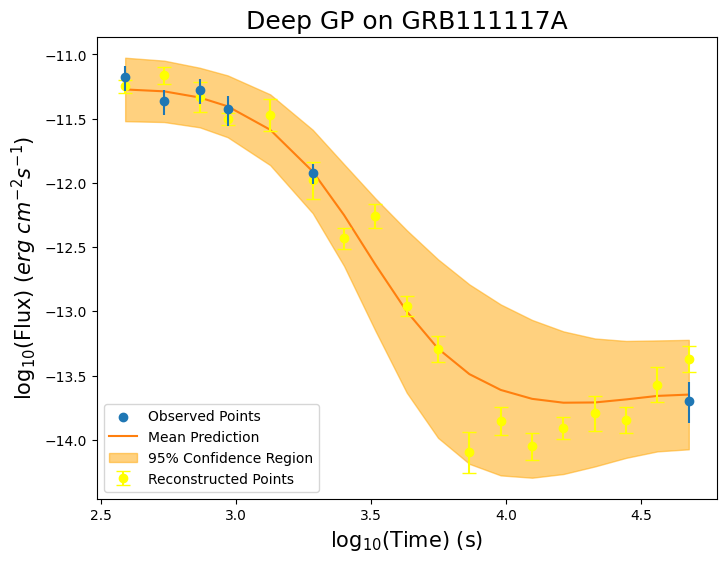


-----TRAINING FOR GRB130604A-----


-----ORIGINAL GRB-----



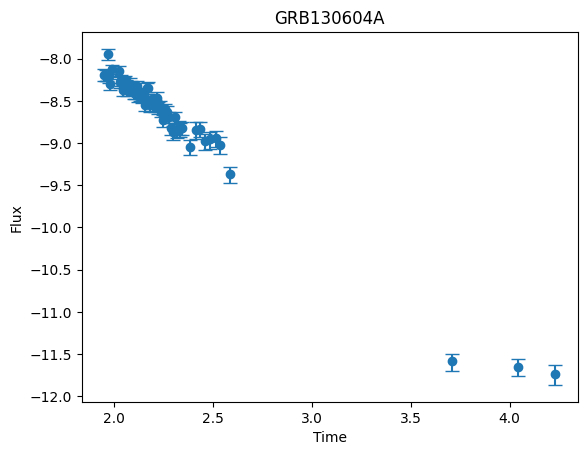


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.3572
Iteration 40/500 - Loss: 42.3808
Iteration 60/500 - Loss: 37.6742
Iteration 80/500 - Loss: 29.9309
Iteration 100/500 - Loss: 20.1635
Iteration 120/500 - Loss: 11.2980
Iteration 140/500 - Loss: 5.8677
Iteration 160/500 - Loss: 2.8545
Iteration 180/500 - Loss: 1.2160
Iteration 200/500 - Loss: 0.3684
Iteration 220/500 - Loss: 0.1253
Iteration 240/500 - Loss: -0.0306
Iteration 260/500 - Loss: -0.1413
Iteration 280/500 - Loss: -0.2205
Iteration 300/500 - Loss: -0.2779
Iteration 320/500 - Loss: -0.3201
Iteration 340/500 - Loss: -0.3520
Iteration 360/500 - Loss: -0.3769
Iteration 380/500 - Loss: -0.3967
Iteration 400/500 - Loss: -0.4129
Iteration 420/500 - Loss: -0.4203
Iteration 440/500 - Loss: -0.4267
Iteration 460/500 - Loss: -0.4327
Iteration 480/500 - Loss: -0.4383
Iteration 500/500 - Loss: -0.4435

-----RECONSTRUCTED GRB-----



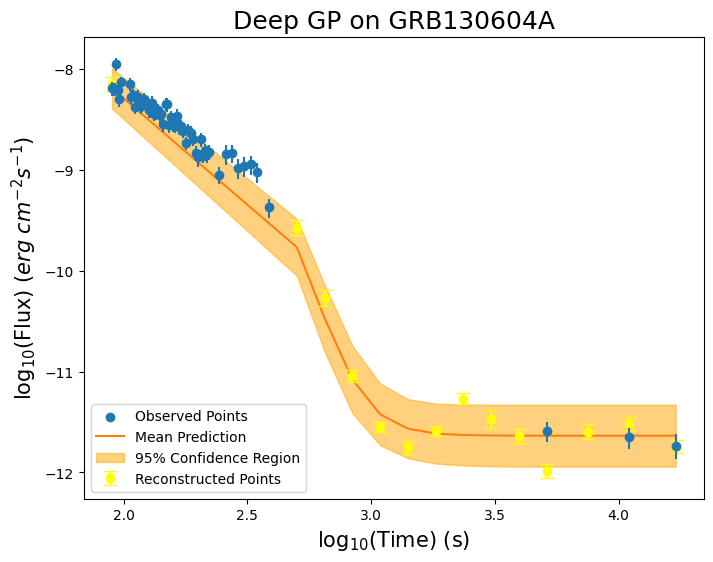


-----TRAINING FOR GRB140213A-----


-----ORIGINAL GRB-----



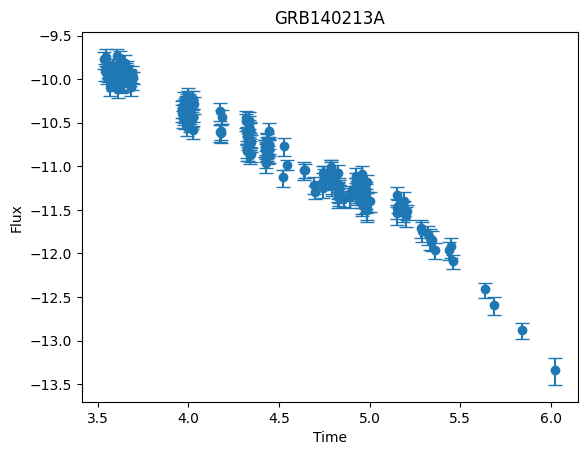


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 58.9917
Iteration 40/500 - Loss: 43.1693
Iteration 60/500 - Loss: 30.6353
Iteration 80/500 - Loss: 17.0832
Iteration 100/500 - Loss: 8.9438
Iteration 120/500 - Loss: 5.9673
Iteration 140/500 - Loss: 3.9508
Iteration 160/500 - Loss: 3.0016
Iteration 180/500 - Loss: 2.4002
Iteration 200/500 - Loss: 1.9337
Iteration 220/500 - Loss: 1.7171
Iteration 240/500 - Loss: 1.5347
Iteration 260/500 - Loss: 1.3702
Iteration 280/500 - Loss: 1.2211
Iteration 300/500 - Loss: 1.0851
Iteration 320/500 - Loss: 0.9604
Iteration 340/500 - Loss: 0.8476
Iteration 360/500 - Loss: 0.7448
Iteration 380/500 - Loss: 0.6511
Iteration 400/500 - Loss: 0.5642
Iteration 420/500 - Loss: 0.5215
Iteration 440/500 - Loss: 0.4824
Iteration 460/500 - Loss: 0.4445
Iteration 480/500 - Loss: 0.4078
Iteration 500/500 - Loss: 0.3721

-----RECONSTRUCTED GRB-----



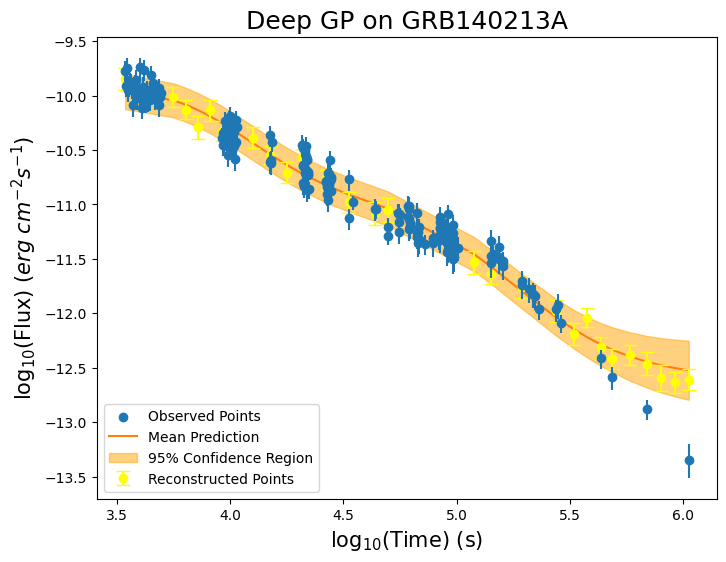


-----TRAINING FOR GRB160203A-----


-----ORIGINAL GRB-----



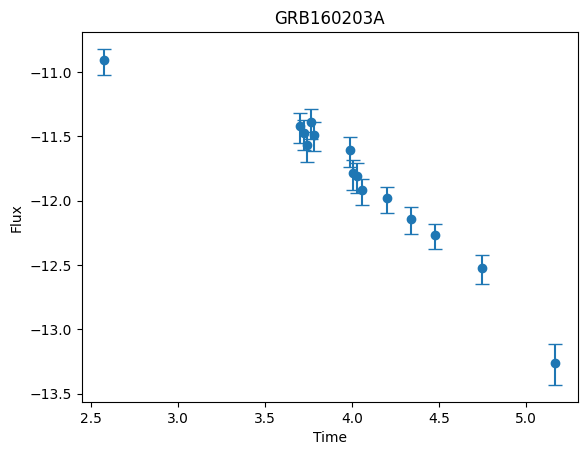


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.3957
Iteration 40/500 - Loss: 37.4862
Iteration 60/500 - Loss: 25.0450
Iteration 80/500 - Loss: 15.3458
Iteration 100/500 - Loss: 10.0169
Iteration 120/500 - Loss: 6.7075
Iteration 140/500 - Loss: 4.6392
Iteration 160/500 - Loss: 3.1861
Iteration 180/500 - Loss: 2.2009
Iteration 200/500 - Loss: 1.5495
Iteration 220/500 - Loss: 1.3112
Iteration 240/500 - Loss: 1.1312
Iteration 260/500 - Loss: 0.9854
Iteration 280/500 - Loss: 0.8670
Iteration 300/500 - Loss: 0.7715
Iteration 320/500 - Loss: 0.6945
Iteration 340/500 - Loss: 0.6314
Iteration 360/500 - Loss: 0.5798
Iteration 380/500 - Loss: 0.5371
Iteration 400/500 - Loss: 0.5015
Iteration 420/500 - Loss: 0.4852
Iteration 440/500 - Loss: 0.4710
Iteration 460/500 - Loss: 0.4573
Iteration 480/500 - Loss: 0.4448
Iteration 500/500 - Loss: 0.4330

-----RECONSTRUCTED GRB-----



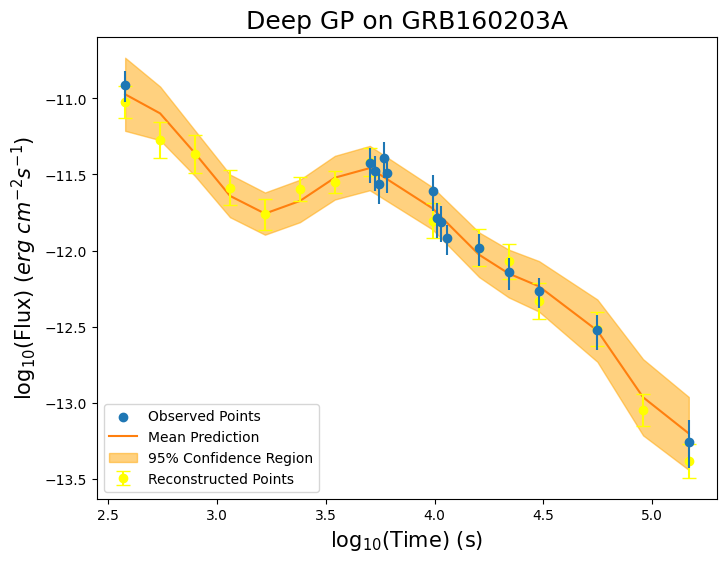


-----TRAINING FOR GRB070721B-----


-----ORIGINAL GRB-----



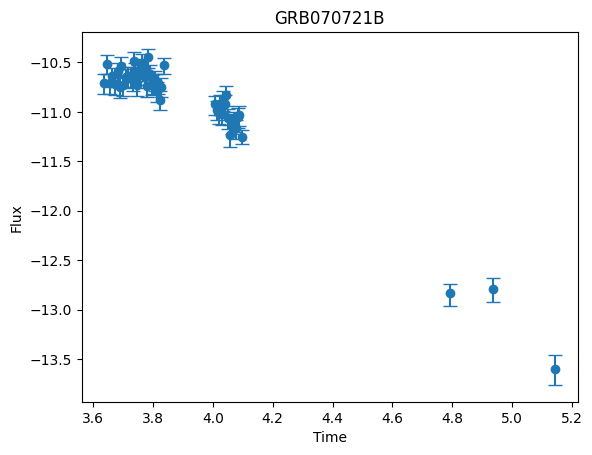


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.0951
Iteration 40/500 - Loss: 42.6623
Iteration 60/500 - Loss: 39.6416
Iteration 80/500 - Loss: 34.4194
Iteration 100/500 - Loss: 22.9127
Iteration 120/500 - Loss: 11.1643
Iteration 140/500 - Loss: 4.8726
Iteration 160/500 - Loss: 2.2594
Iteration 180/500 - Loss: 1.4297
Iteration 200/500 - Loss: 1.1738
Iteration 220/500 - Loss: 1.1043
Iteration 240/500 - Loss: 1.0546
Iteration 260/500 - Loss: 1.0139
Iteration 280/500 - Loss: 0.9799
Iteration 300/500 - Loss: 0.9510
Iteration 320/500 - Loss: 0.9263
Iteration 340/500 - Loss: 0.9048
Iteration 360/500 - Loss: 0.8860
Iteration 380/500 - Loss: 0.8694
Iteration 400/500 - Loss: 0.8546
Iteration 420/500 - Loss: 0.8474
Iteration 440/500 - Loss: 0.8409
Iteration 460/500 - Loss: 0.8346
Iteration 480/500 - Loss: 0.8286
Iteration 500/500 - Loss: 0.8228

-----RECONSTRUCTED GRB-----



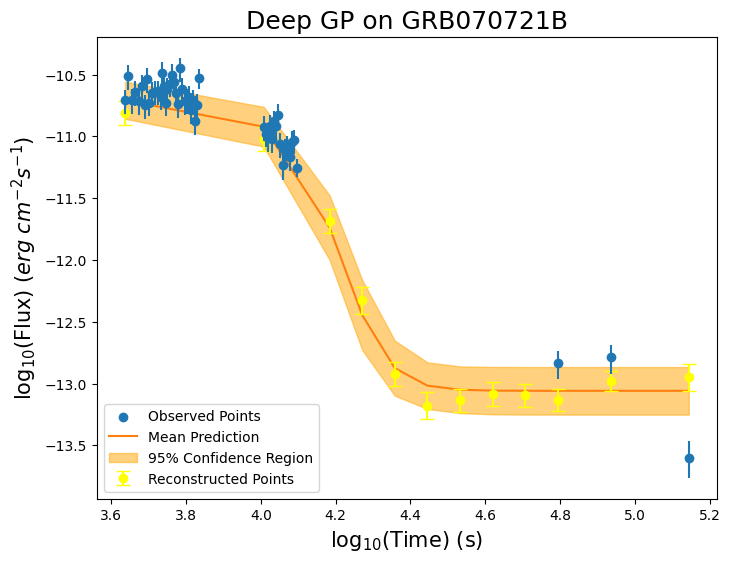


-----TRAINING FOR GRB071003-----


-----ORIGINAL GRB-----



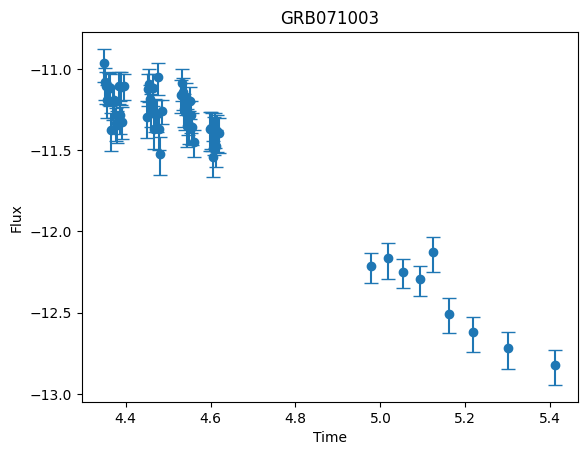


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.3875
Iteration 40/500 - Loss: 42.6622
Iteration 60/500 - Loss: 38.9163
Iteration 80/500 - Loss: 28.4882
Iteration 100/500 - Loss: 16.4035
Iteration 120/500 - Loss: 8.4367
Iteration 140/500 - Loss: 4.5209
Iteration 160/500 - Loss: 2.8859
Iteration 180/500 - Loss: 2.1000
Iteration 200/500 - Loss: 1.7008
Iteration 220/500 - Loss: 1.5686
Iteration 240/500 - Loss: 1.4743
Iteration 260/500 - Loss: 1.3955
Iteration 280/500 - Loss: 1.3273
Iteration 300/500 - Loss: 1.2673
Iteration 320/500 - Loss: 1.2140
Iteration 340/500 - Loss: 1.1662
Iteration 360/500 - Loss: 1.1236
Iteration 380/500 - Loss: 1.0870
Iteration 400/500 - Loss: 1.0535
Iteration 420/500 - Loss: 1.0376
Iteration 440/500 - Loss: 1.0231
Iteration 460/500 - Loss: 1.0091
Iteration 480/500 - Loss: 0.9956
Iteration 500/500 - Loss: 0.9826

-----RECONSTRUCTED GRB-----



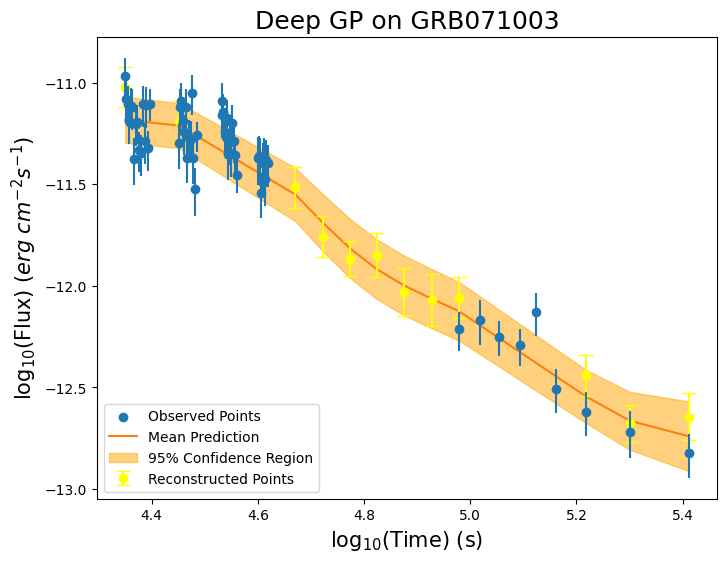


-----TRAINING FOR GRB080916A-----


-----ORIGINAL GRB-----



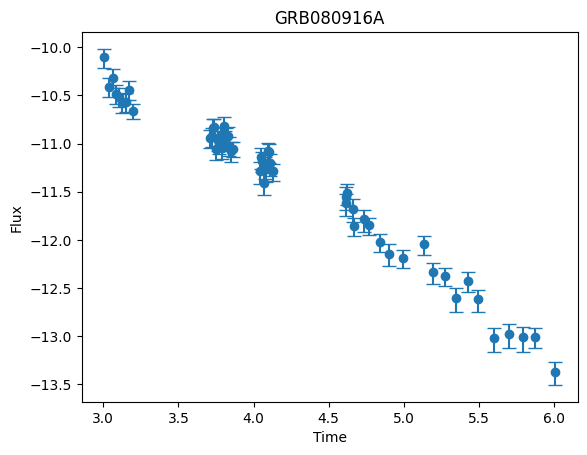


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.1229
Iteration 40/500 - Loss: 32.3912
Iteration 60/500 - Loss: 14.4771
Iteration 80/500 - Loss: 7.2021
Iteration 100/500 - Loss: 3.8359
Iteration 120/500 - Loss: 2.2835
Iteration 140/500 - Loss: 1.3608
Iteration 160/500 - Loss: 0.8723
Iteration 180/500 - Loss: 0.5863
Iteration 200/500 - Loss: 0.4005
Iteration 220/500 - Loss: 0.3289
Iteration 240/500 - Loss: 0.2709
Iteration 260/500 - Loss: 0.2202
Iteration 280/500 - Loss: 0.1756
Iteration 300/500 - Loss: 0.1361
Iteration 320/500 - Loss: 0.1011
Iteration 340/500 - Loss: 0.0698
Iteration 360/500 - Loss: 0.0414
Iteration 380/500 - Loss: 0.0158
Iteration 400/500 - Loss: -0.0080
Iteration 420/500 - Loss: -0.0198
Iteration 440/500 - Loss: -0.0307
Iteration 460/500 - Loss: -0.0414
Iteration 480/500 - Loss: -0.0517
Iteration 500/500 - Loss: -0.0618

-----RECONSTRUCTED GRB-----



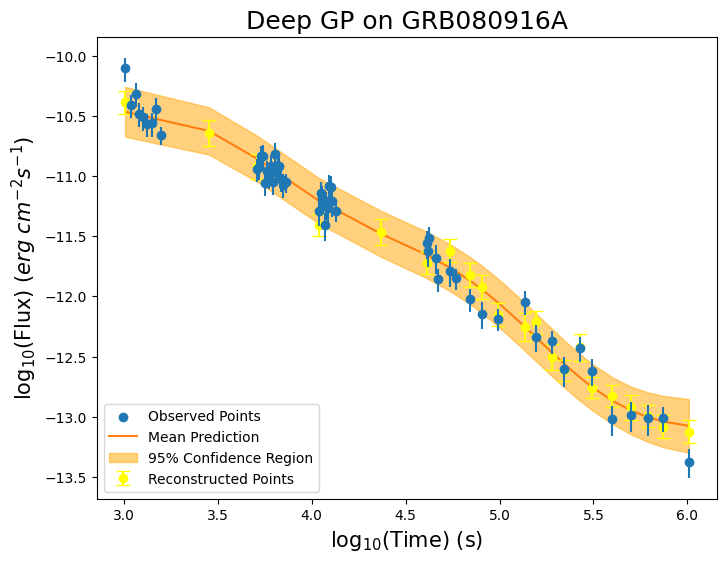


-----TRAINING FOR GRB081203A-----


-----ORIGINAL GRB-----



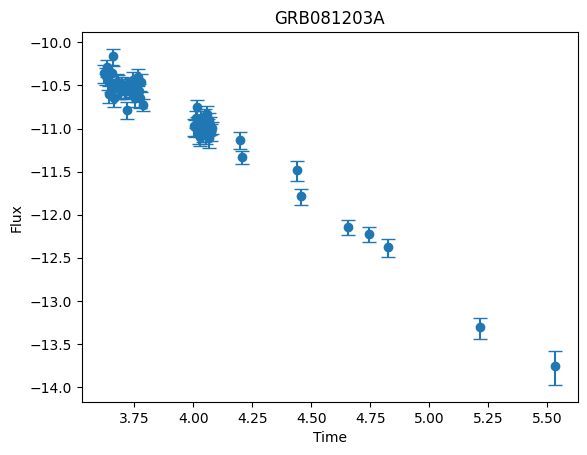


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.7710
Iteration 40/500 - Loss: 40.2261
Iteration 60/500 - Loss: 29.2776
Iteration 80/500 - Loss: 17.2780
Iteration 100/500 - Loss: 9.2902
Iteration 120/500 - Loss: 5.1037
Iteration 140/500 - Loss: 3.1104
Iteration 160/500 - Loss: 1.9968
Iteration 180/500 - Loss: 1.2187
Iteration 200/500 - Loss: 0.8021
Iteration 220/500 - Loss: 0.6052
Iteration 240/500 - Loss: 0.4943
Iteration 260/500 - Loss: 0.4043
Iteration 280/500 - Loss: 0.3313
Iteration 300/500 - Loss: 0.2719
Iteration 320/500 - Loss: 0.2215
Iteration 340/500 - Loss: 0.1813
Iteration 360/500 - Loss: 0.1435
Iteration 380/500 - Loss: 0.1164
Iteration 400/500 - Loss: 0.0867
Iteration 420/500 - Loss: 0.0736
Iteration 440/500 - Loss: 0.0623
Iteration 460/500 - Loss: 0.0517
Iteration 480/500 - Loss: 0.0417
Iteration 500/500 - Loss: 0.0325

-----RECONSTRUCTED GRB-----



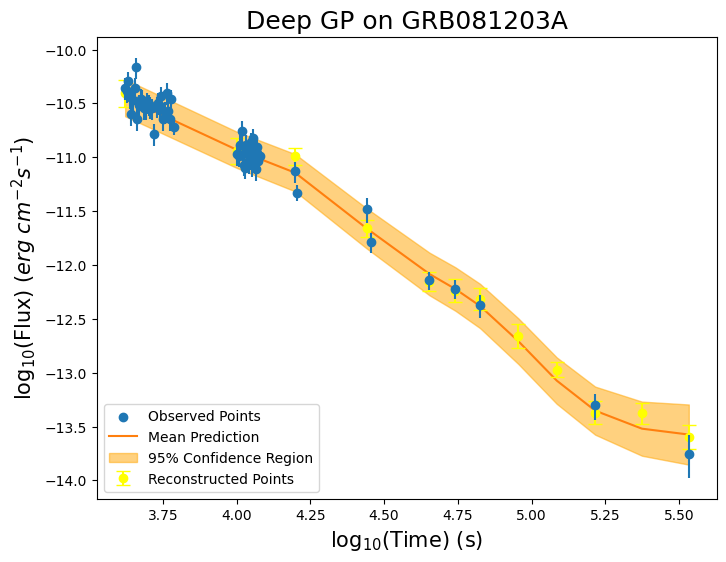


-----TRAINING FOR GRB090519-----


-----ORIGINAL GRB-----



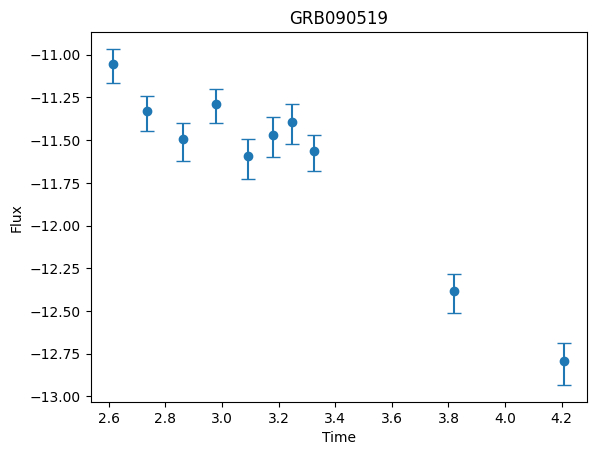


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 58.6588
Iteration 40/500 - Loss: 38.5116
Iteration 60/500 - Loss: 23.8722
Iteration 80/500 - Loss: 14.1924
Iteration 100/500 - Loss: 8.7004
Iteration 120/500 - Loss: 6.0470
Iteration 140/500 - Loss: 4.8892
Iteration 160/500 - Loss: 4.3671
Iteration 180/500 - Loss: 3.9664
Iteration 200/500 - Loss: 3.4506
Iteration 220/500 - Loss: 3.1423
Iteration 240/500 - Loss: 2.8479
Iteration 260/500 - Loss: 2.5723
Iteration 280/500 - Loss: 2.3220
Iteration 300/500 - Loss: 2.1034
Iteration 320/500 - Loss: 1.9198
Iteration 340/500 - Loss: 1.7684
Iteration 360/500 - Loss: 1.6442
Iteration 380/500 - Loss: 1.5420
Iteration 400/500 - Loss: 1.4572
Iteration 420/500 - Loss: 1.4187
Iteration 440/500 - Loss: 1.3850
Iteration 460/500 - Loss: 1.3535
Iteration 480/500 - Loss: 1.3240
Iteration 500/500 - Loss: 1.2962

-----RECONSTRUCTED GRB-----



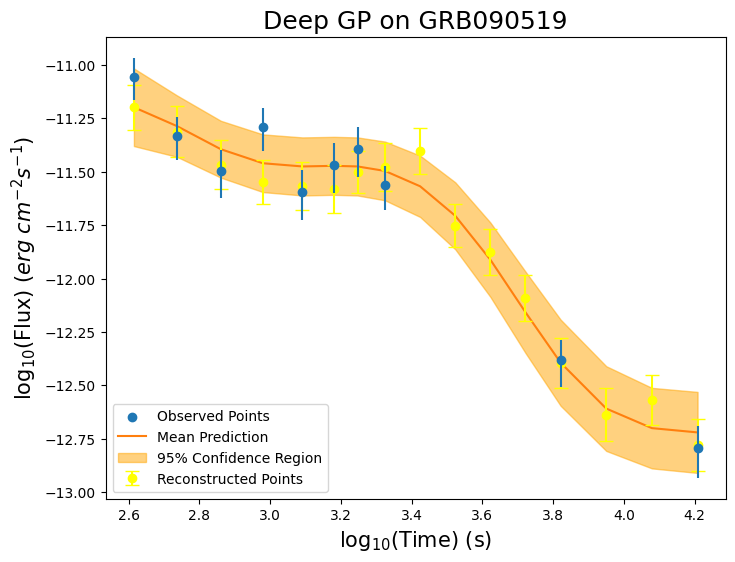


-----TRAINING FOR GRB090812-----


-----ORIGINAL GRB-----



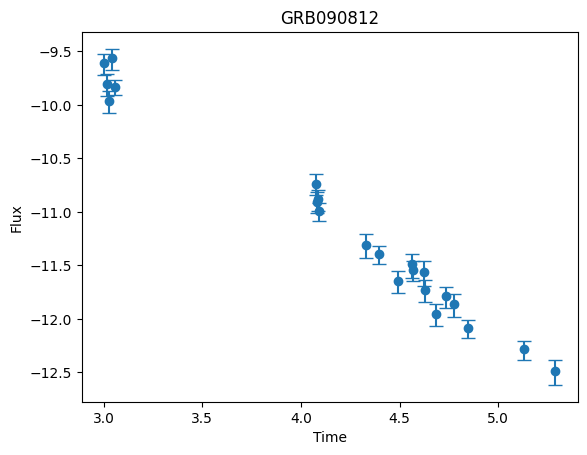


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 62.3072
Iteration 40/500 - Loss: 38.7652
Iteration 60/500 - Loss: 17.4354
Iteration 80/500 - Loss: 7.9653
Iteration 100/500 - Loss: 4.5986
Iteration 120/500 - Loss: 3.6232
Iteration 140/500 - Loss: 3.1310
Iteration 160/500 - Loss: 2.4047
Iteration 180/500 - Loss: 1.4629
Iteration 200/500 - Loss: 0.9301
Iteration 220/500 - Loss: 0.6127
Iteration 240/500 - Loss: 0.4832
Iteration 260/500 - Loss: 0.3899
Iteration 280/500 - Loss: 0.3208
Iteration 300/500 - Loss: 0.2652
Iteration 320/500 - Loss: 0.2221
Iteration 340/500 - Loss: 0.1970
Iteration 360/500 - Loss: 0.1776
Iteration 380/500 - Loss: 0.1620
Iteration 400/500 - Loss: 0.1475
Iteration 420/500 - Loss: 0.1408
Iteration 440/500 - Loss: 0.1349
Iteration 460/500 - Loss: 0.1291
Iteration 480/500 - Loss: 0.1236
Iteration 500/500 - Loss: 0.1182

-----RECONSTRUCTED GRB-----



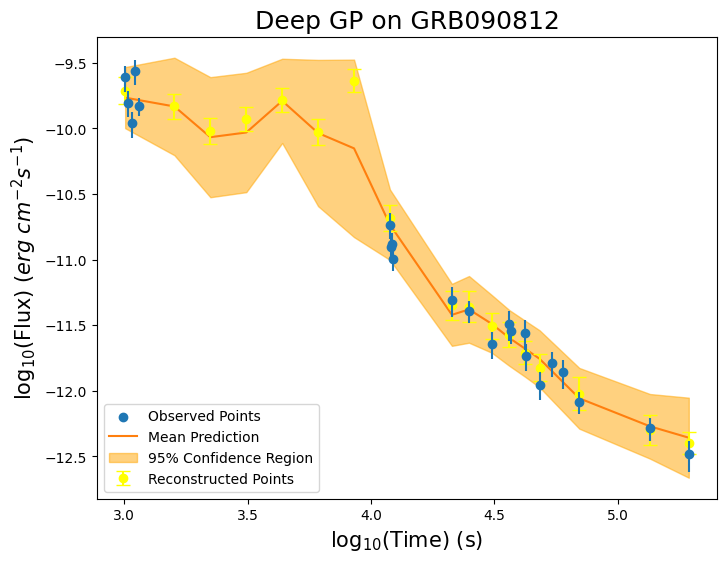


-----TRAINING FOR GRB110808A-----


-----ORIGINAL GRB-----



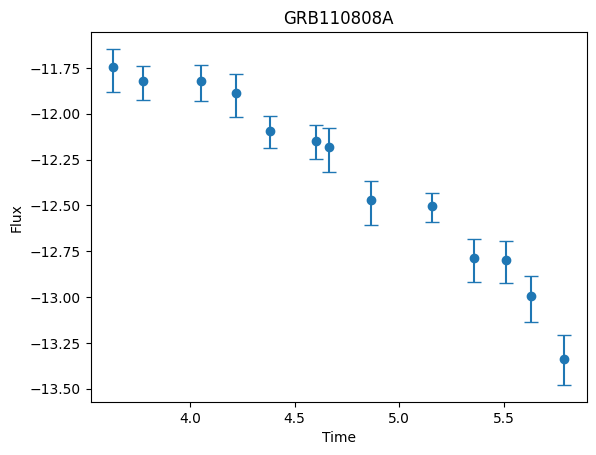


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 57.7239
Iteration 40/500 - Loss: 36.5681
Iteration 60/500 - Loss: 20.9247
Iteration 80/500 - Loss: 11.5645
Iteration 100/500 - Loss: 7.0172
Iteration 120/500 - Loss: 4.6595
Iteration 140/500 - Loss: 3.0068
Iteration 160/500 - Loss: 2.0788
Iteration 180/500 - Loss: 1.5892
Iteration 200/500 - Loss: 1.3003
Iteration 220/500 - Loss: 1.1925
Iteration 240/500 - Loss: 1.1057
Iteration 260/500 - Loss: 1.0283
Iteration 280/500 - Loss: 0.9581
Iteration 300/500 - Loss: 0.8939
Iteration 320/500 - Loss: 0.8344
Iteration 340/500 - Loss: 0.7799
Iteration 360/500 - Loss: 0.7306
Iteration 380/500 - Loss: 0.6867
Iteration 400/500 - Loss: 0.6476
Iteration 420/500 - Loss: 0.6287
Iteration 440/500 - Loss: 0.6117
Iteration 460/500 - Loss: 0.5954
Iteration 480/500 - Loss: 0.5796
Iteration 500/500 - Loss: 0.5647

-----RECONSTRUCTED GRB-----



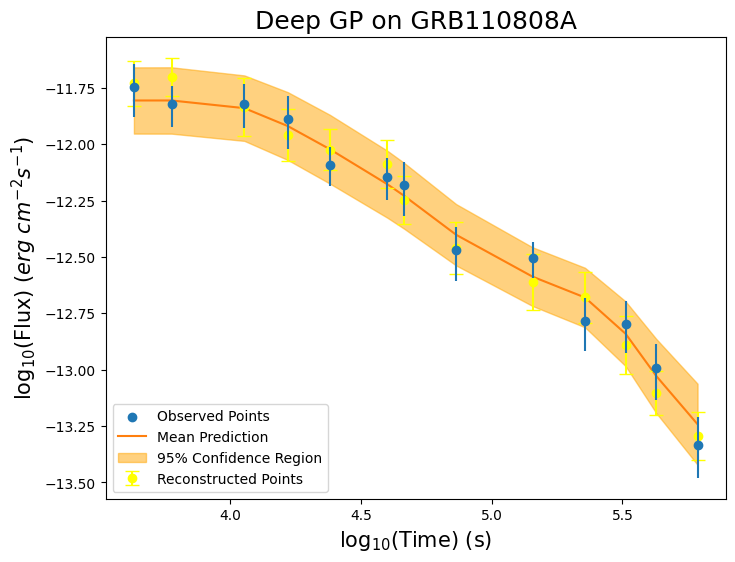


-----TRAINING FOR GRB120804A-----


-----ORIGINAL GRB-----



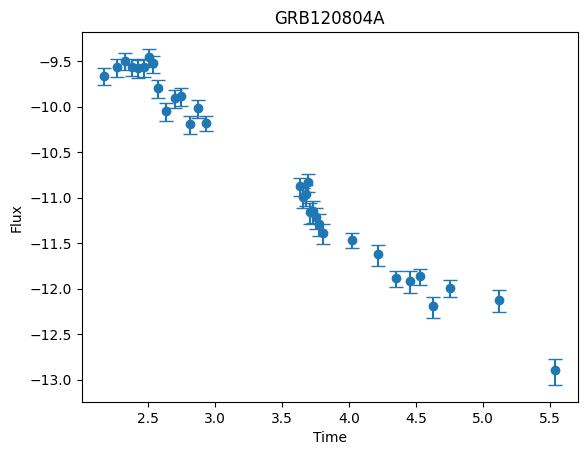


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.4944
Iteration 40/500 - Loss: 41.4075
Iteration 60/500 - Loss: 25.4723
Iteration 80/500 - Loss: 9.4238
Iteration 100/500 - Loss: 4.2923
Iteration 120/500 - Loss: 2.3864
Iteration 140/500 - Loss: 1.5424
Iteration 160/500 - Loss: 1.0849
Iteration 180/500 - Loss: 0.7890
Iteration 200/500 - Loss: 0.5782
Iteration 220/500 - Loss: 0.4915
Iteration 240/500 - Loss: 0.4200
Iteration 260/500 - Loss: 0.3543
Iteration 280/500 - Loss: 0.2936
Iteration 300/500 - Loss: 0.2370
Iteration 320/500 - Loss: 0.1831
Iteration 340/500 - Loss: 0.1352
Iteration 360/500 - Loss: 0.0788
Iteration 380/500 - Loss: 0.0182
Iteration 400/500 - Loss: -0.0419
Iteration 420/500 - Loss: -0.0832
Iteration 440/500 - Loss: -0.1096
Iteration 460/500 - Loss: -0.1314
Iteration 480/500 - Loss: -0.1507
Iteration 500/500 - Loss: -0.1683

-----RECONSTRUCTED GRB-----



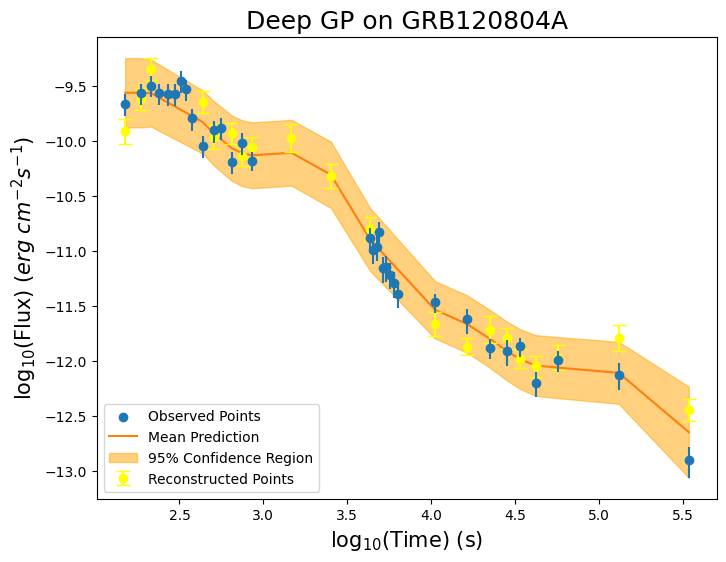


-----TRAINING FOR GRB141220A-----


-----ORIGINAL GRB-----



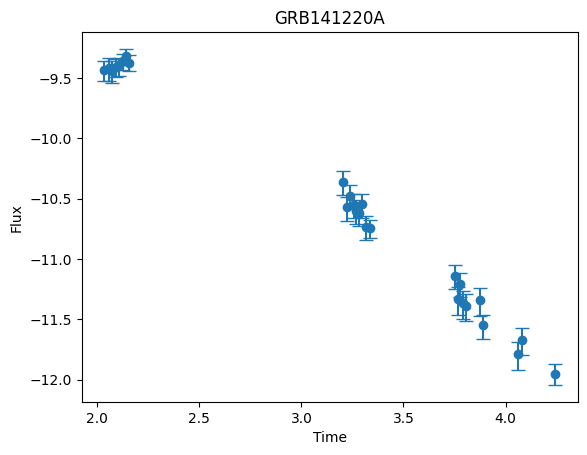


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.2048
Iteration 40/500 - Loss: 38.6160
Iteration 60/500 - Loss: 27.2949
Iteration 80/500 - Loss: 15.1243
Iteration 100/500 - Loss: 5.7689
Iteration 120/500 - Loss: 1.7705
Iteration 140/500 - Loss: 0.5881
Iteration 160/500 - Loss: 0.1687
Iteration 180/500 - Loss: -0.0372
Iteration 200/500 - Loss: -0.1496
Iteration 220/500 - Loss: -0.2032
Iteration 240/500 - Loss: -0.2383
Iteration 260/500 - Loss: -0.2685
Iteration 280/500 - Loss: -0.2947
Iteration 300/500 - Loss: -0.3178
Iteration 320/500 - Loss: -0.3378
Iteration 340/500 - Loss: -0.3553
Iteration 360/500 - Loss: -0.3708
Iteration 380/500 - Loss: -0.3845
Iteration 400/500 - Loss: -0.3967
Iteration 420/500 - Loss: -0.4026
Iteration 440/500 - Loss: -0.4079
Iteration 460/500 - Loss: -0.4131
Iteration 480/500 - Loss: -0.4180
Iteration 500/500 - Loss: -0.4227

-----RECONSTRUCTED GRB-----



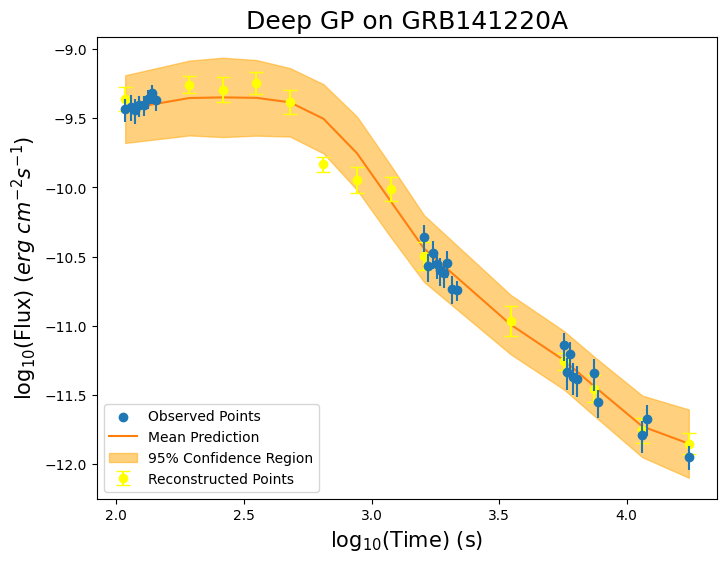


-----TRAINING FOR GRB060418-----


-----ORIGINAL GRB-----



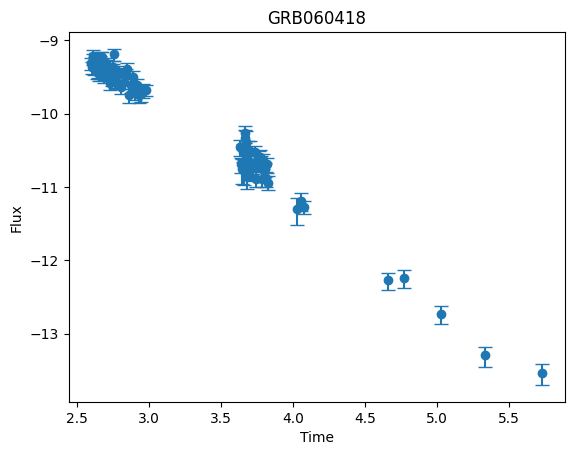


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.2028
Iteration 40/500 - Loss: 38.8368
Iteration 60/500 - Loss: 26.9094
Iteration 80/500 - Loss: 16.0102
Iteration 100/500 - Loss: 9.3325
Iteration 120/500 - Loss: 5.6675
Iteration 140/500 - Loss: 3.3204
Iteration 160/500 - Loss: 1.8567
Iteration 180/500 - Loss: 1.0095
Iteration 200/500 - Loss: 0.5424
Iteration 220/500 - Loss: 0.3886
Iteration 240/500 - Loss: 0.2779
Iteration 260/500 - Loss: 0.1873
Iteration 280/500 - Loss: 0.1169
Iteration 300/500 - Loss: 0.0474
Iteration 320/500 - Loss: 0.0099
Iteration 340/500 - Loss: -0.0490
Iteration 360/500 - Loss: -0.0855
Iteration 380/500 - Loss: -0.1338
Iteration 400/500 - Loss: -0.1098
Iteration 420/500 - Loss: -0.1703
Iteration 440/500 - Loss: -0.1881
Iteration 460/500 - Loss: -0.2026
Iteration 480/500 - Loss: -0.2155
Iteration 500/500 - Loss: -0.2282

-----RECONSTRUCTED GRB-----



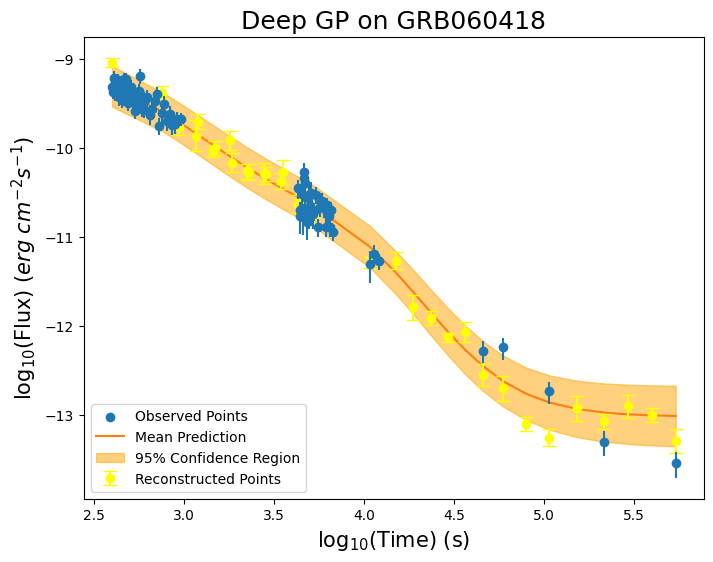


-----TRAINING FOR GRB060707-----


-----ORIGINAL GRB-----



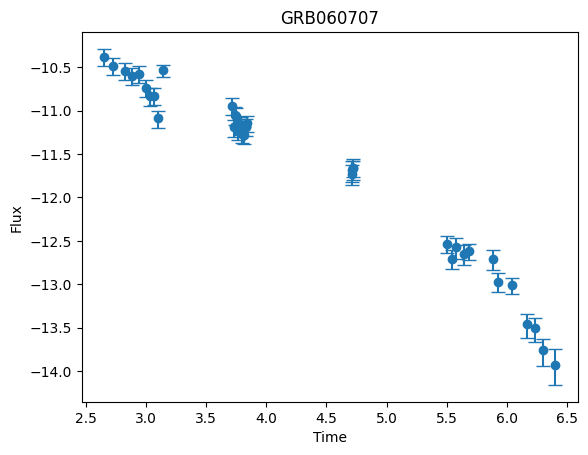


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 45.6613
Iteration 40/500 - Loss: 26.3787
Iteration 60/500 - Loss: 10.7523
Iteration 80/500 - Loss: 5.0740
Iteration 100/500 - Loss: 3.3482
Iteration 120/500 - Loss: 1.9891
Iteration 140/500 - Loss: 1.0757
Iteration 160/500 - Loss: 0.5048
Iteration 180/500 - Loss: 0.1709
Iteration 200/500 - Loss: -0.1031
Iteration 220/500 - Loss: -0.1881
Iteration 240/500 - Loss: -0.2465
Iteration 260/500 - Loss: -0.2914
Iteration 280/500 - Loss: -0.3270
Iteration 300/500 - Loss: -0.3557
Iteration 320/500 - Loss: -0.3795
Iteration 340/500 - Loss: -0.3995
Iteration 360/500 - Loss: -0.4159
Iteration 380/500 - Loss: -0.4310
Iteration 400/500 - Loss: -0.4442
Iteration 420/500 - Loss: -0.4509
Iteration 440/500 - Loss: -0.4571
Iteration 460/500 - Loss: -0.4636
Iteration 480/500 - Loss: -0.4705
Iteration 500/500 - Loss: -0.4776

-----RECONSTRUCTED GRB-----



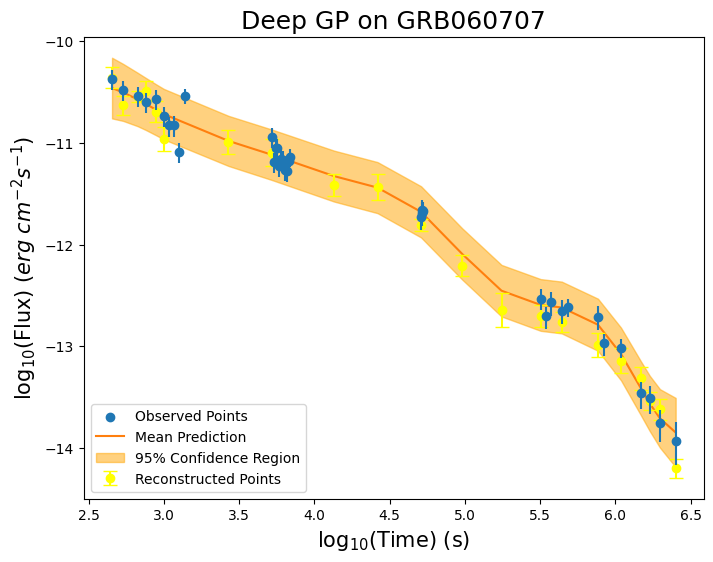


-----TRAINING FOR GRB090426-----


-----ORIGINAL GRB-----



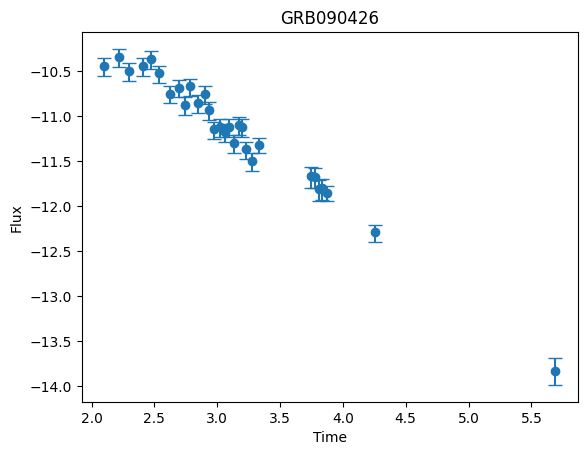


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.6349
Iteration 40/500 - Loss: 34.9818
Iteration 60/500 - Loss: 20.2946
Iteration 80/500 - Loss: 11.7326
Iteration 100/500 - Loss: 7.7442
Iteration 120/500 - Loss: 5.4609
Iteration 140/500 - Loss: 3.8226
Iteration 160/500 - Loss: 2.6245
Iteration 180/500 - Loss: 1.7655
Iteration 200/500 - Loss: 1.1557
Iteration 220/500 - Loss: 0.9199
Iteration 240/500 - Loss: 0.7367
Iteration 260/500 - Loss: 0.5848
Iteration 280/500 - Loss: 0.4599
Iteration 300/500 - Loss: 0.3583
Iteration 320/500 - Loss: 0.2764
Iteration 340/500 - Loss: 0.2109
Iteration 360/500 - Loss: 0.1588
Iteration 380/500 - Loss: 0.1174
Iteration 400/500 - Loss: 0.0846
Iteration 420/500 - Loss: 0.0702
Iteration 440/500 - Loss: 0.0579
Iteration 460/500 - Loss: 0.0467
Iteration 480/500 - Loss: 0.0366
Iteration 500/500 - Loss: 0.0272

-----RECONSTRUCTED GRB-----



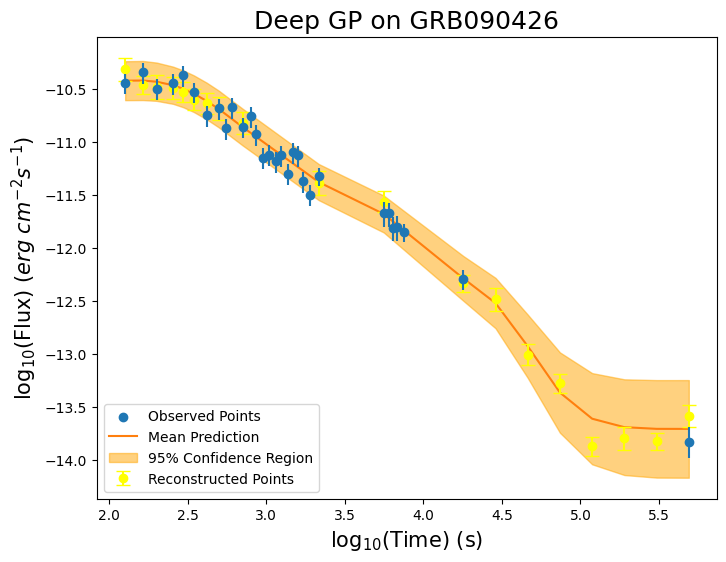


-----TRAINING FOR GRB140509A-----


-----ORIGINAL GRB-----



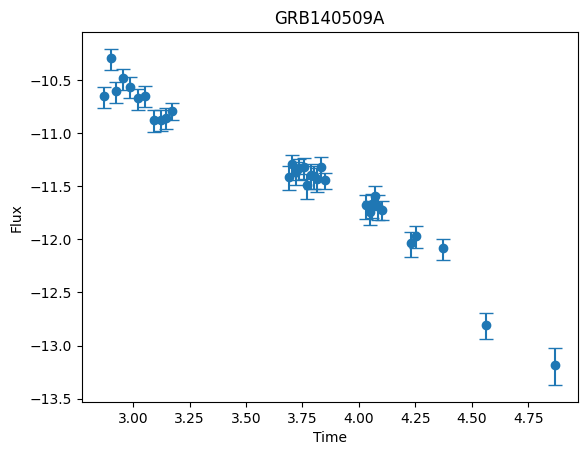


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.2177
Iteration 40/500 - Loss: 36.8191
Iteration 60/500 - Loss: 23.9030
Iteration 80/500 - Loss: 14.3664
Iteration 100/500 - Loss: 8.8230
Iteration 120/500 - Loss: 5.5269
Iteration 140/500 - Loss: 3.8067
Iteration 160/500 - Loss: 2.7192
Iteration 180/500 - Loss: 1.9512
Iteration 200/500 - Loss: 1.4132
Iteration 220/500 - Loss: 1.1964
Iteration 240/500 - Loss: 1.0217
Iteration 260/500 - Loss: 0.8707
Iteration 280/500 - Loss: 0.7413
Iteration 300/500 - Loss: 0.6310
Iteration 320/500 - Loss: 0.5367
Iteration 340/500 - Loss: 0.4555
Iteration 360/500 - Loss: 0.3852
Iteration 380/500 - Loss: 0.3255
Iteration 400/500 - Loss: 0.2736
Iteration 420/500 - Loss: 0.2482
Iteration 440/500 - Loss: 0.2264
Iteration 460/500 - Loss: 0.2061
Iteration 480/500 - Loss: 0.1869
Iteration 500/500 - Loss: 0.1688

-----RECONSTRUCTED GRB-----



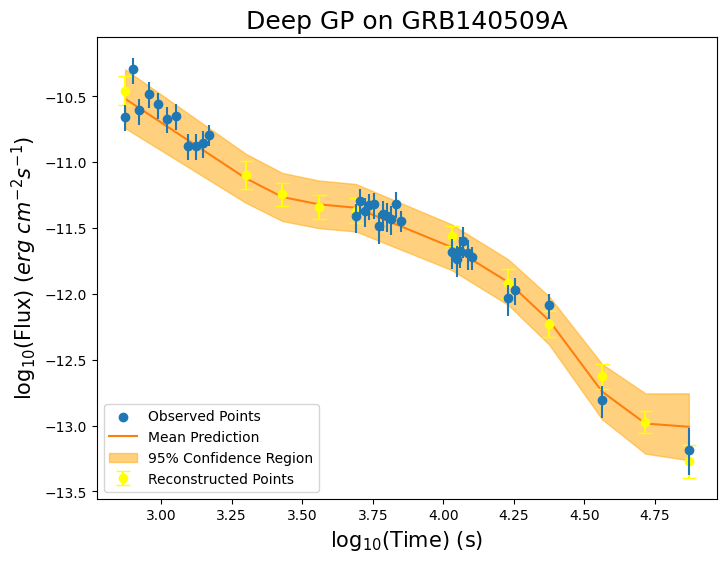


-----TRAINING FOR GRB151029A-----


-----ORIGINAL GRB-----



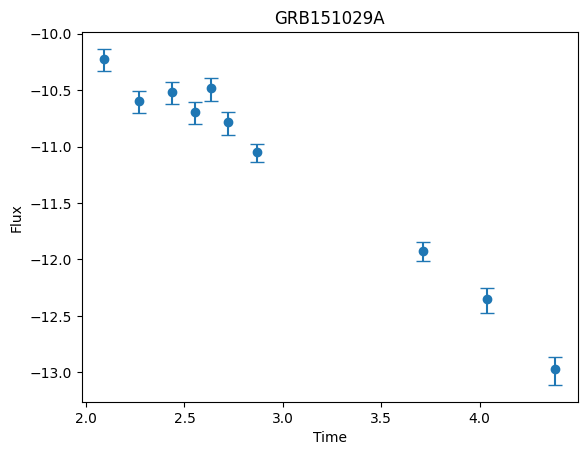


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.6966
Iteration 40/500 - Loss: 37.0748
Iteration 60/500 - Loss: 23.0848
Iteration 80/500 - Loss: 11.9933
Iteration 100/500 - Loss: 7.0869
Iteration 120/500 - Loss: 5.2350
Iteration 140/500 - Loss: 4.2206
Iteration 160/500 - Loss: 3.2289
Iteration 180/500 - Loss: 2.4507
Iteration 200/500 - Loss: 1.9399
Iteration 220/500 - Loss: 1.7370
Iteration 240/500 - Loss: 1.5696
Iteration 260/500 - Loss: 1.4198
Iteration 280/500 - Loss: 1.2836
Iteration 300/500 - Loss: 1.1600
Iteration 320/500 - Loss: 1.0502
Iteration 340/500 - Loss: 0.9553
Iteration 360/500 - Loss: 0.8739
Iteration 380/500 - Loss: 0.8038
Iteration 400/500 - Loss: 0.7433
Iteration 420/500 - Loss: 0.7151
Iteration 440/500 - Loss: 0.6899
Iteration 460/500 - Loss: 0.6664
Iteration 480/500 - Loss: 0.6442
Iteration 500/500 - Loss: 0.6233

-----RECONSTRUCTED GRB-----



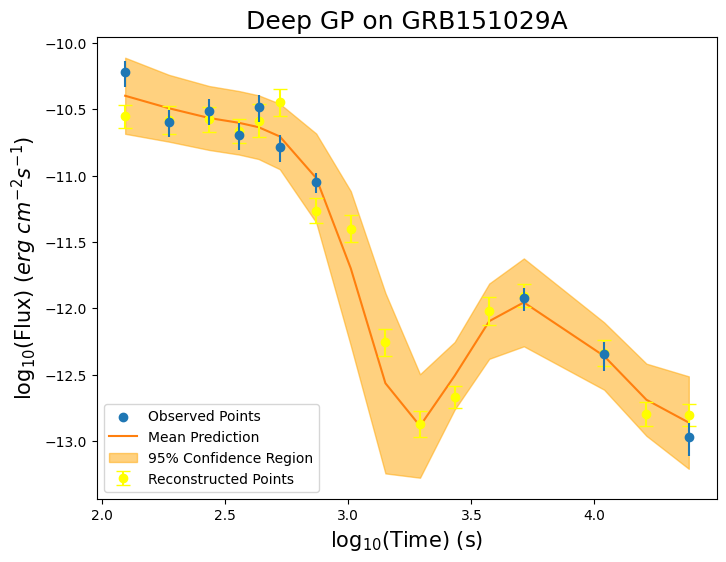


-----TRAINING FOR GRB190824A-----


-----ORIGINAL GRB-----



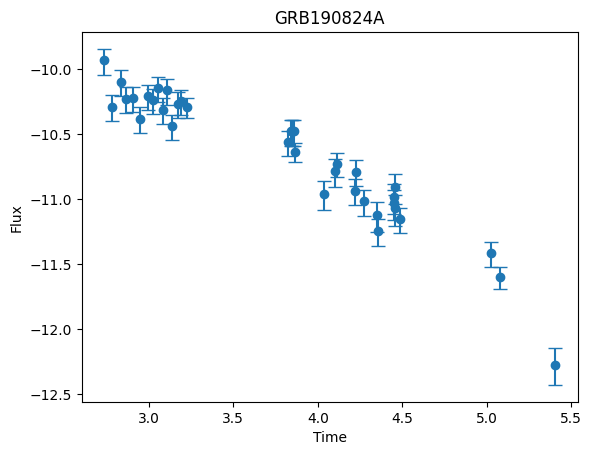


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.2835
Iteration 40/500 - Loss: 36.2688
Iteration 60/500 - Loss: 20.8545
Iteration 80/500 - Loss: 11.7794
Iteration 100/500 - Loss: 8.4525
Iteration 120/500 - Loss: 6.2187
Iteration 140/500 - Loss: 4.8058
Iteration 160/500 - Loss: 3.8956
Iteration 180/500 - Loss: 3.2288
Iteration 200/500 - Loss: 2.7108
Iteration 220/500 - Loss: 2.4818
Iteration 240/500 - Loss: 2.2815
Iteration 260/500 - Loss: 2.0992
Iteration 280/500 - Loss: 1.9331
Iteration 300/500 - Loss: 1.7825
Iteration 320/500 - Loss: 1.6470
Iteration 340/500 - Loss: 1.5256
Iteration 360/500 - Loss: 1.4179
Iteration 380/500 - Loss: 1.3227
Iteration 400/500 - Loss: 1.2391
Iteration 420/500 - Loss: 1.1994
Iteration 440/500 - Loss: 1.1641
Iteration 460/500 - Loss: 1.1307
Iteration 480/500 - Loss: 1.0992
Iteration 500/500 - Loss: 1.0694

-----RECONSTRUCTED GRB-----



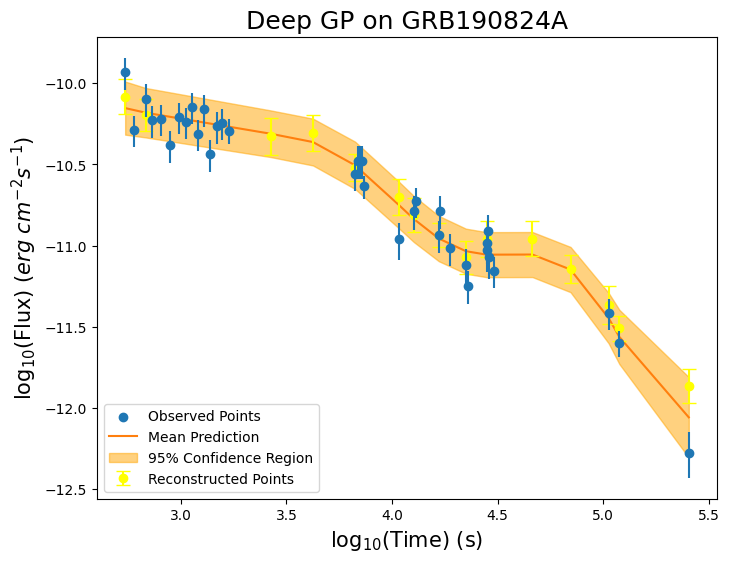


-----TRAINING FOR GRB191004A-----


-----ORIGINAL GRB-----



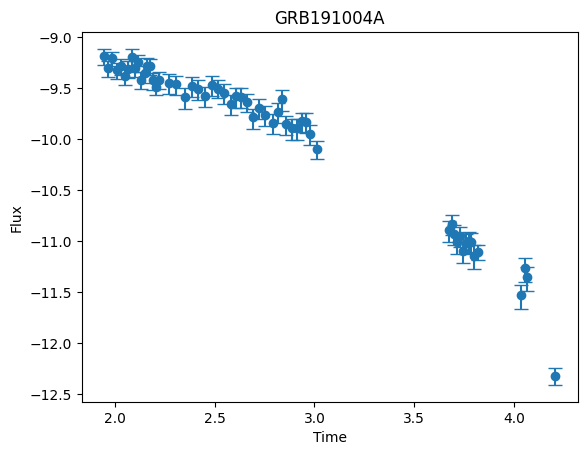


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.9696
Iteration 40/500 - Loss: 39.7179
Iteration 60/500 - Loss: 23.5526
Iteration 80/500 - Loss: 7.6892
Iteration 100/500 - Loss: 3.1865
Iteration 120/500 - Loss: 1.9217
Iteration 140/500 - Loss: 1.2395
Iteration 160/500 - Loss: 0.8323
Iteration 180/500 - Loss: 0.5751
Iteration 200/500 - Loss: 0.3942
Iteration 220/500 - Loss: 0.3241
Iteration 240/500 - Loss: 0.2673
Iteration 260/500 - Loss: 0.2174
Iteration 280/500 - Loss: 0.1733
Iteration 300/500 - Loss: 0.1340
Iteration 320/500 - Loss: 0.0993
Iteration 340/500 - Loss: 0.0746
Iteration 360/500 - Loss: 0.0420
Iteration 380/500 - Loss: 0.0174
Iteration 400/500 - Loss: -0.0000
Iteration 420/500 - Loss: -0.0151
Iteration 440/500 - Loss: -0.0248
Iteration 460/500 - Loss: -0.0341
Iteration 480/500 - Loss: -0.0431
Iteration 500/500 - Loss: -0.0517

-----RECONSTRUCTED GRB-----



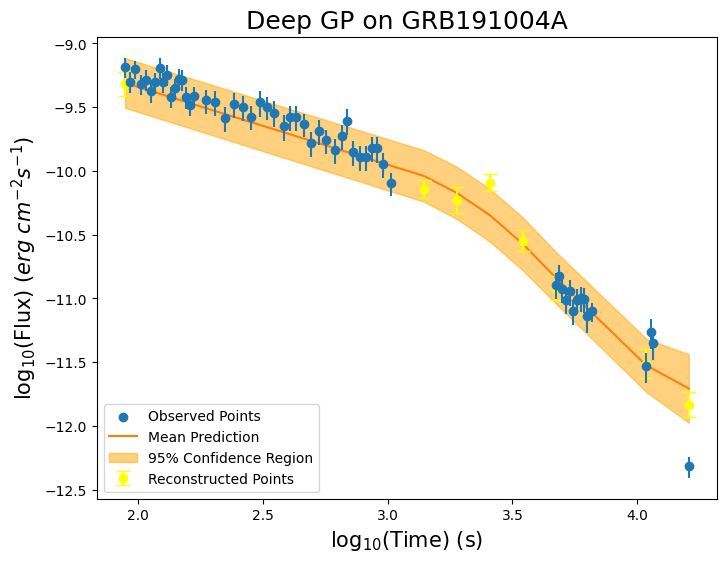


-----TRAINING FOR GRB191017B-----


-----ORIGINAL GRB-----



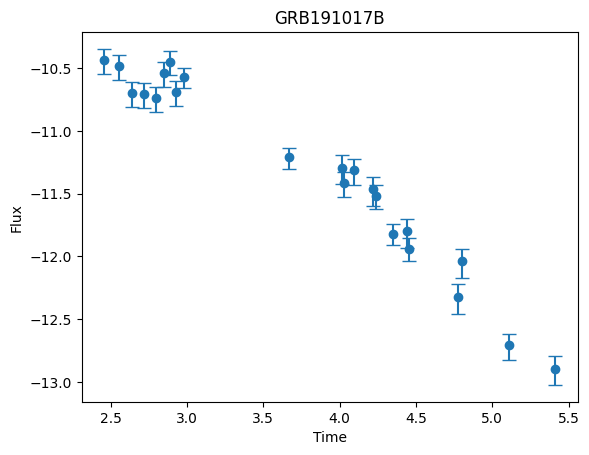


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.1073
Iteration 40/500 - Loss: 35.6778
Iteration 60/500 - Loss: 19.1420
Iteration 80/500 - Loss: 9.2734
Iteration 100/500 - Loss: 4.9333
Iteration 120/500 - Loss: 2.9684
Iteration 140/500 - Loss: 2.0417
Iteration 160/500 - Loss: 1.5465
Iteration 180/500 - Loss: 1.2520
Iteration 200/500 - Loss: 1.0287
Iteration 220/500 - Loss: 0.9260
Iteration 240/500 - Loss: 0.8310
Iteration 260/500 - Loss: 0.7375
Iteration 280/500 - Loss: 0.6508
Iteration 300/500 - Loss: 0.5720
Iteration 320/500 - Loss: 0.5064
Iteration 340/500 - Loss: 0.4567
Iteration 360/500 - Loss: 0.4182
Iteration 380/500 - Loss: 0.3870
Iteration 400/500 - Loss: 0.3603
Iteration 420/500 - Loss: 0.3474
Iteration 440/500 - Loss: 0.3359
Iteration 460/500 - Loss: 0.3249
Iteration 480/500 - Loss: 0.3145
Iteration 500/500 - Loss: 0.3042

-----RECONSTRUCTED GRB-----



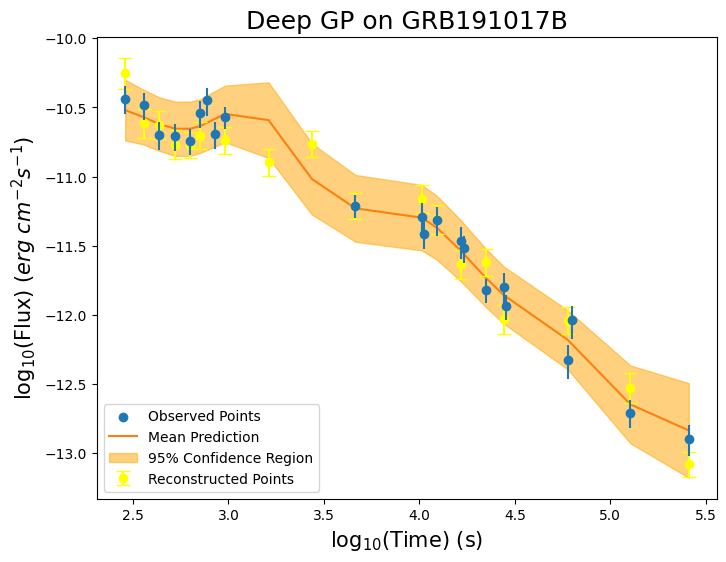


-----TRAINING FOR GRB191029A-----


-----ORIGINAL GRB-----



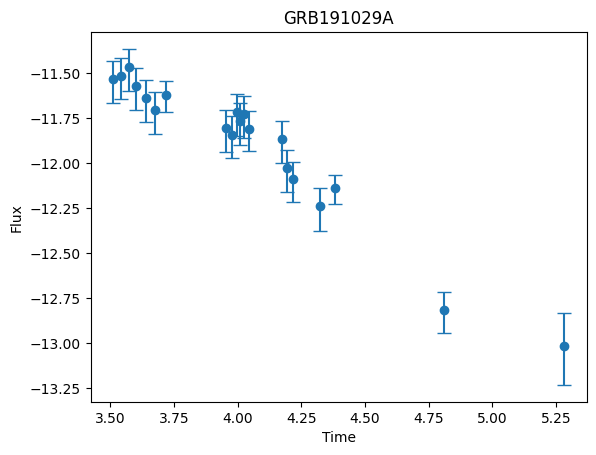


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.7437
Iteration 40/500 - Loss: 37.8919
Iteration 60/500 - Loss: 24.7600
Iteration 80/500 - Loss: 13.9783
Iteration 100/500 - Loss: 8.1572
Iteration 120/500 - Loss: 4.7284
Iteration 140/500 - Loss: 2.7036
Iteration 160/500 - Loss: 1.6305
Iteration 180/500 - Loss: 1.1079
Iteration 200/500 - Loss: 0.8180
Iteration 220/500 - Loss: 0.7117
Iteration 240/500 - Loss: 0.6254
Iteration 260/500 - Loss: 0.5484
Iteration 280/500 - Loss: 0.4783
Iteration 300/500 - Loss: 0.4135
Iteration 320/500 - Loss: 0.3528
Iteration 340/500 - Loss: 0.2959
Iteration 360/500 - Loss: 0.2439
Iteration 380/500 - Loss: 0.1990
Iteration 400/500 - Loss: 0.1617
Iteration 420/500 - Loss: 0.1451
Iteration 440/500 - Loss: 0.1308
Iteration 460/500 - Loss: 0.1177
Iteration 480/500 - Loss: 0.1053
Iteration 500/500 - Loss: 0.0936

-----RECONSTRUCTED GRB-----



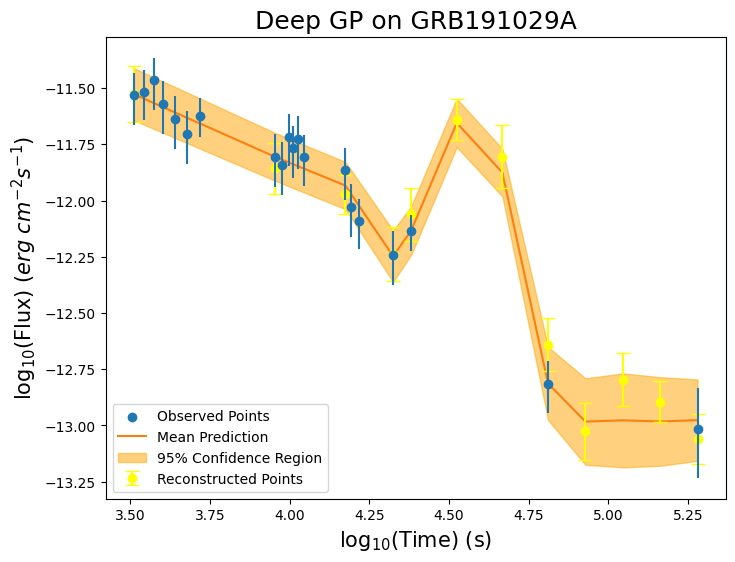


-----TRAINING FOR GRB191101A-----


-----ORIGINAL GRB-----



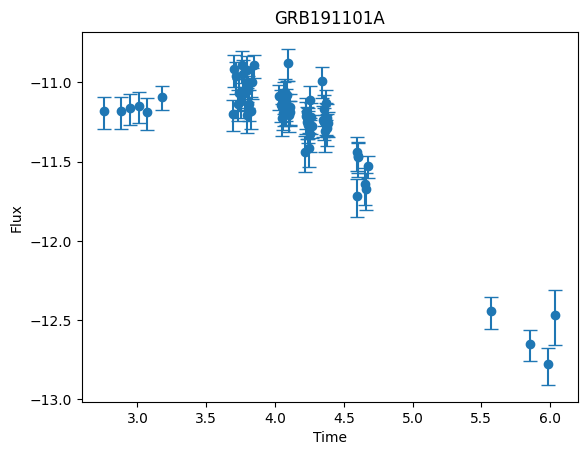


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.7014
Iteration 40/500 - Loss: 38.1199
Iteration 60/500 - Loss: 27.5446
Iteration 80/500 - Loss: 16.9863
Iteration 100/500 - Loss: 9.5218
Iteration 120/500 - Loss: 5.4719
Iteration 140/500 - Loss: 3.4717
Iteration 160/500 - Loss: 2.5438
Iteration 180/500 - Loss: 2.1362
Iteration 200/500 - Loss: 1.9497
Iteration 220/500 - Loss: 1.8919
Iteration 240/500 - Loss: 1.8486
Iteration 260/500 - Loss: 1.8118
Iteration 280/500 - Loss: 1.7794
Iteration 300/500 - Loss: 1.7504
Iteration 320/500 - Loss: 1.7244
Iteration 340/500 - Loss: 1.7008
Iteration 360/500 - Loss: 1.6793
Iteration 380/500 - Loss: 1.6599
Iteration 400/500 - Loss: 1.6422
Iteration 420/500 - Loss: 1.6336
Iteration 440/500 - Loss: 1.6256
Iteration 460/500 - Loss: 1.6178
Iteration 480/500 - Loss: 1.6103
Iteration 500/500 - Loss: 1.6029

-----RECONSTRUCTED GRB-----



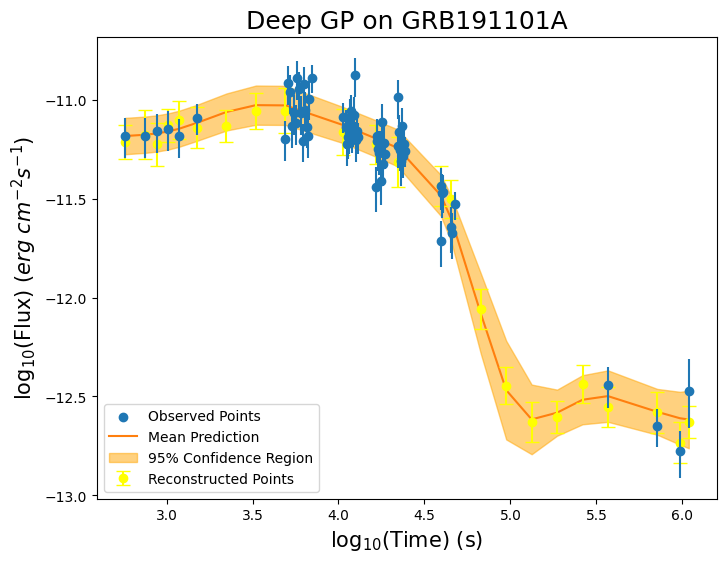


-----TRAINING FOR GRB191122A-----


-----ORIGINAL GRB-----



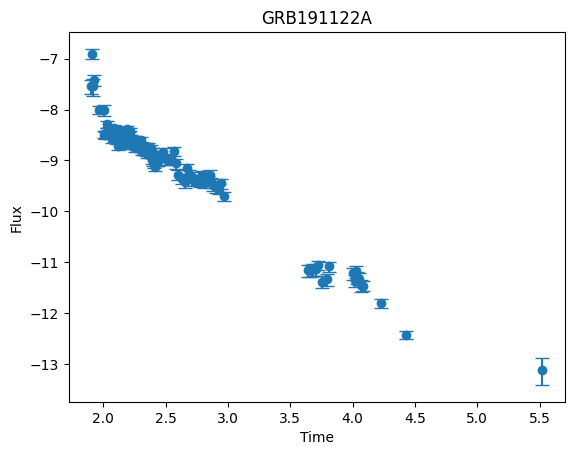


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.6717
Iteration 40/500 - Loss: 38.0064
Iteration 60/500 - Loss: 25.5618
Iteration 80/500 - Loss: 13.5254
Iteration 100/500 - Loss: 6.3207
Iteration 120/500 - Loss: 3.5003
Iteration 140/500 - Loss: 2.5453
Iteration 160/500 - Loss: 2.0800
Iteration 180/500 - Loss: 1.7560
Iteration 200/500 - Loss: 1.4660
Iteration 220/500 - Loss: 1.3060
Iteration 240/500 - Loss: 1.1715
Iteration 260/500 - Loss: 1.0676
Iteration 280/500 - Loss: 0.9903
Iteration 300/500 - Loss: 0.9276
Iteration 320/500 - Loss: 0.8721
Iteration 340/500 - Loss: 0.8208
Iteration 360/500 - Loss: 0.7728
Iteration 380/500 - Loss: 0.7276
Iteration 400/500 - Loss: 0.6864
Iteration 420/500 - Loss: 0.6649
Iteration 440/500 - Loss: 0.6453
Iteration 460/500 - Loss: 0.6262
Iteration 480/500 - Loss: 0.6075
Iteration 500/500 - Loss: 0.5891

-----RECONSTRUCTED GRB-----



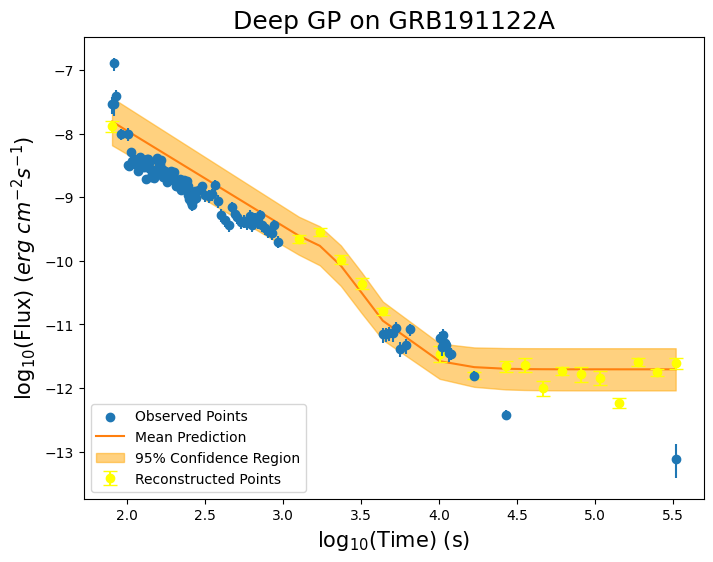


-----TRAINING FOR GRB191123A-----


-----ORIGINAL GRB-----



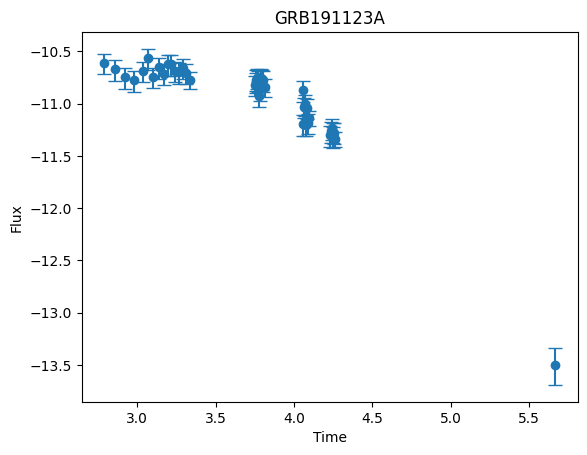


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.7789
Iteration 40/500 - Loss: 42.2541
Iteration 60/500 - Loss: 35.1567
Iteration 80/500 - Loss: 27.2213
Iteration 100/500 - Loss: 20.1163
Iteration 120/500 - Loss: 14.1855
Iteration 140/500 - Loss: 10.1205
Iteration 160/500 - Loss: 7.3526
Iteration 180/500 - Loss: 5.3554
Iteration 200/500 - Loss: 3.8657
Iteration 220/500 - Loss: 3.2466
Iteration 240/500 - Loss: 2.7430
Iteration 260/500 - Loss: 2.3015
Iteration 280/500 - Loss: 1.9259
Iteration 300/500 - Loss: 1.5927
Iteration 320/500 - Loss: 1.3110
Iteration 340/500 - Loss: 1.0716
Iteration 360/500 - Loss: 0.8780
Iteration 380/500 - Loss: 0.7131
Iteration 400/500 - Loss: 0.5679
Iteration 420/500 - Loss: 0.5063
Iteration 440/500 - Loss: 0.4532
Iteration 460/500 - Loss: 0.4047
Iteration 480/500 - Loss: 0.3608
Iteration 500/500 - Loss: 0.3209

-----RECONSTRUCTED GRB-----



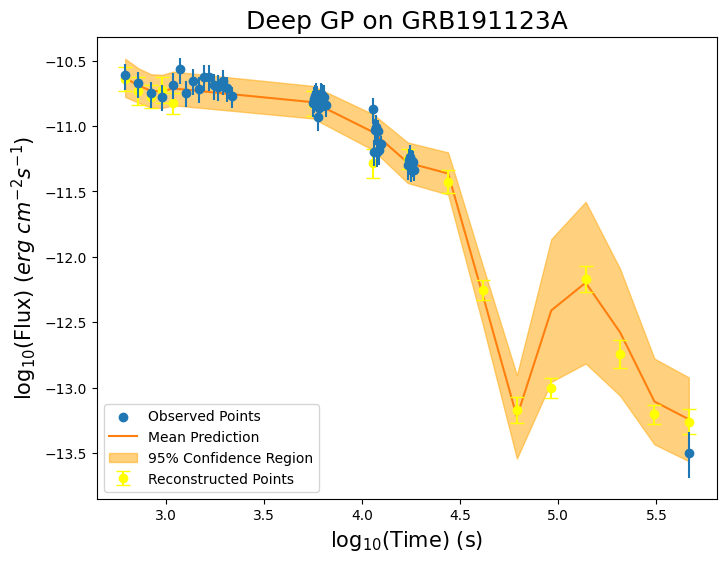


-----TRAINING FOR GRB191220A-----


-----ORIGINAL GRB-----



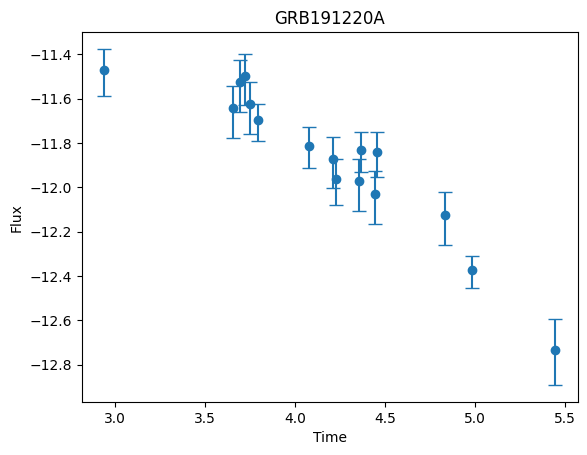


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.4049
Iteration 40/500 - Loss: 37.2644
Iteration 60/500 - Loss: 22.2141
Iteration 80/500 - Loss: 13.9573
Iteration 100/500 - Loss: 8.6717
Iteration 120/500 - Loss: 5.3005
Iteration 140/500 - Loss: 3.3146
Iteration 160/500 - Loss: 2.2123
Iteration 180/500 - Loss: 1.6426
Iteration 200/500 - Loss: 1.3641
Iteration 220/500 - Loss: 1.2869
Iteration 240/500 - Loss: 1.2370
Iteration 260/500 - Loss: 1.1979
Iteration 280/500 - Loss: 1.1654
Iteration 300/500 - Loss: 1.1375
Iteration 320/500 - Loss: 1.1127
Iteration 340/500 - Loss: 1.0904
Iteration 360/500 - Loss: 1.0699
Iteration 380/500 - Loss: 1.0509
Iteration 400/500 - Loss: 1.0332
Iteration 420/500 - Loss: 1.0243
Iteration 440/500 - Loss: 1.0160
Iteration 460/500 - Loss: 1.0079
Iteration 480/500 - Loss: 1.0001
Iteration 500/500 - Loss: 0.9927

-----RECONSTRUCTED GRB-----



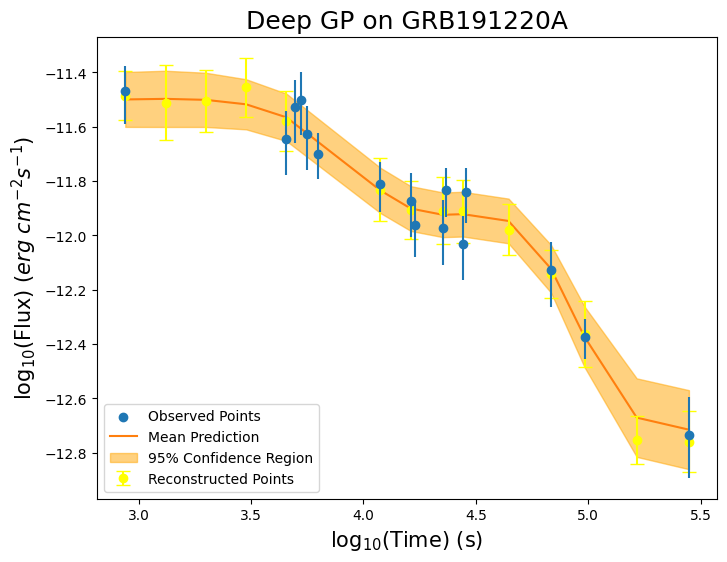


-----TRAINING FOR GRB191228A-----


-----ORIGINAL GRB-----



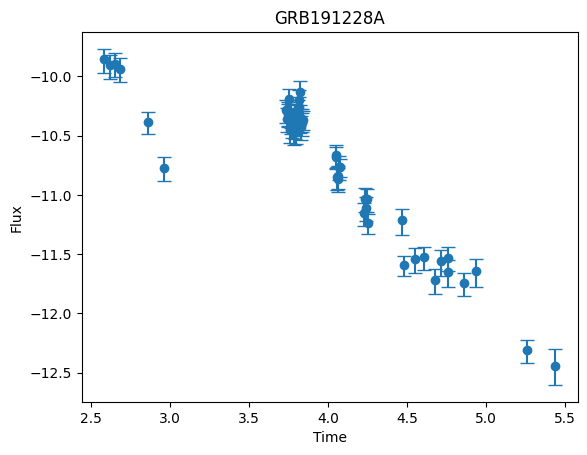


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.8698
Iteration 40/500 - Loss: 37.4505
Iteration 60/500 - Loss: 19.8274
Iteration 80/500 - Loss: 7.6744
Iteration 100/500 - Loss: 5.0172
Iteration 120/500 - Loss: 4.2192
Iteration 140/500 - Loss: 3.6204
Iteration 160/500 - Loss: 3.0955
Iteration 180/500 - Loss: 2.6136
Iteration 200/500 - Loss: 2.0539
Iteration 220/500 - Loss: 1.7238
Iteration 240/500 - Loss: 1.4174
Iteration 260/500 - Loss: 1.1475
Iteration 280/500 - Loss: 0.9208
Iteration 300/500 - Loss: 0.7326
Iteration 320/500 - Loss: 0.5776
Iteration 340/500 - Loss: 0.4511
Iteration 360/500 - Loss: 0.3486
Iteration 380/500 - Loss: 0.2664
Iteration 400/500 - Loss: 0.2006
Iteration 420/500 - Loss: 0.1716
Iteration 440/500 - Loss: 0.1466
Iteration 460/500 - Loss: 0.1239
Iteration 480/500 - Loss: 0.1030
Iteration 500/500 - Loss: 0.0839

-----RECONSTRUCTED GRB-----



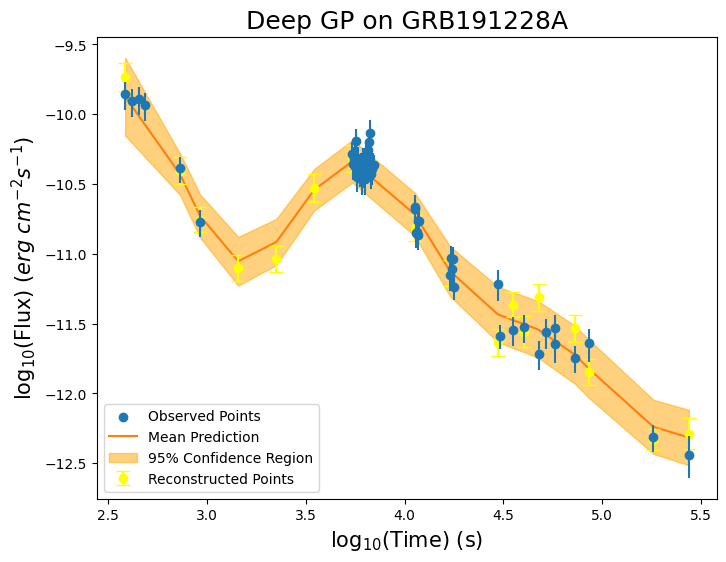


-----TRAINING FOR GRB200131A-----


-----ORIGINAL GRB-----



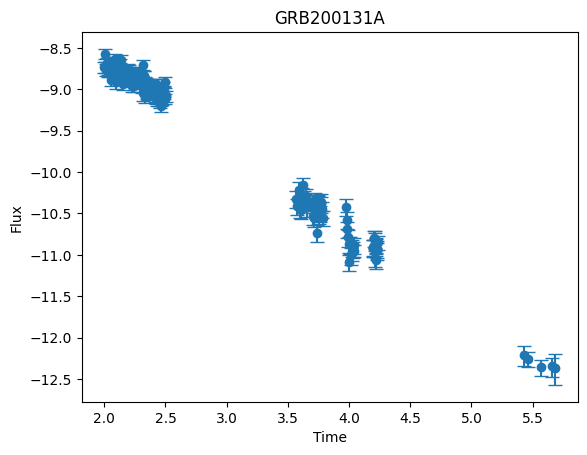


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.5620
Iteration 40/500 - Loss: 38.9888
Iteration 60/500 - Loss: 26.3020
Iteration 80/500 - Loss: 13.4106
Iteration 100/500 - Loss: 6.5824
Iteration 120/500 - Loss: 3.5646
Iteration 140/500 - Loss: 2.1083
Iteration 160/500 - Loss: 1.4638
Iteration 180/500 - Loss: 0.9433
Iteration 200/500 - Loss: 0.5236
Iteration 220/500 - Loss: 0.2711
Iteration 240/500 - Loss: 0.1021
Iteration 260/500 - Loss: -0.0428
Iteration 280/500 - Loss: -0.1655
Iteration 300/500 - Loss: -0.2682
Iteration 320/500 - Loss: -0.3531
Iteration 340/500 - Loss: -0.4229
Iteration 360/500 - Loss: -0.4802
Iteration 380/500 - Loss: -0.5271
Iteration 400/500 - Loss: -0.5658
Iteration 420/500 - Loss: -0.5833
Iteration 440/500 - Loss: -0.5983
Iteration 460/500 - Loss: -0.6122
Iteration 480/500 - Loss: -0.6247
Iteration 500/500 - Loss: -0.6364

-----RECONSTRUCTED GRB-----



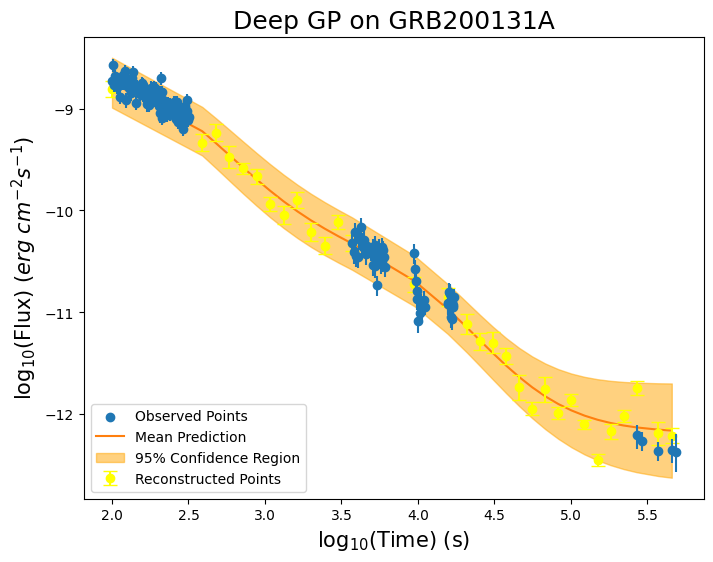


-----TRAINING FOR GRB200215A-----


-----ORIGINAL GRB-----



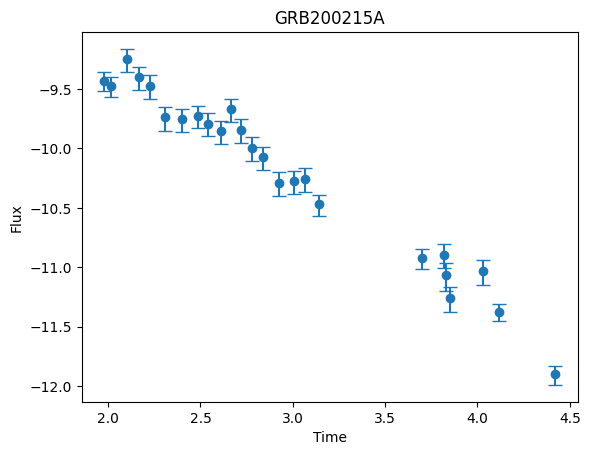


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.9648
Iteration 40/500 - Loss: 28.7995
Iteration 60/500 - Loss: 12.2045
Iteration 80/500 - Loss: 5.9460
Iteration 100/500 - Loss: 3.8249
Iteration 120/500 - Loss: 3.0665
Iteration 140/500 - Loss: 2.4293
Iteration 160/500 - Loss: 1.8363
Iteration 180/500 - Loss: 1.4051
Iteration 200/500 - Loss: 1.0738
Iteration 220/500 - Loss: 0.9358
Iteration 240/500 - Loss: 0.8218
Iteration 260/500 - Loss: 0.7201
Iteration 280/500 - Loss: 0.6268
Iteration 300/500 - Loss: 0.5376
Iteration 320/500 - Loss: 0.4480
Iteration 340/500 - Loss: 0.3584
Iteration 360/500 - Loss: 0.2758
Iteration 380/500 - Loss: 0.2020
Iteration 400/500 - Loss: 0.1399
Iteration 420/500 - Loss: 0.1127
Iteration 440/500 - Loss: 0.0900
Iteration 460/500 - Loss: 0.0697
Iteration 480/500 - Loss: 0.0517
Iteration 500/500 - Loss: 0.0353

-----RECONSTRUCTED GRB-----



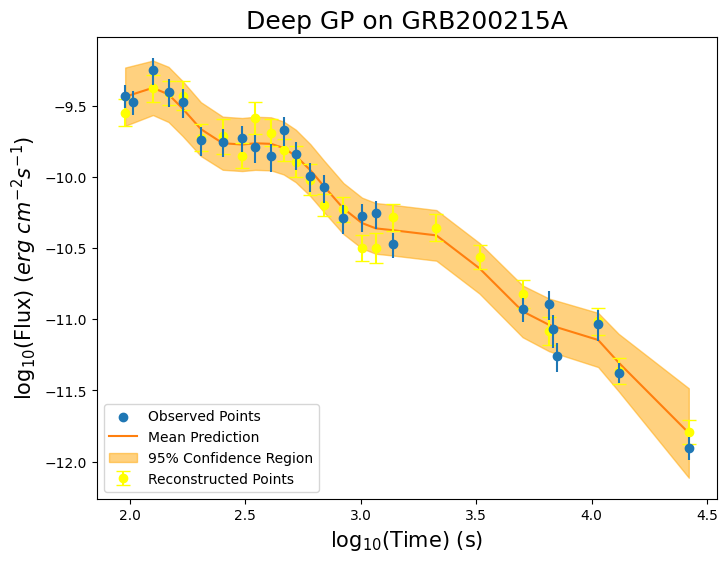


-----TRAINING FOR GRB200219A-----


-----ORIGINAL GRB-----



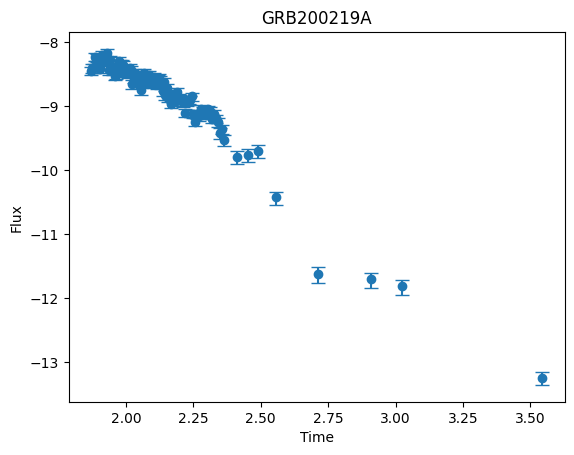


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.7597
Iteration 40/500 - Loss: 37.7102
Iteration 60/500 - Loss: 26.9725
Iteration 80/500 - Loss: 17.4421
Iteration 100/500 - Loss: 10.6985
Iteration 120/500 - Loss: 6.3632
Iteration 140/500 - Loss: 3.7125
Iteration 160/500 - Loss: 2.5206
Iteration 180/500 - Loss: 1.4378
Iteration 200/500 - Loss: 0.9664
Iteration 220/500 - Loss: 0.8208
Iteration 240/500 - Loss: 0.7247
Iteration 260/500 - Loss: 0.6510
Iteration 280/500 - Loss: 0.5929
Iteration 300/500 - Loss: 0.5462
Iteration 320/500 - Loss: 0.5078
Iteration 340/500 - Loss: 0.4761
Iteration 360/500 - Loss: 0.4495
Iteration 380/500 - Loss: 0.4271
Iteration 400/500 - Loss: 0.4080
Iteration 420/500 - Loss: 0.3990
Iteration 440/500 - Loss: 0.3911
Iteration 460/500 - Loss: 0.3837
Iteration 480/500 - Loss: 0.3766
Iteration 500/500 - Loss: 0.3699

-----RECONSTRUCTED GRB-----



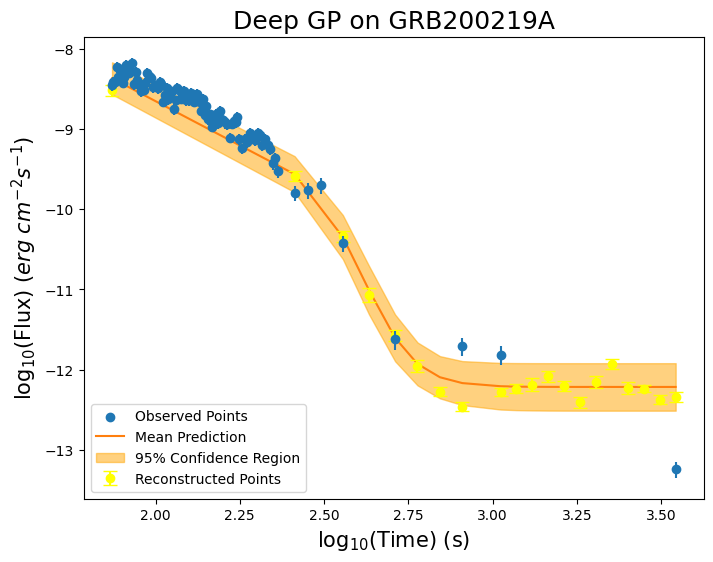


-----TRAINING FOR GRB200227A-----


-----ORIGINAL GRB-----



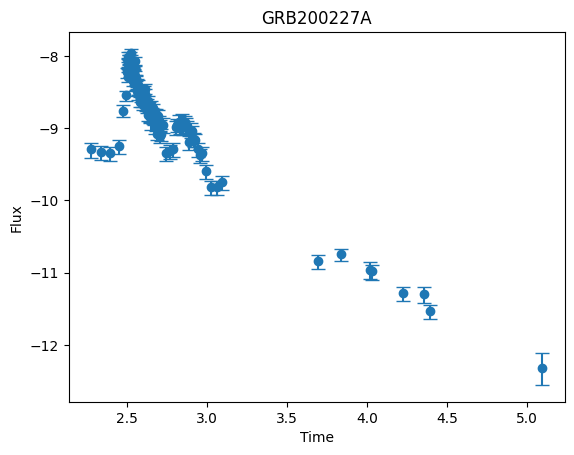


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.3590
Iteration 40/500 - Loss: 40.9053
Iteration 60/500 - Loss: 32.7290
Iteration 80/500 - Loss: 23.2690
Iteration 100/500 - Loss: 14.8783
Iteration 120/500 - Loss: 9.9713
Iteration 140/500 - Loss: 7.0485
Iteration 160/500 - Loss: 4.6402
Iteration 180/500 - Loss: 3.1514
Iteration 200/500 - Loss: 2.2940
Iteration 220/500 - Loss: 2.0193
Iteration 240/500 - Loss: 1.8326
Iteration 260/500 - Loss: 1.6937
Iteration 280/500 - Loss: 1.5901
Iteration 300/500 - Loss: 1.5070
Iteration 320/500 - Loss: 1.4444
Iteration 340/500 - Loss: 1.3908
Iteration 360/500 - Loss: 1.3492
Iteration 380/500 - Loss: 1.3102
Iteration 400/500 - Loss: 1.2808
Iteration 420/500 - Loss: 1.2625
Iteration 440/500 - Loss: 1.2490
Iteration 460/500 - Loss: 1.2361
Iteration 480/500 - Loss: 1.2237
Iteration 500/500 - Loss: 1.2117

-----RECONSTRUCTED GRB-----



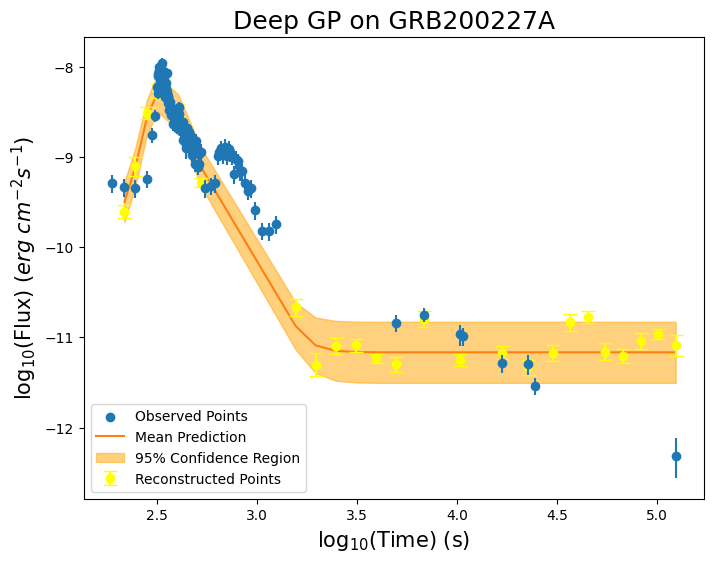


-----TRAINING FOR GRB200303A-----


-----ORIGINAL GRB-----



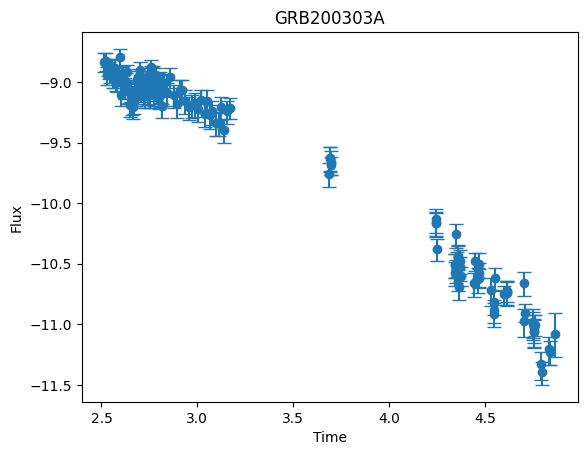


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.3012
Iteration 40/500 - Loss: 38.2642
Iteration 60/500 - Loss: 25.8139
Iteration 80/500 - Loss: 11.9087
Iteration 100/500 - Loss: 4.6951
Iteration 120/500 - Loss: 1.6421
Iteration 140/500 - Loss: 0.5085
Iteration 160/500 - Loss: 0.0719
Iteration 180/500 - Loss: -0.1239
Iteration 200/500 - Loss: -0.2330
Iteration 220/500 - Loss: -0.2727
Iteration 240/500 - Loss: -0.3028
Iteration 260/500 - Loss: -0.3290
Iteration 280/500 - Loss: -0.3521
Iteration 300/500 - Loss: -0.3727
Iteration 320/500 - Loss: -0.3910
Iteration 340/500 - Loss: -0.4075
Iteration 360/500 - Loss: -0.4225
Iteration 380/500 - Loss: -0.4360
Iteration 400/500 - Loss: -0.4483
Iteration 420/500 - Loss: -0.4544
Iteration 440/500 - Loss: -0.4599
Iteration 460/500 - Loss: -0.4653
Iteration 480/500 - Loss: -0.4705
Iteration 500/500 - Loss: -0.4755

-----RECONSTRUCTED GRB-----



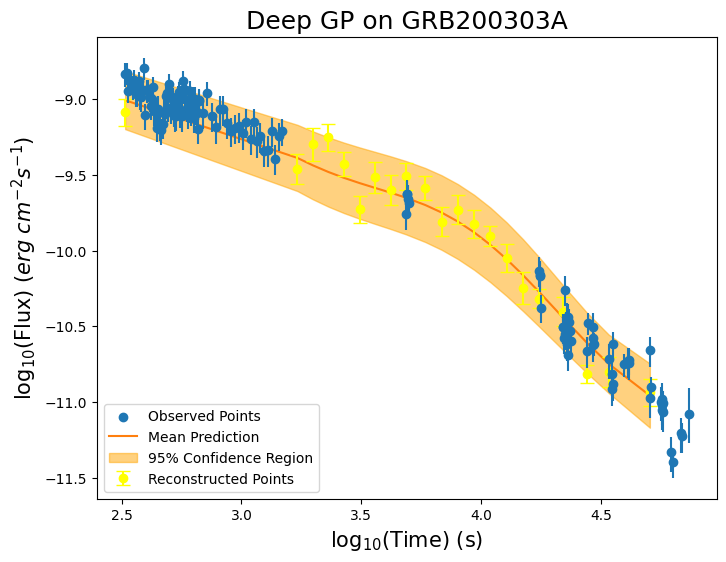


-----TRAINING FOR GRB200306A-----


-----ORIGINAL GRB-----



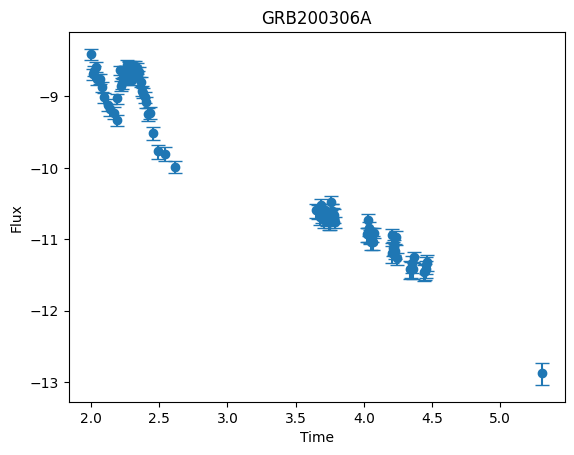


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.3678
Iteration 40/500 - Loss: 37.5468
Iteration 60/500 - Loss: 22.6151
Iteration 80/500 - Loss: 9.4293
Iteration 100/500 - Loss: 3.7351
Iteration 120/500 - Loss: 1.7662
Iteration 140/500 - Loss: 1.1162
Iteration 160/500 - Loss: 0.8699
Iteration 180/500 - Loss: 0.6757
Iteration 200/500 - Loss: 0.5409
Iteration 220/500 - Loss: 0.4894
Iteration 240/500 - Loss: 0.4478
Iteration 260/500 - Loss: 0.4108
Iteration 280/500 - Loss: 0.3774
Iteration 300/500 - Loss: 0.3470
Iteration 320/500 - Loss: 0.3192
Iteration 340/500 - Loss: 0.2937
Iteration 360/500 - Loss: 0.2702
Iteration 380/500 - Loss: 0.2484
Iteration 400/500 - Loss: 0.2280
Iteration 420/500 - Loss: 0.2178
Iteration 440/500 - Loss: 0.2083
Iteration 460/500 - Loss: 0.1988
Iteration 480/500 - Loss: 0.1895
Iteration 500/500 - Loss: 0.1803

-----RECONSTRUCTED GRB-----



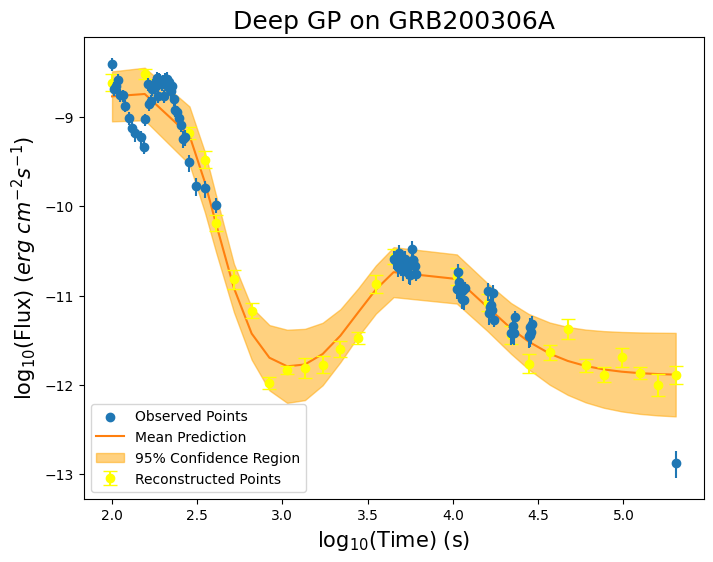


-----TRAINING FOR GRB200324A-----


-----ORIGINAL GRB-----



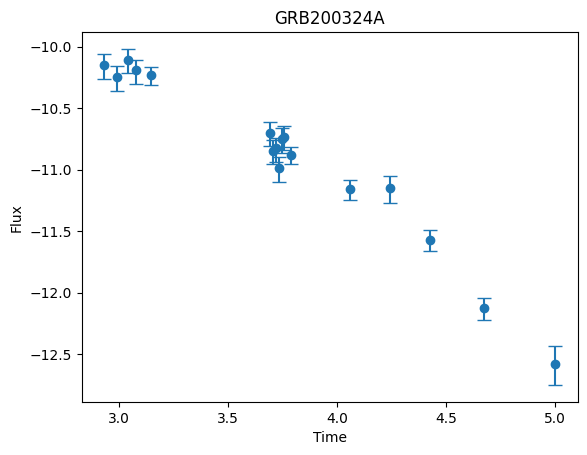


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.9668
Iteration 40/500 - Loss: 33.8139
Iteration 60/500 - Loss: 18.6595
Iteration 80/500 - Loss: 11.6037
Iteration 100/500 - Loss: 7.1378
Iteration 120/500 - Loss: 4.2358
Iteration 140/500 - Loss: 2.3551
Iteration 160/500 - Loss: 1.2613
Iteration 180/500 - Loss: 0.7360
Iteration 200/500 - Loss: 0.5129
Iteration 220/500 - Loss: 0.4473
Iteration 240/500 - Loss: 0.3979
Iteration 260/500 - Loss: 0.3559
Iteration 280/500 - Loss: 0.3191
Iteration 300/500 - Loss: 0.2867
Iteration 320/500 - Loss: 0.2580
Iteration 340/500 - Loss: 0.2322
Iteration 360/500 - Loss: 0.2092
Iteration 380/500 - Loss: 0.1886
Iteration 400/500 - Loss: 0.1700
Iteration 420/500 - Loss: 0.1610
Iteration 440/500 - Loss: 0.1528
Iteration 460/500 - Loss: 0.1449
Iteration 480/500 - Loss: 0.1373
Iteration 500/500 - Loss: 0.1300

-----RECONSTRUCTED GRB-----



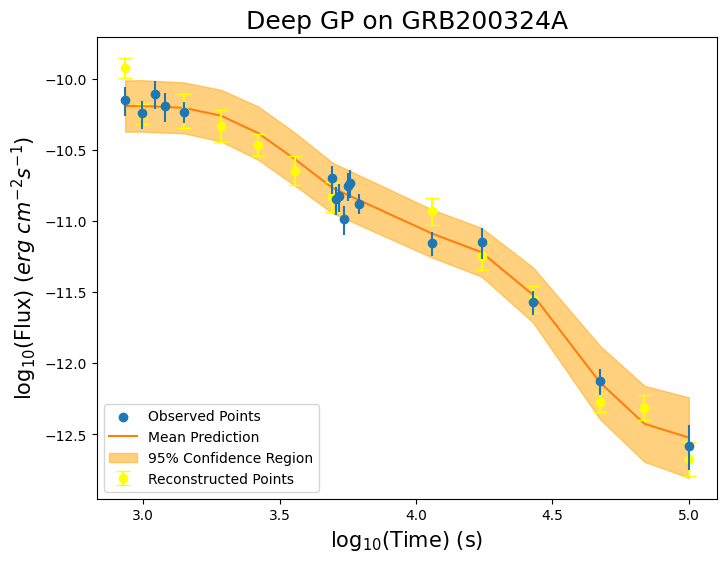


-----TRAINING FOR GRB200409A-----


-----ORIGINAL GRB-----



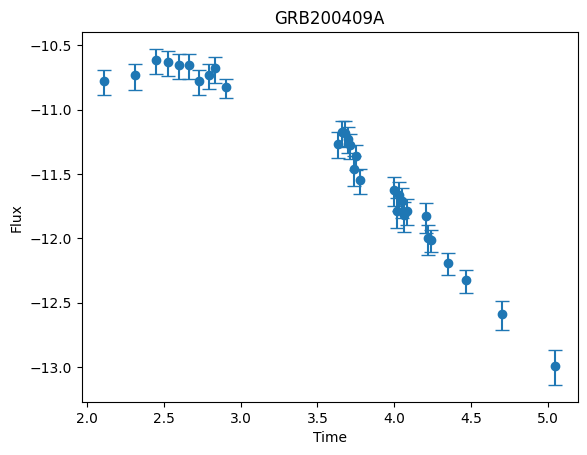


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.6471
Iteration 40/500 - Loss: 34.0413
Iteration 60/500 - Loss: 19.0404
Iteration 80/500 - Loss: 8.4960
Iteration 100/500 - Loss: 4.5394
Iteration 120/500 - Loss: 2.2789
Iteration 140/500 - Loss: 1.0864
Iteration 160/500 - Loss: 0.5346
Iteration 180/500 - Loss: 0.3217
Iteration 200/500 - Loss: 0.1362
Iteration 220/500 - Loss: 0.0823
Iteration 240/500 - Loss: 0.0391
Iteration 260/500 - Loss: 0.0011
Iteration 280/500 - Loss: -0.0327
Iteration 300/500 - Loss: -0.0632
Iteration 320/500 - Loss: -0.0907
Iteration 340/500 - Loss: -0.1158
Iteration 360/500 - Loss: -0.1389
Iteration 380/500 - Loss: -0.1606
Iteration 400/500 - Loss: -0.1800
Iteration 420/500 - Loss: -0.1892
Iteration 440/500 - Loss: -0.1974
Iteration 460/500 - Loss: -0.2051
Iteration 480/500 - Loss: -0.2125
Iteration 500/500 - Loss: -0.2196

-----RECONSTRUCTED GRB-----



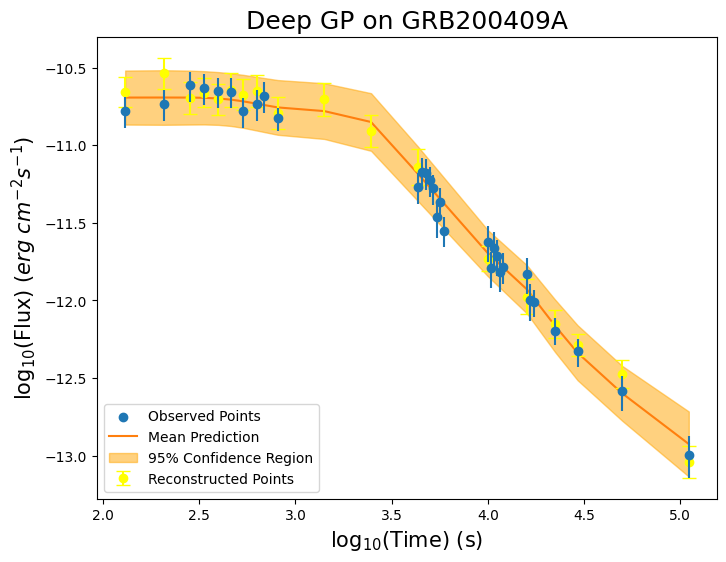


-----TRAINING FOR GRB200410A-----


-----ORIGINAL GRB-----



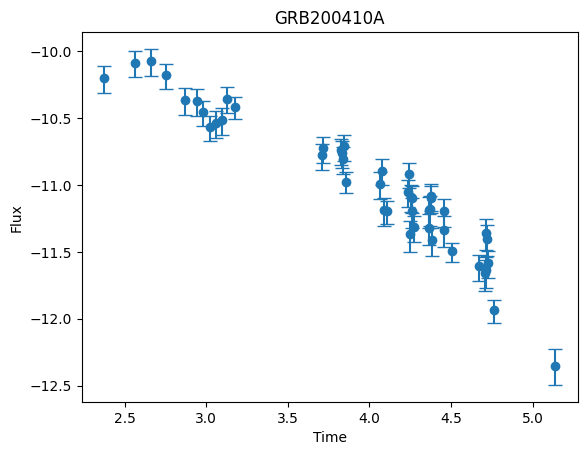


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.3803
Iteration 40/500 - Loss: 30.3345
Iteration 60/500 - Loss: 14.4167
Iteration 80/500 - Loss: 9.0540
Iteration 100/500 - Loss: 6.2215
Iteration 120/500 - Loss: 4.6129
Iteration 140/500 - Loss: 3.5303
Iteration 160/500 - Loss: 2.7759
Iteration 180/500 - Loss: 2.2671
Iteration 200/500 - Loss: 1.9172
Iteration 220/500 - Loss: 1.7788
Iteration 240/500 - Loss: 1.6693
Iteration 260/500 - Loss: 1.5755
Iteration 280/500 - Loss: 1.4949
Iteration 300/500 - Loss: 1.4255
Iteration 320/500 - Loss: 1.3679
Iteration 340/500 - Loss: 1.3189
Iteration 360/500 - Loss: 1.2771
Iteration 380/500 - Loss: 1.2405
Iteration 400/500 - Loss: 1.2146
Iteration 420/500 - Loss: 1.1941
Iteration 440/500 - Loss: 1.1791
Iteration 460/500 - Loss: 1.1653
Iteration 480/500 - Loss: 1.1518
Iteration 500/500 - Loss: 1.1388

-----RECONSTRUCTED GRB-----



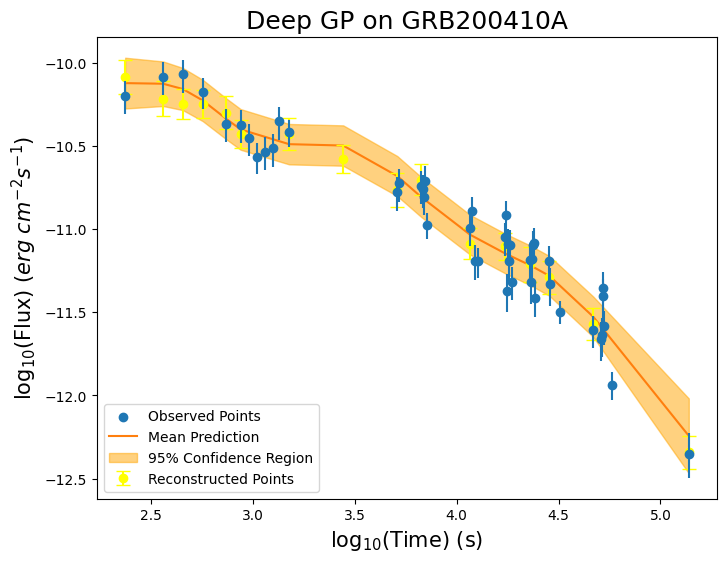


-----TRAINING FOR GRB200512A-----


-----ORIGINAL GRB-----



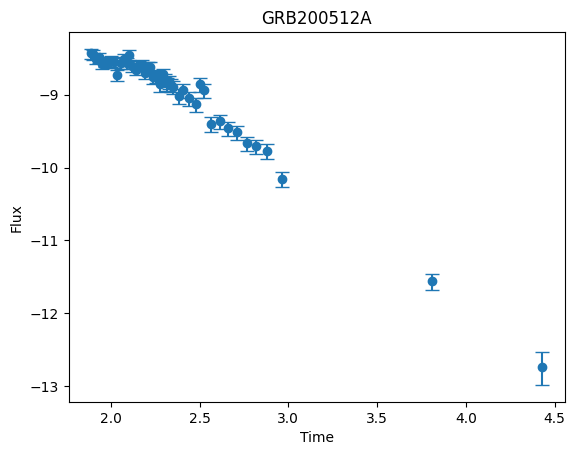


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.4854
Iteration 40/500 - Loss: 39.4824
Iteration 60/500 - Loss: 30.3732
Iteration 80/500 - Loss: 18.9895
Iteration 100/500 - Loss: 9.6817
Iteration 120/500 - Loss: 4.8531
Iteration 140/500 - Loss: 2.6421
Iteration 160/500 - Loss: 1.5761
Iteration 180/500 - Loss: 1.1092
Iteration 200/500 - Loss: 0.8698
Iteration 220/500 - Loss: 0.7869
Iteration 240/500 - Loss: 0.8470
Iteration 260/500 - Loss: 0.7019
Iteration 280/500 - Loss: 0.6616
Iteration 300/500 - Loss: 0.6255
Iteration 320/500 - Loss: 0.5961
Iteration 340/500 - Loss: 0.5709
Iteration 360/500 - Loss: 0.5580
Iteration 380/500 - Loss: 0.5657
Iteration 400/500 - Loss: 0.5247
Iteration 420/500 - Loss: 0.5114
Iteration 440/500 - Loss: 0.5038
Iteration 460/500 - Loss: 0.4965
Iteration 480/500 - Loss: 0.4896
Iteration 500/500 - Loss: 0.4830

-----RECONSTRUCTED GRB-----



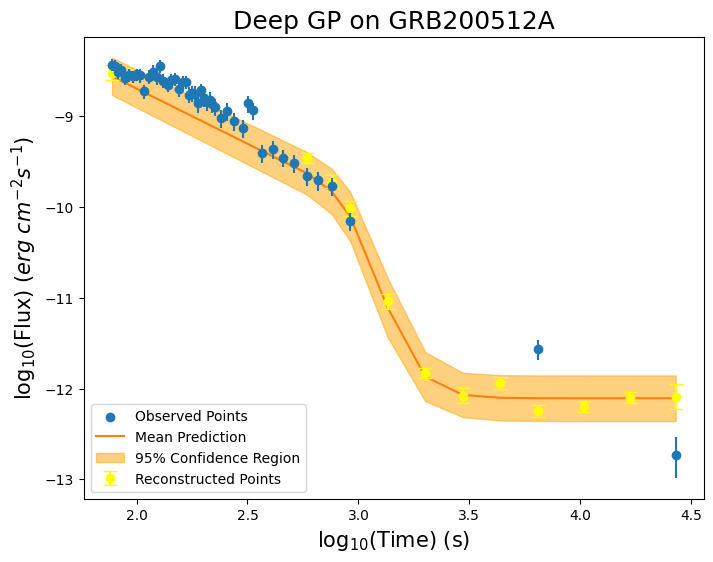


-----TRAINING FOR GRB200519A-----


-----ORIGINAL GRB-----



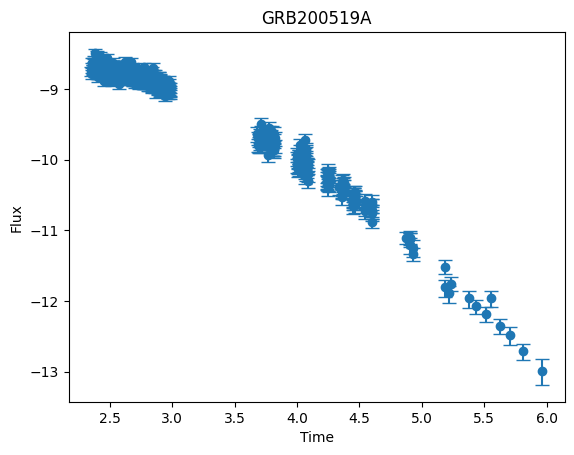


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.9345
Iteration 40/500 - Loss: 39.8171
Iteration 60/500 - Loss: 30.6530
Iteration 80/500 - Loss: 20.4217
Iteration 100/500 - Loss: 11.8206
Iteration 120/500 - Loss: 6.4609
Iteration 140/500 - Loss: 4.0189
Iteration 160/500 - Loss: 2.7011
Iteration 180/500 - Loss: 1.7773
Iteration 200/500 - Loss: 1.1211
Iteration 220/500 - Loss: 0.8511
Iteration 240/500 - Loss: 0.6331
Iteration 260/500 - Loss: 0.4434
Iteration 280/500 - Loss: 0.2781
Iteration 300/500 - Loss: 0.1346
Iteration 320/500 - Loss: 0.0101
Iteration 340/500 - Loss: -0.0975
Iteration 360/500 - Loss: -0.1906
Iteration 380/500 - Loss: -0.2710
Iteration 400/500 - Loss: -0.3402
Iteration 420/500 - Loss: -0.3728
Iteration 440/500 - Loss: -0.4016
Iteration 460/500 - Loss: -0.4287
Iteration 480/500 - Loss: -0.4542
Iteration 500/500 - Loss: -0.4781

-----RECONSTRUCTED GRB-----



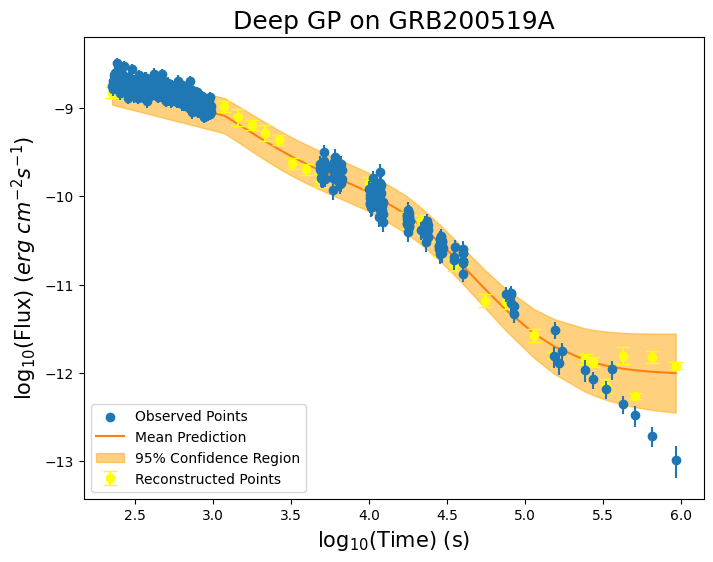


-----TRAINING FOR GRB200528A-----


-----ORIGINAL GRB-----



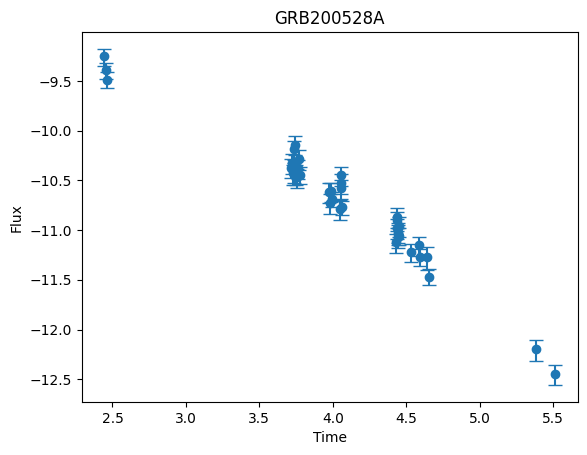


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.9687
Iteration 40/500 - Loss: 34.4980
Iteration 60/500 - Loss: 20.7742
Iteration 80/500 - Loss: 13.3542
Iteration 100/500 - Loss: 9.2741
Iteration 120/500 - Loss: 6.2588
Iteration 140/500 - Loss: 4.0082
Iteration 160/500 - Loss: 2.4091
Iteration 180/500 - Loss: 1.3881
Iteration 200/500 - Loss: 0.8143
Iteration 220/500 - Loss: 0.6374
Iteration 240/500 - Loss: 0.5200
Iteration 260/500 - Loss: 0.4346
Iteration 280/500 - Loss: 0.3721
Iteration 300/500 - Loss: 0.3261
Iteration 320/500 - Loss: 0.2919
Iteration 340/500 - Loss: 0.2661
Iteration 360/500 - Loss: 0.2458
Iteration 380/500 - Loss: 0.2297
Iteration 400/500 - Loss: 0.2174
Iteration 420/500 - Loss: 0.2101
Iteration 440/500 - Loss: 0.2046
Iteration 460/500 - Loss: 0.1995
Iteration 480/500 - Loss: 0.1945
Iteration 500/500 - Loss: 0.1900

-----RECONSTRUCTED GRB-----



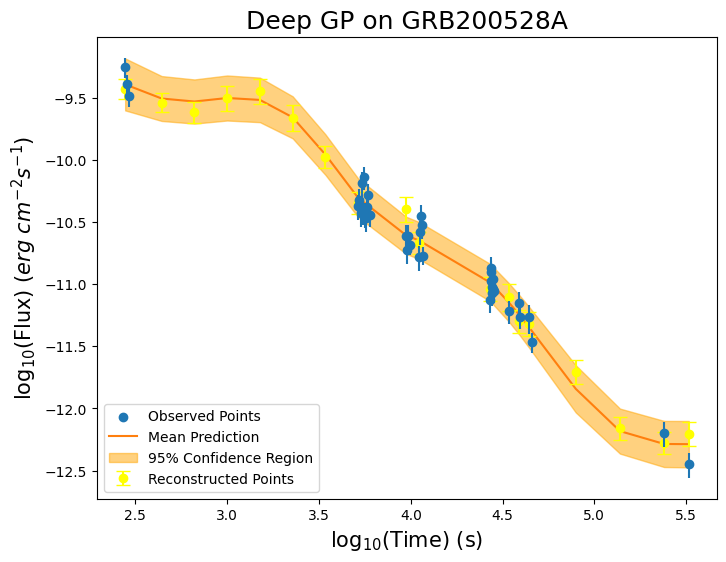


-----TRAINING FOR GRB200711A-----


-----ORIGINAL GRB-----



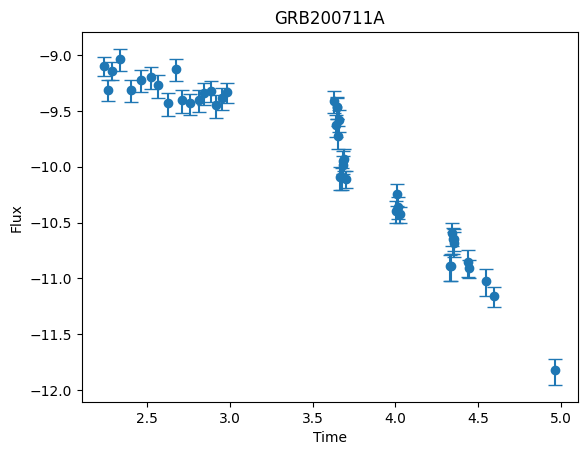


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.0650
Iteration 40/500 - Loss: 32.3737
Iteration 60/500 - Loss: 15.3535
Iteration 80/500 - Loss: 7.5987
Iteration 100/500 - Loss: 4.9179
Iteration 120/500 - Loss: 3.7906
Iteration 140/500 - Loss: 3.1248
Iteration 160/500 - Loss: 2.6260
Iteration 180/500 - Loss: 2.1979
Iteration 200/500 - Loss: 1.8213
Iteration 220/500 - Loss: 1.6492
Iteration 240/500 - Loss: 1.5044
Iteration 260/500 - Loss: 1.3801
Iteration 280/500 - Loss: 1.2773
Iteration 300/500 - Loss: 1.1932
Iteration 320/500 - Loss: 1.1229
Iteration 340/500 - Loss: 1.0612
Iteration 360/500 - Loss: 1.0039
Iteration 380/500 - Loss: 0.9480
Iteration 400/500 - Loss: 0.8899
Iteration 420/500 - Loss: 0.8560
Iteration 440/500 - Loss: 0.8195
Iteration 460/500 - Loss: 0.7765
Iteration 480/500 - Loss: 0.7240
Iteration 500/500 - Loss: 0.6596

-----RECONSTRUCTED GRB-----



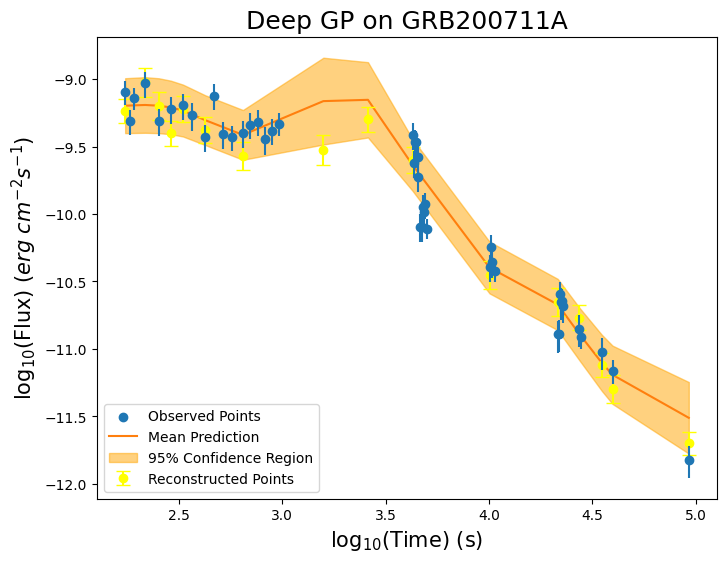


-----TRAINING FOR GRB200713A-----


-----ORIGINAL GRB-----



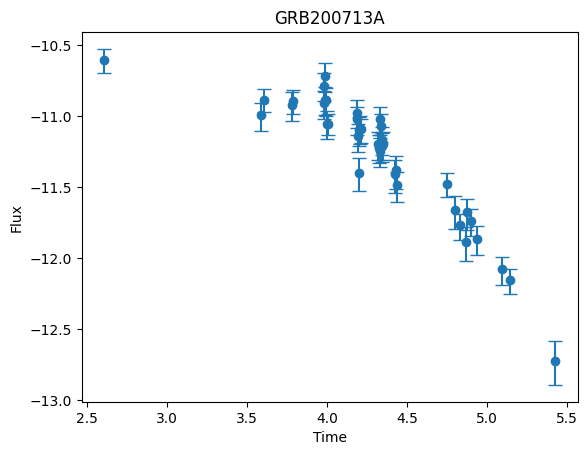


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.3440
Iteration 40/500 - Loss: 37.4417
Iteration 60/500 - Loss: 20.2696
Iteration 80/500 - Loss: 9.9440
Iteration 100/500 - Loss: 6.4506
Iteration 120/500 - Loss: 4.6333
Iteration 140/500 - Loss: 3.5242
Iteration 160/500 - Loss: 2.8237
Iteration 180/500 - Loss: 2.3396
Iteration 200/500 - Loss: 1.9861
Iteration 220/500 - Loss: 1.8402
Iteration 240/500 - Loss: 1.7203
Iteration 260/500 - Loss: 1.6152
Iteration 280/500 - Loss: 1.5234
Iteration 300/500 - Loss: 1.4436
Iteration 320/500 - Loss: 1.3744
Iteration 340/500 - Loss: 1.3147
Iteration 360/500 - Loss: 1.2632
Iteration 380/500 - Loss: 1.2191
Iteration 400/500 - Loss: 1.1816
Iteration 420/500 - Loss: 1.1643
Iteration 440/500 - Loss: 1.1490
Iteration 460/500 - Loss: 1.1348
Iteration 480/500 - Loss: 1.1216
Iteration 500/500 - Loss: 1.1093

-----RECONSTRUCTED GRB-----



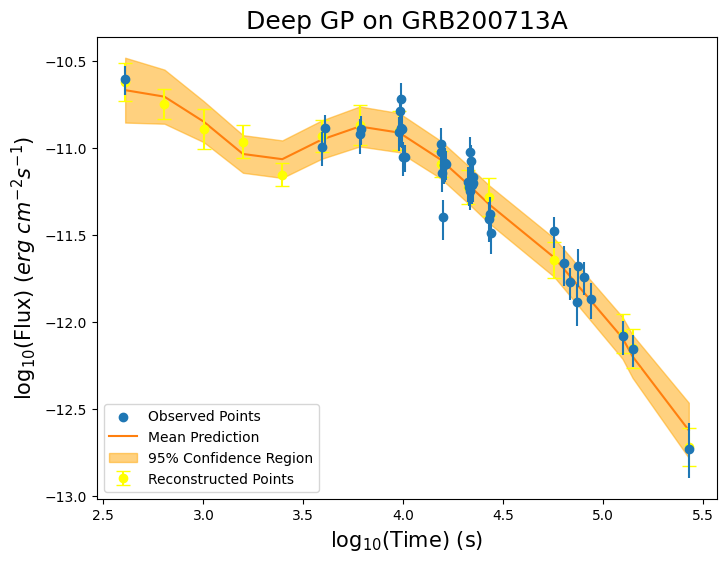


-----TRAINING FOR GRB200716C-----


-----ORIGINAL GRB-----



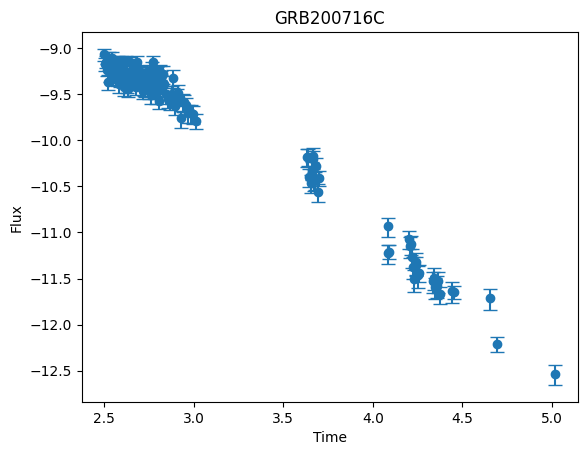


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.5970
Iteration 40/500 - Loss: 37.6985
Iteration 60/500 - Loss: 25.1270
Iteration 80/500 - Loss: 12.3057
Iteration 100/500 - Loss: 4.2514
Iteration 120/500 - Loss: 1.5686
Iteration 140/500 - Loss: 0.7893
Iteration 160/500 - Loss: 0.4792
Iteration 180/500 - Loss: 0.2818
Iteration 200/500 - Loss: 0.0897
Iteration 220/500 - Loss: 0.0005
Iteration 240/500 - Loss: -0.0697
Iteration 260/500 - Loss: -0.1292
Iteration 280/500 - Loss: -0.1790
Iteration 300/500 - Loss: -0.2207
Iteration 320/500 - Loss: -0.2560
Iteration 340/500 - Loss: -0.2862
Iteration 360/500 - Loss: -0.3124
Iteration 380/500 - Loss: -0.3353
Iteration 400/500 - Loss: -0.3554
Iteration 420/500 - Loss: -0.3650
Iteration 440/500 - Loss: -0.3737
Iteration 460/500 - Loss: -0.3819
Iteration 480/500 - Loss: -0.3898
Iteration 500/500 - Loss: -0.3973

-----RECONSTRUCTED GRB-----



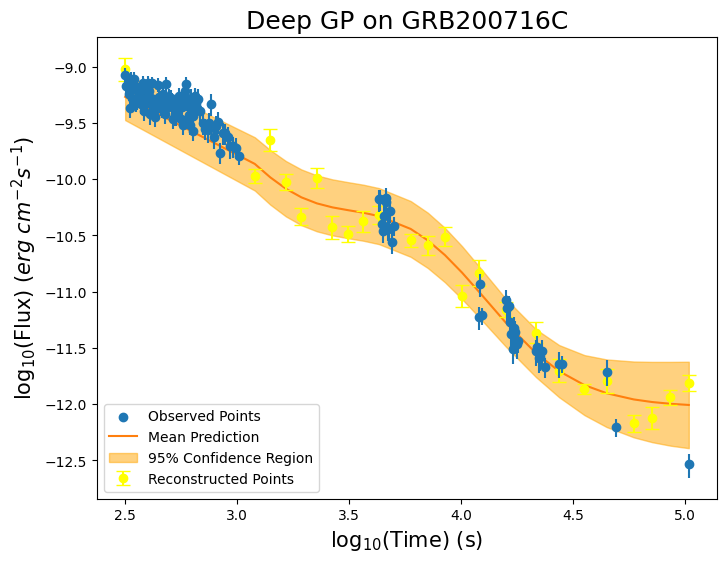


-----TRAINING FOR GRB200729A-----


-----ORIGINAL GRB-----



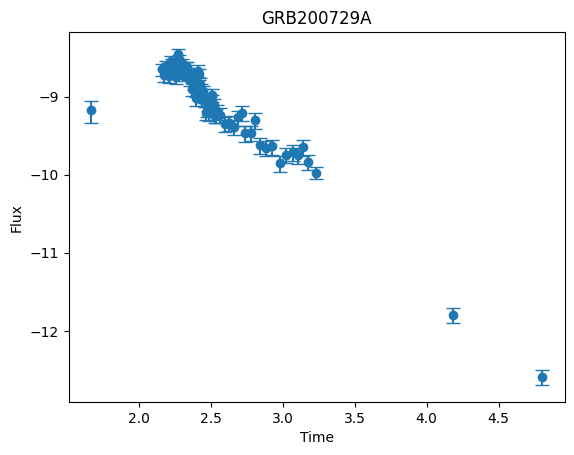


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.1726
Iteration 40/500 - Loss: 38.9969
Iteration 60/500 - Loss: 29.5708
Iteration 80/500 - Loss: 18.9122
Iteration 100/500 - Loss: 11.7710
Iteration 120/500 - Loss: 7.8323
Iteration 140/500 - Loss: 4.9359
Iteration 160/500 - Loss: 3.0955
Iteration 180/500 - Loss: 1.9279
Iteration 200/500 - Loss: 1.2347
Iteration 220/500 - Loss: 1.0048
Iteration 240/500 - Loss: 0.8427
Iteration 260/500 - Loss: 0.7175
Iteration 280/500 - Loss: 0.6243
Iteration 300/500 - Loss: 0.5567
Iteration 320/500 - Loss: 0.5030
Iteration 340/500 - Loss: 0.4652
Iteration 360/500 - Loss: 0.4324
Iteration 380/500 - Loss: 0.4048
Iteration 400/500 - Loss: 0.3828
Iteration 420/500 - Loss: 0.3721
Iteration 440/500 - Loss: 0.3629
Iteration 460/500 - Loss: 0.3542
Iteration 480/500 - Loss: 0.3457
Iteration 500/500 - Loss: 0.3375

-----RECONSTRUCTED GRB-----



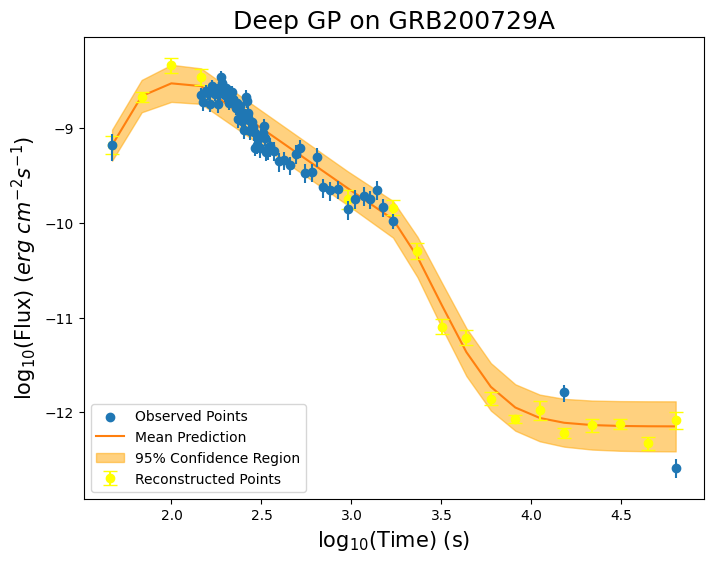


-----TRAINING FOR GRB200906A-----


-----ORIGINAL GRB-----



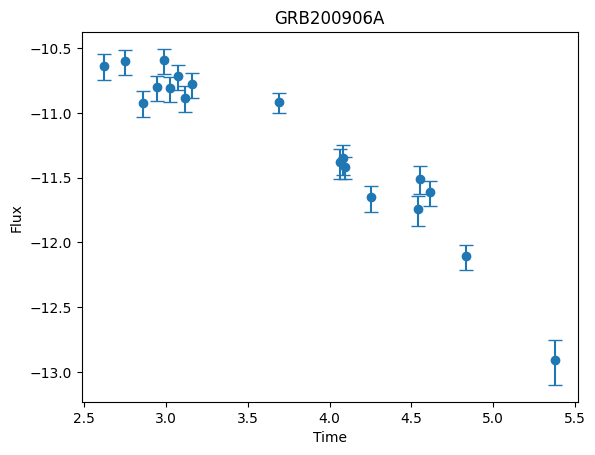


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.8977
Iteration 40/500 - Loss: 34.1273
Iteration 60/500 - Loss: 19.3114
Iteration 80/500 - Loss: 11.2341
Iteration 100/500 - Loss: 7.4239
Iteration 120/500 - Loss: 4.8122
Iteration 140/500 - Loss: 3.1658
Iteration 160/500 - Loss: 2.1431
Iteration 180/500 - Loss: 1.5142
Iteration 200/500 - Loss: 1.1639
Iteration 220/500 - Loss: 1.0452
Iteration 240/500 - Loss: 0.9549
Iteration 260/500 - Loss: 0.8787
Iteration 280/500 - Loss: 0.8139
Iteration 300/500 - Loss: 0.7582
Iteration 320/500 - Loss: 0.7099
Iteration 340/500 - Loss: 0.6678
Iteration 360/500 - Loss: 0.6309
Iteration 380/500 - Loss: 0.5982
Iteration 400/500 - Loss: 0.5690
Iteration 420/500 - Loss: 0.5546
Iteration 440/500 - Loss: 0.5414
Iteration 460/500 - Loss: 0.5285
Iteration 480/500 - Loss: 0.5159
Iteration 500/500 - Loss: 0.5036

-----RECONSTRUCTED GRB-----



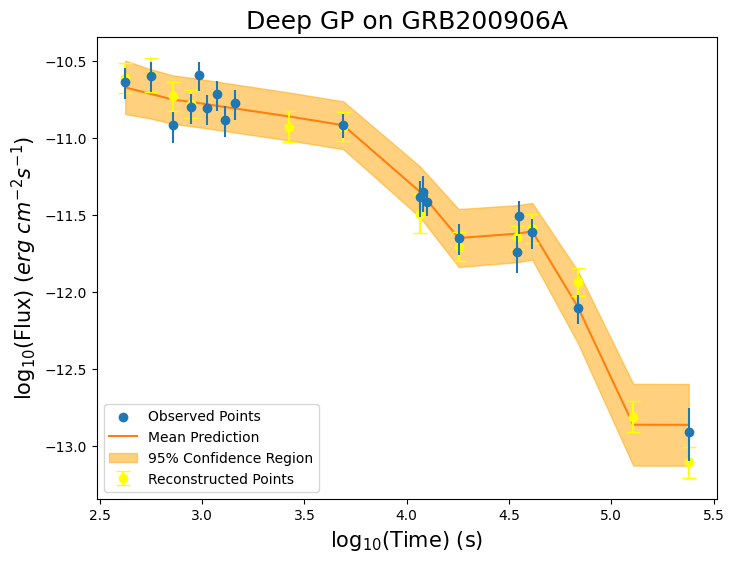


-----TRAINING FOR GRB200925B-----


-----ORIGINAL GRB-----



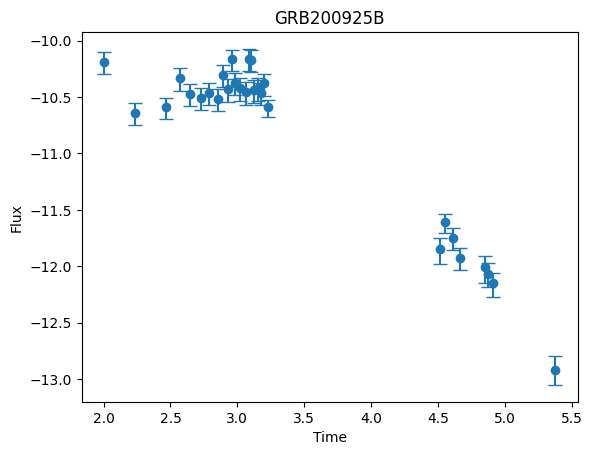


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 45.4322
Iteration 40/500 - Loss: 30.6878
Iteration 60/500 - Loss: 13.4752
Iteration 80/500 - Loss: 5.8891
Iteration 100/500 - Loss: 3.7919
Iteration 120/500 - Loss: 2.9055
Iteration 140/500 - Loss: 2.1646
Iteration 160/500 - Loss: 1.6089
Iteration 180/500 - Loss: 1.1807
Iteration 200/500 - Loss: 0.8769
Iteration 220/500 - Loss: 0.7489
Iteration 240/500 - Loss: 0.6508
Iteration 260/500 - Loss: 0.5671
Iteration 280/500 - Loss: 0.4958
Iteration 300/500 - Loss: 0.4350
Iteration 320/500 - Loss: 0.3829
Iteration 340/500 - Loss: 0.3379
Iteration 360/500 - Loss: 0.2987
Iteration 380/500 - Loss: 0.2643
Iteration 400/500 - Loss: 0.2339
Iteration 420/500 - Loss: 0.2193
Iteration 440/500 - Loss: 0.2061
Iteration 460/500 - Loss: 0.1934
Iteration 480/500 - Loss: 0.1811
Iteration 500/500 - Loss: 0.1692

-----RECONSTRUCTED GRB-----



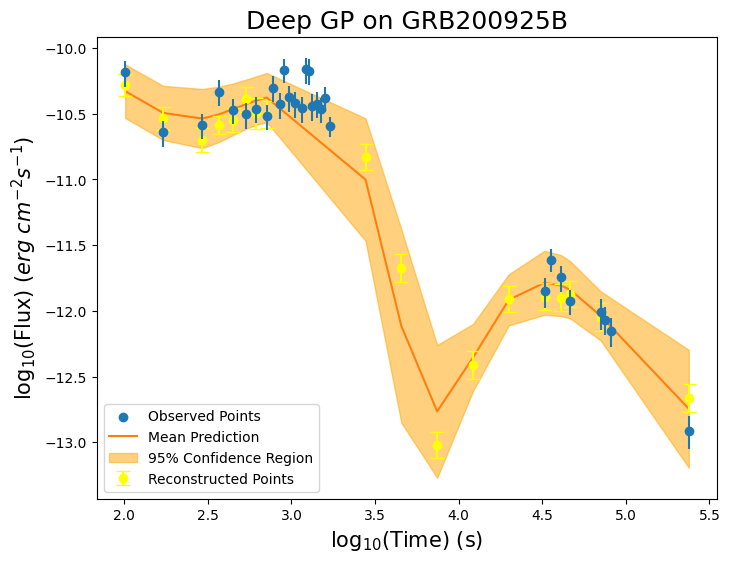


-----TRAINING FOR GRB201027A-----


-----ORIGINAL GRB-----



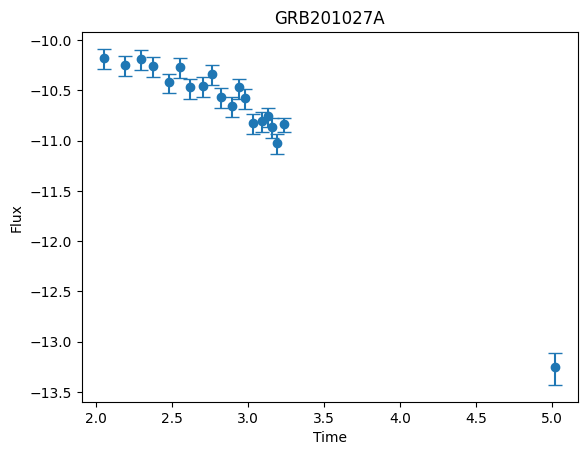


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.8661
Iteration 40/500 - Loss: 41.8450
Iteration 60/500 - Loss: 32.8495
Iteration 80/500 - Loss: 21.3228
Iteration 100/500 - Loss: 14.0346
Iteration 120/500 - Loss: 9.7507
Iteration 140/500 - Loss: 6.8320
Iteration 160/500 - Loss: 4.7811
Iteration 180/500 - Loss: 3.3521
Iteration 200/500 - Loss: 2.2695
Iteration 220/500 - Loss: 1.8522
Iteration 240/500 - Loss: 1.5275
Iteration 260/500 - Loss: 1.2559
Iteration 280/500 - Loss: 1.0307
Iteration 300/500 - Loss: 0.8464
Iteration 320/500 - Loss: 0.6981
Iteration 340/500 - Loss: 0.5806
Iteration 360/500 - Loss: 0.4893
Iteration 380/500 - Loss: 0.4188
Iteration 400/500 - Loss: 0.3646
Iteration 420/500 - Loss: 0.3416
Iteration 440/500 - Loss: 0.3222
Iteration 460/500 - Loss: 0.3049
Iteration 480/500 - Loss: 0.2892
Iteration 500/500 - Loss: 0.2751

-----RECONSTRUCTED GRB-----



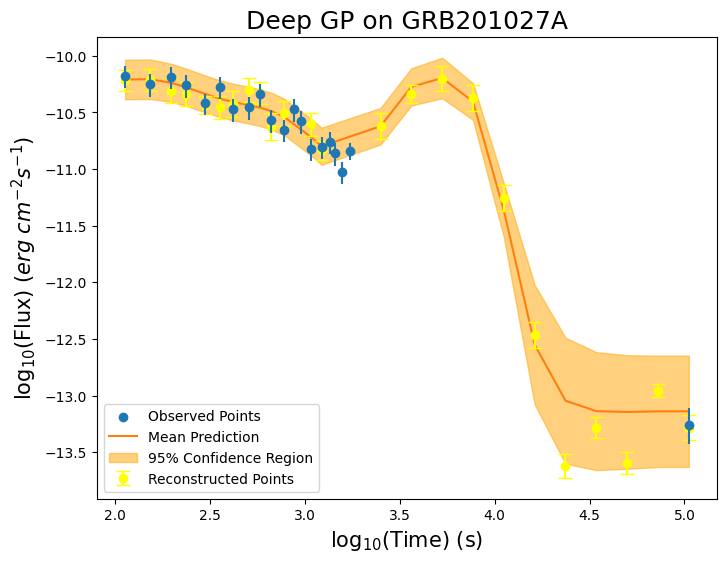


-----TRAINING FOR GRB201128A-----


-----ORIGINAL GRB-----



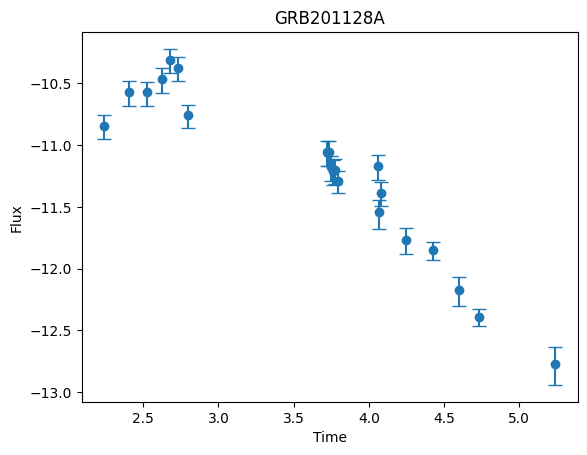


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.6403
Iteration 40/500 - Loss: 38.5434
Iteration 60/500 - Loss: 24.4429
Iteration 80/500 - Loss: 13.5644
Iteration 100/500 - Loss: 8.0428
Iteration 120/500 - Loss: 5.2693
Iteration 140/500 - Loss: 3.7294
Iteration 160/500 - Loss: 2.7977
Iteration 180/500 - Loss: 2.2223
Iteration 200/500 - Loss: 1.8471
Iteration 220/500 - Loss: 1.6821
Iteration 240/500 - Loss: 1.5579
Iteration 260/500 - Loss: 1.4493
Iteration 280/500 - Loss: 1.3532
Iteration 300/500 - Loss: 1.2681
Iteration 320/500 - Loss: 1.1905
Iteration 340/500 - Loss: 1.1221
Iteration 360/500 - Loss: 1.0561
Iteration 380/500 - Loss: 0.9973
Iteration 400/500 - Loss: 0.9432
Iteration 420/500 - Loss: 0.9163
Iteration 440/500 - Loss: 0.8924
Iteration 460/500 - Loss: 0.8695
Iteration 480/500 - Loss: 0.8479
Iteration 500/500 - Loss: 0.8271

-----RECONSTRUCTED GRB-----



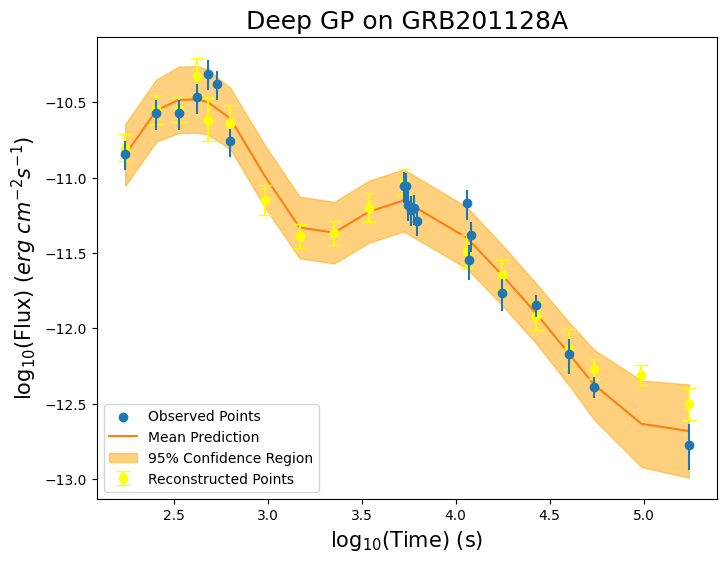


-----TRAINING FOR GRB201209A-----


-----ORIGINAL GRB-----



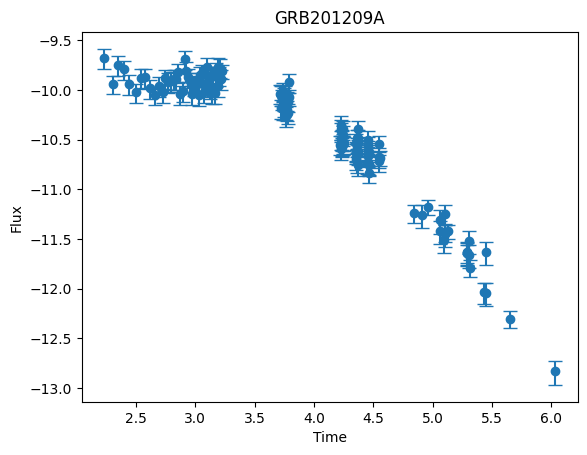


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.2999
Iteration 40/500 - Loss: 36.9263
Iteration 60/500 - Loss: 21.9784
Iteration 80/500 - Loss: 11.1826
Iteration 100/500 - Loss: 5.8222
Iteration 120/500 - Loss: 3.2682
Iteration 140/500 - Loss: 2.0806
Iteration 160/500 - Loss: 1.4000
Iteration 180/500 - Loss: 0.9738
Iteration 200/500 - Loss: 0.6877
Iteration 220/500 - Loss: 0.5767
Iteration 240/500 - Loss: 0.4884
Iteration 260/500 - Loss: 0.4123
Iteration 280/500 - Loss: 0.3460
Iteration 300/500 - Loss: 0.2886
Iteration 320/500 - Loss: 0.2379
Iteration 340/500 - Loss: 0.1940
Iteration 360/500 - Loss: 0.1550
Iteration 380/500 - Loss: 0.1205
Iteration 400/500 - Loss: 0.0904
Iteration 420/500 - Loss: 0.0754
Iteration 440/500 - Loss: 0.0622
Iteration 460/500 - Loss: 0.0495
Iteration 480/500 - Loss: 0.0373
Iteration 500/500 - Loss: 0.0257

-----RECONSTRUCTED GRB-----



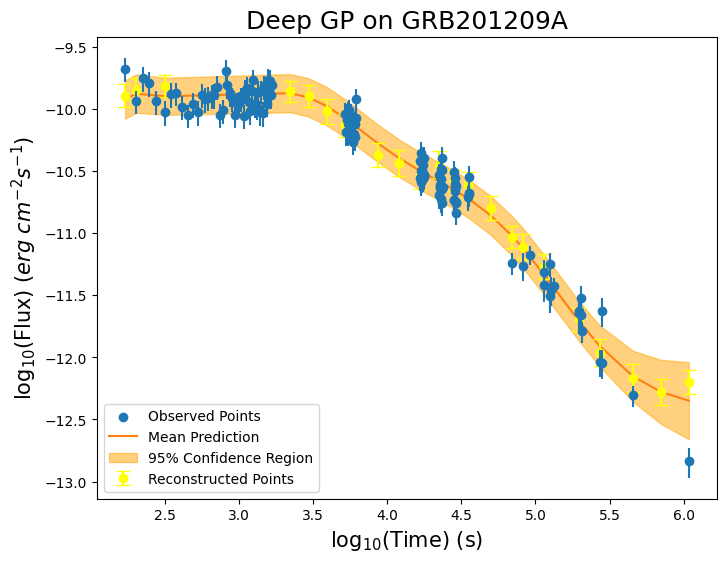


-----TRAINING FOR GRB201223A-----


-----ORIGINAL GRB-----



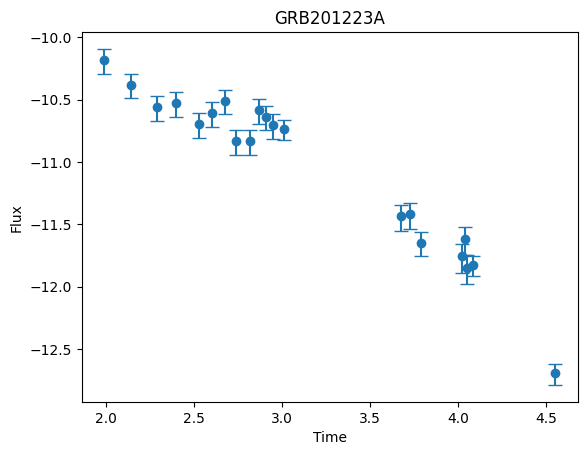


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.5546
Iteration 40/500 - Loss: 33.0852
Iteration 60/500 - Loss: 17.3306
Iteration 80/500 - Loss: 8.1203
Iteration 100/500 - Loss: 5.5992
Iteration 120/500 - Loss: 4.3127
Iteration 140/500 - Loss: 3.3552
Iteration 160/500 - Loss: 2.5526
Iteration 180/500 - Loss: 1.8743
Iteration 200/500 - Loss: 1.3890
Iteration 220/500 - Loss: 1.2077
Iteration 240/500 - Loss: 1.0667
Iteration 260/500 - Loss: 0.9495
Iteration 280/500 - Loss: 0.8517
Iteration 300/500 - Loss: 0.7662
Iteration 320/500 - Loss: 0.6933
Iteration 340/500 - Loss: 0.6314
Iteration 360/500 - Loss: 0.5790
Iteration 380/500 - Loss: 0.5330
Iteration 400/500 - Loss: 0.4936
Iteration 420/500 - Loss: 0.4751
Iteration 440/500 - Loss: 0.4584
Iteration 460/500 - Loss: 0.4431
Iteration 480/500 - Loss: 0.4277
Iteration 500/500 - Loss: 0.4133

-----RECONSTRUCTED GRB-----



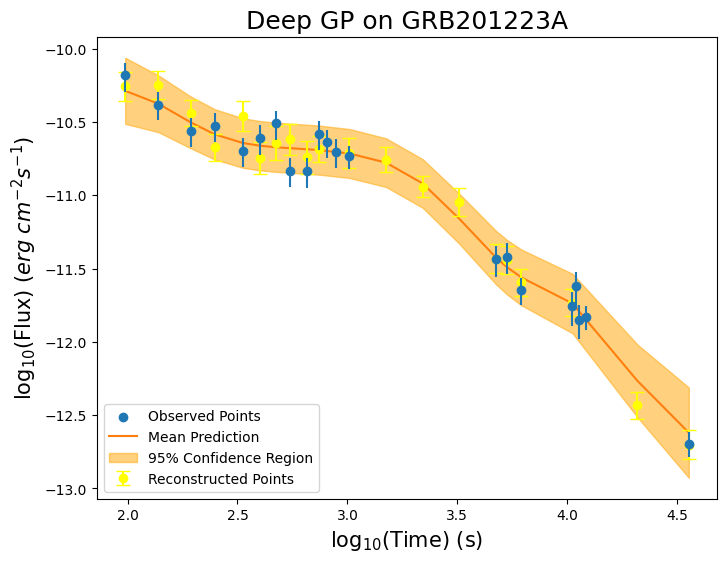


-----TRAINING FOR GRB201229A-----


-----ORIGINAL GRB-----



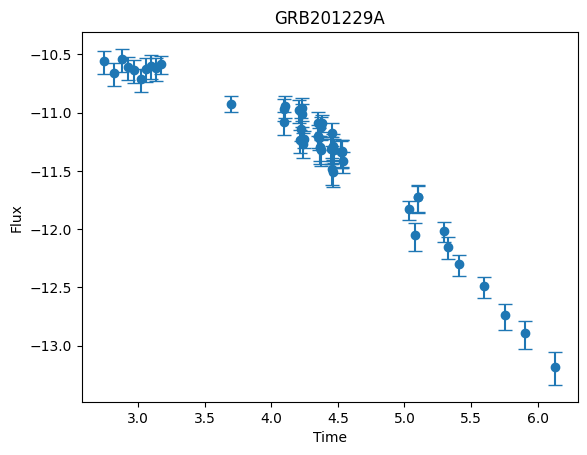


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 54.9037
Iteration 40/500 - Loss: 30.3944
Iteration 60/500 - Loss: 15.2559
Iteration 80/500 - Loss: 9.0085
Iteration 100/500 - Loss: 5.2055
Iteration 120/500 - Loss: 2.7954
Iteration 140/500 - Loss: 1.4759
Iteration 160/500 - Loss: 0.8195
Iteration 180/500 - Loss: 0.5212
Iteration 200/500 - Loss: 0.3680
Iteration 220/500 - Loss: 0.3120
Iteration 240/500 - Loss: 0.2676
Iteration 260/500 - Loss: 0.2293
Iteration 280/500 - Loss: 0.1956
Iteration 300/500 - Loss: 0.1655
Iteration 320/500 - Loss: 0.1386
Iteration 340/500 - Loss: 0.1145
Iteration 360/500 - Loss: 0.0929
Iteration 380/500 - Loss: 0.0729
Iteration 400/500 - Loss: 0.0543
Iteration 420/500 - Loss: 0.0452
Iteration 440/500 - Loss: 0.0370
Iteration 460/500 - Loss: 0.0293
Iteration 480/500 - Loss: 0.0221
Iteration 500/500 - Loss: 0.0154

-----RECONSTRUCTED GRB-----



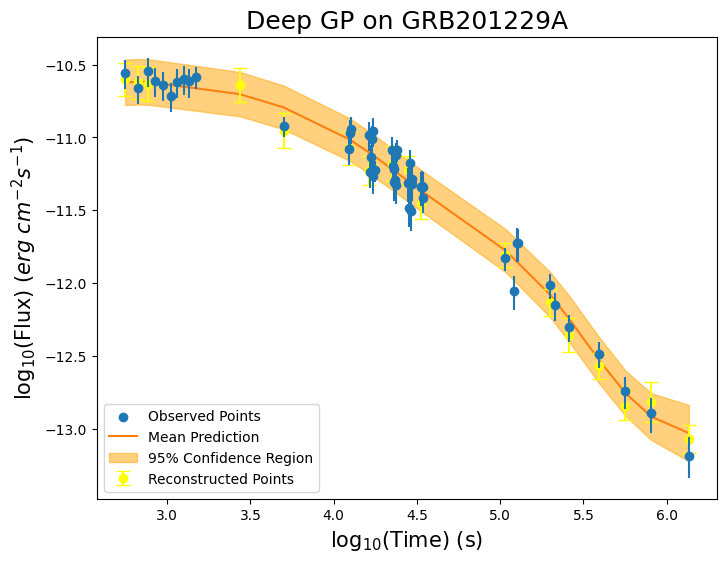


-----TRAINING FOR GRB210104A-----


-----ORIGINAL GRB-----



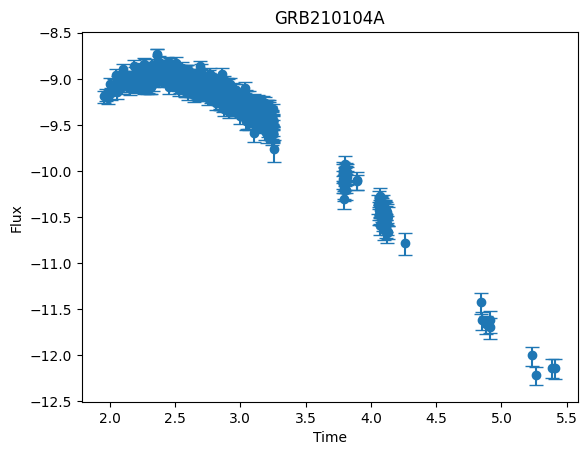


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 58.9574
Iteration 40/500 - Loss: 40.0166
Iteration 60/500 - Loss: 27.9673
Iteration 80/500 - Loss: 18.3980
Iteration 100/500 - Loss: 11.6809
Iteration 120/500 - Loss: 7.5973
Iteration 140/500 - Loss: 5.9644
Iteration 160/500 - Loss: 4.6473
Iteration 180/500 - Loss: 3.9835
Iteration 200/500 - Loss: 3.4458
Iteration 220/500 - Loss: 3.1589
Iteration 240/500 - Loss: 2.9134
Iteration 260/500 - Loss: 2.6150
Iteration 280/500 - Loss: 2.3502
Iteration 300/500 - Loss: 2.0942
Iteration 320/500 - Loss: 1.8903
Iteration 340/500 - Loss: 1.6453
Iteration 360/500 - Loss: 1.4396
Iteration 380/500 - Loss: 1.2517
Iteration 400/500 - Loss: 1.0801
Iteration 420/500 - Loss: 0.9964
Iteration 440/500 - Loss: 0.9200
Iteration 460/500 - Loss: 0.8465
Iteration 480/500 - Loss: 0.7759
Iteration 500/500 - Loss: 0.7083

-----RECONSTRUCTED GRB-----



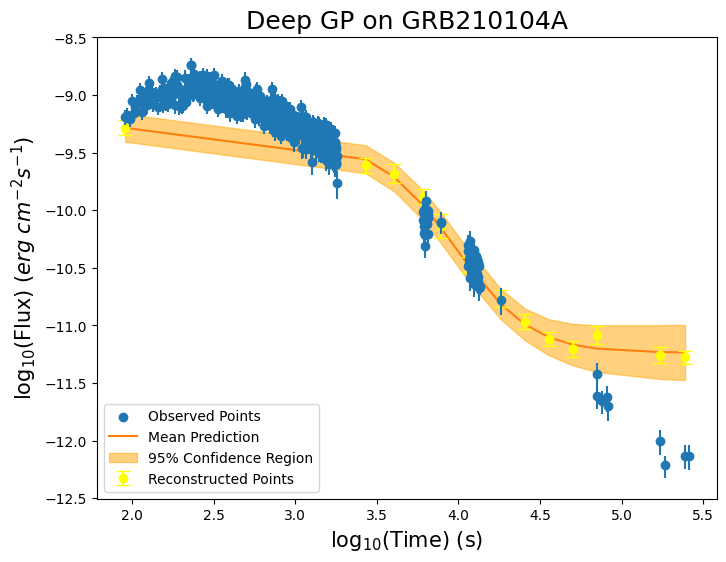


-----TRAINING FOR GRB210104B-----


-----ORIGINAL GRB-----



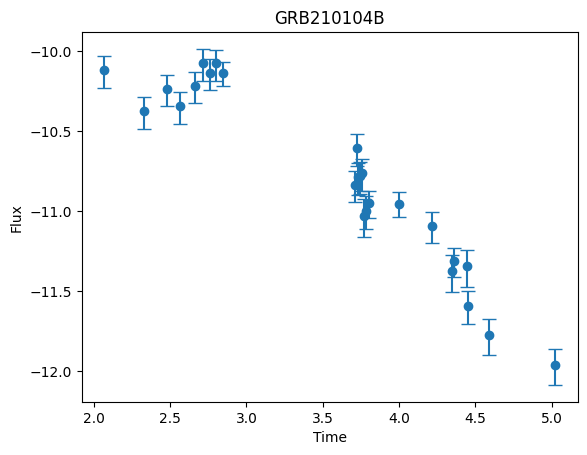


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.0487
Iteration 40/500 - Loss: 36.2287
Iteration 60/500 - Loss: 20.4108
Iteration 80/500 - Loss: 10.3389
Iteration 100/500 - Loss: 6.3349
Iteration 120/500 - Loss: 4.4249
Iteration 140/500 - Loss: 3.2158
Iteration 160/500 - Loss: 2.4271
Iteration 180/500 - Loss: 1.8400
Iteration 200/500 - Loss: 1.4094
Iteration 220/500 - Loss: 1.2531
Iteration 240/500 - Loss: 1.1368
Iteration 260/500 - Loss: 1.0399
Iteration 280/500 - Loss: 0.9565
Iteration 300/500 - Loss: 0.8842
Iteration 320/500 - Loss: 0.8206
Iteration 340/500 - Loss: 0.7646
Iteration 360/500 - Loss: 0.7148
Iteration 380/500 - Loss: 0.6701
Iteration 400/500 - Loss: 0.6297
Iteration 420/500 - Loss: 0.6099
Iteration 440/500 - Loss: 0.5919
Iteration 460/500 - Loss: 0.5746
Iteration 480/500 - Loss: 0.5579
Iteration 500/500 - Loss: 0.5417

-----RECONSTRUCTED GRB-----



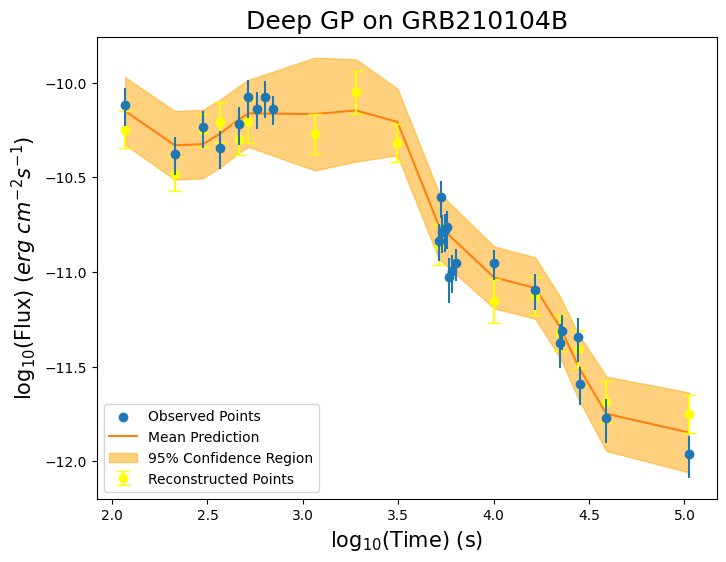


-----TRAINING FOR GRB210112A-----


-----ORIGINAL GRB-----



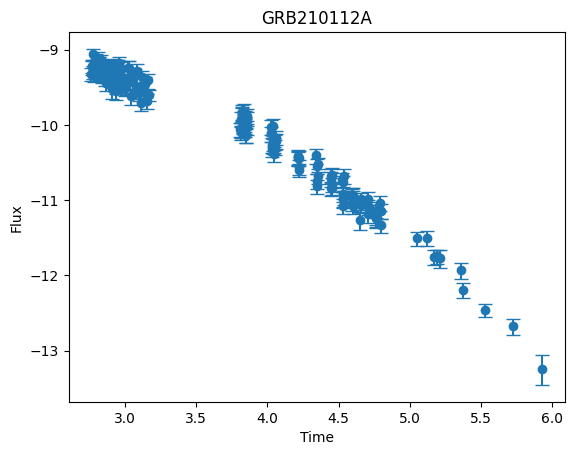


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.7144
Iteration 40/500 - Loss: 40.8165
Iteration 60/500 - Loss: 31.1848
Iteration 80/500 - Loss: 18.6454
Iteration 100/500 - Loss: 8.8881
Iteration 120/500 - Loss: 4.6009
Iteration 140/500 - Loss: 2.5634
Iteration 160/500 - Loss: 1.6436
Iteration 180/500 - Loss: 1.1315
Iteration 200/500 - Loss: 0.7643
Iteration 220/500 - Loss: 0.6137
Iteration 240/500 - Loss: 0.4994
Iteration 260/500 - Loss: 0.4142
Iteration 280/500 - Loss: 0.3038
Iteration 300/500 - Loss: 0.2203
Iteration 320/500 - Loss: 0.1457
Iteration 340/500 - Loss: 0.0795
Iteration 360/500 - Loss: 0.0212
Iteration 380/500 - Loss: -0.0303
Iteration 400/500 - Loss: -0.0757
Iteration 420/500 - Loss: -0.0972
Iteration 440/500 - Loss: -0.1168
Iteration 460/500 - Loss: -0.1356
Iteration 480/500 - Loss: -0.1535
Iteration 500/500 - Loss: -0.1706

-----RECONSTRUCTED GRB-----



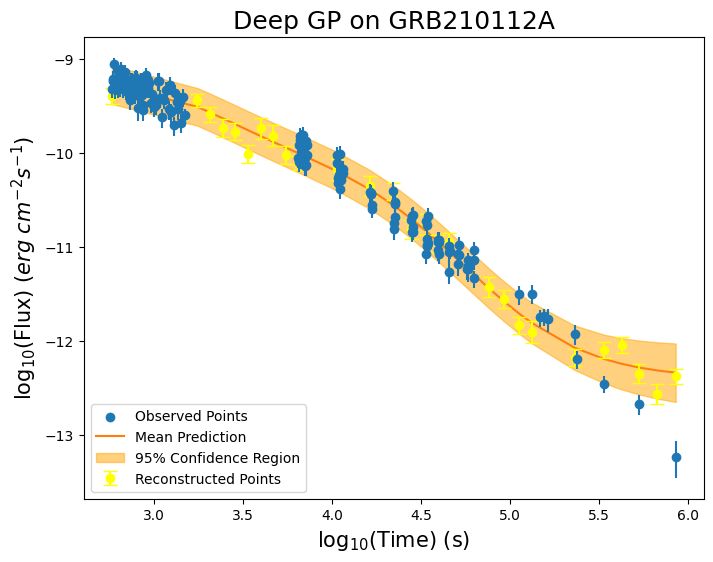


-----TRAINING FOR GRB210207B-----


-----ORIGINAL GRB-----



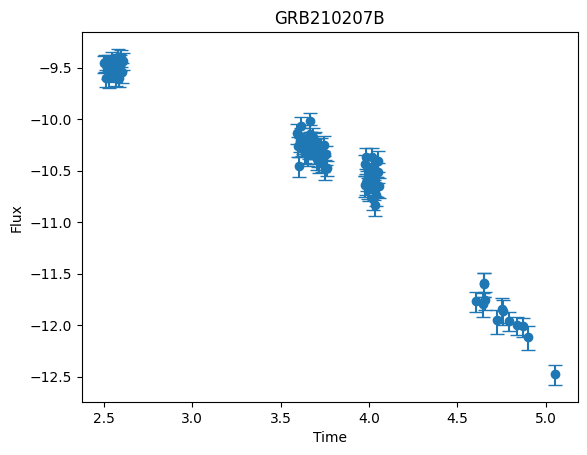


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 60.1819
Iteration 40/500 - Loss: 44.2052
Iteration 60/500 - Loss: 31.1859
Iteration 80/500 - Loss: 17.0691
Iteration 100/500 - Loss: 8.5366
Iteration 120/500 - Loss: 3.7046
Iteration 140/500 - Loss: 1.5209
Iteration 160/500 - Loss: 0.6805
Iteration 180/500 - Loss: 0.3033
Iteration 200/500 - Loss: 0.0487
Iteration 220/500 - Loss: -0.0463
Iteration 240/500 - Loss: -0.0953
Iteration 260/500 - Loss: -0.1283
Iteration 280/500 - Loss: -0.1567
Iteration 300/500 - Loss: -0.1827
Iteration 320/500 - Loss: -0.2065
Iteration 340/500 - Loss: -0.2285
Iteration 360/500 - Loss: -0.2485
Iteration 380/500 - Loss: -0.2667
Iteration 400/500 - Loss: -0.2829
Iteration 420/500 - Loss: -0.2908
Iteration 440/500 - Loss: -0.2979
Iteration 460/500 - Loss: -0.3046
Iteration 480/500 - Loss: -0.3110
Iteration 500/500 - Loss: -0.3170

-----RECONSTRUCTED GRB-----



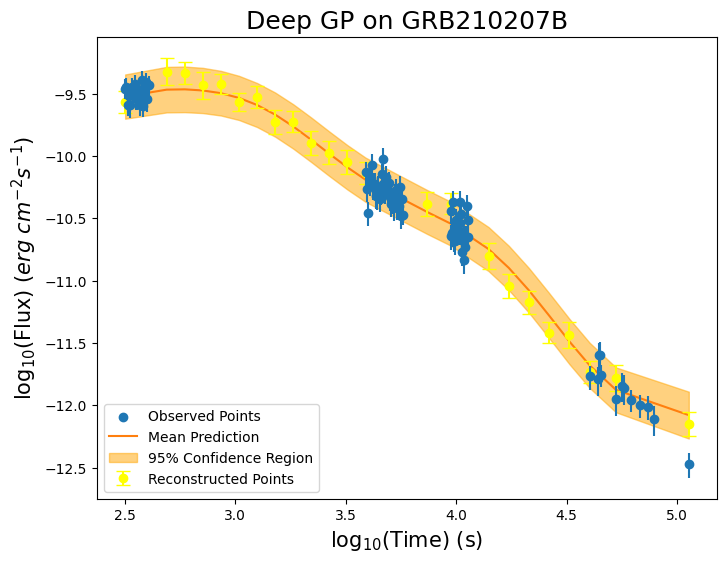


-----TRAINING FOR GRB210217A-----


-----ORIGINAL GRB-----



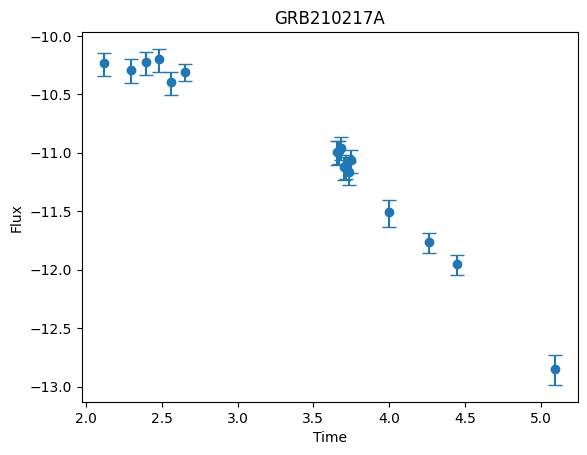


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.3263
Iteration 40/500 - Loss: 36.9836
Iteration 60/500 - Loss: 23.6567
Iteration 80/500 - Loss: 14.0604
Iteration 100/500 - Loss: 8.8117
Iteration 120/500 - Loss: 6.1616
Iteration 140/500 - Loss: 4.3742
Iteration 160/500 - Loss: 3.0664
Iteration 180/500 - Loss: 2.1245
Iteration 200/500 - Loss: 1.4939
Iteration 220/500 - Loss: 1.2601
Iteration 240/500 - Loss: 1.0809
Iteration 260/500 - Loss: 0.9323
Iteration 280/500 - Loss: 0.8082
Iteration 300/500 - Loss: 0.7044
Iteration 320/500 - Loss: 0.6169
Iteration 340/500 - Loss: 0.5427
Iteration 360/500 - Loss: 0.4788
Iteration 380/500 - Loss: 0.4236
Iteration 400/500 - Loss: 0.3755
Iteration 420/500 - Loss: 0.3524
Iteration 440/500 - Loss: 0.3318
Iteration 460/500 - Loss: 0.3121
Iteration 480/500 - Loss: 0.2933
Iteration 500/500 - Loss: 0.2753

-----RECONSTRUCTED GRB-----



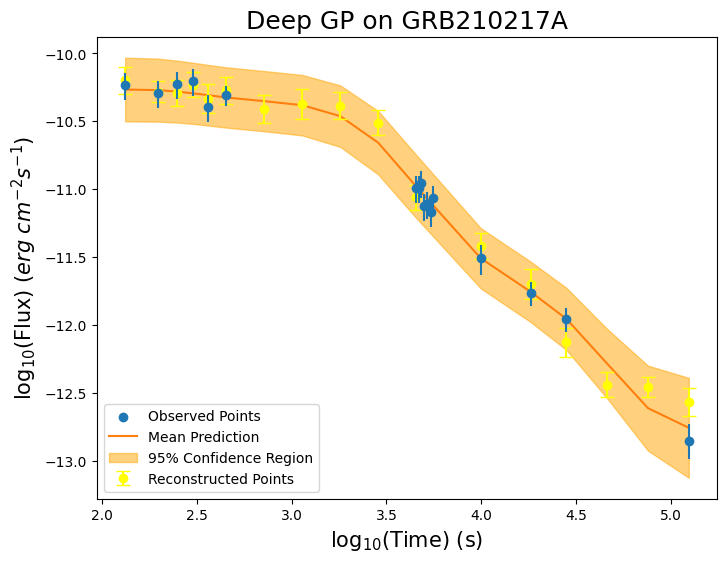


-----TRAINING FOR GRB210226A-----


-----ORIGINAL GRB-----



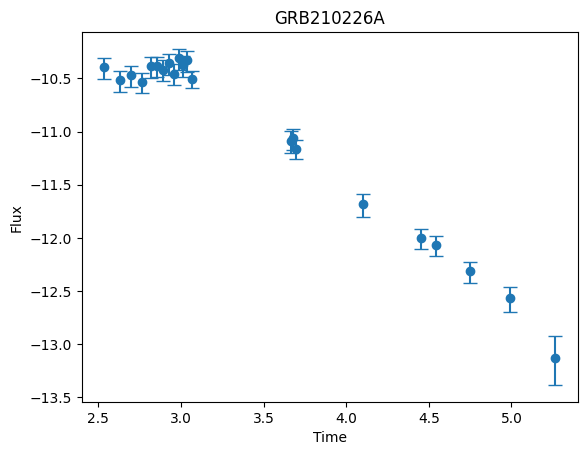


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.7563
Iteration 40/500 - Loss: 32.7797
Iteration 60/500 - Loss: 18.0492
Iteration 80/500 - Loss: 8.7899
Iteration 100/500 - Loss: 5.0489
Iteration 120/500 - Loss: 3.3798
Iteration 140/500 - Loss: 2.0526
Iteration 160/500 - Loss: 1.2057
Iteration 180/500 - Loss: 0.6883
Iteration 200/500 - Loss: 0.3723
Iteration 220/500 - Loss: 0.2555
Iteration 240/500 - Loss: 0.1647
Iteration 260/500 - Loss: 0.0877
Iteration 280/500 - Loss: 0.0222
Iteration 300/500 - Loss: -0.0336
Iteration 320/500 - Loss: -0.0813
Iteration 340/500 - Loss: -0.1223
Iteration 360/500 - Loss: -0.1576
Iteration 380/500 - Loss: -0.1884
Iteration 400/500 - Loss: -0.2153
Iteration 420/500 - Loss: -0.2281
Iteration 440/500 - Loss: -0.2396
Iteration 460/500 - Loss: -0.2507
Iteration 480/500 - Loss: -0.2612
Iteration 500/500 - Loss: -0.2714

-----RECONSTRUCTED GRB-----



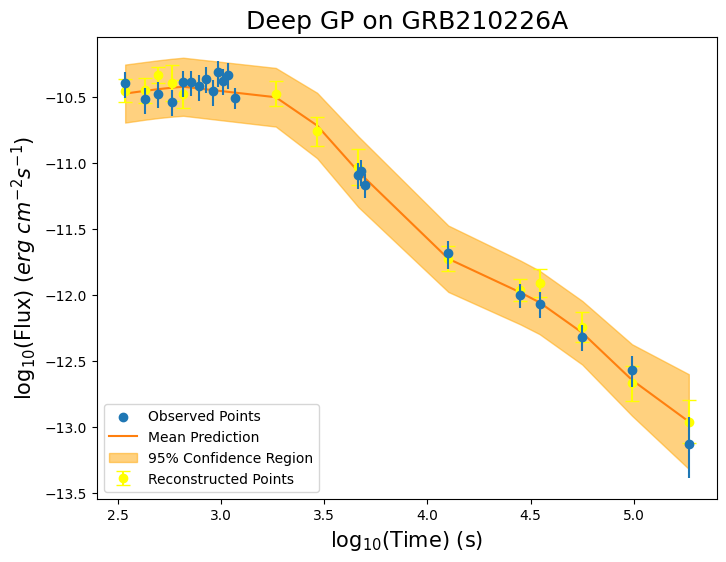


-----TRAINING FOR GRB210308A-----


-----ORIGINAL GRB-----



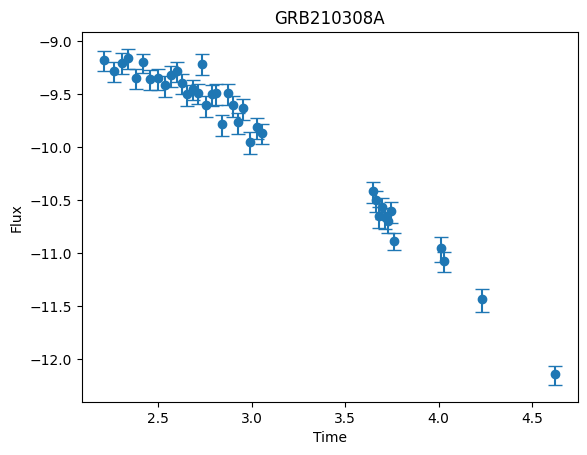


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 45.8119
Iteration 40/500 - Loss: 32.7088
Iteration 60/500 - Loss: 14.2209
Iteration 80/500 - Loss: 7.2280
Iteration 100/500 - Loss: 4.8001
Iteration 120/500 - Loss: 3.1577
Iteration 140/500 - Loss: 2.1132
Iteration 160/500 - Loss: 1.4514
Iteration 180/500 - Loss: 0.9888
Iteration 200/500 - Loss: 0.6492
Iteration 220/500 - Loss: 0.5103
Iteration 240/500 - Loss: 0.3977
Iteration 260/500 - Loss: 0.3009
Iteration 280/500 - Loss: 0.2183
Iteration 300/500 - Loss: 0.1484
Iteration 320/500 - Loss: 0.0896
Iteration 340/500 - Loss: 0.0406
Iteration 360/500 - Loss: -0.0001
Iteration 380/500 - Loss: -0.0339
Iteration 400/500 - Loss: -0.0618
Iteration 420/500 - Loss: -0.0744
Iteration 440/500 - Loss: -0.0853
Iteration 460/500 - Loss: -0.0954
Iteration 480/500 - Loss: -0.1047
Iteration 500/500 - Loss: -0.1133

-----RECONSTRUCTED GRB-----



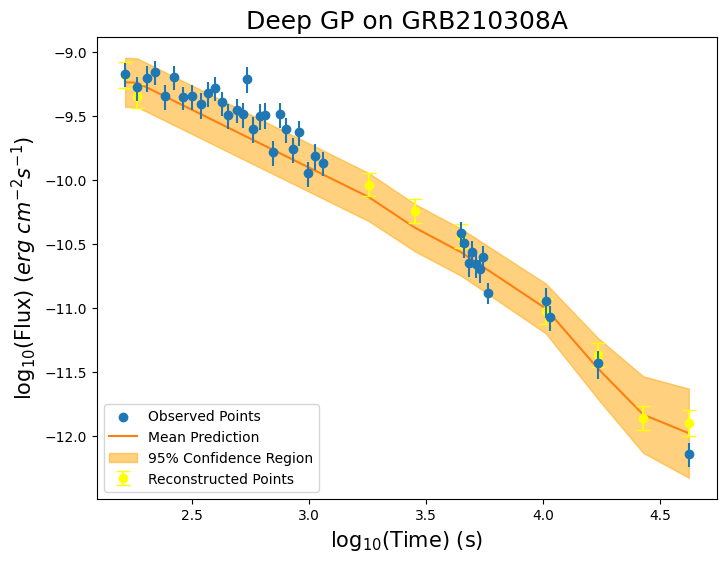


-----TRAINING FOR GRB210318B-----


-----ORIGINAL GRB-----



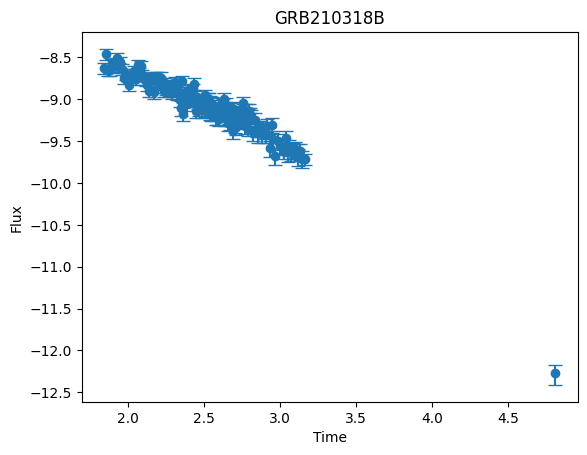


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.4148
Iteration 40/500 - Loss: 39.7447
Iteration 60/500 - Loss: 28.3824
Iteration 80/500 - Loss: 19.9756
Iteration 100/500 - Loss: 14.9683
Iteration 120/500 - Loss: 12.4400
Iteration 140/500 - Loss: 10.8826
Iteration 160/500 - Loss: 9.6455
Iteration 180/500 - Loss: 8.5461
Iteration 200/500 - Loss: 7.4301
Iteration 220/500 - Loss: 6.8708
Iteration 240/500 - Loss: 6.3424
Iteration 260/500 - Loss: 5.8357
Iteration 280/500 - Loss: 5.3518
Iteration 300/500 - Loss: 4.8927
Iteration 320/500 - Loss: 4.4699
Iteration 340/500 - Loss: 4.0551
Iteration 360/500 - Loss: 3.6778
Iteration 380/500 - Loss: 3.3280
Iteration 400/500 - Loss: 3.0076
Iteration 420/500 - Loss: 2.8490
Iteration 440/500 - Loss: 2.7045
Iteration 460/500 - Loss: 2.5653
Iteration 480/500 - Loss: 2.4316
Iteration 500/500 - Loss: 2.3038

-----RECONSTRUCTED GRB-----



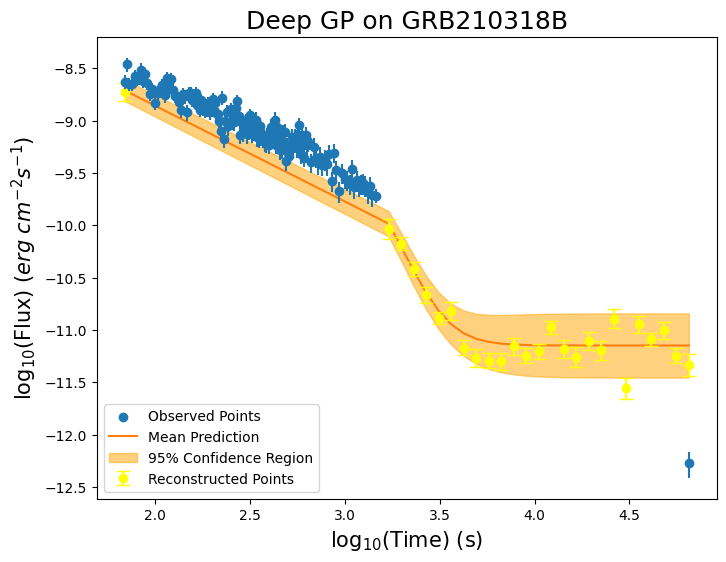


-----TRAINING FOR GRB210712A-----


-----ORIGINAL GRB-----



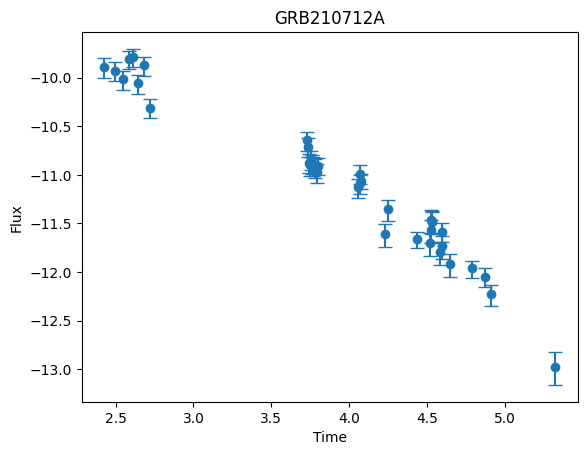


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.7721
Iteration 40/500 - Loss: 28.0073
Iteration 60/500 - Loss: 11.7821
Iteration 80/500 - Loss: 5.6911
Iteration 100/500 - Loss: 3.5946
Iteration 120/500 - Loss: 2.5328
Iteration 140/500 - Loss: 1.8819
Iteration 160/500 - Loss: 1.4513
Iteration 180/500 - Loss: 1.1469
Iteration 200/500 - Loss: 0.9223
Iteration 220/500 - Loss: 0.8277
Iteration 240/500 - Loss: 0.7470
Iteration 260/500 - Loss: 0.6719
Iteration 280/500 - Loss: 0.6006
Iteration 300/500 - Loss: 0.5336
Iteration 320/500 - Loss: 0.4740
Iteration 340/500 - Loss: 0.4234
Iteration 360/500 - Loss: 0.3811
Iteration 380/500 - Loss: 0.3453
Iteration 400/500 - Loss: 0.3147
Iteration 420/500 - Loss: 0.3005
Iteration 440/500 - Loss: 0.2879
Iteration 460/500 - Loss: 0.2759
Iteration 480/500 - Loss: 0.2646
Iteration 500/500 - Loss: 0.2539

-----RECONSTRUCTED GRB-----



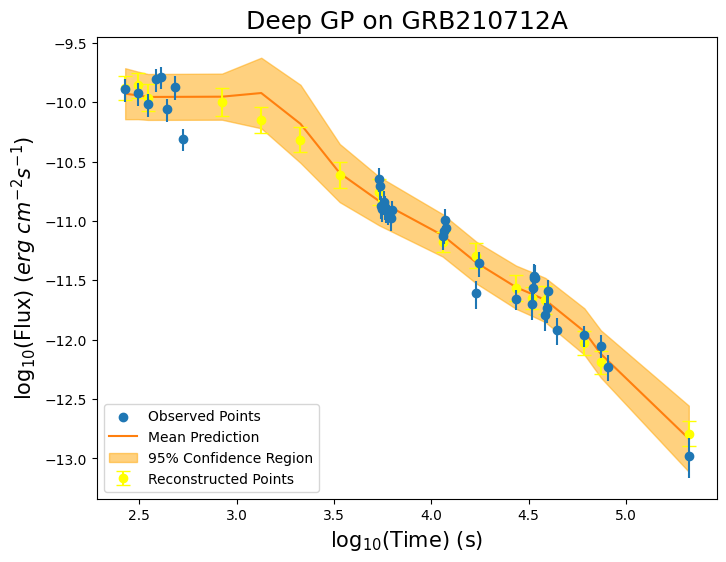


-----TRAINING FOR GRB210725A-----


-----ORIGINAL GRB-----



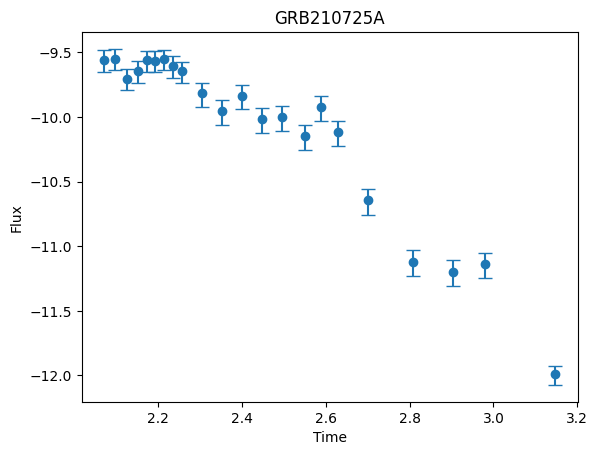


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.4008
Iteration 40/500 - Loss: 33.4600
Iteration 60/500 - Loss: 17.6327
Iteration 80/500 - Loss: 9.0316
Iteration 100/500 - Loss: 5.1530
Iteration 120/500 - Loss: 3.3096
Iteration 140/500 - Loss: 2.4407
Iteration 160/500 - Loss: 1.6028
Iteration 180/500 - Loss: 0.8252
Iteration 200/500 - Loss: 0.4246
Iteration 220/500 - Loss: 0.3070
Iteration 240/500 - Loss: 0.2328
Iteration 260/500 - Loss: 0.1812
Iteration 280/500 - Loss: 0.1442
Iteration 300/500 - Loss: 0.1164
Iteration 320/500 - Loss: 0.0947
Iteration 340/500 - Loss: 0.0767
Iteration 360/500 - Loss: 0.0612
Iteration 380/500 - Loss: 0.0476
Iteration 400/500 - Loss: 0.0353
Iteration 420/500 - Loss: 0.0293
Iteration 440/500 - Loss: 0.0237
Iteration 460/500 - Loss: 0.0183
Iteration 480/500 - Loss: 0.0131
Iteration 500/500 - Loss: 0.0079

-----RECONSTRUCTED GRB-----



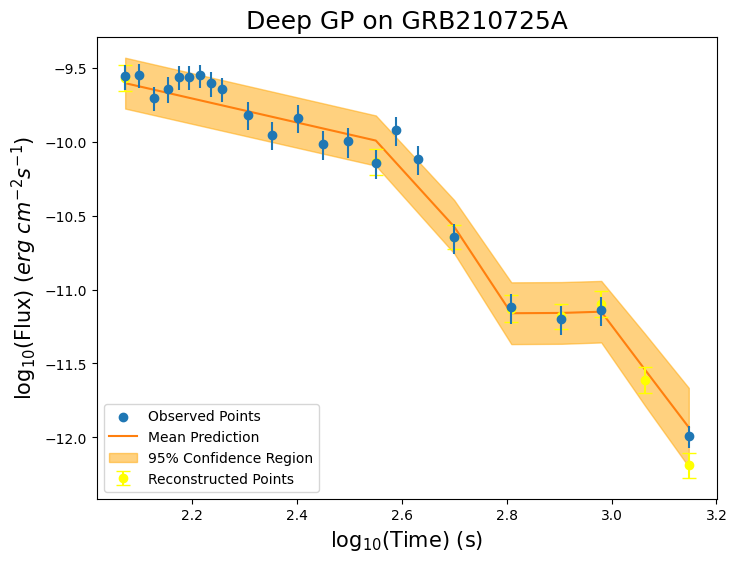


-----TRAINING FOR GRB210807A-----


-----ORIGINAL GRB-----



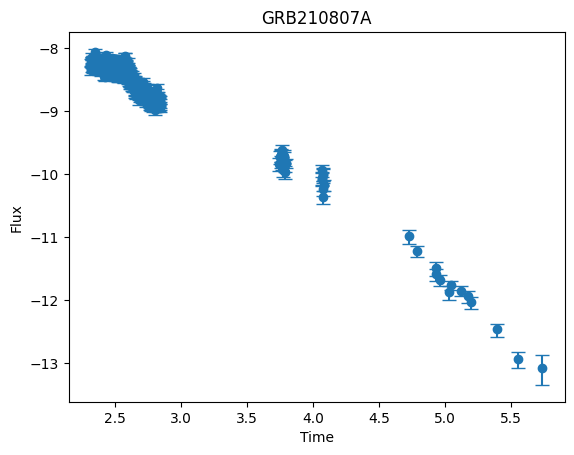


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.9458
Iteration 40/500 - Loss: 41.3191
Iteration 60/500 - Loss: 32.9221
Iteration 80/500 - Loss: 24.2322
Iteration 100/500 - Loss: 16.6938
Iteration 120/500 - Loss: 11.6593
Iteration 140/500 - Loss: 8.7293
Iteration 160/500 - Loss: 7.1359
Iteration 180/500 - Loss: 6.2953
Iteration 200/500 - Loss: 5.8289
Iteration 220/500 - Loss: 5.6730
Iteration 240/500 - Loss: 5.5551
Iteration 260/500 - Loss: 5.4544
Iteration 280/500 - Loss: 5.3656
Iteration 300/500 - Loss: 5.2849
Iteration 320/500 - Loss: 5.2087
Iteration 340/500 - Loss: 5.1344
Iteration 360/500 - Loss: 5.0578
Iteration 380/500 - Loss: 4.9704
Iteration 400/500 - Loss: 4.8355
Iteration 420/500 - Loss: 4.6704
Iteration 440/500 - Loss: 4.2687
Iteration 460/500 - Loss: 3.4641
Iteration 480/500 - Loss: 2.7484
Iteration 500/500 - Loss: 2.3858

-----RECONSTRUCTED GRB-----



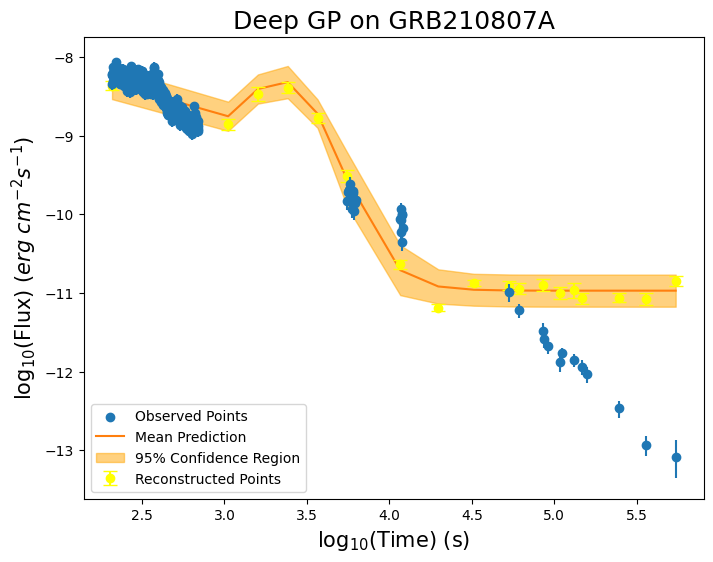


-----TRAINING FOR GRB210912A-----


-----ORIGINAL GRB-----



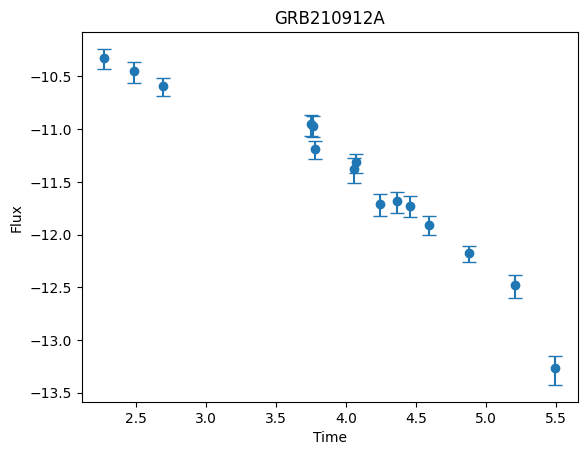


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 61.3219
Iteration 40/500 - Loss: 39.6631
Iteration 60/500 - Loss: 21.7194
Iteration 80/500 - Loss: 12.6632
Iteration 100/500 - Loss: 8.4970
Iteration 120/500 - Loss: 5.6400
Iteration 140/500 - Loss: 3.5809
Iteration 160/500 - Loss: 2.1746
Iteration 180/500 - Loss: 1.2810
Iteration 200/500 - Loss: 0.8118
Iteration 220/500 - Loss: 0.6675
Iteration 240/500 - Loss: 0.5619
Iteration 260/500 - Loss: 0.4672
Iteration 280/500 - Loss: 0.3677
Iteration 300/500 - Loss: 0.2942
Iteration 320/500 - Loss: 0.2448
Iteration 340/500 - Loss: 0.2027
Iteration 360/500 - Loss: 0.1640
Iteration 380/500 - Loss: 0.1294
Iteration 400/500 - Loss: 0.1031
Iteration 420/500 - Loss: 0.0920
Iteration 440/500 - Loss: 0.0824
Iteration 460/500 - Loss: 0.0733
Iteration 480/500 - Loss: 0.0646
Iteration 500/500 - Loss: 0.0560

-----RECONSTRUCTED GRB-----



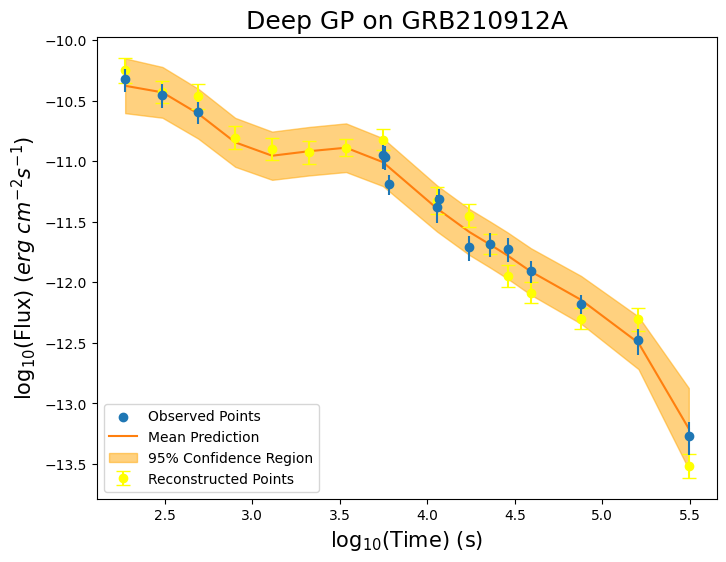


-----TRAINING FOR GRB210930A-----


-----ORIGINAL GRB-----



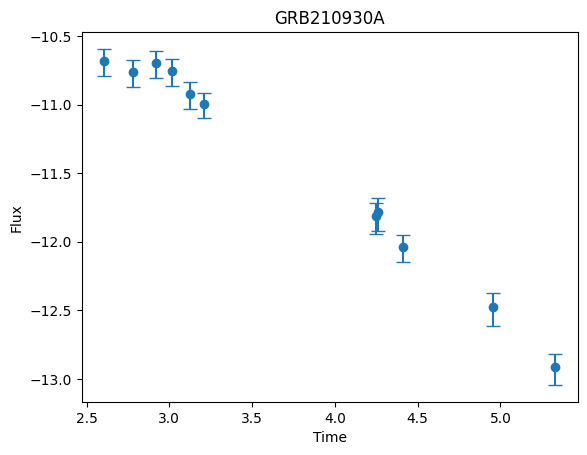


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.6663
Iteration 40/500 - Loss: 35.6401
Iteration 60/500 - Loss: 20.6459
Iteration 80/500 - Loss: 11.1458
Iteration 100/500 - Loss: 6.7169
Iteration 120/500 - Loss: 4.5625
Iteration 140/500 - Loss: 3.2993
Iteration 160/500 - Loss: 2.4314
Iteration 180/500 - Loss: 1.7943
Iteration 200/500 - Loss: 1.3224
Iteration 220/500 - Loss: 1.1282
Iteration 240/500 - Loss: 0.9699
Iteration 260/500 - Loss: 0.8325
Iteration 280/500 - Loss: 0.7135
Iteration 300/500 - Loss: 0.6113
Iteration 320/500 - Loss: 0.5245
Iteration 340/500 - Loss: 0.4497
Iteration 360/500 - Loss: 0.3873
Iteration 380/500 - Loss: 0.3337
Iteration 400/500 - Loss: 0.2888
Iteration 420/500 - Loss: 0.2677
Iteration 440/500 - Loss: 0.2494
Iteration 460/500 - Loss: 0.2323
Iteration 480/500 - Loss: 0.2162
Iteration 500/500 - Loss: 0.2012

-----RECONSTRUCTED GRB-----



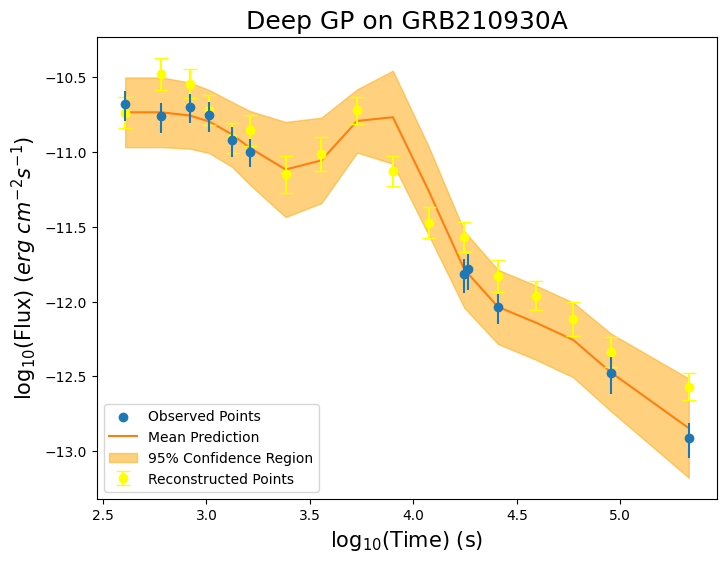


-----TRAINING FOR GRB211025A-----


-----ORIGINAL GRB-----



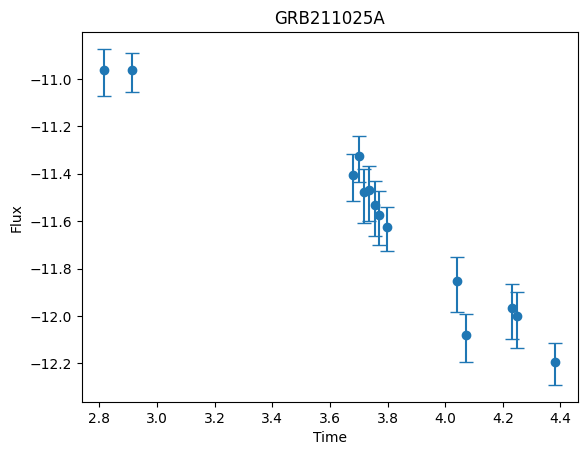


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 57.8986
Iteration 40/500 - Loss: 36.8461
Iteration 60/500 - Loss: 25.1873
Iteration 80/500 - Loss: 14.6613
Iteration 100/500 - Loss: 6.9415
Iteration 120/500 - Loss: 3.6870
Iteration 140/500 - Loss: 2.4454
Iteration 160/500 - Loss: 1.9009
Iteration 180/500 - Loss: 1.6216
Iteration 200/500 - Loss: 1.4498
Iteration 220/500 - Loss: 1.3825
Iteration 240/500 - Loss: 1.3244
Iteration 260/500 - Loss: 1.2679
Iteration 280/500 - Loss: 1.2110
Iteration 300/500 - Loss: 1.1540
Iteration 320/500 - Loss: 1.0974
Iteration 340/500 - Loss: 1.0428
Iteration 360/500 - Loss: 0.9920
Iteration 380/500 - Loss: 0.9455
Iteration 400/500 - Loss: 0.9036
Iteration 420/500 - Loss: 0.8833
Iteration 440/500 - Loss: 0.8649
Iteration 460/500 - Loss: 0.8472
Iteration 480/500 - Loss: 0.8301
Iteration 500/500 - Loss: 0.8137

-----RECONSTRUCTED GRB-----



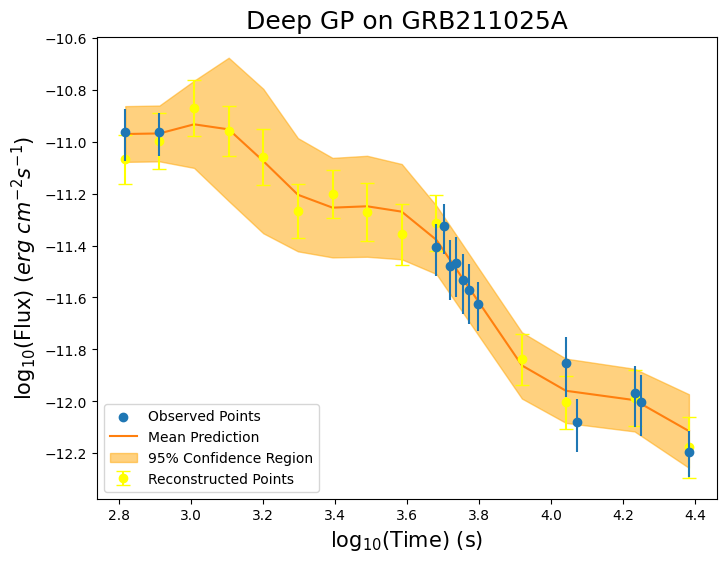


-----TRAINING FOR GRB220325A-----


-----ORIGINAL GRB-----



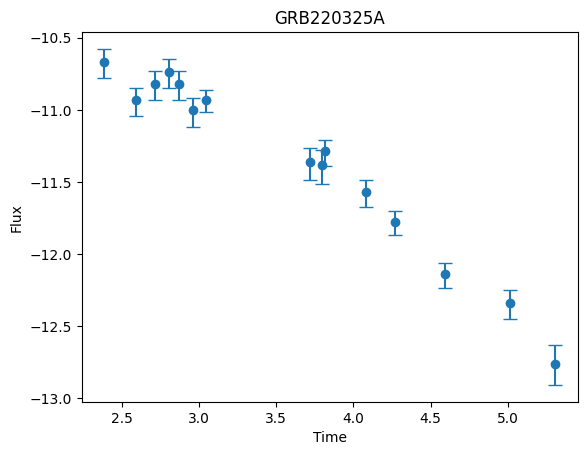


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.6446
Iteration 40/500 - Loss: 36.7735
Iteration 60/500 - Loss: 22.9211
Iteration 80/500 - Loss: 13.3632
Iteration 100/500 - Loss: 8.3804
Iteration 120/500 - Loss: 5.5817
Iteration 140/500 - Loss: 3.8672
Iteration 160/500 - Loss: 2.8688
Iteration 180/500 - Loss: 2.2444
Iteration 200/500 - Loss: 1.8254
Iteration 220/500 - Loss: 1.6624
Iteration 240/500 - Loss: 1.5297
Iteration 260/500 - Loss: 1.4124
Iteration 280/500 - Loss: 1.3074
Iteration 300/500 - Loss: 1.2125
Iteration 320/500 - Loss: 1.1264
Iteration 340/500 - Loss: 1.0424
Iteration 360/500 - Loss: 0.9604
Iteration 380/500 - Loss: 0.8762
Iteration 400/500 - Loss: 0.7865
Iteration 420/500 - Loss: 0.7398
Iteration 440/500 - Loss: 0.6983
Iteration 460/500 - Loss: 0.6614
Iteration 480/500 - Loss: 0.6292
Iteration 500/500 - Loss: 0.6008

-----RECONSTRUCTED GRB-----



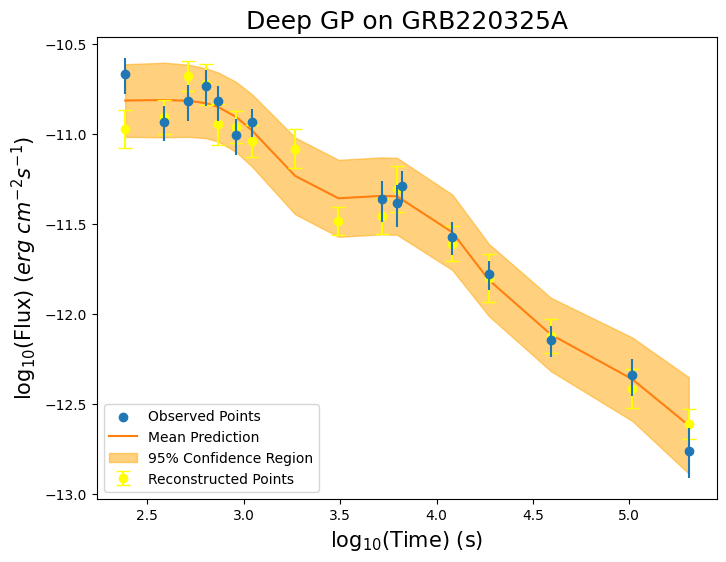


-----TRAINING FOR GRB220403B-----


-----ORIGINAL GRB-----



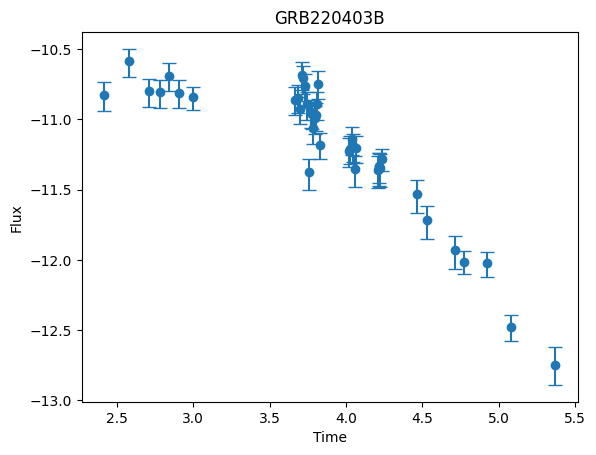


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.0345
Iteration 40/500 - Loss: 28.1800
Iteration 60/500 - Loss: 14.9106
Iteration 80/500 - Loss: 8.8672
Iteration 100/500 - Loss: 6.2702
Iteration 120/500 - Loss: 4.7789
Iteration 140/500 - Loss: 3.7675
Iteration 160/500 - Loss: 3.0831
Iteration 180/500 - Loss: 2.6309
Iteration 200/500 - Loss: 2.3111
Iteration 220/500 - Loss: 2.1794
Iteration 240/500 - Loss: 2.0711
Iteration 260/500 - Loss: 1.9761
Iteration 280/500 - Loss: 1.8931
Iteration 300/500 - Loss: 1.8208
Iteration 320/500 - Loss: 1.7579
Iteration 340/500 - Loss: 1.7031
Iteration 360/500 - Loss: 1.6552
Iteration 380/500 - Loss: 1.6132
Iteration 400/500 - Loss: 1.5760
Iteration 420/500 - Loss: 1.5583
Iteration 440/500 - Loss: 1.5422
Iteration 460/500 - Loss: 1.5267
Iteration 480/500 - Loss: 1.5120
Iteration 500/500 - Loss: 1.4977

-----RECONSTRUCTED GRB-----



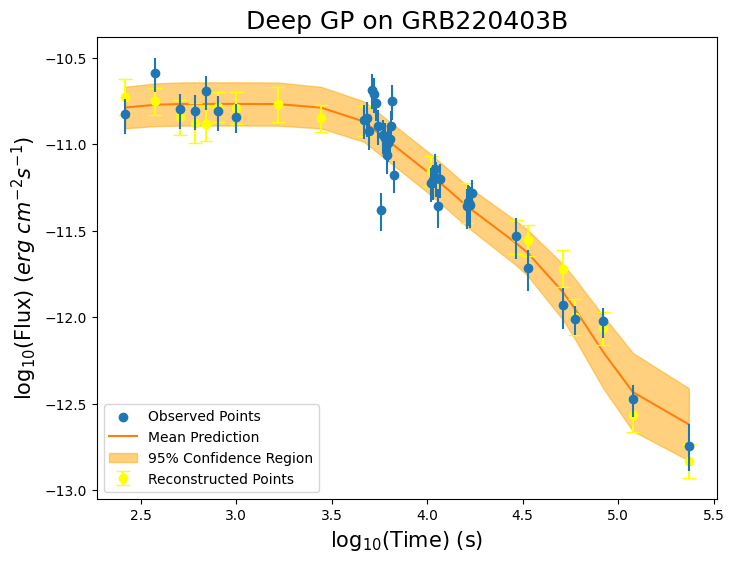


-----TRAINING FOR GRB220408A-----


-----ORIGINAL GRB-----



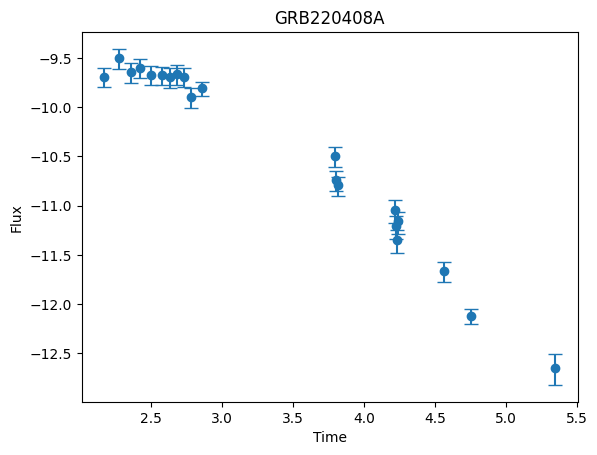


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.5478
Iteration 40/500 - Loss: 33.6736
Iteration 60/500 - Loss: 17.8945
Iteration 80/500 - Loss: 7.9374
Iteration 100/500 - Loss: 4.3792
Iteration 120/500 - Loss: 2.7060
Iteration 140/500 - Loss: 1.7248
Iteration 160/500 - Loss: 1.1122
Iteration 180/500 - Loss: 0.7230
Iteration 200/500 - Loss: 0.4715
Iteration 220/500 - Loss: 0.3752
Iteration 240/500 - Loss: 0.2989
Iteration 260/500 - Loss: 0.2338
Iteration 280/500 - Loss: 0.1778
Iteration 300/500 - Loss: 0.1298
Iteration 320/500 - Loss: 0.0883
Iteration 340/500 - Loss: 0.0526
Iteration 360/500 - Loss: 0.0214
Iteration 380/500 - Loss: -0.0057
Iteration 400/500 - Loss: -0.0295
Iteration 420/500 - Loss: -0.0409
Iteration 440/500 - Loss: -0.0511
Iteration 460/500 - Loss: -0.0609
Iteration 480/500 - Loss: -0.0702
Iteration 500/500 - Loss: -0.0791

-----RECONSTRUCTED GRB-----



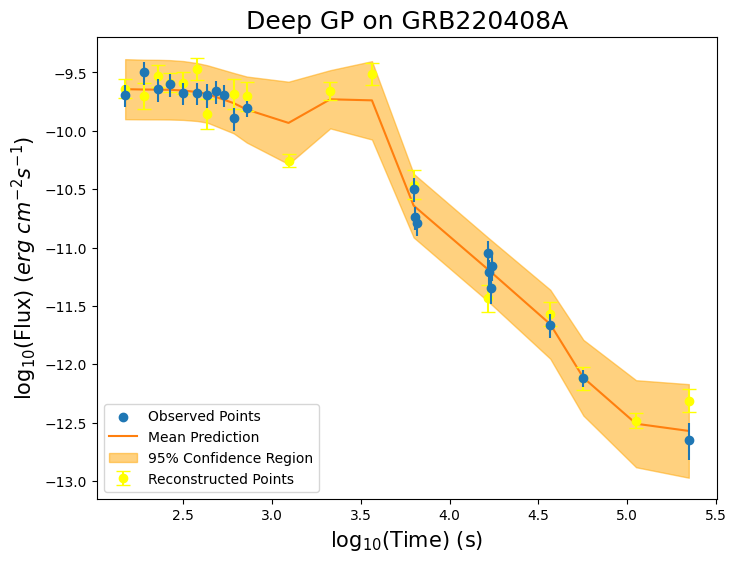


-----TRAINING FOR GRB220430A-----


-----ORIGINAL GRB-----



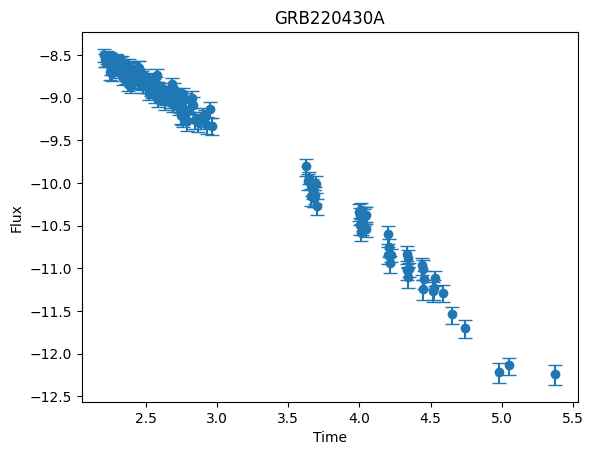


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.8515
Iteration 40/500 - Loss: 38.4023
Iteration 60/500 - Loss: 26.7656
Iteration 80/500 - Loss: 14.9430
Iteration 100/500 - Loss: 6.8504
Iteration 120/500 - Loss: 3.0240
Iteration 140/500 - Loss: 1.8367
Iteration 160/500 - Loss: 1.2239
Iteration 180/500 - Loss: 0.6671
Iteration 200/500 - Loss: 0.2997
Iteration 220/500 - Loss: 0.1564
Iteration 240/500 - Loss: 0.0413
Iteration 260/500 - Loss: -0.0593
Iteration 280/500 - Loss: -0.1485
Iteration 300/500 - Loss: -0.2281
Iteration 320/500 - Loss: -0.2993
Iteration 340/500 - Loss: -0.3627
Iteration 360/500 - Loss: -0.4188
Iteration 380/500 - Loss: -0.4673
Iteration 400/500 - Loss: -0.5103
Iteration 420/500 - Loss: -0.5308
Iteration 440/500 - Loss: -0.5485
Iteration 460/500 - Loss: -0.5652
Iteration 480/500 - Loss: -0.5808
Iteration 500/500 - Loss: -0.5953

-----RECONSTRUCTED GRB-----



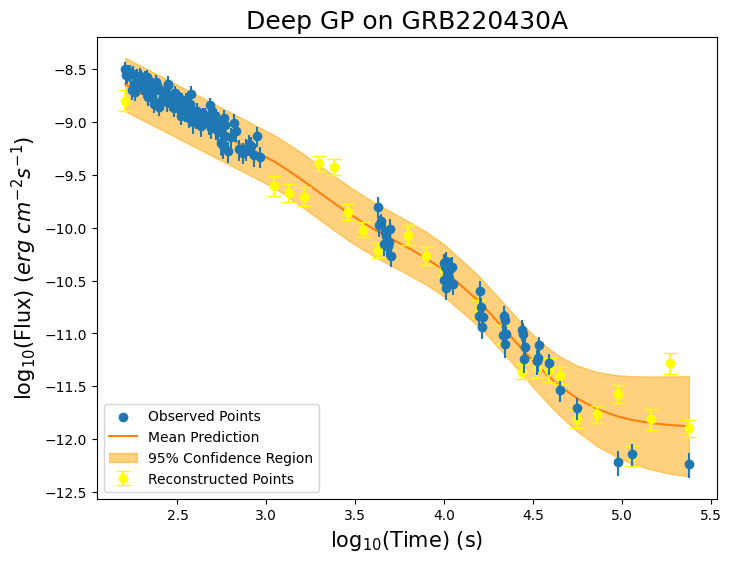


-----TRAINING FOR GRB220518A-----


-----ORIGINAL GRB-----



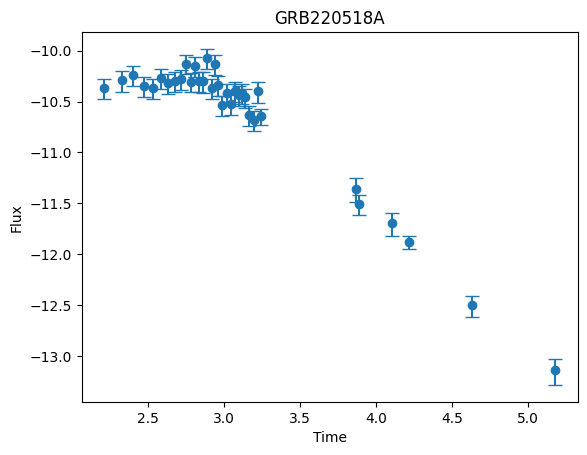


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.4696
Iteration 40/500 - Loss: 33.6913
Iteration 60/500 - Loss: 17.1596
Iteration 80/500 - Loss: 8.1864
Iteration 100/500 - Loss: 5.1542
Iteration 120/500 - Loss: 3.4359
Iteration 140/500 - Loss: 2.2881
Iteration 160/500 - Loss: 1.4913
Iteration 180/500 - Loss: 0.9745
Iteration 200/500 - Loss: 0.6353
Iteration 220/500 - Loss: 0.5056
Iteration 240/500 - Loss: 0.4025
Iteration 260/500 - Loss: 0.3143
Iteration 280/500 - Loss: 0.2391
Iteration 300/500 - Loss: 0.1753
Iteration 320/500 - Loss: 0.1214
Iteration 340/500 - Loss: 0.0761
Iteration 360/500 - Loss: 0.0381
Iteration 380/500 - Loss: 0.0063
Iteration 400/500 - Loss: -0.0202
Iteration 420/500 - Loss: -0.0321
Iteration 440/500 - Loss: -0.0426
Iteration 460/500 - Loss: -0.0522
Iteration 480/500 - Loss: -0.0611
Iteration 500/500 - Loss: -0.0693

-----RECONSTRUCTED GRB-----



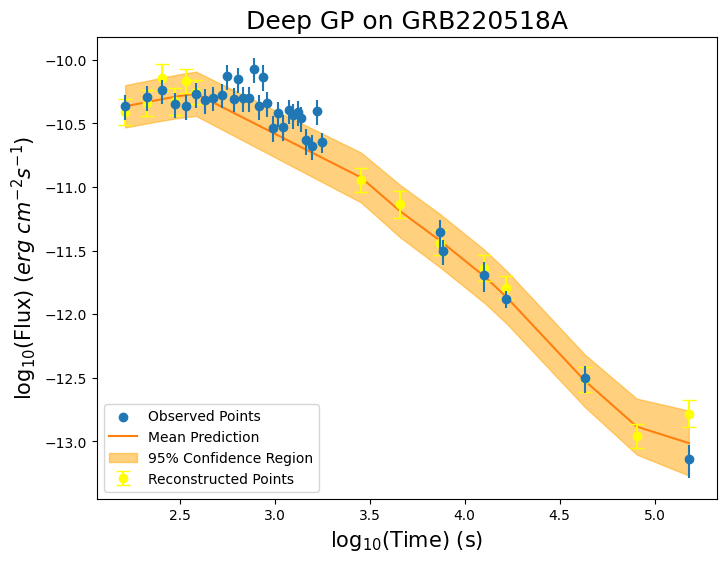


-----TRAINING FOR GRB220706A-----


-----ORIGINAL GRB-----



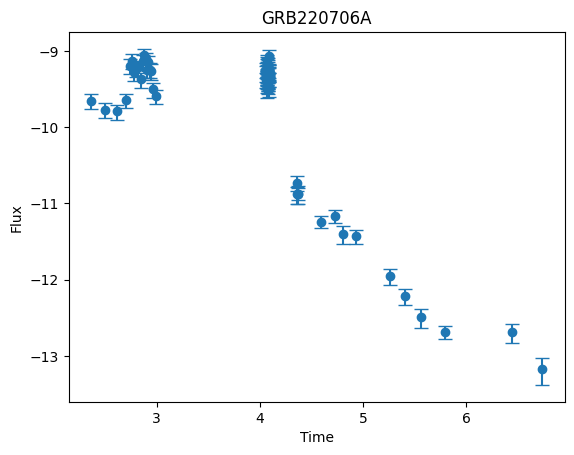


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.5913
Iteration 40/500 - Loss: 38.1148
Iteration 60/500 - Loss: 24.2265
Iteration 80/500 - Loss: 10.7062
Iteration 100/500 - Loss: 4.0759
Iteration 120/500 - Loss: 2.1277
Iteration 140/500 - Loss: 0.8417
Iteration 160/500 - Loss: 0.2846
Iteration 180/500 - Loss: 0.0555
Iteration 200/500 - Loss: -0.0800
Iteration 220/500 - Loss: -0.1389
Iteration 240/500 - Loss: -0.1857
Iteration 260/500 - Loss: -0.2265
Iteration 280/500 - Loss: -0.2613
Iteration 300/500 - Loss: -0.2930
Iteration 320/500 - Loss: -0.3194
Iteration 340/500 - Loss: -0.3470
Iteration 360/500 - Loss: -0.3704
Iteration 380/500 - Loss: -0.3925
Iteration 400/500 - Loss: -0.4092
Iteration 420/500 - Loss: -0.4271
Iteration 440/500 - Loss: -0.4365
Iteration 460/500 - Loss: -0.4440
Iteration 480/500 - Loss: -0.4537
Iteration 500/500 - Loss: -0.4615

-----RECONSTRUCTED GRB-----



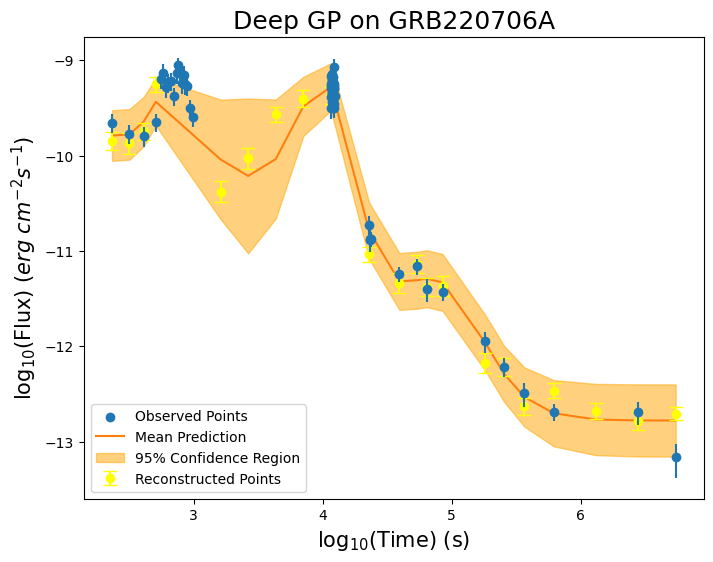


-----TRAINING FOR GRB220711B-----


-----ORIGINAL GRB-----



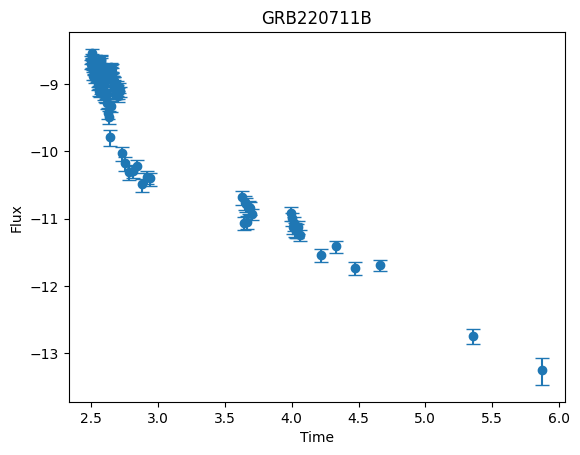


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 51.5916
Iteration 40/500 - Loss: 39.9900
Iteration 60/500 - Loss: 26.7092
Iteration 80/500 - Loss: 15.7860
Iteration 100/500 - Loss: 9.5126
Iteration 120/500 - Loss: 6.5300
Iteration 140/500 - Loss: 5.0103
Iteration 160/500 - Loss: 4.2066
Iteration 180/500 - Loss: 3.7310
Iteration 200/500 - Loss: 3.4623
Iteration 220/500 - Loss: 3.3674
Iteration 240/500 - Loss: 3.2920
Iteration 260/500 - Loss: 3.2244
Iteration 280/500 - Loss: 3.1620
Iteration 300/500 - Loss: 3.1031
Iteration 320/500 - Loss: 3.0466
Iteration 340/500 - Loss: 2.9915
Iteration 360/500 - Loss: 2.9375
Iteration 380/500 - Loss: 2.8841
Iteration 400/500 - Loss: 2.8310
Iteration 420/500 - Loss: 2.8033
Iteration 440/500 - Loss: 2.7765
Iteration 460/500 - Loss: 2.7493
Iteration 480/500 - Loss: 2.7220
Iteration 500/500 - Loss: 2.6942

-----RECONSTRUCTED GRB-----



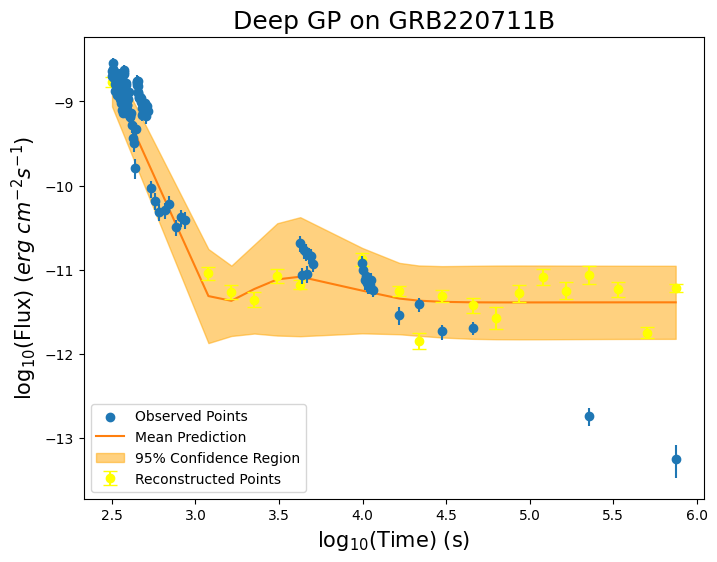


-----TRAINING FOR GRB220714B-----


-----ORIGINAL GRB-----



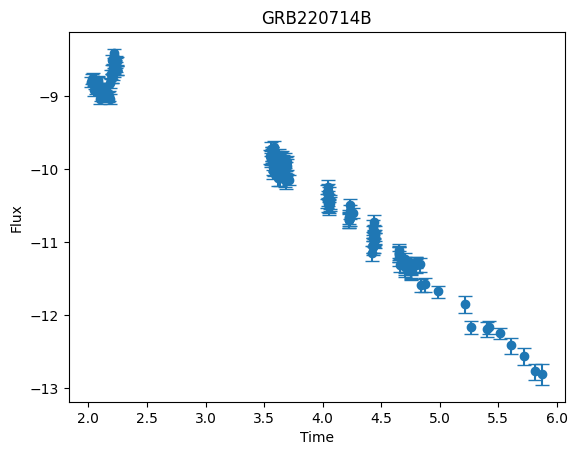


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 64.0156
Iteration 40/500 - Loss: 45.0605
Iteration 60/500 - Loss: 31.0889
Iteration 80/500 - Loss: 15.9124
Iteration 100/500 - Loss: 7.5884
Iteration 120/500 - Loss: 3.8717
Iteration 140/500 - Loss: 2.2654
Iteration 160/500 - Loss: 1.3987
Iteration 180/500 - Loss: 0.5036
Iteration 200/500 - Loss: -0.0177
Iteration 220/500 - Loss: -0.1447
Iteration 240/500 - Loss: -0.2261
Iteration 260/500 - Loss: -0.2923
Iteration 280/500 - Loss: -0.3492
Iteration 300/500 - Loss: -0.3979
Iteration 320/500 - Loss: -0.4396
Iteration 340/500 - Loss: -0.4752
Iteration 360/500 - Loss: -0.5055
Iteration 380/500 - Loss: -0.5312
Iteration 400/500 - Loss: -0.5531
Iteration 420/500 - Loss: -0.5632
Iteration 440/500 - Loss: -0.5721
Iteration 460/500 - Loss: -0.5804
Iteration 480/500 - Loss: -0.5881
Iteration 500/500 - Loss: -0.5952

-----RECONSTRUCTED GRB-----



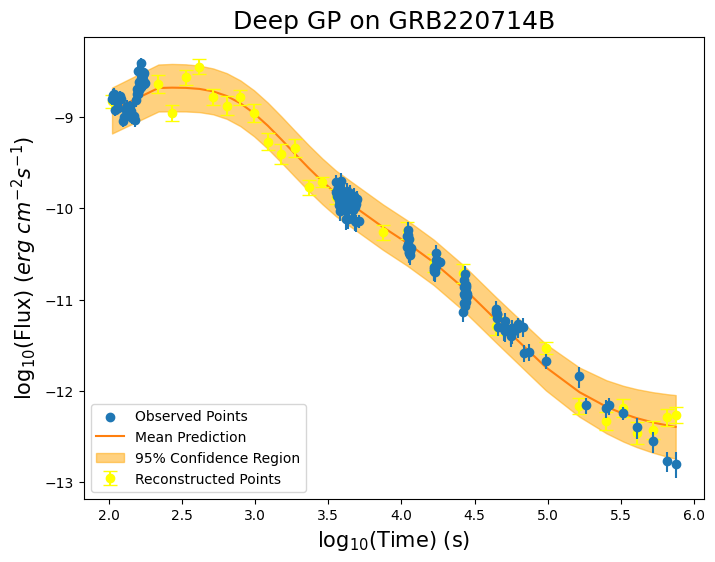


-----TRAINING FOR GRB220715B-----


-----ORIGINAL GRB-----



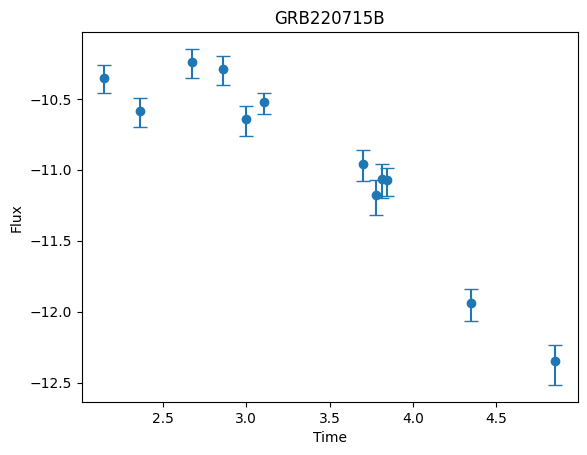


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.8111
Iteration 40/500 - Loss: 36.4328
Iteration 60/500 - Loss: 21.8858
Iteration 80/500 - Loss: 13.4269
Iteration 100/500 - Loss: 8.6204
Iteration 120/500 - Loss: 6.0094
Iteration 140/500 - Loss: 4.5160
Iteration 160/500 - Loss: 3.5926
Iteration 180/500 - Loss: 2.9855
Iteration 200/500 - Loss: 2.5481
Iteration 220/500 - Loss: 2.3545
Iteration 240/500 - Loss: 2.1850
Iteration 260/500 - Loss: 2.0319
Iteration 280/500 - Loss: 1.8932
Iteration 300/500 - Loss: 1.7661
Iteration 320/500 - Loss: 1.6477
Iteration 340/500 - Loss: 1.5362
Iteration 360/500 - Loss: 1.4493
Iteration 380/500 - Loss: 1.3500
Iteration 400/500 - Loss: 1.2641
Iteration 420/500 - Loss: 1.2209
Iteration 440/500 - Loss: 1.1793
Iteration 460/500 - Loss: 1.1368
Iteration 480/500 - Loss: 1.0926
Iteration 500/500 - Loss: 1.0461

-----RECONSTRUCTED GRB-----



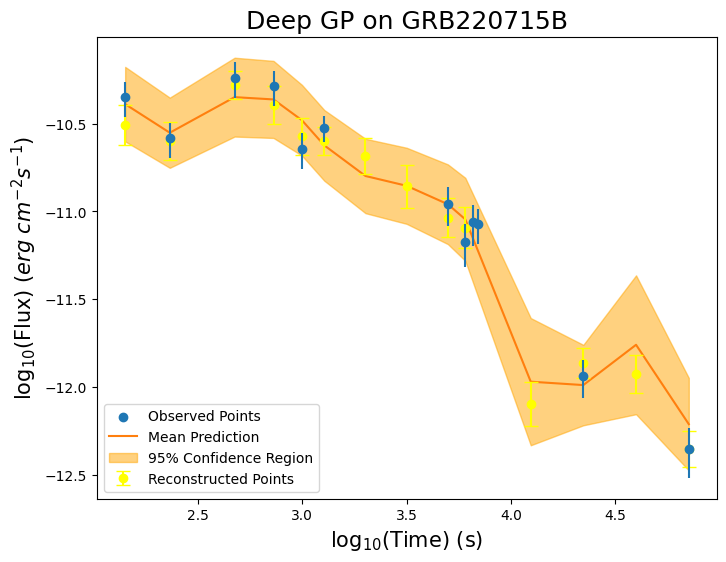


-----TRAINING FOR GRB220813A-----


-----ORIGINAL GRB-----



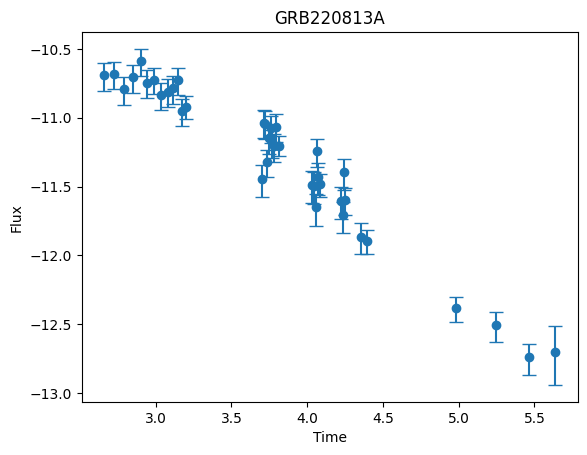


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.8215
Iteration 40/500 - Loss: 31.7941
Iteration 60/500 - Loss: 15.1579
Iteration 80/500 - Loss: 7.4320
Iteration 100/500 - Loss: 3.7119
Iteration 120/500 - Loss: 2.0593
Iteration 140/500 - Loss: 1.3898
Iteration 160/500 - Loss: 1.1000
Iteration 180/500 - Loss: 0.9393
Iteration 200/500 - Loss: 0.8304
Iteration 220/500 - Loss: 0.7850
Iteration 240/500 - Loss: 0.7468
Iteration 260/500 - Loss: 0.7124
Iteration 280/500 - Loss: 0.6820
Iteration 300/500 - Loss: 0.6551
Iteration 320/500 - Loss: 0.6315
Iteration 340/500 - Loss: 0.6109
Iteration 360/500 - Loss: 0.5929
Iteration 380/500 - Loss: 0.5771
Iteration 400/500 - Loss: 0.5631
Iteration 420/500 - Loss: 0.5565
Iteration 440/500 - Loss: 0.5505
Iteration 460/500 - Loss: 0.5447
Iteration 480/500 - Loss: 0.5393
Iteration 500/500 - Loss: 0.5340

-----RECONSTRUCTED GRB-----



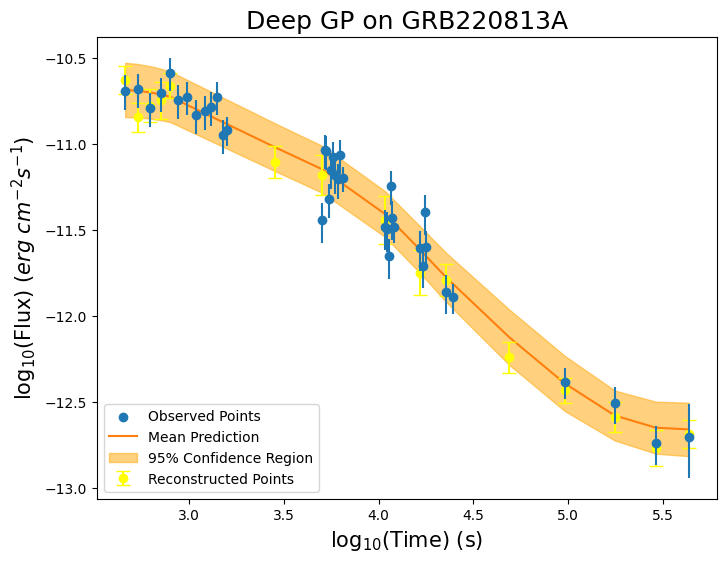


-----TRAINING FOR GRB220826A-----


-----ORIGINAL GRB-----



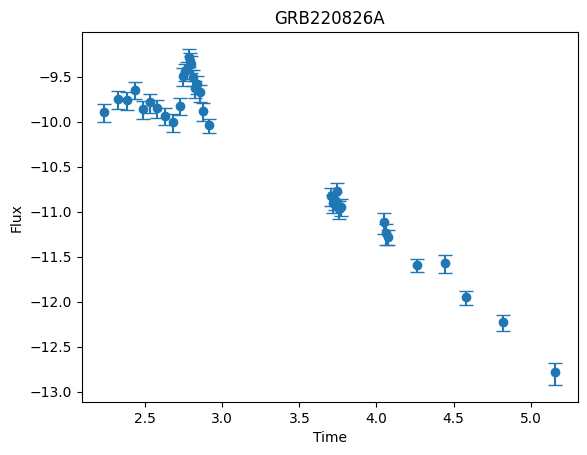


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 43.1190
Iteration 40/500 - Loss: 26.8480
Iteration 60/500 - Loss: 12.3462
Iteration 80/500 - Loss: 7.1748
Iteration 100/500 - Loss: 4.8050
Iteration 120/500 - Loss: 3.3179
Iteration 140/500 - Loss: 2.3775
Iteration 160/500 - Loss: 1.7623
Iteration 180/500 - Loss: 1.3437
Iteration 200/500 - Loss: 1.0646
Iteration 220/500 - Loss: 0.9589
Iteration 240/500 - Loss: 0.8756
Iteration 260/500 - Loss: 0.8039
Iteration 280/500 - Loss: 0.7416
Iteration 300/500 - Loss: 0.6871
Iteration 320/500 - Loss: 0.6395
Iteration 340/500 - Loss: 0.5981
Iteration 360/500 - Loss: 0.5622
Iteration 380/500 - Loss: 0.5308
Iteration 400/500 - Loss: 0.5021
Iteration 420/500 - Loss: 0.4875
Iteration 440/500 - Loss: 0.4736
Iteration 460/500 - Loss: 0.4593
Iteration 480/500 - Loss: 0.4448
Iteration 500/500 - Loss: 0.4298

-----RECONSTRUCTED GRB-----



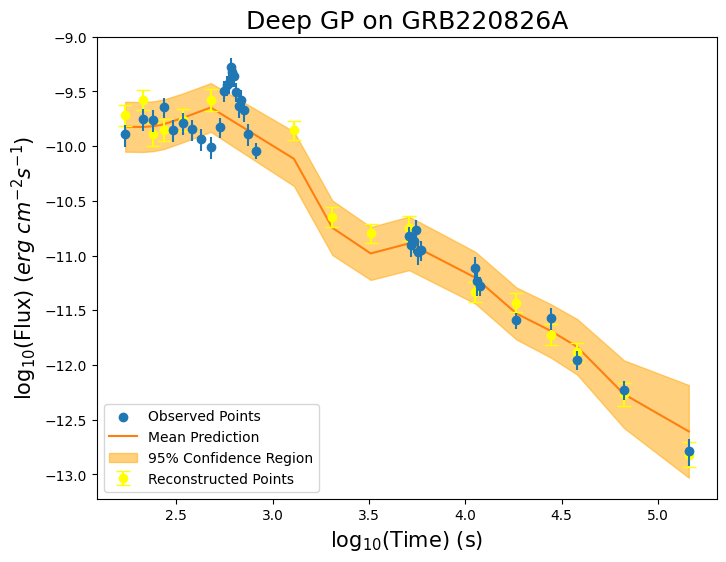


-----TRAINING FOR GRB221024A-----


-----ORIGINAL GRB-----



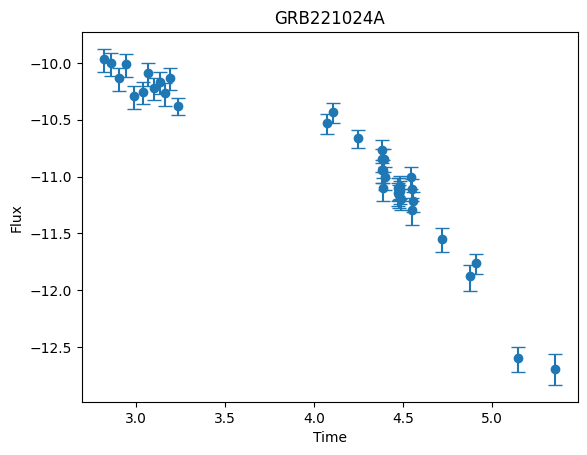


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.7918
Iteration 40/500 - Loss: 39.4506
Iteration 60/500 - Loss: 26.2971
Iteration 80/500 - Loss: 14.8162
Iteration 100/500 - Loss: 8.3678
Iteration 120/500 - Loss: 5.0907
Iteration 140/500 - Loss: 3.3761
Iteration 160/500 - Loss: 2.3662
Iteration 180/500 - Loss: 1.6863
Iteration 200/500 - Loss: 1.3020
Iteration 220/500 - Loss: 1.0140
Iteration 240/500 - Loss: 0.8541
Iteration 260/500 - Loss: 0.7168
Iteration 280/500 - Loss: 0.6011
Iteration 300/500 - Loss: 0.5045
Iteration 320/500 - Loss: 0.4242
Iteration 340/500 - Loss: 0.3572
Iteration 360/500 - Loss: 0.3009
Iteration 380/500 - Loss: 0.2535
Iteration 400/500 - Loss: 0.2133
Iteration 420/500 - Loss: 0.1947
Iteration 440/500 - Loss: 0.1783
Iteration 460/500 - Loss: 0.1630
Iteration 480/500 - Loss: 0.1486
Iteration 500/500 - Loss: 0.1351

-----RECONSTRUCTED GRB-----



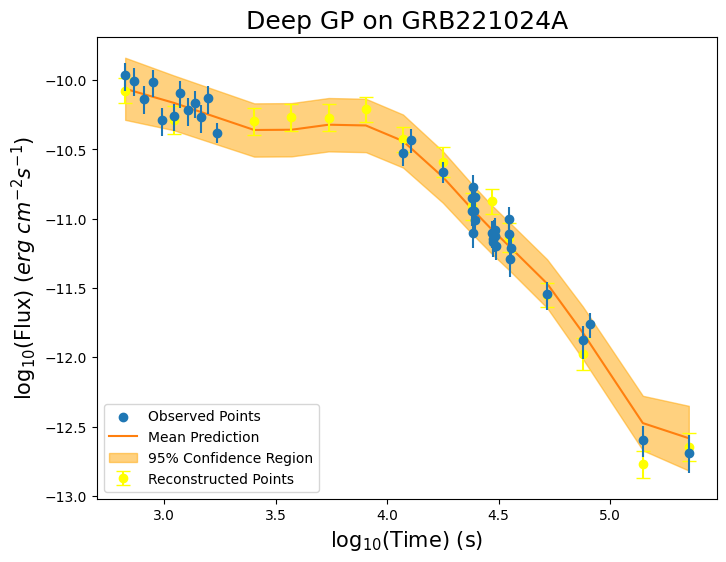


-----TRAINING FOR GRB230123A-----


-----ORIGINAL GRB-----



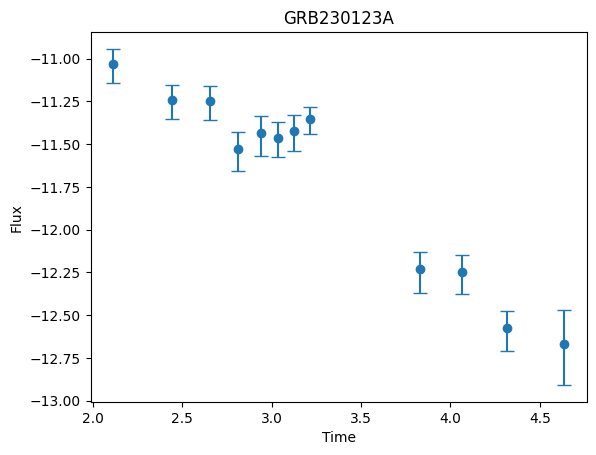


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.0724
Iteration 40/500 - Loss: 35.4714
Iteration 60/500 - Loss: 21.1143
Iteration 80/500 - Loss: 9.8278
Iteration 100/500 - Loss: 5.3589
Iteration 120/500 - Loss: 3.8647
Iteration 140/500 - Loss: 3.0293
Iteration 160/500 - Loss: 2.2710
Iteration 180/500 - Loss: 1.8124
Iteration 200/500 - Loss: 1.4843
Iteration 220/500 - Loss: 1.3182
Iteration 240/500 - Loss: 1.1689
Iteration 260/500 - Loss: 1.0358
Iteration 280/500 - Loss: 0.9189
Iteration 300/500 - Loss: 0.8191
Iteration 320/500 - Loss: 0.7322
Iteration 340/500 - Loss: 0.6538
Iteration 360/500 - Loss: 0.5883
Iteration 380/500 - Loss: 0.5393
Iteration 400/500 - Loss: 0.4998
Iteration 420/500 - Loss: 0.4814
Iteration 440/500 - Loss: 0.4649
Iteration 460/500 - Loss: 0.4491
Iteration 480/500 - Loss: 0.4341
Iteration 500/500 - Loss: 0.4195

-----RECONSTRUCTED GRB-----



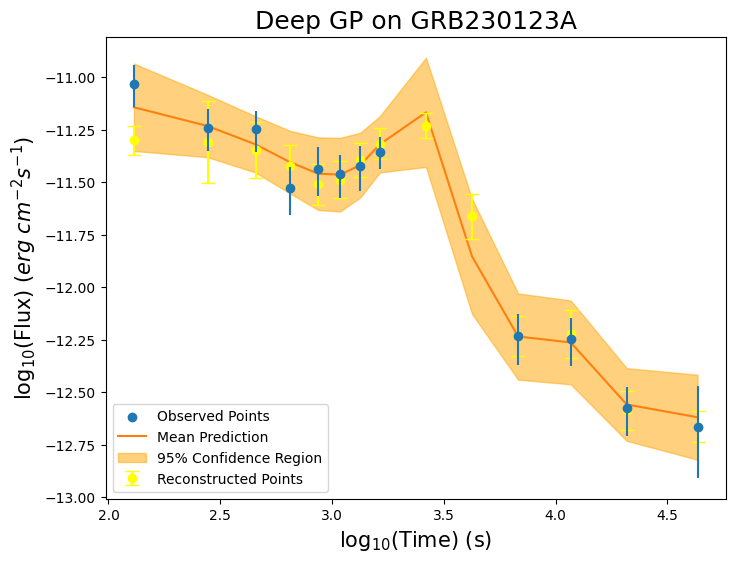


-----TRAINING FOR GRB230228A-----


-----ORIGINAL GRB-----



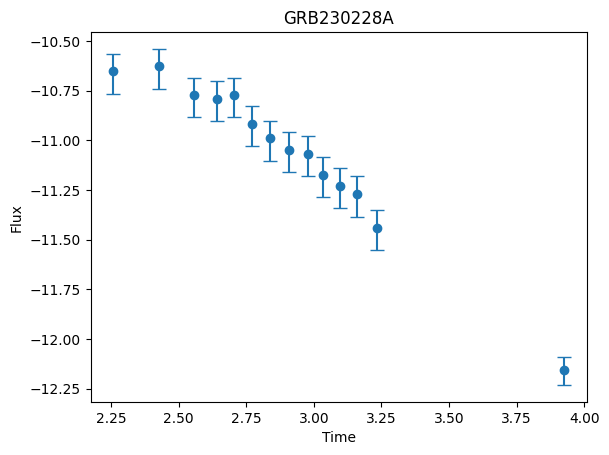


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.9186
Iteration 40/500 - Loss: 38.1188
Iteration 60/500 - Loss: 24.4641
Iteration 80/500 - Loss: 14.1026
Iteration 100/500 - Loss: 8.6944
Iteration 120/500 - Loss: 5.0572
Iteration 140/500 - Loss: 2.9236
Iteration 160/500 - Loss: 1.7326
Iteration 180/500 - Loss: 1.1081
Iteration 200/500 - Loss: 0.7813
Iteration 220/500 - Loss: 0.6758
Iteration 240/500 - Loss: 0.5980
Iteration 260/500 - Loss: 0.5342
Iteration 280/500 - Loss: 0.4809
Iteration 300/500 - Loss: 0.4359
Iteration 320/500 - Loss: 0.3974
Iteration 340/500 - Loss: 0.3638
Iteration 360/500 - Loss: 0.3342
Iteration 380/500 - Loss: 0.3080
Iteration 400/500 - Loss: 0.2845
Iteration 420/500 - Loss: 0.2731
Iteration 440/500 - Loss: 0.2627
Iteration 460/500 - Loss: 0.2527
Iteration 480/500 - Loss: 0.2430
Iteration 500/500 - Loss: 0.2336

-----RECONSTRUCTED GRB-----



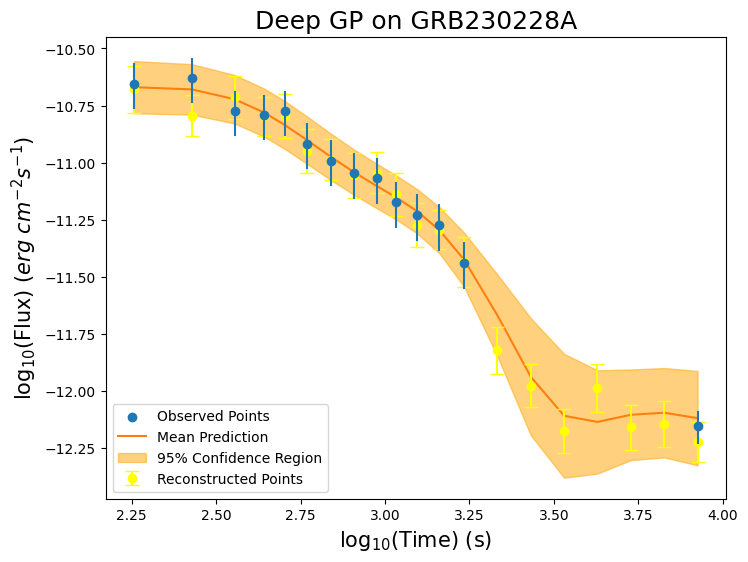


-----TRAINING FOR GRB230322B-----


-----ORIGINAL GRB-----



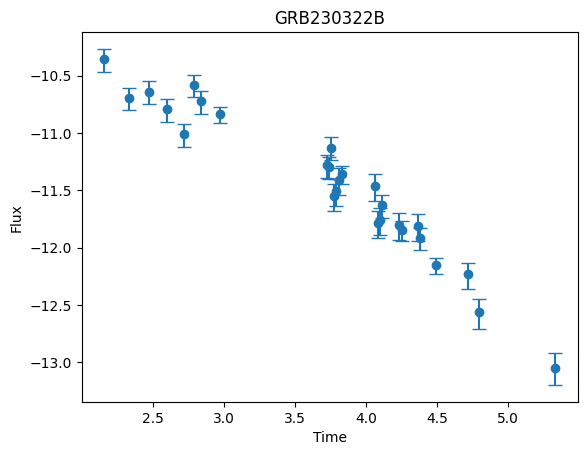


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.8334
Iteration 40/500 - Loss: 34.9927
Iteration 60/500 - Loss: 21.9825
Iteration 80/500 - Loss: 12.2816
Iteration 100/500 - Loss: 7.0994
Iteration 120/500 - Loss: 4.2417
Iteration 140/500 - Loss: 2.6386
Iteration 160/500 - Loss: 1.8985
Iteration 180/500 - Loss: 1.5639
Iteration 200/500 - Loss: 1.3834
Iteration 220/500 - Loss: 1.3013
Iteration 240/500 - Loss: 1.2268
Iteration 260/500 - Loss: 1.1528
Iteration 280/500 - Loss: 1.0771
Iteration 300/500 - Loss: 1.0022
Iteration 320/500 - Loss: 0.9316
Iteration 340/500 - Loss: 0.8682
Iteration 360/500 - Loss: 0.8132
Iteration 380/500 - Loss: 0.7658
Iteration 400/500 - Loss: 0.7253
Iteration 420/500 - Loss: 0.7051
Iteration 440/500 - Loss: 0.6877
Iteration 460/500 - Loss: 0.6712
Iteration 480/500 - Loss: 0.6556
Iteration 500/500 - Loss: 0.6409

-----RECONSTRUCTED GRB-----



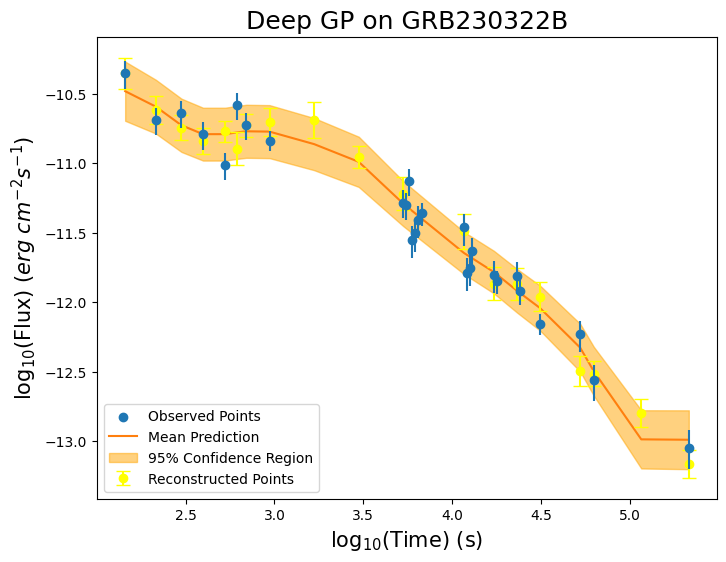


-----TRAINING FOR GRB230405B-----


-----ORIGINAL GRB-----



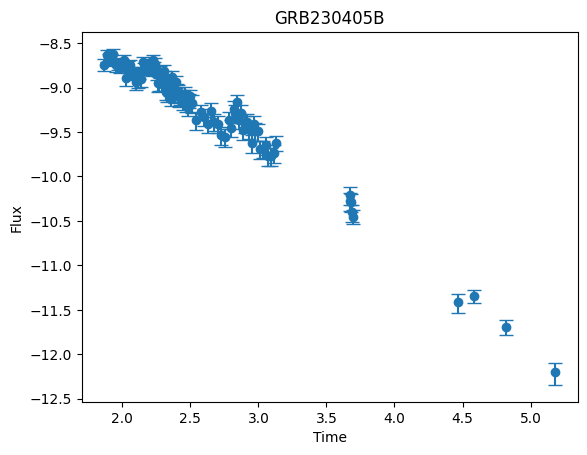


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.3790
Iteration 40/500 - Loss: 36.8096
Iteration 60/500 - Loss: 24.6623
Iteration 80/500 - Loss: 14.3035
Iteration 100/500 - Loss: 8.7681
Iteration 120/500 - Loss: 5.7719
Iteration 140/500 - Loss: 4.5222
Iteration 160/500 - Loss: 3.8338
Iteration 180/500 - Loss: 3.3159
Iteration 200/500 - Loss: 2.3467
Iteration 220/500 - Loss: 1.7745
Iteration 240/500 - Loss: 1.3242
Iteration 260/500 - Loss: 0.9977
Iteration 280/500 - Loss: 0.7593
Iteration 300/500 - Loss: 0.5831
Iteration 320/500 - Loss: 0.4519
Iteration 340/500 - Loss: 0.3537
Iteration 360/500 - Loss: 0.2798
Iteration 380/500 - Loss: 0.2245
Iteration 400/500 - Loss: 0.1974
Iteration 420/500 - Loss: 0.1639
Iteration 440/500 - Loss: 0.1466
Iteration 460/500 - Loss: 0.1319
Iteration 480/500 - Loss: 0.1183
Iteration 500/500 - Loss: 0.1055

-----RECONSTRUCTED GRB-----



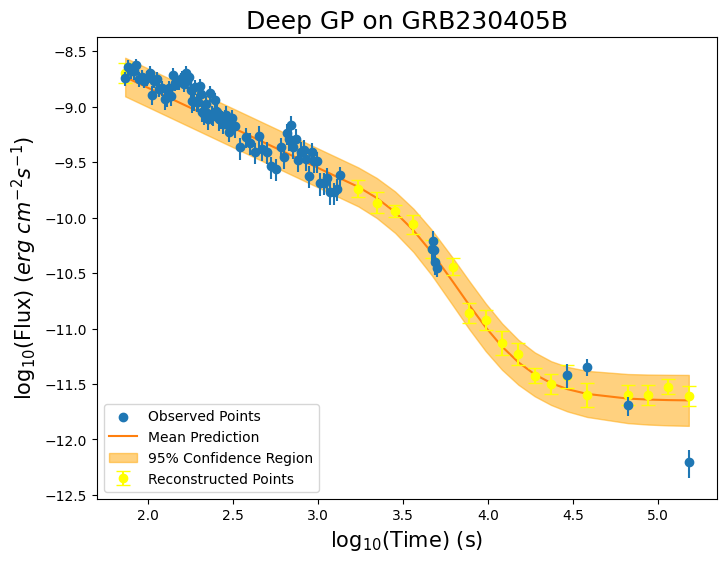


-----TRAINING FOR GRB230409B-----


-----ORIGINAL GRB-----



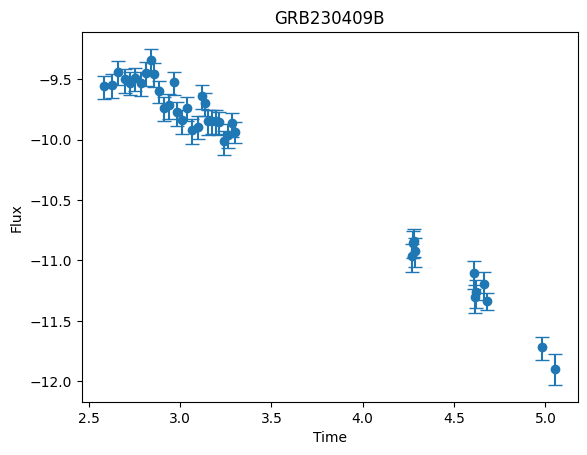


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 45.1437
Iteration 40/500 - Loss: 30.5002
Iteration 60/500 - Loss: 12.8896
Iteration 80/500 - Loss: 4.3165
Iteration 100/500 - Loss: 2.2654
Iteration 120/500 - Loss: 1.4629
Iteration 140/500 - Loss: 0.9297
Iteration 160/500 - Loss: 0.5704
Iteration 180/500 - Loss: 0.3238
Iteration 200/500 - Loss: 0.1509
Iteration 220/500 - Loss: 0.0795
Iteration 240/500 - Loss: 0.0241
Iteration 260/500 - Loss: -0.0234
Iteration 280/500 - Loss: -0.0640
Iteration 300/500 - Loss: -0.0993
Iteration 320/500 - Loss: -0.1299
Iteration 340/500 - Loss: -0.1556
Iteration 360/500 - Loss: -0.1793
Iteration 380/500 - Loss: -0.1996
Iteration 400/500 - Loss: -0.2170
Iteration 420/500 - Loss: -0.2256
Iteration 440/500 - Loss: -0.2331
Iteration 460/500 - Loss: -0.2403
Iteration 480/500 - Loss: -0.2471
Iteration 500/500 - Loss: -0.2536

-----RECONSTRUCTED GRB-----



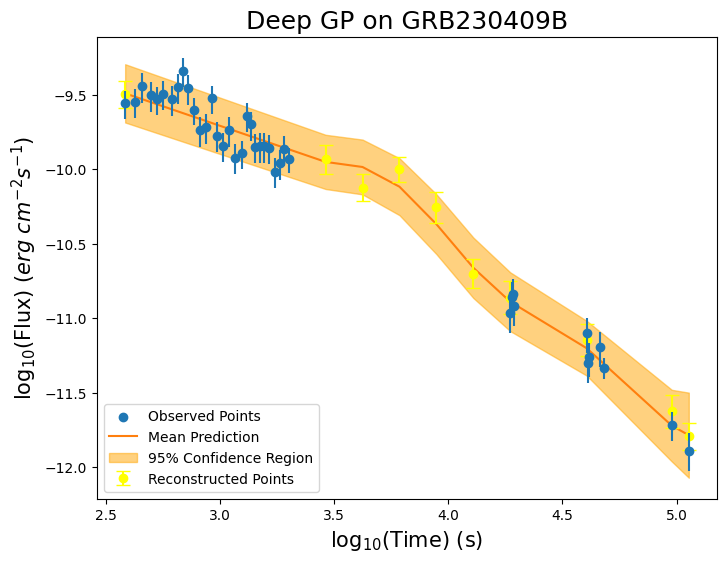


-----TRAINING FOR GRB230420A-----


-----ORIGINAL GRB-----



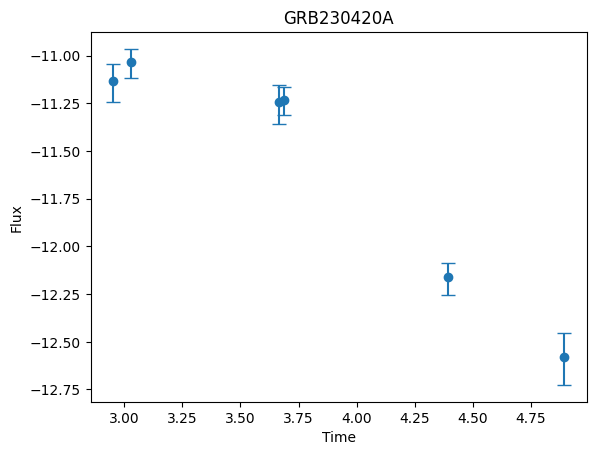


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 62.2494
Iteration 40/500 - Loss: 43.0004
Iteration 60/500 - Loss: 26.6875
Iteration 80/500 - Loss: 14.2759
Iteration 100/500 - Loss: 7.6243
Iteration 120/500 - Loss: 4.5362
Iteration 140/500 - Loss: 3.1530
Iteration 160/500 - Loss: 2.4952
Iteration 180/500 - Loss: 2.1072
Iteration 200/500 - Loss: 1.8329
Iteration 220/500 - Loss: 1.7170
Iteration 240/500 - Loss: 1.6178
Iteration 260/500 - Loss: 1.5267
Iteration 280/500 - Loss: 1.4430
Iteration 300/500 - Loss: 1.3660
Iteration 320/500 - Loss: 1.2952
Iteration 340/500 - Loss: 1.2300
Iteration 360/500 - Loss: 1.1702
Iteration 380/500 - Loss: 1.1153
Iteration 400/500 - Loss: 1.0650
Iteration 420/500 - Loss: 1.0403
Iteration 440/500 - Loss: 1.0177
Iteration 460/500 - Loss: 0.9957
Iteration 480/500 - Loss: 0.9745
Iteration 500/500 - Loss: 0.9540

-----RECONSTRUCTED GRB-----



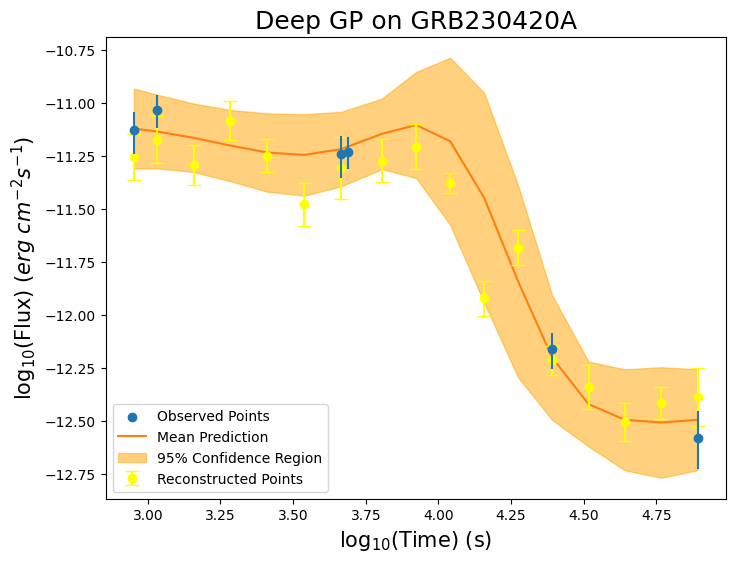


-----TRAINING FOR GRB230618A-----


-----ORIGINAL GRB-----



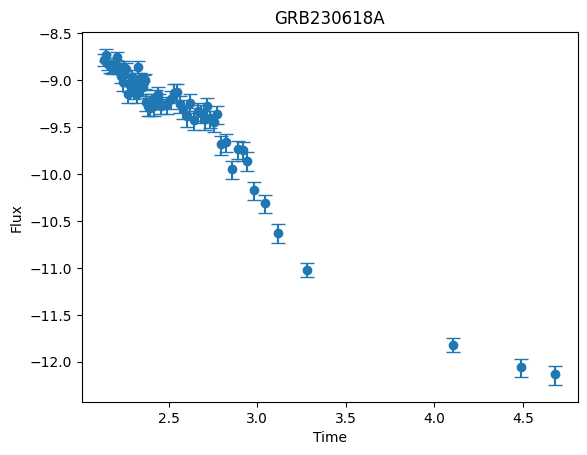


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.3510
Iteration 40/500 - Loss: 41.5721
Iteration 60/500 - Loss: 33.4294
Iteration 80/500 - Loss: 22.9831
Iteration 100/500 - Loss: 13.2383
Iteration 120/500 - Loss: 6.8274
Iteration 140/500 - Loss: 3.7079
Iteration 160/500 - Loss: 1.9621
Iteration 180/500 - Loss: 0.9353
Iteration 200/500 - Loss: 0.3644
Iteration 220/500 - Loss: 0.1829
Iteration 240/500 - Loss: 0.0578
Iteration 260/500 - Loss: -0.0362
Iteration 280/500 - Loss: -0.1065
Iteration 300/500 - Loss: -0.1592
Iteration 320/500 - Loss: -0.1981
Iteration 340/500 - Loss: -0.2277
Iteration 360/500 - Loss: -0.2505
Iteration 380/500 - Loss: -0.2680
Iteration 400/500 - Loss: -0.2821
Iteration 420/500 - Loss: -0.2883
Iteration 440/500 - Loss: -0.2937
Iteration 460/500 - Loss: -0.2986
Iteration 480/500 - Loss: -0.3032
Iteration 500/500 - Loss: -0.3075

-----RECONSTRUCTED GRB-----



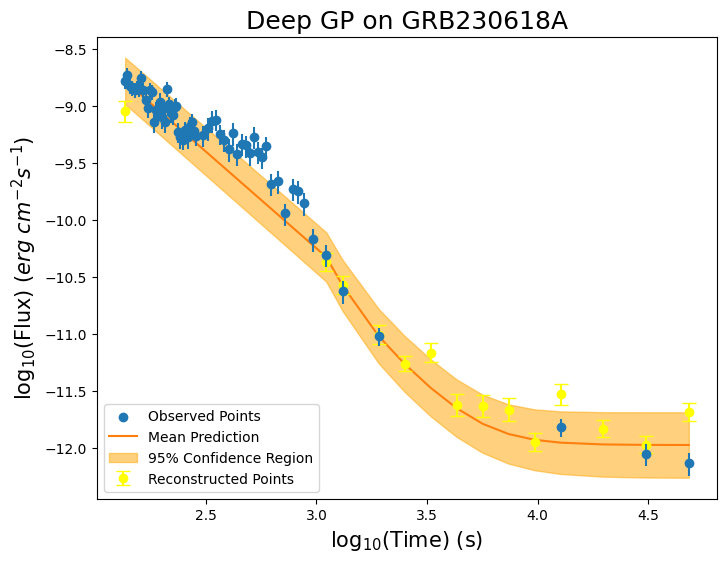


-----TRAINING FOR GRB230628E-----


-----ORIGINAL GRB-----



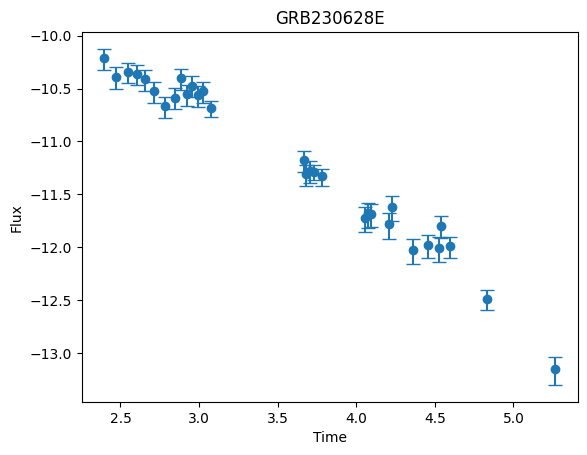


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.6409
Iteration 40/500 - Loss: 30.0926
Iteration 60/500 - Loss: 13.1912
Iteration 80/500 - Loss: 6.1903
Iteration 100/500 - Loss: 3.7092
Iteration 120/500 - Loss: 2.2083
Iteration 140/500 - Loss: 1.3115
Iteration 160/500 - Loss: 0.7929
Iteration 180/500 - Loss: 0.4990
Iteration 200/500 - Loss: 0.3124
Iteration 220/500 - Loss: 0.1945
Iteration 240/500 - Loss: 0.0862
Iteration 260/500 - Loss: -0.0085
Iteration 280/500 - Loss: -0.0763
Iteration 300/500 - Loss: -0.1196
Iteration 320/500 - Loss: -0.1499
Iteration 340/500 - Loss: -0.1738
Iteration 360/500 - Loss: -0.1942
Iteration 380/500 - Loss: -0.2124
Iteration 400/500 - Loss: -0.2290
Iteration 420/500 - Loss: -0.2371
Iteration 440/500 - Loss: -0.2446
Iteration 460/500 - Loss: -0.2520
Iteration 480/500 - Loss: -0.2592
Iteration 500/500 - Loss: -0.2663

-----RECONSTRUCTED GRB-----



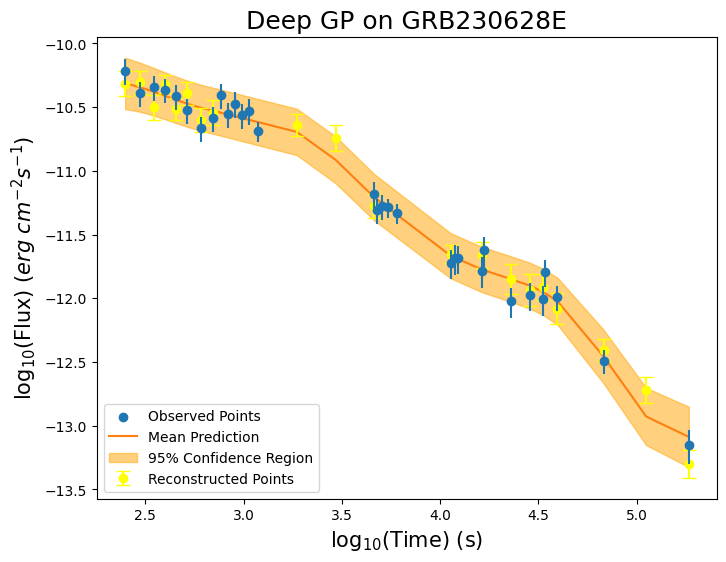


-----TRAINING FOR GRB230815A-----


-----ORIGINAL GRB-----



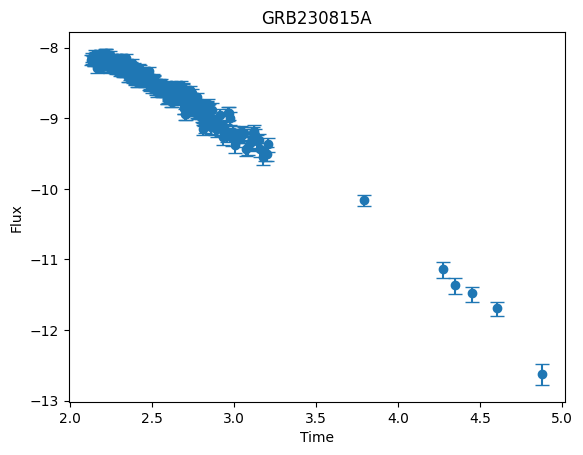


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.4741
Iteration 40/500 - Loss: 40.8423
Iteration 60/500 - Loss: 32.3742
Iteration 80/500 - Loss: 23.5641
Iteration 100/500 - Loss: 16.3695
Iteration 120/500 - Loss: 12.7811
Iteration 140/500 - Loss: 9.7819
Iteration 160/500 - Loss: 7.6084
Iteration 180/500 - Loss: 5.7315
Iteration 200/500 - Loss: 4.2339
Iteration 220/500 - Loss: 3.5856
Iteration 240/500 - Loss: 3.0749
Iteration 260/500 - Loss: 2.6428
Iteration 280/500 - Loss: 2.2815
Iteration 300/500 - Loss: 1.9837
Iteration 320/500 - Loss: 1.7406
Iteration 340/500 - Loss: 1.5425
Iteration 360/500 - Loss: 1.3797
Iteration 380/500 - Loss: 1.2700
Iteration 400/500 - Loss: 1.1310
Iteration 420/500 - Loss: 1.0787
Iteration 440/500 - Loss: 1.0320
Iteration 460/500 - Loss: 0.9881
Iteration 480/500 - Loss: 0.9466
Iteration 500/500 - Loss: 0.9072

-----RECONSTRUCTED GRB-----



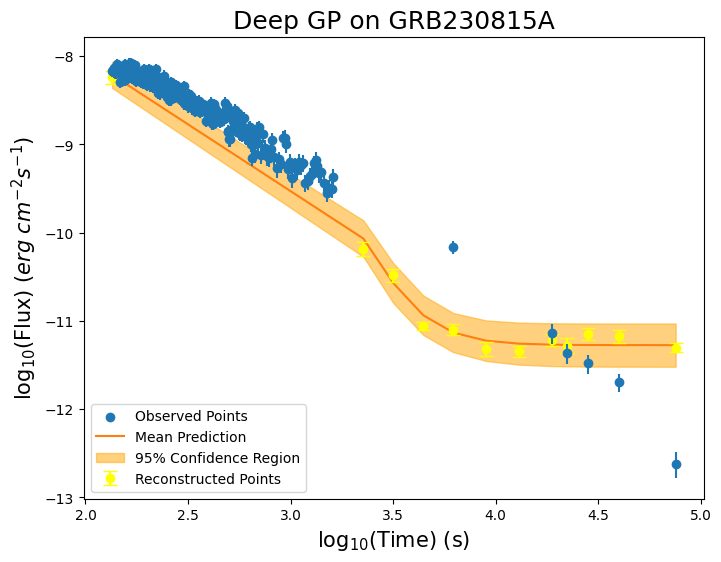


-----TRAINING FOR GRB230826A-----


-----ORIGINAL GRB-----



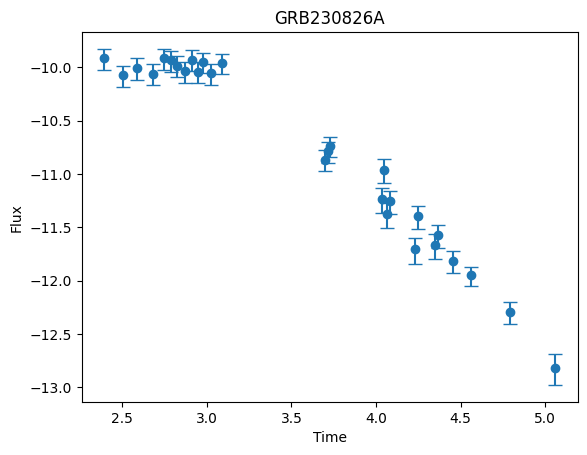


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 47.1136
Iteration 40/500 - Loss: 31.4384
Iteration 60/500 - Loss: 15.8156
Iteration 80/500 - Loss: 6.9261
Iteration 100/500 - Loss: 3.4760
Iteration 120/500 - Loss: 1.9166
Iteration 140/500 - Loss: 1.1049
Iteration 160/500 - Loss: 0.6201
Iteration 180/500 - Loss: 0.3199
Iteration 200/500 - Loss: 0.1095
Iteration 220/500 - Loss: 0.0346
Iteration 240/500 - Loss: -0.0207
Iteration 260/500 - Loss: -0.0654
Iteration 280/500 - Loss: -0.1014
Iteration 300/500 - Loss: -0.1305
Iteration 320/500 - Loss: -0.1546
Iteration 340/500 - Loss: -0.1750
Iteration 360/500 - Loss: -0.1934
Iteration 380/500 - Loss: -0.2078
Iteration 400/500 - Loss: -0.2115
Iteration 420/500 - Loss: -0.2295
Iteration 440/500 - Loss: -0.2363
Iteration 460/500 - Loss: -0.2431
Iteration 480/500 - Loss: -0.2502
Iteration 500/500 - Loss: -0.2578

-----RECONSTRUCTED GRB-----



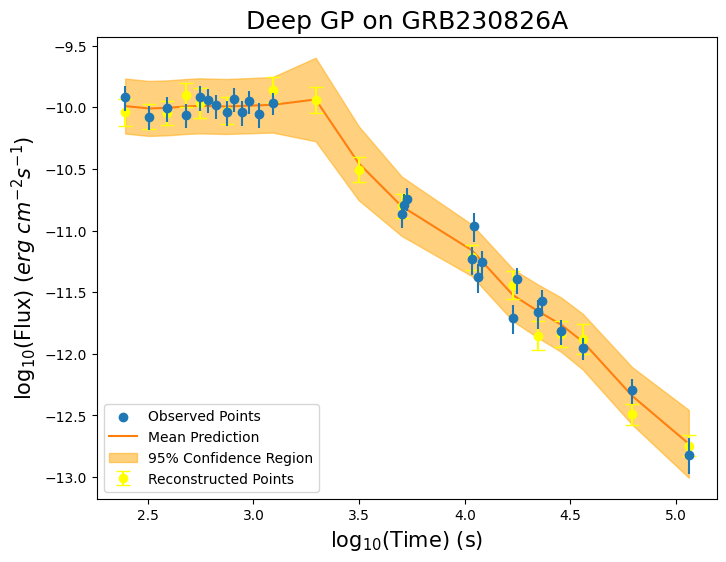


-----TRAINING FOR GRB230903A-----


-----ORIGINAL GRB-----



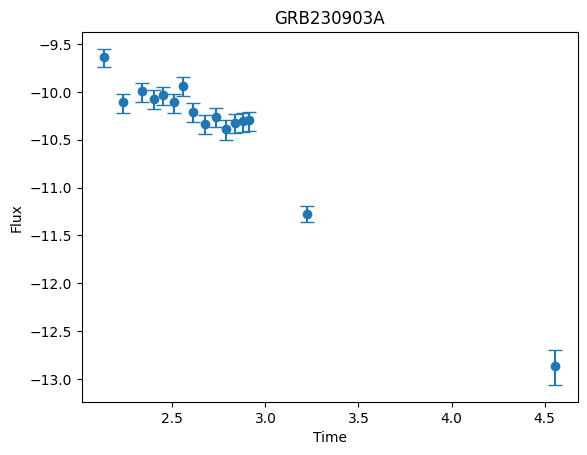


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.6944
Iteration 40/500 - Loss: 39.5703
Iteration 60/500 - Loss: 26.4739
Iteration 80/500 - Loss: 14.8699
Iteration 100/500 - Loss: 9.1476
Iteration 120/500 - Loss: 5.7774
Iteration 140/500 - Loss: 3.6038
Iteration 160/500 - Loss: 2.2864
Iteration 180/500 - Loss: 1.5194
Iteration 200/500 - Loss: 1.0868
Iteration 220/500 - Loss: 0.9394
Iteration 240/500 - Loss: 0.8355
Iteration 260/500 - Loss: 0.7533
Iteration 280/500 - Loss: 0.6877
Iteration 300/500 - Loss: 0.6348
Iteration 320/500 - Loss: 0.5917
Iteration 340/500 - Loss: 0.5558
Iteration 360/500 - Loss: 0.5253
Iteration 380/500 - Loss: 0.4989
Iteration 400/500 - Loss: 0.4755
Iteration 420/500 - Loss: 0.4641
Iteration 440/500 - Loss: 0.4534
Iteration 460/500 - Loss: 0.4426
Iteration 480/500 - Loss: 0.4317
Iteration 500/500 - Loss: 0.4205

-----RECONSTRUCTED GRB-----



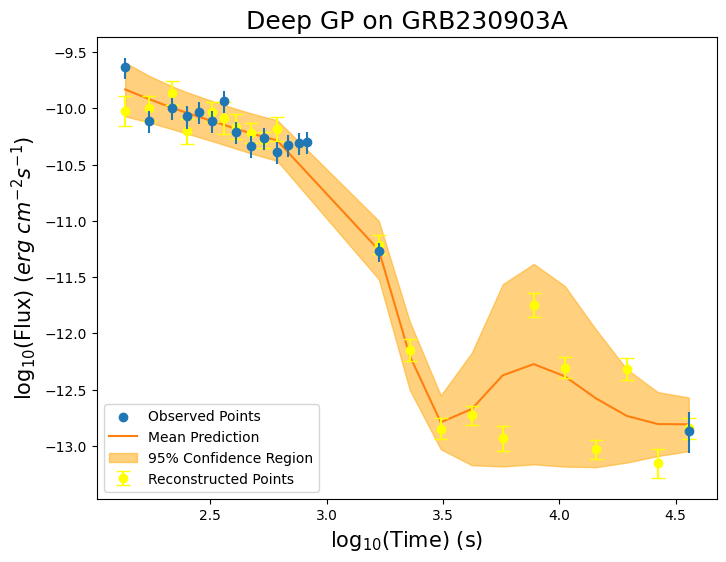


-----TRAINING FOR GRB231104A-----


-----ORIGINAL GRB-----



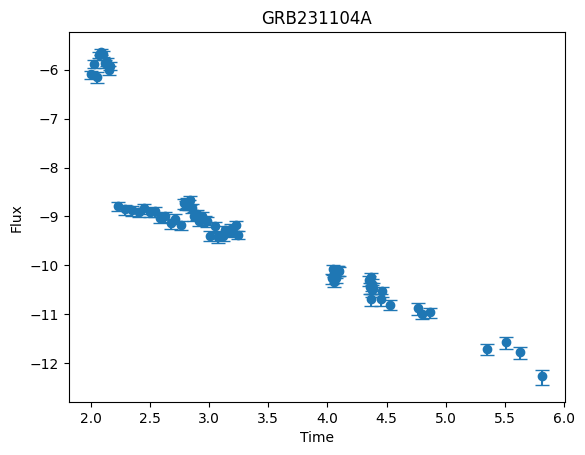


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.6709
Iteration 40/500 - Loss: 37.3173
Iteration 60/500 - Loss: 22.8962
Iteration 80/500 - Loss: 10.6619
Iteration 100/500 - Loss: 6.5013
Iteration 120/500 - Loss: 4.3981
Iteration 140/500 - Loss: 3.8098
Iteration 160/500 - Loss: 3.1509
Iteration 180/500 - Loss: 2.7621
Iteration 200/500 - Loss: 2.5158
Iteration 220/500 - Loss: 2.4188
Iteration 240/500 - Loss: 2.3385
Iteration 260/500 - Loss: 2.2661
Iteration 280/500 - Loss: 2.2007
Iteration 300/500 - Loss: 2.1420
Iteration 320/500 - Loss: 2.1209
Iteration 340/500 - Loss: 2.0408
Iteration 360/500 - Loss: 1.9947
Iteration 380/500 - Loss: 1.9516
Iteration 400/500 - Loss: 1.9111
Iteration 420/500 - Loss: 1.8904
Iteration 440/500 - Loss: 1.8715
Iteration 460/500 - Loss: 1.8534
Iteration 480/500 - Loss: 1.8352
Iteration 500/500 - Loss: 1.8178

-----RECONSTRUCTED GRB-----



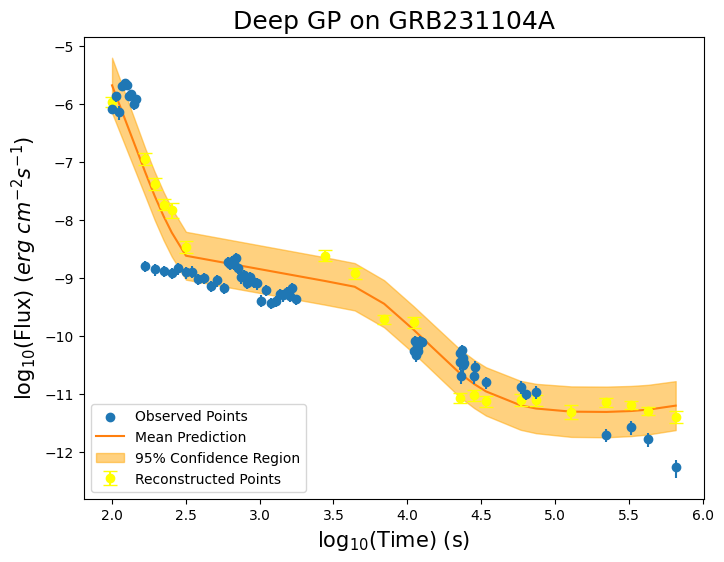


-----TRAINING FOR GRB231205B-----


-----ORIGINAL GRB-----



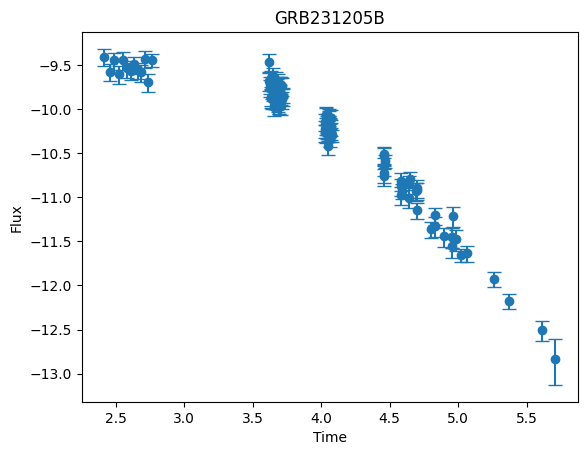


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.9818
Iteration 40/500 - Loss: 32.0355
Iteration 60/500 - Loss: 14.9499
Iteration 80/500 - Loss: 8.8673
Iteration 100/500 - Loss: 6.0239
Iteration 120/500 - Loss: 4.2544
Iteration 140/500 - Loss: 3.0479
Iteration 160/500 - Loss: 2.2505
Iteration 180/500 - Loss: 1.6906
Iteration 200/500 - Loss: 1.2555
Iteration 220/500 - Loss: 1.0674
Iteration 240/500 - Loss: 0.9080
Iteration 260/500 - Loss: 0.7654
Iteration 280/500 - Loss: 0.6382
Iteration 300/500 - Loss: 0.5252
Iteration 320/500 - Loss: 0.4249
Iteration 340/500 - Loss: 0.3361
Iteration 360/500 - Loss: 0.2577
Iteration 380/500 - Loss: 0.1883
Iteration 400/500 - Loss: 0.1271
Iteration 420/500 - Loss: 0.0981
Iteration 440/500 - Loss: 0.0720
Iteration 460/500 - Loss: 0.0473
Iteration 480/500 - Loss: 0.0239
Iteration 500/500 - Loss: 0.0019

-----RECONSTRUCTED GRB-----



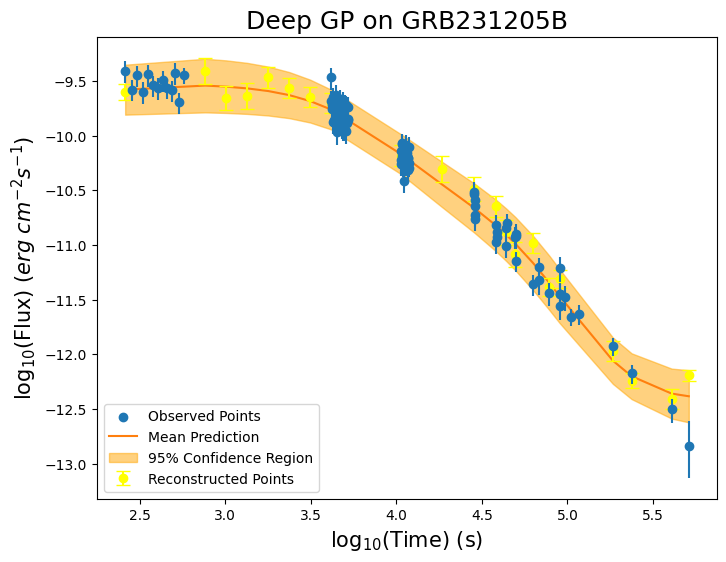


-----TRAINING FOR GRB240101A-----


-----ORIGINAL GRB-----



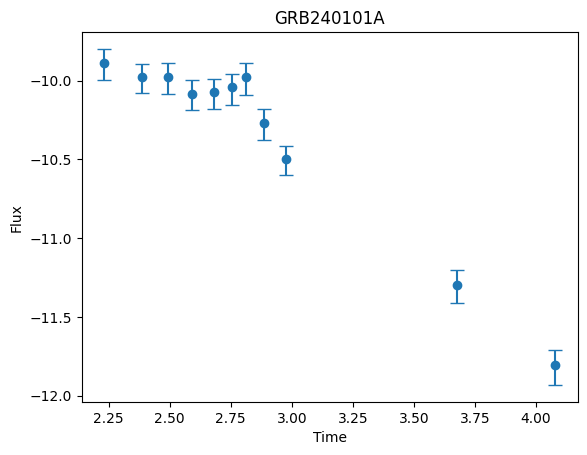


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 55.5025
Iteration 40/500 - Loss: 35.6532
Iteration 60/500 - Loss: 21.6353
Iteration 80/500 - Loss: 12.0464
Iteration 100/500 - Loss: 6.7345
Iteration 120/500 - Loss: 4.0207
Iteration 140/500 - Loss: 2.5498
Iteration 160/500 - Loss: 1.7367
Iteration 180/500 - Loss: 1.2721
Iteration 200/500 - Loss: 0.9999
Iteration 220/500 - Loss: 0.9052
Iteration 240/500 - Loss: 0.8341
Iteration 260/500 - Loss: 0.7754
Iteration 280/500 - Loss: 0.7263
Iteration 300/500 - Loss: 0.6849
Iteration 320/500 - Loss: 0.6494
Iteration 340/500 - Loss: 0.6187
Iteration 360/500 - Loss: 0.5916
Iteration 380/500 - Loss: 0.5673
Iteration 400/500 - Loss: 0.5451
Iteration 420/500 - Loss: 0.5340
Iteration 440/500 - Loss: 0.5236
Iteration 460/500 - Loss: 0.5132
Iteration 480/500 - Loss: 0.5027
Iteration 500/500 - Loss: 0.4921

-----RECONSTRUCTED GRB-----



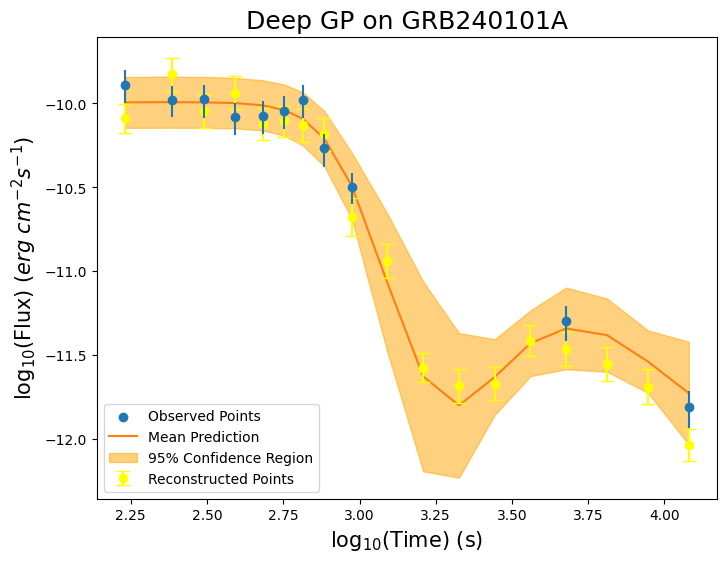


-----TRAINING FOR GRB240112C-----


-----ORIGINAL GRB-----



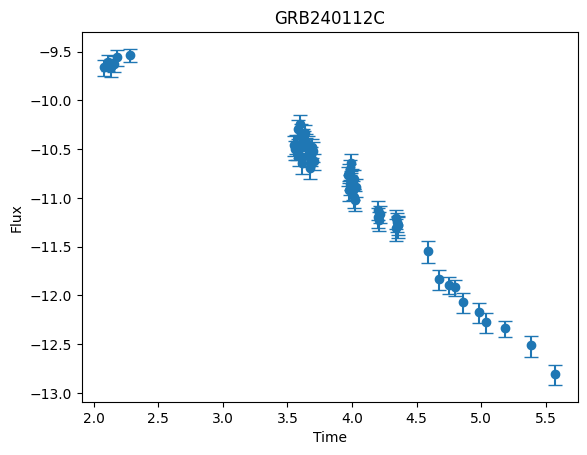


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.0549
Iteration 40/500 - Loss: 38.4165
Iteration 60/500 - Loss: 26.7275
Iteration 80/500 - Loss: 16.1288
Iteration 100/500 - Loss: 8.6799
Iteration 120/500 - Loss: 3.5043
Iteration 140/500 - Loss: 1.6126
Iteration 160/500 - Loss: 0.6954
Iteration 180/500 - Loss: 0.2864
Iteration 200/500 - Loss: 0.0705
Iteration 220/500 - Loss: -0.0032
Iteration 240/500 - Loss: -0.0588
Iteration 260/500 - Loss: -0.1049
Iteration 280/500 - Loss: -0.1433
Iteration 300/500 - Loss: -0.1749
Iteration 320/500 - Loss: -0.2011
Iteration 340/500 - Loss: -0.2227
Iteration 360/500 - Loss: -0.2407
Iteration 380/500 - Loss: -0.2557
Iteration 400/500 - Loss: -0.2683
Iteration 420/500 - Loss: -0.2742
Iteration 440/500 - Loss: -0.2793
Iteration 460/500 - Loss: -0.2841
Iteration 480/500 - Loss: -0.2887
Iteration 500/500 - Loss: -0.2930

-----RECONSTRUCTED GRB-----



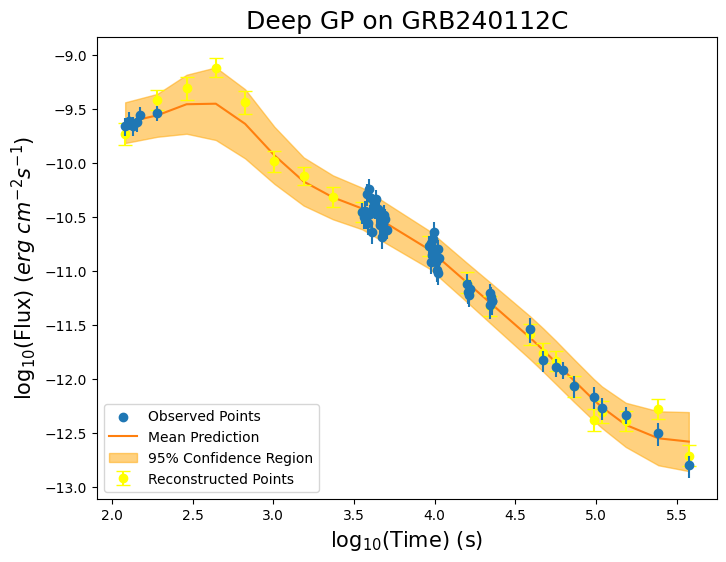


-----TRAINING FOR GRB240123A-----


-----ORIGINAL GRB-----



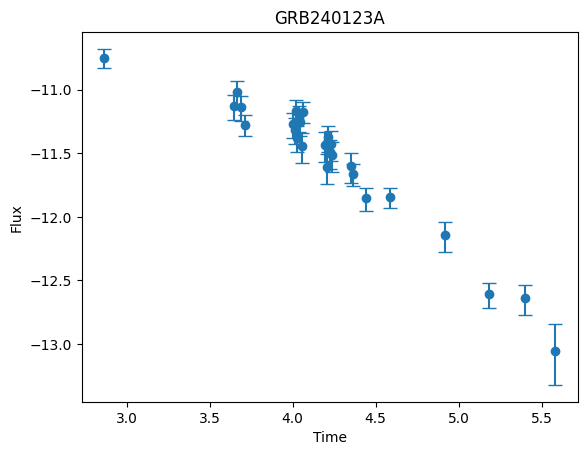


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 49.7855
Iteration 40/500 - Loss: 30.7494
Iteration 60/500 - Loss: 16.1095
Iteration 80/500 - Loss: 8.5118
Iteration 100/500 - Loss: 4.9872
Iteration 120/500 - Loss: 3.0461
Iteration 140/500 - Loss: 1.9577
Iteration 160/500 - Loss: 1.3645
Iteration 180/500 - Loss: 1.0083
Iteration 200/500 - Loss: 0.7890
Iteration 220/500 - Loss: 0.7213
Iteration 240/500 - Loss: 0.6741
Iteration 260/500 - Loss: 0.6369
Iteration 280/500 - Loss: 0.6067
Iteration 300/500 - Loss: 0.5818
Iteration 320/500 - Loss: 0.5606
Iteration 340/500 - Loss: 0.5420
Iteration 360/500 - Loss: 0.5249
Iteration 380/500 - Loss: 0.5087
Iteration 400/500 - Loss: 0.4926
Iteration 420/500 - Loss: 0.4840
Iteration 440/500 - Loss: 0.4756
Iteration 460/500 - Loss: 0.4669
Iteration 480/500 - Loss: 0.4581
Iteration 500/500 - Loss: 0.4491

-----RECONSTRUCTED GRB-----



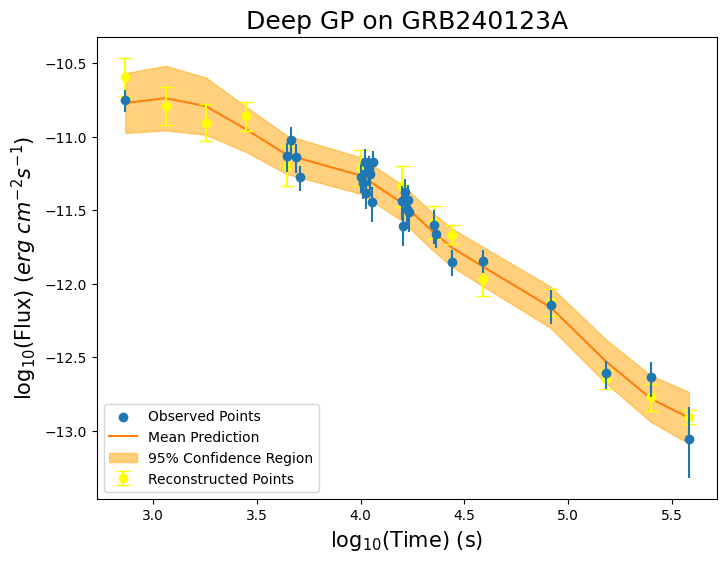


-----TRAINING FOR GRB240204A-----


-----ORIGINAL GRB-----



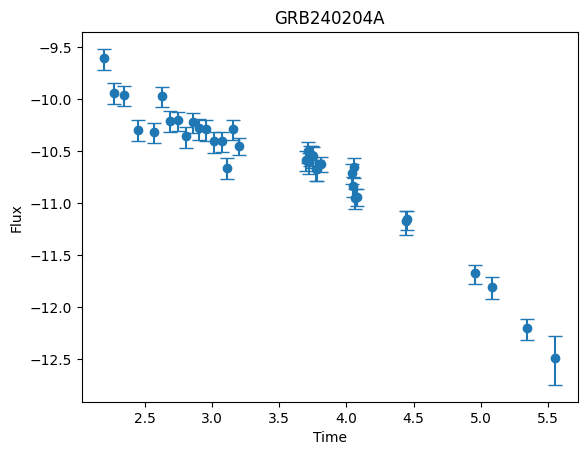


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.0989
Iteration 40/500 - Loss: 35.8598
Iteration 60/500 - Loss: 21.1616
Iteration 80/500 - Loss: 12.4624
Iteration 100/500 - Loss: 7.7260
Iteration 120/500 - Loss: 5.0668
Iteration 140/500 - Loss: 3.5230
Iteration 160/500 - Loss: 2.5763
Iteration 180/500 - Loss: 1.9662
Iteration 200/500 - Loss: 1.5612
Iteration 220/500 - Loss: 1.4019
Iteration 240/500 - Loss: 1.2765
Iteration 260/500 - Loss: 1.1684
Iteration 280/500 - Loss: 1.0745
Iteration 300/500 - Loss: 0.9923
Iteration 320/500 - Loss: 0.9201
Iteration 340/500 - Loss: 0.8561
Iteration 360/500 - Loss: 0.8007
Iteration 380/500 - Loss: 0.7479
Iteration 400/500 - Loss: 0.6998
Iteration 420/500 - Loss: 0.6765
Iteration 440/500 - Loss: 0.6550
Iteration 460/500 - Loss: 0.6343
Iteration 480/500 - Loss: 0.6143
Iteration 500/500 - Loss: 0.5950

-----RECONSTRUCTED GRB-----



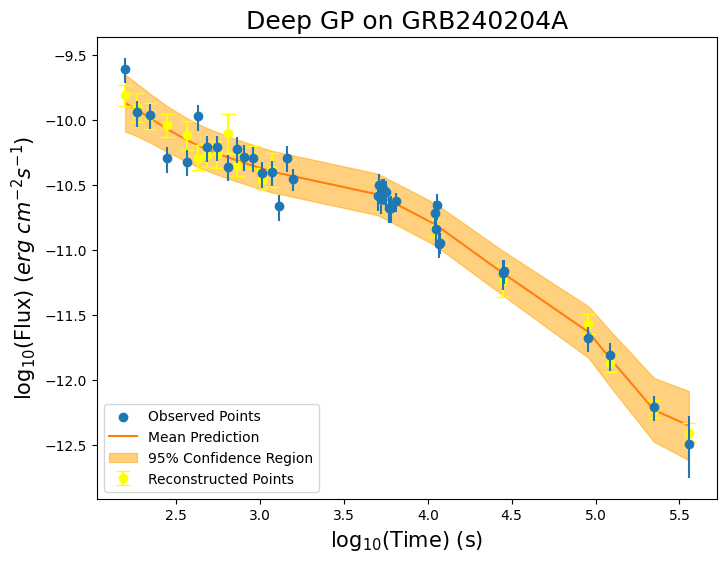


-----TRAINING FOR GRB191011A-----


-----ORIGINAL GRB-----



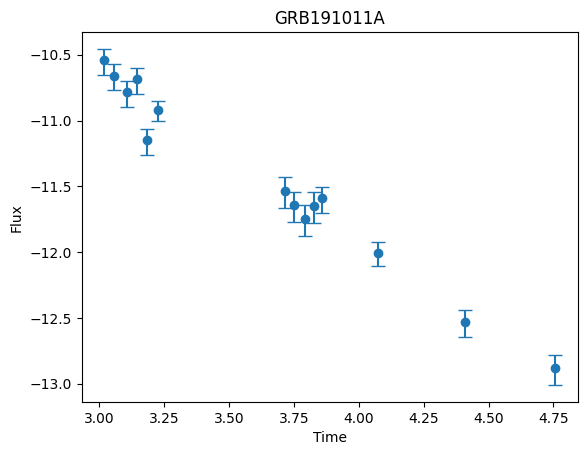


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 54.3736
Iteration 40/500 - Loss: 37.0272
Iteration 60/500 - Loss: 24.8514
Iteration 80/500 - Loss: 14.6830
Iteration 100/500 - Loss: 8.4627
Iteration 120/500 - Loss: 5.0957
Iteration 140/500 - Loss: 3.3062
Iteration 160/500 - Loss: 2.3108
Iteration 180/500 - Loss: 1.7046
Iteration 200/500 - Loss: 1.3018
Iteration 220/500 - Loss: 1.1421
Iteration 240/500 - Loss: 1.0134
Iteration 260/500 - Loss: 0.9031
Iteration 280/500 - Loss: 0.8095
Iteration 300/500 - Loss: 0.7312
Iteration 320/500 - Loss: 0.6664
Iteration 340/500 - Loss: 0.6137
Iteration 360/500 - Loss: 0.5712
Iteration 380/500 - Loss: 0.5372
Iteration 400/500 - Loss: 0.5100
Iteration 420/500 - Loss: 0.4980
Iteration 440/500 - Loss: 0.4878
Iteration 460/500 - Loss: 0.4783
Iteration 480/500 - Loss: 0.4697
Iteration 500/500 - Loss: 0.4617

-----RECONSTRUCTED GRB-----



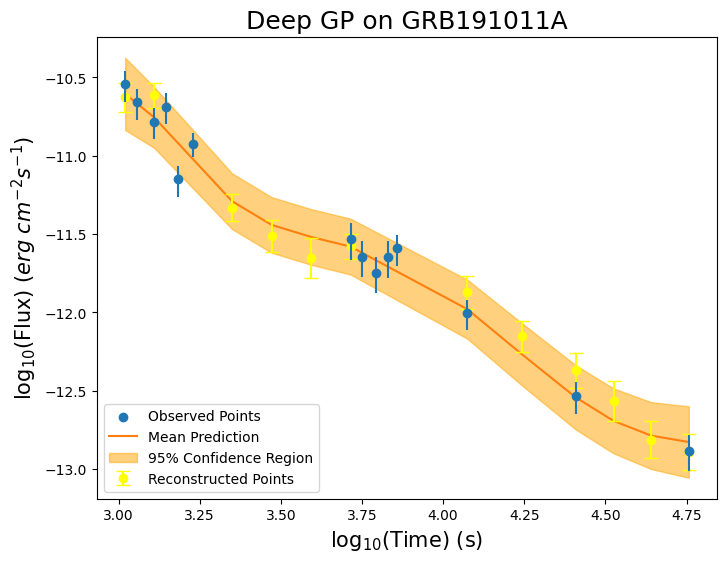


-----TRAINING FOR GRB200205B-----


-----ORIGINAL GRB-----



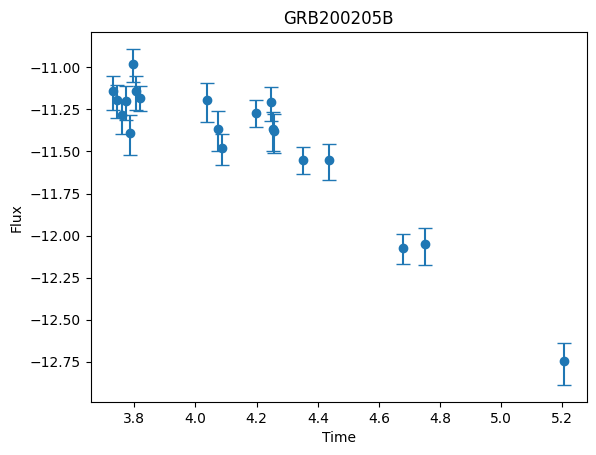


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.6823
Iteration 40/500 - Loss: 37.5669
Iteration 60/500 - Loss: 25.5528
Iteration 80/500 - Loss: 16.1515
Iteration 100/500 - Loss: 10.4136
Iteration 120/500 - Loss: 7.5081
Iteration 140/500 - Loss: 5.7584
Iteration 160/500 - Loss: 4.4574
Iteration 180/500 - Loss: 3.5327
Iteration 200/500 - Loss: 2.8874
Iteration 220/500 - Loss: 2.6378
Iteration 240/500 - Loss: 2.4439
Iteration 260/500 - Loss: 2.2804
Iteration 280/500 - Loss: 2.1429
Iteration 300/500 - Loss: 2.0277
Iteration 320/500 - Loss: 1.9316
Iteration 340/500 - Loss: 1.8517
Iteration 360/500 - Loss: 1.7849
Iteration 380/500 - Loss: 1.7291
Iteration 400/500 - Loss: 1.6820
Iteration 420/500 - Loss: 1.6604
Iteration 440/500 - Loss: 1.6413
Iteration 460/500 - Loss: 1.6234
Iteration 480/500 - Loss: 1.6065
Iteration 500/500 - Loss: 1.5906

-----RECONSTRUCTED GRB-----



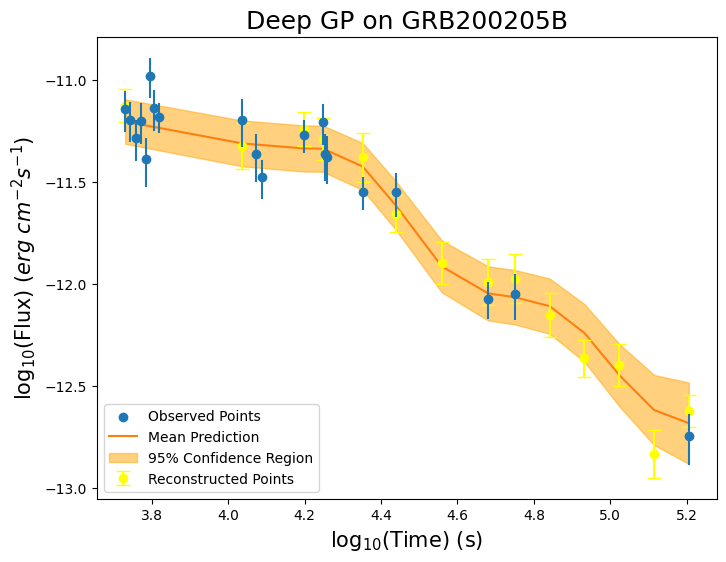


-----TRAINING FOR GRB201020A-----


-----ORIGINAL GRB-----



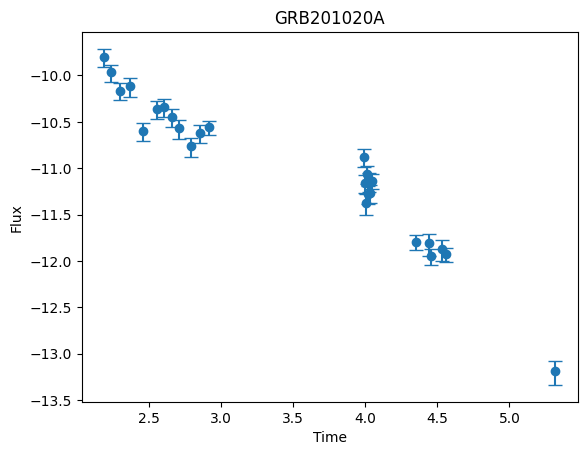


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.8090
Iteration 40/500 - Loss: 32.0859
Iteration 60/500 - Loss: 17.1268
Iteration 80/500 - Loss: 10.2478
Iteration 100/500 - Loss: 7.3996
Iteration 120/500 - Loss: 5.8082
Iteration 140/500 - Loss: 4.5477
Iteration 160/500 - Loss: 3.4832
Iteration 180/500 - Loss: 2.6392
Iteration 200/500 - Loss: 2.0013
Iteration 220/500 - Loss: 1.7405
Iteration 240/500 - Loss: 1.5297
Iteration 260/500 - Loss: 1.3488
Iteration 280/500 - Loss: 1.1942
Iteration 300/500 - Loss: 1.0632
Iteration 320/500 - Loss: 0.9523
Iteration 340/500 - Loss: 0.8580
Iteration 360/500 - Loss: 0.7779
Iteration 380/500 - Loss: 0.7098
Iteration 400/500 - Loss: 0.6520
Iteration 420/500 - Loss: 0.6248
Iteration 440/500 - Loss: 0.6006
Iteration 460/500 - Loss: 0.5782
Iteration 480/500 - Loss: 0.5570
Iteration 500/500 - Loss: 0.5370

-----RECONSTRUCTED GRB-----



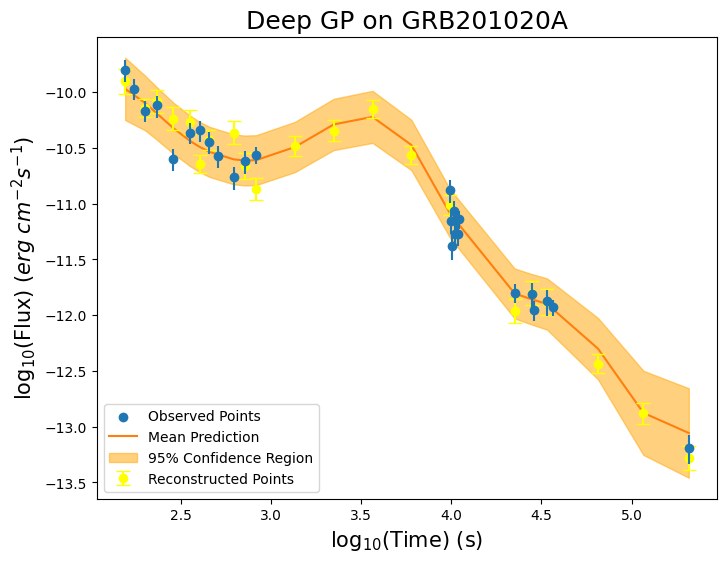


-----TRAINING FOR GRB201221A-----


-----ORIGINAL GRB-----



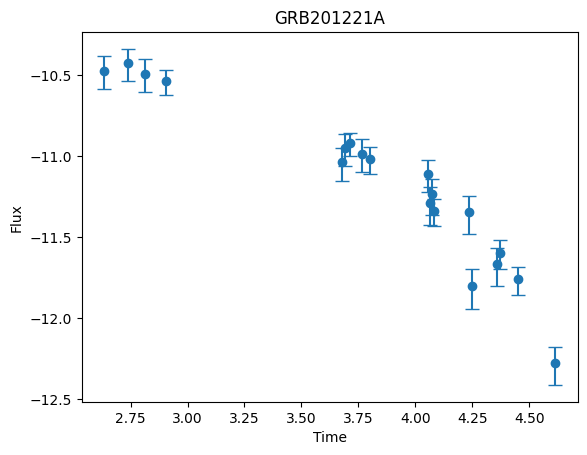


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 58.7605
Iteration 40/500 - Loss: 36.9728
Iteration 60/500 - Loss: 22.2461
Iteration 80/500 - Loss: 13.1698
Iteration 100/500 - Loss: 7.3564
Iteration 120/500 - Loss: 4.3953
Iteration 140/500 - Loss: 2.9147
Iteration 160/500 - Loss: 2.1008
Iteration 180/500 - Loss: 1.6690
Iteration 200/500 - Loss: 1.4033
Iteration 220/500 - Loss: 1.2852
Iteration 240/500 - Loss: 1.1833
Iteration 260/500 - Loss: 1.0849
Iteration 280/500 - Loss: 0.9854
Iteration 300/500 - Loss: 0.8887
Iteration 320/500 - Loss: 0.8122
Iteration 340/500 - Loss: 0.7713
Iteration 360/500 - Loss: 0.7496
Iteration 380/500 - Loss: 0.7345
Iteration 400/500 - Loss: 0.7224
Iteration 420/500 - Loss: 0.7168
Iteration 440/500 - Loss: 0.7118
Iteration 460/500 - Loss: 0.7071
Iteration 480/500 - Loss: 0.7025
Iteration 500/500 - Loss: 0.6980

-----RECONSTRUCTED GRB-----



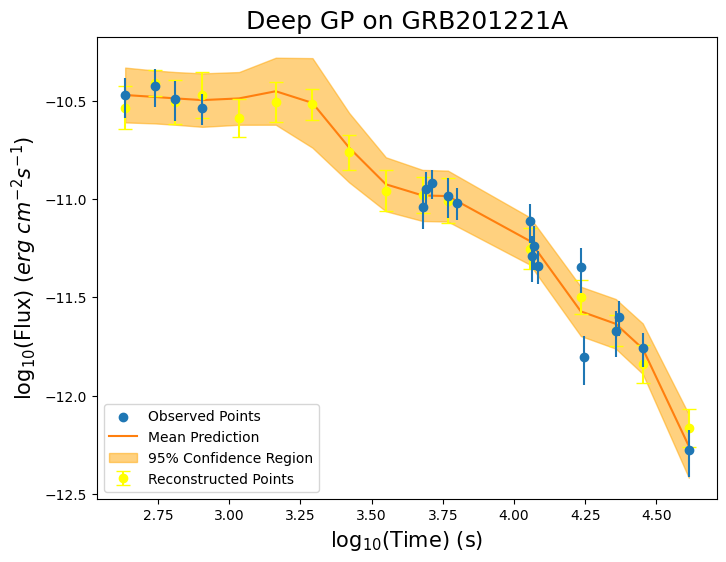


-----TRAINING FOR GRB210210A-----


-----ORIGINAL GRB-----



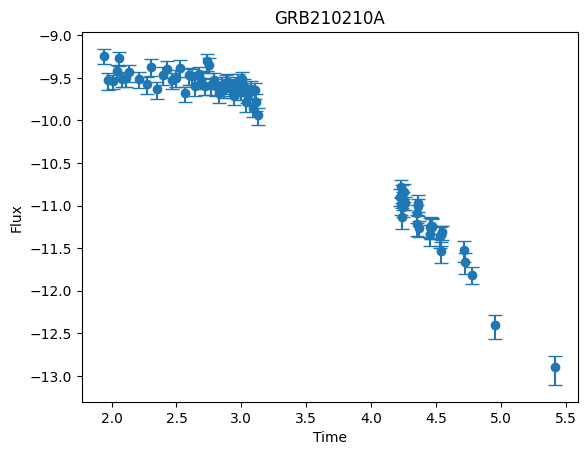


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 44.9505
Iteration 40/500 - Loss: 30.9708
Iteration 60/500 - Loss: 13.2900
Iteration 80/500 - Loss: 5.3458
Iteration 100/500 - Loss: 2.6845
Iteration 120/500 - Loss: 1.7771
Iteration 140/500 - Loss: 1.4244
Iteration 160/500 - Loss: 1.1096
Iteration 180/500 - Loss: 0.8399
Iteration 200/500 - Loss: 0.5987
Iteration 220/500 - Loss: 0.4561
Iteration 240/500 - Loss: 0.3308
Iteration 260/500 - Loss: 0.2114
Iteration 280/500 - Loss: 0.1035
Iteration 300/500 - Loss: 0.0108
Iteration 320/500 - Loss: -0.0672
Iteration 340/500 - Loss: -0.1333
Iteration 360/500 - Loss: -0.1902
Iteration 380/500 - Loss: -0.2395
Iteration 400/500 - Loss: -0.2812
Iteration 420/500 - Loss: -0.3023
Iteration 440/500 - Loss: -0.3204
Iteration 460/500 - Loss: -0.3376
Iteration 480/500 - Loss: -0.3536
Iteration 500/500 - Loss: -0.3688

-----RECONSTRUCTED GRB-----



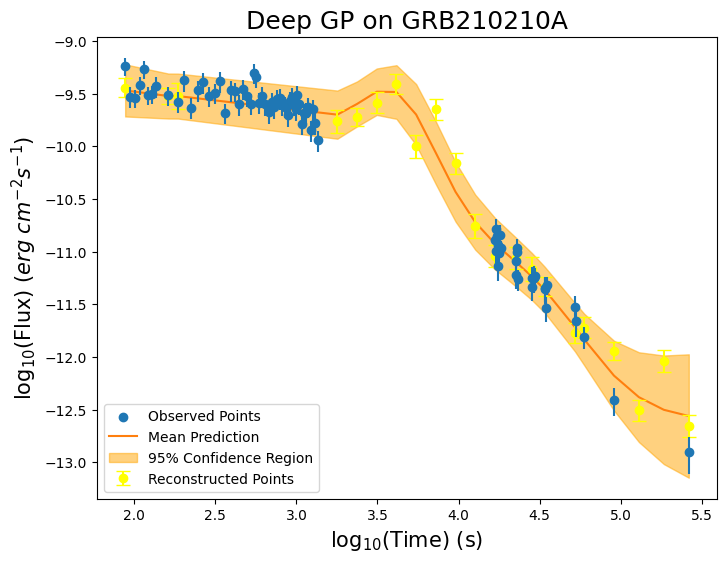


-----TRAINING FOR GRB210222B-----


-----ORIGINAL GRB-----



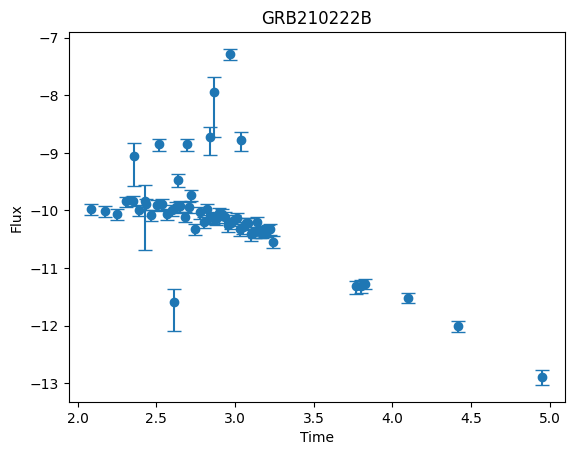


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 56.5964
Iteration 40/500 - Loss: 43.0008
Iteration 60/500 - Loss: 35.1676
Iteration 80/500 - Loss: 27.8686
Iteration 100/500 - Loss: 22.8863
Iteration 120/500 - Loss: 20.0339
Iteration 140/500 - Loss: 18.2002
Iteration 160/500 - Loss: 16.9623
Iteration 180/500 - Loss: 16.1120
Iteration 200/500 - Loss: 15.4300
Iteration 220/500 - Loss: 15.1116
Iteration 240/500 - Loss: 14.8271
Iteration 260/500 - Loss: 14.5574
Iteration 280/500 - Loss: 14.2998
Iteration 300/500 - Loss: 14.0517
Iteration 320/500 - Loss: 13.8118
Iteration 340/500 - Loss: 13.5790
Iteration 360/500 - Loss: 13.3540
Iteration 380/500 - Loss: 13.1360
Iteration 400/500 - Loss: 12.9246
Iteration 420/500 - Loss: 12.8160
Iteration 440/500 - Loss: 12.7131
Iteration 460/500 - Loss: 12.6108
Iteration 480/500 - Loss: 12.5090
Iteration 500/500 - Loss: 12.4078

-----RECONSTRUCTED GRB-----



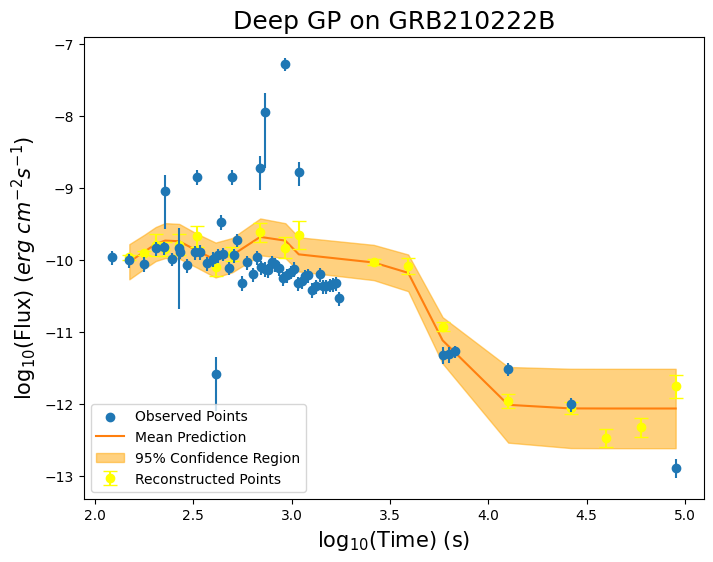


-----TRAINING FOR GRB210722A-----


-----ORIGINAL GRB-----



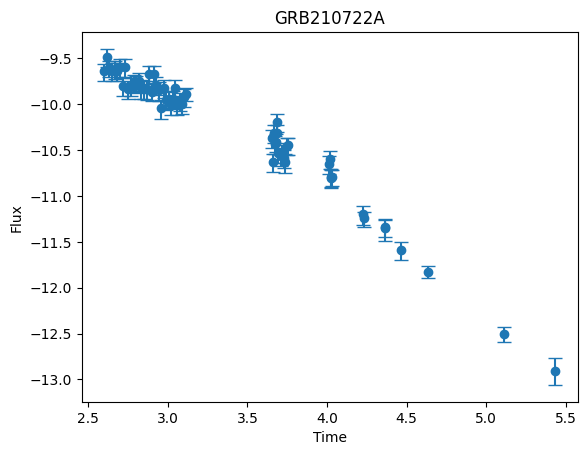


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 46.8351
Iteration 40/500 - Loss: 37.9304
Iteration 60/500 - Loss: 24.5053
Iteration 80/500 - Loss: 12.6603
Iteration 100/500 - Loss: 6.7650
Iteration 120/500 - Loss: 4.0010
Iteration 140/500 - Loss: 2.8328
Iteration 160/500 - Loss: 1.9446
Iteration 180/500 - Loss: 1.2445
Iteration 200/500 - Loss: 0.8200
Iteration 220/500 - Loss: 0.6304
Iteration 240/500 - Loss: 0.4701
Iteration 260/500 - Loss: 0.3321
Iteration 280/500 - Loss: 0.2179
Iteration 300/500 - Loss: 0.1249
Iteration 320/500 - Loss: 0.0518
Iteration 340/500 - Loss: -0.0037
Iteration 360/500 - Loss: -0.0465
Iteration 380/500 - Loss: -0.0794
Iteration 400/500 - Loss: -0.1046
Iteration 420/500 - Loss: -0.1160
Iteration 440/500 - Loss: -0.1256
Iteration 460/500 - Loss: -0.1344
Iteration 480/500 - Loss: -0.1425
Iteration 500/500 - Loss: -0.1501

-----RECONSTRUCTED GRB-----



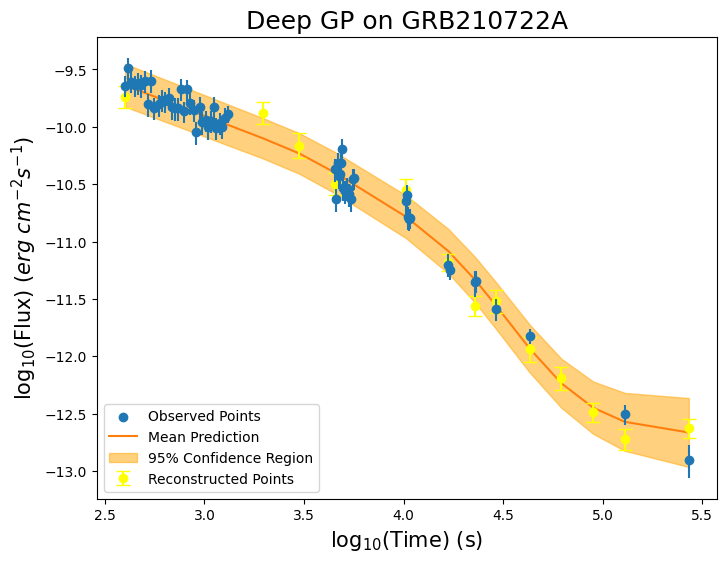


-----TRAINING FOR GRB210731A-----


-----ORIGINAL GRB-----



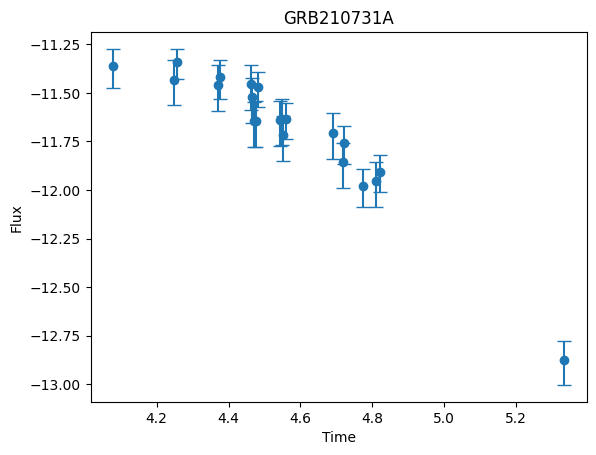


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.3774
Iteration 40/500 - Loss: 36.8570
Iteration 60/500 - Loss: 25.2271
Iteration 80/500 - Loss: 16.2763
Iteration 100/500 - Loss: 10.0756
Iteration 120/500 - Loss: 5.7928
Iteration 140/500 - Loss: 3.2386
Iteration 160/500 - Loss: 1.9577
Iteration 180/500 - Loss: 1.3988
Iteration 200/500 - Loss: 1.1750
Iteration 220/500 - Loss: 1.1153
Iteration 240/500 - Loss: 1.0736
Iteration 260/500 - Loss: 1.0393
Iteration 280/500 - Loss: 1.0102
Iteration 300/500 - Loss: 0.9848
Iteration 320/500 - Loss: 0.9622
Iteration 340/500 - Loss: 0.9418
Iteration 360/500 - Loss: 0.9231
Iteration 380/500 - Loss: 0.9058
Iteration 400/500 - Loss: 0.8896
Iteration 420/500 - Loss: 0.8815
Iteration 440/500 - Loss: 0.8739
Iteration 460/500 - Loss: 0.8662
Iteration 480/500 - Loss: 0.8586
Iteration 500/500 - Loss: 0.8511

-----RECONSTRUCTED GRB-----



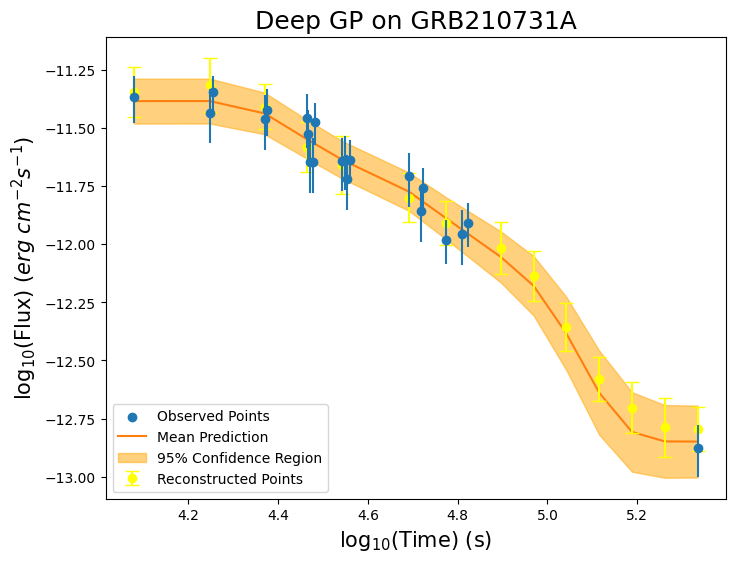


-----TRAINING FOR GRB220611A-----


-----ORIGINAL GRB-----



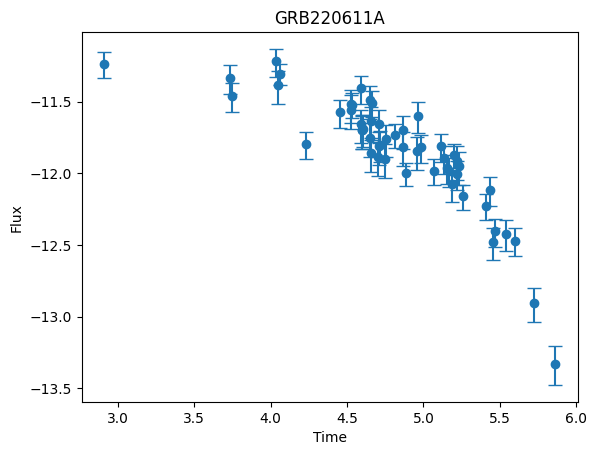


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 50.2786
Iteration 40/500 - Loss: 41.8957
Iteration 60/500 - Loss: 30.9451
Iteration 80/500 - Loss: 18.0706
Iteration 100/500 - Loss: 10.7892
Iteration 120/500 - Loss: 7.2588
Iteration 140/500 - Loss: 5.3404
Iteration 160/500 - Loss: 4.2730
Iteration 180/500 - Loss: 3.6413
Iteration 200/500 - Loss: 3.2353
Iteration 220/500 - Loss: 3.0803
Iteration 240/500 - Loss: 2.9572
Iteration 260/500 - Loss: 2.8514
Iteration 280/500 - Loss: 2.7598
Iteration 300/500 - Loss: 2.6805
Iteration 320/500 - Loss: 2.6115
Iteration 340/500 - Loss: 2.5513
Iteration 360/500 - Loss: 2.4984
Iteration 380/500 - Loss: 2.4518
Iteration 400/500 - Loss: 2.4104
Iteration 420/500 - Loss: 2.3906
Iteration 440/500 - Loss: 2.3725
Iteration 460/500 - Loss: 2.3551
Iteration 480/500 - Loss: 2.3384
Iteration 500/500 - Loss: 2.3223

-----RECONSTRUCTED GRB-----



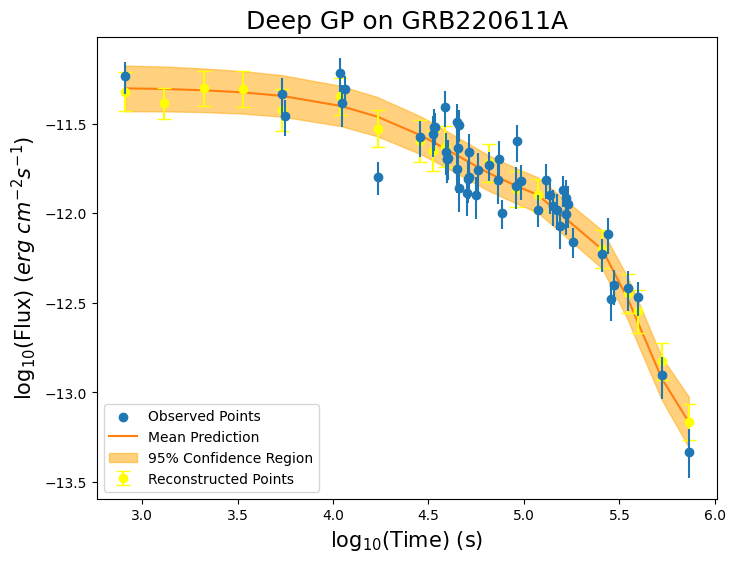


-----TRAINING FOR GRB230116D-----


-----ORIGINAL GRB-----



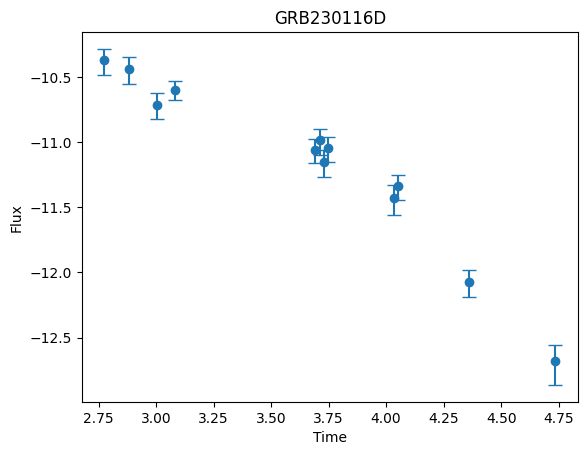


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 59.0278
Iteration 40/500 - Loss: 42.0675
Iteration 60/500 - Loss: 30.4369
Iteration 80/500 - Loss: 19.2608
Iteration 100/500 - Loss: 12.7873
Iteration 120/500 - Loss: 9.0985
Iteration 140/500 - Loss: 6.5799
Iteration 160/500 - Loss: 4.9660
Iteration 180/500 - Loss: 3.9953
Iteration 200/500 - Loss: 3.2528
Iteration 220/500 - Loss: 2.9074
Iteration 240/500 - Loss: 2.6190
Iteration 260/500 - Loss: 2.3644
Iteration 280/500 - Loss: 2.1398
Iteration 300/500 - Loss: 1.9410
Iteration 320/500 - Loss: 1.7654
Iteration 340/500 - Loss: 1.6117
Iteration 360/500 - Loss: 1.4777
Iteration 380/500 - Loss: 1.3639
Iteration 400/500 - Loss: 1.2586
Iteration 420/500 - Loss: 1.2091
Iteration 440/500 - Loss: 1.1652
Iteration 460/500 - Loss: 1.1232
Iteration 480/500 - Loss: 1.0833
Iteration 500/500 - Loss: 1.0456

-----RECONSTRUCTED GRB-----



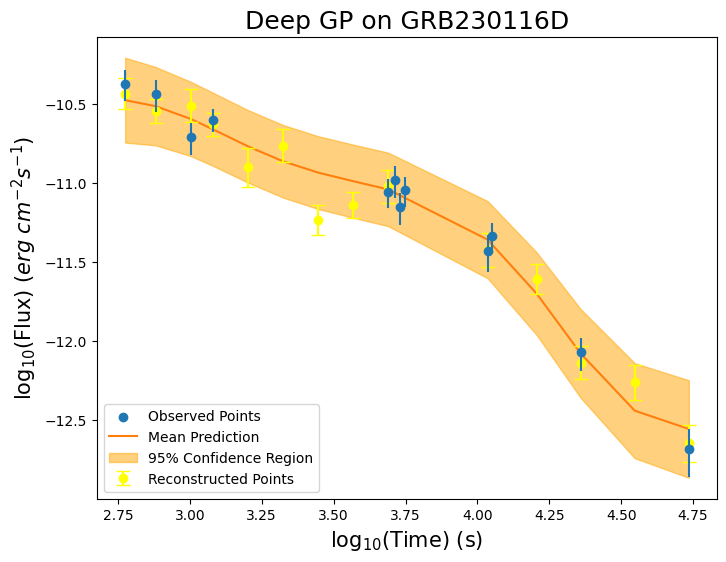


-----TRAINING FOR GRB230328B-----


-----ORIGINAL GRB-----



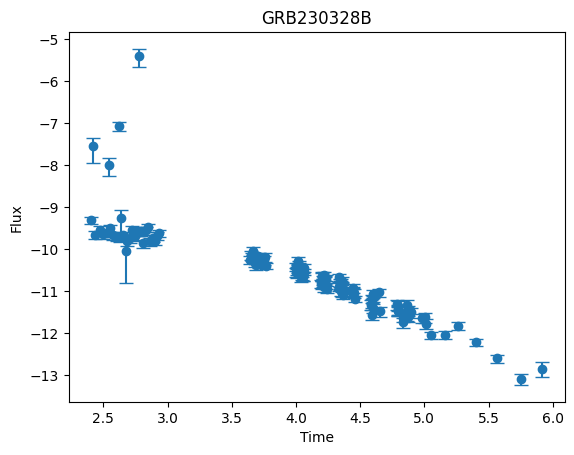


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 59.8307
Iteration 40/500 - Loss: 45.3402
Iteration 60/500 - Loss: 37.2709
Iteration 80/500 - Loss: 23.5836
Iteration 100/500 - Loss: 13.5833
Iteration 120/500 - Loss: 9.9189
Iteration 140/500 - Loss: 8.7272
Iteration 160/500 - Loss: 8.1295
Iteration 180/500 - Loss: 7.7377
Iteration 200/500 - Loss: 7.4214
Iteration 220/500 - Loss: 7.2568
Iteration 240/500 - Loss: 7.1058
Iteration 260/500 - Loss: 6.9663
Iteration 280/500 - Loss: 6.8405
Iteration 300/500 - Loss: 6.7289
Iteration 320/500 - Loss: 6.6297
Iteration 340/500 - Loss: 6.5401
Iteration 360/500 - Loss: 6.4577
Iteration 380/500 - Loss: 6.3801
Iteration 400/500 - Loss: 6.3062
Iteration 420/500 - Loss: 6.2684
Iteration 440/500 - Loss: 6.2326
Iteration 460/500 - Loss: 6.1968
Iteration 480/500 - Loss: 6.1610
Iteration 500/500 - Loss: 6.1252

-----RECONSTRUCTED GRB-----



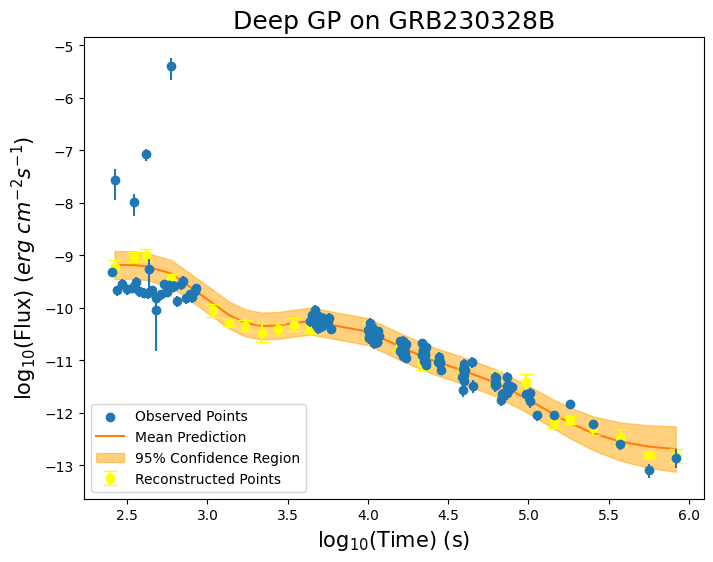


-----TRAINING FOR GRB230506C-----


-----ORIGINAL GRB-----



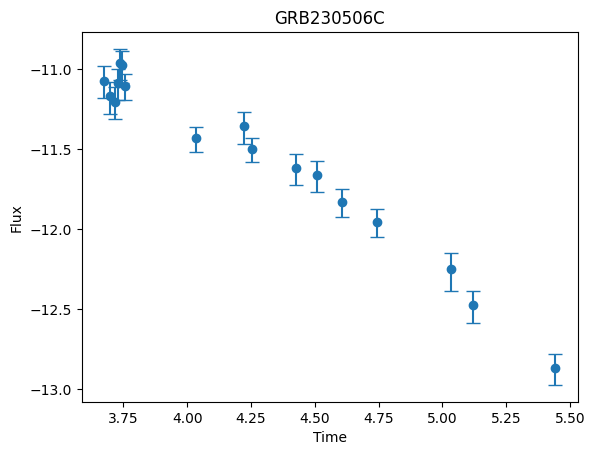


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 53.1080
Iteration 40/500 - Loss: 34.4343
Iteration 60/500 - Loss: 19.1948
Iteration 80/500 - Loss: 10.9018
Iteration 100/500 - Loss: 6.5245
Iteration 120/500 - Loss: 3.6291
Iteration 140/500 - Loss: 2.1441
Iteration 160/500 - Loss: 1.3922
Iteration 180/500 - Loss: 1.0275
Iteration 200/500 - Loss: 0.8089
Iteration 220/500 - Loss: 0.6896
Iteration 240/500 - Loss: 0.6206
Iteration 260/500 - Loss: 0.5617
Iteration 280/500 - Loss: 0.5106
Iteration 300/500 - Loss: 0.4660
Iteration 320/500 - Loss: 0.4275
Iteration 340/500 - Loss: 0.3944
Iteration 360/500 - Loss: 0.3658
Iteration 380/500 - Loss: 0.3409
Iteration 400/500 - Loss: 0.3205
Iteration 420/500 - Loss: 0.3116
Iteration 440/500 - Loss: 0.3040
Iteration 460/500 - Loss: 0.2971
Iteration 480/500 - Loss: 0.2907
Iteration 500/500 - Loss: 0.2848

-----RECONSTRUCTED GRB-----



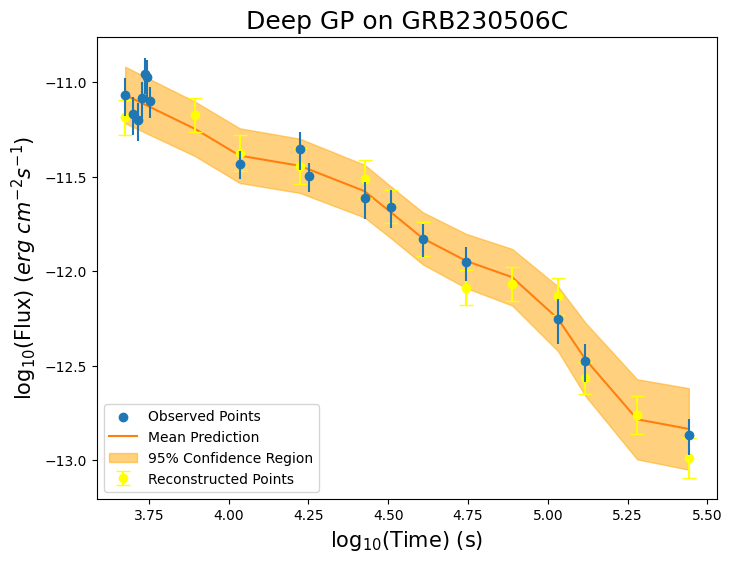


-----TRAINING FOR GRB230818A-----


-----ORIGINAL GRB-----



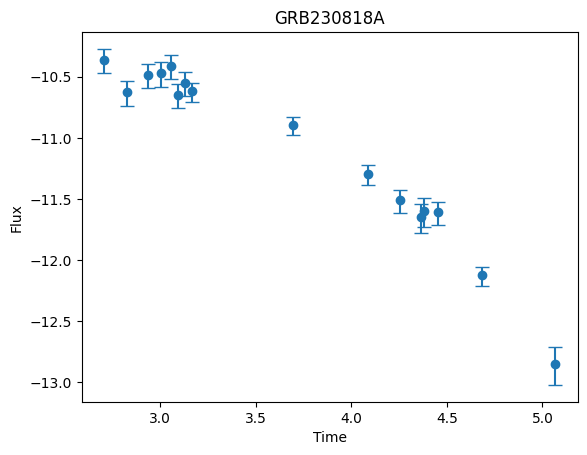


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 52.6158
Iteration 40/500 - Loss: 35.4572
Iteration 60/500 - Loss: 22.3358
Iteration 80/500 - Loss: 11.9983
Iteration 100/500 - Loss: 6.8695
Iteration 120/500 - Loss: 4.3395
Iteration 140/500 - Loss: 2.8622
Iteration 160/500 - Loss: 1.9261
Iteration 180/500 - Loss: 1.3457
Iteration 200/500 - Loss: 0.9742
Iteration 220/500 - Loss: 0.8358
Iteration 240/500 - Loss: 0.7291
Iteration 260/500 - Loss: 0.6383
Iteration 280/500 - Loss: 0.5609
Iteration 300/500 - Loss: 0.4952
Iteration 320/500 - Loss: 0.4396
Iteration 340/500 - Loss: 0.3923
Iteration 360/500 - Loss: 0.3506
Iteration 380/500 - Loss: 0.3145
Iteration 400/500 - Loss: 0.2826
Iteration 420/500 - Loss: 0.2650
Iteration 440/500 - Loss: 0.2501
Iteration 460/500 - Loss: 0.2355
Iteration 480/500 - Loss: 0.2215
Iteration 500/500 - Loss: 0.2082

-----RECONSTRUCTED GRB-----



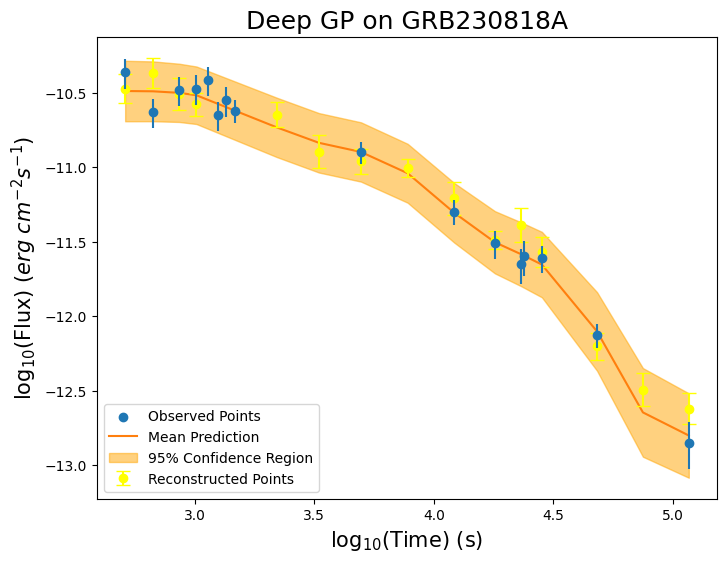


-----TRAINING FOR GRB190821A-----


-----ORIGINAL GRB-----



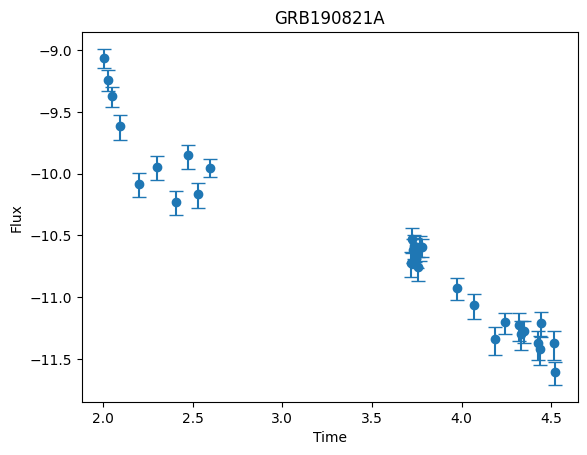


-----TRAINING DEEP GP-----

Iteration 20/500 - Loss: 48.8171
Iteration 40/500 - Loss: 33.8747
Iteration 60/500 - Loss: 18.2770
Iteration 80/500 - Loss: 8.7851
Iteration 100/500 - Loss: 4.8923
Iteration 120/500 - Loss: 3.1932
Iteration 140/500 - Loss: 2.3200
Iteration 160/500 - Loss: 1.6220
Iteration 180/500 - Loss: 1.2404
Iteration 200/500 - Loss: 1.0537
Iteration 220/500 - Loss: 0.9102
Iteration 240/500 - Loss: 0.7859
Iteration 260/500 - Loss: 0.7186
Iteration 280/500 - Loss: 0.6623
Iteration 300/500 - Loss: 0.6074
Iteration 320/500 - Loss: 0.5719
Iteration 340/500 - Loss: 0.5277
Iteration 360/500 - Loss: 0.4934
Iteration 380/500 - Loss: 0.4643
Iteration 400/500 - Loss: 0.4321
Iteration 420/500 - Loss: 0.4166
Iteration 440/500 - Loss: 0.4041
Iteration 460/500 - Loss: 0.3918
Iteration 480/500 - Loss: 0.3803
Iteration 500/500 - Loss: 0.3712

-----RECONSTRUCTED GRB-----



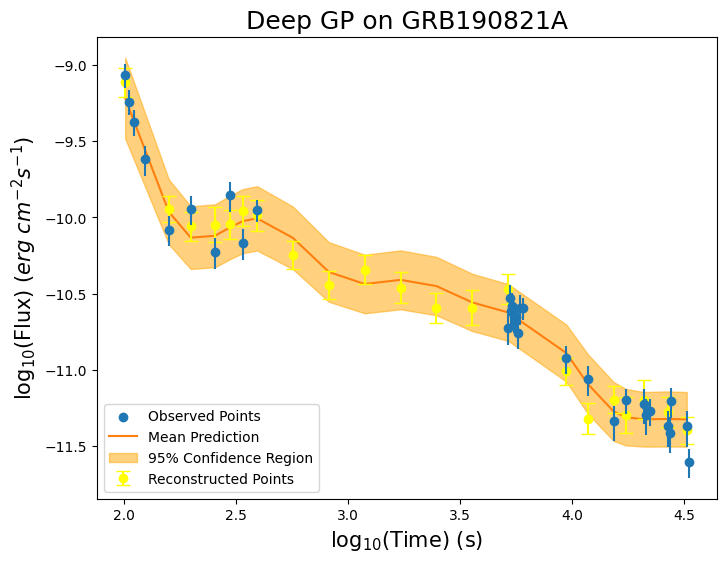

In [ ]:
GRBs=["GRB070306", "GRB070521", "GRB070529", "GRB070714B", "GRB070802",
    "GRB070809", "GRB070810A", "GRB080310", "GRB080319B", "GRB080319C",
    "GRB080411", "GRB080430", "GRB080516", "GRB080607", "GRB080710",
    "GRB080721", "GRB080810", "GRB080905B", "GRB080928", "GRB081007",
    "GRB081008", "GRB081028A", "GRB081029", "GRB081221", "GRB081230",
    "GRB090102", "GRB090205", "GRB090418A", "GRB090424", "GRB090510",
    "GRB090516", "GRB090529", "GRB090530", "GRB090618", "GRB090809",
    "GRB090927", "GRB091018", "GRB091020", "GRB091029", "GRB091109A",
    "GRB091127", "GRB091208B", "GRB100219A", "GRB100316B", "GRB100418A",
    "GRB100425A", "GRB100513A", "GRB100621A", "GRB100625A", "GRB100704A",
    "GRB100724A", "GRB100728A", "GRB100814A", "GRB100816A", "GRB100901A",
    "GRB100906A", "GRB101219B", "GRB110106B", "GRB110213A", "GRB110422A",
    "GRB110503A", "GRB110715A", "GRB110731A", "GRB110818A", "GRB111008A",
    "GRB111123A", "GRB111228A", "GRB120118B", "GRB120327A", "GRB120404A",
    "GRB120422A", "GRB120729A", "GRB120802A", "GRB120811C", "GRB120907A",
    "GRB120922A", "GRB121024A", "GRB121027A", "GRB121128A", "GRB121211A",
    "GRB130408A", "GRB130418A", "GRB130420A", "GRB130511A", "GRB130514A",
    "GRB130603B", "GRB130606A", "GRB130831A", "GRB130925A", "GRB131004A",
    "GRB131105A", "GRB131117A", "GRB140206A", "GRB140419A", "GRB140423A",
    "GRB140430A", "GRB140506A", "GRB140512A", "GRB140518A", "GRB140614A",
    "GRB140629A", "GRB140903A", "GRB141004A", "GRB141121A", "GRB150120B",
    "GRB150910A", "GRB151031A", "GRB151112A", "GRB151215A", "GRB160117B",
    "GRB160121A", "GRB160227A", "GRB160327A", "GRB160804A", "GRB161108A",
    "GRB161117A", "GRB161129A", "GRB161219B", "GRB170202A", "GRB170519A",
    "GRB170531B", "GRB170705A", "GRB170903A", "GRB171205A", "GRB171222A",
    "GRB180205A", "GRB180329B", "GRB180404A", "GRB180620B", "GRB180728A",
    "GRB181010A", "GRB181020A", "GRB181110A", "GRB190106A", "GRB190114A",
    "GRB190627A", "GRB050922C", "GRB060926", "GRB061110A", "GRB061222A",
    "GRB070508", "GRB130505A", "GRB131030A", "GRB150314A", "GRB150403A",
    "GRB150821A", "GRB151021A", "GRB151027A", "GRB180720B", "GRB050904",
    "GRB090423", "GRB090429B", "GRB170405A", "GRB170714A", "GRB180624A",
    "GRB070223", "GRB111209A", "GRB121229A", "GRB050318", "GRB050505",
    "GRB071020", "GRB071117", "GRB050820A", "GRB060912A", "GRB111117A",
    "GRB130604A", "GRB140213A", "GRB160203A", "GRB070721B", "GRB071003",
    "GRB080916A", "GRB081203A", "GRB090519", "GRB090812", "GRB110808A",
    "GRB120804A", "GRB141220A", "GRB060418", "GRB060707", "GRB090426",
    "GRB140509A", "GRB151029A", "GRB190824A", "GRB191004A", "GRB191017B",
    "GRB191029A", "GRB191101A", "GRB191122A", "GRB191123A", "GRB191220A",
    "GRB191228A", "GRB200131A", "GRB200215A", "GRB200219A", "GRB200227A",
    "GRB200303A", "GRB200306A", "GRB200324A", "GRB200409A","GRB200410A", "GRB200512A", "GRB200519A", "GRB200528A", "GRB200711A",
    "GRB200713A", "GRB200716C", "GRB200729A", "GRB200906A", "GRB200925B",
    "GRB201027A", "GRB201128A", "GRB201209A", "GRB201223A", "GRB201229A",
    "GRB210104A", "GRB210104B", "GRB210112A", "GRB210207B", "GRB210217A",
    "GRB210226A", "GRB210308A", "GRB210318B", "GRB210712A", "GRB210725A",
    "GRB210807A", "GRB210912A", "GRB210930A", "GRB211025A", "GRB220325A",
    "GRB220403B", "GRB220408A", "GRB220430A", "GRB220518A", "GRB220706A",
    "GRB220711B", "GRB220714B", "GRB220715B", "GRB220813A", "GRB220826A",
    "GRB221024A", "GRB230123A", "GRB230228A", "GRB230322B", "GRB230405B",
    "GRB230409B", "GRB230420A", "GRB230618A", "GRB230628E", "GRB230815A",
    "GRB230826A", "GRB230903A", "GRB231104A", "GRB231205B", "GRB240101A",
    "GRB240112C", "GRB240123A", "GRB240204A", "GRB191011A", "GRB200205B",
    "GRB201020A", "GRB201221A", "GRB210210A", "GRB210222B", "GRB210722A",
    "GRB210731A", "GRB220611A", "GRB230116D", "GRB230328B", "GRB230506C",
    "GRB230818A", "GRB190821A"
]


for grb_name in GRBs:
  run_model(grb_name)

In [ ]:
# OLD CODE
def run_model(grb_name):
  print(f"\n-----TRAINING FOR {grb_name}-----\n")
  from scipy import stats as st
  from gpytorch.constraints import Interval
  GRB_Name = grb_name
  trimmed_data = pd.read_csv("/content/drive/MyDrive/GRB_Project/GRBs_trimmed/"+ str(GRB_Name) +"_trimmed.csv")

  density_factor = 1
  max_fluxes = np.max(trimmed_data["flux"])
  min_fluxes = np.min(trimmed_data["flux"])

  trim_t_val=trimmed_data["t"] if "t" in trimmed_data else trimmed_data["time_sec"]

  max_ts = np.max(trim_t_val)
  min_ts = np.min(trim_t_val)


  #ABOVE VALUES IN LOG SCALE
  log_max_fluxes = np.log10(max_fluxes)
  log_min_fluxes = np.log10(min_fluxes)

  log_max_ts = np.log10(max_ts)
  log_min_ts = np.log10(min_ts)

  #DEFINING THE ERROR VALUES FROM DATA FILE IN LINEAR SCALE

  #for time
  positive_ts_err = trimmed_data["pos_t_err"] if "pos_t_err" in trimmed_data else trimmed_data["timePos_sec"]
  negative_ts_err = trimmed_data["neg_t_err"] if "neg_t_err" in trimmed_data else trimmed_data["timeNeg_sec"]

  #for flux
  positive_fluxes_err = trimmed_data["pos_flux_err"] if "pos_flux_err" in trimmed_data else trimmed_data["flux_errPos"]
  negative_fluxes_err = trimmed_data["neg_flux_err"] if "neg_flux_err" in trimmed_data else trimmed_data["flux_errNeg"]


  #READING TIME AND FLUXES FROM THE TRIMMED DATA
  #THESE VALUES ARE IN LINEAR SCALE
  ts, fluxes = trim_t_val.to_numpy(), trimmed_data["flux"].to_numpy()

  #ABOVE VALUES IN LOG SCALE
  log_ts, log_fluxes = np.log10(ts), np.log10(fluxes)


  # ERROR ON THE FLUXES
  pos_fluxes= fluxes + positive_fluxes_err
  neg_fluxes= fluxes + negative_fluxes_err

  #SYMMETRIC ERROR VALUE
  fluxes_err_sym= (pos_fluxes - neg_fluxes )/2


  # GENERATES TIME VALUES AT EQUAL INTERVALS IN RANGE OF TS IN LINEAR SCALE
  # THIS IS TO BE USED FOR GENERATING THE TIMES AT WHICH WE RECONSTRUCT THE LC
  # IT IS EQUAL TO THE NUMBER OF DATA POINTS AS THE ORIGINAL LIGHT CURVE
  recon_t = np.geomspace(np.min(ts), np.max(ts), density_factor*len(ts))

  #ABOVE VALUE IN LOG SCALE
  log_recon_t = np.log10(recon_t)
  log_recon_t = log_recon_t.reshape(-1,1)

  #CALCULATING ERRORBAR IN LINEAR SCALE
  ts_error = (positive_ts_err - negative_ts_err )/2
  fluxes_error = (positive_fluxes_err - negative_fluxes_err)/2

  #CALCULATING ERRORBAR IN LOG SCALE

  pos_log_fluxes = np.log10(pos_fluxes)
  neg_log_fluxes = np.log10(neg_fluxes)

  #PLOTS ERRORBARS IN LOG SCALE
  plt.xlabel("Time")
  plt.ylabel("Flux")
  plt.errorbar(log_ts, log_fluxes, linestyle='none', yerr=[log_fluxes-neg_log_fluxes,pos_log_fluxes-log_fluxes], marker='o', capsize=5, label="Trimmed Data")
  plt.title(GRB_Name)
  print("\n-----ORIGINAL GRB-----\n")
  plt.show()

  log_ts_mean = np.mean(log_ts, keepdims=True)
  log_ts_std = np.std(log_ts, keepdims=True)
  log_ts_norm = (log_ts - log_ts_mean) / log_ts_std

  log_fluxes_mean = np.mean(log_fluxes, keepdims=True)
  log_fluxes_std = np.std(log_fluxes, keepdims=True)
  log_fluxes_norm = (log_fluxes - log_fluxes_mean) / log_fluxes_std

  # Convert to tensor
  train_x = torch.tensor(log_ts_norm, dtype=torch.float32)
  train_y = torch.tensor(log_fluxes_norm, dtype=torch.float32)



  log_fluxes_error = torch.tensor(fluxes_error / fluxes, dtype=torch.float32)

  class SingleLayerGP(gpytorch.models.ApproximateGP):
      def __init__(self, input_dim, inducing_points):
          inducing_points = train_x[:inducing_points]
          variational_distribution = gpytorch.variational.CholeskyVariationalDistribution(inducing_points.size(0))
          variational_strategy = gpytorch.variational.VariationalStrategy(
              self, inducing_points, variational_distribution, learn_inducing_locations=True
          )
          super().__init__(variational_strategy)

          # Use RBF kernel instead of Matérn
          self.mean_module = gpytorch.means.ConstantMean()
          self.covar_module = gpytorch.kernels.ScaleKernel(gpytorch.kernels.RBFKernel(lengthscale=0.5, lengthscale_bounds=(1e-2, 1e2)))

      def forward(self, x):
          mean_x = self.mean_module(x)
          covar_x = self.covar_module(x)
          return gpytorch.distributions.MultivariateNormal(mean_x, covar_x)


  class DeepGP(torch.nn.Module):
      def __init__(self, num_inducing):
          super().__init__()
          self.hidden_layer = SingleLayerGP(train_x.shape[-1], inducing_points=15)
          self.deep_layer = SingleLayerGP(train_x.shape[-1], inducing_points=15)
          self.final_layer = SingleLayerGP(train_x.shape[-1], inducing_points=15)

          self.likelihood = gpytorch.likelihoods.GaussianLikelihood()
          # self.likelihood.noise_covar.initialize(noise=log_fluxes_error.mean() + 0.05)  # Add noise for stability

          self.likelihood.noise_covar.register_constraint("raw_noise", Interval(1e-4, 0.08))
          self.likelihood.noise_covar.initialize(noise=0.05)


      def forward(self, x):
          hidden_rep = self.hidden_layer(x)
          x = self.deep_layer(hidden_rep.mean)
          x = self.final_layer(x.mean)
          return x


  def train_dgp():
      print("\n-----TRAINING DEEP GP-----\n")
      model = DeepGP(num_inducing=50)
      likelihood = model.likelihood
      model.train()
      likelihood.train()

      optimizer = torch.optim.Adam(model.parameters(), lr=0.005)  # Reduced LR for better convergence
      mll = gpytorch.mlls.VariationalELBO(likelihood, model.final_layer, num_data=train_y.size(0))

      num_iterations = 1000
      for i in range(num_iterations):
          optimizer.zero_grad()
          output = model(train_x)
          loss = -mll(output, train_y)
          loss.backward()
          optimizer.step()

          if (i + 1) % 20 == 0:
              print(f"Iteration {i + 1}/{num_iterations} - Loss: {loss.item():.4f}")

      model.eval()
      likelihood.eval()

      # torch.save({
      #     'model_state_dict': model.state_dict(),
      #     'likelihood_state_dict': likelihood.state_dict()
      # }, "deepgp_model.pth")

      with torch.no_grad():
          log_recon_t = np.log10(recon_t).reshape(-1, 1)
          gapshist = []
          for ff in range(0, len(log_ts) - 1):
              lowbound = log_ts[ff]
              upbound = log_ts[ff + 1]

              if np.abs(upbound - lowbound) >= 0.1:
                  # nofpoints = int(10 * np.abs(upbound - lowbound) / 0.1)
                  nofpoints = min(10, int(10 * np.abs(upbound - lowbound) / 0.1))
                  segment = np.linspace(lowbound, upbound, nofpoints)
                  log_recon_t = np.concatenate((log_recon_t, segment[:, np.newaxis]))  # Reshape segment
                  gapshist.append(np.abs(upbound - lowbound))

          log_recon_t = np.sort(log_recon_t, axis=0)
          test_x = torch.tensor(log_recon_t, dtype=torch.float32)
          test_x = (test_x - log_ts.mean()) / log_ts.std()
          observed_pred = likelihood(model(test_x))
          # mean = observed_pred.mean.numpy()
          std_prediction = observed_pred.stddev.numpy()
          mean_prediction = observed_pred.mean.numpy()
          # std = observed_pred.stddev
          lower, upper = observed_pred.confidence_region()

      # Denormalize
      mean_prediction_denorm = (mean_prediction * log_fluxes_std) + log_fluxes_mean
      lower_denorm = (lower.numpy() * log_fluxes_std) + log_fluxes_mean
      upper_denorm = (upper.numpy() * log_fluxes_std) + log_fluxes_mean


      points = []
      for j in range(len(mean_prediction)):
          fitted_dist = st.norm(loc=mean_prediction[j], scale=std_prediction[j])
          point = np.random.choice(fitted_dist.rvs(size=50), size=1) - mean_prediction[j] #CHANGED
          points.append(point)

      points = np.array(points).ravel()
      new_points = mean_prediction + points

      log_reconstructed_flux = (new_points * log_fluxes_std) + log_fluxes_mean
      # reconstructed_flux = 10**log_reconstructed_flux

      test_x_denorm = test_x * log_ts.std() + log_ts.mean()

      train_x_denorm = (train_x.numpy() * log_ts_std) + log_ts_mean

      train_y_denorm = (train_y.numpy() * log_fluxes_std) + log_fluxes_mean

      fluxes_error = (positive_fluxes_err - negative_fluxes_err)/2
      logfluxerrs = fluxes_error/(fluxes*np.log(10))

      errparameters = st.norm.fit(logfluxerrs)
      err_dist = st.norm(loc=errparameters[0], scale=errparameters[1])

      recon_errorbar=err_dist.rvs(size=len(log_recon_t))

      plt.figure(figsize=(8, 6))
      plt.errorbar(train_x_denorm, train_y_denorm, zorder=4, yerr=[log_fluxes-neg_log_fluxes,pos_log_fluxes-log_fluxes], label=r"$\log_{10}\,flux$", linestyle="") #origianl data
      plt.errorbar(test_x_denorm, log_reconstructed_flux, linestyle='none', yerr=np.abs(recon_errorbar), marker='o', capsize=5, color='yellow', zorder=3) #reconstructed data
      plt.scatter(train_x_denorm, train_y_denorm, zorder=5, label='Observations')
      plt.plot(test_x_denorm, mean_prediction_denorm, label='Mean Prediction', zorder=2)
      plt.fill_between(test_x_denorm.flatten(), lower_denorm, upper_denorm, alpha=0.5, color='orange', label='95% Confidence Region', zorder=1)
      plt.xlabel("log Time")
      plt.ylabel("log Flux")
      plt.legend()
      plt.title(f'Deep GP on '+str(GRB_Name))
      plt.savefig(f"{folder_path}/Figures/{GRB_Name}.png", dpi=300)
      print("\n-----RECONSTRUCTED GRB-----\n")
      plt.show()

      # #CALCULATING TIME ERROR IN LOG SCALE
      log_ts_error = ts_error/(ts*np.log(10))

      errparameters = st.norm.fit(log_ts_error) #GAUSSIAN FITTING ON TIME ERROR DISTRIBUTION
      err_dist_time = st.norm(loc=errparameters[0], scale=errparameters[1])

      recon_logtimeerr=err_dist_time.rvs(size=len(log_recon_t)) # len(log_ts_error)
      df = trimmed_data.copy(deep=True)

      for k in range(0, len(log_recon_t)):
          new_row = {
              "t": 10**log_recon_t[k],
              "pos_t_err": 10**recon_logtimeerr[k],
              "neg_t_err": 10**recon_logtimeerr[k],
              "flux": 10**log_reconstructed_flux[k],
              "pos_flux_err": 10**log_reconstructed_flux[k] * np.log(10) * recon_errorbar[k],
              "neg_flux_err": 10**log_reconstructed_flux[k] * np.log(10) * recon_errorbar[k]
          }

          new_row_df = pd.DataFrame(new_row)
          df = pd.concat([df, new_row_df], ignore_index=True)


      df.to_csv(f"{folder_path}/CSV_data/{GRB_Name}.csv", index=False)


  train_dgp()

  print("\n-----5K FOLD VALIDATION BEGIN-----\n")
  from sklearn.model_selection import KFold
  import torch.nn.functional as F
  kf = KFold(n_splits=5, shuffle=True, random_state=42)
  device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
  file_path=f"{folder_path}/MSE_data.csv"
  write_header = not os.path.exists(file_path)

  # with open(f"{folder_path}/logs.txt", "w") as file:
  #     file.write(f"{GRB_Name}\n")

  test_mse_scores = []
  train_mse_scores = []


  for fold, (train_idx, test_idx) in enumerate(kf.split(train_x, train_y)):
      print(f"Training on fold {fold+1}/5...")

      train_x_fold, test_x_fold = train_x[train_idx].to(device), train_x[test_idx].to(device)
      train_y_fold, test_y_fold = train_y[train_idx].to(device), train_y[test_idx].to(device)

      model = DeepGP(num_inducing=50).to(device)
      likelihood = model.likelihood.to(device)

      model.train()
      likelihood.train()

      optimizer = torch.optim.Adam(model.parameters(), lr=0.005)
      mll = gpytorch.mlls.VariationalELBO(likelihood, model.final_layer, num_data=train_y_fold.size(0))

      num_iterations = 500
      for i in range(num_iterations):
          optimizer.zero_grad()
          output = model(train_x_fold)
          train_pred = output.mean
          train_pred_denorm = (train_pred.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
          train_y_denorm = (train_y_fold.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
          train_pred_tensor = torch.tensor(train_pred_denorm, dtype=torch.float32)
          train_y_tensor = torch.tensor(train_y_denorm, dtype=torch.float32)
          loss = -mll(output, train_y_fold)
          loss.backward()
          optimizer.step()
          # print(mse_loss)
          train_mse_value = F.mse_loss(train_pred_tensor, train_y_tensor).item()
          train_mse_scores.append(train_mse_value)

          if (i + 1) % 50 == 0:
              print(f"Fold {fold+1} - Iteration {i+1}/{num_iterations} - Loss: {loss.item():.4f}")

      model.eval()
      likelihood.eval()

      with torch.no_grad():
          observed_pred = likelihood(model(test_x_fold))
          mean_prediction = observed_pred.mean
          test_pred_denorm=(mean_prediction.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
          test_y_fold_denorm=(test_y_fold.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
          test_pred_tensor = torch.tensor(test_pred_denorm, dtype=torch.float32)
          test_y_tensor = torch.tensor(test_y_fold_denorm, dtype=torch.float32)
          test_mse_value = F.mse_loss(test_pred_tensor, test_y_tensor).item()
          test_mse_scores.append(test_mse_value)

      print(f"Fold {fold+1} - Test MSE: {test_mse_value:.4f}")

  # np.save(f"{folder_path}/train_mse.npy", np.array(train_mse_scores))
  # np.save(f"{folder_path}/test_mse.npy", np.array(test_mse_scores))

  mean_train_mse = np.mean(train_mse_scores)
  mean_test_mse = np.mean(test_mse_scores)

  data = {
          "GRB_Name": [GRB_Name],
          "Final_Train_MSE": [mean_train_mse],
          "Final_Validation_MSE":[mean_test_mse]}

  df = pd.DataFrame(data)
  df.to_csv(file_path, mode='a', header=write_header, index=False)

  print("\n-----SAVING TRAIN AND TEST MSE-----\n")
  print(f"Mean Train MSE: {mean_train_mse:4f}")
  print(f"Mean Test MSE: {mean_test_mse:.4f}")


-----TRAINING FOR GRB200306C-----



/usr/local/lib/python3.11/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.11/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


ValueError: 'yerr' must not contain negative values

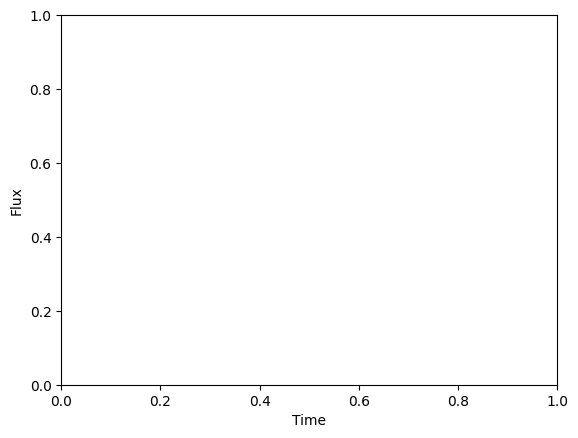

In [ ]:
GRBs=[
"GRB200306C"
]


for grb_name in GRBs:
  run_model(grb_name)

In [ ]:
# plt.errorbar(log_ts, log_fluxes, yerr=[log_fluxes-neg_log_fluxes,pos_log_fluxes-log_fluxes], label=r"$\log_{10}\,flux$", linestyle="",zorder=4)
# plt.errorbar(log_recon_t, jiggled_points, linestyle='none', yerr=np.abs(recon_errorbar), marker='o', capsize=5, color='yellow',zorder=3)

# plt.scatter(log_ts,log_fluxes,label='Observations',zorder=5)
# plt.plot(log_recon_t,recon_fluxes_up,label='Mean predictions',zorder=2)
# plt.fill_between(log_recon_t, ci_95_lower, ci_95_upper,color='orange', alpha=0.5, label='95% Confidence Interval',zorder=1)
# plt.xlabel('log Time')
# plt.ylabel('log Flux')
# plt.title(f'LSTM on '+str(GRB_Name))
# plt.legend()
# plt.savefig('/home/aditi/Downloads/GRB_project/LSTM/with redshift/png/'+str(GRB_Name)+".png", dpi=300)
# plt.show()

# #CALCULATING TIME ERROR IN LINEAR SCALE
# ts_error = (positive_ts_err - negative_ts_err)/2

# #CALCULATING TIME ERROR IN LOG SCALE
# log_ts_error = ts_error/(ts*np.log(10))

# errparameters = st.norm.fit(log_ts_error) #GAUSSIAN FITTING ON TIME ERROR DISTRIBUTION
# err_dist_time = st.norm(loc=errparameters[0], scale=errparameters[1])

# recon_logtimeerr=err_dist_time.rvs(size=len(log_recon_t)) # len(log_ts_error)
# df = trimmed_data.copy(deep=True)

# for k in range(0, len(log_recon_t)):
#     new_row = {
#         "t": 10**log_recon_t[k],
#         "pos_t_err": 10**recon_logtimeerr[k],
#         "neg_t_err": 10**recon_logtimeerr[k],
#         "flux": 10**jiggled_points[k],
#         "pos_flux_err": 10**jiggled_points[k] * np.log(10) * recon_errorbar[k],
#         "neg_flux_err": 10**jiggled_points[k] * np.log(10) * recon_errorbar[k]
#     }

#     new_row_df = pd.DataFrame(new_row)
#     df = pd.concat([df, new_row_df], ignore_index=True)

# Names.append(GRB_Name)


# df.to_csv('/home/aditi/Downloads/GRB_project/LSTM/with redshift/csv/'+str(GRB_Name)+'.csv')